# Isopycnal Mixing Water Mass Analysis: Geostrophic Velocity

In [1]:
# Imports
import numpy as np
import pandas as pd
import glob
import xarray as xr
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import gsw
import cmocean.cm as cmo
import sys
import pyompa
import scipy.interpolate as interp

## To import functions from Slocum-AD2CP GitHub repository, make this path the path to where the repo exists locally
sys.path.insert(0,'/home/jg1200/GitHub/Slocum-AD2CP/src/analysis/')
from analysis import gsw_rho, profile_mld, get_erddap_dataset, grid_glider_data, dist_from_lat_lon

## Set some plotting formats
plt.style.use('seaborn-poster')
myFmtshort = mdates.DateFormatter('%m/%d\n%H:%M')
myFmtlong = mdates.DateFormatter('%m/%d/%y \n%H:%M')
myFmt = mdates.DateFormatter('%m/%d/%y')



###################################################################################################################
######################################### Setting for water mass analysis #########################################
###################################################################################################################

#Define a parameter to represent remineralization in terms of phosphate
convertedparamgroups = [
    pyompa.ConvertedParamGroup(
        groupname="phosphate_remin",
        conversion_ratios=[{"oxygen_concentration": -170, "phosphate": 1.0}],
        always_positive=True)
]

paramweightings = {
    "potential_temperature": 1.0,
    "salinity": 1.0,
    "mass": 1.0,
}

settings = {
    "param_names": ["potential_temperature", "salinity", "mass"],
    "convertedparam_groups": convertedparamgroups,
    "param_weightings": paramweightings,
}


## First load glider data

In [44]:
grid_ds_2020 = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2020_AD2CP_NC/Gridded/RU29_2020_Gridded_Geostrophic_Velocity.nc")
grid_ds_2021a = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2021_Mission_1_AD2CP_NC/Gridded/RU29_2021_Mission_1_Gridded_Geo_CTD.nc")
grid_ds_2021b = xr.open_dataset("/home/jg1200/Data/GliderData/RU29/RU29_2021_Mission_2_AD2CP_NC/Gridded/RU29_2021_Mission_2_Gridded_Geo_CTD.nc")
grid_ds_2022 = xr.open_dataset("/home/jg1200/Data/GliderData/RU36/RU36_03_2022_ADCP/RU36_03_2022_Gridded_Geostrophic_Velocity.nc")


## rename the salinity variable in the 2020 and 2022 dataset for compatibility with the functions from the absolute velocity run
grid_ds_2020 = grid_ds_2020.rename({'salinity': 'sal'})
grid_ds_2022 = grid_ds_2022.rename({'salinity': 'sal'})


## convert density to sigma0
grid_ds_2020.density.values = gsw.sigma0(grid_ds_2020.sal.values,grid_ds_2020.temp.values)+1000
grid_ds_2021a.density.values = gsw.sigma0(grid_ds_2021a.sal.values,grid_ds_2021a.temp.values)+1000
grid_ds_2021b.density.values = gsw.sigma0(grid_ds_2021b.sal.values,grid_ds_2021b.temp.values)+1000
grid_ds_2022.density.values = gsw.sigma0(grid_ds_2022.sal.values,grid_ds_2022.temp.values)+1000

grid_ds_2021a


<xarray.Dataset>
Dimensions:    (depth: 98, dist: 39)
Coordinates:
  * depth      (depth) float64 5.0 15.0 25.0 35.0 ... 945.0 955.0 965.0 975.0
  * dist       (dist) float64 2.909e+03 3.465e+03 ... 2.001e+03 1.936e+03
Data variables:
    vgeo       (depth, dist) float64 ...
    cross_vel  (depth, dist) float64 ...
    along_vel  (depth, dist) float64 ...
    temp       (depth, dist) float64 28.37 28.42 28.36 28.32 ... nan nan nan nan
    sal        (depth, dist) float64 35.26 35.27 35.32 35.31 ... nan nan nan nan
    density    (depth, dist) float64 1.022e+03 1.022e+03 1.022e+03 ... nan nan
Attributes:
    description:  Processed RU29 AD2CP velocity, geostrophic velocity, and CT...

## Subset glider data

In [45]:
subset_ds_2020 = grid_ds_2020.where(grid_ds_2020.density >=1024.5)
subset_ds_2021a = grid_ds_2021a.where(grid_ds_2021a.density >=1024.5)
subset_ds_2021b = grid_ds_2021b.where(grid_ds_2021b.density >=1024.5)
subset_ds_2022 = grid_ds_2022.where(grid_ds_2022.density >=1024.5)


## Save a copy of the subset surface layer

In [46]:
subset_ds_2020_surf = grid_ds_2020.where(grid_ds_2020.density <1024.5)
subset_ds_2021a_surf = grid_ds_2021a.where(grid_ds_2021a.density <1024.5)
subset_ds_2021b_surf = grid_ds_2021b.where(grid_ds_2021b.density <1024.5)
subset_ds_2022_surf = grid_ds_2022.where(grid_ds_2022.density <1024.5)


## Define new ones for the repeat grids, the depth grid is different for geostrophic velocity

In [47]:
temp_ds = xr.open_dataset('https://www.ncei.noaa.gov/thredds-ocean/dodsC/ncei/woa/temperature/decav/1.00/woa18_decav_t00_01.nc', decode_times=False)
sal_ds  = xr.open_dataset('https://www.ncei.noaa.gov/thredds-ocean/dodsC/ncei/woa/salinity/decav/1.00/woa18_decav_s00_01.nc', decode_times=False)

In [48]:
###################################################################################################################
### Upper NAW ###
min_lon = -60
max_lon = -40
min_lat = 13
max_lat = 17

## subset
naw_temp_ds1 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
naw_sal_ds1  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## average profile
naw_mean_temp1 = np.nanmax(naw_temp_ds1.t_mn, axis=(1,2))
naw_mean_sal1  = np.nanmax(naw_sal_ds1.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
naw_mean_sal1 = gsw.SA_from_SP(naw_mean_sal1, naw_sal_ds1.depth.values, -40, -30)
naw_mean_temp1 = gsw.pt0_from_t(naw_mean_sal1, naw_mean_temp1, naw_sal_ds1.depth.values)
naw_mean_den1 = gsw.sigma0(naw_mean_sal1,naw_mean_temp1)+1000

## regular depth grid for all so just use this, do this before subsetting naw_mean_den1
mean_depth = naw_sal_ds1.depth.values[np.where((naw_mean_den1>=1024.5) & (naw_mean_den1 <=1027.6))]

## subset by density
naw_den1_ind = np.where((naw_mean_den1>=1024.5) & (naw_mean_den1 <=1026.3))
naw_mean_sal1 = naw_mean_sal1[naw_den1_ind]
naw_mean_temp1 = naw_mean_temp1[naw_den1_ind]
naw_mean_den1 = naw_mean_den1[naw_den1_ind]

###################################################################################################################
### Lower NAW ###
min_lon = -60
max_lon = -40
min_lat = 23
max_lat = 26

## subset
naw_temp_ds2 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
naw_sal_ds2  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## average profile
naw_mean_temp2 = np.nanmean(naw_temp_ds2.t_mn, axis=(1,2))
naw_mean_sal2  = np.nanmean(naw_sal_ds2.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
naw_mean_sal2 = gsw.SA_from_SP(naw_mean_sal2, naw_sal_ds2.depth.values, -40, -30)
naw_mean_temp2 = gsw.pt0_from_t(naw_mean_sal2, naw_mean_temp2, naw_sal_ds2.depth.values)
naw_mean_den2 = gsw.sigma0(naw_mean_sal2,naw_mean_temp2)+1000

## subset by density
naw_den2_ind = np.where((naw_mean_den2>=1026.3) & (naw_mean_den2 <=1027.6))
naw_mean_sal2 = naw_mean_sal2[naw_den2_ind]
naw_mean_temp2 = naw_mean_temp2[naw_den2_ind]
naw_mean_den2 = naw_mean_den2[naw_den2_ind]

naw_mean_temp = np.concatenate((naw_mean_temp1,naw_mean_temp2))
naw_mean_sal = np.concatenate((naw_mean_sal1,naw_mean_sal2))
naw_mean_den = gsw.sigma0(naw_mean_sal,naw_mean_temp)+1000

###################################################################################################################
###################################################################################################################
### upper SAW ###
min_lon = 0
max_lon = 10
min_lat = -12
max_lat = -8

## subset
saw_temp_ds1 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
saw_sal_ds1  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## Make average profiles
saw_mean_temp1 = np.nanmean(saw_temp_ds1.t_mn, axis=(1,2))
saw_mean_sal1  = np.nanmean(saw_sal_ds1.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
saw_mean_sal1 = gsw.SA_from_SP(saw_mean_sal1, saw_sal_ds1.depth.values, -40, -30)
saw_mean_temp1 = gsw.pt0_from_t(saw_mean_sal1, saw_mean_temp1, saw_sal_ds1.depth.values)
saw_mean_den1 = gsw.sigma0(saw_mean_sal1,saw_mean_temp1)+1000

## subset by density
saw_den1_ind = np.where((saw_mean_den1>=1024.5) & (saw_mean_den1 <=1026.3))
saw_mean_sal1 = saw_mean_sal1[saw_den1_ind]
saw_mean_temp1 = saw_mean_temp1[saw_den1_ind]
saw_mean_den1 = saw_mean_den1[saw_den1_ind]

###################################################################################################################
### lower SAW ###
min_lon = -32
max_lon = -28
min_lat = -12
max_lat = -8

## subset
saw_temp_ds2 = temp_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=temp_ds.time[0])
saw_sal_ds2  = sal_ds.sel(lat=slice(min_lat,max_lat),lon=slice(min_lon,max_lon),time=sal_ds.time[0])

## Make average profiles
saw_mean_temp2 = np.nanmean(saw_temp_ds2.t_mn, axis=(1,2))
saw_mean_sal2  = np.nanmean(saw_sal_ds2.s_mn, axis=(1,2))

## convert to SA and PT and calculate sigma0
saw_mean_sal2 = gsw.SA_from_SP(saw_mean_sal2, saw_sal_ds2.depth.values, -40, -30)
saw_mean_temp2 = gsw.pt0_from_t(saw_mean_sal2, saw_mean_temp2, saw_sal_ds2.depth.values)
saw_mean_den2 = gsw.sigma0(saw_mean_sal2,saw_mean_temp2)+1000

## subset by density
saw_den2_ind = np.where((saw_mean_den2>=1026.3) & (saw_mean_den2 <=1027.6))
saw_mean_sal2 = saw_mean_sal2[saw_den2_ind]
saw_mean_temp2 = saw_mean_temp2[saw_den2_ind]
saw_mean_den2 = saw_mean_den2[saw_den2_ind]

saw_mean_temp = np.concatenate((saw_mean_temp1,saw_mean_temp2))
saw_mean_sal = np.concatenate((saw_mean_sal1,saw_mean_sal2))
saw_mean_den = gsw.sigma0(saw_mean_sal,saw_mean_temp)+1000

In [49]:
griddepth = np.arange(0,1001,2)

naw_interp_mean_temp =  interp.griddata(mean_depth,naw_mean_temp,griddepth)
naw_interp_mean_sal =  interp.griddata(mean_depth,naw_mean_sal,griddepth)
naw_interp_mean_den =  interp.griddata(mean_depth,naw_mean_den,griddepth)

saw_interp_mean_temp =  interp.griddata(mean_depth,saw_mean_temp,griddepth)
saw_interp_mean_sal =  interp.griddata(mean_depth,saw_mean_sal,griddepth)
saw_interp_mean_den =  interp.griddata(mean_depth,saw_mean_den,griddepth)


In [50]:
## initialize
NAW =       ["NAW",   np.nan,   np.nan]
SAW =       ["SAW",   np.nan,  np.nan]


def prepare_endmember_df(endmembers_arr):
    df = pd.DataFrame(data=endmembers_arr,
                      columns=["endmember_name", "potential_temperature", "salinity"])
    df["mass"] = 1
    return df

endmemberdf = prepare_endmember_df([NAW, SAW])
endmemberdf

,endmember_name,potential_temperature,salinity,mass
0,NAW,NaN,NaN,1
1,SAW,NaN,NaN,1


## Functions for the single transects

In [51]:

def solve_endmember_fractions_single_geo(df,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,griddepth):
    
    ## preallocation soln matrix
    naw_frac_df = np.empty(df.temp.shape)
    naw_frac_df[:] = np.nan
    saw_frac_df = np.empty(df.temp.shape)
    saw_frac_df[:] = np.nan

    ## Loop through each row (depth) and perform water mass analysis
    for x in np.arange(0,len(df.depth)):
        
        ## subset to just the depth row of interest and make pandas dataframe
        d = {'potential_temperature': df.temp.values[x,:], 'salinity': df.sal.values[x,:]}
        obs_df = pd.DataFrame(data=d)
        obs_df["mass"] = 1.0

        ## see how many nans there are
        nanlocs = np.where(np.isnan(obs_df['potential_temperature'])==True)[0]
        
        ## skip row if it is all nans
        if len(nanlocs) == len(df.dist):
            pass
        else:
            ## Save location of non-nan indexes for filling sol'n matrix
            nonnanlocs = np.where(np.isnan(obs_df['potential_temperature'])==False)[0]
            ## find matching depth index in source water depth variable
            depth_ind = np.where(griddepth == df.depth.values[x])
            ## oull out NAW and SAW temp and sal
            endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
            endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
            endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
            endmemberdf['salinity'][1] = saw_interp_mean_sal[depth_ind]
            ## run analysis
            ompa_soln = pyompa.OMPAProblem(obs_df = obs_df, **settings).solve(endmemberdf,endmember_name_column = "endmember_name")
            ## save soln'n
            naw_frac_df[x,nonnanlocs] = ompa_soln.endmember_fractions[:,0]
            saw_frac_df[x,nonnanlocs] = ompa_soln.endmember_fractions[:,1]
            
    df["naw_frac"]=(['depth', 'dist'],  naw_frac_df)
    df["saw_frac"]=(['depth', 'dist'],  saw_frac_df)

    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.vgeo.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    
    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.dist)):
        transport[:,x] = (df.vgeo[:,x].values*dz*df.dist.values[x])/(10**6)
    
    ## now multiply by %naw oand %saw to calculate transport of naw and saw
    naw_transport = transport*naw_frac_df
    saw_transport = transport*saw_frac_df
    
    df["transport"]=(['depth', 'dist'],  transport)
    df["naw_transport"]=(['depth', 'dist'],  naw_transport)
    df["saw_transport"]=(['depth', 'dist'],  saw_transport)
    
    return df


def calc_transport_single_geo(df):
    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.vgeo.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    
    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.dist)):
        transport[:,x] = (df.vgeo[:,x].values*dz*df.dist.values[x])/(10**6)

    df["transport"]=(['depth', 'dist'],  transport)

    return df


## functions for the multiple transects

In [52]:

def solve_endmember_fractions_multiple_geo(df,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,griddepth):

    ## preallocation soln matrix
    naw_frac_df = np.empty(df.temp.shape)
    naw_frac_df[:] = np.nan
    saw_frac_df = np.empty(df.temp.shape)
    saw_frac_df[:] = np.nan

    ## Loop through each transect
    for y in np.arange(0,len(df.transect_num)):

        ## Then loop through each row (depth) and perform water mass analysis
        for x in np.arange(0,len(df.depth)):

            ## subset to just the depth row of interest and make pandas dataframe
            d = {'potential_temperature': df.temp.values[x,:,y], 'salinity': df.sal.values[x,:,y]}
            obs_df = pd.DataFrame(data=d)
            obs_df["mass"] = 1.0

            ## see how many nans there are
            nanlocs = np.where(np.isnan(obs_df['potential_temperature'])==True)[0]

            ## skip row if it is all nans
            if len(nanlocs) == len(df.lat):
                pass
            else:
                ## Save location of non-nan indexes for filling sol'n matrix
                nonnanlocs = np.where(np.isnan(obs_df['potential_temperature'])==False)[0]
                ## find matching depth index in source water depth variable
                depth_ind = np.where(griddepth == df.depth.values[x])
                ## oull out NAW and SAW temp and sal
                endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
                endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
                endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
                endmemberdf['salinity'][1] = saw_interp_mean_sal[depth_ind]
                ## run analysis
                ompa_soln = pyompa.OMPAProblem(obs_df = obs_df, **settings).solve(endmemberdf,endmember_name_column = "endmember_name")
                ## save soln'n
                naw_frac_df[x,nonnanlocs,y] = ompa_soln.endmember_fractions[:,0]
                saw_frac_df[x,nonnanlocs,y] = ompa_soln.endmember_fractions[:,1]

    df["naw_frac"]=(['depth', 'lat', 'transect_num'],  naw_frac_df)
    df["saw_frac"]=(['depth', 'lat', 'transect_num'],  saw_frac_df)

    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.temp.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    ## lon hard-coded due to grid design
    distance = dist_from_lat_lon(subset_ds_2020.lat[0], -64.80, subset_ds_2020.lat[1], -64.80)

    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.transect_num)):
        transport[:,:,x] = (df.u[:,:,x].values*dz*distance)/(10**6)

    ## now multiply by %naw oand %saw to calculate transport of naw and saw
    naw_transport = transport*naw_frac_df
    saw_transport = transport*saw_frac_df

    df["transport"]=(['depth', 'lat', 'transect_num'],  transport)
    df["naw_transport"]=(['depth', 'lat', 'transect_num'],  naw_transport)
    df["saw_transport"]=(['depth', 'lat', 'transect_num'],  saw_transport)

    return df


def calc_transport_multiple_geo(df):
    ############ Now calculate transport!!!!!
    ## preallocate for loop
    transport = np.empty(df.temp.shape)
    transport[:] = np.NaN
    ## calc dz based on depth data
    dz = df.depth.values[1]-df.depth.values[0]
    ## lon hard-coded due to grid design
    distance = dist_from_lat_lon(subset_ds_2020.lat[0], -64.80, subset_ds_2020.lat[1], -64.80)

    ## loop through and calculate transport in Sv based on dz and dx (dist)
    for x in np.arange(0,len(df.transect_num)):
        transport[:,:,x] = (df.u[:,:,x].values*dz*distance)/(10**6)

    df["transport"]=(['depth', 'lat', 'transect_num'],  transport)

    return df



## Do it up!

In [53]:
subset_ds_2021a_surf_final = calc_transport_single_geo(subset_ds_2021a_surf)
subset_ds_2021b_surf_final = calc_transport_single_geo(subset_ds_2021b_surf)

subset_ds_2020_surf_final = calc_transport_multiple_geo(subset_ds_2020_surf)
subset_ds_2022_surf_final = calc_transport_multiple_geo(subset_ds_2022_surf)

In [57]:
df_2021a_final = solve_endmember_fractions_single_geo(subset_ds_2021a,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,griddepth)



/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/home/jg1200/.conda/envs/glider_3_9/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


ValueError: setting an array element with a sequence.

In [56]:
df_2021b_final = solve_endmember_fractions_single_geo(subset_ds_2021b,naw_interp_mean_temp,naw_interp_mean_sal,saw_interp_mean_temp,saw_interp_mean_sal,griddepth)


Dropping 33 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0449395412115535
Original weighted sum squares: 0.0449395412115535
Post fix weighted sum squared: 0.044939541211551075
On example 0 to 1 out of 1
status: optimal
optimal value 0.0449395412115535
Original weighted sum squares: 0.0449395412115535
Post fix weighted sum squared: 0.044939541211551075
objective: 0.044939541211551075
Dropping 31 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 3 out of 3
status: optimal
optimal value 0.1533891506957

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.459205067069785
Original weighted sum squares: 2.459205067069785
Post fix weighted sum squared: 2.459205067069794
objective: 2.459205067069794
Dropping 17 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 17 out of 17
status: optimal
optimal value 3.552743484114142
Original weighted sum squares: 3.552743484114142
Post fix weighted sum squared: 3.5527434841141563
On example 0 to 17 out of 17
status: optimal
optimal value 3.552743484114142
Original weighted sum squares: 3.552743484114142
Post fix weighted sum squared: 3.5527434841141563
objective: 3.5527434841141563
Dropping 16 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salini

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 13.540114249958908
Original weighted sum squares: 13.540114249958908
Post fix weighted sum squared: 13.540114249958838
On example 0 to 26 out of 26
status: optimal
optimal value 13.540114249958908
Original weighted sum squares: 13.540114249958908
Post fix weighted sum squared: 13.540114249958838
objective: 13.540114249958837
Dropping 7 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 27 out of 27
status: optimal
optimal value 15.75960149369083
Original weighted sum squares: 15.75960149369083
Post fix weighted sum squared: 15.759601493690809
On example 0 to 27 out of 27
status: optimal
optimal value 15.75960149369083
Original weighted sum squares: 15.75960149369083
Post fix weighted sum squared: 15.759601493690809
objective: 15.75960149

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 20.230732017755575
Original weighted sum squares: 20.230732017755575
Post fix weighted sum squared: 20.230732017755553
On example 0 to 31 out of 31
status: optimal
optimal value 20.230732017755575
Original weighted sum squares: 20.230732017755575
Post fix weighted sum squared: 20.230732017755553
objective: 20.230732017755557
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 22.271378541753773
Original weighted sum squares: 22.271378541753773
Post fix weighted sum squared: 22.271378541753982
On example 0 to 31 out of 31
status: optimal
optimal value 22.271378541753773
Original weighted sum squares: 22.271378541753773
Post fix weighted sum squared: 22.271378541753982
objective: 22.2713

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 19.29792965462333
Original weighted sum squares: 19.29792965462333
Post fix weighted sum squared: 19.297929654623406
On example 0 to 31 out of 31
status: optimal
optimal value 19.29792965462333
Original weighted sum squares: 19.29792965462333
Post fix weighted sum squared: 19.297929654623406
objective: 19.297929654623406
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 22.92937284460237
Original weighted sum squares: 22.92937284460237
Post fix weighted sum squared: 22.929372844602423
On example 0 to 31 out of 31
status: optimal
optimal value 22.92937284460237
Original weighted sum squares: 22.92937284460237
Post fix weighted sum squared: 22.929372844602423
objective: 22.929372844602

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 19.262536253692023
Original weighted sum squares: 19.262536253692023
Post fix weighted sum squared: 19.26253625369195
On example 0 to 31 out of 31
status: optimal
optimal value 19.262536253692023
Original weighted sum squares: 19.262536253692023
Post fix weighted sum squared: 19.26253625369195
objective: 19.262536253691955
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 19.742533622115648
Original weighted sum squares: 19.742533622115648
Post fix weighted sum squared: 19.742533622115566
On example 0 to 31 out of 31
status: optimal
optimal value 19.742533622115648
Original weighted sum squares: 19.742533622115648
Post fix weighted sum squared: 19.742533622115566
objective: 19.742533

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 18.524063636085092
Original weighted sum squares: 18.524063636085092
Post fix weighted sum squared: 18.524063636085103
On example 0 to 31 out of 31
status: optimal
optimal value 18.524063636085092
Original weighted sum squares: 18.524063636085092
Post fix weighted sum squared: 18.524063636085103
objective: 18.524063636085106
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 18.65327835682981
Original weighted sum squares: 18.65327835682981
Post fix weighted sum squared: 18.65327835682978
On example 0 to 31 out of 31
status: optimal
optimal value 18.65327835682981
Original weighted sum squares: 18.65327835682981
Post fix weighted sum squared: 18.65327835682978
objective: 18.6532783568

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 22.67771105942288
Original weighted sum squares: 22.67771105942288
Post fix weighted sum squared: 22.677711059422833
On example 0 to 31 out of 31
status: optimal
optimal value 22.67771105942288
Original weighted sum squares: 22.67771105942288
Post fix weighted sum squared: 22.677711059422833
objective: 22.67771105942283
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 19.791215013679498
Original weighted sum squares: 19.791215013679498
Post fix weighted sum squared: 19.79121501367967
On example 0 to 31 out of 31
status: optimal
optimal value 19.791215013679498
Original weighted sum squares: 19.791215013679498
Post fix weighted sum squared: 19.79121501367967
objective: 19.79121501367

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 19.4128782262465
Original weighted sum squares: 19.4128782262465
Post fix weighted sum squared: 19.412878226246356
On example 0 to 31 out of 31
status: optimal
optimal value 19.4128782262465
Original weighted sum squares: 19.4128782262465
Post fix weighted sum squared: 19.412878226246356
objective: 19.412878226246356
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 20.55891239865441
Original weighted sum squares: 20.55891239865441
Post fix weighted sum squared: 20.55891239865421
On example 0 to 31 out of 31
status: optimal
optimal value 20.55891239865441
Original weighted sum squares: 20.55891239865441
Post fix weighted sum squared: 20.55891239865421
objective: 20.558912398654208
Dr

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 17.974140239079667
Original weighted sum squares: 17.974140239079667
Post fix weighted sum squared: 17.974140239079603
On example 0 to 31 out of 31
status: optimal
optimal value 17.974140239079667
Original weighted sum squares: 17.974140239079667
Post fix weighted sum squared: 17.974140239079603
objective: 17.974140239079603
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 20.124087709429666
Original weighted sum squares: 20.124087709429666
Post fix weighted sum squared: 20.12408770942958
On example 0 to 31 out of 31
status: optimal
optimal value 20.124087709429666
Original weighted sum squares: 20.124087709429666
Post fix weighted sum squared: 20.12408770942958
objective: 20.124087

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 16.072094223073698
Original weighted sum squares: 16.072094223073698
Post fix weighted sum squared: 16.072094223073574
On example 0 to 31 out of 31
status: optimal
optimal value 16.072094223073698
Original weighted sum squares: 16.072094223073698
Post fix weighted sum squared: 16.072094223073574
objective: 16.072094223073574
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 16.36513503490366
Original weighted sum squares: 16.36513503490366
Post fix weighted sum squared: 16.365135034903748
On example 0 to 31 out of 31
status: optimal
optimal value 16.36513503490366
Original weighted sum squares: 16.36513503490366
Post fix weighted sum squared: 16.365135034903748
objective: 16.36513503

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 12.640842513433377
Original weighted sum squares: 12.640842513433377
Post fix weighted sum squared: 12.640842513433373
On example 0 to 31 out of 31
status: optimal
optimal value 12.640842513433377
Original weighted sum squares: 12.640842513433377
Post fix weighted sum squared: 12.640842513433373
objective: 12.64084251343337
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 13.661577414105254
Original weighted sum squares: 13.661577414105254
Post fix weighted sum squared: 13.661577414105192
On example 0 to 31 out of 31
status: optimal
optimal value 13.661577414105254
Original weighted sum squares: 13.661577414105254
Post fix weighted sum squared: 13.661577414105192
objective: 13.66157

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 11.48007163819647
Original weighted sum squares: 11.48007163819647
Post fix weighted sum squared: 11.480071638196394
On example 0 to 31 out of 31
status: optimal
optimal value 11.48007163819647
Original weighted sum squares: 11.48007163819647
Post fix weighted sum squared: 11.480071638196394
objective: 11.480071638196396
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 10.368112743437262
Original weighted sum squares: 10.368112743437262
Post fix weighted sum squared: 10.368112743437212
On example 0 to 31 out of 31
status: optimal
optimal value 10.368112743437262
Original weighted sum squares: 10.368112743437262
Post fix weighted sum squared: 10.368112743437212
objective: 10.36811274

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.93094608349633
Original weighted sum squares: 4.93094608349633
Post fix weighted sum squared: 4.930946083496325
On example 0 to 31 out of 31
status: optimal
optimal value 4.93094608349633
Original weighted sum squares: 4.93094608349633
Post fix weighted sum squared: 4.930946083496325
objective: 4.930946083496326
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 4.691230011714117
Original weighted sum squares: 4.691230011714117
Post fix weighted sum squared: 4.691230011714104
On example 0 to 31 out of 31
status: optimal
optimal value 4.691230011714117
Original weighted sum squares: 4.691230011714117
Post fix weighted sum squared: 4.691230011714104
objective: 4.691230011714104
Droppi

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.9862097105756964
Original weighted sum squares: 1.9862097105756964
Post fix weighted sum squared: 1.9862097105757013
On example 0 to 31 out of 31
status: optimal
optimal value 1.9862097105756964
Original weighted sum squares: 1.9862097105756964
Post fix weighted sum squared: 1.9862097105757013
objective: 1.9862097105757015
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 1.3904483948451214
Original weighted sum squares: 1.3904483948451214
Post fix weighted sum squared: 1.3904483948450554
On example 0 to 31 out of 31
status: optimal
optimal value 1.3904483948451214
Original weighted sum squares: 1.3904483948451214
Post fix weighted sum squared: 1.3904483948450554
objective: 1.39044

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.200576809951502
Original weighted sum squares: 1.200576809951502
Post fix weighted sum squared: 1.2005768099514942
On example 0 to 31 out of 31
status: optimal
optimal value 1.200576809951502
Original weighted sum squares: 1.200576809951502
Post fix weighted sum squared: 1.2005768099514942
objective: 1.2005768099514944
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 1.1174856975844139
Original weighted sum squares: 1.1174856975844139
Post fix weighted sum squared: 1.1174856975843894
On example 0 to 31 out of 31
status: optimal
optimal value 1.1174856975844139
Original weighted sum squares: 1.1174856975844139
Post fix weighted sum squared: 1.1174856975843894
objective: 1.117485697

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.744610521555734
Original weighted sum squares: 0.744610521555734
Post fix weighted sum squared: 0.7446105215557525
On example 0 to 31 out of 31
status: optimal
optimal value 0.744610521555734
Original weighted sum squares: 0.744610521555734
Post fix weighted sum squared: 0.7446105215557525
objective: 0.7446105215557524
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.804154615790069
Original weighted sum squares: 0.804154615790069
Post fix weighted sum squared: 0.8041546157900678
On example 0 to 31 out of 31
status: optimal
optimal value 0.804154615790069
Original weighted sum squares: 0.804154615790069
Post fix weighted sum squared: 0.8041546157900678
objective: 0.8041546157900

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3408774132107915
Original weighted sum squares: 0.3408774132107915
Post fix weighted sum squared: 0.3408774132107987
On example 0 to 31 out of 31
status: optimal
optimal value 0.3408774132107915
Original weighted sum squares: 0.3408774132107915
Post fix weighted sum squared: 0.3408774132107987
objective: 0.34087741321079873
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.36021545313904296
Original weighted sum squares: 0.36021545313904296
Post fix weighted sum squared: 0.36021545313906356
On example 0 to 31 out of 31
status: optimal
optimal value 0.36021545313904296
Original weighted sum squares: 0.36021545313904296
Post fix weighted sum squared: 0.36021545313906356
objective: 

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.31871577410914026
Original weighted sum squares: 0.31871577410914026
Post fix weighted sum squared: 0.3187157741091409
On example 0 to 31 out of 31
status: optimal
optimal value 0.31871577410914026
Original weighted sum squares: 0.31871577410914026
Post fix weighted sum squared: 0.3187157741091409
objective: 0.3187157741091409
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.24290273815448332
Original weighted sum squares: 0.24290273815448332
Post fix weighted sum squared: 0.24290273815444702
On example 0 to 31 out of 31
status: optimal
optimal value 0.24290273815448332
Original weighted sum squares: 0.24290273815448332
Post fix weighted sum squared: 0.24290273815444702
objectiv

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2723262992896617
Original weighted sum squares: 0.2723262992896617
Post fix weighted sum squared: 0.2723262992896581
On example 0 to 31 out of 31
status: optimal
optimal value 0.2723262992896617
Original weighted sum squares: 0.2723262992896617
Post fix weighted sum squared: 0.2723262992896581
objective: 0.27232629928965807
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.266165908132889
Original weighted sum squares: 0.266165908132889
Post fix weighted sum squared: 0.2661659081329227
On example 0 to 31 out of 31
status: optimal
optimal value 0.266165908132889
Original weighted sum squares: 0.266165908132889
Post fix weighted sum squared: 0.2661659081329227
objective: 0.26616590

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2499273865128698
Original weighted sum squares: 0.2499273865128698
Post fix weighted sum squared: 0.24992738651287638
On example 0 to 31 out of 31
status: optimal
optimal value 0.2499273865128698
Original weighted sum squares: 0.2499273865128698
Post fix weighted sum squared: 0.24992738651287638
objective: 0.24992738651287638
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.23705361020948906
Original weighted sum squares: 0.23705361020948906
Post fix weighted sum squared: 0.2370536102094749
On example 0 to 31 out of 31
status: optimal
optimal value 0.23705361020948906
Original weighted sum squares: 0.23705361020948906
Post fix weighted sum squared: 0.2370536102094749
objective: 

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2525749961261249
Original weighted sum squares: 0.2525749961261249
Post fix weighted sum squared: 0.25257499612617035
On example 0 to 31 out of 31
status: optimal
optimal value 0.2525749961261249
Original weighted sum squares: 0.2525749961261249
Post fix weighted sum squared: 0.25257499612617035
objective: 0.25257499612617035
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.24700618364411223
Original weighted sum squares: 0.24700618364411223
Post fix weighted sum squared: 0.24700618364414084
On example 0 to 31 out of 31
status: optimal
optimal value 0.24700618364411223
Original weighted sum squares: 0.24700618364411223
Post fix weighted sum squared: 0.24700618364414084
objective

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.23916102350003776
Original weighted sum squares: 0.23916102350003776
Post fix weighted sum squared: 0.23916102349999938
On example 0 to 31 out of 31
status: optimal
optimal value 0.23916102350003776
Original weighted sum squares: 0.23916102350003776
Post fix weighted sum squared: 0.23916102349999938
objective: 0.23916102349999932
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.24523271189313625
Original weighted sum squares: 0.24523271189313625
Post fix weighted sum squared: 0.24523271189313375
On example 0 to 31 out of 31
status: optimal
optimal value 0.24523271189313625
Original weighted sum squares: 0.24523271189313625
Post fix weighted sum squared: 0.24523271189313375
objec

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22929214064910047
Original weighted sum squares: 0.22929214064910047
Post fix weighted sum squared: 0.22929214064914216
On example 0 to 31 out of 31
status: optimal
optimal value 0.22929214064910047
Original weighted sum squares: 0.22929214064910047
Post fix weighted sum squared: 0.22929214064914216
objective: 0.22929214064914216
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.23702358828414283
Original weighted sum squares: 0.23702358828414283
Post fix weighted sum squared: 0.23702358828416267
On example 0 to 31 out of 31
status: optimal
optimal value 0.23702358828414283
Original weighted sum squares: 0.23702358828414283
Post fix weighted sum squared: 0.23702358828416267
objec

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.24499257240778807
Original weighted sum squares: 0.24499257240778807
Post fix weighted sum squared: 0.24499257240778696
On example 0 to 31 out of 31
status: optimal
optimal value 0.24499257240778807
Original weighted sum squares: 0.24499257240778807
Post fix weighted sum squared: 0.24499257240778696
objective: 0.244992572407787
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.22584715170167183
Original weighted sum squares: 0.22584715170167183
Post fix weighted sum squared: 0.22584715170165962
On example 0 to 31 out of 31
status: optimal
optimal value 0.22584715170167183
Original weighted sum squares: 0.22584715170167183
Post fix weighted sum squared: 0.22584715170165962
objecti

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.23432890772637838
Original weighted sum squares: 0.23432890772637838
Post fix weighted sum squared: 0.23432890772638332
On example 0 to 31 out of 31
status: optimal
optimal value 0.23432890772637838
Original weighted sum squares: 0.23432890772637838
Post fix weighted sum squared: 0.23432890772638332
objective: 0.23432890772638332
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.25984467441108344
Original weighted sum squares: 0.25984467441108344
Post fix weighted sum squared: 0.2598446744111266
On example 0 to 31 out of 31
status: optimal
optimal value 0.25984467441108344
Original weighted sum squares: 0.25984467441108344
Post fix weighted sum squared: 0.2598446744111266
objecti

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2661031485298829
Original weighted sum squares: 0.2661031485298829
Post fix weighted sum squared: 0.2661031485298822
On example 0 to 31 out of 31
status: optimal
optimal value 0.2661031485298829
Original weighted sum squares: 0.2661031485298829
Post fix weighted sum squared: 0.2661031485298822
objective: 0.26610314852988215
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.26969332316330386
Original weighted sum squares: 0.26969332316330386
Post fix weighted sum squared: 0.2696933231633249
On example 0 to 31 out of 31
status: optimal
optimal value 0.26969332316330386
Original weighted sum squares: 0.26969332316330386
Post fix weighted sum squared: 0.2696933231633249
objective: 0.

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.270721921209652
Original weighted sum squares: 0.270721921209652
Post fix weighted sum squared: 0.27072192120967664
On example 0 to 31 out of 31
status: optimal
optimal value 0.270721921209652
Original weighted sum squares: 0.270721921209652
Post fix weighted sum squared: 0.27072192120967664
objective: 0.2707219212096766
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.2677031313284882
Original weighted sum squares: 0.2677031313284882
Post fix weighted sum squared: 0.26770313132849655
On example 0 to 31 out of 31
status: optimal
optimal value 0.2677031313284882
Original weighted sum squares: 0.2677031313284882
Post fix weighted sum squared: 0.26770313132849655
objective: 0.26770

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2893257267979176
Original weighted sum squares: 0.2893257267979176
Post fix weighted sum squared: 0.2893257267978888
On example 0 to 31 out of 31
status: optimal
optimal value 0.2893257267979176
Original weighted sum squares: 0.2893257267979176
Post fix weighted sum squared: 0.2893257267978888
objective: 0.2893257267978889
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.284814441175216
Original weighted sum squares: 0.284814441175216
Post fix weighted sum squared: 0.2848144411752506
On example 0 to 31 out of 31
status: optimal
optimal value 0.284814441175216
Original weighted sum squares: 0.284814441175216
Post fix weighted sum squared: 0.2848144411752506
objective: 0.284814441

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.30481957228766193
Original weighted sum squares: 0.30481957228766193
Post fix weighted sum squared: 0.30481957228766343
On example 0 to 31 out of 31
status: optimal
optimal value 0.30481957228766193
Original weighted sum squares: 0.30481957228766193
Post fix weighted sum squared: 0.30481957228766343
objective: 0.3048195722876634
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.3155504495192156
Original weighted sum squares: 0.3155504495192156
Post fix weighted sum squared: 0.31555044951921835
On example 0 to 31 out of 31
status: optimal
optimal value 0.3155504495192156
Original weighted sum squares: 0.3155504495192156
Post fix weighted sum squared: 0.31555044951921835
objective:

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3322403118376636
Original weighted sum squares: 0.3322403118376636
Post fix weighted sum squared: 0.33224031183770547
On example 0 to 31 out of 31
status: optimal
optimal value 0.3322403118376636
Original weighted sum squares: 0.3322403118376636
Post fix weighted sum squared: 0.33224031183770547
objective: 0.3322403118377054
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.33421443466510664
Original weighted sum squares: 0.33421443466510664
Post fix weighted sum squared: 0.33421443466514383
On example 0 to 31 out of 31
status: optimal
optimal value 0.33421443466510664
Original weighted sum squares: 0.33421443466510664
Post fix weighted sum squared: 0.33421443466514383
objective:

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3609083242822376
Original weighted sum squares: 0.3609083242822376
Post fix weighted sum squared: 0.36090832428230013
On example 0 to 31 out of 31
status: optimal
optimal value 0.3609083242822376
Original weighted sum squares: 0.3609083242822376
Post fix weighted sum squared: 0.36090832428230013
objective: 0.36090832428230013
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.36495395068758696
Original weighted sum squares: 0.36495395068758696
Post fix weighted sum squared: 0.36495395068753955
On example 0 to 31 out of 31
status: optimal
optimal value 0.36495395068758696
Original weighted sum squares: 0.36495395068758696
Post fix weighted sum squared: 0.36495395068753955
objective

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.38509129322928143
Original weighted sum squares: 0.38509129322928143
Post fix weighted sum squared: 0.385091293229314
On example 0 to 31 out of 31
status: optimal
optimal value 0.38509129322928143
Original weighted sum squares: 0.38509129322928143
Post fix weighted sum squared: 0.385091293229314
objective: 0.38509129322931407
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.40456362337829843
Original weighted sum squares: 0.40456362337829843
Post fix weighted sum squared: 0.40456362337829876
On example 0 to 31 out of 31
status: optimal
optimal value 0.40456362337829843
Original weighted sum squares: 0.40456362337829843
Post fix weighted sum squared: 0.40456362337829876
objective

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.42444198998203814
Original weighted sum squares: 0.42444198998203814
Post fix weighted sum squared: 0.42444198998203514
On example 0 to 31 out of 31
status: optimal
optimal value 0.42444198998203814
Original weighted sum squares: 0.42444198998203814
Post fix weighted sum squared: 0.42444198998203514
objective: 0.42444198998203514
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.42230015565737333
Original weighted sum squares: 0.42230015565737333
Post fix weighted sum squared: 0.42230015565731643
On example 0 to 31 out of 31
status: optimal
optimal value 0.42230015565737333
Original weighted sum squares: 0.42230015565737333
Post fix weighted sum squared: 0.42230015565731643
objec

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4355204012713514
Original weighted sum squares: 0.4355204012713514
Post fix weighted sum squared: 0.4355204012713499
On example 0 to 31 out of 31
status: optimal
optimal value 0.4355204012713514
Original weighted sum squares: 0.4355204012713514
Post fix weighted sum squared: 0.4355204012713499
objective: 0.43552040127134983
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.4346018982359131
Original weighted sum squares: 0.4346018982359131
Post fix weighted sum squared: 0.434601898235916
On example 0 to 31 out of 31
status: optimal
optimal value 0.4346018982359131
Original weighted sum squares: 0.4346018982359131
Post fix weighted sum squared: 0.434601898235916
objective: 0.434601

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4536238198434241
Original weighted sum squares: 0.4536238198434241
Post fix weighted sum squared: 0.4536238198433735
On example 0 to 31 out of 31
status: optimal
optimal value 0.4536238198434241
Original weighted sum squares: 0.4536238198434241
Post fix weighted sum squared: 0.4536238198433735
objective: 0.4536238198433735
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.43876146678875017
Original weighted sum squares: 0.43876146678875017
Post fix weighted sum squared: 0.4387614667887804
On example 0 to 31 out of 31
status: optimal
optimal value 0.43876146678875017
Original weighted sum squares: 0.43876146678875017
Post fix weighted sum squared: 0.4387614667887804
objective: 0.4

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.45228894635963757
Original weighted sum squares: 0.45228894635963757
Post fix weighted sum squared: 0.45228894635965483
On example 0 to 31 out of 31
status: optimal
optimal value 0.45228894635963757
Original weighted sum squares: 0.45228894635963757
Post fix weighted sum squared: 0.45228894635965483
objective: 0.45228894635965483
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.44383853650151556
Original weighted sum squares: 0.44383853650151556
Post fix weighted sum squared: 0.44383853650150995
On example 0 to 31 out of 31
status: optimal
optimal value 0.44383853650151556
Original weighted sum squares: 0.44383853650151556
Post fix weighted sum squared: 0.44383853650150995
objec

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4325324915357537
Original weighted sum squares: 0.4325324915357537
Post fix weighted sum squared: 0.43253249153573203
On example 0 to 31 out of 31
status: optimal
optimal value 0.4325324915357537
Original weighted sum squares: 0.4325324915357537
Post fix weighted sum squared: 0.43253249153573203
objective: 0.432532491535732
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.426445594842324
Original weighted sum squares: 0.426445594842324
Post fix weighted sum squared: 0.426445594842296
On example 0 to 31 out of 31
status: optimal
optimal value 0.426445594842324
Original weighted sum squares: 0.426445594842324
Post fix weighted sum squared: 0.426445594842296
objective: 0.4264455948

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4416339076647749
Original weighted sum squares: 0.4416339076647749
Post fix weighted sum squared: 0.4416339076647597
On example 0 to 31 out of 31
status: optimal
optimal value 0.4416339076647749
Original weighted sum squares: 0.4416339076647749
Post fix weighted sum squared: 0.4416339076647597
objective: 0.44163390766475974
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.43576311149523145
Original weighted sum squares: 0.43576311149523145
Post fix weighted sum squared: 0.43576311149523983
On example 0 to 31 out of 31
status: optimal
optimal value 0.43576311149523145
Original weighted sum squares: 0.43576311149523145
Post fix weighted sum squared: 0.43576311149523983
objective: 

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.41731406417200817
Original weighted sum squares: 0.41731406417200817
Post fix weighted sum squared: 0.4173140641720291
On example 0 to 31 out of 31
status: optimal
optimal value 0.41731406417200817
Original weighted sum squares: 0.41731406417200817
Post fix weighted sum squared: 0.4173140641720291
objective: 0.4173140641720291
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.4247073605192012
Original weighted sum squares: 0.4247073605192012
Post fix weighted sum squared: 0.424707360519194
On example 0 to 31 out of 31
status: optimal
optimal value 0.4247073605192012
Original weighted sum squares: 0.4247073605192012
Post fix weighted sum squared: 0.424707360519194
objective: 0.424

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.401506833078111
Original weighted sum squares: 0.401506833078111
Post fix weighted sum squared: 0.40150683307811297
On example 0 to 31 out of 31
status: optimal
optimal value 0.401506833078111
Original weighted sum squares: 0.401506833078111
Post fix weighted sum squared: 0.40150683307811297
objective: 0.401506833078113
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.3718389250887984
Original weighted sum squares: 0.3718389250887984
Post fix weighted sum squared: 0.3718389250888358
On example 0 to 31 out of 31
status: optimal
optimal value 0.3718389250887984
Original weighted sum squares: 0.3718389250887984
Post fix weighted sum squared: 0.3718389250888358
objective: 0.37183892

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3720012007822467
Original weighted sum squares: 0.3720012007822467
Post fix weighted sum squared: 0.3720012007822467
On example 0 to 31 out of 31
status: optimal
optimal value 0.3720012007822467
Original weighted sum squares: 0.3720012007822467
Post fix weighted sum squared: 0.3720012007822467
objective: 0.37200120078224663
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.36072294133754884
Original weighted sum squares: 0.36072294133754884
Post fix weighted sum squared: 0.36072294133754884
On example 0 to 31 out of 31
status: optimal
optimal value 0.36072294133754884
Original weighted sum squares: 0.36072294133754884
Post fix weighted sum squared: 0.36072294133754884
objective: 

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.320143965591538
Original weighted sum squares: 0.320143965591538
Post fix weighted sum squared: 0.3201439655915517
On example 0 to 31 out of 31
status: optimal
optimal value 0.320143965591538
Original weighted sum squares: 0.320143965591538
Post fix weighted sum squared: 0.3201439655915517
objective: 0.32014396559155167
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.3184064756427812
Original weighted sum squares: 0.3184064756427812
Post fix weighted sum squared: 0.3184064756427801
On example 0 to 31 out of 31
status: optimal
optimal value 0.3184064756427812
Original weighted sum squares: 0.3184064756427812
Post fix weighted sum squared: 0.3184064756427801
objective: 0.31840647

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.30727115896456975
Original weighted sum squares: 0.30727115896456975
Post fix weighted sum squared: 0.307271158964613
On example 0 to 31 out of 31
status: optimal
optimal value 0.30727115896456975
Original weighted sum squares: 0.30727115896456975
Post fix weighted sum squared: 0.307271158964613
objective: 0.3072711589646131
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.30631987090923796
Original weighted sum squares: 0.30631987090923796
Post fix weighted sum squared: 0.3063198709092545
On example 0 to 31 out of 31
status: optimal
optimal value 0.30631987090923796
Original weighted sum squares: 0.30631987090923796
Post fix weighted sum squared: 0.3063198709092545
objective: 0

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.28886196099028355
Original weighted sum squares: 0.28886196099028355
Post fix weighted sum squared: 0.28886196099025996
On example 0 to 31 out of 31
status: optimal
optimal value 0.28886196099028355
Original weighted sum squares: 0.28886196099028355
Post fix weighted sum squared: 0.28886196099025996
objective: 0.28886196099025985
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.28014995724540404
Original weighted sum squares: 0.28014995724540404
Post fix weighted sum squared: 0.28014995724540637
On example 0 to 31 out of 31
status: optimal
optimal value 0.28014995724540404
Original weighted sum squares: 0.28014995724540404
Post fix weighted sum squared: 0.28014995724540637
objec

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.27457819388330296
Original weighted sum squares: 0.27457819388330296
Post fix weighted sum squared: 0.2745781938833049
On example 0 to 31 out of 31
status: optimal
optimal value 0.27457819388330296
Original weighted sum squares: 0.27457819388330296
Post fix weighted sum squared: 0.2745781938833049
objective: 0.27457819388330484
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.25928519528446686
Original weighted sum squares: 0.25928519528446686
Post fix weighted sum squared: 0.2592851952843938
On example 0 to 31 out of 31
status: optimal
optimal value 0.25928519528446686
Original weighted sum squares: 0.25928519528446686
Post fix weighted sum squared: 0.2592851952843938
objective

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.23246465768815555
Original weighted sum squares: 0.23246465768815555
Post fix weighted sum squared: 0.23246465768817676
On example 0 to 31 out of 31
status: optimal
optimal value 0.23246465768815555
Original weighted sum squares: 0.23246465768815555
Post fix weighted sum squared: 0.23246465768817676
objective: 0.2324646576881768
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.23841445764651484
Original weighted sum squares: 0.23841445764651484
Post fix weighted sum squared: 0.23841445764652247
On example 0 to 31 out of 31
status: optimal
optimal value 0.23841445764651484
Original weighted sum squares: 0.23841445764651484
Post fix weighted sum squared: 0.23841445764652247
object

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19711915905825636
Original weighted sum squares: 0.19711915905825636
Post fix weighted sum squared: 0.1971191590582574
On example 0 to 31 out of 31
status: optimal
optimal value 0.19711915905825636
Original weighted sum squares: 0.19711915905825636
Post fix weighted sum squared: 0.1971191590582574
objective: 0.19711915905825741
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.1944266763009541
Original weighted sum squares: 0.1944266763009541
Post fix weighted sum squared: 0.194426676301004
On example 0 to 31 out of 31
status: optimal
optimal value 0.1944266763009541
Original weighted sum squares: 0.1944266763009541
Post fix weighted sum squared: 0.194426676301004
objective: 0.19

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1829030009984807
Original weighted sum squares: 0.1829030009984807
Post fix weighted sum squared: 0.18290300099844892
objective: 0.18290300099844886
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.17253253694757362
Original weighted sum squares: 0.17253253694757362
Post fix weighted sum squared: 0.17253253694760373
On example 0 to 31 out of 31
status: optimal
optimal value 0.17253253694757362
Original weighted sum squares: 0.17253253694757362
Post fix weighted sum squared: 0.17253253694760373
objective: 0.1725325369476038
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_tempera

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15685325531652702
Original weighted sum squares: 0.15685325531652702
Post fix weighted sum squared: 0.1568532553165358
On example 0 to 31 out of 31
status: optimal
optimal value 0.15685325531652702
Original weighted sum squares: 0.15685325531652702
Post fix weighted sum squared: 0.1568532553165358
objective: 0.15685325531653577
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.14643101136834635
Original weighted sum squares: 0.14643101136834635
Post fix weighted sum squared: 0.1464310113683783
On example 0 to 31 out of 31
status: optimal
optimal value 0.14643101136834635
Original weighted sum squares: 0.14643101136834635
Post fix weighted sum squared: 0.1464310113683783
objective

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13529816683388998
Original weighted sum squares: 0.13529816683388998
Post fix weighted sum squared: 0.1352981668339107
objective: 0.13529816683391066
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.1275865972316581
Original weighted sum squares: 0.1275865972316581
Post fix weighted sum squared: 0.1275865972316747
On example 0 to 31 out of 31
status: optimal
optimal value 0.1275865972316581
Original weighted sum squares: 0.1275865972316581
Post fix weighted sum squared: 0.1275865972316747
objective: 0.12758659723167468
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11272473434383223
Original weighted sum squares: 0.11272473434383223
Post fix weighted sum squared: 0.11272473434381347
objective: 0.11272473434381347
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.11622154290345951
Original weighted sum squares: 0.11622154290345951
Post fix weighted sum squared: 0.11622154290344662
On example 0 to 31 out of 31
status: optimal
optimal value 0.11622154290345951
Original weighted sum squares: 0.11622154290345951
Post fix weighted sum squared: 0.11622154290344662
objective: 0.11622154290344662
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temp

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0870831335422825
Original weighted sum squares: 0.0870831335422825
Post fix weighted sum squared: 0.0870831335422813
objective: 0.08708313354228128
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.09159447586382531
Original weighted sum squares: 0.09159447586382531
Post fix weighted sum squared: 0.09159447586383182
On example 0 to 31 out of 31
status: optimal
optimal value 0.09159447586382531
Original weighted sum squares: 0.09159447586382531
Post fix weighted sum squared: 0.09159447586383182
objective: 0.09159447586383183
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_tempera

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08397913733040528
Original weighted sum squares: 0.08397913733040528
Post fix weighted sum squared: 0.08397913733041266
On example 0 to 31 out of 31
status: optimal
optimal value 0.08397913733040528
Original weighted sum squares: 0.08397913733040528
Post fix weighted sum squared: 0.08397913733041266
objective: 0.08397913733041265
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.082624048750437
Original weighted sum squares: 0.082624048750437
Post fix weighted sum squared: 0.0826240487504109
On example 0 to 31 out of 31
status: optimal
optimal value 0.082624048750437
Original weighted sum squares: 0.082624048750437
Post fix weighted sum squared: 0.0826240487504109
objective: 0.08

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07465036315391452
Original weighted sum squares: 0.07465036315391452
Post fix weighted sum squared: 0.07465036315389736
objective: 0.07465036315389735
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.06932069064731158
Original weighted sum squares: 0.06932069064731158
Post fix weighted sum squared: 0.06932069064731855
On example 0 to 31 out of 31
status: optimal
optimal value 0.06932069064731158
Original weighted sum squares: 0.06932069064731158
Post fix weighted sum squared: 0.06932069064731855
objective: 0.06932069064731855
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temp

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.05765803428106197
Original weighted sum squares: 0.05765803428106197
Post fix weighted sum squared: 0.05765803428108516
On example 0 to 31 out of 31
status: optimal
optimal value 0.05765803428106232
Original weighted sum squares: 0.05765803428106232
Post fix weighted sum squared: 0.057658034281085825
objective: 0.05765803428108584
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.055875546858367695
Original weighted sum squares: 0.055875546858367695
Post fix weighted sum squared: 0.05587554685835345
On example 0 to 31 out of 31
status: optimal
optimal value 0.055875546858367695
Original weighted sum squares: 0.055875546858367695
Post fix weighted sum squared: 0.05587554685835345
objecti

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.039423994524795385
Original weighted sum squares: 0.039423994524795385
Post fix weighted sum squared: 0.03942399452480744
objective: 0.03942399452480744
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.04232013143738438
Original weighted sum squares: 0.04232013143738438
Post fix weighted sum squared: 0.0423201314373871
On example 0 to 31 out of 31
status: optimal
optimal value 0.04232013143738438
Original weighted sum squares: 0.04232013143738438
Post fix weighted sum squared: 0.0423201314373871
objective: 0.04232013143738711
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.038502203307833764
Original weighted sum squares: 0.038502203307833764
Post fix weighted sum squared: 0.038502203307840585
objective: 0.03850220330784058
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.04248185606305356
Original weighted sum squares: 0.04248185606305356
Post fix weighted sum squared: 0.042481856063045956
On example 0 to 31 out of 31
status: optimal
optimal value 0.04248185606305363
Original weighted sum squares: 0.04248185606305363
Post fix weighted sum squared: 0.04248185606304601
objective: 0.042481856063046004
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temper

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.036061744738647115
Original weighted sum squares: 0.036061744738647115
Post fix weighted sum squared: 0.0360617447386623
On example 0 to 31 out of 31
status: optimal
optimal value 0.036061744738647115
Original weighted sum squares: 0.036061744738647115
Post fix weighted sum squared: 0.0360617447386623
objective: 0.0360617447386623
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.03583570683330195
Original weighted sum squares: 0.03583570683330195
Post fix weighted sum squared: 0.03583570683330998
On example 0 to 31 out of 31
status: optimal
optimal value 0.03583570683330195
Original weighted sum squares: 0.03583570683330195
Post fix weighted sum squared: 0.03583570683330998
obje

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03559515125414905
Original weighted sum squares: 0.03559515125414905
Post fix weighted sum squared: 0.03559515125415968
objective: 0.035595151254159685
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.02895674404828501
Original weighted sum squares: 0.02895674404828501
Post fix weighted sum squared: 0.028956744048271962
On example 0 to 31 out of 31
status: optimal
optimal value 0.02895674404828501
Original weighted sum squares: 0.02895674404828501
Post fix weighted sum squared: 0.028956744048271962
objective: 0.028956744048271966
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_tempera

/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2772070512.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[d

status: optimal
optimal value 0.026407709458779332
Original weighted sum squares: 0.026407709458779332
Post fix weighted sum squared: 0.026407709458770436
On example 0 to 31 out of 31
status: optimal
optimal value 0.026407709458779332
Original weighted sum squares: 0.026407709458779332
Post fix weighted sum squared: 0.026407709458770436
objective: 0.026407709458770433
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.033224289244456466
Original weighted sum squares: 0.033224289244456466
Post fix weighted sum squared: 0.033224289244452684
On example 0 to 31 out of 31
status: optimal
optimal value 0.033224289244456466
Original weighted sum squares: 0.033224289244456466
Post fix weighted sum squared: 0.03322428924

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02186940070619163
Original weighted sum squares: 0.02186940070619163
Post fix weighted sum squared: 0.02186940070619583
On example 0 to 31 out of 31
status: optimal
optimal value 0.02186940070619163
Original weighted sum squares: 0.02186940070619163
Post fix weighted sum squared: 0.02186940070619583
objective: 0.02186940070619583
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.026317100472498006
Original weighted sum squares: 0.026317100472498006
Post fix weighted sum squared: 0.02631710047249727
On example 0 to 31 out of 31
status: optimal
optimal value 0.026317100472498006
Original weighted sum squares: 0.026317100472498006
Post fix weighted sum squared: 0.02631710047249727
o

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.022769145889794746
Original weighted sum squares: 0.022769145889794746
Post fix weighted sum squared: 0.022769145889794788
On example 0 to 31 out of 31
status: optimal
optimal value 0.022769145889794746
Original weighted sum squares: 0.022769145889794746
Post fix weighted sum squared: 0.022769145889794788
objective: 0.022769145889794794
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.021338636714823264
Original weighted sum squares: 0.021338636714823264
Post fix weighted sum squared: 0.021338636714829946
On example 0 to 31 out of 31
status: optimal
optimal value 0.021338636714824534
Original weighted sum squares: 0.021338636714824534
Post fix weighted sum squared: 0.02133863671

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.024892295464107483
Original weighted sum squares: 0.024892295464107483
Post fix weighted sum squared: 0.0248922954641077
On example 0 to 31 out of 31
status: optimal
optimal value 0.024892295464107483
Original weighted sum squares: 0.024892295464107483
Post fix weighted sum squared: 0.0248922954641077
objective: 0.0248922954641077
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.0227921

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02350486874379646
Original weighted sum squares: 0.02350486874379646
Post fix weighted sum squared: 0.023504868743796134
objective: 0.023504868743796134
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.024051134602300094
Original weighted sum squares: 0.024051134602300094
Post fix weighted sum squared: 0.024051134602297762
On example 0 to 31 out of 31
status: optimal
optimal value 0.024051134602300094
Original weighted sum squares: 0.024051134602300094
Post fix weighted sum squared: 0.024051134602297762
objective: 0.02405113460229776
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potent

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.020114214640288532
Original weighted sum squares: 0.020114214640288532
Post fix weighted sum squared: 0.020114214640288616
On example 0 to 31 out of 31
status: optimal
optimal value 0.020114214640288532
Original weighted sum squares: 0.020114214640288532
Post fix weighted sum squared: 0.020114214640288616
objective: 0.020114214640288616
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.022046814836943415
Original weighted sum squares: 0.022046814836943415
Post fix weighted sum squared: 0.022046814836947246
On example 0 to 31 out of 31
status: optimal
optimal value 0.022046814836943415
Original weighted sum squares: 0.022046814836943415
Post fix weighted sum squared: 0.02204681483

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02041052007006996
Original weighted sum squares: 0.02041052007006996
Post fix weighted sum squared: 0.020410520070070954
On example 0 to 31 out of 31
status: optimal
optimal value 0.02041052007006996
Original weighted sum squares: 0.02041052007006996
Post fix weighted sum squared: 0.020410520070070954
objective: 0.020410520070070954
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.021923975340006938
Original weighted sum squares: 0.021923975340006938
Post fix weighted sum squared: 0.021923975340007222
On example 0 to 31 out of 31
status: optimal
optimal value 0.021923975340006938
Original weighted sum squares: 0.021923975340006938
Post fix weighted sum squared: 0.021923975340007

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.021347241011775916
Original weighted sum squares: 0.021347241011775916
Post fix weighted sum squared: 0.021347241011778158
On example 0 to 31 out of 31
status: optimal
optimal value 0.021347241011775916
Original weighted sum squares: 0.021347241011775916
Post fix weighted sum squared: 0.021347241011778158
objective: 0.021347241011778158
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.02084309691170246
Original weighted sum squares: 0.02084309691170246
Post fix weighted sum squared: 0.02084309691170454
On example 0 to 31 out of 31
status: optimal
optimal value 0.02084309691170246
Original weighted sum squares: 0.02084309691170246
Post fix weighted sum squared: 0.0208430969117045

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02657639876560357
Original weighted sum squares: 0.02657639876560357
Post fix weighted sum squared: 0.026576398765609032
On example 0 to 31 out of 31
status: optimal
optimal value 0.02657639876560357
Original weighted sum squares: 0.02657639876560357
Post fix weighted sum squared: 0.026576398765609032
objective: 0.026576398765609036
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.023484168084017983
Original weighted sum squares: 0.023484168084017983
Post fix weighted sum squared: 0.023484168084020072
On example 0 to 31 out of 31
status: optimal
optimal value 0.023484168084017983
Original weighted sum squares: 0.023484168084017983
Post fix weighted sum squared: 0.023484168084020

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.034682255128077544
Original weighted sum squares: 0.034682255128077544
Post fix weighted sum squared: 0.034682255128082415
On example 0 to 31 out of 31
status: optimal
optimal value 0.034682255128077544
Original weighted sum squares: 0.034682255128077544
Post fix weighted sum squared: 0.034682255128082415
objective: 0.034682255128082415
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.033218359621969416
Original weighted sum squares: 0.033218359621969416
Post fix weighted sum squared: 0.03321835962196696
On example 0 to 31 out of 31
status: optimal
optimal value 0.033218359621969416
Original weighted sum squares: 0.033218359621969416
Post fix weighted sum squared: 0.033218359621

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05274743695767042
Original weighted sum squares: 0.05274743695767042
Post fix weighted sum squared: 0.05274743695766762
On example 0 to 31 out of 31
status: optimal
optimal value 0.05274743695767042
Original weighted sum squares: 0.05274743695767042
Post fix weighted sum squared: 0.05274743695766762
objective: 0.05274743695766761
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.04476226367161447
Original weighted sum squares: 0.04476226367161447
Post fix weighted sum squared: 0.044762263671618285
On example 0 to 31 out of 31
status: optimal
optimal value 0.04476226367161447
Original weighted sum squares: 0.04476226367161447
Post fix weighted sum squared: 0.044762263671618285
obj

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05411942402020497
Original weighted sum squares: 0.05411942402020497
Post fix weighted sum squared: 0.0541194240202136
On example 0 to 31 out of 31
status: optimal
optimal value 0.05411942402020497
Original weighted sum squares: 0.05411942402020497
Post fix weighted sum squared: 0.0541194240202136
objective: 0.0541194240202136
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.06631773449408228
Original weighted sum squares: 0.06631773449408228
Post fix weighted sum squared: 0.0663177344940742
On example 0 to 31 out of 31
status: optimal
optimal value 0.06631773449408228
Original weighted sum squares: 0.06631773449408228
Post fix weighted sum squared: 0.0663177344940742
objective:

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06872686285183775
Original weighted sum squares: 0.06872686285183775
Post fix weighted sum squared: 0.06872686285183449
On example 0 to 31 out of 31
status: optimal
optimal value 0.06872686285183775
Original weighted sum squares: 0.06872686285183775
Post fix weighted sum squared: 0.06872686285183449
objective: 0.06872686285183449
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.07409109663982437
Original weighted sum squares: 0.07409109663982437
Post fix weighted sum squared: 0.07409109663982312
On example 0 to 31 out of 31
status: optimal
optimal value 0.07409109663982437
Original weighted sum squares: 0.07409109663982437
Post fix weighted sum squared: 0.07409109663982312
objec

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08318920871828697
Original weighted sum squares: 0.08318920871828697
Post fix weighted sum squared: 0.08318920871831298
On example 0 to 31 out of 31
status: optimal
optimal value 0.08318920871828697
Original weighted sum squares: 0.08318920871828697
Post fix weighted sum squared: 0.08318920871831298
objective: 0.08318920871831298
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.08833236041429259
Original weighted sum squares: 0.08833236041429259
Post fix weighted sum squared: 0.08833236041429834
On example 0 to 31 out of 31
status: optimal
optimal value 0.08833236041429259
Original weighted sum squares: 0.08833236041429259
Post fix weighted sum squared: 0.08833236041429834
objec

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11569597642137142
Original weighted sum squares: 0.11569597642137142
Post fix weighted sum squared: 0.11569597642139111
On example 0 to 31 out of 31
status: optimal
optimal value 0.11569597642137142
Original weighted sum squares: 0.11569597642137142
Post fix weighted sum squared: 0.11569597642139111
objective: 0.11569597642139111
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.1178936988349624
Original weighted sum squares: 0.1178936988349624
Post fix weighted sum squared: 0.11789369883498897
On example 0 to 31 out of 31
status: optimal
optimal value 0.1178936988349624
Original weighted sum squares: 0.1178936988349624
Post fix weighted sum squared: 0.11789369883498897
objective

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14527670003958865
Original weighted sum squares: 0.14527670003958865
Post fix weighted sum squared: 0.1452767000395908
On example 0 to 31 out of 31
status: optimal
optimal value 0.14527670003958865
Original weighted sum squares: 0.14527670003958865
Post fix weighted sum squared: 0.1452767000395908
objective: 0.1452767000395908
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.1465219590303794
Original weighted sum squares: 0.1465219590303794
Post fix weighted sum squared: 0.1465219590303638
On example 0 to 31 out of 31
status: optimal
optimal value 0.1465219590303794
Original weighted sum squares: 0.1465219590303794
Post fix weighted sum squared: 0.1465219590303638
objective: 0.1

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1867085948425866
Original weighted sum squares: 0.1867085948425866
Post fix weighted sum squared: 0.18670859484253982
On example 0 to 31 out of 31
status: optimal
optimal value 0.1867085948425866
Original weighted sum squares: 0.1867085948425866
Post fix weighted sum squared: 0.18670859484253982
objective: 0.18670859484253988
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.18545279798528433
Original weighted sum squares: 0.18545279798528433
Post fix weighted sum squared: 0.18545279798528438
On example 0 to 31 out of 31
status: optimal
optimal value 0.18545279798528433
Original weighted sum squares: 0.18545279798528433
Post fix weighted sum squared: 0.18545279798528438
objective

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21897760285627185
Original weighted sum squares: 0.21897760285627185
Post fix weighted sum squared: 0.21897760285629359
On example 0 to 31 out of 31
status: optimal
optimal value 0.21897760285627185
Original weighted sum squares: 0.21897760285627185
Post fix weighted sum squared: 0.21897760285629359
objective: 0.21897760285629359
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.23065941268808218
Original weighted sum squares: 0.23065941268808218
Post fix weighted sum squared: 0.23065941268809356
On example 0 to 31 out of 31
status: optimal
optimal value 0.23065941268808218
Original weighted sum squares: 0.23065941268808218
Post fix weighted sum squared: 0.23065941268809356
objec

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.26597852566878666
Original weighted sum squares: 0.26597852566878666
Post fix weighted sum squared: 0.2659785256688384
On example 0 to 31 out of 31
status: optimal
optimal value 0.26597852566878666
Original weighted sum squares: 0.26597852566878666
Post fix weighted sum squared: 0.2659785256688384
objective: 0.2659785256688384
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.27200474551568804
Original weighted sum squares: 0.27200474551568804
Post fix weighted sum squared: 0.27200474551566994
On example 0 to 31 out of 31
status: optimal
optimal value 0.27200474551568804
Original weighted sum squares: 0.27200474551568804
Post fix weighted sum squared: 0.27200474551566994
objectiv

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.31336838595336347
Original weighted sum squares: 0.31336838595336347
Post fix weighted sum squared: 0.31336838595336475
On example 0 to 31 out of 31
status: optimal
optimal value 0.31336838595336347
Original weighted sum squares: 0.31336838595336347
Post fix weighted sum squared: 0.31336838595336475
objective: 0.31336838595336475
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.31765185017435954
Original weighted sum squares: 0.31765185017435954
Post fix weighted sum squared: 0.3176518501744047
On example 0 to 31 out of 31
status: optimal
optimal value 0.31765185017435954
Original weighted sum squares: 0.31765185017435954
Post fix weighted sum squared: 0.3176518501744047
objecti

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.34207459081580405
Original weighted sum squares: 0.34207459081580405
Post fix weighted sum squared: 0.3420745908158918
On example 0 to 31 out of 31
status: optimal
optimal value 0.34207459081580405
Original weighted sum squares: 0.34207459081580405
Post fix weighted sum squared: 0.3420745908158918
objective: 0.3420745908158918
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 31 out of 31
status: optimal
optimal value 0.3571507872713484
Original weighted sum squares: 0.3571507872713484
Post fix weighted sum squared: 0.3571507872713627
On example 0 to 31 out of 31
status: optimal
optimal value 0.3571507872713484
Original weighted sum squares: 0.3571507872713484
Post fix weighted sum squared: 0.3571507872713627
objective: 0.3

/tmp/ipykernel_91423/2772070512.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2772070512.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

In [16]:
df_2020_final = solve_endmember_fractions_multiple_geo(subset_ds_2020,naw_interp_mean_temp_multiple,naw_interp_mean_sal_multiple,saw_interp_mean_temp_multiple,saw_interp_mean_sal_multiple,griddepth_multiple)


Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1130190923487327
Original weighted sum squares: 0.1130190923487327
Post fix weighted sum squared: 0.11301909234873611
On example 0 to 1 out of 1
status: optimal
optimal value 0.1130190923487327
Original weighted sum squares: 0.1130190923487327
Post fix weighted sum squared: 0.11301909234873611
objective: 0.11301909234873611
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.26520545833954284
Original weighted sum squares: 0.26520545833954284
Post fix weighted sum squared: 0.26520545833954134
On example 0 to 2 out of 2
status: optimal
optimal value 0.26520545833954284
Original weighted sum squares: 0.26520545833954284
Post fix weighted sum squared: 0.26520545833954134
objective: 0.26520545833954134
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.23565385444306802
Original weighted sum squares: 0.23565385444306802
Post fix weighted sum squared: 0.23565385444307413
On example 0 to 2 out of 2
status: optimal
optimal value 0.23565385444306802
Original weighted sum squares: 0.23565385444306802
Post fix weighted sum squared: 0.23565385444307413
objective: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9708915401522658
Original weighted sum squares: 0.9708915401522658
Post fix weighted sum squared: 0.9708915401522674
objective: 0.9708915401522674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4065915579962187
Original weighted sum squares: 1.4065915579962187
Post fix weighted sum squared: 1.4065915579962245
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4065915579962187
Original weighted sum squares: 1.4065915579962187
Post fix weighted sum squared: 1.4065915579962245
objective: 1.4065915579962243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0477598821034086
Original weighted sum squares: 1.0477598821034086
Post fix weighted sum squared: 1.0477598821034086
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0477598821034086
Original weighted sum squares: 1.0477598821034086
Post fix weighted sum squared: 1.0477598821034086
objective: 1.0477598821034086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.809695746457049
Original weighted sum squares: 0.809695746457049
Post fix weighted sum squared: 0.8096957464570514
On example 0 to 6 out of 6
status: optimal
optimal value 0.809695746457049
Original weighted sum squares: 0.809695746457049
Post fix weighted sum squared: 0.8096957464570514
objective: 0.8096957464570514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9600004843875545
Original weighted sum squares: 0.9600004843875545
Post fix weighted sum squared: 0.9600004843875545
objective: 0.9600004843875544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7778930045562854
Original weighted sum squares: 0.7778930045562854
Post fix weighted sum squared: 0.7778930045562933
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7778930045562854
Original weighted sum squares: 0.7778930045562854
Post fix weighted sum squared: 0.7778930045562933
objective: 0.7778930045562934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7287462435905735
Original weighted sum squares: 0.7287462435905735
Post fix weighted sum squared: 0.7287462435905733
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7287462435905735
Original weighted sum squares: 0.7287462435905735
Post fix weighted sum squared: 0.7287462435905733
objective: 0.7287462435905734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6487313531338703
Original weighted sum squares: 0.6487313531338703
Post fix weighted sum squared: 0.6487313531338761
On example 0 to 6 out of 6
status: optimal
optimal value 0.6487313531338703
Original weighted sum squares: 0.6487313531338703
Post fix weighted sum squared: 0.6487313531338761
objective: 0.6487313531338762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7203589289258492
Original weighted sum squares: 0.7203589289258492
Post fix weighted sum squared: 0.720358928925857
objective: 0.7203589289258571
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8325659624664606
Original weighted sum squares: 0.8325659624664606
Post fix weighted sum squared: 0.832565962466468
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8325659624664606
Original weighted sum squares: 0.8325659624664606
Post fix weighted sum squared: 0.832565962466468
objective: 0.8325659624664681
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.9924745792865829
Original weighted sum squares: 0.9924745792865829
Post fix weighted sum squared: 0.9924745792865864
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9924745792865829
Original weighted sum squares: 0.9924745792865829
Post fix weighted sum squared: 0.9924745792865864
objective: 0.9924745792865864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0365097043772247
Original weighted sum squares: 1.0365097043772247
Post fix weighted sum squared: 1.0365097043772236
On example 0 to 6 out of 6
status: optimal
optimal value 1.0365097043772247
Original weighted sum squares: 1.0365097043772247
Post fix weighted sum squared: 1.0365097043772236
objective: 1.0365097043772233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7374777501663987
Original weighted sum squares: 0.7374777501663987
Post fix weighted sum squared: 0.7374777501663939
objective: 0.7374777501663939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6108006571923056
Original weighted sum squares: 0.6108006571923056
Post fix weighted sum squared: 0.6108006571923006
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6108006571923056
Original weighted sum squares: 0.6108006571923056
Post fix weighted sum squared: 0.6108006571923006
objective: 0.6108006571923007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6451644345883429
Original weighted sum squares: 0.6451644345883429
Post fix weighted sum squared: 0.6451644345883407
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6451644345883429
Original weighted sum squares: 0.6451644345883429
Post fix weighted sum squared: 0.6451644345883407
objective: 0.6451644345883406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.703441952506241
Original weighted sum squares: 0.703441952506241
Post fix weighted sum squared: 0.703441952506243
On example 0 to 6 out of 6
status: optimal
optimal value 0.703441952506241
Original weighted sum squares: 0.703441952506241
Post fix weighted sum squared: 0.703441952506243
objective: 0.703441952506243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.068952016353454
Original weighted sum squares: 1.068952016353454
Post fix weighted sum squared: 1.0689520163534545
objective: 1.0689520163534545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.9201279535519749
Original weighted sum squares: 0.9201279535519749
Post fix weighted sum squared: 0.9201279535519763
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9201279535519749
Original weighted sum squares: 0.9201279535519749
Post fix weighted sum squared: 0.9201279535519763
objective: 0.9201279535519761
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8049546825752097
Original weighted sum squares: 0.8049546825752097
Post fix weighted sum squared: 0.8049546825752081
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8049546825752097
Original weighted sum squares: 0.8049546825752097
Post fix weighted sum squared: 0.8049546825752081
objective: 0.8049546825752081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7881634226861799
Original weighted sum squares: 0.7881634226861799
Post fix weighted sum squared: 0.7881634226861755
On example 0 to 6 out of 6
status: optimal
optimal value 0.7881634226861799
Original weighted sum squares: 0.7881634226861799
Post fix weighted sum squared: 0.7881634226861755
objective: 0.7881634226861755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6910470416435418
Original weighted sum squares: 0.6910470416435418
Post fix weighted sum squared: 0.6910470416435456
On example 0 to 6 out of 6
status: optimal
optimal value 0.6910470416435418
Original weighted sum squares: 0.6910470416435418
Post fix weighted sum squared: 0.6910470416435456
objective: 0.6910470416435456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7159497765424714
Original weighted sum squares: 0.7159497765424714
Post fix weighted sum squared: 0.715949776542476
On example 0 to 6 out of 6
status: optimal
optimal value 0.7159497765424714
Original weighted sum squares: 0.7159497765424714
Post fix weighted sum squared: 0.715949776542476
objective: 0.715949776542476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.767123477131467
Original weighted sum squares: 0.767123477131467
Post fix weighted sum squared: 0.7671234771314652
On example 0 to 6 out of 6
status: optimal
optimal value 0.767123477131467
Original weighted sum squares: 0.767123477131467
Post fix weighted sum squared: 0.7671234771314652
objective: 0.7671234771314652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8210315531479346
Original weighted sum squares: 0.8210315531479346
Post fix weighted sum squared: 0.8210315531479372
On example 0 to 6 out of 6
status: optimal
optimal value 0.8210315531479346
Original weighted sum squares: 0.8210315531479346
Post fix weighted sum squared: 0.8210315531479372
objective: 0.8210315531479372
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.109058179353956
Original weighted sum squares: 1.109058179353956
Post fix weighted sum squared: 1.1090581793539551
On example 0 to 6 out of 6
status: optimal
optimal value 1.109058179353956
Original weighted sum squares: 1.109058179353956
Post fix weighted sum squared: 1.1090581793539551
objective: 1.109058179353955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2853388154697711
Original weighted sum squares: 1.2853388154697711
Post fix weighted sum squared: 1.2853388154697694
On example 0 to 6 out of 6
status: optimal
optimal value 1.2853388154697711
Original weighted sum squares: 1.2853388154697711
Post fix weighted sum squared: 1.2853388154697694
objective: 1.2853388154697694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2198228166014229
Original weighted sum squares: 1.2198228166014229
Post fix weighted sum squared: 1.2198228166014249
On example 0 to 6 out of 6
status: optimal
optimal value 1.2198228166014229
Original weighted sum squares: 1.2198228166014229
Post fix weighted sum squared: 1.2198228166014249
objective: 1.2198228166014249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.248637905647371
Original weighted sum squares: 1.248637905647371
Post fix weighted sum squared: 1.2486379056473713
On example 0 to 6 out of 6
status: optimal
optimal value 1.248637905647371
Original weighted sum squares: 1.248637905647371
Post fix weighted sum squared: 1.2486379056473713
objective: 1.248637905647371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6088995842041798
Original weighted sum squares: 1.6088995842041798
Post fix weighted sum squared: 1.6088995842041824
On example 0 to 6 out of 6
status: optimal
optimal value 1.6088995842041798
Original weighted sum squares: 1.6088995842041798
Post fix weighted sum squared: 1.6088995842041824
objective: 1.6088995842041824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.438042249955027
Original weighted sum squares: 1.438042249955027
Post fix weighted sum squared: 1.4380422499550292
On example 0 to 6 out of 6
status: optimal
optimal value 1.438042249955027
Original weighted sum squares: 1.438042249955027
Post fix weighted sum squared: 1.4380422499550292
objective: 1.438042249955029
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5898235507579204
Original weighted sum squares: 1.5898235507579204
Post fix weighted sum squared: 1.58982355075792
On example 0 to 6 out of 6
status: optimal
optimal value 1.5898235507579204
Original weighted sum squares: 1.5898235507579204
Post fix weighted sum squared: 1.58982355075792
objective: 1.58982355075792
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4673418668581846
Original weighted sum squares: 1.4673418668581846
Post fix weighted sum squared: 1.4673418668581872
On example 0 to 6 out of 6
status: optimal
optimal value 1.4673418668581846
Original weighted sum squares: 1.4673418668581846
Post fix weighted sum squared: 1.4673418668581872
objective: 1.4673418668581872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('S

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.0686211822991263
Original weighted sum squares: 2.0686211822991263
Post fix weighted sum squared: 2.0686211822991196
On example 0 to 6 out of 6
status: optimal
optimal value 2.0686211822991263
Original weighted sum squares: 2.0686211822991263
Post fix weighted sum squared: 2.0686211822991196
objective: 2.06862118229912


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.0903080861743724
Original weighted sum squares: 2.0903080861743724
Post fix weighted sum squared: 2.090308086174371
On example 0 to 6 out of 6
status: optimal
optimal value 2.0903080861743724
Original weighted sum squares: 2.0903080861743724
Post fix weighted sum squared: 2.090308086174371
objective: 2.090308086174371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.286441932705724
Original weighted sum squares: 2.286441932705724
Post fix weighted sum squared: 2.286441932705724
On example 0 to 6 out of 6
status: optimal
optimal value 2.286441932705724
Original weighted sum squares: 2.286441932705724
Post fix weighted sum squared: 2.286441932705724
objective: 2.286441932705724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.3778630193430565
Original weighted sum squares: 2.3778630193430565
Post fix weighted sum squared: 2.377863019343044
On example 0 to 6 out of 6
status: optimal
optimal value 2.3778630193430565
Original weighted sum squares: 2.3778630193430565
Post fix weighted sum squared: 2.377863019343044
objective: 2.377863019343044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.3043023964092653
Original weighted sum squares: 2.3043023964092653
Post fix weighted sum squared: 2.3043023964092653
objective: 2.3043023964092653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.57499053795133
Original weighted sum squares: 2.57499053795133
Post fix weighted sum squared: 2.57499053795132
On example 0 to 6 out of 6
status: optimal
optimal value 2.57499053795133
Original weighted sum squares: 2.57499053795133
Post fix weighted sum squared: 2.57499053795132
objective: 2.57499053795132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.995207700243684
Original weighted sum squares: 2.995207700243684
Post fix weighted sum squared: 2.9952077002436983
On example 0 to 6 out of 6
status: optimal
optimal value 2.995207700243684
Original weighted sum squares: 2.995207700243684
Post fix weighted sum squared: 2.9952077002436983
objective: 2.9952077002436983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.25722297240711
Original weighted sum squares: 3.25722297240711
Post fix weighted sum squared: 3.257222972407101
On example 0 to 6 out of 6
status: optimal
optimal value 3.25722297240711
Original weighted sum squares: 3.25722297240711
Post fix weighted sum squared: 3.257222972407101
objective: 3.2572229724071002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.607895928500003
Original weighted sum squares: 3.607895928500003
Post fix weighted sum squared: 3.6078959284999987
On example 0 to 6 out of 6
status: optimal
optimal value 3.607895928500003
Original weighted sum squares: 3.607895928500003
Post fix weighted sum squared: 3.6078959284999987
objective: 3.6078959284999987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.031864826042006
Original weighted sum squares: 4.031864826042006
Post fix weighted sum squared: 4.0318648260420025
On example 0 to 6 out of 6
status: optimal
optimal value 4.031864826042006
Original weighted sum squares: 4.031864826042006
Post fix weighted sum squared: 4.0318648260420025
objective: 4.031864826042002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.486619533976858
Original weighted sum squares: 4.486619533976858
Post fix weighted sum squared: 4.486619533976884
On example 0 to 6 out of 6
status: optimal
optimal value 4.486619533976858
Original weighted sum squares: 4.486619533976858
Post fix weighted sum squared: 4.486619533976884
objective: 4.486619533976884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.234199374239831
Original weighted sum squares: 4.234199374239831
Post fix weighted sum squared: 4.234199374239831
On example 0 to 6 out of 6
status: optimal
optimal value 4.234199374239831
Original weighted sum squares: 4.234199374239831
Post fix weighted sum squared: 4.234199374239831
objective: 4.234199374239832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.777622496555808
Original weighted sum squares: 3.777622496555808
Post fix weighted sum squared: 3.7776224965557588
On example 0 to 6 out of 6
status: optimal
optimal value 3.777622496555808
Original weighted sum squares: 3.777622496555808
Post fix weighted sum squared: 3.7776224965557588
objective: 3.7776224965557588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.718696227554127
Original weighted sum squares: 3.718696227554127
Post fix weighted sum squared: 3.7186962275540973
On example 0 to 6 out of 6
status: optimal
optimal value 3.718696227554127
Original weighted sum squares: 3.718696227554127
Post fix weighted sum squared: 3.7186962275540973
objective: 3.718696227554097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.404475433053646
Original weighted sum squares: 3.404475433053646
Post fix weighted sum squared: 3.404475433053646
On example 0 to 6 out of 6
status: optimal
optimal value 3.404475433053646
Original weighted sum squares: 3.404475433053646
Post fix weighted sum squared: 3.404475433053646
objective: 3.404475433053646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.143539179875869
Original weighted sum squares: 3.143539179875869
Post fix weighted sum squared: 3.143539179875858
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.143539179875869
Original weighted sum squares: 3.143539179875869
Post fix weighted sum squared: 3.143539179875858
objective: 3.143539179875858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.8213784991237087
Original weighted sum squares: 2.8213784991237087
Post fix weighted sum squared: 2.8213784991237243
On example 0 to 6 out of 6
status: optimal
optimal value 2.8213784991237087
Original weighted sum squares: 2.8213784991237087
Post fix weighted sum squared: 2.8213784991237243
objective: 2.8213784991237247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.78765323261829
Original weighted sum squares: 2.78765323261829
Post fix weighted sum squared: 2.787653232618259
On example 0 to 6 out of 6
status: optimal
optimal value 2.78765323261829
Original weighted sum squares: 2.78765323261829
Post fix weighted sum squared: 2.787653232618259
objective: 2.7876532326182586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.6552700389730597
Original weighted sum squares: 2.6552700389730597
Post fix weighted sum squared: 2.6552700389730597
On example 0 to 6 out of 6
status: optimal
optimal value 2.6552700389730597
Original weighted sum squares: 2.6552700389730597
Post fix weighted sum squared: 2.6552700389730597
objective: 2.65527003897306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.3992946901416223
Original weighted sum squares: 2.3992946901416223
Post fix weighted sum squared: 2.3992946901416223
On example 0 to 6 out of 6
status: optimal
optimal value 2.3992946901416223
Original weighted sum squares: 2.3992946901416223
Post fix weighted sum squared: 2.3992946901416223
objective: 2.3992946901416228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2049864768324805
Original weighted sum squares: 2.2049864768324805
Post fix weighted sum squared: 2.20498647683248
On example 0 to 6 out of 6
status: optimal
optimal value 2.2049864768324805
Original weighted sum squares: 2.2049864768324805
Post fix weighted sum squared: 2.20498647683248
objective: 2.20498647683248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.0526984076209
Original weighted sum squares: 2.0526984076209
Post fix weighted sum squared: 2.0526984076209
On example 0 to 6 out of 6
status: optimal
optimal value 2.0526984076209
Original weighted sum squares: 2.0526984076209
Post fix weighted sum squared: 2.0526984076209
objective: 2.0526984076209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.9133937167320598
Original weighted sum squares: 1.9133937167320598
Post fix weighted sum squared: 1.9133937167320687
On example 0 to 6 out of 6
status: optimal
optimal value 1.9133937167320598
Original weighted sum squares: 1.9133937167320598
Post fix weighted sum squared: 1.9133937167320687
objective: 1.9133937167320687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8476444272104053
Original weighted sum squares: 1.8476444272104053
Post fix weighted sum squared: 1.8476444272104076
On example 0 to 6 out of 6
status: optimal
optimal value 1.8476444272104053
Original weighted sum squares: 1.8476444272104053
Post fix weighted sum squared: 1.8476444272104076
objective: 1.8476444272104073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.8346215107512576
Original weighted sum squares: 1.8346215107512576
Post fix weighted sum squared: 1.8346215107512442
On example 0 to 6 out of 6
status: optimal
optimal value 1.8346215107512576
Original weighted sum squares: 1.8346215107512576
Post fix weighted sum squared: 1.8346215107512442
objective: 1.8346215107512442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6868476407886768
Original weighted sum squares: 1.6868476407886768
Post fix weighted sum squared: 1.6868476407886706
On example 0 to 6 out of 6
status: optimal
optimal value 1.6868476407886768
Original weighted sum squares: 1.6868476407886768
Post fix weighted sum squared: 1.6868476407886706
objective: 1.6868476407886703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.7371448699491887
Original weighted sum squares: 1.7371448699491887
Post fix weighted sum squared: 1.7371448699491818
On example 0 to 6 out of 6
status: optimal
optimal value 1.7371448699491887
Original weighted sum squares: 1.7371448699491887
Post fix weighted sum squared: 1.7371448699491818
objective: 1.7371448699491818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7650160516234121
Original weighted sum squares: 1.7650160516234121
Post fix weighted sum squared: 1.76501605162341
On example 0 to 6 out of 6
status: optimal
optimal value 1.7650160516234121
Original weighted sum squares: 1.7650160516234121
Post fix weighted sum squared: 1.76501605162341
objective: 1.7650160516234097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.7522834098288644
Original weighted sum squares: 1.7522834098288644
Post fix weighted sum squared: 1.7522834098288675
On example 0 to 6 out of 6
status: optimal
optimal value 1.7522834098288644
Original weighted sum squares: 1.7522834098288644
Post fix weighted sum squared: 1.7522834098288675
objective: 1.7522834098288675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5862874792802475
Original weighted sum squares: 1.5862874792802475
Post fix weighted sum squared: 1.5862874792802475
On example 0 to 6 out of 6
status: optimal
optimal value 1.5862874792802475
Original weighted sum squares: 1.5862874792802475
Post fix weighted sum squared: 1.5862874792802475
objective: 1.5862874792802473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3157393357730658
Original weighted sum squares: 1.3157393357730658
Post fix weighted sum squared: 1.3157393357730607
On example 0 to 6 out of 6
status: optimal
optimal value 1.3157393357730658
Original weighted sum squares: 1.3157393357730658
Post fix weighted sum squared: 1.3157393357730607
objective: 1.3157393357730607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.270256515353701
Original weighted sum squares: 1.270256515353701
Post fix weighted sum squared: 1.2702565153536964
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.270256515353701
Original weighted sum squares: 1.270256515353701
Post fix weighted sum squared: 1.2702565153536964
objective: 1.2702565153536964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0712248424978976
Original weighted sum squares: 1.0712248424978976
Post fix weighted sum squared: 1.0712248424978983
On example 0 to 6 out of 6
status: optimal
optimal value 1.0712248424978976
Original weighted sum squares: 1.0712248424978976
Post fix weighted sum squared: 1.0712248424978983
objective: 1.071224842497898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7774721595700623
Original weighted sum squares: 0.7774721595700623
Post fix weighted sum squared: 0.7774721595700623
On example 0 to 6 out of 6
status: optimal
optimal value 0.7774721595700623
Original weighted sum squares: 0.7774721595700623
Post fix weighted sum squared: 0.7774721595700623
objective: 0.7774721595700623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7243322040917681
Original weighted sum squares: 0.7243322040917681
Post fix weighted sum squared: 0.7243322040917612
On example 0 to 6 out of 6
status: optimal
optimal value 0.7243322040917681
Original weighted sum squares: 0.7243322040917681
Post fix weighted sum squared: 0.7243322040917612
objective: 0.7243322040917612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6956502476606441
Original weighted sum squares: 0.6956502476606441
Post fix weighted sum squared: 0.695650247660657
On example 0 to 6 out of 6
status: optimal
optimal value 0.6956502476606441
Original weighted sum squares: 0.6956502476606441
Post fix weighted sum squared: 0.695650247660657
objective: 0.6956502476606569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6990265434970747
Original weighted sum squares: 0.6990265434970747
Post fix weighted sum squared: 0.699026543497081
On example 0 to 6 out of 6
status: optimal
optimal value 0.6990265434970747
Original weighted sum squares: 0.6990265434970747
Post fix weighted sum squared: 0.699026543497081
objective: 0.699026543497081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6742251785594878
Original weighted sum squares: 0.6742251785594878
Post fix weighted sum squared: 0.6742251785594878
On example 0 to 6 out of 6
status: optimal
optimal value 0.6742251785594878
Original weighted sum squares: 0.6742251785594878
Post fix weighted sum squared: 0.6742251785594878
objective: 0.6742251785594879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int


Post fix weighted sum squared: 0.6114639003335056
On example 0 to 6 out of 6
status: optimal
optimal value 0.6114639003334934
Original weighted sum squares: 0.6114639003334934
Post fix weighted sum squared: 0.6114639003335056
objective: 0.6114639003335055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6195517510447112
Original weighted sum squares: 0.6195517510447112
Post fix weighted sum squared: 0.6195517510447335
On example 0 to 6 out of 6
status: optimal
optimal value 0.6195517510447112
Original weighted sum squares: 0.6195517510447112
Post fix weighted sum squared: 0.6195517510447335
objective: 0.6195517510447335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5754984093156907
Original weighted sum squares: 0.5754984093156907
Post fix weighted sum squared: 0.5754984093156907
On example 0 to 6 out of 6
status: optimal
optimal value 0.5754984093156907
Original weighted sum squares: 0.5754984093156907
Post fix weighted sum squared: 0.5754984093156907
objective: 0.5754984093156909
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5637292326724138
Original weighted sum squares: 0.5637292326724138
Post fix weighted sum squared: 0.5637292326724134
On example 0 to 6 out of 6
status: optimal
optimal value 0.5637292326724138
Original weighted sum squares: 0.5637292326724138
Post fix weighted sum squared: 0.5637292326724134
objective: 0.5637292326724134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.48622479603561086
Original weighted sum squares: 0.48622479603561086
Post fix weighted sum squared: 0.4862247960356165
On example 0 to 6 out of 6
status: optimal
optimal value 0.48622479603561086
Original weighted sum squares: 0.48622479603561086
Post fix weighted sum squared: 0.4862247960356165
objective: 0.4862247960356165
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3890544744858409
Original weighted sum squares: 0.3890544744858409
Post fix weighted sum squared: 0.3890544744858217
On example 0 to 6 out of 6
status: optimal
optimal value 0.3890544744858409
Original weighted sum squares: 0.3890544744858409
Post fix weighted sum squared: 0.3890544744858217
objective: 0.38905447448582164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3800534810785799
Original weighted sum squares: 0.3800534810785799
Post fix weighted sum squared: 0.3800534810785955
On example 0 to 6 out of 6
status: optimal
optimal value 0.3800534810785799
Original weighted sum squares: 0.3800534810785799
Post fix weighted sum squared: 0.3800534810785955
objective: 0.3800534810785955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.3587169057176232
Original weighted sum squares: 0.3587169057176232
Post fix weighted sum squared: 0.3587169057176248
On example 0 to 6 out of 6
status: optimal
optimal value 0.3587169057176232
Original weighted sum squares: 0.3587169057176232
Post fix weighted sum squared: 0.3587169057176248
objective: 0.3587169057176248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3585766756260582
Original weighted sum squares: 0.3585766756260582
Post fix weighted sum squared: 0.3585766756260776
On example 0 to 6 out of 6
status: optimal
optimal value 0.3585766756260582
Original weighted sum squares: 0.3585766756260582
Post fix weighted sum squared: 0.3585766756260776
objective: 0.3585766756260776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.32593499329856196
Original weighted sum squares: 0.32593499329856196
Post fix weighted sum squared: 0.3259349932985481
On example 0 to 6 out of 6
status: optimal
optimal value 0.32593499329856196
Original weighted sum squares: 0.32593499329856196
Post fix weighted sum squared: 0.3259349932985481
objective: 0.3259349932985481
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.305963520097842
Original weighted sum squares: 0.305963520097842
Post fix weighted sum squared: 0.3059635200978545
On example 0 to 6 out of 6
status: optimal
optimal value 0.305963520097842
Original weighted sum squares: 0.305963520097842
Post fix weighted sum squared: 0.3059635200978545
objective: 0.3059635200978545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3042937773184877
Original weighted sum squares: 0.3042937773184877
Post fix weighted sum squared: 0.304293777318491
On example 0 to 6 out of 6
status: optimal
optimal value 0.3042937773184877
Original weighted sum squares: 0.3042937773184877
Post fix weighted sum squared: 0.304293777318491
objective: 0.30429377731849105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2848286134936534
Original weighted sum squares: 0.2848286134936534
Post fix weighted sum squared: 0.2848286134936269
On example 0 to 6 out of 6
status: optimal
optimal value 0.2848286134936534
Original weighted sum squares: 0.2848286134936534
Post fix weighted sum squared: 0.2848286134936269
objective: 0.2848286134936269
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.27273346958371014
Original weighted sum squares: 0.27273346958371014
Post fix weighted sum squared: 0.2727334695837205
On example 0 to 6 out of 6
status: optimal
optimal value 0.27273346958371014
Original weighted sum squares: 0.27273346958371014
Post fix weighted sum squared: 0.2727334695837205
objective: 0.2727334695837205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2757221514132283
Original weighted sum squares: 0.2757221514132283
Post fix weighted sum squared: 0.2757221514132162
On example 0 to 6 out of 6
status: optimal
optimal value 0.2757221514132283
Original weighted sum squares: 0.2757221514132283
Post fix weighted sum squared: 0.2757221514132162
objective: 0.27572215141321627
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.24995219221587323
Original weighted sum squares: 0.24995219221587323
Post fix weighted sum squared: 0.24995219221587434
On example 0 to 6 out of 6
status: optimal
optimal value 0.24995219221587323
Original weighted sum squares: 0.24995219221587323
Post fix weighted sum squared: 0.24995219221587434
objective: 0.24995219221587434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2527666343900285
Original weighted sum squares: 0.2527666343900285
Post fix weighted sum squared: 0.25276663439002217
On example 0 to 6 out of 6
status: optimal
optimal value 0.2527666343900285
Original weighted sum squares: 0.2527666343900285
Post fix weighted sum squared: 0.25276663439002217
objective: 0.2527666343900222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.23646715608686075
Original weighted sum squares: 0.23646715608686075
Post fix weighted sum squared: 0.2364671560868668
On example 0 to 6 out of 6
status: optimal
optimal value 0.23646715608686075
Original weighted sum squares: 0.23646715608686075
Post fix weighted sum squared: 0.2364671560868668
objective: 0.2364671560868668
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21976171510648218
Original weighted sum squares: 0.21976171510648218
Post fix weighted sum squared: 0.2197617151064949
On example 0 to 6 out of 6
status: optimal
optimal value 0.21976171510648218
Original weighted sum squares: 0.21976171510648218
Post fix weighted sum squared: 0.2197617151064949
objective: 0.2197617151064949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20508294512179512
Original weighted sum squares: 0.20508294512179512
Post fix weighted sum squared: 0.20508294512179423
On example 0 to 6 out of 6
status: optimal
optimal value 0.20508294512179512
Original weighted sum squares: 0.20508294512179512
Post fix weighted sum squared: 0.20508294512179423
objective: 0.20508294512179426
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19643144779318694
Original weighted sum squares: 0.19643144779318694
Post fix weighted sum squared: 0.19643144779321295
On example 0 to 6 out of 6
status: optimal
optimal value 0.19643144779318694
Original weighted sum squares: 0.19643144779318694
Post fix weighted sum squared: 0.19643144779321295
objective: 0.19643144779321295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18071950665344655
Original weighted sum squares: 0.18071950665344655
Post fix weighted sum squared: 0.1807195066534386
On example 0 to 6 out of 6
status: optimal
optimal value 0.18071950665344655
Original weighted sum squares: 0.18071950665344655
Post fix weighted sum squared: 0.1807195066534386
objective: 0.1807195066534386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17886933309607272
Original weighted sum squares: 0.17886933309607272
Post fix weighted sum squared: 0.178869333096089
On example 0 to 6 out of 6
status: optimal
optimal value 0.17886933309607272
Original weighted sum squares: 0.17886933309607272
Post fix weighted sum squared: 0.178869333096089
objective: 0.178869333096089
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18349849773081625
Original weighted sum squares: 0.18349849773081625
Post fix weighted sum squared: 0.18349849773082919
On example 0 to 6 out of 6
status: optimal
optimal value 0.18349849773081625
Original weighted sum squares: 0.18349849773081625
Post fix weighted sum squared: 0.18349849773082919
objective: 0.18349849773082916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.188940458482185
Original weighted sum squares: 0.188940458482185
Post fix weighted sum squared: 0.1889404584821664
On example 0 to 6 out of 6
status: optimal
optimal value 0.188940458482185
Original weighted sum squares: 0.188940458482185
Post fix weighted sum squared: 0.1889404584821664
objective: 0.1889404584821664
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18898668897988394
Original weighted sum squares: 0.18898668897988394
Post fix weighted sum squared: 0.18898668897987184
On example 0 to 6 out of 6
status: optimal
optimal value 0.18898668897988394
Original weighted sum squares: 0.18898668897988394
Post fix weighted sum squared: 0.18898668897987184
objective: 0.18898668897987186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18979845941732795
Original weighted sum squares: 0.18979845941732795
Post fix weighted sum squared: 0.1897984594173234
On example 0 to 6 out of 6
status: optimal
optimal value 0.18979845941732795
Original weighted sum squares: 0.18979845941732795
Post fix weighted sum squared: 0.1897984594173234
objective: 0.18979845941732337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1859765922517584
Original weighted sum squares: 0.1859765922517584
Post fix weighted sum squared: 0.18597659225175805
On example 0 to 6 out of 6
status: optimal
optimal value 0.1859765922517584
Original weighted sum squares: 0.1859765922517584
Post fix weighted sum squared: 0.18597659225175805
objective: 0.18597659225175805
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18263810378495582
Original weighted sum squares: 0.18263810378495582
Post fix weighted sum squared: 0.1826381037849616
On example 0 to 6 out of 6
status: optimal
optimal value 0.18263810378495582
Original weighted sum squares: 0.18263810378495582
Post fix weighted sum squared: 0.1826381037849616
objective: 0.18263810378496162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17830240923093127
Original weighted sum squares: 0.17830240923093127
Post fix weighted sum squared: 0.17830240923094381
On example 0 to 6 out of 6
status: optimal
optimal value 0.17830240923093127
Original weighted sum squares: 0.17830240923093127
Post fix weighted sum squared: 0.17830240923094381
objective: 0.17830240923094381
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17798854406385073
Original weighted sum squares: 0.17798854406385073
Post fix weighted sum squared: 0.17798854406385728
objective: 0.17798854406385728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17719327951866304
Original weighted sum squares: 0.17719327951866304
Post fix weighted sum squared: 0.1771932795186609
On example 0 to 6 out of 6
status: optimal
optimal value 0.17719327951866304
Original weighted sum squares: 0.17719327951866304
Post fix weighted sum squared: 0.1771932795186609
objective: 0.17719327951866093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17375792261956793
Original weighted sum squares: 0.17375792261956793
Post fix weighted sum squared: 0.17375792261957854
On example 0 to 6 out of 6
status: optimal
optimal value 0.17375792261956793
Original weighted sum squares: 0.17375792261956793
Post fix weighted sum squared: 0.17375792261957854
objective: 0.1737579226195785
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16394137634529968
Original weighted sum squares: 0.16394137634529968
Post fix weighted sum squared: 0.16394137634530387
On example 0 to 6 out of 6
status: optimal
optimal value 0.16394137634529968
Original weighted sum squares: 0.16394137634529968
Post fix weighted sum squared: 0.16394137634530387
objective: 0.16394137634530387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1742260741340399
Original weighted sum squares: 0.1742260741340399
Post fix weighted sum squared: 0.17422607413402952
On example 0 to 6 out of 6
status: optimal
optimal value 0.1742260741340399
Original weighted sum squares: 0.1742260741340399
Post fix weighted sum squared: 0.17422607413402952
objective: 0.17422607413402957
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1607182938170537
Original weighted sum squares: 0.1607182938170537
Post fix weighted sum squared: 0.160718293817052
On example 0 to 6 out of 6
status: optimal
optimal value 0.1607182938170537
Original weighted sum squares: 0.1607182938170537
Post fix weighted sum squared: 0.160718293817052
objective: 0.16071829381705202
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15716339757782352
Original weighted sum squares: 0.15716339757782352
Post fix weighted sum squared: 0.15716339757783207
On example 0 to 6 out of 6
status: optimal
optimal value 0.15716339757782352
Original weighted sum squares: 0.15716339757782352
Post fix weighted sum squared: 0.15716339757783207
objective: 0.1571633975778321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15717453928309627
Original weighted sum squares: 0.15717453928309627
Post fix weighted sum squared: 0.15717453928309227
On example 0 to 6 out of 6
status: optimal
optimal value 0.15717453928309627
Original weighted sum squares: 0.15717453928309627
Post fix weighted sum squared: 0.15717453928309227
objective: 0.15717453928309227
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1600053994101099
Original weighted sum squares: 0.1600053994101099
Post fix weighted sum squared: 0.1600053994101099
On example 0 to 6 out of 6
status: optimal
optimal value 0.1600053994101099
Original weighted sum squares: 0.1600053994101099
Post fix weighted sum squared: 0.1600053994101099
objective: 0.1600053994101099
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15098082873707588
Original weighted sum squares: 0.15098082873707588
Post fix weighted sum squared: 0.1509808287370922
On example 0 to 6 out of 6
status: optimal
optimal value 0.15098082873707588
Original weighted sum squares: 0.15098082873707588
Post fix weighted sum squared: 0.1509808287370922
objective: 0.15098082873709218
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15113490680768943
Original weighted sum squares: 0.15113490680768943
Post fix weighted sum squared: 0.15113490680770345
On example 0 to 6 out of 6
status: optimal
optimal value 0.15113490680768943
Original weighted sum squares: 0.15113490680768943
Post fix weighted sum squared: 0.15113490680770345
objective: 0.15113490680770345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14437202912687802
Original weighted sum squares: 0.14437202912687802
Post fix weighted sum squared: 0.14437202912689195
On example 0 to 6 out of 6
status: optimal
optimal value 0.14437202912687802
Original weighted sum squares: 0.14437202912687802
Post fix weighted sum squared: 0.14437202912689195
objective: 0.14437202912689195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15090002492040522
Original weighted sum squares: 0.15090002492040522
Post fix weighted sum squared: 0.15090002492037874
On example 0 to 6 out of 6
status: optimal
optimal value 0.15090002492040522
Original weighted sum squares: 0.15090002492040522
Post fix weighted sum squared: 0.15090002492037874
objective: 0.15090002492037874
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15159117264091448
Original weighted sum squares: 0.15159117264091448
Post fix weighted sum squared: 0.1515911726409126
On example 0 to 6 out of 6
status: optimal
optimal value 0.15159117264091448
Original weighted sum squares: 0.15159117264091448
Post fix weighted sum squared: 0.1515911726409126
objective: 0.1515911726409126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14961846730470568
Original weighted sum squares: 0.14961846730470568
Post fix weighted sum squared: 0.149618467304722
On example 0 to 6 out of 6
status: optimal
optimal value 0.14961846730470568
Original weighted sum squares: 0.14961846730470568
Post fix weighted sum squared: 0.149618467304722
objective: 0.149618467304722
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14834632395025063
Original weighted sum squares: 0.14834632395025063
Post fix weighted sum squared: 0.14834632395026498
On example 0 to 6 out of 6
status: optimal
optimal value 0.14834632395025063
Original weighted sum squares: 0.14834632395025063
Post fix weighted sum squared: 0.14834632395026498
objective: 0.14834632395026498
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14692549476778916
Original weighted sum squares: 0.14692549476778916
Post fix weighted sum squared: 0.14692549476778916
On example 0 to 6 out of 6
status: optimal
optimal value 0.14692549476778916
Original weighted sum squares: 0.14692549476778916
Post fix weighted sum squared: 0.14692549476778916
objective: 0.14692549476778916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14491367608197975
Original weighted sum squares: 0.14491367608197975
Post fix weighted sum squared: 0.1449136760819833
On example 0 to 6 out of 6
status: optimal
optimal value 0.14491367608197975
Original weighted sum squares: 0.14491367608197975
Post fix weighted sum squared: 0.1449136760819833
objective: 0.14491367608198333
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1384774260822464
Original weighted sum squares: 0.1384774260822464
Post fix weighted sum squared: 0.13847742608224467
On example 0 to 6 out of 6
status: optimal
optimal value 0.1384774260822464
Original weighted sum squares: 0.1384774260822464
Post fix weighted sum squared: 0.13847742608224467
objective: 0.13847742608224467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1446763126353145
Original weighted sum squares: 0.1446763126353145
Post fix weighted sum squared: 0.14467631263532027
On example 0 to 6 out of 6
status: optimal
optimal value 0.1446763126353145
Original weighted sum squares: 0.1446763126353145
Post fix weighted sum squared: 0.14467631263532027
objective: 0.14467631263532027
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14644802626213804
Original weighted sum squares: 0.14644802626213804
Post fix weighted sum squared: 0.1464480262621431
On example 0 to 6 out of 6
status: optimal
optimal value 0.14644802626213804
Original weighted sum squares: 0.14644802626213804
Post fix weighted sum squared: 0.1464480262621431
objective: 0.14644802626214312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13876839818649733
Original weighted sum squares: 0.13876839818649733
Post fix weighted sum squared: 0.13876839818650333
On example 0 to 6 out of 6
status: optimal
optimal value 0.13876839818649733
Original weighted sum squares: 0.13876839818649733
Post fix weighted sum squared: 0.13876839818650333
objective: 0.13876839818650333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14477718866579894
Original weighted sum squares: 0.14477718866579894
Post fix weighted sum squared: 0.1447771886657938
On example 0 to 6 out of 6
status: optimal
optimal value 0.14477718866579894
Original weighted sum squares: 0.14477718866579894
Post fix weighted sum squared: 0.1447771886657938
objective: 0.14477718866579378
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14366688397532995
Original weighted sum squares: 0.14366688397532995
Post fix weighted sum squared: 0.14366688397534516
On example 0 to 6 out of 6
status: optimal
optimal value 0.14366688397532995
Original weighted sum squares: 0.14366688397532995
Post fix weighted sum squared: 0.14366688397534516
objective: 0.14366688397534516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1423566339958868
Original weighted sum squares: 0.1423566339958868
Post fix weighted sum squared: 0.14235663399589388
On example 0 to 6 out of 6
status: optimal
optimal value 0.1423566339958868
Original weighted sum squares: 0.1423566339958868
Post fix weighted sum squared: 0.14235663399589388
objective: 0.14235663399589388
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14249783195987864
Original weighted sum squares: 0.14249783195987864
Post fix weighted sum squared: 0.14249783195988658
On example 0 to 6 out of 6
status: optimal
optimal value 0.14249783195987864
Original weighted sum squares: 0.14249783195987864
Post fix weighted sum squared: 0.14249783195988658
objective: 0.14249783195988658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14634044812850178
Original weighted sum squares: 0.14634044812850178
Post fix weighted sum squared: 0.14634044812848998
On example 0 to 6 out of 6
status: optimal
optimal value 0.14634044812850178
Original weighted sum squares: 0.14634044812850178
Post fix weighted sum squared: 0.14634044812848998
objective: 0.14634044812848995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1456379643155973
Original weighted sum squares: 0.1456379643155973
Post fix weighted sum squared: 0.1456379643156093
On example 0 to 6 out of 6
status: optimal
optimal value 0.1456379643155973
Original weighted sum squares: 0.1456379643155973
Post fix weighted sum squared: 0.1456379643156093
objective: 0.1456379643156093
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15019555082969605
Original weighted sum squares: 0.15019555082969605
Post fix weighted sum squared: 0.15019555082970573
On example 0 to 6 out of 6
status: optimal
optimal value 0.15019555082969605
Original weighted sum squares: 0.15019555082969605
Post fix weighted sum squared: 0.15019555082970573
objective: 0.15019555082970576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15030865006491673
Original weighted sum squares: 0.15030865006491673
Post fix weighted sum squared: 0.15030865006491673
On example 0 to 6 out of 6
status: optimal
optimal value 0.15030865006491673
Original weighted sum squares: 0.15030865006491673
Post fix weighted sum squared: 0.15030865006491673
objective: 0.15030865006491673
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15499675561877096
Original weighted sum squares: 0.15499675561877096
Post fix weighted sum squared: 0.15499675561877096
On example 0 to 6 out of 6
status: optimal
optimal value 0.15499675561877096
Original weighted sum squares: 0.15499675561877096
Post fix weighted sum squared: 0.15499675561877096
objective: 0.15499675561877096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15813642205763492
Original weighted sum squares: 0.15813642205763492
Post fix weighted sum squared: 0.15813642205763492
On example 0 to 6 out of 6
status: optimal
optimal value 0.15813642205763492
Original weighted sum squares: 0.15813642205763492
Post fix weighted sum squared: 0.15813642205763492
objective: 0.15813642205763492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15920141464342744
Original weighted sum squares: 0.15920141464342744
Post fix weighted sum squared: 0.1592014146434291
On example 0 to 6 out of 6
status: optimal
optimal value 0.15920141464342744
Original weighted sum squares: 0.15920141464342744
Post fix weighted sum squared: 0.1592014146434291
objective: 0.15920141464342907
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15796084232918178
Original weighted sum squares: 0.15796084232918178
Post fix weighted sum squared: 0.1579608423291961
On example 0 to 6 out of 6
status: optimal
optimal value 0.15796084232918178
Original weighted sum squares: 0.15796084232918178
Post fix weighted sum squared: 0.1579608423291961
objective: 0.15796084232919608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15444521830964655
Original weighted sum squares: 0.15444521830964655
Post fix weighted sum squared: 0.15444521830964641
On example 0 to 6 out of 6
status: optimal
optimal value 0.15444521830964655
Original weighted sum squares: 0.15444521830964655
Post fix weighted sum squared: 0.15444521830964641
objective: 0.15444521830964641
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1565667143675092
Original weighted sum squares: 0.1565667143675092
Post fix weighted sum squared: 0.15656671436751313
On example 0 to 6 out of 6
status: optimal
optimal value 0.1565667143675092
Original weighted sum squares: 0.1565667143675092
Post fix weighted sum squared: 0.15656671436751313
objective: 0.15656671436751313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15166982539983764
Original weighted sum squares: 0.15166982539983764
Post fix weighted sum squared: 0.15166982539983964
On example 0 to 6 out of 6
status: optimal
optimal value 0.15166982539983764
Original weighted sum squares: 0.15166982539983764
Post fix weighted sum squared: 0.15166982539983964
objective: 0.15166982539983964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1529609600459661
Original weighted sum squares: 0.1529609600459661
Post fix weighted sum squared: 0.1529609600459784
On example 0 to 6 out of 6
status: optimal
optimal value 0.1529609600459661
Original weighted sum squares: 0.1529609600459661
Post fix weighted sum squared: 0.1529609600459784
objective: 0.1529609600459784
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1524564758481757
Original weighted sum squares: 0.1524564758481757
Post fix weighted sum squared: 0.15245647584819072
On example 0 to 6 out of 6
status: optimal
optimal value 0.1524564758481757
Original weighted sum squares: 0.1524564758481757
Post fix weighted sum squared: 0.15245647584819072
objective: 0.15245647584819072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15528299253115607
Original weighted sum squares: 0.15528299253115607
Post fix weighted sum squared: 0.15528299253115196
On example 0 to 6 out of 6
status: optimal
optimal value 0.15528299253115607
Original weighted sum squares: 0.15528299253115607
Post fix weighted sum squared: 0.15528299253115196
objective: 0.15528299253115196
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15758514598798698
Original weighted sum squares: 0.15758514598798698
Post fix weighted sum squared: 0.1575851459879719
On example 0 to 6 out of 6
status: optimal
optimal value 0.15758514598798698
Original weighted sum squares: 0.15758514598798698
Post fix weighted sum squared: 0.1575851459879719
objective: 0.1575851459879719
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1626549253841406
Original weighted sum squares: 0.1626549253841406
Post fix weighted sum squared: 0.16265492538414722
On example 0 to 6 out of 6
status: optimal
optimal value 0.1626549253841406
Original weighted sum squares: 0.1626549253841406
Post fix weighted sum squared: 0.16265492538414722
objective: 0.16265492538414722
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16255506979513085
Original weighted sum squares: 0.16255506979513085
Post fix weighted sum squared: 0.16255506979513124
On example 0 to 6 out of 6
status: optimal
optimal value 0.16255506979513085
Original weighted sum squares: 0.16255506979513085
Post fix weighted sum squared: 0.16255506979513124
objective: 0.1625550697951312
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1634231635249771
Original weighted sum squares: 0.1634231635249771
Post fix weighted sum squared: 0.1634231635249771
On example 0 to 6 out of 6
status: optimal
optimal value 0.1634231635249771
Original weighted sum squares: 0.1634231635249771
Post fix weighted sum squared: 0.1634231635249771
objective: 0.16342316352497713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16560917182172918
Original weighted sum squares: 0.16560917182172918
Post fix weighted sum squared: 0.16560917182171983
On example 0 to 6 out of 6
status: optimal
optimal value 0.16560917182172918
Original weighted sum squares: 0.16560917182172918
Post fix weighted sum squared: 0.16560917182171983
objective: 0.16560917182171983
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16712290854445283
Original weighted sum squares: 0.16712290854445283
Post fix weighted sum squared: 0.1671229085444527
On example 0 to 6 out of 6
status: optimal
optimal value 0.16712290854445283
Original weighted sum squares: 0.16712290854445283
Post fix weighted sum squared: 0.1671229085444527
objective: 0.16712290854445272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16060294168460096
Original weighted sum squares: 0.16060294168460096
Post fix weighted sum squared: 0.16060294168458314
On example 0 to 6 out of 6
status: optimal
optimal value 0.16060294168460096
Original weighted sum squares: 0.16060294168460096
Post fix weighted sum squared: 0.16060294168458314
objective: 0.16060294168458314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16155069884974954
Original weighted sum squares: 0.16155069884974954
Post fix weighted sum squared: 0.16155069884973733
On example 0 to 6 out of 6
status: optimal
optimal value 0.16155069884974954
Original weighted sum squares: 0.16155069884974954
Post fix weighted sum squared: 0.16155069884973733
objective: 0.16155069884973733
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16180446005739124
Original weighted sum squares: 0.16180446005739124
Post fix weighted sum squared: 0.16180446005738897
On example 0 to 6 out of 6
status: optimal
optimal value 0.16180446005739124
Original weighted sum squares: 0.16180446005739124
Post fix weighted sum squared: 0.16180446005738897
objective: 0.161804460057389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16188047815705373
Original weighted sum squares: 0.16188047815705373
Post fix weighted sum squared: 0.16188047815705764
On example 0 to 6 out of 6
status: optimal
optimal value 0.16188047815705373
Original weighted sum squares: 0.16188047815705373
Post fix weighted sum squared: 0.16188047815705764
objective: 0.16188047815705764
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16178093522103315
Original weighted sum squares: 0.16178093522103315
Post fix weighted sum squared: 0.16178093522101838
On example 0 to 6 out of 6
status: optimal
optimal value 0.16178093522103315
Original weighted sum squares: 0.16178093522103315
Post fix weighted sum squared: 0.16178093522101838
objective: 0.16178093522101838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16619533510090323
Original weighted sum squares: 0.16619533510090323
Post fix weighted sum squared: 0.16619533510090542
On example 0 to 6 out of 6
status: optimal
optimal value 0.16619533510090323
Original weighted sum squares: 0.16619533510090323
Post fix weighted sum squared: 0.16619533510090542
objective: 0.16619533510090542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16784045468514766
Original weighted sum squares: 0.16784045468514766
Post fix weighted sum squared: 0.16784045468515874
On example 0 to 6 out of 6
status: optimal
optimal value 0.16784045468514766
Original weighted sum squares: 0.16784045468514766
Post fix weighted sum squared: 0.16784045468515874
objective: 0.16784045468515876
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16535878353170794
Original weighted sum squares: 0.16535878353170794
Post fix weighted sum squared: 0.16535878353172537
On example 0 to 6 out of 6
status: optimal
optimal value 0.16535878353170794
Original weighted sum squares: 0.16535878353170794
Post fix weighted sum squared: 0.16535878353172537
objective: 0.16535878353172537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1617705285107635
Original weighted sum squares: 0.1617705285107635
Post fix weighted sum squared: 0.1617705285107635
On example 0 to 6 out of 6
status: optimal
optimal value 0.1617705285107635
Original weighted sum squares: 0.1617705285107635
Post fix weighted sum squared: 0.1617705285107635
objective: 0.1617705285107635
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16591997002767822
Original weighted sum squares: 0.16591997002767822
Post fix weighted sum squared: 0.16591997002767822
On example 0 to 6 out of 6
status: optimal
optimal value 0.16591997002767822
Original weighted sum squares: 0.16591997002767822
Post fix weighted sum squared: 0.16591997002767822
objective: 0.16591997002767822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16768821945676027
Original weighted sum squares: 0.16768821945676027
Post fix weighted sum squared: 0.1676882194567538
On example 0 to 6 out of 6
status: optimal
optimal value 0.16768821945676027
Original weighted sum squares: 0.16768821945676027
Post fix weighted sum squared: 0.1676882194567538
objective: 0.1676882194567538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16386250127522728
Original weighted sum squares: 0.16386250127522728
Post fix weighted sum squared: 0.16386250127522956
On example 0 to 6 out of 6
status: optimal
optimal value 0.16386250127522728
Original weighted sum squares: 0.16386250127522728
Post fix weighted sum squared: 0.16386250127522956
objective: 0.16386250127522956
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15607675184307962
Original weighted sum squares: 0.15607675184307962
Post fix weighted sum squared: 0.1560767518430734
On example 0 to 6 out of 6
status: optimal
optimal value 0.15607675184307962
Original weighted sum squares: 0.15607675184307962
Post fix weighted sum squared: 0.1560767518430734
objective: 0.1560767518430734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16001796067036203
Original weighted sum squares: 0.16001796067036203
Post fix weighted sum squared: 0.1600179606703741
On example 0 to 6 out of 6
status: optimal
optimal value 0.16001796067036203
Original weighted sum squares: 0.16001796067036203
Post fix weighted sum squared: 0.1600179606703741
objective: 0.16001796067037408
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16142850980396314
Original weighted sum squares: 0.16142850980396314
Post fix weighted sum squared: 0.16142850980397616
On example 0 to 6 out of 6
status: optimal
optimal value 0.16142850980396314
Original weighted sum squares: 0.16142850980396314
Post fix weighted sum squared: 0.16142850980397616
objective: 0.16142850980397616
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.164114584744232
Original weighted sum squares: 0.164114584744232
Post fix weighted sum squared: 0.16411458474420793
On example 0 to 6 out of 6
status: optimal
optimal value 0.164114584744232
Original weighted sum squares: 0.164114584744232
Post fix weighted sum squared: 0.16411458474420793
objective: 0.1641145847442079
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1652946967154286
Original weighted sum squares: 0.1652946967154286
Post fix weighted sum squared: 0.1652946967154286
On example 0 to 6 out of 6
status: optimal
optimal value 0.1652946967154286
Original weighted sum squares: 0.1652946967154286
Post fix weighted sum squared: 0.1652946967154286
objective: 0.16529469671542857
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16299859745057538
Original weighted sum squares: 0.16299859745057538
Post fix weighted sum squared: 0.16299859745057538
On example 0 to 6 out of 6
status: optimal
optimal value 0.16299859745057538
Original weighted sum squares: 0.16299859745057538
Post fix weighted sum squared: 0.16299859745057538
objective: 0.1629985974505754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16613635921466702
Original weighted sum squares: 0.16613635921466702
Post fix weighted sum squared: 0.1661363592146691
On example 0 to 6 out of 6
status: optimal
optimal value 0.16613635921466702
Original weighted sum squares: 0.16613635921466702
Post fix weighted sum squared: 0.1661363592146691
objective: 0.16613635921466907
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15927365499476787
Original weighted sum squares: 0.15927365499476787
Post fix weighted sum squared: 0.15927365499476598
On example 0 to 6 out of 6
status: optimal
optimal value 0.15927365499476787
Original weighted sum squares: 0.15927365499476787
Post fix weighted sum squared: 0.15927365499476598
objective: 0.15927365499476598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15928277927776988
Original weighted sum squares: 0.15928277927776988
Post fix weighted sum squared: 0.15928277927779536
On example 0 to 6 out of 6
status: optimal
optimal value 0.15928277927776988
Original weighted sum squares: 0.15928277927776988
Post fix weighted sum squared: 0.15928277927779536
objective: 0.15928277927779538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1607372591788635
Original weighted sum squares: 0.1607372591788635
Post fix weighted sum squared: 0.1607372591788613
On example 0 to 6 out of 6
status: optimal
optimal value 0.1607372591788635
Original weighted sum squares: 0.1607372591788635
Post fix weighted sum squared: 0.1607372591788613
objective: 0.16073725917886134
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15647673559505934
Original weighted sum squares: 0.15647673559505934
Post fix weighted sum squared: 0.15647673559508496
On example 0 to 6 out of 6
status: optimal
optimal value 0.15647673559505934
Original weighted sum squares: 0.15647673559505934
Post fix weighted sum squared: 0.15647673559508496
objective: 0.15647673559508496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15634032158651795
Original weighted sum squares: 0.15634032158651795
Post fix weighted sum squared: 0.15634032158652272
On example 0 to 6 out of 6
status: optimal
optimal value 0.15634032158651795
Original weighted sum squares: 0.15634032158651795
Post fix weighted sum squared: 0.15634032158652272
objective: 0.15634032158652272
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.151280679449519
Original weighted sum squares: 0.151280679449519
Post fix weighted sum squared: 0.15128067944951326
On example 0 to 6 out of 6
status: optimal
optimal value 0.151280679449519
Original weighted sum squares: 0.151280679449519
Post fix weighted sum squared: 0.15128067944951326
objective: 0.15128067944951326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15282411807585453
Original weighted sum squares: 0.15282411807585453
Post fix weighted sum squared: 0.15282411807585453
On example 0 to 6 out of 6
status: optimal
optimal value 0.15282411807585453
Original weighted sum squares: 0.15282411807585453
Post fix weighted sum squared: 0.15282411807585453
objective: 0.15282411807585453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1566395642342435
Original weighted sum squares: 0.1566395642342435
Post fix weighted sum squared: 0.15663956423425424
On example 0 to 6 out of 6
status: optimal
optimal value 0.1566395642342435
Original weighted sum squares: 0.1566395642342435
Post fix weighted sum squared: 0.15663956423425424
objective: 0.15663956423425424
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1545697418706945
Original weighted sum squares: 0.1545697418706945
Post fix weighted sum squared: 0.15456974187070688
On example 0 to 6 out of 6
status: optimal
optimal value 0.1545697418706945
Original weighted sum squares: 0.1545697418706945
Post fix weighted sum squared: 0.15456974187070688
objective: 0.15456974187070688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15240424745832498
Original weighted sum squares: 0.15240424745832498
Post fix weighted sum squared: 0.15240424745833783
On example 0 to 6 out of 6
status: optimal
optimal value 0.15240424745832498
Original weighted sum squares: 0.15240424745832498
Post fix weighted sum squared: 0.15240424745833783
objective: 0.15240424745833783
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15545660649238963
Original weighted sum squares: 0.15545660649238963
Post fix weighted sum squared: 0.15545660649238963
On example 0 to 6 out of 6
status: optimal
optimal value 0.15545660649238963
Original weighted sum squares: 0.15545660649238963
Post fix weighted sum squared: 0.15545660649238963
objective: 0.1554566064923896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1535033803768656
Original weighted sum squares: 0.1535033803768656
Post fix weighted sum squared: 0.1535033803768597
On example 0 to 6 out of 6
status: optimal
optimal value 0.1535033803768656
Original weighted sum squares: 0.1535033803768656
Post fix weighted sum squared: 0.1535033803768597
objective: 0.15350338037685973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15182552098863553
Original weighted sum squares: 0.15182552098863553
Post fix weighted sum squared: 0.1518255209886375
On example 0 to 6 out of 6
status: optimal
optimal value 0.15182552098863553
Original weighted sum squares: 0.15182552098863553
Post fix weighted sum squared: 0.1518255209886375
objective: 0.1518255209886375
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15084745785102732
Original weighted sum squares: 0.15084745785102732
Post fix weighted sum squared: 0.15084745785102732
On example 0 to 6 out of 6
status: optimal
optimal value 0.15084745785102732
Original weighted sum squares: 0.15084745785102732
Post fix weighted sum squared: 0.15084745785102732
objective: 0.15084745785102732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14890385051822586
Original weighted sum squares: 0.14890385051822586
Post fix weighted sum squared: 0.14890385051821675
On example 0 to 6 out of 6
status: optimal
optimal value 0.14890385051822586
Original weighted sum squares: 0.14890385051822586
Post fix weighted sum squared: 0.14890385051821675
objective: 0.14890385051821672
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15298730591691886
Original weighted sum squares: 0.15298730591691886
Post fix weighted sum squared: 0.1529873059169147
On example 0 to 6 out of 6
status: optimal
optimal value 0.15298730591691886
Original weighted sum squares: 0.15298730591691886
Post fix weighted sum squared: 0.1529873059169147
objective: 0.1529873059169147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15515860461805478
Original weighted sum squares: 0.15515860461805478
Post fix weighted sum squared: 0.15515860461804598
On example 0 to 6 out of 6
status: optimal
optimal value 0.15515860461805478
Original weighted sum squares: 0.15515860461805478
Post fix weighted sum squared: 0.15515860461804598
objective: 0.15515860461804598
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15253046733094178
Original weighted sum squares: 0.15253046733094178
Post fix weighted sum squared: 0.15253046733093975
On example 0 to 6 out of 6
status: optimal
optimal value 0.15253046733094178
Original weighted sum squares: 0.15253046733094178
Post fix weighted sum squared: 0.15253046733093975
objective: 0.15253046733093975
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1534572270456483
Original weighted sum squares: 0.1534572270456483
Post fix weighted sum squared: 0.15345722704566586
On example 0 to 6 out of 6
status: optimal
optimal value 0.1534572270456483
Original weighted sum squares: 0.1534572270456483
Post fix weighted sum squared: 0.15345722704566586
objective: 0.15345722704566586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14901275659864166
Original weighted sum squares: 0.14901275659864166
Post fix weighted sum squared: 0.1490127565986265
On example 0 to 6 out of 6
status: optimal
optimal value 0.14901275659864166
Original weighted sum squares: 0.14901275659864166
Post fix weighted sum squared: 0.1490127565986265
objective: 0.1490127565986265
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14256002345030108
Original weighted sum squares: 0.14256002345030108
Post fix weighted sum squared: 0.14256002345031238
On example 0 to 6 out of 6
status: optimal
optimal value 0.14256002345030108
Original weighted sum squares: 0.14256002345030108
Post fix weighted sum squared: 0.14256002345031238
objective: 0.14256002345031238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14483907952575403
Original weighted sum squares: 0.14483907952575403
Post fix weighted sum squared: 0.14483907952573555
On example 0 to 6 out of 6
status: optimal
optimal value 0.14483907952575403
Original weighted sum squares: 0.14483907952575403
Post fix weighted sum squared: 0.14483907952573555
objective: 0.14483907952573555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13729078911668677
Original weighted sum squares: 0.13729078911668677
Post fix weighted sum squared: 0.13729078911667758
On example 0 to 6 out of 6
status: optimal
optimal value 0.13729078911668677
Original weighted sum squares: 0.13729078911668677
Post fix weighted sum squared: 0.13729078911667758
objective: 0.13729078911667758
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13502508689261275
Original weighted sum squares: 0.13502508689261275
Post fix weighted sum squared: 0.13502508689260134
On example 0 to 6 out of 6
status: optimal
optimal value 0.13502508689261275
Original weighted sum squares: 0.13502508689261275
Post fix weighted sum squared: 0.13502508689260134
objective: 0.13502508689260134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13489207871823458
Original weighted sum squares: 0.13489207871823458
Post fix weighted sum squared: 0.13489207871825942
On example 0 to 6 out of 6
status: optimal
optimal value 0.13489207871823458
Original weighted sum squares: 0.13489207871823458
Post fix weighted sum squared: 0.13489207871825942
objective: 0.13489207871825942
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12390116763915428
Original weighted sum squares: 0.12390116763915428
Post fix weighted sum squared: 0.12390116763915428
On example 0 to 6 out of 6
status: optimal
optimal value 0.12390116763915428
Original weighted sum squares: 0.12390116763915428
Post fix weighted sum squared: 0.12390116763915428
objective: 0.12390116763915429
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12152308457566072
Original weighted sum squares: 0.12152308457566072
Post fix weighted sum squared: 0.12152308457566233
On example 0 to 6 out of 6
status: optimal
optimal value 0.12152308457566072
Original weighted sum squares: 0.12152308457566072
Post fix weighted sum squared: 0.12152308457566233
objective: 0.1215230845756623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12188850384447636
Original weighted sum squares: 0.12188850384447636
Post fix weighted sum squared: 0.12188850384449068
On example 0 to 6 out of 6
status: optimal
optimal value 0.12188850384447636
Original weighted sum squares: 0.12188850384447636
Post fix weighted sum squared: 0.12188850384449068
objective: 0.12188850384449071
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11592659486263476
Original weighted sum squares: 0.11592659486263476
Post fix weighted sum squared: 0.1159265948626528
On example 0 to 6 out of 6
status: optimal
optimal value 0.11592659486263476
Original weighted sum squares: 0.11592659486263476
Post fix weighted sum squared: 0.1159265948626528
objective: 0.11592659486265283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12144050295283869
Original weighted sum squares: 0.12144050295283869
Post fix weighted sum squared: 0.12144050295285846
On example 0 to 6 out of 6
status: optimal
optimal value 0.12144050295283869
Original weighted sum squares: 0.12144050295283869
Post fix weighted sum squared: 0.12144050295285846
objective: 0.12144050295285846
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11791282760784169
Original weighted sum squares: 0.11791282760784169
Post fix weighted sum squared: 0.11791282760784169
On example 0 to 6 out of 6
status: optimal
optimal value 0.11791282760784169
Original weighted sum squares: 0.11791282760784169
Post fix weighted sum squared: 0.11791282760784169
objective: 0.11791282760784169
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11587868569526812
Original weighted sum squares: 0.11587868569526812
Post fix weighted sum squared: 0.11587868569526301
On example 0 to 6 out of 6
status: optimal
optimal value 0.11587868569526812
Original weighted sum squares: 0.11587868569526812
Post fix weighted sum squared: 0.11587868569526301
objective: 0.11587868569526302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11673463645321352
Original weighted sum squares: 0.11673463645321352
Post fix weighted sum squared: 0.11673463645322216
On example 0 to 6 out of 6
status: optimal
optimal value 0.11673463645321352
Original weighted sum squares: 0.11673463645321352
Post fix weighted sum squared: 0.11673463645322216
objective: 0.11673463645322217
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11229307708218364
Original weighted sum squares: 0.11229307708218364
Post fix weighted sum squared: 0.11229307708217699
On example 0 to 6 out of 6
status: optimal
optimal value 0.11229307708218364
Original weighted sum squares: 0.11229307708218364
Post fix weighted sum squared: 0.11229307708217699
objective: 0.11229307708217698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1164358672561578
Original weighted sum squares: 0.1164358672561578
Post fix weighted sum squared: 0.11643586725617383
On example 0 to 6 out of 6
status: optimal
optimal value 0.1164358672561578
Original weighted sum squares: 0.1164358672561578
Post fix weighted sum squared: 0.11643586725617383
objective: 0.11643586725617383
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11766485632665256
Original weighted sum squares: 0.11766485632665256
Post fix weighted sum squared: 0.1176648563266577
On example 0 to 6 out of 6
status: optimal
optimal value 0.11766485632665256
Original weighted sum squares: 0.11766485632665256
Post fix weighted sum squared: 0.1176648563266577
objective: 0.1176648563266577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11570865326347565
Original weighted sum squares: 0.11570865326347565
Post fix weighted sum squared: 0.11570865326348481
On example 0 to 6 out of 6
status: optimal
optimal value 0.11570865326347565
Original weighted sum squares: 0.11570865326347565
Post fix weighted sum squared: 0.11570865326348481
objective: 0.11570865326348481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11752425944988457
Original weighted sum squares: 0.11752425944988457
Post fix weighted sum squared: 0.11752425944987871
On example 0 to 6 out of 6
status: optimal
optimal value 0.11752425944988457
Original weighted sum squares: 0.11752425944988457
Post fix weighted sum squared: 0.11752425944987871
objective: 0.11752425944987868
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11598487950590444
Original weighted sum squares: 0.11598487950590444
Post fix weighted sum squared: 0.11598487950590436
On example 0 to 6 out of 6
status: optimal
optimal value 0.11598487950590444
Original weighted sum squares: 0.11598487950590444
Post fix weighted sum squared: 0.11598487950590436
objective: 0.11598487950590433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11420954177618016
Original weighted sum squares: 0.11420954177618016
Post fix weighted sum squared: 0.11420954177617283
On example 0 to 6 out of 6
status: optimal
optimal value 0.11420954177618016
Original weighted sum squares: 0.11420954177618016
Post fix weighted sum squared: 0.11420954177617283
objective: 0.11420954177617285
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11603895922983253
Original weighted sum squares: 0.11603895922983253
Post fix weighted sum squared: 0.11603895922983253
On example 0 to 6 out of 6
status: optimal
optimal value 0.11603895922983253
Original weighted sum squares: 0.11603895922983253
Post fix weighted sum squared: 0.11603895922983253
objective: 0.11603895922983251
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11355676321279415
Original weighted sum squares: 0.11355676321279415
Post fix weighted sum squared: 0.11355676321278145
On example 0 to 6 out of 6
status: optimal
optimal value 0.11355676321279415
Original weighted sum squares: 0.11355676321279415
Post fix weighted sum squared: 0.11355676321278145
objective: 0.11355676321278144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11753428183443973
Original weighted sum squares: 0.11753428183443973
Post fix weighted sum squared: 0.11753428183442723
On example 0 to 6 out of 6
status: optimal
optimal value 0.11753428183443973
Original weighted sum squares: 0.11753428183443973
Post fix weighted sum squared: 0.11753428183442723
objective: 0.11753428183442723
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11384944900772308
Original weighted sum squares: 0.11384944900772308
Post fix weighted sum squared: 0.11384944900772538
On example 0 to 6 out of 6
status: optimal
optimal value 0.11384944900772308
Original weighted sum squares: 0.11384944900772308
Post fix weighted sum squared: 0.11384944900772538
objective: 0.11384944900772538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.110805852749708
Original weighted sum squares: 0.110805852749708
Post fix weighted sum squared: 0.110805852749708
On example 0 to 6 out of 6
status: optimal
optimal value 0.110805852749708
Original weighted sum squares: 0.110805852749708
Post fix weighted sum squared: 0.110805852749708
objective: 0.11080585274970803
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10507757119643735
Original weighted sum squares: 0.10507757119643735
Post fix weighted sum squared: 0.10507757119641666
On example 0 to 6 out of 6
status: optimal
optimal value 0.10507757119643735
Original weighted sum squares: 0.10507757119643735
Post fix weighted sum squared: 0.10507757119641666
objective: 0.10507757119641666
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10681187892803465
Original weighted sum squares: 0.10681187892803465
Post fix weighted sum squared: 0.10681187892802128
On example 0 to 6 out of 6
status: optimal
optimal value 0.10681187892803465
Original weighted sum squares: 0.10681187892803465
Post fix weighted sum squared: 0.10681187892802128
objective: 0.10681187892802128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10527859001538584
Original weighted sum squares: 0.10527859001538584
Post fix weighted sum squared: 0.10527859001539121
On example 0 to 6 out of 6
status: optimal
optimal value 0.10527859001538584
Original weighted sum squares: 0.10527859001538584
Post fix weighted sum squared: 0.10527859001539121
objective: 0.10527859001539121
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10537896538264657
Original weighted sum squares: 0.10537896538264657
Post fix weighted sum squared: 0.1053789653826246
On example 0 to 6 out of 6
status: optimal
optimal value 0.10537896538264657
Original weighted sum squares: 0.10537896538264657
Post fix weighted sum squared: 0.1053789653826246
objective: 0.10537896538262459
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1041374029538098
Original weighted sum squares: 0.1041374029538098
Post fix weighted sum squared: 0.10413740295381152
On example 0 to 6 out of 6
status: optimal
optimal value 0.1041374029538098
Original weighted sum squares: 0.1041374029538098
Post fix weighted sum squared: 0.10413740295381152
objective: 0.10413740295381152
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10258324712945413
Original weighted sum squares: 0.10258324712945413
Post fix weighted sum squared: 0.10258324712945963
On example 0 to 6 out of 6
status: optimal
optimal value 0.10258324712945413
Original weighted sum squares: 0.10258324712945413
Post fix weighted sum squared: 0.10258324712945963
objective: 0.10258324712945963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10171292282774905
Original weighted sum squares: 0.10171292282774905
Post fix weighted sum squared: 0.10171292282775762
On example 0 to 6 out of 6
status: optimal
optimal value 0.10171292282774905
Original weighted sum squares: 0.10171292282774905
Post fix weighted sum squared: 0.10171292282775762
objective: 0.10171292282775762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09659083124486943
Original weighted sum squares: 0.09659083124486943
Post fix weighted sum squared: 0.09659083124487444
On example 0 to 6 out of 6
status: optimal
optimal value 0.09659083124486943
Original weighted sum squares: 0.09659083124486943
Post fix weighted sum squared: 0.09659083124487444
objective: 0.09659083124487444
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09257620361003951
Original weighted sum squares: 0.09257620361003951
Post fix weighted sum squared: 0.09257620361003813
On example 0 to 6 out of 6
status: optimal
optimal value 0.09257620361003951
Original weighted sum squares: 0.09257620361003951
Post fix weighted sum squared: 0.09257620361003813
objective: 0.09257620361003814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0930852210290089
Original weighted sum squares: 0.0930852210290089
Post fix weighted sum squared: 0.0930852210290221
On example 0 to 6 out of 6
status: optimal
optimal value 0.0930852210290089
Original weighted sum squares: 0.0930852210290089
Post fix weighted sum squared: 0.0930852210290221
objective: 0.0930852210290221
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08425010609972158
Original weighted sum squares: 0.08425010609972158
Post fix weighted sum squared: 0.08425010609973241
On example 0 to 6 out of 6
status: optimal
optimal value 0.08425010609972158
Original weighted sum squares: 0.08425010609972158
Post fix weighted sum squared: 0.08425010609973241
objective: 0.08425010609973241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08416910174531764
Original weighted sum squares: 0.08416910174531764
Post fix weighted sum squared: 0.08416910174531764
On example 0 to 6 out of 6
status: optimal
optimal value 0.08416910174531764
Original weighted sum squares: 0.08416910174531764
Post fix weighted sum squared: 0.08416910174531764
objective: 0.08416910174531765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08412738102751016
Original weighted sum squares: 0.08412738102751016
Post fix weighted sum squared: 0.0841273810275178
On example 0 to 6 out of 6
status: optimal
optimal value 0.08412738102751016
Original weighted sum squares: 0.08412738102751016
Post fix weighted sum squared: 0.0841273810275178
objective: 0.08412738102751778
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08115846906750561
Original weighted sum squares: 0.08115846906750561
Post fix weighted sum squared: 0.08115846906751759
On example 0 to 6 out of 6
status: optimal
optimal value 0.08115846906750561
Original weighted sum squares: 0.08115846906750561
Post fix weighted sum squared: 0.08115846906751759
objective: 0.08115846906751759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07929102461590311
Original weighted sum squares: 0.07929102461590311
Post fix weighted sum squared: 0.0792910246158972
On example 0 to 6 out of 6
status: optimal
optimal value 0.07929102461590311
Original weighted sum squares: 0.07929102461590311
Post fix weighted sum squared: 0.0792910246158972
objective: 0.07929102461589721
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07334895144958807
Original weighted sum squares: 0.07334895144958807
Post fix weighted sum squared: 0.07334895144958807
On example 0 to 6 out of 6
status: optimal
optimal value 0.07334895144958807
Original weighted sum squares: 0.07334895144958807
Post fix weighted sum squared: 0.07334895144958807
objective: 0.07334895144958806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07438297413182388
Original weighted sum squares: 0.07438297413182388
Post fix weighted sum squared: 0.07438297413181845
On example 0 to 6 out of 6
status: optimal
optimal value 0.07438297413182388
Original weighted sum squares: 0.07438297413182388
Post fix weighted sum squared: 0.07438297413181845
objective: 0.07438297413181846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07316881707922109
Original weighted sum squares: 0.07316881707922109
Post fix weighted sum squared: 0.07316881707922838
On example 0 to 6 out of 6
status: optimal
optimal value 0.07316881707922109
Original weighted sum squares: 0.07316881707922109
Post fix weighted sum squared: 0.07316881707922838
objective: 0.07316881707922837
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07381485562540019
Original weighted sum squares: 0.07381485562540019
Post fix weighted sum squared: 0.07381485562538871
On example 0 to 6 out of 6
status: optimal
optimal value 0.07381485562540019
Original weighted sum squares: 0.07381485562540019
Post fix weighted sum squared: 0.07381485562538871
objective: 0.07381485562538871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07606327008257534
Original weighted sum squares: 0.07606327008257534
Post fix weighted sum squared: 0.07606327008257675
On example 0 to 6 out of 6
status: optimal
optimal value 0.07606327008257534
Original weighted sum squares: 0.07606327008257534
Post fix weighted sum squared: 0.07606327008257675
objective: 0.07606327008257677
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07087759420117339
Original weighted sum squares: 0.07087759420117339
Post fix weighted sum squared: 0.07087759420117627
On example 0 to 6 out of 6
status: optimal
optimal value 0.07087759420117339
Original weighted sum squares: 0.07087759420117339
Post fix weighted sum squared: 0.07087759420117627
objective: 0.07087759420117627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0701196270139657
Original weighted sum squares: 0.0701196270139657
Post fix weighted sum squared: 0.0701196270139582
On example 0 to 6 out of 6
status: optimal
optimal value 0.0701196270139657
Original weighted sum squares: 0.0701196270139657
Post fix weighted sum squared: 0.0701196270139582
objective: 0.07011962701395821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0688231714385372
Original weighted sum squares: 0.0688231714385372
Post fix weighted sum squared: 0.06882317143852837
On example 0 to 6 out of 6
status: optimal
optimal value 0.0688231714385372
Original weighted sum squares: 0.0688231714385372
Post fix weighted sum squared: 0.06882317143852837
objective: 0.06882317143852837
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06807352895364702
Original weighted sum squares: 0.06807352895364702
Post fix weighted sum squared: 0.06807352895365695
On example 0 to 6 out of 6
status: optimal
optimal value 0.06807352895364702
Original weighted sum squares: 0.06807352895364702
Post fix weighted sum squared: 0.06807352895365695
objective: 0.06807352895365695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06743678262140043
Original weighted sum squares: 0.06743678262140043
Post fix weighted sum squared: 0.06743678262140501
On example 0 to 6 out of 6
status: optimal
optimal value 0.06743678262140043
Original weighted sum squares: 0.06743678262140043
Post fix weighted sum squared: 0.06743678262140501
objective: 0.06743678262140501
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.060216124128017315
Original weighted sum squares: 0.060216124128017315
Post fix weighted sum squared: 0.06021612412801222
On example 0 to 6 out of 6
status: optimal
optimal value 0.060216124128017315
Original weighted sum squares: 0.060216124128017315
Post fix weighted sum squared: 0.06021612412801222
objective: 0.06021612412801222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05766212043414787
Original weighted sum squares: 0.05766212043414787
Post fix weighted sum squared: 0.05766212043414514
On example 0 to 6 out of 6
status: optimal
optimal value 0.05766212043414787
Original weighted sum squares: 0.05766212043414787
Post fix weighted sum squared: 0.05766212043414514
objective: 0.05766212043414515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05419780828560555
Original weighted sum squares: 0.05419780828560555
Post fix weighted sum squared: 0.054197808285602854
On example 0 to 6 out of 6
status: optimal
optimal value 0.05419780828560555
Original weighted sum squares: 0.05419780828560555
Post fix weighted sum squared: 0.054197808285602854
objective: 0.05419780828560285
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05252405123320798
Original weighted sum squares: 0.05252405123320798
Post fix weighted sum squared: 0.052524051233203924
On example 0 to 6 out of 6
status: optimal
optimal value 0.05252405123320798
Original weighted sum squares: 0.05252405123320798
Post fix weighted sum squared: 0.052524051233203924
objective: 0.05252405123320392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.052741531903592015
Original weighted sum squares: 0.052741531903592015
Post fix weighted sum squared: 0.052741531903586825
On example 0 to 6 out of 6
status: optimal
optimal value 0.052741531903592015
Original weighted sum squares: 0.052741531903592015
Post fix weighted sum squared: 0.052741531903586825
objective: 0.052741531903586825
Endmember-idx mapping is
 O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05293374637927788
Original weighted sum squares: 0.05293374637927788
Post fix weighted sum squared: 0.05293374637927788
On example 0 to 6 out of 6
status: optimal
optimal value 0.05293374637927788
Original weighted sum squares: 0.05293374637927788
Post fix weighted sum squared: 0.05293374637927788
objective: 0.05293374637927787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05330237809308092
Original weighted sum squares: 0.05330237809308092
Post fix weighted sum squared: 0.05330237809308092
On example 0 to 6 out of 6
status: optimal
optimal value 0.05330237809308092
Original weighted sum squares: 0.05330237809308092
Post fix weighted sum squared: 0.05330237809308092
objective: 0.05330237809308092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.055626949243123516
Original weighted sum squares: 0.055626949243123516
Post fix weighted sum squared: 0.055626949243122295
On example 0 to 6 out of 6
status: optimal
optimal value 0.055626949243123516
Original weighted sum squares: 0.055626949243123516
Post fix weighted sum squared: 0.055626949243122295
objective: 0.055626949243122295
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0568698306619083
Original weighted sum squares: 0.0568698306619083
Post fix weighted sum squared: 0.05686983066191109
On example 0 to 6 out of 6
status: optimal
optimal value 0.0568698306619083
Original weighted sum squares: 0.0568698306619083
Post fix weighted sum squared: 0.05686983066191109
objective: 0.05686983066191109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0517571542248129
Original weighted sum squares: 0.0517571542248129
Post fix weighted sum squared: 0.051757154224805854
On example 0 to 6 out of 6
status: optimal
optimal value 0.0517571542248129
Original weighted sum squares: 0.0517571542248129
Post fix weighted sum squared: 0.051757154224805854
objective: 0.051757154224805854
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04720010437972334
Original weighted sum squares: 0.04720010437972334
Post fix weighted sum squared: 0.047200104379725355
On example 0 to 6 out of 6
status: optimal
optimal value 0.04720010437972334
Original weighted sum squares: 0.04720010437972334
Post fix weighted sum squared: 0.047200104379725355
objective: 0.047200104379725355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.047934278032910456
Original weighted sum squares: 0.047934278032910456
Post fix weighted sum squared: 0.04793427803290469
On example 0 to 6 out of 6
status: optimal
optimal value 0.047934278032910456
Original weighted sum squares: 0.047934278032910456
Post fix weighted sum squared: 0.04793427803290469
objective: 0.04793427803290469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04557413229181809
Original weighted sum squares: 0.04557413229181809
Post fix weighted sum squared: 0.04557413229181553
On example 0 to 6 out of 6
status: optimal
optimal value 0.04557413229181809
Original weighted sum squares: 0.04557413229181809
Post fix weighted sum squared: 0.04557413229181553
objective: 0.04557413229181553
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04756115808505984
Original weighted sum squares: 0.04756115808505984
Post fix weighted sum squared: 0.04756115808505176
On example 0 to 6 out of 6
status: optimal
optimal value 0.04756115808505984
Original weighted sum squares: 0.04756115808505984
Post fix weighted sum squared: 0.04756115808505176
objective: 0.04756115808505177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.047873535274931794
Original weighted sum squares: 0.047873535274931794
Post fix weighted sum squared: 0.047873535274938664
On example 0 to 6 out of 6
status: optimal
optimal value 0.047873535274931794
Original weighted sum squares: 0.047873535274931794
Post fix weighted sum squared: 0.047873535274938664
objective: 0.04787353527493867
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.041816339882793825
Original weighted sum squares: 0.041816339882793825
Post fix weighted sum squared: 0.04181633988279657
On example 0 to 6 out of 6
status: optimal
optimal value 0.041816339882793825
Original weighted sum squares: 0.041816339882793825
Post fix weighted sum squared: 0.04181633988279657
objective: 0.041816339882796566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04275872807343377
Original weighted sum squares: 0.04275872807343377
Post fix weighted sum squared: 0.042758728073418864
On example 0 to 6 out of 6
status: optimal
optimal value 0.04275872807343377
Original weighted sum squares: 0.04275872807343377
Post fix weighted sum squared: 0.042758728073418864
objective: 0.04275872807341887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04406778084570889
Original weighted sum squares: 0.04406778084570889
Post fix weighted sum squared: 0.044067780845713576
On example 0 to 6 out of 6
status: optimal
optimal value 0.04406778084570889
Original weighted sum squares: 0.04406778084570889
Post fix weighted sum squared: 0.044067780845713576
objective: 0.044067780845713576
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04241235238299809
Original weighted sum squares: 0.04241235238299809
Post fix weighted sum squared: 0.04241235238299714
On example 0 to 6 out of 6
status: optimal
optimal value 0.04241235238299809
Original weighted sum squares: 0.04241235238299809
Post fix weighted sum squared: 0.04241235238299714
objective: 0.04241235238299715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.042994448026175205
Original weighted sum squares: 0.042994448026175205
Post fix weighted sum squared: 0.04299444802619007
On example 0 to 6 out of 6
status: optimal
optimal value 0.042994448026175205
Original weighted sum squares: 0.042994448026175205
Post fix weighted sum squared: 0.04299444802619007
objective: 0.04299444802619007
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03647985630075204
Original weighted sum squares: 0.03647985630075204
Post fix weighted sum squared: 0.03647985630074423
On example 0 to 6 out of 6
status: optimal
optimal value 0.03647985630075204
Original weighted sum squares: 0.03647985630075204
Post fix weighted sum squared: 0.03647985630074423
objective: 0.036479856300744226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03915153923579393
Original weighted sum squares: 0.03915153923579393
Post fix weighted sum squared: 0.0391515392358002
On example 0 to 6 out of 6
status: optimal
optimal value 0.03915153923579393
Original weighted sum squares: 0.03915153923579393
Post fix weighted sum squared: 0.0391515392358002
objective: 0.0391515392358002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03751635447470874
Original weighted sum squares: 0.03751635447470874
Post fix weighted sum squared: 0.03751635447471303
On example 0 to 6 out of 6
status: optimal
optimal value 0.03751635447470874
Original weighted sum squares: 0.03751635447470874
Post fix weighted sum squared: 0.03751635447471303
objective: 0.03751635447471302
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.036243848843666285
Original weighted sum squares: 0.036243848843666285
Post fix weighted sum squared: 0.03624384884366726
On example 0 to 6 out of 6
status: optimal
optimal value 0.036243848843666285
Original weighted sum squares: 0.036243848843666285
Post fix weighted sum squared: 0.03624384884366726
objective: 0.03624384884366726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03627192502057586
Original weighted sum squares: 0.03627192502057586
Post fix weighted sum squared: 0.03627192502058609
On example 0 to 6 out of 6
status: optimal
optimal value 0.03627192502057586
Original weighted sum squares: 0.03627192502057586
Post fix weighted sum squared: 0.03627192502058609
objective: 0.03627192502058609
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.034192334633366336
Original weighted sum squares: 0.034192334633366336
Post fix weighted sum squared: 0.03419233463336306
On example 0 to 6 out of 6
status: optimal
optimal value 0.034192334633366336
Original weighted sum squares: 0.034192334633366336
Post fix weighted sum squared: 0.03419233463336306
objective: 0.03419233463336306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03484326446169003
Original weighted sum squares: 0.03484326446169003
Post fix weighted sum squared: 0.03484326446167811
On example 0 to 6 out of 6
status: optimal
optimal value 0.03484326446169003
Original weighted sum squares: 0.03484326446169003
Post fix weighted sum squared: 0.03484326446167811
objective: 0.03484326446167811
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03483221671333583
Original weighted sum squares: 0.03483221671333583
Post fix weighted sum squared: 0.03483221671334092
On example 0 to 6 out of 6
status: optimal
optimal value 0.03483221671333583
Original weighted sum squares: 0.03483221671333583
Post fix weighted sum squared: 0.03483221671334092
objective: 0.03483221671334092
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.033775622331942964
Original weighted sum squares: 0.033775622331942964
Post fix weighted sum squared: 0.03377562233195131
On example 0 to 6 out of 6
status: optimal
optimal value 0.033775622331942964
Original weighted sum squares: 0.033775622331942964
Post fix weighted sum squared: 0.03377562233195131
objective: 0.03377562233195131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03380297163741133
Original weighted sum squares: 0.03380297163741133
Post fix weighted sum squared: 0.033802971637416225
On example 0 to 6 out of 6
status: optimal
optimal value 0.03380297163741133
Original weighted sum squares: 0.03380297163741133
Post fix weighted sum squared: 0.033802971637416225
objective: 0.033802971637416225
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03208258296992768
Original weighted sum squares: 0.03208258296992768
Post fix weighted sum squared: 0.032082582969932945
On example 0 to 6 out of 6
status: optimal
optimal value 0.03208258296992768
Original weighted sum squares: 0.03208258296992768
Post fix weighted sum squared: 0.032082582969932945
objective: 0.03208258296993295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03166264464050921
Original weighted sum squares: 0.03166264464050921
Post fix weighted sum squared: 0.03166264464050053
On example 0 to 6 out of 6
status: optimal
optimal value 0.03166264464050921
Original weighted sum squares: 0.03166264464050921
Post fix weighted sum squared: 0.03166264464050053
objective: 0.03166264464050053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03149449389355129
Original weighted sum squares: 0.03149449389355129
Post fix weighted sum squared: 0.031494493893557005
On example 0 to 6 out of 6
status: optimal
optimal value 0.03149449389355129
Original weighted sum squares: 0.03149449389355129
Post fix weighted sum squared: 0.031494493893557005
objective: 0.031494493893557
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.030957795220016137
Original weighted sum squares: 0.030957795220016137
Post fix weighted sum squared: 0.03095779522001251
On example 0 to 6 out of 6
status: optimal
optimal value 0.030957795220016137
Original weighted sum squares: 0.030957795220016137
Post fix weighted sum squared: 0.03095779522001251
objective: 0.03095779522001252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.029876092952681663
Original weighted sum squares: 0.029876092952681663
Post fix weighted sum squared: 0.0298760929526736
On example 0 to 6 out of 6
status: optimal
optimal value 0.029876092952681663
Original weighted sum squares: 0.029876092952681663
Post fix weighted sum squared: 0.0298760929526736
objective: 0.029876092952673596
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.028166715257112878
Original weighted sum squares: 0.028166715257112878
Post fix weighted sum squared: 0.028166715257112812
On example 0 to 6 out of 6
status: optimal
optimal value 0.028166715257112878
Original weighted sum squares: 0.028166715257112878
Post fix weighted sum squared: 0.028166715257112812
objective: 0.028166715257112812
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026354363139772734
Original weighted sum squares: 0.026354363139772734
Post fix weighted sum squared: 0.026354363139772734
On example 0 to 6 out of 6
status: optimal
optimal value 0.026354363139772734
Original weighted sum squares: 0.026354363139772734
Post fix weighted sum squared: 0.026354363139772734
objective: 0.026354363139772734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02459964797731197
Original weighted sum squares: 0.02459964797731197
Post fix weighted sum squared: 0.024599647977312983
On example 0 to 6 out of 6
status: optimal
optimal value 0.02459964797731197
Original weighted sum squares: 0.02459964797731197
Post fix weighted sum squared: 0.024599647977312983
objective: 0.02459964797731298
Endmember-idx mapping is
 O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024639089132328984
Original weighted sum squares: 0.024639089132328984
Post fix weighted sum squared: 0.024639089132329817
On example 0 to 6 out of 6
status: optimal
optimal value 0.024639089132328984
Original weighted sum squares: 0.024639089132328984
Post fix weighted sum squared: 0.024639089132329817
objective: 0.024639089132329817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02431582744437439
Original weighted sum squares: 0.02431582744437439
Post fix weighted sum squared: 0.024315827444386505
On example 0 to 6 out of 6
status: optimal
optimal value 0.02431582744437439
Original weighted sum squares: 0.02431582744437439
Post fix weighted sum squared: 0.024315827444386505
objective: 0.0243158274443865
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02300439663228242
Original weighted sum squares: 0.02300439663228242
Post fix weighted sum squared: 0.023004396632283763
On example 0 to 6 out of 6
status: optimal
optimal value 0.02300439663228242
Original weighted sum squares: 0.02300439663228242
Post fix weighted sum squared: 0.023004396632283763
objective: 0.023004396632283763
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.022079272563164852
Original weighted sum squares: 0.022079272563164852
Post fix weighted sum squared: 0.022079272563172457
On example 0 to 6 out of 6
status: optimal
optimal value 0.022079272563164852
Original weighted sum squares: 0.022079272563164852
Post fix weighted sum squared: 0.022079272563172457
objective: 0.02207927256317246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.021711667754718042
Original weighted sum squares: 0.021711667754718042
Post fix weighted sum squared: 0.02171166775472884
On example 0 to 6 out of 6
status: optimal
optimal value 0.021711667754718042
Original weighted sum squares: 0.021711667754718042
Post fix weighted sum squared: 0.02171166775472884
objective: 0.02171166775472884
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.022842268047573628
Original weighted sum squares: 0.022842268047573628
Post fix weighted sum squared: 0.022842268047556333
On example 0 to 6 out of 6
status: optimal
optimal value 0.022842268047573628
Original weighted sum squares: 0.022842268047573628
Post fix weighted sum squared: 0.022842268047556333
objective: 0.022842268047556333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02323353006909162
Original weighted sum squares: 0.02323353006909162
Post fix weighted sum squared: 0.02323353006909162
On example 0 to 6 out of 6
status: optimal
optimal value 0.02323353006909162
Original weighted sum squares: 0.02323353006909162
Post fix weighted sum squared: 0.02323353006909162
objective: 0.023233530069091617
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024775546121082077
Original weighted sum squares: 0.024775546121082077
Post fix weighted sum squared: 0.0247755461210854
On example 0 to 6 out of 6
status: optimal
optimal value 0.024775546121082077
Original weighted sum squares: 0.024775546121082077
Post fix weighted sum squared: 0.0247755461210854
objective: 0.0247755461210854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02358966048222994
Original weighted sum squares: 0.02358966048222994
Post fix weighted sum squared: 0.023589660482235215
On example 0 to 6 out of 6
status: optimal
optimal value 0.02358966048222994
Original weighted sum squares: 0.02358966048222994
Post fix weighted sum squared: 0.023589660482235215
objective: 0.023589660482235215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.023603683339453296
Original weighted sum squares: 0.023603683339453296
Post fix weighted sum squared: 0.02360368333945409
On example 0 to 6 out of 6
status: optimal
optimal value 0.023603683339453296
Original weighted sum squares: 0.023603683339453296
Post fix weighted sum squared: 0.02360368333945409
objective: 0.02360368333945409
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024547685432711342
Original weighted sum squares: 0.024547685432711342
Post fix weighted sum squared: 0.024547685432709136
On example 0 to 6 out of 6
status: optimal
optimal value 0.024547685432711342
Original weighted sum squares: 0.024547685432711342
Post fix weighted sum squared: 0.024547685432709136
objective: 0.024547685432709136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02370458001089292
Original weighted sum squares: 0.02370458001089292
Post fix weighted sum squared: 0.023704580010899347
On example 0 to 6 out of 6
status: optimal
optimal value 0.02370458001089292
Original weighted sum squares: 0.02370458001089292
Post fix weighted sum squared: 0.023704580010899347
objective: 0.023704580010899347
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026133590313116878
Original weighted sum squares: 0.026133590313116878
Post fix weighted sum squared: 0.026133590313116198
On example 0 to 6 out of 6
status: optimal
optimal value 0.026133590313116878
Original weighted sum squares: 0.026133590313116878
Post fix weighted sum squared: 0.026133590313116198
objective: 0.0261335903131162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02579094166011284
Original weighted sum squares: 0.02579094166011284
Post fix weighted sum squared: 0.02579094166012195
On example 0 to 6 out of 6
status: optimal
optimal value 0.02579094166011284
Original weighted sum squares: 0.02579094166011284
Post fix weighted sum squared: 0.02579094166012195
objective: 0.02579094166012195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.026246942557344496
Original weighted sum squares: 0.026246942557344496
Post fix weighted sum squared: 0.026246942557341
On example 0 to 6 out of 6
status: optimal
optimal value 0.026246942557344496
Original weighted sum squares: 0.026246942557344496
Post fix weighted sum squared: 0.026246942557341
objective: 0.026246942557340995
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02574556812780573
Original weighted sum squares: 0.02574556812780573
Post fix weighted sum squared: 0.02574556812780837
On example 0 to 6 out of 6
status: optimal
optimal value 0.02574556812780573
Original weighted sum squares: 0.02574556812780573
Post fix weighted sum squared: 0.02574556812780837
objective: 0.02574556812780837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.026464869836013823
Original weighted sum squares: 0.026464869836013823
Post fix weighted sum squared: 0.026464869836013823
On example 0 to 6 out of 6
status: optimal
optimal value 0.026464869836013823
Original weighted sum squares: 0.026464869836013823
Post fix weighted sum squared: 0.026464869836013823
objective: 0.02646486983601382
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026857006840635276
Original weighted sum squares: 0.026857006840635276
Post fix weighted sum squared: 0.02685700684063343
On example 0 to 6 out of 6
status: optimal
optimal value 0.026857006840635276
Original weighted sum squares: 0.026857006840635276
Post fix weighted sum squared: 0.02685700684063343
objective: 0.02685700684063343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02676716586922043
Original weighted sum squares: 0.02676716586922043
Post fix weighted sum squared: 0.02676716586921628
On example 0 to 6 out of 6
status: optimal
optimal value 0.02676716586922043
Original weighted sum squares: 0.02676716586922043
Post fix weighted sum squared: 0.02676716586921628
objective: 0.026767165869216278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02785173513184605
Original weighted sum squares: 0.02785173513184605
Post fix weighted sum squared: 0.02785173513184823
On example 0 to 6 out of 6
status: optimal
optimal value 0.02785173513184605
Original weighted sum squares: 0.02785173513184605
Post fix weighted sum squared: 0.02785173513184823
objective: 0.02785173513184823
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.028541901485914598
Original weighted sum squares: 0.028541901485914598
Post fix weighted sum squared: 0.028541901485918408
On example 0 to 6 out of 6
status: optimal
optimal value 0.028541901485914598
Original weighted sum squares: 0.028541901485914598
Post fix weighted sum squared: 0.028541901485918408
objective: 0.028541901485918408
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02709058455283628
Original weighted sum squares: 0.02709058455283628
Post fix weighted sum squared: 0.02709058455283628
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02709058455283628
Original weighted sum squares: 0.02709058455283628
Post fix weighted sum squared: 0.02709058455283628
objective: 0.027090584552836285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026522630958646938
Original weighted sum squares: 0.026522630958646938
Post fix weighted sum squared: 0.02652263095864906
On example 0 to 6 out of 6
status: optimal
optimal value 0.026522630958646938
Original weighted sum squares: 0.026522630958646938
Post fix weighted sum squared: 0.02652263095864906
objective: 0.02652263095864906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.027118416571448405
Original weighted sum squares: 0.027118416571448405
Post fix weighted sum squared: 0.0271184165714493
On example 0 to 6 out of 6
status: optimal
optimal value 0.027118416571448405
Original weighted sum squares: 0.027118416571448405
Post fix weighted sum squared: 0.0271184165714493
objective: 0.027118416571449297
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02700984366188499
Original weighted sum squares: 0.02700984366188499
Post fix weighted sum squared: 0.027009843661873714
On example 0 to 6 out of 6
status: optimal
optimal value 0.02700984366188499
Original weighted sum squares: 0.02700984366188499
Post fix weighted sum squared: 0.027009843661873714
objective: 0.02700984366187371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.026348738801153678
Original weighted sum squares: 0.026348738801153678
Post fix weighted sum squared: 0.026348738801156003
On example 0 to 6 out of 6
status: optimal
optimal value 0.026348738801153678
Original weighted sum squares: 0.026348738801153678
Post fix weighted sum squared: 0.026348738801156003
objective: 0.026348738801156003
Endmember-idx mapping is
 O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026505704126891138
Original weighted sum squares: 0.026505704126891138
Post fix weighted sum squared: 0.026505704126893577
objective: 0.026505704126893573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.024639602699683915
Original weighted sum squares: 0.024639602699683915
Post fix weighted sum squared: 0.02463960269968023
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024639602699683915
Original weighted sum squares: 0.024639602699683915
Post fix weighted sum squared: 0.02463960269968023
objective: 0.02463960269968023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02368918097350103
Original weighted sum squares: 0.02368918097350103
Post fix weighted sum squared: 0.023689180973497977
On example 0 to 6 out of 6
status: optimal
optimal value 0.02368918097350103
Original weighted sum squares: 0.02368918097350103
Post fix weighted sum squared: 0.023689180973497977
objective: 0.023689180973497977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.020017461471840286
Original weighted sum squares: 0.020017461471840286
Post fix weighted sum squared: 0.02001746147183807
objective: 0.02001746147183807
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.018692676546561364
Original weighted sum squares: 0.018692676546561364
Post fix weighted sum squared: 0.018692676546561364
On example 0 to 6 out of 6
status: optimal
optimal value 0.018692676546561364
Original weighted sum squares: 0.018692676546561364
Post fix weighted sum squared: 0.018692676546561364
objective: 0.01869267654656136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018696392086664848
Original weighted sum squares: 0.018696392086664848
Post fix weighted sum squared: 0.01869639208666813
objective: 0.018696392086668127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.017436126417012327
Original weighted sum squares: 0.017436126417012327
Post fix weighted sum squared: 0.017436126417015203
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017436126417012327
Original weighted sum squares: 0.017436126417012327
Post fix weighted sum squared: 0.017436126417015203
objective: 0.017436126417015203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01678618870114021
Original weighted sum squares: 0.01678618870114021
Post fix weighted sum squared: 0.016786188701137607
On example 0 to 6 out of 6
status: optimal
optimal value 0.01678618870114021
Original weighted sum squares: 0.01678618870114021
Post fix weighted sum squared: 0.016786188701137607
objective: 0.016786188701137607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01771342713389289
Original weighted sum squares: 0.01771342713389289
Post fix weighted sum squared: 0.017713427133895628
objective: 0.01771342713389562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.016985028836673726
Original weighted sum squares: 0.016985028836673726
Post fix weighted sum squared: 0.016985028836670656
On example 0 to 6 out of 6
status: optimal
optimal value 0.016985028836673726
Original weighted sum squares: 0.016985028836673726
Post fix weighted sum squared: 0.016985028836670656
objective: 0.016985028836670652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017404530143203215
Original weighted sum squares: 0.017404530143203215
Post fix weighted sum squared: 0.017404530143203947
objective: 0.01740453014320395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.016581491771860964
Original weighted sum squares: 0.016581491771860964
Post fix weighted sum squared: 0.016581491771857432
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016581491771860964
Original weighted sum squares: 0.016581491771860964
Post fix weighted sum squared: 0.016581491771857432
objective: 0.016581491771857432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01729612002198285
Original weighted sum squares: 0.01729612002198285
Post fix weighted sum squared: 0.017296120021984166
On example 0 to 6 out of 6
status: optimal
optimal value 0.01729612002198285
Original weighted sum squares: 0.01729612002198285
Post fix weighted sum squared: 0.017296120021984166
objective: 0.017296120021984166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016547665980543576
Original weighted sum squares: 0.016547665980543576
Post fix weighted sum squared: 0.016547665980543587
objective: 0.016547665980543587
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.017654983244971553
Original weighted sum squares: 0.017654983244971553
Post fix weighted sum squared: 0.017654983244971553
On example 0 to 6 out of 6
status: optimal
optimal value 0.017654983244971553
Original weighted sum squares: 0.017654983244971553
Post fix weighted sum squared: 0.017654983244971553
objective: 0.01765498324497155
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017093003579168445
Original weighted sum squares: 0.017093003579168445
Post fix weighted sum squared: 0.017093003579168417
objective: 0.017093003579168417
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01780771664542735
Original weighted sum squares: 0.01780771664542735
Post fix weighted sum squared: 0.017807716645424694
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01780771664542735
Original weighted sum squares: 0.01780771664542735
Post fix weighted sum squared: 0.017807716645424694
objective: 0.01780771664542469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.017847271397502
Original weighted sum squares: 0.017847271397502
Post fix weighted sum squared: 0.01784727139749872
On example 0 to 6 out of 6
status: optimal
optimal value 0.017847271397502
Original weighted sum squares: 0.017847271397502
Post fix weighted sum squared: 0.01784727139749872
objective: 0.01784727139749872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01690185320265026
Original weighted sum squares: 0.01690185320265026
Post fix weighted sum squared: 0.0169018532026505
objective: 0.016901853202650502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01551876305098534
Original weighted sum squares: 0.01551876305098534
Post fix weighted sum squared: 0.015518763050986553
On example 0 to 6 out of 6
status: optimal
optimal value 0.01551876305098534
Original weighted sum squares: 0.01551876305098534
Post fix weighted sum squared: 0.015518763050986553
objective: 0.015518763050986551
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01418941114609094
Original weighted sum squares: 0.01418941114609094
Post fix weighted sum squared: 0.014189411146086744
objective: 0.014189411146086742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013882579311454915
Original weighted sum squares: 0.013882579311454915
Post fix weighted sum squared: 0.013882579311459949
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013882579311454915
Original weighted sum squares: 0.013882579311454915
Post fix weighted sum squared: 0.013882579311459949
objective: 0.013882579311459949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013228381154796135
Original weighted sum squares: 0.013228381154796135
Post fix weighted sum squared: 0.013228381154797134
On example 0 to 6 out of 6
status: optimal
optimal value 0.013228381154796135
Original weighted sum squares: 0.013228381154796135
Post fix weighted sum squared: 0.013228381154797134
objective: 0.013228381154797136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013363994971019599
Original weighted sum squares: 0.013363994971019599
Post fix weighted sum squared: 0.013363994971020268
objective: 0.013363994971020268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013817941524731425
Original weighted sum squares: 0.013817941524731425
Post fix weighted sum squared: 0.013817941524727555
On example 0 to 6 out of 6
status: optimal
optimal value 0.013817941524731425
Original weighted sum squares: 0.013817941524731425
Post fix weighted sum squared: 0.013817941524727555
objective: 0.013817941524727557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013841883325490481
Original weighted sum squares: 0.013841883325490481
Post fix weighted sum squared: 0.013841883325486139
objective: 0.01384188332548614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.014574524312038498
Original weighted sum squares: 0.014574524312038498
Post fix weighted sum squared: 0.014574524312035184
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.014574524312038498
Original weighted sum squares: 0.014574524312038498
Post fix weighted sum squared: 0.014574524312035184
objective: 0.014574524312035184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.014345745817161212
Original weighted sum squares: 0.014345745817161212
Post fix weighted sum squared: 0.01434574581715665
On example 0 to 6 out of 6
status: optimal
optimal value 0.014345745817161212
Original weighted sum squares: 0.014345745817161212
Post fix weighted sum squared: 0.01434574581715665
objective: 0.01434574581715665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013964845254309837
Original weighted sum squares: 0.013964845254309837
Post fix weighted sum squared: 0.013964845254309577
objective: 0.013964845254309575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012230329222795414
Original weighted sum squares: 0.012230329222795414
Post fix weighted sum squared: 0.01223032922279568
On example 0 to 6 out of 6
status: optimal
optimal value 0.012230329222795414
Original weighted sum squares: 0.012230329222795414
Post fix weighted sum squared: 0.01223032922279568
objective: 0.01223032922279568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011707352340116026
Original weighted sum squares: 0.011707352340116026
Post fix weighted sum squared: 0.011707352340114122
objective: 0.011707352340114118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010176173162787135
Original weighted sum squares: 0.010176173162787135
Post fix weighted sum squared: 0.010176173162787691
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010176173162787135
Original weighted sum squares: 0.010176173162787135
Post fix weighted sum squared: 0.010176173162787691
objective: 0.010176173162787691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009947998873661863
Original weighted sum squares: 0.009947998873661863
Post fix weighted sum squared: 0.009947998873659429
On example 0 to 6 out of 6
status: optimal
optimal value 0.009947998873661863
Original weighted sum squares: 0.009947998873661863
Post fix weighted sum squared: 0.009947998873659429
objective: 0.009947998873659427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009217667465458317
Original weighted sum squares: 0.009217667465458317
Post fix weighted sum squared: 0.009217667465455175
objective: 0.009217667465455175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009262820548972895
Original weighted sum squares: 0.009262820548972895
Post fix weighted sum squared: 0.009262820548975655
On example 0 to 6 out of 6
status: optimal
optimal value 0.009262820548972895
Original weighted sum squares: 0.009262820548972895
Post fix weighted sum squared: 0.009262820548975655
objective: 0.009262820548975655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008199099201213785
Original weighted sum squares: 0.008199099201213785
Post fix weighted sum squared: 0.008199099201213785
objective: 0.008199099201213785
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008958784148962552
Original weighted sum squares: 0.008958784148962552
Post fix weighted sum squared: 0.008958784148964985
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008958784148962552
Original weighted sum squares: 0.008958784148962552
Post fix weighted sum squared: 0.008958784148964985
objective: 0.008958784148964985
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009760139199411271
Original weighted sum squares: 0.009760139199411271
Post fix weighted sum squared: 0.009760139199411271
On example 0 to 6 out of 6
status: optimal
optimal value 0.009760139199411271
Original weighted sum squares: 0.009760139199411271
Post fix weighted sum squared: 0.009760139199411271
objective: 0.00976013919941127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010169846139337064
Original weighted sum squares: 0.010169846139337064
Post fix weighted sum squared: 0.010169846139336884
objective: 0.010169846139336886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00928169337462611
Original weighted sum squares: 0.00928169337462611
Post fix weighted sum squared: 0.00928169337462567
On example 0 to 6 out of 6
status: optimal
optimal value 0.00928169337462611
Original weighted sum squares: 0.00928169337462611
Post fix weighted sum squared: 0.00928169337462567
objective: 0.00928169337462567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007171623533793421
Original weighted sum squares: 0.007171623533793421
Post fix weighted sum squared: 0.007171623533793398
objective: 0.007171623533793398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0068428995939286376
Original weighted sum squares: 0.0068428995939286376
Post fix weighted sum squared: 0.006842899593929595
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0068428995939286376
Original weighted sum squares: 0.0068428995939286376
Post fix weighted sum squared: 0.006842899593929595
objective: 0.006842899593929594
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0066671762744954614
Original weighted sum squares: 0.0066671762744954614
Post fix weighted sum squared: 0.006667176274497233
On example 0 to 6 out of 6
status: optimal
optimal value 0.0066671762744954614
Original weighted sum squares: 0.0066671762744954614
Post fix weighted sum squared: 0.006667176274497233
objective: 0.006667176274497233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007462004246495932
Original weighted sum squares: 0.007462004246495932
Post fix weighted sum squared: 0.007462004246496818
On example 0 to 6 out of 6
status: optimal
optimal value 0.007462004246495932
Original weighted sum squares: 0.007462004246495932
Post fix weighted sum squared: 0.007462004246496818
objective: 0.007462004246496816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00838520365133145
Original weighted sum squares: 0.00838520365133145
Post fix weighted sum squared: 0.00838520365133284
On example 0 to 6 out of 6
status: optimal
optimal value 0.00838520365133145
Original weighted sum squares: 0.00838520365133145
Post fix weighted sum squared: 0.00838520365133284
objective: 0.00838520365133284
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010378969409025158
Original weighted sum squares: 0.010378969409025158
Post fix weighted sum squared: 0.010378969409025158
On example 0 to 6 out of 6
status: optimal
optimal value 0.010378969409025158
Original weighted sum squares: 0.010378969409025158
Post fix weighted sum squared: 0.010378969409025158
objective: 0.01037896940902516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010580069354007009
Original weighted sum squares: 0.010580069354007009
Post fix weighted sum squared: 0.010580069354007009
On example 0 to 6 out of 6
status: optimal
optimal value 0.010580069354007009
Original weighted sum squares: 0.010580069354007009
Post fix weighted sum squared: 0.010580069354007009
objective: 0.01058006935400701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010645023430096056
Original weighted sum squares: 0.010645023430096056
Post fix weighted sum squared: 0.010645023430094935
On example 0 to 6 out of 6
status: optimal
optimal value 0.010645023430096056
Original weighted sum squares: 0.010645023430096056
Post fix weighted sum squared: 0.010645023430094935
objective: 0.010645023430094934
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011509624868342056
Original weighted sum squares: 0.011509624868342056
Post fix weighted sum squared: 0.011509624868341374
objective: 0.011509624868341374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012739197795537182
Original weighted sum squares: 0.012739197795537182
Post fix weighted sum squared: 0.012739197795537028
On example 0 to 6 out of 6
status: optimal
optimal value 0.012739197795537182
Original weighted sum squares: 0.012739197795537182
Post fix weighted sum squared: 0.012739197795537028
objective: 0.01273919779553703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013902207718616905
Original weighted sum squares: 0.013902207718616905
Post fix weighted sum squared: 0.013902207718618255
On example 0 to 6 out of 6
status: optimal
optimal value 0.013902207718616905
Original weighted sum squares: 0.013902207718616905
Post fix weighted sum squared: 0.013902207718618255
objective: 0.013902207718618257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013912881074882838
Original weighted sum squares: 0.013912881074882838
Post fix weighted sum squared: 0.013912881074881814
On example 0 to 6 out of 6
status: optimal
optimal value 0.013912881074882838
Original weighted sum squares: 0.013912881074882838
Post fix weighted sum squared: 0.013912881074881814
objective: 0.013912881074881814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013509859737384418
Original weighted sum squares: 0.013509859737384418
Post fix weighted sum squared: 0.013509859737385433
On example 0 to 6 out of 6
status: optimal
optimal value 0.013509859737384418
Original weighted sum squares: 0.013509859737384418
Post fix weighted sum squared: 0.013509859737385433
objective: 0.013509859737385431
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013304675736891066
Original weighted sum squares: 0.013304675736891066
Post fix weighted sum squared: 0.013304675736891652
On example 0 to 6 out of 6
status: optimal
optimal value 0.013304675736891066
Original weighted sum squares: 0.013304675736891066
Post fix weighted sum squared: 0.013304675736891652
objective: 0.013304675736891652
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.002771532721737192
Original weighted sum squares: 0.002771532721737192
Post fix weighted sum squared: 0.0027715327217378897
On example 0 to 1 out of 1
status: optimal
optimal value 0.002771532721737192
Original weighted sum squares: 0.002771532721737192
Post fix weighted sum squared: 0.0027715327217378

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0002880657569280102
Original weighted sum squares: 0.0002880657569280102
Post fix weighted sum squared: 0.0002880657569280102
On example 0 to 1 out of 1


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0002880657569280102
Original weighted sum squares: 0.0002880657569280102
Post fix weighted sum squared: 0.0002880657569280102
objective: 0.0002880657569280102
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011303319091906776
Original weighted sum squares: 0.00011303319091906776
Post fix weighted sum squared: 0.00011303319091906776
On example 0 to 1 out of 1
status: optimal
optimal value 0.00011303319091906776
Original weighted sum squares: 0.00011303319091906776
Post fix weighted sum squared: 0.00011303319091906776
objective: 0.00011303319091906776
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03555672928846838
Original weighted sum squares: 0.03555672928846838
Post fix weighted sum squared: 0.03555672928846883
objective: 0.035556729288468834
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.03747387670032164
Original weighted sum squares: 0.03747387670032164
Post fix weighted sum squared: 0.03747387670032192
On example 0 to 2 out of 2
status: optimal
optimal value 0.03747387670032164
Original weighted sum squares: 0.03747387670032164
Post fix weighted sum squared: 0.03747387670032192
objective: 0.03747387670032193
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_tempera

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13017197390164825
Original weighted sum squares: 0.13017197390164825
Post fix weighted sum squared: 0.13017197390164542
objective: 0.13017197390164542
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.12367089865989692
Original weighted sum squares: 0.12367089865989692
Post fix weighted sum squared: 0.12367089865990268
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12367089865989692
Original weighted sum squares: 0.12367089865989692
Post fix weighted sum squared: 0.12367089865990268
objective: 0.12367089865990269
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.15019165074157695
Original weighted sum squares: 0.15019165074157695
Post fix weighted sum squared: 0.15019165074157279
On example 0 to 4 out of 4
status: optimal
optimal value 0.15019165074157695
Original weighted sum squares: 0.15019165074157695
Post fix weighted sum squared: 0.15019165074157279
objective: 0.1501916507415728
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperatu

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11667854783436478
Original weighted sum squares: 0.11667854783436478
Post fix weighted sum squared: 0.11667854783436803
objective: 0.11667854783436803
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.5055996100376228
Original weighted sum squares: 0.5055996100376228
Post fix weighted sum squared: 0.5055996100376274
On example 0 to 5 out of 5
status: optimal
optimal value 0.5055996100376228
Original weighted sum squares: 0.5055996100376228
Post fix weighted sum squared: 0.5055996100376274
objective: 0.5055996100376274
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', '

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0194141475717937
Original weighted sum squares: 1.0194141475717937
Post fix weighted sum squared: 1.0194141475717988
objective: 1.019414147571799
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0205901018553578
Original weighted sum squares: 1.0205901018553578
Post fix weighted sum squared: 1.0205901018553587
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0205901018553578
Original weighted sum squares: 1.0205901018553578
Post fix weighted sum squared: 1.0205901018553587
objective: 1.020590101855359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.1073051811952361
Original weighted sum squares: 1.1073051811952361
Post fix weighted sum squared: 1.1073051811952361
On example 0 to 6 out of 6
status: optimal
optimal value 1.1073051811952361
Original weighted sum squares: 1.1073051811952361
Post fix weighted sum squared: 1.1073051811952361
objective: 1.1073051811952361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1763190838545474
Original weighted sum squares: 1.1763190838545474
Post fix weighted sum squared: 1.1763190838545419
objective: 1.1763190838545416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2510675026804579
Original weighted sum squares: 1.2510675026804579
Post fix weighted sum squared: 1.2510675026804572
On example 0 to 6 out of 6
status: optimal
optimal value 1.2510675026804579
Original weighted sum squares: 1.2510675026804579
Post fix weighted sum squared: 1.2510675026804572
objective: 1.251067502680457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0146590137563705
Original weighted sum squares: 1.0146590137563705
Post fix weighted sum squared: 1.0146590137563705
objective: 1.0146590137563705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.9302013002357667
Original weighted sum squares: 0.9302013002357667
Post fix weighted sum squared: 0.9302013002357727
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9302013002357667
Original weighted sum squares: 0.9302013002357667
Post fix weighted sum squared: 0.9302013002357727
objective: 0.9302013002357729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.792161632811035
Original weighted sum squares: 0.792161632811035
Post fix weighted sum squared: 0.7921616328110419
On example 0 to 6 out of 6
status: optimal
optimal value 0.792161632811035
Original weighted sum squares: 0.792161632811035
Post fix weighted sum squared: 0.7921616328110419
objective: 0.792161632811042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6833353664620192
Original weighted sum squares: 0.6833353664620192
Post fix weighted sum squared: 0.6833353664620214
objective: 0.6833353664620214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6947472213751493
Original weighted sum squares: 0.6947472213751493
Post fix weighted sum squared: 0.6947472213751539
On example 0 to 6 out of 6
status: optimal
optimal value 0.6947472213751493
Original weighted sum squares: 0.6947472213751493
Post fix weighted sum squared: 0.6947472213751539
objective: 0.694747221375154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8232593571190101
Original weighted sum squares: 0.8232593571190101
Post fix weighted sum squared: 0.8232593571190148
objective: 0.8232593571190149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8834346514884706
Original weighted sum squares: 0.8834346514884706
Post fix weighted sum squared: 0.8834346514884702
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8834346514884706
Original weighted sum squares: 0.8834346514884706
Post fix weighted sum squared: 0.8834346514884702
objective: 0.8834346514884702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.9297237101030901
Original weighted sum squares: 0.9297237101030901
Post fix weighted sum squared: 0.9297237101030916
On example 0 to 6 out of 6
status: optimal
optimal value 0.9297237101030901
Original weighted sum squares: 0.9297237101030901
Post fix weighted sum squared: 0.9297237101030916
objective: 0.9297237101030915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0139222171664024
Original weighted sum squares: 1.0139222171664024
Post fix weighted sum squared: 1.0139222171664009
objective: 1.013922217166401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2918867583064118
Original weighted sum squares: 1.2918867583064118
Post fix weighted sum squared: 1.2918867583064098
On example 0 to 6 out of 6
status: optimal
optimal value 1.2918867583064118
Original weighted sum squares: 1.2918867583064118
Post fix weighted sum squared: 1.2918867583064098
objective: 1.29188675830641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4951030006787758
Original weighted sum squares: 1.4951030006787758
Post fix weighted sum squared: 1.495103000678785
objective: 1.4951030006787849
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3920531237238825
Original weighted sum squares: 1.3920531237238825
Post fix weighted sum squared: 1.392053123723886
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3920531237238825
Original weighted sum squares: 1.3920531237238825
Post fix weighted sum squared: 1.392053123723886
objective: 1.392053123723886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4913743468603542
Original weighted sum squares: 1.4913743468603542
Post fix weighted sum squared: 1.491374346860357
On example 0 to 6 out of 6
status: optimal
optimal value 1.4913743468603542
Original weighted sum squares: 1.4913743468603542
Post fix weighted sum squared: 1.491374346860357
objective: 1.491374346860357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6180635402858807
Original weighted sum squares: 1.6180635402858807
Post fix weighted sum squared: 1.6180635402858776
objective: 1.6180635402858776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9195616358363723
Original weighted sum squares: 1.9195616358363723
Post fix weighted sum squared: 1.9195616358363654
On example 0 to 6 out of 6
status: optimal
optimal value 1.9195616358363723
Original weighted sum squares: 1.9195616358363723
Post fix weighted sum squared: 1.9195616358363654
objective: 1.919561635836365
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6086075047999733
Original weighted sum squares: 1.6086075047999733
Post fix weighted sum squared: 1.608607504799969
objective: 1.6086075047999688
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.5499584185127517
Original weighted sum squares: 1.5499584185127517
Post fix weighted sum squared: 1.5499584185127464
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5499584185127517
Original weighted sum squares: 1.5499584185127517
Post fix weighted sum squared: 1.5499584185127464
objective: 1.5499584185127466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.811035879907371
Original weighted sum squares: 1.811035879907371
Post fix weighted sum squared: 1.8110358799073636
On example 0 to 6 out of 6
status: optimal
optimal value 1.811035879907371
Original weighted sum squares: 1.811035879907371
Post fix weighted sum squared: 1.8110358799073636
objective: 1.8110358799073636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6359089501971658
Original weighted sum squares: 1.6359089501971658
Post fix weighted sum squared: 1.6359089501971709
objective: 1.6359089501971709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8811495580202817
Original weighted sum squares: 1.8811495580202817
Post fix weighted sum squared: 1.8811495580202768
On example 0 to 6 out of 6
status: optimal
optimal value 1.8811495580202817
Original weighted sum squares: 1.8811495580202817
Post fix weighted sum squared: 1.8811495580202768
objective: 1.8811495580202768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.985136016347365
Original weighted sum squares: 1.985136016347365
Post fix weighted sum squared: 1.98513601634735
objective: 1.98513601634735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.297539207650285
Original weighted sum squares: 2.297539207650285
Post fix weighted sum squared: 2.2975392076502796
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.297539207650285
Original weighted sum squares: 2.297539207650285
Post fix weighted sum squared: 2.2975392076502796
objective: 2.2975392076502796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.2575218871011775
Original weighted sum squares: 2.2575218871011775
Post fix weighted sum squared: 2.2575218871011775
On example 0 to 6 out of 6
status: optimal
optimal value 2.2575218871011775
Original weighted sum squares: 2.2575218871011775
Post fix weighted sum squared: 2.2575218871011775
objective: 2.257521887101177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.017800399221153
Original weighted sum squares: 2.017800399221153
Post fix weighted sum squared: 2.017800399221153
objective: 2.0178003992211524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.1450434877931093
Original weighted sum squares: 2.1450434877931093
Post fix weighted sum squared: 2.145043487793112
On example 0 to 6 out of 6
status: optimal
optimal value 2.1450434877931093
Original weighted sum squares: 2.1450434877931093
Post fix weighted sum squared: 2.145043487793112
objective: 2.145043487793112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.3632014673290986
Original weighted sum squares: 2.3632014673290986
Post fix weighted sum squared: 2.363201467329103
objective: 2.363201467329103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.3220931391434783
Original weighted sum squares: 2.3220931391434783
Post fix weighted sum squared: 2.3220931391434783
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.3220931391434783
Original weighted sum squares: 2.3220931391434783
Post fix weighted sum squared: 2.3220931391434783
objective: 2.3220931391434783
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.4757018472595527
Original weighted sum squares: 2.4757018472595527
Post fix weighted sum squared: 2.475701847259555
On example 0 to 6 out of 6
status: optimal
optimal value 2.4757018472595527
Original weighted sum squares: 2.4757018472595527
Post fix weighted sum squared: 2.475701847259555
objective: 2.4757018472595544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.012637728219891
Original weighted sum squares: 2.012637728219891
Post fix weighted sum squared: 2.0126377282198686
objective: 2.012637728219868
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.5730742560889845
Original weighted sum squares: 1.5730742560889845
Post fix weighted sum squared: 1.573074256088982
On example 0 to 6 out of 6
status: optimal
optimal value 1.5730742560889845
Original weighted sum squares: 1.5730742560889845
Post fix weighted sum squared: 1.573074256088982
objective: 1.573074256088982
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4467507761306142
Original weighted sum squares: 1.4467507761306142
Post fix weighted sum squared: 1.4467507761306133
objective: 1.4467507761306133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4158206317869495
Original weighted sum squares: 1.4158206317869495
Post fix weighted sum squared: 1.415820631786948
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4158206317869495
Original weighted sum squares: 1.4158206317869495
Post fix weighted sum squared: 1.415820631786948
objective: 1.4158206317869482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.6353402733651097
Original weighted sum squares: 1.6353402733651097
Post fix weighted sum squared: 1.6353402733651057
On example 0 to 6 out of 6
status: optimal
optimal value 1.6353402733651097
Original weighted sum squares: 1.6353402733651097
Post fix weighted sum squared: 1.6353402733651057
objective: 1.6353402733651057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.8219707266177423
Original weighted sum squares: 1.8219707266177423
Post fix weighted sum squared: 1.8219707266177394
objective: 1.8219707266177394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.92606944436294
Original weighted sum squares: 1.92606944436294
Post fix weighted sum squared: 1.9260694443629425
On example 0 to 6 out of 6
status: optimal
optimal value 1.92606944436294
Original weighted sum squares: 1.92606944436294
Post fix weighted sum squared: 1.9260694443629425
objective: 1.9260694443629425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5844869017799925
Original weighted sum squares: 2.5844869017799925
Post fix weighted sum squared: 2.5844869017799765
objective: 2.584486901779976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.7446449076794552
Original weighted sum squares: 2.7446449076794552
Post fix weighted sum squared: 2.744644907679444
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.7446449076794552
Original weighted sum squares: 2.7446449076794552
Post fix weighted sum squared: 2.744644907679444
objective: 2.744644907679444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.9616588171484595
Original weighted sum squares: 2.9616588171484595
Post fix weighted sum squared: 2.9616588171484595
On example 0 to 6 out of 6
status: optimal
optimal value 2.9616588171484595
Original weighted sum squares: 2.9616588171484595
Post fix weighted sum squared: 2.9616588171484595
objective: 2.961658817148459
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.2815316819762503
Original weighted sum squares: 3.2815316819762503
Post fix weighted sum squared: 3.281531681976227
objective: 3.2815316819762264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.6871217808993086
Original weighted sum squares: 3.6871217808993086
Post fix weighted sum squared: 3.687121780899323
On example 0 to 6 out of 6
status: optimal
optimal value 3.6871217808993086
Original weighted sum squares: 3.6871217808993086
Post fix weighted sum squared: 3.687121780899323
objective: 3.6871217808993224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.9827566855412924
Original weighted sum squares: 3.9827566855412924
Post fix weighted sum squared: 3.98275668554127
objective: 3.9827566855412706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.246176184187398
Original weighted sum squares: 4.246176184187398
Post fix weighted sum squared: 4.246176184187404
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.246176184187398
Original weighted sum squares: 4.246176184187398
Post fix weighted sum squared: 4.246176184187404
objective: 4.246176184187404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.39116235581547
Original weighted sum squares: 4.39116235581547
Post fix weighted sum squared: 4.391162355815457
On example 0 to 6 out of 6
status: optimal
optimal value 4.39116235581547
Original weighted sum squares: 4.39116235581547
Post fix weighted sum squared: 4.391162355815457
objective: 4.391162355815457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
s

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.482166355003641
Original weighted sum squares: 4.482166355003641
Post fix weighted sum squared: 4.482166355003639
objective: 4.482166355003639
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.927892448746275
Original weighted sum squares: 4.927892448746275
Post fix weighted sum squared: 4.927892448746252
On example 0 to 6 out of 6
status: optimal
optimal value 4.927892448746275
Original weighted sum squares: 4.927892448746275
Post fix weighted sum squared: 4.927892448746252
objective: 4.927892448746252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.833016344335941
Original weighted sum squares: 5.833016344335941
Post fix weighted sum squared: 5.833016344335979
objective: 5.833016344335981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.930368467090417
Original weighted sum squares: 5.930368467090417
Post fix weighted sum squared: 5.930368467090406
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.930368467090417
Original weighted sum squares: 5.930368467090417
Post fix weighted sum squared: 5.930368467090406
objective: 5.930368467090405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.979170706246933
Original weighted sum squares: 5.979170706246933
Post fix weighted sum squared: 5.979170706246858
On example 0 to 6 out of 6
status: optimal
optimal value 5.979170706246933
Original weighted sum squares: 5.979170706246933
Post fix weighted sum squared: 5.979170706246858
objective: 5.979170706246858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 6.069142890800031
Original weighted sum squares: 6.069142890800031
Post fix weighted sum squared: 6.069142890799987
objective: 6.069142890799987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.347295747472308
Original weighted sum squares: 5.347295747472308
Post fix weighted sum squared: 5.347295747472279
On example 0 to 6 out of 6
status: optimal
optimal value 5.347295747472308
Original weighted sum squares: 5.347295747472308
Post fix weighted sum squared: 5.347295747472279
objective: 5.34729574747228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.87009865973166
Original weighted sum squares: 4.87009865973166
Post fix weighted sum squared: 4.870098659731651
objective: 4.87009865973165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.774036095594034
Original weighted sum squares: 4.774036095594034
Post fix weighted sum squared: 4.774036095594059
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.774036095594034
Original weighted sum squares: 4.774036095594034
Post fix weighted sum squared: 4.774036095594059
objective: 4.774036095594059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.209304526896006
Original weighted sum squares: 4.209304526896006
Post fix weighted sum squared: 4.209304526895962
On example 0 to 6 out of 6
status: optimal
optimal value 4.209304526896006
Original weighted sum squares: 4.209304526896006
Post fix weighted sum squared: 4.209304526895962
objective: 4.209304526895963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.9769821106990073
Original weighted sum squares: 3.9769821106990073
Post fix weighted sum squared: 3.9769821106990073
objective: 3.976982110699007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.605479422819196
Original weighted sum squares: 3.605479422819196
Post fix weighted sum squared: 3.605479422819189
On example 0 to 6 out of 6
status: optimal
optimal value 3.605479422819196
Original weighted sum squares: 3.605479422819196
Post fix weighted sum squared: 3.605479422819189
objective: 3.6054794228191893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.187257321854508
Original weighted sum squares: 3.187257321854508
Post fix weighted sum squared: 3.187257321854502
objective: 3.187257321854502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.0719743237238046
Original weighted sum squares: 3.0719743237238046
Post fix weighted sum squared: 3.0719743237238046
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.0719743237238046
Original weighted sum squares: 3.0719743237238046
Post fix weighted sum squared: 3.0719743237238046
objective: 3.071974323723805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.815870564301381
Original weighted sum squares: 2.815870564301381
Post fix weighted sum squared: 2.815870564301395
On example 0 to 6 out of 6
status: optimal
optimal value 2.815870564301381
Original weighted sum squares: 2.815870564301381
Post fix weighted sum squared: 2.815870564301395
objective: 2.815870564301395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.7355317061441577
Original weighted sum squares: 2.7355317061441577
Post fix weighted sum squared: 2.7355317061441604
objective: 2.7355317061441604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.6645834389287537
Original weighted sum squares: 2.6645834389287537
Post fix weighted sum squared: 2.66458343892878
On example 0 to 6 out of 6
status: optimal
optimal value 2.6645834389287537
Original weighted sum squares: 2.6645834389287537
Post fix weighted sum squared: 2.66458343892878
objective: 2.66458343892878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2637574776336002
Original weighted sum squares: 2.2637574776336002
Post fix weighted sum squared: 2.2637574776335896
objective: 2.2637574776335896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.011931314670335
Original weighted sum squares: 2.011931314670335
Post fix weighted sum squared: 2.011931314670327
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.011931314670335
Original weighted sum squares: 2.011931314670335
Post fix weighted sum squared: 2.011931314670327
objective: 2.011931314670327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.0079069455955176
Original weighted sum squares: 2.0079069455955176
Post fix weighted sum squared: 2.0079069455955123
On example 0 to 6 out of 6
status: optimal
optimal value 2.0079069455955176
Original weighted sum squares: 2.0079069455955176
Post fix weighted sum squared: 2.0079069455955123
objective: 2.0079069455955123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.874646913436104
Original weighted sum squares: 1.874646913436104
Post fix weighted sum squared: 1.8746469134361048
objective: 1.8746469134361048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.64336711525463
Original weighted sum squares: 1.64336711525463
Post fix weighted sum squared: 1.643367115254635
On example 0 to 6 out of 6
status: optimal
optimal value 1.64336711525463
Original weighted sum squares: 1.64336711525463
Post fix weighted sum squared: 1.643367115254635
objective: 1.643367115254635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.401947855575672
Original weighted sum squares: 1.401947855575672
Post fix weighted sum squared: 1.4019478555756648
objective: 1.4019478555756648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3953027854857736
Original weighted sum squares: 1.3953027854857736
Post fix weighted sum squared: 1.3953027854857725
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3953027854857736
Original weighted sum squares: 1.3953027854857736
Post fix weighted sum squared: 1.3953027854857725
objective: 1.3953027854857725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3216416063545877
Original weighted sum squares: 1.3216416063545877
Post fix weighted sum squared: 1.321641606354589
On example 0 to 6 out of 6
status: optimal
optimal value 1.3216416063545877
Original weighted sum squares: 1.3216416063545877
Post fix weighted sum squared: 1.321641606354589
objective: 1.3216416063545888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2683576353117236
Original weighted sum squares: 1.2683576353117236
Post fix weighted sum squared: 1.2683576353117263
objective: 1.2683576353117263
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.154621413185605
Original weighted sum squares: 1.154621413185605
Post fix weighted sum squared: 1.154621413185605
On example 0 to 6 out of 6
status: optimal
optimal value 1.154621413185605
Original weighted sum squares: 1.154621413185605
Post fix weighted sum squared: 1.154621413185605
objective: 1.154621413185605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0001791899001236
Original weighted sum squares: 1.0001791899001236
Post fix weighted sum squared: 1.0001791899001284
objective: 1.0001791899001284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.810927382465856
Original weighted sum squares: 0.810927382465856
Post fix weighted sum squared: 0.8109273824658569
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.810927382465856
Original weighted sum squares: 0.810927382465856
Post fix weighted sum squared: 0.8109273824658569
objective: 0.8109273824658569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7544612809572874
Original weighted sum squares: 0.7544612809572874
Post fix weighted sum squared: 0.7544612809572874
On example 0 to 6 out of 6
status: optimal
optimal value 0.7544612809572874
Original weighted sum squares: 0.7544612809572874
Post fix weighted sum squared: 0.7544612809572874
objective: 0.7544612809572873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6442329670254837
Original weighted sum squares: 0.6442329670254837
Post fix weighted sum squared: 0.6442329670254828
objective: 0.6442329670254828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5508513775046409
Original weighted sum squares: 0.5508513775046409
Post fix weighted sum squared: 0.550851377504649
On example 0 to 6 out of 6
status: optimal
optimal value 0.5508513775046409
Original weighted sum squares: 0.5508513775046409
Post fix weighted sum squared: 0.550851377504649
objective: 0.5508513775046491
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.48024413593869775
Original weighted sum squares: 0.48024413593869775
Post fix weighted sum squared: 0.48024413593869997
objective: 0.48024413593869997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.44033755991529505
Original weighted sum squares: 0.44033755991529505
Post fix weighted sum squared: 0.4403375599152946
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.44033755991529505
Original weighted sum squares: 0.44033755991529505
Post fix weighted sum squared: 0.4403375599152946
objective: 0.44033755991529455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.39606084814381776
Original weighted sum squares: 0.39606084814381776
Post fix weighted sum squared: 0.3960608481438294
On example 0 to 6 out of 6
status: optimal
optimal value 0.39606084814381776
Original weighted sum squares: 0.39606084814381776
Post fix weighted sum squared: 0.3960608481438294
objective: 0.39606084814382947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.37607463029333543
Original weighted sum squares: 0.37607463029333543
Post fix weighted sum squared: 0.37607463029333543
objective: 0.37607463029333543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.34703149639390807
Original weighted sum squares: 0.34703149639390807
Post fix weighted sum squared: 0.34703149639389524
On example 0 to 6 out of 6
status: optimal
optimal value 0.34703149639390807
Original weighted sum squares: 0.34703149639390807
Post fix weighted sum squared: 0.34703149639389524
objective: 0.3470314963938952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3034920969488487
Original weighted sum squares: 0.3034920969488487
Post fix weighted sum squared: 0.30349209694884777
objective: 0.30349209694884777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.28590333616889196
Original weighted sum squares: 0.28590333616889196
Post fix weighted sum squared: 0.2859033361689046
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.28590333616889196
Original weighted sum squares: 0.28590333616889196
Post fix weighted sum squared: 0.2859033361689046
objective: 0.2859033361689046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2685343434895433
Original weighted sum squares: 0.2685343434895433
Post fix weighted sum squared: 0.2686071622614122
On example 0 to 6 out of 6
status: optimal
optimal value 0.2685343434895433
Original weighted sum squares: 0.2685343434895433
Post fix weighted sum squared: 0.2686071622614122
objective: 0.26860716226141224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2554283940402435
Original weighted sum squares: 0.2554283940402435
Post fix weighted sum squared: 0.25542839404024176
objective: 0.25542839404024176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.25870799702115355
Original weighted sum squares: 0.25870799702115355
Post fix weighted sum squared: 0.2587079970211642
On example 0 to 6 out of 6
status: optimal
optimal value 0.25870799702115355
Original weighted sum squares: 0.25870799702115355
Post fix weighted sum squared: 0.2587079970211642
objective: 0.2587079970211641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.25386259012344214
Original weighted sum squares: 0.25386259012344214
Post fix weighted sum squared: 0.2538625901234117
objective: 0.2538625901234117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.24953216509177972
Original weighted sum squares: 0.24953216509177972
Post fix weighted sum squared: 0.2495321650917906
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.24953216509177972
Original weighted sum squares: 0.24953216509177972
Post fix weighted sum squared: 0.2495321650917906
objective: 0.2495321650917906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.24877410389585222
Original weighted sum squares: 0.24877410389585222
Post fix weighted sum squared: 0.2487741038958332
On example 0 to 6 out of 6
status: optimal
optimal value 0.24877410389585222
Original weighted sum squares: 0.24877410389585222
Post fix weighted sum squared: 0.2487741038958332
objective: 0.2487741038958332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2288036810827103
Original weighted sum squares: 0.2288036810827103
Post fix weighted sum squared: 0.22880368108270754
objective: 0.22880368108270754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.221952987424966
Original weighted sum squares: 0.221952987424966
Post fix weighted sum squared: 0.221952987424966
On example 0 to 6 out of 6
status: optimal
optimal value 0.221952987424966
Original weighted sum squares: 0.221952987424966
Post fix weighted sum squared: 0.221952987424966
objective: 0.221952987424966
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2144583191688627
Original weighted sum squares: 0.2144583191688627
Post fix weighted sum squared: 0.21445831916886873
objective: 0.21445831916886876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20040318679972752
Original weighted sum squares: 0.20040318679972752
Post fix weighted sum squared: 0.20040318679973512
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20040318679972752
Original weighted sum squares: 0.20040318679972752
Post fix weighted sum squared: 0.20040318679973512
objective: 0.20040318679973512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19851338811195232
Original weighted sum squares: 0.19851338811195232
Post fix weighted sum squared: 0.19851338811195685
On example 0 to 6 out of 6
status: optimal
optimal value 0.19851338811195232
Original weighted sum squares: 0.19851338811195232
Post fix weighted sum squared: 0.19851338811195685
objective: 0.19851338811195682
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19476538917889585
Original weighted sum squares: 0.19476538917889585
Post fix weighted sum squared: 0.1947653891789118
objective: 0.1947653891789118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1964344023620301
Original weighted sum squares: 0.1964344023620301
Post fix weighted sum squared: 0.19643440236204263
On example 0 to 6 out of 6
status: optimal
optimal value 0.1964344023620301
Original weighted sum squares: 0.1964344023620301
Post fix weighted sum squared: 0.19643440236204263
objective: 0.19643440236204263
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.200596100615666
Original weighted sum squares: 0.200596100615666
Post fix weighted sum squared: 0.20059610061568076
objective: 0.20059610061568073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20668392501313274
Original weighted sum squares: 0.20668392501313274
Post fix weighted sum squared: 0.20668392501315067
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20668392501313274
Original weighted sum squares: 0.20668392501313274
Post fix weighted sum squared: 0.20668392501315067
objective: 0.20668392501315067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20816115067047825
Original weighted sum squares: 0.20816115067047825
Post fix weighted sum squared: 0.2081611506704631
On example 0 to 6 out of 6
status: optimal
optimal value 0.20816115067047825
Original weighted sum squares: 0.20816115067047825
Post fix weighted sum squared: 0.2081611506704631
objective: 0.20816115067046312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2043594893111746
Original weighted sum squares: 0.2043594893111746
Post fix weighted sum squared: 0.20435948931116135
objective: 0.20435948931116135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19965977246643465
Original weighted sum squares: 0.19965977246643465
Post fix weighted sum squared: 0.19965977246642097
On example 0 to 6 out of 6
status: optimal
optimal value 0.19965977246643465
Original weighted sum squares: 0.19965977246643465
Post fix weighted sum squared: 0.19965977246642097
objective: 0.199659772466421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19875541966863597
Original weighted sum squares: 0.19875541966863597
Post fix weighted sum squared: 0.19875541966863114
objective: 0.19875541966863114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19963466729105653
Original weighted sum squares: 0.19963466729105653
Post fix weighted sum squared: 0.1996346672910588
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19963466729105653
Original weighted sum squares: 0.19963466729105653
Post fix weighted sum squared: 0.1996346672910588
objective: 0.19963466729105878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1979966923638176
Original weighted sum squares: 0.1979966923638176
Post fix weighted sum squared: 0.19799669236383144
On example 0 to 6 out of 6
status: optimal
optimal value 0.1979966923638176
Original weighted sum squares: 0.1979966923638176
Post fix weighted sum squared: 0.19799669236383144
objective: 0.19799669236383144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1978614977702121
Original weighted sum squares: 0.1978614977702121
Post fix weighted sum squared: 0.19786149777022746
objective: 0.19786149777022746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19413333888380105
Original weighted sum squares: 0.19413333888380105
Post fix weighted sum squared: 0.1941333388838168
On example 0 to 6 out of 6
status: optimal
optimal value 0.19413333888380105
Original weighted sum squares: 0.19413333888380105
Post fix weighted sum squared: 0.1941333388838168
objective: 0.1941333388838168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19201687650291266
Original weighted sum squares: 0.19201687650291266
Post fix weighted sum squared: 0.19201687650292776
objective: 0.19201687650292779
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18052162748766612
Original weighted sum squares: 0.18052162748766612
Post fix weighted sum squared: 0.18052162748766978
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18052162748766612
Original weighted sum squares: 0.18052162748766612
Post fix weighted sum squared: 0.18052162748766978
objective: 0.18052162748766976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18013984555371984
Original weighted sum squares: 0.18013984555371984
Post fix weighted sum squared: 0.18013984555371232
On example 0 to 6 out of 6
status: optimal
optimal value 0.18013984555371984
Original weighted sum squares: 0.18013984555371984
Post fix weighted sum squared: 0.18013984555371232
objective: 0.18013984555371232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18384742561899717
Original weighted sum squares: 0.18384742561899717
Post fix weighted sum squared: 0.1838474256189987
objective: 0.18384742561899872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1846914963450163
Original weighted sum squares: 0.1846914963450163
Post fix weighted sum squared: 0.18469149634500998
On example 0 to 6 out of 6
status: optimal
optimal value 0.1846914963450163
Original weighted sum squares: 0.1846914963450163
Post fix weighted sum squared: 0.18469149634500998
objective: 0.18469149634501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1828290951531986
Original weighted sum squares: 0.1828290951531986
Post fix weighted sum squared: 0.18282909515319637
objective: 0.1828290951531964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1868965472756492
Original weighted sum squares: 0.1868965472756492
Post fix weighted sum squared: 0.18689654727564506
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1868965472756492
Original weighted sum squares: 0.1868965472756492
Post fix weighted sum squared: 0.18689654727564506
objective: 0.18689654727564506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19100764595534037
Original weighted sum squares: 0.19100764595534037
Post fix weighted sum squared: 0.19100764595535646
On example 0 to 6 out of 6
status: optimal
optimal value 0.19100764595534037
Original weighted sum squares: 0.19100764595534037
Post fix weighted sum squared: 0.19100764595535646
objective: 0.1910076459553565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18903699395411372
Original weighted sum squares: 0.18903699395411372
Post fix weighted sum squared: 0.18903699395411794
objective: 0.18903699395411797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19337678429963578
Original weighted sum squares: 0.19337678429963578
Post fix weighted sum squared: 0.19337678429965152
On example 0 to 6 out of 6
status: optimal
optimal value 0.19337678429963578
Original weighted sum squares: 0.19337678429963578
Post fix weighted sum squared: 0.19337678429965152
objective: 0.19337678429965152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19554079173319688
Original weighted sum squares: 0.19554079173319688
Post fix weighted sum squared: 0.19554079173316952
objective: 0.19554079173316954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19653392680956622
Original weighted sum squares: 0.19653392680956622
Post fix weighted sum squared: 0.1965339268095644
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19653392680956622
Original weighted sum squares: 0.19653392680956622
Post fix weighted sum squared: 0.1965339268095644
objective: 0.19653392680956439
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19941135941315413
Original weighted sum squares: 0.19941135941315413
Post fix weighted sum squared: 0.19941135941316523
On example 0 to 6 out of 6
status: optimal
optimal value 0.19941135941315413
Original weighted sum squares: 0.19941135941315413
Post fix weighted sum squared: 0.19941135941316523
objective: 0.1994113594131652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19772328747007814
Original weighted sum squares: 0.19772328747007814
Post fix weighted sum squared: 0.19772328747007828
objective: 0.19772328747007828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1914448179329594
Original weighted sum squares: 0.1914448179329594
Post fix weighted sum squared: 0.19144481793296866
On example 0 to 6 out of 6
status: optimal
optimal value 0.1914448179329594
Original weighted sum squares: 0.1914448179329594
Post fix weighted sum squared: 0.19144481793296866
objective: 0.19144481793296866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18839529689816448
Original weighted sum squares: 0.18839529689816448
Post fix weighted sum squared: 0.18839529689817142
objective: 0.18839529689817142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18280858645379772
Original weighted sum squares: 0.18280858645379772
Post fix weighted sum squared: 0.1828085864537934
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18280858645379772
Original weighted sum squares: 0.18280858645379772
Post fix weighted sum squared: 0.1828085864537934
objective: 0.18280858645379341
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18300223939174098
Original weighted sum squares: 0.18300223939174098
Post fix weighted sum squared: 0.18300223939174748
On example 0 to 6 out of 6
status: optimal
optimal value 0.18300223939174098
Original weighted sum squares: 0.18300223939174098
Post fix weighted sum squared: 0.18300223939174748
objective: 0.18300223939174748
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17766308283490612
Original weighted sum squares: 0.17766308283490612
Post fix weighted sum squared: 0.17766308283491544
objective: 0.17766308283491544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17681188258283506
Original weighted sum squares: 0.17681188258283506
Post fix weighted sum squared: 0.17681188258283656
On example 0 to 6 out of 6
status: optimal
optimal value 0.17681188258283506
Original weighted sum squares: 0.17681188258283506
Post fix weighted sum squared: 0.17681188258283656
objective: 0.17681188258283656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1825269341436044
Original weighted sum squares: 0.1825269341436044
Post fix weighted sum squared: 0.1825269341436044
objective: 0.1825269341436044
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18540528276500184
Original weighted sum squares: 0.18540528276500184
Post fix weighted sum squared: 0.18540528276501725
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18540528276500184
Original weighted sum squares: 0.18540528276500184
Post fix weighted sum squared: 0.18540528276501725
objective: 0.18540528276501728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18210315185772408
Original weighted sum squares: 0.18210315185772408
Post fix weighted sum squared: 0.18210315185773077
On example 0 to 6 out of 6
status: optimal
optimal value 0.18210315185772408
Original weighted sum squares: 0.18210315185772408
Post fix weighted sum squared: 0.18210315185773077
objective: 0.18210315185773077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1748065352799046
Original weighted sum squares: 0.1748065352799046
Post fix weighted sum squared: 0.17480653527989795
objective: 0.17480653527989792
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17658343162461704
Original weighted sum squares: 0.17658343162461704
Post fix weighted sum squared: 0.17658343162463203
On example 0 to 6 out of 6
status: optimal
optimal value 0.17658343162461704
Original weighted sum squares: 0.17658343162461704
Post fix weighted sum squared: 0.17658343162463203
objective: 0.17658343162463205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1733263613221759
Original weighted sum squares: 0.1733263613221759
Post fix weighted sum squared: 0.1733263613221847
objective: 0.1733263613221847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17955688301086015
Original weighted sum squares: 0.17955688301086015
Post fix weighted sum squared: 0.17955688301087794
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17955688301086015
Original weighted sum squares: 0.17955688301086015
Post fix weighted sum squared: 0.17955688301087794
objective: 0.17955688301087797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1786459283552827
Original weighted sum squares: 0.1786459283552827
Post fix weighted sum squared: 0.17864592835527854
On example 0 to 6 out of 6
status: optimal
optimal value 0.1786459283552827
Original weighted sum squares: 0.1786459283552827
Post fix weighted sum squared: 0.17864592835527854
objective: 0.17864592835527854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1714365349096183
Original weighted sum squares: 0.1714365349096183
Post fix weighted sum squared: 0.1714365349096203
objective: 0.1714365349096203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17365712967105465
Original weighted sum squares: 0.17365712967105465
Post fix weighted sum squared: 0.17365712967105465
On example 0 to 6 out of 6
status: optimal
optimal value 0.17365712967105465
Original weighted sum squares: 0.17365712967105465
Post fix weighted sum squared: 0.17365712967105465
objective: 0.17365712967105468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16552276924908296
Original weighted sum squares: 0.16552276924908296
Post fix weighted sum squared: 0.16552276924908998
objective: 0.16552276924908998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16113042126570545
Original weighted sum squares: 0.16113042126570545
Post fix weighted sum squared: 0.16113042126571214
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16113042126570545
Original weighted sum squares: 0.16113042126570545
Post fix weighted sum squared: 0.16113042126571214
objective: 0.16113042126571211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1534505622988574
Original weighted sum squares: 0.1534505622988574
Post fix weighted sum squared: 0.15345056229885717
On example 0 to 6 out of 6
status: optimal
optimal value 0.1534505622988574
Original weighted sum squares: 0.1534505622988574
Post fix weighted sum squared: 0.15345056229885717
objective: 0.1534505622988572
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1582639813031541
Original weighted sum squares: 0.1582639813031541
Post fix weighted sum squared: 0.15826398130316455
objective: 0.15826398130316455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15661068346879653
Original weighted sum squares: 0.15661068346879653
Post fix weighted sum squared: 0.15661068346880885
On example 0 to 6 out of 6
status: optimal
optimal value 0.15661068346879653
Original weighted sum squares: 0.15661068346879653
Post fix weighted sum squared: 0.15661068346880885
objective: 0.15661068346880888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16017754129869144
Original weighted sum squares: 0.16017754129869144
Post fix weighted sum squared: 0.16017754129870185
objective: 0.16017754129870182
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.163139965575722
Original weighted sum squares: 0.163139965575722
Post fix weighted sum squared: 0.16313996557573246
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.163139965575722
Original weighted sum squares: 0.163139965575722
Post fix weighted sum squared: 0.16313996557573246
objective: 0.16313996557573246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1692950296282742
Original weighted sum squares: 0.1692950296282742
Post fix weighted sum squared: 0.1692950296282742
On example 0 to 6 out of 6
status: optimal
optimal value 0.1692950296282742
Original weighted sum squares: 0.1692950296282742
Post fix weighted sum squared: 0.1692950296282742
objective: 0.1692950296282742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17583798068828696
Original weighted sum squares: 0.17583798068828696
Post fix weighted sum squared: 0.17583798068830248
objective: 0.1758379806883025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17556284632474645
Original weighted sum squares: 0.17556284632474645
Post fix weighted sum squared: 0.17556284632473335
On example 0 to 6 out of 6
status: optimal
optimal value 0.17556284632474645
Original weighted sum squares: 0.17556284632474645
Post fix weighted sum squared: 0.17556284632473335
objective: 0.17556284632473335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17200470287284741
Original weighted sum squares: 0.17200470287284741
Post fix weighted sum squared: 0.17200470287283823
objective: 0.17200470287283823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17330295705301876
Original weighted sum squares: 0.17330295705301876
Post fix weighted sum squared: 0.1733029570530229
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17330295705301876
Original weighted sum squares: 0.17330295705301876
Post fix weighted sum squared: 0.1733029570530229
objective: 0.1733029570530229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17157371468992824
Original weighted sum squares: 0.17157371468992824
Post fix weighted sum squared: 0.17157371468992635
On example 0 to 6 out of 6
status: optimal
optimal value 0.17157371468992824
Original weighted sum squares: 0.17157371468992824
Post fix weighted sum squared: 0.17157371468992635
objective: 0.17157371468992635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16991365698465735
Original weighted sum squares: 0.16991365698465735
Post fix weighted sum squared: 0.16991365698466845
objective: 0.16991365698466848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17323041989362753
Original weighted sum squares: 0.17323041989362753
Post fix weighted sum squared: 0.17323041989362742
On example 0 to 6 out of 6
status: optimal
optimal value 0.17323041989362753
Original weighted sum squares: 0.17323041989362753
Post fix weighted sum squared: 0.17323041989362742
objective: 0.17323041989362745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17600126128772764
Original weighted sum squares: 0.17600126128772764
Post fix weighted sum squared: 0.17600126128771504
objective: 0.17600126128771504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1723243550509697
Original weighted sum squares: 0.1723243550509697
Post fix weighted sum squared: 0.1723243550509697
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1723243550509697
Original weighted sum squares: 0.1723243550509697
Post fix weighted sum squared: 0.1723243550509697
objective: 0.17232435505096974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17665500874534718
Original weighted sum squares: 0.17665500874534718
Post fix weighted sum squared: 0.1766550087453514
On example 0 to 6 out of 6
status: optimal
optimal value 0.17665500874534718
Original weighted sum squares: 0.17665500874534718
Post fix weighted sum squared: 0.1766550087453514
objective: 0.17665500874535137
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1818695161698577
Original weighted sum squares: 0.1818695161698577
Post fix weighted sum squared: 0.1818695161698577
objective: 0.1818695161698577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1725179363102877
Original weighted sum squares: 0.1725179363102877
Post fix weighted sum squared: 0.17251793631027482
On example 0 to 6 out of 6
status: optimal
optimal value 0.1725179363102877
Original weighted sum squares: 0.1725179363102877
Post fix weighted sum squared: 0.17251793631027482
objective: 0.17251793631027484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1739660938959111
Original weighted sum squares: 0.1739660938959111
Post fix weighted sum squared: 0.17396609389592016
On example 0 to 6 out of 6
status: optimal
optimal value 0.1739660938959111
Original weighted sum squares: 0.1739660938959111
Post fix weighted sum squared: 0.17396609389592016
objective: 0.17396609389592013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17659453286719978
Original weighted sum squares: 0.17659453286719978
Post fix weighted sum squared: 0.17659453286721336
On example 0 to 6 out of 6
status: optimal
optimal value 0.17659453286719978
Original weighted sum squares: 0.17659453286719978
Post fix weighted sum squared: 0.17659453286721336
objective: 0.17659453286721336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18110267975807742
Original weighted sum squares: 0.18110267975807742
Post fix weighted sum squared: 0.18110267975807978
On example 0 to 6 out of 6
status: optimal
optimal value 0.18110267975807742
Original weighted sum squares: 0.18110267975807742
Post fix weighted sum squared: 0.18110267975807978
objective: 0.18110267975807978
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17554930229186272
Original weighted sum squares: 0.17554930229186272
Post fix weighted sum squared: 0.17554930229186078
On example 0 to 6 out of 6
status: optimal
optimal value 0.17554930229186272
Original weighted sum squares: 0.17554930229186272
Post fix weighted sum squared: 0.17554930229186078
objective: 0.17554930229186083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17785501823190686
Original weighted sum squares: 0.17785501823190686
Post fix weighted sum squared: 0.17785501823190686
On example 0 to 6 out of 6
status: optimal
optimal value 0.17785501823190686
Original weighted sum squares: 0.17785501823190686
Post fix weighted sum squared: 0.17785501823190686
objective: 0.17785501823190686
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17431081311436525
Original weighted sum squares: 0.17431081311436525
Post fix weighted sum squared: 0.17431081311436525
On example 0 to 6 out of 6
status: optimal
optimal value 0.17431081311436525
Original weighted sum squares: 0.17431081311436525
Post fix weighted sum squared: 0.17431081311436525
objective: 0.17431081311436525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17344173073659305
Original weighted sum squares: 0.17344173073659305
Post fix weighted sum squared: 0.17344173073658442
On example 0 to 6 out of 6
status: optimal
optimal value 0.17344173073659305
Original weighted sum squares: 0.17344173073659305
Post fix weighted sum squared: 0.17344173073658442
objective: 0.17344173073658442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1679250136280251
Original weighted sum squares: 0.1679250136280251
Post fix weighted sum squared: 0.16792501362803822
On example 0 to 6 out of 6
status: optimal
optimal value 0.1679250136280251
Original weighted sum squares: 0.1679250136280251
Post fix weighted sum squared: 0.16792501362803822
objective: 0.1679250136280382
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1707104371861376
Original weighted sum squares: 0.1707104371861376
Post fix weighted sum squared: 0.17071043718612278
On example 0 to 6 out of 6
status: optimal
optimal value 0.1707104371861376
Original weighted sum squares: 0.1707104371861376
Post fix weighted sum squared: 0.17071043718612278
objective: 0.17071043718612275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17155603125619384
Original weighted sum squares: 0.17155603125619384
Post fix weighted sum squared: 0.17155603125620478
On example 0 to 6 out of 6
status: optimal
optimal value 0.17155603125619384
Original weighted sum squares: 0.17155603125619384
Post fix weighted sum squared: 0.17155603125620478
objective: 0.17155603125620478
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16389713565668945
Original weighted sum squares: 0.16389713565668945
Post fix weighted sum squared: 0.16389713565668945
On example 0 to 6 out of 6
status: optimal
optimal value 0.16389713565668945
Original weighted sum squares: 0.16389713565668945
Post fix weighted sum squared: 0.16389713565668945
objective: 0.16389713565668942
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16054364573100738
Original weighted sum squares: 0.16054364573100738
Post fix weighted sum squared: 0.16054364573100738
On example 0 to 6 out of 6
status: optimal
optimal value 0.16054364573100738
Original weighted sum squares: 0.16054364573100738
Post fix weighted sum squared: 0.16054364573100738
objective: 0.16054364573100738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16039365369143505
Original weighted sum squares: 0.16039365369143505
Post fix weighted sum squared: 0.16039365369143505
On example 0 to 6 out of 6
status: optimal
optimal value 0.16039365369143505
Original weighted sum squares: 0.16039365369143505
Post fix weighted sum squared: 0.16039365369143505
objective: 0.16039365369143505
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16154157323933208
Original weighted sum squares: 0.16154157323933208
Post fix weighted sum squared: 0.16154157323934057
On example 0 to 6 out of 6
status: optimal
optimal value 0.16154157323933208
Original weighted sum squares: 0.16154157323933208
Post fix weighted sum squared: 0.16154157323934057
objective: 0.16154157323934057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16170582978971187
Original weighted sum squares: 0.16170582978971187
Post fix weighted sum squared: 0.16170582978970954
On example 0 to 6 out of 6
status: optimal
optimal value 0.16170582978971187
Original weighted sum squares: 0.16170582978971187
Post fix weighted sum squared: 0.16170582978970954
objective: 0.16170582978970952
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15973650497973066
Original weighted sum squares: 0.15973650497973066
Post fix weighted sum squared: 0.1597365049797272
On example 0 to 6 out of 6
status: optimal
optimal value 0.15973650497973066
Original weighted sum squares: 0.15973650497973066
Post fix weighted sum squared: 0.1597365049797272
objective: 0.1597365049797272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15048284496330736
Original weighted sum squares: 0.15048284496330736
Post fix weighted sum squared: 0.15048284496333236
On example 0 to 6 out of 6
status: optimal
optimal value 0.15048284496330736
Original weighted sum squares: 0.15048284496330736
Post fix weighted sum squared: 0.15048284496333236
objective: 0.15048284496333236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1469472422706224
Original weighted sum squares: 0.1469472422706224
Post fix weighted sum squared: 0.14694724227063044
On example 0 to 6 out of 6
status: optimal
optimal value 0.1469472422706224
Original weighted sum squares: 0.1469472422706224
Post fix weighted sum squared: 0.14694724227063044
objective: 0.14694724227063044
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14621323756769236
Original weighted sum squares: 0.14621323756769236
Post fix weighted sum squared: 0.1462132375676828
On example 0 to 6 out of 6
status: optimal
optimal value 0.14621323756769236
Original weighted sum squares: 0.14621323756769236
Post fix weighted sum squared: 0.1462132375676828
objective: 0.14621323756768279
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14476780770284037
Original weighted sum squares: 0.14476780770284037
Post fix weighted sum squared: 0.14476780770283051
On example 0 to 6 out of 6
status: optimal
optimal value 0.14476780770284037
Original weighted sum squares: 0.14476780770284037
Post fix weighted sum squared: 0.14476780770283051
objective: 0.14476780770283051
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14499924615991897
Original weighted sum squares: 0.14499924615991897
Post fix weighted sum squared: 0.1449992461599329
On example 0 to 6 out of 6
status: optimal
optimal value 0.14499924615991897
Original weighted sum squares: 0.14499924615991897
Post fix weighted sum squared: 0.1449992461599329
objective: 0.1449992461599329
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14612550986160722
Original weighted sum squares: 0.14612550986160722
Post fix weighted sum squared: 0.1461255098616196
On example 0 to 6 out of 6
status: optimal
optimal value 0.14612550986160722
Original weighted sum squares: 0.14612550986160722
Post fix weighted sum squared: 0.1461255098616196
objective: 0.1461255098616196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14580830743686507
Original weighted sum squares: 0.14580830743686507
Post fix weighted sum squared: 0.14580830743687265
On example 0 to 6 out of 6
status: optimal
optimal value 0.14580830743686507
Original weighted sum squares: 0.14580830743686507
Post fix weighted sum squared: 0.14580830743687265
objective: 0.14580830743687265
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.148056106969397
Original weighted sum squares: 0.148056106969397
Post fix weighted sum squared: 0.14805610696939298
On example 0 to 6 out of 6
status: optimal
optimal value 0.148056106969397
Original weighted sum squares: 0.148056106969397
Post fix weighted sum squared: 0.14805610696939298
objective: 0.14805610696939298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1502800355466998
Original weighted sum squares: 0.1502800355466998
Post fix weighted sum squared: 0.1502800355466998
On example 0 to 6 out of 6
status: optimal
optimal value 0.1502800355466998
Original weighted sum squares: 0.1502800355466998
Post fix weighted sum squared: 0.1502800355466998
objective: 0.1502800355466998
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14632425960953732
Original weighted sum squares: 0.14632425960953732
Post fix weighted sum squared: 0.14632425960953954
On example 0 to 6 out of 6
status: optimal
optimal value 0.14632425960953732
Original weighted sum squares: 0.14632425960953732
Post fix weighted sum squared: 0.14632425960953954
objective: 0.14632425960953954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14427782913332637
Original weighted sum squares: 0.14427782913332637
Post fix weighted sum squared: 0.14427782913332637
On example 0 to 6 out of 6
status: optimal
optimal value 0.14427782913332637
Original weighted sum squares: 0.14427782913332637
Post fix weighted sum squared: 0.14427782913332637
objective: 0.14427782913332637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14709673088437258
Original weighted sum squares: 0.14709673088437258
Post fix weighted sum squared: 0.14709673088437258
On example 0 to 6 out of 6
status: optimal
optimal value 0.14709673088437258
Original weighted sum squares: 0.14709673088437258
Post fix weighted sum squared: 0.14709673088437258
objective: 0.14709673088437256
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14803036317998325
Original weighted sum squares: 0.14803036317998325
Post fix weighted sum squared: 0.14803036317998766
On example 0 to 6 out of 6
status: optimal
optimal value 0.14803036317998325
Original weighted sum squares: 0.14803036317998325
Post fix weighted sum squared: 0.14803036317998766
objective: 0.1480303631799877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1502916200330827
Original weighted sum squares: 0.1502916200330827
Post fix weighted sum squared: 0.1502916200330827
On example 0 to 6 out of 6
status: optimal
optimal value 0.1502916200330827
Original weighted sum squares: 0.1502916200330827
Post fix weighted sum squared: 0.1502916200330827
objective: 0.1502916200330827
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14072921304033323
Original weighted sum squares: 0.14072921304033323
Post fix weighted sum squared: 0.14072921304033323
On example 0 to 6 out of 6
status: optimal
optimal value 0.14072921304033323
Original weighted sum squares: 0.14072921304033323
Post fix weighted sum squared: 0.14072921304033323
objective: 0.14072921304033323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14178665483771527
Original weighted sum squares: 0.14178665483771527
Post fix weighted sum squared: 0.1417866548377251
On example 0 to 6 out of 6
status: optimal
optimal value 0.14178665483771527
Original weighted sum squares: 0.14178665483771527
Post fix weighted sum squared: 0.1417866548377251
objective: 0.1417866548377251
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14072646376472928
Original weighted sum squares: 0.14072646376472928
Post fix weighted sum squared: 0.1407264637647217
On example 0 to 6 out of 6
status: optimal
optimal value 0.14072646376472928
Original weighted sum squares: 0.14072646376472928
Post fix weighted sum squared: 0.1407264637647217
objective: 0.1407264637647217
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14191919446601775
Original weighted sum squares: 0.14191919446601775
Post fix weighted sum squared: 0.1419191944660158
On example 0 to 6 out of 6
status: optimal
optimal value 0.14191919446601775
Original weighted sum squares: 0.14191919446601775
Post fix weighted sum squared: 0.1419191944660158
objective: 0.14191919446601578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13282753603913558
Original weighted sum squares: 0.13282753603913558
Post fix weighted sum squared: 0.1328275360391432
On example 0 to 6 out of 6
status: optimal
optimal value 0.13282753603913558
Original weighted sum squares: 0.13282753603913558
Post fix weighted sum squared: 0.1328275360391432
objective: 0.13282753603914324
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13198064714836222
Original weighted sum squares: 0.13198064714836222
Post fix weighted sum squared: 0.13198064714835867
On example 0 to 6 out of 6
status: optimal
optimal value 0.13198064714836222
Original weighted sum squares: 0.13198064714836222
Post fix weighted sum squared: 0.13198064714835867
objective: 0.13198064714835864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13602846966159116
Original weighted sum squares: 0.13602846966159116
Post fix weighted sum squared: 0.13602846966158114
On example 0 to 6 out of 6
status: optimal
optimal value 0.13602846966159116
Original weighted sum squares: 0.13602846966159116
Post fix weighted sum squared: 0.13602846966158114
objective: 0.13602846966158114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13520925926478217
Original weighted sum squares: 0.13520925926478217
Post fix weighted sum squared: 0.13520925926480593
On example 0 to 6 out of 6
status: optimal
optimal value 0.13520925926478217
Original weighted sum squares: 0.13520925926478217
Post fix weighted sum squared: 0.13520925926480593
objective: 0.13520925926480595
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13494936758431172
Original weighted sum squares: 0.13494936758431172
Post fix weighted sum squared: 0.13494936758431225
On example 0 to 6 out of 6
status: optimal
optimal value 0.13494936758431172
Original weighted sum squares: 0.13494936758431172
Post fix weighted sum squared: 0.13494936758431225
objective: 0.13494936758431225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13706167741581055
Original weighted sum squares: 0.13706167741581055
Post fix weighted sum squared: 0.13706167741581055
On example 0 to 6 out of 6
status: optimal
optimal value 0.13706167741581055
Original weighted sum squares: 0.13706167741581055
Post fix weighted sum squared: 0.13706167741581055
objective: 0.13706167741581052
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12350263243797993
Original weighted sum squares: 0.12350263243797993
Post fix weighted sum squared: 0.12350263243799238
On example 0 to 6 out of 6
status: optimal
optimal value 0.12350263243797993
Original weighted sum squares: 0.12350263243797993
Post fix weighted sum squared: 0.12350263243799238
objective: 0.12350263243799237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12648380597264747
Original weighted sum squares: 0.12648380597264747
Post fix weighted sum squared: 0.12648380597266096
On example 0 to 6 out of 6
status: optimal
optimal value 0.12648380597264747
Original weighted sum squares: 0.12648380597264747
Post fix weighted sum squared: 0.12648380597266096
objective: 0.12648380597266096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12352438224029816
Original weighted sum squares: 0.12352438224029816
Post fix weighted sum squared: 0.12352438224031899
On example 0 to 6 out of 6
status: optimal
optimal value 0.12352438224029816
Original weighted sum squares: 0.12352438224029816
Post fix weighted sum squared: 0.12352438224031899
objective: 0.12352438224031898
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11975137783370927
Original weighted sum squares: 0.11975137783370927
Post fix weighted sum squared: 0.11975137783371662
On example 0 to 6 out of 6
status: optimal
optimal value 0.11975137783370927
Original weighted sum squares: 0.11975137783370927
Post fix weighted sum squared: 0.11975137783371662
objective: 0.1197513778337166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11587135370611969
Original weighted sum squares: 0.11587135370611969
Post fix weighted sum squared: 0.11587135370611969
On example 0 to 6 out of 6
status: optimal
optimal value 0.11587135370611969
Original weighted sum squares: 0.11587135370611969
Post fix weighted sum squared: 0.11587135370611969
objective: 0.11587135370611969
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11217659154139242
Original weighted sum squares: 0.11217659154139242
Post fix weighted sum squared: 0.11217659154140515
On example 0 to 6 out of 6
status: optimal
optimal value 0.11217659154139242
Original weighted sum squares: 0.11217659154139242
Post fix weighted sum squared: 0.11217659154140515
objective: 0.11217659154140514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11032071801224276
Original weighted sum squares: 0.11032071801224276
Post fix weighted sum squared: 0.11032071801223206
On example 0 to 6 out of 6
status: optimal
optimal value 0.11032071801224276
Original weighted sum squares: 0.11032071801224276
Post fix weighted sum squared: 0.11032071801223206
objective: 0.11032071801223206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10845418283233238
Original weighted sum squares: 0.10845418283233238
Post fix weighted sum squared: 0.10845418283234301
On example 0 to 6 out of 6
status: optimal
optimal value 0.10845418283233238
Original weighted sum squares: 0.10845418283233238
Post fix weighted sum squared: 0.10845418283234301
objective: 0.108454182832343
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11047638344492583
Original weighted sum squares: 0.11047638344492583
Post fix weighted sum squared: 0.11047638344493643
On example 0 to 6 out of 6
status: optimal
optimal value 0.11047638344492583
Original weighted sum squares: 0.11047638344492583
Post fix weighted sum squared: 0.11047638344493643
objective: 0.11047638344493645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10297973449456957
Original weighted sum squares: 0.10297973449456957
Post fix weighted sum squared: 0.10297973449456949
On example 0 to 6 out of 6
status: optimal
optimal value 0.10297973449456957
Original weighted sum squares: 0.10297973449456957
Post fix weighted sum squared: 0.10297973449456949
objective: 0.10297973449456949
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10434106047875996
Original weighted sum squares: 0.10434106047875996
Post fix weighted sum squared: 0.10434106047875287
On example 0 to 6 out of 6
status: optimal
optimal value 0.10434106047875996
Original weighted sum squares: 0.10434106047875996
Post fix weighted sum squared: 0.10434106047875287
objective: 0.10434106047875287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10050805105819319
Original weighted sum squares: 0.10050805105819319
Post fix weighted sum squared: 0.10050805105819476
On example 0 to 6 out of 6
status: optimal
optimal value 0.10050805105819319
Original weighted sum squares: 0.10050805105819319
Post fix weighted sum squared: 0.10050805105819476
objective: 0.10050805105819476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10041859934588572
Original weighted sum squares: 0.10041859934588572
Post fix weighted sum squared: 0.10041859934587699
On example 0 to 6 out of 6
status: optimal
optimal value 0.10041859934588572
Original weighted sum squares: 0.10041859934588572
Post fix weighted sum squared: 0.10041859934587699
objective: 0.100418599345877
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09916912211854939
Original weighted sum squares: 0.09916912211854939
Post fix weighted sum squared: 0.09916912211854087
On example 0 to 6 out of 6
status: optimal
optimal value 0.09916912211854939
Original weighted sum squares: 0.09916912211854939
Post fix weighted sum squared: 0.09916912211854087
objective: 0.09916912211854087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10198594394452157
Original weighted sum squares: 0.10198594394452157
Post fix weighted sum squared: 0.10198594394452157
On example 0 to 6 out of 6
status: optimal
optimal value 0.10198594394452157
Original weighted sum squares: 0.10198594394452157
Post fix weighted sum squared: 0.10198594394452157
objective: 0.10198594394452158
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10200921856508952
Original weighted sum squares: 0.10200921856508952
Post fix weighted sum squared: 0.10200921856507603
On example 0 to 6 out of 6
status: optimal
optimal value 0.10200921856508952
Original weighted sum squares: 0.10200921856508952
Post fix weighted sum squared: 0.10200921856507603
objective: 0.10200921856507604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10243474301167493
Original weighted sum squares: 0.10243474301167493
Post fix weighted sum squared: 0.10243474301167493
On example 0 to 6 out of 6
status: optimal
optimal value 0.10243474301167493
Original weighted sum squares: 0.10243474301167493
Post fix weighted sum squared: 0.10243474301167493
objective: 0.10243474301167493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09989419283897132
Original weighted sum squares: 0.09989419283897132
Post fix weighted sum squared: 0.09989419283897132
On example 0 to 6 out of 6
status: optimal
optimal value 0.09989419283897132
Original weighted sum squares: 0.09989419283897132
Post fix weighted sum squared: 0.09989419283897132
objective: 0.09989419283897133
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09553402539852177
Original weighted sum squares: 0.09553402539852177
Post fix weighted sum squared: 0.09553402539851982
On example 0 to 6 out of 6
status: optimal
optimal value 0.09553402539852177
Original weighted sum squares: 0.09553402539852177
Post fix weighted sum squared: 0.09553402539851982
objective: 0.09553402539851982
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09738404388368271
Original weighted sum squares: 0.09738404388368271
Post fix weighted sum squared: 0.0973840438836611
On example 0 to 6 out of 6
status: optimal
optimal value 0.09738404388368271
Original weighted sum squares: 0.09738404388368271
Post fix weighted sum squared: 0.0973840438836611
objective: 0.09738404388366109
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09746445205606954
Original weighted sum squares: 0.09746445205606954
Post fix weighted sum squared: 0.09746445205607122
On example 0 to 6 out of 6
status: optimal
optimal value 0.09746445205606954
Original weighted sum squares: 0.09746445205606954
Post fix weighted sum squared: 0.09746445205607122
objective: 0.09746445205607122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08814256522289644
Original weighted sum squares: 0.08814256522289644
Post fix weighted sum squared: 0.08814256522288078
On example 0 to 6 out of 6
status: optimal
optimal value 0.08814256522289644
Original weighted sum squares: 0.08814256522289644
Post fix weighted sum squared: 0.08814256522288078
objective: 0.08814256522288078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08689657121244686
Original weighted sum squares: 0.08689657121244686
Post fix weighted sum squared: 0.08689657121244836
On example 0 to 6 out of 6
status: optimal
optimal value 0.08689657121244686
Original weighted sum squares: 0.08689657121244686
Post fix weighted sum squared: 0.08689657121244836
objective: 0.08689657121244837
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08746737364212354
Original weighted sum squares: 0.08746737364212354
Post fix weighted sum squared: 0.08746737364213501
On example 0 to 6 out of 6
status: optimal
optimal value 0.08746737364212354
Original weighted sum squares: 0.08746737364212354
Post fix weighted sum squared: 0.08746737364213501
objective: 0.08746737364213501
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08378184822373096
Original weighted sum squares: 0.08378184822373096
Post fix weighted sum squared: 0.08378184822373383
On example 0 to 6 out of 6
status: optimal
optimal value 0.08378184822373096
Original weighted sum squares: 0.08378184822373096
Post fix weighted sum squared: 0.08378184822373383
objective: 0.08378184822373382
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08179324616685944
Original weighted sum squares: 0.08179324616685944
Post fix weighted sum squared: 0.08179324616686558
On example 0 to 6 out of 6
status: optimal
optimal value 0.08179324616685944
Original weighted sum squares: 0.08179324616685944
Post fix weighted sum squared: 0.08179324616686558
objective: 0.08179324616686559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08321574621616788
Original weighted sum squares: 0.08321574621616788
Post fix weighted sum squared: 0.08321574621616795
On example 0 to 6 out of 6
status: optimal
optimal value 0.08321574621616788
Original weighted sum squares: 0.08321574621616788
Post fix weighted sum squared: 0.08321574621616795
objective: 0.08321574621616795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07925271136109256
Original weighted sum squares: 0.07925271136109256
Post fix weighted sum squared: 0.07925271136110616
On example 0 to 6 out of 6
status: optimal
optimal value 0.07925271136109256
Original weighted sum squares: 0.07925271136109256
Post fix weighted sum squared: 0.07925271136110616
objective: 0.07925271136110615
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07911504471694222
Original weighted sum squares: 0.07911504471694222
Post fix weighted sum squared: 0.0791150447169439
On example 0 to 6 out of 6
status: optimal
optimal value 0.07911504471694222
Original weighted sum squares: 0.07911504471694222
Post fix weighted sum squared: 0.0791150447169439
objective: 0.0791150447169439
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07680498082756815
Original weighted sum squares: 0.07680498082756815
Post fix weighted sum squared: 0.07680498082758123
On example 0 to 6 out of 6
status: optimal
optimal value 0.07680498082756815
Original weighted sum squares: 0.07680498082756815
Post fix weighted sum squared: 0.07680498082758123
objective: 0.07680498082758125
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06927950018539372
Original weighted sum squares: 0.06927950018539372
Post fix weighted sum squared: 0.069279500185402
On example 0 to 6 out of 6
status: optimal
optimal value 0.06927950018539372
Original weighted sum squares: 0.06927950018539372
Post fix weighted sum squared: 0.069279500185402
objective: 0.06927950018540201
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06561748963648088
Original weighted sum squares: 0.06561748963648088
Post fix weighted sum squared: 0.06561748963648951
On example 0 to 6 out of 6
status: optimal
optimal value 0.06561748963648088
Original weighted sum squares: 0.06561748963648088
Post fix weighted sum squared: 0.06561748963648951
objective: 0.06561748963648951
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06685708496152733
Original weighted sum squares: 0.06685708496152733
Post fix weighted sum squared: 0.06685708496151858
On example 0 to 6 out of 6
status: optimal
optimal value 0.06685708496152733
Original weighted sum squares: 0.06685708496152733
Post fix weighted sum squared: 0.06685708496151858
objective: 0.06685708496151858
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06280520885702857
Original weighted sum squares: 0.06280520885702857
Post fix weighted sum squared: 0.06280520885703633
On example 0 to 6 out of 6
status: optimal
optimal value 0.06280520885702857
Original weighted sum squares: 0.06280520885702857
Post fix weighted sum squared: 0.06280520885703633
objective: 0.06280520885703633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.060031149155424096
Original weighted sum squares: 0.060031149155424096
Post fix weighted sum squared: 0.0600311491554255
On example 0 to 6 out of 6
status: optimal
optimal value 0.060031149155424096
Original weighted sum squares: 0.060031149155424096
Post fix weighted sum squared: 0.0600311491554255
objective: 0.0600311491554255
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05930795944812863
Original weighted sum squares: 0.05930795944812863
Post fix weighted sum squared: 0.0593079594481364
On example 0 to 6 out of 6
status: optimal
optimal value 0.05930795944812863
Original weighted sum squares: 0.05930795944812863
Post fix weighted sum squared: 0.0593079594481364
objective: 0.0593079594481364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.057194102894574245
Original weighted sum squares: 0.057194102894574245
Post fix weighted sum squared: 0.057194102894563614
On example 0 to 6 out of 6
status: optimal
optimal value 0.057194102894574245
Original weighted sum squares: 0.057194102894574245
Post fix weighted sum squared: 0.057194102894563614
objective: 0.057194102894563614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.053732410466741695
Original weighted sum squares: 0.053732410466741695
Post fix weighted sum squared: 0.053732410466743
On example 0 to 6 out of 6
status: optimal
optimal value 0.053732410466741695
Original weighted sum squares: 0.053732410466741695
Post fix weighted sum squared: 0.053732410466743
objective: 0.053732410466743
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05202059592706368
Original weighted sum squares: 0.05202059592706368
Post fix weighted sum squared: 0.052020595927075496
On example 0 to 6 out of 6
status: optimal
optimal value 0.05202059592706368
Original weighted sum squares: 0.05202059592706368
Post fix weighted sum squared: 0.052020595927075496
objective: 0.052020595927075496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05028932781279447
Original weighted sum squares: 0.05028932781279447
Post fix weighted sum squared: 0.0502893278127983
On example 0 to 6 out of 6
status: optimal
optimal value 0.05028932781279447
Original weighted sum squares: 0.05028932781279447
Post fix weighted sum squared: 0.0502893278127983
objective: 0.0502893278127983
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04631841607725355
Original weighted sum squares: 0.04631841607725355
Post fix weighted sum squared: 0.046318416077249125
On example 0 to 6 out of 6
status: optimal
optimal value 0.04631841607725355
Original weighted sum squares: 0.04631841607725355
Post fix weighted sum squared: 0.046318416077249125
objective: 0.046318416077249125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04552870351201816
Original weighted sum squares: 0.04552870351201816
Post fix weighted sum squared: 0.045528703512023004
On example 0 to 6 out of 6
status: optimal
optimal value 0.04552870351201816
Original weighted sum squares: 0.04552870351201816
Post fix weighted sum squared: 0.045528703512023004
objective: 0.045528703512023004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.044955234196693165
Original weighted sum squares: 0.044955234196693165
Post fix weighted sum squared: 0.044955234196697315
On example 0 to 6 out of 6
status: optimal
optimal value 0.044955234196693165
Original weighted sum squares: 0.044955234196693165
Post fix weighted sum squared: 0.044955234196697315
objective: 0.04495523419669731
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.043201240672191735
Original weighted sum squares: 0.043201240672191735
Post fix weighted sum squared: 0.04320124067218617
On example 0 to 6 out of 6
status: optimal
optimal value 0.043201240672191735
Original weighted sum squares: 0.043201240672191735
Post fix weighted sum squared: 0.04320124067218617
objective: 0.04320124067218617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04136318842076836
Original weighted sum squares: 0.04136318842076836
Post fix weighted sum squared: 0.041363188420766105
On example 0 to 6 out of 6
status: optimal
optimal value 0.04136318842076836
Original weighted sum squares: 0.04136318842076836
Post fix weighted sum squared: 0.041363188420766105
objective: 0.041363188420766105
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.038397308482819796
Original weighted sum squares: 0.038397308482819796
Post fix weighted sum squared: 0.03839730848281586
On example 0 to 6 out of 6
status: optimal
optimal value 0.038397308482819796
Original weighted sum squares: 0.038397308482819796
Post fix weighted sum squared: 0.03839730848281586
objective: 0.03839730848281586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03679244279646498
Original weighted sum squares: 0.03679244279646498
Post fix weighted sum squared: 0.03679244279645949
On example 0 to 6 out of 6
status: optimal
optimal value 0.03679244279646498
Original weighted sum squares: 0.03679244279646498
Post fix weighted sum squared: 0.03679244279645949
objective: 0.03679244279645948
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03833310784550006
Original weighted sum squares: 0.03833310784550006
Post fix weighted sum squared: 0.03833310784549567
On example 0 to 6 out of 6
status: optimal
optimal value 0.03833310784550006
Original weighted sum squares: 0.03833310784550006
Post fix weighted sum squared: 0.03833310784549567
objective: 0.03833310784549567
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03912300866317771
Original weighted sum squares: 0.03912300866317771
Post fix weighted sum squared: 0.0391230086631818
On example 0 to 6 out of 6
status: optimal
optimal value 0.03912300866317771
Original weighted sum squares: 0.03912300866317771
Post fix weighted sum squared: 0.0391230086631818
objective: 0.0391230086631818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03679848375226066
Original weighted sum squares: 0.03679848375226066
Post fix weighted sum squared: 0.03679848375226161
On example 0 to 6 out of 6
status: optimal
optimal value 0.03679848375226066
Original weighted sum squares: 0.03679848375226066
Post fix weighted sum squared: 0.03679848375226161
objective: 0.036798483752261614
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03414429463359076
Original weighted sum squares: 0.03414429463359076
Post fix weighted sum squared: 0.03414429463359287
On example 0 to 6 out of 6
status: optimal
optimal value 0.03414429463359076
Original weighted sum squares: 0.03414429463359076
Post fix weighted sum squared: 0.03414429463359287
objective: 0.03414429463359287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.032249741400234164
Original weighted sum squares: 0.032249741400234164
Post fix weighted sum squared: 0.03224974140023405
On example 0 to 6 out of 6
status: optimal
optimal value 0.032249741400234164
Original weighted sum squares: 0.032249741400234164
Post fix weighted sum squared: 0.03224974140023405
objective: 0.03224974140023405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.033854004903250585
Original weighted sum squares: 0.033854004903250585
Post fix weighted sum squared: 0.03385400490324554
On example 0 to 6 out of 6
status: optimal
optimal value 0.033854004903250585
Original weighted sum squares: 0.033854004903250585
Post fix weighted sum squared: 0.03385400490324554
objective: 0.03385400490324554
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.032710392720064214
Original weighted sum squares: 0.032710392720064214
Post fix weighted sum squared: 0.03271039272006191
On example 0 to 6 out of 6
status: optimal
optimal value 0.032710392720064214
Original weighted sum squares: 0.032710392720064214
Post fix weighted sum squared: 0.03271039272006191
objective: 0.032710392720061904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03634137203529429
Original weighted sum squares: 0.03634137203529429
Post fix weighted sum squared: 0.03634137203529773
On example 0 to 6 out of 6
status: optimal
optimal value 0.03634137203529429
Original weighted sum squares: 0.03634137203529429
Post fix weighted sum squared: 0.03634137203529773
objective: 0.036341372035297734
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.032441330564762984
Original weighted sum squares: 0.032441330564762984
Post fix weighted sum squared: 0.03244133056476195
On example 0 to 6 out of 6
status: optimal
optimal value 0.032441330564762984
Original weighted sum squares: 0.032441330564762984
Post fix weighted sum squared: 0.03244133056476195
objective: 0.03244133056476195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03280347106532877
Original weighted sum squares: 0.03280347106532877
Post fix weighted sum squared: 0.03280347106532454
On example 0 to 6 out of 6
status: optimal
optimal value 0.03280347106532877
Original weighted sum squares: 0.03280347106532877
Post fix weighted sum squared: 0.03280347106532454
objective: 0.03280347106532454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03374202264878322
Original weighted sum squares: 0.03374202264878322
Post fix weighted sum squared: 0.033742022648788145
On example 0 to 6 out of 6
status: optimal
optimal value 0.03374202264878322
Original weighted sum squares: 0.03374202264878322
Post fix weighted sum squared: 0.033742022648788145
objective: 0.033742022648788145
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03414731914618406
Original weighted sum squares: 0.03414731914618406
Post fix weighted sum squared: 0.034147319146181736
On example 0 to 6 out of 6
status: optimal
optimal value 0.03414731914618406
Original weighted sum squares: 0.03414731914618406
Post fix weighted sum squared: 0.034147319146181736
objective: 0.034147319146181736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03552454598678649
Original weighted sum squares: 0.03552454598678649
Post fix weighted sum squared: 0.03552454598678846
On example 0 to 6 out of 6
status: optimal
optimal value 0.03552454598678649
Original weighted sum squares: 0.03552454598678649
Post fix weighted sum squared: 0.03552454598678846
objective: 0.03552454598678846
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.034376173859389146
Original weighted sum squares: 0.034376173859389146
Post fix weighted sum squared: 0.03437617385939305
On example 0 to 6 out of 6
status: optimal
optimal value 0.034376173859389146
Original weighted sum squares: 0.034376173859389146
Post fix weighted sum squared: 0.03437617385939305
objective: 0.03437617385939305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03366830994133798
Original weighted sum squares: 0.03366830994133798
Post fix weighted sum squared: 0.03366830994133798
On example 0 to 6 out of 6
status: optimal
optimal value 0.03366830994133798
Original weighted sum squares: 0.03366830994133798
Post fix weighted sum squared: 0.03366830994133798
objective: 0.03366830994133798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.029920243349627305
Original weighted sum squares: 0.029920243349627305
Post fix weighted sum squared: 0.029920243349634876
On example 0 to 6 out of 6
status: optimal
optimal value 0.029920243349627305
Original weighted sum squares: 0.029920243349627305
Post fix weighted sum squared: 0.029920243349634876
objective: 0.029920243349634872
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02711653897901674
Original weighted sum squares: 0.02711653897901674
Post fix weighted sum squared: 0.027116538979009938
On example 0 to 6 out of 6
status: optimal
optimal value 0.02711653897901674
Original weighted sum squares: 0.02711653897901674
Post fix weighted sum squared: 0.027116538979009938
objective: 0.027116538979009938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02874017021693731
Original weighted sum squares: 0.02874017021693731
Post fix weighted sum squared: 0.028740170216928623
On example 0 to 6 out of 6
status: optimal
optimal value 0.02874017021693731
Original weighted sum squares: 0.02874017021693731
Post fix weighted sum squared: 0.028740170216928623
objective: 0.028740170216928623
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02996905608877041
Original weighted sum squares: 0.02996905608877041
Post fix weighted sum squared: 0.029969056088777337
On example 0 to 6 out of 6
status: optimal
optimal value 0.02996905608877041
Original weighted sum squares: 0.02996905608877041
Post fix weighted sum squared: 0.029969056088777337
objective: 0.029969056088777337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03030979957292336
Original weighted sum squares: 0.03030979957292336
Post fix weighted sum squared: 0.030309799572924376
On example 0 to 6 out of 6
status: optimal
optimal value 0.03030979957292336
Original weighted sum squares: 0.03030979957292336
Post fix weighted sum squared: 0.030309799572924376
objective: 0.030309799572924376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02867132538764497
Original weighted sum squares: 0.02867132538764497
Post fix weighted sum squared: 0.028671325387651773
On example 0 to 6 out of 6
status: optimal
optimal value 0.02867132538764497
Original weighted sum squares: 0.02867132538764497
Post fix weighted sum squared: 0.028671325387651773
objective: 0.028671325387651773
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03051331938714117
Original weighted sum squares: 0.03051331938714117
Post fix weighted sum squared: 0.03051331938714117
On example 0 to 6 out of 6
status: optimal
optimal value 0.03051331938714117
Original weighted sum squares: 0.03051331938714117
Post fix weighted sum squared: 0.03051331938714117
objective: 0.030513319387141167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03221478790434873
Original weighted sum squares: 0.03221478790434873
Post fix weighted sum squared: 0.032214787904344115
On example 0 to 6 out of 6
status: optimal
optimal value 0.03221478790434873
Original weighted sum squares: 0.03221478790434873
Post fix weighted sum squared: 0.032214787904344115
objective: 0.032214787904344115
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.031054719190557842
Original weighted sum squares: 0.031054719190557842
Post fix weighted sum squared: 0.031054719190561467
On example 0 to 6 out of 6
status: optimal
optimal value 0.031054719190557842
Original weighted sum squares: 0.031054719190557842
Post fix weighted sum squared: 0.031054719190561467
objective: 0.03105471919056147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03048762059538053
Original weighted sum squares: 0.03048762059538053
Post fix weighted sum squared: 0.030487620595388305
On example 0 to 6 out of 6
status: optimal
optimal value 0.03048762059538053
Original weighted sum squares: 0.03048762059538053
Post fix weighted sum squared: 0.030487620595388305
objective: 0.0304876205953883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.027535235401383563
Original weighted sum squares: 0.027535235401383563
Post fix weighted sum squared: 0.027535235401387165
On example 0 to 6 out of 6
status: optimal
optimal value 0.027535235401383563
Original weighted sum squares: 0.027535235401383563
Post fix weighted sum squared: 0.027535235401387165
objective: 0.027535235401387165
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02805349984893288
Original weighted sum squares: 0.02805349984893288
Post fix weighted sum squared: 0.02805349984893288
On example 0 to 6 out of 6
status: optimal
optimal value 0.02805349984893288
Original weighted sum squares: 0.02805349984893288
Post fix weighted sum squared: 0.02805349984893288
objective: 0.02805349984893288
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02832158600742425
Original weighted sum squares: 0.02832158600742425
Post fix weighted sum squared: 0.028321586007428675
On example 0 to 6 out of 6
status: optimal
optimal value 0.02832158600742425
Original weighted sum squares: 0.02832158600742425
Post fix weighted sum squared: 0.028321586007428675
objective: 0.02832158600742868
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024771382829058167
Original weighted sum squares: 0.024771382829058167
Post fix weighted sum squared: 0.024771382829061862
On example 0 to 6 out of 6
status: optimal
optimal value 0.024771382829058167
Original weighted sum squares: 0.024771382829058167
Post fix weighted sum squared: 0.024771382829061862
objective: 0.024771382829061866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.024272797037535997
Original weighted sum squares: 0.024272797037535997
Post fix weighted sum squared: 0.024272797037530585
On example 0 to 6 out of 6
status: optimal
optimal value 0.024272797037535997
Original weighted sum squares: 0.024272797037535997
Post fix weighted sum squared: 0.024272797037530585
objective: 0.02427279703753058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02578911566298908
Original weighted sum squares: 0.02578911566298908
Post fix weighted sum squared: 0.025789115662983943
On example 0 to 6 out of 6
status: optimal
optimal value 0.02578911566298908
Original weighted sum squares: 0.02578911566298908
Post fix weighted sum squared: 0.025789115662983943
objective: 0.025789115662983947
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026615699877646035
Original weighted sum squares: 0.026615699877646035
Post fix weighted sum squared: 0.026615699877643027
On example 0 to 6 out of 6
status: optimal
optimal value 0.026615699877646035
Original weighted sum squares: 0.026615699877646035
Post fix weighted sum squared: 0.026615699877643027
objective: 0.026615699877643027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.025293937266962416
Original weighted sum squares: 0.025293937266962416
Post fix weighted sum squared: 0.025293937266961122
On example 0 to 6 out of 6
status: optimal
optimal value 0.025293937266962416
Original weighted sum squares: 0.025293937266962416
Post fix weighted sum squared: 0.025293937266961122
objective: 0.025293937266961122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026734890100062775
Original weighted sum squares: 0.026734890100062775
Post fix weighted sum squared: 0.026734890100062227
On example 0 to 6 out of 6
status: optimal
optimal value 0.026734890100062775
Original weighted sum squares: 0.026734890100062775
Post fix weighted sum squared: 0.026734890100062227
objective: 0.02673489010006223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.027332731224899775
Original weighted sum squares: 0.027332731224899775
Post fix weighted sum squared: 0.027332731224902058
On example 0 to 6 out of 6
status: optimal
optimal value 0.027332731224899775
Original weighted sum squares: 0.027332731224899775
Post fix weighted sum squared: 0.027332731224902058
objective: 0.027332731224902054
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.025540962318795244
Original weighted sum squares: 0.025540962318795244
Post fix weighted sum squared: 0.02554096231878574
objective: 0.02554096231878574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02556882499278344

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int


Original weighted sum squares: 0.02556882499278344
Post fix weighted sum squared: 0.02556882499278344
On example 0 to 6 out of 6
status: optimal
optimal value 0.02556882499278344
Original weighted sum squares: 0.02556882499278344
Post fix weighted sum squared: 0.02556882499278344
objective: 0.02556882499278344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.024302904202776216
Original weighted sum squares: 0.024302904202776216
Post fix weighted sum squared: 0.02430290420278313
On example 0 to 6 out of 6
status: optimal
optimal value 0.024302904202776216
Original weighted sum squares: 0.024302904202776216
Post fix weighted sum squared: 0.02430290420278313
objective: 0.024302904202783127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.026472147899479874
Original weighted sum squares: 0.026472147899479874
Post fix weighted sum squared: 0.026472147899486327
On example 0 to 6 out of 6
status: optimal
optimal value 0.026472147899479874
Original weighted sum squares: 0.026472147899479874
Post fix weighted sum squared: 0.026472147899486327
objective: 0.02647214789948633
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026818416795721698
Original weighted sum squares: 0.026818416795721698
Post fix weighted sum squared: 0.02681841679572659
On example 0 to 6 out of 6
status: optimal
optimal value 0.026818416795721698
Original weighted sum squares: 0.026818416795721698
Post fix weighted sum squared: 0.02681841679572659
objective: 0.026818416795726593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02568215335480306
Original weighted sum squares: 0.02568215335480306
Post fix weighted sum squared: 0.025682153354805663
On example 0 to 6 out of 6
status: optimal
optimal value 0.02568215335480306
Original weighted sum squares: 0.02568215335480306
Post fix weighted sum squared: 0.025682153354805663
objective: 0.025682153354805667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.025260036877132398
Original weighted sum squares: 0.025260036877132398
Post fix weighted sum squared: 0.025260036877138303
On example 0 to 6 out of 6
status: optimal
optimal value 0.025260036877132398
Original weighted sum squares: 0.025260036877132398
Post fix weighted sum squared: 0.025260036877138303
objective: 0.0252600368771383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.025314677196120024
Original weighted sum squares: 0.025314677196120024
Post fix weighted sum squared: 0.025314677196120603
On example 0 to 6 out of 6
status: optimal
optimal value 0.025314677196120024
Original weighted sum squares: 0.025314677196120024
Post fix weighted sum squared: 0.025314677196120603
objective: 0.02531467719612061
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024186428529082295
Original weighted sum squares: 0.024186428529082295
Post fix weighted sum squared: 0.024186428529086368
objective: 0.02418642852908637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.023635392589619632
Original weighted sum squares: 0.023635392589619632
Post fix weighted sum squared: 0.023635392589619632
On example 0 to 6 out of 6
status: optimal
optimal value 0.023635392589619632
Original weighted sum squares: 0.023635392589619632
Post fix weighted sum squared: 0.023635392589619632
objective: 0.023635392589619632
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02042980011120676
Original weighted sum squares: 0.02042980011120676
Post fix weighted sum squared: 0.020429800111213318
On example 0 to 6 out of 6
status: optimal
optimal value 0.02042980011120676
Original weighted sum squares: 0.02042980011120676
Post fix weighted sum squared: 0.020429800111213318
objective: 0.020429800111213318
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.018744956842700885
Original weighted sum squares: 0.018744956842700885
Post fix weighted sum squared: 0.01874495684269973
On example 0 to 6 out of 6
status: optimal
optimal value 0.018744956842700885
Original weighted sum squares: 0.018744956842700885
Post fix weighted sum squared: 0.01874495684269973
objective: 0.01874495684269973
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018100416243717103
Original weighted sum squares: 0.018100416243717103
Post fix weighted sum squared: 0.01810041624371278
On example 0 to 6 out of 6
status: optimal
optimal value 0.018100416243717103
Original weighted sum squares: 0.018100416243717103
Post fix weighted sum squared: 0.01810041624371278
objective: 0.018100416243712777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.019384663070989187
Original weighted sum squares: 0.019384663070989187
Post fix weighted sum squared: 0.01938466307098661
On example 0 to 6 out of 6
status: optimal
optimal value 0.019384663070989187
Original weighted sum squares: 0.019384663070989187
Post fix weighted sum squared: 0.01938466307098661
objective: 0.01938466307098661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018069940175247906
Original weighted sum squares: 0.018069940175247906
Post fix weighted sum squared: 0.018069940175246317
On example 0 to 6 out of 6
status: optimal
optimal value 0.018069940175247906
Original weighted sum squares: 0.018069940175247906
Post fix weighted sum squared: 0.018069940175246317
objective: 0.018069940175246314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01640503557206204
Original weighted sum squares: 0.01640503557206204
Post fix weighted sum squared: 0.016405035572065397
On example 0 to 6 out of 6
status: optimal
optimal value 0.01640503557206204
Original weighted sum squares: 0.01640503557206204
Post fix weighted sum squared: 0.016405035572065397
objective: 0.016405035572065397
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.015760584875543
Original weighted sum squares: 0.015760584875543
Post fix weighted sum squared: 0.01576058487554298
On example 0 to 6 out of 6
status: optimal
optimal value 0.015760584875543
Original weighted sum squares: 0.015760584875543
Post fix weighted sum squared: 0.01576058487554298
objective: 0.01576058487554298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.014123588869481122
Original weighted sum squares: 0.014123588869481122
Post fix weighted sum squared: 0.014123588869481122
On example 0 to 6 out of 6
status: optimal
optimal value 0.014123588869481122
Original weighted sum squares: 0.014123588869481122
Post fix weighted sum squared: 0.014123588869481122
objective: 0.014123588869481122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013111907571904257
Original weighted sum squares: 0.013111907571904257
Post fix weighted sum squared: 0.013111907571898248
On example 0 to 6 out of 6
status: optimal
optimal value 0.013111907571904257
Original weighted sum squares: 0.013111907571904257
Post fix weighted sum squared: 0.013111907571898248
objective: 0.01311190757189825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01283380488501664
Original weighted sum squares: 0.01283380488501664
Post fix weighted sum squared: 0.012833804885018377
On example 0 to 6 out of 6
status: optimal
optimal value 0.01283380488501664
Original weighted sum squares: 0.01283380488501664
Post fix weighted sum squared: 0.012833804885018377
objective: 0.01283380488501838
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.012151284829310483
Original weighted sum squares: 0.012151284829310483
Post fix weighted sum squared: 0.01215128482930537
On example 0 to 6 out of 6
status: optimal
optimal value 0.012151284829310483
Original weighted sum squares: 0.012151284829310483
Post fix weighted sum squared: 0.01215128482930537
objective: 0.012151284829305367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.012596675224809986
Original weighted sum squares: 0.012596675224809986
Post fix weighted sum squared: 0.012596675224809409
On example 0 to 6 out of 6
status: optimal
optimal value 0.012596675224809986
Original weighted sum squares: 0.012596675224809986
Post fix weighted sum squared: 0.012596675224809409
objective: 0.012596675224809409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01271478760651647
Original weighted sum squares: 0.01271478760651647
Post fix weighted sum squared: 0.012714787606515739
On example 0 to 6 out of 6
status: optimal
optimal value 0.01271478760651647
Original weighted sum squares: 0.01271478760651647
Post fix weighted sum squared: 0.012714787606515739
objective: 0.012714787606515737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013296430757048608
Original weighted sum squares: 0.013296430757048608
Post fix weighted sum squared: 0.013296430757048608
On example 0 to 6 out of 6
status: optimal
optimal value 0.013296430757048608
Original weighted sum squares: 0.013296430757048608
Post fix weighted sum squared: 0.013296430757048608
objective: 0.013296430757048608
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010414851790459876
Original weighted sum squares: 0.010414851790459876
Post fix weighted sum squared: 0.01041485179046075
On example 0 to 6 out of 6
status: optimal
optimal value 0.010414851790459876
Original weighted sum squares: 0.010414851790459876
Post fix weighted sum squared: 0.01041485179046075
objective: 0.010414851790460746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010898198331393948
Original weighted sum squares: 0.010898198331393948
Post fix weighted sum squared: 0.010898198331393523
On example 0 to 6 out of 6
status: optimal
optimal value 0.010898198331393948
Original weighted sum squares: 0.010898198331393948
Post fix weighted sum squared: 0.010898198331393523
objective: 0.010898198331393525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011348245791235619
Original weighted sum squares: 0.011348245791235619
Post fix weighted sum squared: 0.011348245791236094
On example 0 to 6 out of 6
status: optimal
optimal value 0.011348245791235619
Original weighted sum squares: 0.011348245791235619
Post fix weighted sum squared: 0.011348245791236094
objective: 0.011348245791236092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012185827029152684
Original weighted sum squares: 0.012185827029152684
Post fix weighted sum squared: 0.012185827029149915
On example 0 to 6 out of 6
status: optimal
optimal value 0.012185827029152684
Original weighted sum squares: 0.012185827029152684
Post fix weighted sum squared: 0.012185827029149915
objective: 0.012185827029149915
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011945261910451033
Original weighted sum squares: 0.011945261910451033
Post fix weighted sum squared: 0.011945261910448207
On example 0 to 6 out of 6
status: optimal
optimal value 0.011945261910451033
Original weighted sum squares: 0.011945261910451033
Post fix weighted sum squared: 0.011945261910448207
objective: 0.011945261910448207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01117876012809499
Original weighted sum squares: 0.01117876012809499
Post fix weighted sum squared: 0.011178760128096226
On example 0 to 6 out of 6
status: optimal
optimal value 0.01117876012809499
Original weighted sum squares: 0.01117876012809499
Post fix weighted sum squared: 0.011178760128096226
objective: 0.011178760128096226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010927125483978683
Original weighted sum squares: 0.010927125483978683
Post fix weighted sum squared: 0.01092712548397609
On example 0 to 6 out of 6
status: optimal
optimal value 0.010927125483978683
Original weighted sum squares: 0.010927125483978683
Post fix weighted sum squared: 0.01092712548397609
objective: 0.01092712548397609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010837608762280111
Original weighted sum squares: 0.010837608762280111
Post fix weighted sum squared: 0.010837608762281018
On example 0 to 6 out of 6
status: optimal
optimal value 0.010837608762280111
Original weighted sum squares: 0.010837608762280111
Post fix weighted sum squared: 0.010837608762281018
objective: 0.010837608762281022
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010685186779336811
Original weighted sum squares: 0.010685186779336811
Post fix weighted sum squared: 0.010685186779336511
On example 0 to 6 out of 6
status: optimal
optimal value 0.010685186779336811
Original weighted sum squares: 0.010685186779336811
Post fix weighted sum squared: 0.010685186779336511
objective: 0.010685186779336511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009591026090418498
Original weighted sum squares: 0.009591026090418498
Post fix weighted sum squared: 0.009591026090416437
On example 0 to 6 out of 6
status: optimal
optimal value 0.009591026090418498
Original weighted sum squares: 0.009591026090418498
Post fix weighted sum squared: 0.009591026090416437
objective: 0.009591026090416437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008480938257840881
Original weighted sum squares: 0.008480938257840881
Post fix weighted sum squared: 0.008480938257841778
On example 0 to 6 out of 6
status: optimal
optimal value 0.008480938257840881
Original weighted sum squares: 0.008480938257840881
Post fix weighted sum squared: 0.008480938257841778
objective: 0.008480938257841778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008976768267179552
Original weighted sum squares: 0.008976768267179552
Post fix weighted sum squared: 0.008976768267181445
On example 0 to 6 out of 6
status: optimal
optimal value 0.008976768267179552
Original weighted sum squares: 0.008976768267179552
Post fix weighted sum squared: 0.008976768267181445
objective: 0.008976768267181443
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010630131228920274
Original weighted sum squares: 0.010630131228920274
Post fix weighted sum squared: 0.010630131228924403
On example 0 to 6 out of 6
status: optimal
optimal value 0.010630131228920274
Original weighted sum squares: 0.010630131228920274
Post fix weighted sum squared: 0.010630131228924403
objective: 0.010630131228924401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010791988378331452
Original weighted sum squares: 0.010791988378331452
Post fix weighted sum squared: 0.010791988378331452
On example 0 to 6 out of 6
status: optimal
optimal value 0.010791988378331452
Original weighted sum squares: 0.010791988378331452
Post fix weighted sum squared: 0.010791988378331452
objective: 0.010791988378331452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011516632376004867
Original weighted sum squares: 0.011516632376004867
Post fix weighted sum squared: 0.011516632376004686
On example 0 to 6 out of 6
status: optimal
optimal value 0.011516632376004867
Original weighted sum squares: 0.011516632376004867
Post fix weighted sum squared: 0.011516632376004686
objective: 0.011516632376004686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011480467371110267
Original weighted sum squares: 0.011480467371110267
Post fix weighted sum squared: 0.011480467371109951
On example 0 to 6 out of 6
status: optimal
optimal value 0.011480467371110267
Original weighted sum squares: 0.011480467371110267
Post fix weighted sum squared: 0.011480467371109951
objective: 0.011480467371109951
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01069860751447264
Original weighted sum squares: 0.01069860751447264
Post fix weighted sum squared: 0.010698607514470078
On example 0 to 6 out of 6
status: optimal
optimal value 0.01069860751447264
Original weighted sum squares: 0.01069860751447264
Post fix weighted sum squared: 0.010698607514470078
objective: 0.010698607514470078
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009248276004225661
Original weighted sum squares: 0.009248276004225661
Post fix weighted sum squared: 0.009248276004223248
On example 0 to 6 out of 6
status: optimal
optimal value 0.009248276004225661
Original weighted sum squares: 0.009248276004225661
Post fix weighted sum squared: 0.009248276004223248
objective: 0.009248276004223248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007538395639240896
Original weighted sum squares: 0.007538395639240896
Post fix weighted sum squared: 0.007538395639239142
On example 0 to 6 out of 6
status: optimal
optimal value 0.007538395639240896
Original weighted sum squares: 0.007538395639240896
Post fix weighted sum squared: 0.007538395639239142
objective: 0.0075383956392391415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006490915871517933
Original weighted sum squares: 0.006490915871517933
Post fix weighted sum squared: 0.00649091587151864
On example 0 to 6 out of 6
status: optimal
optimal value 0.006490915871517933
Original weighted sum squares: 0.006490915871517933
Post fix weighted sum squared: 0.00649091587151864
objective: 0.006490915871518639
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.007153896073520075
Original weighted sum squares: 0.007153896073520075
Post fix weighted sum squared: 0.007153896073520825
On example 0 to 6 out of 6
status: optimal
optimal value 0.007153896073520075
Original weighted sum squares: 0.007153896073520075
Post fix weighted sum squared: 0.007153896073520825
objective: 0.007153896073520826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006836052880934859
Original weighted sum squares: 0.006836052880934859
Post fix weighted sum squared: 0.006836052880932268
On example 0 to 6 out of 6
status: optimal
optimal value 0.006836052880934859
Original weighted sum squares: 0.006836052880934859
Post fix weighted sum squared: 0.006836052880932268
objective: 0.006836052880932267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005961662471690236
Original weighted sum squares: 0.005961662471690236
Post fix weighted sum squared: 0.005961662471688017
On example 0 to 6 out of 6
status: optimal
optimal value 0.005961662471690236
Original weighted sum squares: 0.005961662471690236
Post fix weighted sum squared: 0.005961662471688017
objective: 0.005961662471688017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006392026831123871
Original weighted sum squares: 0.006392026831123871
Post fix weighted sum squared: 0.006392026831127156
On example 0 to 6 out of 6
status: optimal
optimal value 0.006392026831123871
Original weighted sum squares: 0.006392026831123871
Post fix weighted sum squared: 0.006392026831127156
objective: 0.006392026831127157
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.004928049125275873
Original weighted sum squares: 0.004928049125275873
Post fix weighted sum squared: 0.004928049125277835
On example 0 to 6 out of 6
status: optimal
optimal value 0.004928049125275873
Original weighted sum squares: 0.004928049125275873
Post fix weighted sum squared: 0.004928049125277835
objective: 0.004928049125277835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004865011736400851
Original weighted sum squares: 0.004865011736400851
Post fix weighted sum squared: 0.004865011736400717
On example 0 to 6 out of 6
status: optimal
optimal value 0.004865011736400851
Original weighted sum squares: 0.004865011736400851
Post fix weighted sum squared: 0.004865011736400717
objective: 0.004865011736400717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004945175959647826
Original weighted sum squares: 0.004945175959647826
Post fix weighted sum squared: 0.004945175959647495
On example 0 to 6 out of 6
status: optimal
optimal value 0.004945175959647826
Original weighted sum squares: 0.004945175959647826
Post fix weighted sum squared: 0.004945175959647495
objective: 0.004945175959647496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004673021877164039
Original weighted sum squares: 0.004673021877164039
Post fix weighted sum squared: 0.004673021877163861
On example 0 to 6 out of 6
status: optimal
optimal value 0.004673021877164039
Original weighted sum squares: 0.004673021877164039
Post fix weighted sum squared: 0.004673021877163861
objective: 0.00467302187716386
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0032367577777242637
Original weighted sum squares: 0.0032367577777242637
Post fix weighted sum squared: 0.0032367577777242637
On example 0 to 6 out of 6
status: optimal
optimal value 0.0032367577777242637
Original weighted sum squares: 0.0032367577777242637
Post fix weighted sum squared: 0.0032367577777242637
objective: 0.003236757777724264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0026150504633979995
Original weighted sum squares: 0.0026150504633979995
Post fix weighted sum squared: 0.002615050463398806
On example 0 to 6 out of 6
status: optimal
optimal value 0.0026150504633979995
Original weighted sum squares: 0.0026150504633979995
Post fix weighted sum squared: 0.002615050463398806
objective: 0.0026150504633988057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.00249667812520838
Original weighted sum squares: 0.00249667812520838
Post fix weighted sum squared: 0.00249667812520838
On example 0 to 6 out of 6
status: optimal
optimal value 0.00249667812520838
Original weighted sum squares: 0.00249667812520838
Post fix weighted sum squared: 0.00249667812520838
objective: 0.00249667812520838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0019032957491684093
Original weighted sum squares: 0.0019032957491684093
Post fix weighted sum squared: 0.0019032957491678
On example 0 to 6 out of 6
status: optimal
optimal value 0.0019032957491684093
Original weighted sum squares: 0.0019032957491684093
Post fix weighted sum squared: 0.0019032957491678
objective: 0.0019032957491678
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0029799230462188788
Original weighted sum squares: 0.0029799230462188788
Post fix weighted sum squared: 0.0029799230462188788
On example 0 to 6 out of 6
status: optimal
optimal value 0.0029799230462188788
Original weighted sum squares: 0.0029799230462188788
Post fix weighted sum squared: 0.0029799230462188788
objective: 0.0029799230462188783
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0032692392474241573
Original weighted sum squares: 0.0032692392474241573
Post fix weighted sum squared: 0.003269239247424618
On example 0 to 6 out of 6
status: optimal
optimal value 0.0032692392474241573
Original weighted sum squares: 0.0032692392474241573
Post fix weighted sum squared: 0.003269239247424618
objective: 0.003269239247424618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0035958847200310323
Original weighted sum squares: 0.0035958847200310323
Post fix weighted sum squared: 0.003595884720031194
On example 0 to 6 out of 6
status: optimal
optimal value 0.0035958847200310323
Original weighted sum squares: 0.0035958847200310323
Post fix weighted sum squared: 0.003595884720031194
objective: 0.003595884720031194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004297012385255378
Original weighted sum squares: 0.004297012385255378
Post fix weighted sum squared: 0.004297012385254371
On example 0 to 6 out of 6
status: optimal
optimal value 0.004297012385255378
Original weighted sum squares: 0.004297012385255378
Post fix weighted sum squared: 0.004297012385254371
objective: 0.004297012385254371
Endmember-idx mapp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0057506358429283404
Original weighted sum squares: 0.0057506358429283404
Post fix weighted sum squared: 0.0057506358429275815
On example 0 to 6 out of 6
status: optimal
optimal value 0.0057506358429283404
Original weighted sum squares: 0.0057506358429283404
Post fix weighted sum squared: 0.0057506358429275815
objective: 0.005750635842927582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007103809459363842
Original weighted sum squares: 0.007103809459363842
Post fix weighted sum squared: 0.00710380945936546
On example 0 to 6 out of 6
status: optimal
optimal value 0.007103809459363842
Original weighted sum squares: 0.007103809459363842
Post fix weighted sum squared: 0.00710380945936546
objective: 0.00710380945936546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00801120653564295
Original weighted sum squares: 0.00801120653564295
Post fix weighted sum squared: 0.008011206535643009
On example 0 to 6 out of 6
status: optimal
optimal value 0.00801120653564295
Original weighted sum squares: 0.00801120653564295
Post fix weighted sum squared: 0.008011206535643009
objective: 0.008011206535643009
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010442190097959148
Original weighted sum squares: 0.0010442190097959148
Post fix weighted sum squared: 0.0010442190097963277
On example 0 to 1 out of 1
status: optimal
optimal value 0.0010442190097959148
Original weighted sum squares: 0.0010442190097959148
Post fix weighted sum squared: 0.0010442190097963

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04654625037215178
Original weighted sum squares: 0.04654625037215178
Post fix weighted sum squared: 0.046546250372150585
objective: 0.046546250372150585
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.061432286717073764
Original weighted sum squares: 0.061432286717073764
Post fix weighted sum squared: 0.061432286717073153
On example 0 to 1 out of 1


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.061432286717073764
Original weighted sum squares: 0.061432286717073764
Post fix weighted sum squared: 0.061432286717073153
objective: 0.061432286717073153
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.1309269396330522
Original weighted sum squares: 0.1309269396330522
Post fix weighted sum squared: 0.1309269396330522
On example 0 to 2 out of 2


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1309269396330522
Original weighted sum squares: 0.1309269396330522
Post fix weighted sum squared: 0.1309269396330522
objective: 0.1309269396330522
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.3170860286572521
Original weighted sum squares: 0.3170860286572521
Post fix weighted sum squared: 0.31708602865725816
On example 0 to 4 out of 4
status: optimal
optimal value 0.3170860286572521
Original weighted sum squares: 0.3170860286572521
Post fix weighted sum squared: 0.31708602865725816
objective: 0.31708602865725816
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 's

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.28921122321909
Original weighted sum squares: 0.28921122321909
Post fix weighted sum squared: 0.2892112232190984
objective: 0.2892112232190984
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.29951126766451164
Original weighted sum squares: 0.29951126766451164
Post fix weighted sum squared: 0.29951126766450975
On example 0 to 5 out of 5
status: optimal
optimal value 0.29951126766451164
Original weighted sum squares: 0.29951126766451164
Post fix weighted sum squared: 0.29951126766450975
objective: 0.29951126766450975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.0168372107971375
Original weighted sum squares: 1.0168372107971375
Post fix weighted sum squared: 1.0168372107971404
On example 0 to 6 out of 6
status: optimal
optimal value 1.0168372107971375
Original weighted sum squares: 1.0168372107971375
Post fix weighted sum squared: 1.0168372107971404
objective: 1.0168372107971404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.1595550725205694
Original weighted sum squares: 1.1595550725205694
Post fix weighted sum squared: 1.1595550725205774
On example 0 to 6 out of 6
status: optimal
optimal value 1.1595550725205694
Original weighted sum squares: 1.1595550725205694
Post fix weighted sum squared: 1.1595550725205774
objective: 1.1595550725205774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9555208773283177
Original weighted sum squares: 0.9555208773283177
Post fix weighted sum squared: 0.9555208773283161
On example 0 to 6 out of 6
status: optimal
optimal value 0.9555208773283177
Original weighted sum squares: 0.9555208773283177
Post fix weighted sum squared: 0.9555208773283161
objective: 0.9555208773283164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9856641705402556
Original weighted sum squares: 0.9856641705402556
Post fix weighted sum squared: 0.9856641705402536
On example 0 to 6 out of 6
status: optimal
optimal value 0.9856641705402556
Original weighted sum squares: 0.9856641705402556
Post fix weighted sum squared: 0.9856641705402536
objective: 0.9856641705402538
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.122089047620872
Original weighted sum squares: 1.122089047620872
Post fix weighted sum squared: 1.122089047620872
On example 0 to 6 out of 6
status: optimal
optimal value 1.122089047620872
Original weighted sum squares: 1.122089047620872
Post fix weighted sum squared: 1.122089047620872
objective: 1.122089047620872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.1274779030685493
Original weighted sum squares: 1.1274779030685493
Post fix weighted sum squared: 1.1274779030685422
On example 0 to 6 out of 6
status: optimal
optimal value 1.1274779030685493
Original weighted sum squares: 1.1274779030685493
Post fix weighted sum squared: 1.1274779030685422
objective: 1.1274779030685422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0083835512068497
Original weighted sum squares: 1.0083835512068497
Post fix weighted sum squared: 1.0083835512068609
On example 0 to 6 out of 6
status: optimal
optimal value 1.0083835512068497
Original weighted sum squares: 1.0083835512068497
Post fix weighted sum squared: 1.0083835512068609
objective: 1.0083835512068609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0236276973828888
Original weighted sum squares: 1.0236276973828888
Post fix weighted sum squared: 1.0236276973828893
On example 0 to 6 out of 6
status: optimal
optimal value 1.0236276973828888
Original weighted sum squares: 1.0236276973828888
Post fix weighted sum squared: 1.0236276973828893
objective: 1.023627697382889
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.160606207968531
Original weighted sum squares: 1.160606207968531
Post fix weighted sum squared: 1.1606062079685306
On example 0 to 6 out of 6
status: optimal
optimal value 1.160606207968531
Original weighted sum squares: 1.160606207968531
Post fix weighted sum squared: 1.1606062079685306
objective: 1.1606062079685306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.166945508599849
Original weighted sum squares: 1.166945508599849
Post fix weighted sum squared: 1.1669455085998488
On example 0 to 6 out of 6
status: optimal
optimal value 1.166945508599849
Original weighted sum squares: 1.166945508599849
Post fix weighted sum squared: 1.1669455085998488
objective: 1.1669455085998486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.197600770822053
Original weighted sum squares: 1.197600770822053
Post fix weighted sum squared: 1.1976007708220522
On example 0 to 6 out of 6
status: optimal
optimal value 1.197600770822053
Original weighted sum squares: 1.197600770822053
Post fix weighted sum squared: 1.1976007708220522
objective: 1.1976007708220517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1255525201431082
Original weighted sum squares: 1.1255525201431082
Post fix weighted sum squared: 1.1255525201431071
On example 0 to 6 out of 6
status: optimal
optimal value 1.1255525201431082
Original weighted sum squares: 1.1255525201431082
Post fix weighted sum squared: 1.1255525201431071
objective: 1.1255525201431071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3992061371797333
Original weighted sum squares: 1.3992061371797333
Post fix weighted sum squared: 1.3992061371797346
On example 0 to 6 out of 6
status: optimal
optimal value 1.3992061371797333
Original weighted sum squares: 1.3992061371797333
Post fix weighted sum squared: 1.3992061371797346
objective: 1.3992061371797344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4031281356880057
Original weighted sum squares: 1.4031281356880057
Post fix weighted sum squared: 1.4031281356880072
On example 0 to 6 out of 6
status: optimal
optimal value 1.4031281356880057
Original weighted sum squares: 1.4031281356880057
Post fix weighted sum squared: 1.4031281356880072
objective: 1.4031281356880072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8491785937211662
Original weighted sum squares: 0.8491785937211662
Post fix weighted sum squared: 0.8491785937211676
On example 0 to 6 out of 6
status: optimal
optimal value 0.8491785937211662
Original weighted sum squares: 0.8491785937211662
Post fix weighted sum squared: 0.8491785937211676
objective: 0.8491785937211676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9569957516182613
Original weighted sum squares: 0.9569957516182613
Post fix weighted sum squared: 0.9569957516182599
On example 0 to 6 out of 6
status: optimal
optimal value 0.9569957516182613
Original weighted sum squares: 0.9569957516182613
Post fix weighted sum squared: 0.9569957516182599
objective: 0.95699575161826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0770749787362544
Original weighted sum squares: 1.0770749787362544
Post fix weighted sum squared: 1.0770749787362526
On example 0 to 6 out of 6
status: optimal
optimal value 1.0770749787362544
Original weighted sum squares: 1.0770749787362544
Post fix weighted sum squared: 1.0770749787362526
objective: 1.0770749787362526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.296446135506006
Original weighted sum squares: 1.296446135506006
Post fix weighted sum squared: 1.2964461355060055
On example 0 to 6 out of 6
status: optimal
optimal value 1.296446135506006
Original weighted sum squares: 1.296446135506006
Post fix weighted sum squared: 1.2964461355060055
objective: 1.2964461355060057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2900625162540031
Original weighted sum squares: 1.2900625162540031
Post fix weighted sum squared: 1.2900625162540011
On example 0 to 6 out of 6
status: optimal
optimal value 1.2900625162540031
Original weighted sum squares: 1.2900625162540031
Post fix weighted sum squared: 1.2900625162540011
objective: 1.2900625162540011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7569454926563417
Original weighted sum squares: 1.7569454926563417
Post fix weighted sum squared: 1.7569454926563333
On example 0 to 6 out of 6
status: optimal
optimal value 1.7569454926563417
Original weighted sum squares: 1.7569454926563417
Post fix weighted sum squared: 1.7569454926563333
objective: 1.7569454926563333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.9083527270326934
Original weighted sum squares: 1.9083527270326934
Post fix weighted sum squared: 1.9083527270326766
On example 0 to 6 out of 6
status: optimal
optimal value 1.9083527270326934
Original weighted sum squares: 1.9083527270326934
Post fix weighted sum squared: 1.9083527270326766
objective: 1.9083527270326768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8677626817581132
Original weighted sum squares: 1.8677626817581132
Post fix weighted sum squared: 1.8677626817581063
On example 0 to 6 out of 6
status: optimal
optimal value 1.8677626817581132
Original weighted sum squares: 1.8677626817581132
Post fix weighted sum squared: 1.8677626817581063
objective: 1.8677626817581063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5580763246749907
Original weighted sum squares: 2.5580763246749907
Post fix weighted sum squared: 2.5580763246750005
On example 0 to 6 out of 6
status: optimal
optimal value 2.5580763246749907
Original weighted sum squares: 2.5580763246749907
Post fix weighted sum squared: 2.5580763246750005
objective: 2.5580763246750005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.7672086965848752
Original weighted sum squares: 2.7672086965848752
Post fix weighted sum squared: 2.7672086965848646
On example 0 to 6 out of 6
status: optimal
optimal value 2.7672086965848752
Original weighted sum squares: 2.7672086965848752
Post fix weighted sum squared: 2.7672086965848646
objective: 2.767208696584865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5455131327524927
Original weighted sum squares: 2.5455131327524927
Post fix weighted sum squared: 2.545513132752492
On example 0 to 6 out of 6
status: optimal
optimal value 2.5455131327524927
Original weighted sum squares: 2.5455131327524927
Post fix weighted sum squared: 2.545513132752492
objective: 2.545513132752492
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.236192776522953
Original weighted sum squares: 2.236192776522953
Post fix weighted sum squared: 2.236192776522953
On example 0 to 6 out of 6
status: optimal
optimal value 2.236192776522953
Original weighted sum squares: 2.236192776522953
Post fix weighted sum squared: 2.236192776522953
objective: 2.236192776522953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6568748048599398
Original weighted sum squares: 1.6568748048599398
Post fix weighted sum squared: 1.6568748048599298
On example 0 to 6 out of 6
status: optimal
optimal value 1.6568748048599398
Original weighted sum squares: 1.6568748048599398
Post fix weighted sum squared: 1.6568748048599298
objective: 1.6568748048599298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6249744796299628
Original weighted sum squares: 1.6249744796299628
Post fix weighted sum squared: 1.6249744796299588
On example 0 to 6 out of 6
status: optimal
optimal value 1.6249744796299628
Original weighted sum squares: 1.6249744796299628
Post fix weighted sum squared: 1.6249744796299588
objective: 1.6249744796299586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.932628204201751
Original weighted sum squares: 1.932628204201751
Post fix weighted sum squared: 1.9326282042017522
On example 0 to 6 out of 6
status: optimal
optimal value 1.932628204201751
Original weighted sum squares: 1.932628204201751
Post fix weighted sum squared: 1.9326282042017522
objective: 1.932628204201752
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.2469736365896673
Original weighted sum squares: 2.2469736365896673
Post fix weighted sum squared: 2.2469736365896753
On example 0 to 6 out of 6
status: optimal
optimal value 2.2469736365896673
Original weighted sum squares: 2.2469736365896673
Post fix weighted sum squared: 2.2469736365896753
objective: 2.2469736365896757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.521791545260113
Original weighted sum squares: 2.521791545260113
Post fix weighted sum squared: 2.5217915452601027
On example 0 to 6 out of 6
status: optimal
optimal value 2.521791545260113
Original weighted sum squares: 2.521791545260113
Post fix weighted sum squared: 2.5217915452601027
objective: 2.5217915452601023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.771344102218681
Original weighted sum squares: 2.771344102218681
Post fix weighted sum squared: 2.771344102218669
On example 0 to 6 out of 6
status: optimal
optimal value 2.771344102218681
Original weighted sum squares: 2.771344102218681
Post fix weighted sum squared: 2.771344102218669
objective: 2.7713441022186687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9058816525594025
Original weighted sum squares: 2.9058816525594025
Post fix weighted sum squared: 2.905881652559376
On example 0 to 6 out of 6
status: optimal
optimal value 2.9058816525594025
Original weighted sum squares: 2.9058816525594025
Post fix weighted sum squared: 2.905881652559376
objective: 2.905881652559376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.025162725970603
Original weighted sum squares: 3.025162725970603
Post fix weighted sum squared: 3.025162725970582
On example 0 to 6 out of 6
status: optimal
optimal value 3.025162725970603
Original weighted sum squares: 3.025162725970603
Post fix weighted sum squared: 3.025162725970582
objective: 3.0251627259705813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.8733753065451015
Original weighted sum squares: 2.8733753065451015
Post fix weighted sum squared: 2.873375306545116
On example 0 to 6 out of 6
status: optimal
optimal value 2.8733753065451015
Original weighted sum squares: 2.8733753065451015
Post fix weighted sum squared: 2.873375306545116
objective: 2.8733753065451157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9670324792140415
Original weighted sum squares: 2.9670324792140415
Post fix weighted sum squared: 2.9670324792140415
On example 0 to 6 out of 6
status: optimal
optimal value 2.9670324792140415
Original weighted sum squares: 2.9670324792140415
Post fix weighted sum squared: 2.9670324792140415
objective: 2.9670324792140415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.079108364366182
Original weighted sum squares: 3.079108364366182
Post fix weighted sum squared: 3.079108364366164
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.079108364366182
Original weighted sum squares: 3.079108364366182
Post fix weighted sum squared: 3.079108364366164
objective: 3.079108364366164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.559948600884725
Original weighted sum squares: 3.559948600884725
Post fix weighted sum squared: 3.55994860088474
On example 0 to 6 out of 6
status: optimal
optimal value 3.559948600884725
Original weighted sum squares: 3.559948600884725
Post fix weighted sum squared: 3.55994860088474
objective: 3.55994860088474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 4.858788038671735
Original weighted sum squares: 4.858788038671735
Post fix weighted sum squared: 4.858788038671706
On example 0 to 6 out of 6
status: optimal
optimal value 4.858788038671735
Original weighted sum squares: 4.858788038671735
Post fix weighted sum squared: 4.858788038671706
objective: 4.858788038671706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.214663057007764
Original weighted sum squares: 5.214663057007764
Post fix weighted sum squared: 5.214663057007764
On example 0 to 6 out of 6
status: optimal
optimal value 5.214663057007764
Original weighted sum squares: 5.214663057007764
Post fix weighted sum squared: 5.214663057007764
objective: 5.214663057007765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.753587418182685
Original weighted sum squares: 5.753587418182685
Post fix weighted sum squared: 5.75358741818273
On example 0 to 6 out of 6
status: optimal
optimal value 5.753587418182685
Original weighted sum squares: 5.753587418182685
Post fix weighted sum squared: 5.75358741818273
objective: 5.75358741818273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.668722069173452
Original weighted sum squares: 5.668722069173452
Post fix weighted sum squared: 5.668722069173452
On example 0 to 6 out of 6
status: optimal
optimal value 5.668722069173452
Original weighted sum squares: 5.668722069173452
Post fix weighted sum squared: 5.668722069173452
objective: 5.668722069173453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.012772453298708
Original weighted sum squares: 5.012772453298708
Post fix weighted sum squared: 5.012772453298678
On example 0 to 6 out of 6
status: optimal
optimal value 5.012772453298708
Original weighted sum squares: 5.012772453298708
Post fix weighted sum squared: 5.012772453298678
objective: 5.012772453298678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 4.706697961822301
Original weighted sum squares: 4.706697961822301
Post fix weighted sum squared: 4.706697961822301
On example 0 to 6 out of 6
status: optimal
optimal value 4.706697961822301
Original weighted sum squares: 4.706697961822301
Post fix weighted sum squared: 4.706697961822301
objective: 4.706697961822301
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.544372205562756
Original weighted sum squares: 4.544372205562756
Post fix weighted sum squared: 4.544372205562742
On example 0 to 6 out of 6
status: optimal
optimal value 4.544372205562756
Original weighted sum squares: 4.544372205562756
Post fix weighted sum squared: 4.544372205562742
objective: 4.544372205562743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.253457159262607
Original weighted sum squares: 4.253457159262607
Post fix weighted sum squared: 4.253457159262631
On example 0 to 6 out of 6
status: optimal
optimal value 4.253457159262607
Original weighted sum squares: 4.253457159262607
Post fix weighted sum squared: 4.253457159262631
objective: 4.253457159262632
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.22905521112033
Original weighted sum squares: 4.22905521112033
Post fix weighted sum squared: 4.22905521112032
On example 0 to 6 out of 6
status: optimal
optimal value 4.22905521112033
Original weighted sum squares: 4.22905521112033
Post fix weighted sum squared: 4.22905521112032
objective: 4.229055211120321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 3.90731146089193
Original weighted sum squares: 3.90731146089193
Post fix weighted sum squared: 3.90731146089193
On example 0 to 6 out of 6
status: optimal
optimal value 3.90731146089193
Original weighted sum squares: 3.90731146089193
Post fix weighted sum squared: 3.90731146089193
objective: 3.9073114608919295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.758930429646446
Original weighted sum squares: 3.758930429646446
Post fix weighted sum squared: 3.7589304296464436
On example 0 to 6 out of 6
status: optimal
optimal value 3.758930429646446
Original weighted sum squares: 3.758930429646446
Post fix weighted sum squared: 3.7589304296464436
objective: 3.7589304296464436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.8077713597832603
Original weighted sum squares: 3.8077713597832603
Post fix weighted sum squared: 3.8077713597832643
On example 0 to 6 out of 6
status: optimal
optimal value 3.8077713597832603
Original weighted sum squares: 3.8077713597832603
Post fix weighted sum squared: 3.8077713597832643
objective: 3.8077713597832643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.08979379393432
Original weighted sum squares: 3.08979379393432
Post fix weighted sum squared: 3.0897937939343527
On example 0 to 6 out of 6
status: optimal
optimal value 3.08979379393432
Original weighted sum squares: 3.08979379393432
Post fix weighted sum squared: 3.0897937939343527
objective: 3.0897937939343527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.742598673231456
Original weighted sum squares: 2.742598673231456
Post fix weighted sum squared: 2.7425986732314294
On example 0 to 6 out of 6
status: optimal
optimal value 2.742598673231456
Original weighted sum squares: 2.742598673231456
Post fix weighted sum squared: 2.7425986732314294
objective: 2.74259867323143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.367630699171377
Original weighted sum squares: 2.367630699171377
Post fix weighted sum squared: 2.3676306991713663
On example 0 to 6 out of 6
status: optimal
optimal value 2.367630699171377
Original weighted sum squares: 2.367630699171377
Post fix weighted sum squared: 2.3676306991713663
objective: 2.3676306991713667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.2096543308383145
Original weighted sum squares: 2.2096543308383145
Post fix weighted sum squared: 2.209654330838305
On example 0 to 6 out of 6
status: optimal
optimal value 2.2096543308383145
Original weighted sum squares: 2.2096543308383145
Post fix weighted sum squared: 2.209654330838305
objective: 2.209654330838305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.684388735815514
Original weighted sum squares: 1.684388735815514
Post fix weighted sum squared: 1.684388735815517
On example 0 to 6 out of 6
status: optimal
optimal value 1.684388735815514
Original weighted sum squares: 1.684388735815514
Post fix weighted sum squared: 1.684388735815517
objective: 1.6843887358155172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.5278547465761196
Original weighted sum squares: 1.5278547465761196
Post fix weighted sum squared: 1.5278547465761196
On example 0 to 6 out of 6
status: optimal
optimal value 1.5278547465761196
Original weighted sum squares: 1.5278547465761196
Post fix weighted sum squared: 1.5278547465761196
objective: 1.5278547465761196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4732400829035668
Original weighted sum squares: 1.4732400829035668
Post fix weighted sum squared: 1.4732400829035588
On example 0 to 6 out of 6
status: optimal
optimal value 1.4732400829035668
Original weighted sum squares: 1.4732400829035668
Post fix weighted sum squared: 1.4732400829035588
objective: 1.4732400829035592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.383403567648356
Original weighted sum squares: 1.383403567648356
Post fix weighted sum squared: 1.3834035676483512
On example 0 to 6 out of 6
status: optimal
optimal value 1.383403567648356
Original weighted sum squares: 1.383403567648356
Post fix weighted sum squared: 1.3834035676483512
objective: 1.383403567648351
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9967592393677417
Original weighted sum squares: 0.9967592393677417
Post fix weighted sum squared: 0.9967592393677424
On example 0 to 6 out of 6
status: optimal
optimal value 0.9967592393677417
Original weighted sum squares: 0.9967592393677417
Post fix weighted sum squared: 0.9967592393677424
objective: 0.9967592393677425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.9203448804841178
Original weighted sum squares: 0.9203448804841178
Post fix weighted sum squared: 0.920344880484116
On example 0 to 6 out of 6
status: optimal
optimal value 0.9203448804841178
Original weighted sum squares: 0.9203448804841178
Post fix weighted sum squared: 0.920344880484116
objective: 0.920344880484116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.872246881538653
Original weighted sum squares: 0.872246881538653
Post fix weighted sum squared: 0.8722468815386646
On example 0 to 6 out of 6
status: optimal
optimal value 0.872246881538653
Original weighted sum squares: 0.872246881538653
Post fix weighted sum squared: 0.8722468815386646
objective: 0.8722468815386645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8050781713758315
Original weighted sum squares: 0.8050781713758315
Post fix weighted sum squared: 0.8050781713758361
On example 0 to 6 out of 6
status: optimal
optimal value 0.8050781713758315
Original weighted sum squares: 0.8050781713758315
Post fix weighted sum squared: 0.8050781713758361
objective: 0.8050781713758361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6534028843086771
Original weighted sum squares: 0.6534028843086771
Post fix weighted sum squared: 0.6534028843086799
On example 0 to 6 out of 6
status: optimal
optimal value 0.6534028843086771
Original weighted sum squares: 0.6534028843086771
Post fix weighted sum squared: 0.6534028843086799
objective: 0.6534028843086799
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.6682641651356237
Original weighted sum squares: 0.6682641651356237
Post fix weighted sum squared: 0.6682641651356391
On example 0 to 6 out of 6
status: optimal
optimal value 0.6682641651356237
Original weighted sum squares: 0.6682641651356237
Post fix weighted sum squared: 0.6682641651356391
objective: 0.6682641651356392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6650910883738618
Original weighted sum squares: 0.6650910883738618
Post fix weighted sum squared: 0.6650910883738634
On example 0 to 6 out of 6
status: optimal
optimal value 0.6650910883738618
Original weighted sum squares: 0.6650910883738618
Post fix weighted sum squared: 0.6650910883738634
objective: 0.6650910883738634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5296365184472068
Original weighted sum squares: 0.5296365184472068
Post fix weighted sum squared: 0.5296365184472032
On example 0 to 6 out of 6
status: optimal
optimal value 0.5296365184472068
Original weighted sum squares: 0.5296365184472068
Post fix weighted sum squared: 0.5296365184472032
objective: 0.5296365184472032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.45311767105354345
Original weighted sum squares: 0.45311767105354345
Post fix weighted sum squared: 0.45311767105353123
On example 0 to 6 out of 6
status: optimal
optimal value 0.45311767105354345
Original weighted sum squares: 0.45311767105354345
Post fix weighted sum squared: 0.45311767105353123
objective: 0.45311767105353123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.394741207503891
Original weighted sum squares: 0.394741207503891
Post fix weighted sum squared: 0.39474120750390557
On example 0 to 6 out of 6
status: optimal
optimal value 0.394741207503891
Original weighted sum squares: 0.394741207503891
Post fix weighted sum squared: 0.39474120750390557
objective: 0.39474120750390557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.32973603991124495
Original weighted sum squares: 0.32973603991124495
Post fix weighted sum squared: 0.3297360399112432
On example 0 to 6 out of 6
status: optimal
optimal value 0.32973603991124495
Original weighted sum squares: 0.32973603991124495
Post fix weighted sum squared: 0.3297360399112432
objective: 0.32973603991124323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.28699422589267704
Original weighted sum squares: 0.28699422589267704
Post fix weighted sum squared: 0.28699422589268797
On example 0 to 6 out of 6
status: optimal
optimal value 0.28699422589267704
Original weighted sum squares: 0.28699422589267704
Post fix weighted sum squared: 0.28699422589268797
objective: 0.28699422589268797
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2376055926131048
Original weighted sum squares: 0.2376055926131048
Post fix weighted sum squared: 0.2376055926131151
On example 0 to 6 out of 6
status: optimal
optimal value 0.2376055926131048
Original weighted sum squares: 0.2376055926131048
Post fix weighted sum squared: 0.2376055926131151
objective: 0.23760559261311512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.23613325876423205
Original weighted sum squares: 0.23613325876423205
Post fix weighted sum squared: 0.23613325876423857
On example 0 to 6 out of 6
status: optimal
optimal value 0.23613325876423205
Original weighted sum squares: 0.23613325876423205
Post fix weighted sum squared: 0.23613325876423857
objective: 0.23613325876423863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21541710080505194
Original weighted sum squares: 0.21541710080505194
Post fix weighted sum squared: 0.2154171008050331
On example 0 to 6 out of 6
status: optimal
optimal value 0.21541710080505194
Original weighted sum squares: 0.21541710080505194
Post fix weighted sum squared: 0.2154171008050331
objective: 0.21541710080503312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22454146114351486
Original weighted sum squares: 0.22454146114351486
Post fix weighted sum squared: 0.22454146114352397
On example 0 to 6 out of 6
status: optimal
optimal value 0.22454146114351486
Original weighted sum squares: 0.22454146114351486
Post fix weighted sum squared: 0.22454146114352397
objective: 0.22454146114352397
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21164709222298683
Original weighted sum squares: 0.21164709222298683
Post fix weighted sum squared: 0.2116470922229797
On example 0 to 6 out of 6
status: optimal
optimal value 0.21164709222298683
Original weighted sum squares: 0.21164709222298683
Post fix weighted sum squared: 0.2116470922229797
objective: 0.2116470922229797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.19453525673979782
Original weighted sum squares: 0.19453525673979782
Post fix weighted sum squared: 0.19453525673979782
On example 0 to 6 out of 6
status: optimal
optimal value 0.19453525673979782
Original weighted sum squares: 0.19453525673979782
Post fix weighted sum squared: 0.19453525673979782
objective: 0.19453525673979785
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1899300526333304
Original weighted sum squares: 0.1899300526333304
Post fix weighted sum squared: 0.18993005263333676
On example 0 to 6 out of 6
status: optimal
optimal value 0.1899300526333304
Original weighted sum squares: 0.1899300526333304
Post fix weighted sum squared: 0.18993005263333676
objective: 0.18993005263333673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18329195325605904
Original weighted sum squares: 0.18329195325605904
Post fix weighted sum squared: 0.18329195325607428
On example 0 to 6 out of 6
status: optimal
optimal value 0.18329195325605904
Original weighted sum squares: 0.18329195325605904
Post fix weighted sum squared: 0.18329195325607428
objective: 0.18329195325607428
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1811228629968169
Original weighted sum squares: 0.1811228629968169
Post fix weighted sum squared: 0.181122862996828
On example 0 to 6 out of 6
status: optimal
optimal value 0.1811228629968169
Original weighted sum squares: 0.1811228629968169
Post fix weighted sum squared: 0.181122862996828
objective: 0.181122862996828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18176437302912934
Original weighted sum squares: 0.18176437302912934
Post fix weighted sum squared: 0.1817643730291174
On example 0 to 6 out of 6
status: optimal
optimal value 0.18176437302912934
Original weighted sum squares: 0.18176437302912934
Post fix weighted sum squared: 0.1817643730291174
objective: 0.1817643730291174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17336228151352362
Original weighted sum squares: 0.17336228151352362
Post fix weighted sum squared: 0.17336228151354233
On example 0 to 6 out of 6
status: optimal
optimal value 0.17336228151352362
Original weighted sum squares: 0.17336228151352362
Post fix weighted sum squared: 0.17336228151354233
objective: 0.17336228151354235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17165176668846338
Original weighted sum squares: 0.17165176668846338
Post fix weighted sum squared: 0.17165176668847584
On example 0 to 6 out of 6
status: optimal
optimal value 0.17165176668846338
Original weighted sum squares: 0.17165176668846338
Post fix weighted sum squared: 0.17165176668847584
objective: 0.17165176668847584
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18444501754768758
Original weighted sum squares: 0.18444501754768758
Post fix weighted sum squared: 0.18444501754768758
On example 0 to 6 out of 6
status: optimal
optimal value 0.18444501754768758
Original weighted sum squares: 0.18444501754768758
Post fix weighted sum squared: 0.18444501754768758
objective: 0.18444501754768758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1646718377262708
Original weighted sum squares: 0.1646718377262708
Post fix weighted sum squared: 0.1646718377262663
On example 0 to 6 out of 6
status: optimal
optimal value 0.1646718377262708
Original weighted sum squares: 0.1646718377262708
Post fix weighted sum squared: 0.1646718377262663
objective: 0.16467183772626628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15485230333354305
Original weighted sum squares: 0.15485230333354305
Post fix weighted sum squared: 0.15485230333354305
On example 0 to 6 out of 6
status: optimal
optimal value 0.15485230333354305
Original weighted sum squares: 0.15485230333354305
Post fix weighted sum squared: 0.15485230333354305
objective: 0.15485230333354308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15414647355065242
Original weighted sum squares: 0.15414647355065242
Post fix weighted sum squared: 0.1541464735506543
On example 0 to 6 out of 6
status: optimal
optimal value 0.15414647355065242
Original weighted sum squares: 0.15414647355065242
Post fix weighted sum squared: 0.1541464735506543
objective: 0.1541464735506543
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15165154593529373
Original weighted sum squares: 0.15165154593529373
Post fix weighted sum squared: 0.1516515459353015
On example 0 to 6 out of 6
status: optimal
optimal value 0.15165154593529373
Original weighted sum squares: 0.15165154593529373
Post fix weighted sum squared: 0.1516515459353015
objective: 0.1516515459353015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13981971085720446
Original weighted sum squares: 0.13981971085720446
Post fix weighted sum squared: 0.139819710857203
On example 0 to 6 out of 6
status: optimal
optimal value 0.13981971085720446
Original weighted sum squares: 0.13981971085720446
Post fix weighted sum squared: 0.139819710857203
objective: 0.13981971085720302
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1435104920180809
Original weighted sum squares: 0.1435104920180809
Post fix weighted sum squared: 0.14351049201808816
On example 0 to 6 out of 6
status: optimal
optimal value 0.1435104920180809
Original weighted sum squares: 0.1435104920180809
Post fix weighted sum squared: 0.14351049201808816
objective: 0.14351049201808816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13908182554069431
Original weighted sum squares: 0.13908182554069431
Post fix weighted sum squared: 0.13908182554069984
On example 0 to 6 out of 6
status: optimal
optimal value 0.13908182554069431
Original weighted sum squares: 0.13908182554069431
Post fix weighted sum squared: 0.13908182554069984
objective: 0.1390818255406998
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15120232898677968
Original weighted sum squares: 0.15120232898677968
Post fix weighted sum squared: 0.15120232898677516
On example 0 to 6 out of 6
status: optimal
optimal value 0.15120232898677968
Original weighted sum squares: 0.15120232898677968
Post fix weighted sum squared: 0.15120232898677516
objective: 0.15120232898677516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1586060010591414
Original weighted sum squares: 0.1586060010591414
Post fix weighted sum squared: 0.15860600105914763
On example 0 to 6 out of 6
status: optimal
optimal value 0.1586060010591414
Original weighted sum squares: 0.1586060010591414
Post fix weighted sum squared: 0.15860600105914763
objective: 0.15860600105914766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15393129401826403
Original weighted sum squares: 0.15393129401826403
Post fix weighted sum squared: 0.153931294018262
On example 0 to 6 out of 6
status: optimal
optimal value 0.15393129401826403
Original weighted sum squares: 0.15393129401826403
Post fix weighted sum squared: 0.153931294018262
objective: 0.153931294018262
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15185446731192553
Original weighted sum squares: 0.15185446731192553
Post fix weighted sum squared: 0.15185446731192553
On example 0 to 6 out of 6
status: optimal
optimal value 0.15185446731192553
Original weighted sum squares: 0.15185446731192553
Post fix weighted sum squared: 0.15185446731192553
objective: 0.15185446731192553
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15352861235446486
Original weighted sum squares: 0.15352861235446486
Post fix weighted sum squared: 0.15352861235448098
On example 0 to 6 out of 6
status: optimal
optimal value 0.15352861235446486
Original weighted sum squares: 0.15352861235446486
Post fix weighted sum squared: 0.15352861235448098
objective: 0.15352861235448098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14640233326871802
Original weighted sum squares: 0.14640233326871802
Post fix weighted sum squared: 0.14640233326872984
On example 0 to 6 out of 6
status: optimal
optimal value 0.14640233326871802
Original weighted sum squares: 0.14640233326871802
Post fix weighted sum squared: 0.14640233326872984
objective: 0.14640233326872987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14428914376377447
Original weighted sum squares: 0.14428914376377447
Post fix weighted sum squared: 0.14428914376374907
On example 0 to 6 out of 6
status: optimal
optimal value 0.14428914376377447
Original weighted sum squares: 0.14428914376377447
Post fix weighted sum squared: 0.14428914376374907
objective: 0.14428914376374904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.149069859787757
Original weighted sum squares: 0.149069859787757
Post fix weighted sum squared: 0.149069859787759
On example 0 to 6 out of 6
status: optimal
optimal value 0.149069859787757
Original weighted sum squares: 0.149069859787757
Post fix weighted sum squared: 0.149069859787759
objective: 0.14906985978775897
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1629000472670688
Original weighted sum squares: 0.1629000472670688
Post fix weighted sum squared: 0.1629000472670798
On example 0 to 6 out of 6
status: optimal
optimal value 0.1629000472670688
Original weighted sum squares: 0.1629000472670688
Post fix weighted sum squared: 0.1629000472670798
objective: 0.1629000472670798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15858062747361076
Original weighted sum squares: 0.15858062747361076
Post fix weighted sum squared: 0.15858062747360885
On example 0 to 6 out of 6
status: optimal
optimal value 0.15858062747361076
Original weighted sum squares: 0.15858062747361076
Post fix weighted sum squared: 0.15858062747360885
objective: 0.15858062747360882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15589252138251822
Original weighted sum squares: 0.15589252138251822
Post fix weighted sum squared: 0.15589252138251822
On example 0 to 6 out of 6
status: optimal
optimal value 0.15589252138251822
Original weighted sum squares: 0.15589252138251822
Post fix weighted sum squared: 0.15589252138251822
objective: 0.15589252138251822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15909579080032735
Original weighted sum squares: 0.15909579080032735
Post fix weighted sum squared: 0.15909579080032746
On example 0 to 6 out of 6
status: optimal
optimal value 0.15909579080032735
Original weighted sum squares: 0.15909579080032735
Post fix weighted sum squared: 0.15909579080032746
objective: 0.15909579080032749
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1644796691371364
Original weighted sum squares: 0.1644796691371364
Post fix weighted sum squared: 0.16447966913713893
On example 0 to 6 out of 6
status: optimal
optimal value 0.1644796691371364
Original weighted sum squares: 0.1644796691371364
Post fix weighted sum squared: 0.16447966913713893
objective: 0.16447966913713896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1615144447840178
Original weighted sum squares: 0.1615144447840178
Post fix weighted sum squared: 0.1615144447840234
On example 0 to 6 out of 6
status: optimal
optimal value 0.1615144447840178
Original weighted sum squares: 0.1615144447840178
Post fix weighted sum squared: 0.1615144447840234
objective: 0.1615144447840234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16577378387509037
Original weighted sum squares: 0.16577378387509037
Post fix weighted sum squared: 0.1657737838750908
On example 0 to 6 out of 6
status: optimal
optimal value 0.16577378387509037
Original weighted sum squares: 0.16577378387509037
Post fix weighted sum squared: 0.1657737838750908
objective: 0.16577378387509084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.170049019648893
Original weighted sum squares: 0.170049019648893
Post fix weighted sum squared: 0.1700490196489037
On example 0 to 6 out of 6
status: optimal
optimal value 0.170049019648893
Original weighted sum squares: 0.170049019648893
Post fix weighted sum squared: 0.1700490196489037
objective: 0.1700490196489037
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17239483113510426
Original weighted sum squares: 0.17239483113510426
Post fix weighted sum squared: 0.17239483113511678
objective: 0.17239483113511678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18022444133497506
Original weighted sum squares: 0.18022444133497506
Post fix weighted sum squared: 0.18022444133495713
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18022444133497506
Original weighted sum squares: 0.18022444133497506
Post fix weighted sum squared: 0.18022444133495713
objective: 0.18022444133495713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16682163155220955
Original weighted sum squares: 0.16682163155220955
Post fix weighted sum squared: 0.16682163155222623
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16682163155220955
Original weighted sum squares: 0.16682163155220955
Post fix weighted sum squared: 0.16682163155222623
objective: 0.16682163155222623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16175407746132422
Original weighted sum squares: 0.16175407746132422
Post fix weighted sum squared: 0.1617540774613369
On example 0 to 6 out of 6
status: optimal
optimal value 0.16175407746132422
Original weighted sum squares: 0.16175407746132422
Post fix weighted sum squared: 0.1617540774613369
objective: 0.1617540774613369
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15575433939763006
Original weighted sum squares: 0.15575433939763006
Post fix weighted sum squared: 0.15575433939763006
On example 0 to 6 out of 6
status: optimal
optimal value 0.15575433939763006
Original weighted sum squares: 0.15575433939763006
Post fix weighted sum squared: 0.15575433939763006
objective: 0.1557543393976301
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15007570660817363
Original weighted sum squares: 0.15007570660817363
Post fix weighted sum squared: 0.15007570660817351
On example 0 to 6 out of 6
status: optimal
optimal value 0.15007570660817363
Original weighted sum squares: 0.15007570660817363
Post fix weighted sum squared: 0.15007570660817351
objective: 0.15007570660817351
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14449234958656987
Original weighted sum squares: 0.14449234958656987
Post fix weighted sum squared: 0.14449234958657153
On example 0 to 6 out of 6
status: optimal
optimal value 0.14449234958656987
Original weighted sum squares: 0.14449234958656987
Post fix weighted sum squared: 0.14449234958657153
objective: 0.14449234958657153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14327576870620284
Original weighted sum squares: 0.14327576870620284
Post fix weighted sum squared: 0.14327576870621053
On example 0 to 6 out of 6
status: optimal
optimal value 0.14327576870620284
Original weighted sum squares: 0.14327576870620284
Post fix weighted sum squared: 0.14327576870621053
objective: 0.1432757687062105
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1479079148342987
Original weighted sum squares: 0.1479079148342987
Post fix weighted sum squared: 0.1479079148343124
On example 0 to 6 out of 6
status: optimal
optimal value 0.1479079148342987
Original weighted sum squares: 0.1479079148342987
Post fix weighted sum squared: 0.1479079148343124
objective: 0.1479079148343124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14881661176462865
Original weighted sum squares: 0.14881661176462865
Post fix weighted sum squared: 0.14881661176463454
On example 0 to 6 out of 6
status: optimal
optimal value 0.14881661176462865
Original weighted sum squares: 0.14881661176462865
Post fix weighted sum squared: 0.14881661176463454
objective: 0.14881661176463457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14620466651184405
Original weighted sum squares: 0.14620466651184405
Post fix weighted sum squared: 0.1462046665118602
On example 0 to 6 out of 6
status: optimal
optimal value 0.14620466651184405
Original weighted sum squares: 0.14620466651184405
Post fix weighted sum squared: 0.1462046665118602
objective: 0.1462046665118602
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1480177361121249
Original weighted sum squares: 0.1480177361121249
Post fix weighted sum squared: 0.14801773611213712
On example 0 to 6 out of 6
status: optimal
optimal value 0.1480177361121249
Original weighted sum squares: 0.1480177361121249
Post fix weighted sum squared: 0.14801773611213712
objective: 0.14801773611213712
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1544717055159943
Original weighted sum squares: 0.1544717055159943
Post fix weighted sum squared: 0.15447170551598602
On example 0 to 6 out of 6
status: optimal
optimal value 0.1544717055159943
Original weighted sum squares: 0.1544717055159943
Post fix weighted sum squared: 0.15447170551598602
objective: 0.15447170551598602
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15322902165397817
Original weighted sum squares: 0.15322902165397817
Post fix weighted sum squared: 0.15322902165398597
On example 0 to 6 out of 6
status: optimal
optimal value 0.15322902165397817
Original weighted sum squares: 0.15322902165397817
Post fix weighted sum squared: 0.15322902165398597
objective: 0.15322902165398597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15351137520774982
Original weighted sum squares: 0.15351137520774982
Post fix weighted sum squared: 0.15351137520774763
On example 0 to 6 out of 6
status: optimal
optimal value 0.15351137520774982
Original weighted sum squares: 0.15351137520774982
Post fix weighted sum squared: 0.15351137520774763
objective: 0.1535113752077476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15619959048809337
Original weighted sum squares: 0.15619959048809337
Post fix weighted sum squared: 0.1561995904880912
On example 0 to 6 out of 6
status: optimal
optimal value 0.15619959048809337
Original weighted sum squares: 0.15619959048809337
Post fix weighted sum squared: 0.1561995904880912
objective: 0.15619959048809123
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.161882751237018
Original weighted sum squares: 0.161882751237018
Post fix weighted sum squared: 0.16188275123701995
On example 0 to 6 out of 6
status: optimal
optimal value 0.161882751237018
Original weighted sum squares: 0.161882751237018
Post fix weighted sum squared: 0.16188275123701995
objective: 0.16188275123701998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16489382918489437
Original weighted sum squares: 0.16489382918489437
Post fix weighted sum squared: 0.16489382918487308
On example 0 to 6 out of 6
status: optimal
optimal value 0.16489382918489437
Original weighted sum squares: 0.16489382918489437
Post fix weighted sum squared: 0.16489382918487308
objective: 0.16489382918487308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1627955721032305
Original weighted sum squares: 0.1627955721032305
Post fix weighted sum squared: 0.16279557210321519
On example 0 to 6 out of 6
status: optimal
optimal value 0.1627955721032305
Original weighted sum squares: 0.1627955721032305
Post fix weighted sum squared: 0.16279557210321519
objective: 0.1627955721032152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16482783557821423
Original weighted sum squares: 0.16482783557821423
Post fix weighted sum squared: 0.16482783557821212
On example 0 to 6 out of 6
status: optimal
optimal value 0.16482783557821423
Original weighted sum squares: 0.16482783557821423
Post fix weighted sum squared: 0.16482783557821212
objective: 0.16482783557821212
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1767677659159463
Original weighted sum squares: 0.1767677659159463
Post fix weighted sum squared: 0.17676776591593057
On example 0 to 6 out of 6
status: optimal
optimal value 0.1767677659159463
Original weighted sum squares: 0.1767677659159463
Post fix weighted sum squared: 0.17676776591593057
objective: 0.17676776591593057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1797212741863004
Original weighted sum squares: 0.1797212741863004
Post fix weighted sum squared: 0.17972127418630784
On example 0 to 6 out of 6
status: optimal
optimal value 0.1797212741863004
Original weighted sum squares: 0.1797212741863004
Post fix weighted sum squared: 0.17972127418630784
objective: 0.17972127418630784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1754315255916063
Original weighted sum squares: 0.1754315255916063
Post fix weighted sum squared: 0.1754315255916224
On example 0 to 6 out of 6
status: optimal
optimal value 0.1754315255916063
Original weighted sum squares: 0.1754315255916063
Post fix weighted sum squared: 0.1754315255916224
objective: 0.1754315255916224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17391430430071508
Original weighted sum squares: 0.17391430430071508
Post fix weighted sum squared: 0.17391430430073074
On example 0 to 6 out of 6
status: optimal
optimal value 0.17391430430071508
Original weighted sum squares: 0.17391430430071508
Post fix weighted sum squared: 0.17391430430073074
objective: 0.17391430430073074
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1839132410724121
Original weighted sum squares: 0.1839132410724121
Post fix weighted sum squared: 0.1839132410724121
On example 0 to 6 out of 6
status: optimal
optimal value 0.1839132410724121
Original weighted sum squares: 0.1839132410724121
Post fix weighted sum squared: 0.1839132410724121
objective: 0.18391324107241208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18837041801496823
Original weighted sum squares: 0.18837041801496823
Post fix weighted sum squared: 0.18837041801495943
On example 0 to 6 out of 6
status: optimal
optimal value 0.18837041801496823
Original weighted sum squares: 0.18837041801496823
Post fix weighted sum squared: 0.18837041801495943
objective: 0.18837041801495943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18838283537116146
Original weighted sum squares: 0.18838283537116146
Post fix weighted sum squared: 0.18838283537116146
On example 0 to 6 out of 6
status: optimal
optimal value 0.18838283537116146
Original weighted sum squares: 0.18838283537116146
Post fix weighted sum squared: 0.18838283537116146
objective: 0.18838283537116146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18941857649154864
Original weighted sum squares: 0.18941857649154864
Post fix weighted sum squared: 0.18941857649154198
On example 0 to 6 out of 6
status: optimal
optimal value 0.18941857649154864
Original weighted sum squares: 0.18941857649154864
Post fix weighted sum squared: 0.18941857649154198
objective: 0.18941857649154198
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20096727917120685
Original weighted sum squares: 0.20096727917120685
Post fix weighted sum squared: 0.20096727917121537
On example 0 to 6 out of 6
status: optimal
optimal value 0.20096727917120685
Original weighted sum squares: 0.20096727917120685
Post fix weighted sum squared: 0.20096727917121537
objective: 0.20096727917121537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.20781351939921003
Original weighted sum squares: 0.20781351939921003
Post fix weighted sum squared: 0.20781351939918608
On example 0 to 6 out of 6
status: optimal
optimal value 0.20781351939921003
Original weighted sum squares: 0.20781351939921003
Post fix weighted sum squared: 0.20781351939918608
objective: 0.20781351939918608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2078278467714798
Original weighted sum squares: 0.2078278467714798
Post fix weighted sum squared: 0.2078278467714798
On example 0 to 6 out of 6
status: optimal
optimal value 0.2078278467714798
Original weighted sum squares: 0.2078278467714798
Post fix weighted sum squared: 0.2078278467714798
objective: 0.2078278467714798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21055016923071526
Original weighted sum squares: 0.21055016923071526
Post fix weighted sum squared: 0.21055016923071063
On example 0 to 6 out of 6
status: optimal
optimal value 0.21055016923071526
Original weighted sum squares: 0.21055016923071526
Post fix weighted sum squared: 0.21055016923071063
objective: 0.21055016923071063
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18697159387346668
Original weighted sum squares: 0.18697159387346668
Post fix weighted sum squared: 0.18697159387346418
On example 0 to 6 out of 6
status: optimal
optimal value 0.18697159387346668
Original weighted sum squares: 0.18697159387346668
Post fix weighted sum squared: 0.18697159387346418
objective: 0.18697159387346418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.19160913380287165
Original weighted sum squares: 0.19160913380287165
Post fix weighted sum squared: 0.19160913380289776
On example 0 to 6 out of 6
status: optimal
optimal value 0.19160913380287165
Original weighted sum squares: 0.19160913380287165
Post fix weighted sum squared: 0.19160913380289776
objective: 0.19160913380289774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1885103079469595
Original weighted sum squares: 0.1885103079469595
Post fix weighted sum squared: 0.1885103079469446
On example 0 to 6 out of 6
status: optimal
optimal value 0.1885103079469595
Original weighted sum squares: 0.1885103079469595
Post fix weighted sum squared: 0.1885103079469446
objective: 0.1885103079469446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18293671288732882
Original weighted sum squares: 0.18293671288732882
Post fix weighted sum squared: 0.18293671288736071
On example 0 to 6 out of 6
status: optimal
optimal value 0.18293671288732882
Original weighted sum squares: 0.18293671288732882
Post fix weighted sum squared: 0.18293671288736071
objective: 0.18293671288736071
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18093702825493127
Original weighted sum squares: 0.18093702825493127
Post fix weighted sum squared: 0.18093702825492253
On example 0 to 6 out of 6
status: optimal
optimal value 0.18093702825493127
Original weighted sum squares: 0.18093702825493127
Post fix weighted sum squared: 0.18093702825492253
objective: 0.18093702825492253
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.17885064912827903
Original weighted sum squares: 0.17885064912827903
Post fix weighted sum squared: 0.17885064912827903
On example 0 to 6 out of 6
status: optimal
optimal value 0.17885064912827903
Original weighted sum squares: 0.17885064912827903
Post fix weighted sum squared: 0.17885064912827903
objective: 0.178850649128279
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17362396355898274
Original weighted sum squares: 0.17362396355898274
Post fix weighted sum squared: 0.1736239635589953
On example 0 to 6 out of 6
status: optimal
optimal value 0.17362396355898274
Original weighted sum squares: 0.17362396355898274
Post fix weighted sum squared: 0.1736239635589953
objective: 0.1736239635589953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1659592529328297
Original weighted sum squares: 0.1659592529328297
Post fix weighted sum squared: 0.16595925293284297
On example 0 to 6 out of 6
status: optimal
optimal value 0.1659592529328297
Original weighted sum squares: 0.1659592529328297
Post fix weighted sum squared: 0.16595925293284297
objective: 0.16595925293284294
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16596422316041556
Original weighted sum squares: 0.16596422316041556
Post fix weighted sum squared: 0.16596422316041737
On example 0 to 6 out of 6
status: optimal
optimal value 0.16596422316041556
Original weighted sum squares: 0.16596422316041556
Post fix weighted sum squared: 0.16596422316041737
objective: 0.16596422316041737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1705372698562963
Original weighted sum squares: 0.1705372698562963
Post fix weighted sum squared: 0.17053726985628664
On example 0 to 6 out of 6
status: optimal
optimal value 0.1705372698562963
Original weighted sum squares: 0.1705372698562963
Post fix weighted sum squared: 0.17053726985628664
objective: 0.17053726985628664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16693873278727056
Original weighted sum squares: 0.16693873278727056
Post fix weighted sum squared: 0.16693873278727708
On example 0 to 6 out of 6
status: optimal
optimal value 0.16693873278727056
Original weighted sum squares: 0.16693873278727056
Post fix weighted sum squared: 0.16693873278727708
objective: 0.16693873278727706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16473832197278096
Original weighted sum squares: 0.16473832197278096
Post fix weighted sum squared: 0.16473832197277857
On example 0 to 6 out of 6
status: optimal
optimal value 0.16473832197278096
Original weighted sum squares: 0.16473832197278096
Post fix weighted sum squared: 0.16473832197277857
objective: 0.1647383219727786
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16516546518263472
Original weighted sum squares: 0.16516546518263472
Post fix weighted sum squared: 0.16516546518263223
On example 0 to 6 out of 6
status: optimal
optimal value 0.16516546518263472
Original weighted sum squares: 0.16516546518263472
Post fix weighted sum squared: 0.16516546518263223
objective: 0.16516546518263225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15797072652375943
Original weighted sum squares: 0.15797072652375943
Post fix weighted sum squared: 0.1579707265237495
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15797072652375943
Original weighted sum squares: 0.15797072652375943
Post fix weighted sum squared: 0.1579707265237495
objective: 0.1579707265237495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15703021764312536
Original weighted sum squares: 0.15703021764312536
Post fix weighted sum squared: 0.15703021764312536
On example 0 to 6 out of 6
status: optimal
optimal value 0.15703021764312536
Original weighted sum squares: 0.15703021764312536
Post fix weighted sum squared: 0.15703021764312536
objective: 0.15703021764312536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15555115361913097
Original weighted sum squares: 0.15555115361913097
Post fix weighted sum squared: 0.15555115361913904
On example 0 to 6 out of 6
status: optimal
optimal value 0.15555115361913097
Original weighted sum squares: 0.15555115361913097
Post fix weighted sum squared: 0.15555115361913904
objective: 0.15555115361913904
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14665342623018315
Original weighted sum squares: 0.14665342623018315
Post fix weighted sum squared: 0.1466534262301931
On example 0 to 6 out of 6
status: optimal
optimal value 0.14665342623018315
Original weighted sum squares: 0.14665342623018315
Post fix weighted sum squared: 0.1466534262301931
objective: 0.1466534262301931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14414841551724825
Original weighted sum squares: 0.14414841551724825
Post fix weighted sum squared: 0.1441484155172367
On example 0 to 6 out of 6
status: optimal
optimal value 0.14414841551724825
Original weighted sum squares: 0.14414841551724825
Post fix weighted sum squared: 0.1441484155172367
objective: 0.14414841551723673
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14117641548760565
Original weighted sum squares: 0.14117641548760565
Post fix weighted sum squared: 0.14117641548760312
On example 0 to 6 out of 6
status: optimal
optimal value 0.14117641548760565
Original weighted sum squares: 0.14117641548760565
Post fix weighted sum squared: 0.14117641548760312
objective: 0.14117641548760312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1458248432907805
Original weighted sum squares: 0.1458248432907805
Post fix weighted sum squared: 0.1458248432907747
On example 0 to 6 out of 6
status: optimal
optimal value 0.1458248432907805
Original weighted sum squares: 0.1458248432907805
Post fix weighted sum squared: 0.1458248432907747
objective: 0.1458248432907747
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14523374474363515
Original weighted sum squares: 0.14523374474363515
Post fix weighted sum squared: 0.14523374474363515
On example 0 to 6 out of 6
status: optimal
optimal value 0.14523374474363515
Original weighted sum squares: 0.14523374474363515
Post fix weighted sum squared: 0.14523374474363515
objective: 0.14523374474363515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14215400601186173
Original weighted sum squares: 0.14215400601186173
Post fix weighted sum squared: 0.14215400601186173
On example 0 to 6 out of 6
status: optimal
optimal value 0.14215400601186173
Original weighted sum squares: 0.14215400601186173
Post fix weighted sum squared: 0.14215400601186173
objective: 0.14215400601186173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14167276328110184
Original weighted sum squares: 0.14167276328110184
Post fix weighted sum squared: 0.14167276328111558
On example 0 to 6 out of 6
status: optimal
optimal value 0.14167276328110184
Original weighted sum squares: 0.14167276328110184
Post fix weighted sum squared: 0.14167276328111558
objective: 0.14167276328111558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14144237105886337
Original weighted sum squares: 0.14144237105886337
Post fix weighted sum squared: 0.1414423710588807
On example 0 to 6 out of 6
status: optimal
optimal value 0.14144237105886337
Original weighted sum squares: 0.14144237105886337
Post fix weighted sum squared: 0.1414423710588807
objective: 0.1414423710588807
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12381587315073468
Original weighted sum squares: 0.12381587315073468
Post fix weighted sum squared: 0.12381587315073282
On example 0 to 6 out of 6
status: optimal
optimal value 0.12381587315073468
Original weighted sum squares: 0.12381587315073468
Post fix weighted sum squared: 0.12381587315073282
objective: 0.12381587315073282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12295445202012013
Original weighted sum squares: 0.12295445202012013
Post fix weighted sum squared: 0.12295445202011863
On example 0 to 6 out of 6
status: optimal
optimal value 0.12295445202012013
Original weighted sum squares: 0.12295445202012013
Post fix weighted sum squared: 0.12295445202011863
objective: 0.12295445202011862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12171982549050124
Original weighted sum squares: 0.12171982549050124
Post fix weighted sum squared: 0.12171982549051363
On example 0 to 6 out of 6
status: optimal
optimal value 0.12171982549050124
Original weighted sum squares: 0.12171982549050124
Post fix weighted sum squared: 0.12171982549051363
objective: 0.12171982549051362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12372583131349593
Original weighted sum squares: 0.12372583131349593
Post fix weighted sum squared: 0.12372583131349602
On example 0 to 6 out of 6
status: optimal
optimal value 0.12372583131349593
Original weighted sum squares: 0.12372583131349593
Post fix weighted sum squared: 0.12372583131349602
objective: 0.12372583131349602
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11239782312242247
Original weighted sum squares: 0.11239782312242247
Post fix weighted sum squared: 0.11239782312242873
On example 0 to 6 out of 6
status: optimal
optimal value 0.11239782312242247
Original weighted sum squares: 0.11239782312242247
Post fix weighted sum squared: 0.11239782312242873
objective: 0.1123978231224287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1137384906904551
Original weighted sum squares: 0.1137384906904551
Post fix weighted sum squared: 0.11373849069046092
On example 0 to 6 out of 6
status: optimal
optimal value 0.1137384906904551
Original weighted sum squares: 0.1137384906904551
Post fix weighted sum squared: 0.11373849069046092
objective: 0.11373849069046092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11339586231544928
Original weighted sum squares: 0.11339586231544928
Post fix weighted sum squared: 0.11339586231544772
On example 0 to 6 out of 6
status: optimal
optimal value 0.11339586231544928
Original weighted sum squares: 0.11339586231544928
Post fix weighted sum squared: 0.11339586231544772
objective: 0.11339586231544774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11248685410840263
Original weighted sum squares: 0.11248685410840263
Post fix weighted sum squared: 0.11248685410840263
On example 0 to 6 out of 6
status: optimal
optimal value 0.11248685410840263
Original weighted sum squares: 0.11248685410840263
Post fix weighted sum squared: 0.11248685410840263
objective: 0.11248685410840263
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11121628988369195
Original weighted sum squares: 0.11121628988369195
Post fix weighted sum squared: 0.11121628988369195
On example 0 to 6 out of 6
status: optimal
optimal value 0.11121628988369195
Original weighted sum squares: 0.11121628988369195
Post fix weighted sum squared: 0.11121628988369195
objective: 0.11121628988369195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1082594538587322
Original weighted sum squares: 0.1082594538587322
Post fix weighted sum squared: 0.1082594538587204
On example 0 to 6 out of 6
status: optimal
optimal value 0.1082594538587322
Original weighted sum squares: 0.1082594538587322
Post fix weighted sum squared: 0.1082594538587204
objective: 0.1082594538587204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1101807331568388
Original weighted sum squares: 0.1101807331568388
Post fix weighted sum squared: 0.11018073315682683
On example 0 to 6 out of 6
status: optimal
optimal value 0.1101807331568388
Original weighted sum squares: 0.1101807331568388
Post fix weighted sum squared: 0.11018073315682683
objective: 0.11018073315682683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11050778064641889
Original weighted sum squares: 0.11050778064641889
Post fix weighted sum squared: 0.11050778064641897
On example 0 to 6 out of 6
status: optimal
optimal value 0.11050778064641889
Original weighted sum squares: 0.11050778064641889
Post fix weighted sum squared: 0.11050778064641897
objective: 0.11050778064641896
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10740431441035124
Original weighted sum squares: 0.10740431441035124
Post fix weighted sum squared: 0.10740431441032874
On example 0 to 6 out of 6
status: optimal
optimal value 0.10740431441035124
Original weighted sum squares: 0.10740431441035124
Post fix weighted sum squared: 0.10740431441032874
objective: 0.10740431441032874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10195240524635496
Original weighted sum squares: 0.10195240524635496
Post fix weighted sum squared: 0.10195240524633895
On example 0 to 6 out of 6
status: optimal
optimal value 0.10195240524635496
Original weighted sum squares: 0.10195240524635496
Post fix weighted sum squared: 0.10195240524633895
objective: 0.10195240524633895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10185963947590496
Original weighted sum squares: 0.10185963947590496
Post fix weighted sum squared: 0.10185963947590834
On example 0 to 6 out of 6
status: optimal
optimal value 0.10185963947590496
Original weighted sum squares: 0.10185963947590496
Post fix weighted sum squared: 0.10185963947590834
objective: 0.10185963947590834
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10162558851919
Original weighted sum squares: 0.10162558851919
Post fix weighted sum squared: 0.10162558851916674
On example 0 to 6 out of 6
status: optimal
optimal value 0.10162558851919
Original weighted sum squares: 0.10162558851919
Post fix weighted sum squared: 0.10162558851916674
objective: 0.10162558851916673
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09169691469535973
Original weighted sum squares: 0.09169691469535973
Post fix weighted sum squared: 0.09169691469536606
On example 0 to 6 out of 6
status: optimal
optimal value 0.09169691469535973
Original weighted sum squares: 0.09169691469535973
Post fix weighted sum squared: 0.09169691469536606
objective: 0.09169691469536606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09167156442961441
Original weighted sum squares: 0.09167156442961441
Post fix weighted sum squared: 0.09167156442961963
On example 0 to 6 out of 6
status: optimal
optimal value 0.09167156442961441
Original weighted sum squares: 0.09167156442961441
Post fix weighted sum squared: 0.09167156442961963
objective: 0.09167156442961963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09071463460983785
Original weighted sum squares: 0.09071463460983785
Post fix weighted sum squared: 0.09071463460984434
On example 0 to 6 out of 6
status: optimal
optimal value 0.09071463460983785
Original weighted sum squares: 0.09071463460983785
Post fix weighted sum squared: 0.09071463460984434
objective: 0.09071463460984434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0827351781319737
Original weighted sum squares: 0.0827351781319737
Post fix weighted sum squared: 0.08273517813197237
On example 0 to 6 out of 6
status: optimal
optimal value 0.0827351781319737
Original weighted sum squares: 0.0827351781319737
Post fix weighted sum squared: 0.08273517813197237
objective: 0.08273517813197237
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07695112877641888
Original weighted sum squares: 0.07695112877641888
Post fix weighted sum squared: 0.07695112877643441
On example 0 to 6 out of 6
status: optimal
optimal value 0.07695112877641888
Original weighted sum squares: 0.07695112877641888
Post fix weighted sum squared: 0.07695112877643441
objective: 0.07695112877643442
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07975446018329278
Original weighted sum squares: 0.07975446018329278
Post fix weighted sum squared: 0.07975446018329273
On example 0 to 6 out of 6
status: optimal
optimal value 0.07975446018329278
Original weighted sum squares: 0.07975446018329278
Post fix weighted sum squared: 0.07975446018329273
objective: 0.07975446018329273
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06923733955289667
Original weighted sum squares: 0.06923733955289667
Post fix weighted sum squared: 0.06923733955290354
On example 0 to 6 out of 6
status: optimal
optimal value 0.06923733955289667
Original weighted sum squares: 0.06923733955289667
Post fix weighted sum squared: 0.06923733955290354
objective: 0.06923733955290354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06342258954198275
Original weighted sum squares: 0.06342258954198275
Post fix weighted sum squared: 0.06342258954199306
On example 0 to 6 out of 6
status: optimal
optimal value 0.06342258954198275
Original weighted sum squares: 0.06342258954198275
Post fix weighted sum squared: 0.06342258954199306
objective: 0.06342258954199306
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.055971675607763414
Original weighted sum squares: 0.055971675607763414
Post fix weighted sum squared: 0.055971675607764684
On example 0 to 6 out of 6
status: optimal
optimal value 0.055971675607763414
Original weighted sum squares: 0.055971675607763414
Post fix weighted sum squared: 0.055971675607764684
objective: 0.05597167560776468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.057927891452836146
Original weighted sum squares: 0.057927891452836146
Post fix weighted sum squared: 0.0579278914528329
On example 0 to 6 out of 6
status: optimal
optimal value 0.057927891452836146
Original weighted sum squares: 0.057927891452836146
Post fix weighted sum squared: 0.0579278914528329
objective: 0.05792789145283289
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05930498981449815
Original weighted sum squares: 0.05930498981449815
Post fix weighted sum squared: 0.05930498981450866
On example 0 to 6 out of 6
status: optimal
optimal value 0.05930498981449815
Original weighted sum squares: 0.05930498981449815
Post fix weighted sum squared: 0.05930498981450866
objective: 0.05930498981450865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05706044352071188
Original weighted sum squares: 0.05706044352071188
Post fix weighted sum squared: 0.05706044352070117
On example 0 to 6 out of 6
status: optimal
optimal value 0.05706044352071188
Original weighted sum squares: 0.05706044352071188
Post fix weighted sum squared: 0.05706044352070117
objective: 0.05706044352070118
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05052969525980791
Original weighted sum squares: 0.05052969525980791
Post fix weighted sum squared: 0.050529695259810756
objective: 0.050529695259810756
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04558496329243937
Original weighted sum squares: 0.04558496329243937
Post fix weighted sum squared: 0.04558496329243113
On example 0 to 6 out of 6
status: optimal
optimal value 0.04558496329243937
Original weighted sum squares: 0.04558496329243937
Post fix weighted sum squared: 0.04558496329243113
objective: 0.04558496329243114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04716598912923775
Original weighted sum squares: 0.04716598912923775
Post fix weighted sum squared: 0.04716598912923005
On example 0 to 6 out of 6
status: optimal
optimal value 0.04716598912923775
Original weighted sum squares: 0.04716598912923775
Post fix weighted sum squared: 0.04716598912923005
objective: 0.04716598912923004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0506662486283613
Original weighted sum squares: 0.0506662486283613
Post fix weighted sum squared: 0.05066624862836672
On example 0 to 6 out of 6
status: optimal
optimal value 0.0506662486283613
Original weighted sum squares: 0.0506662486283613
Post fix weighted sum squared: 0.05066624862836672
objective: 0.05066624862836672
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04355455960619119
Original weighted sum squares: 0.04355455960619119
Post fix weighted sum squared: 0.04355455960618772
On example 0 to 6 out of 6
status: optimal
optimal value 0.04355455960619119
Original weighted sum squares: 0.04355455960619119
Post fix weighted sum squared: 0.04355455960618772
objective: 0.04355455960618771
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0414561813227775
Original weighted sum squares: 0.0414561813227775
Post fix weighted sum squared: 0.041456181322773906
On example 0 to 6 out of 6
status: optimal
optimal value 0.0414561813227775
Original weighted sum squares: 0.0414561813227775
Post fix weighted sum squared: 0.041456181322773906
objective: 0.041456181322773906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04062886172232974
Original weighted sum squares: 0.04062886172232974
Post fix weighted sum squared: 0.040628861722322364
On example 0 to 6 out of 6
status: optimal
optimal value 0.04062886172232974
Original weighted sum squares: 0.04062886172232974
Post fix weighted sum squared: 0.040628861722322364
objective: 0.04062886172232236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03890200895199238
Original weighted sum squares: 0.03890200895199238
Post fix weighted sum squared: 0.03890200895198734
On example 0 to 6 out of 6
status: optimal
optimal value 0.03890200895199238
Original weighted sum squares: 0.03890200895199238
Post fix weighted sum squared: 0.03890200895198734
objective: 0.038902008951987345
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.039993178462738026
Original weighted sum squares: 0.039993178462738026
Post fix weighted sum squared: 0.03999317846273693
On example 0 to 6 out of 6
status: optimal
optimal value 0.039993178462738026
Original weighted sum squares: 0.039993178462738026
Post fix weighted sum squared: 0.03999317846273693
objective: 0.03999317846273692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0386226252002479
Original weighted sum squares: 0.0386226252002479
Post fix weighted sum squared: 0.038622625200252024
On example 0 to 6 out of 6
status: optimal
optimal value 0.0386226252002479
Original weighted sum squares: 0.0386226252002479
Post fix weighted sum squared: 0.038622625200252024
objective: 0.038622625200252024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04000519509041975
Original weighted sum squares: 0.04000519509041975
Post fix weighted sum squared: 0.040005195090421476
On example 0 to 6 out of 6
status: optimal
optimal value 0.04000519509041975
Original weighted sum squares: 0.04000519509041975
Post fix weighted sum squared: 0.040005195090421476
objective: 0.040005195090421476
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.037999901360321275
Original weighted sum squares: 0.037999901360321275
Post fix weighted sum squared: 0.037999901360322046
objective: 0.037999901360322046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03330455284315201
Original weighted sum squares: 0.03330455284315201
Post fix weighted sum squared: 0.03330455284315288
On example 0 to 6 out of 6
status: optimal
optimal value 0.03330455284315201
Original weighted sum squares: 0.03330455284315201
Post fix weighted sum squared: 0.03330455284315288
objective: 0.03330455284315288
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.030556628083102753
Original weighted sum squares: 0.030556628083102753
Post fix weighted sum squared: 0.030556628083097004
objective: 0.030556628083097004
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.029612681853258934
Original weighted sum squares: 0.029612681853258934
Post fix weighted sum squared: 0.02961268185325398
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.029612681853258934
Original weighted sum squares: 0.029612681853258934
Post fix weighted sum squared: 0.02961268185325398
objective: 0.029612681853253976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.030962792181219854
Original weighted sum squares: 0.030962792181219854
Post fix weighted sum squared: 0.03096279218122346
On example 0 to 6 out of 6
status: optimal
optimal value 0.030962792181219854
Original weighted sum squares: 0.030962792181219854
Post fix weighted sum squared: 0.03096279218122346
objective: 0.030962792181223463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0332168502355384
Original weighted sum squares: 0.0332168502355384
Post fix weighted sum squared: 0.03321685023553493
On example 0 to 6 out of 6
status: optimal
optimal value 0.0332168502355384
Original weighted sum squares: 0.0332168502355384
Post fix weighted sum squared: 0.03321685023553493
objective: 0.03321685023553493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.030845741691774533
Original weighted sum squares: 0.030845741691774533
Post fix weighted sum squared: 0.030845741691768076
On example 0 to 6 out of 6
status: optimal
optimal value 0.030845741691774533
Original weighted sum squares: 0.030845741691774533
Post fix weighted sum squared: 0.030845741691768076
objective: 0.030845741691768083
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03214271588247449
Original weighted sum squares: 0.03214271588247449
Post fix weighted sum squared: 0.032142715882478086
On example 0 to 6 out of 6
status: optimal
optimal value 0.03214271588247449
Original weighted sum squares: 0.03214271588247449
Post fix weighted sum squared: 0.032142715882478086
objective: 0.032142715882478086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03192892306326053
Original weighted sum squares: 0.03192892306326053
Post fix weighted sum squared: 0.03192892306325409
On example 0 to 6 out of 6
status: optimal
optimal value 0.03192892306326053
Original weighted sum squares: 0.03192892306326053
Post fix weighted sum squared: 0.03192892306325409
objective: 0.03192892306325409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03272168684504717
Original weighted sum squares: 0.03272168684504717
Post fix weighted sum squared: 0.03272168684504741
On example 0 to 6 out of 6
status: optimal
optimal value 0.03272168684504717
Original weighted sum squares: 0.03272168684504717
Post fix weighted sum squared: 0.03272168684504741
objective: 0.032721686845047414
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03041733140024832
Original weighted sum squares: 0.03041733140024832
Post fix weighted sum squared: 0.030417331400251803
On example 0 to 6 out of 6
status: optimal
optimal value 0.03041733140024832
Original weighted sum squares: 0.03041733140024832
Post fix weighted sum squared: 0.030417331400251803
objective: 0.030417331400251806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0270720003597606
Original weighted sum squares: 0.0270720003597606
Post fix weighted sum squared: 0.02707200035975955
On example 0 to 6 out of 6
status: optimal
optimal value 0.0270720003597606
Original weighted sum squares: 0.0270720003597606
Post fix weighted sum squared: 0.02707200035975955
objective: 0.027072000359759554
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02748558382542052
Original weighted sum squares: 0.02748558382542052
Post fix weighted sum squared: 0.027485583825430555
On example 0 to 6 out of 6
status: optimal
optimal value 0.02748558382542052
Original weighted sum squares: 0.02748558382542052
Post fix weighted sum squared: 0.027485583825430555
objective: 0.027485583825430555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.027674755838183865
Original weighted sum squares: 0.027674755838183865
Post fix weighted sum squared: 0.027674755838180732
On example 0 to 6 out of 6
status: optimal
optimal value 0.027674755838183865
Original weighted sum squares: 0.027674755838183865
Post fix weighted sum squared: 0.027674755838180732
objective: 0.027674755838180735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.028678468820976855
Original weighted sum squares: 0.028678468820976855
Post fix weighted sum squared: 0.02867846882096813
On example 0 to 6 out of 6
status: optimal
optimal value 0.028678468820976855
Original weighted sum squares: 0.028678468820976855
Post fix weighted sum squared: 0.02867846882096813
objective: 0.028678468820968132
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02701225157525787
Original weighted sum squares: 0.02701225157525787
Post fix weighted sum squared: 0.027012251575262568
On example 0 to 6 out of 6
status: optimal
optimal value 0.02701225157525787
Original weighted sum squares: 0.02701225157525787
Post fix weighted sum squared: 0.027012251575262568
objective: 0.027012251575262568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.027574113839079976
Original weighted sum squares: 0.027574113839079976
Post fix weighted sum squared: 0.027574113839079976
On example 0 to 6 out of 6
status: optimal
optimal value 0.027574113839079976
Original weighted sum squares: 0.027574113839079976
Post fix weighted sum squared: 0.027574113839079976
objective: 0.027574113839079976
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0280953327006096
Original weighted sum squares: 0.0280953327006096
Post fix weighted sum squared: 0.028095332700618158
On example 0 to 6 out of 6
status: optimal
optimal value 0.0280953327006096
Original weighted sum squares: 0.0280953327006096
Post fix weighted sum squared: 0.028095332700618158
objective: 0.02809533270061815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02837863181580182
Original weighted sum squares: 0.02837863181580182
Post fix weighted sum squared: 0.02837863181580182
On example 0 to 6 out of 6
status: optimal
optimal value 0.02837863181580182
Original weighted sum squares: 0.02837863181580182
Post fix weighted sum squared: 0.02837863181580182
objective: 0.028378631815801816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.028162669809689886
Original weighted sum squares: 0.028162669809689886
Post fix weighted sum squared: 0.02816266980968499
On example 0 to 6 out of 6
status: optimal
optimal value 0.028162669809689886
Original weighted sum squares: 0.028162669809689886
Post fix weighted sum squared: 0.02816266980968499
objective: 0.028162669809684987
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.029188252381083975
Original weighted sum squares: 0.029188252381083975
Post fix weighted sum squared: 0.029188252381088967
On example 0 to 6 out of 6
status: optimal
optimal value 0.029188252381083975
Original weighted sum squares: 0.029188252381083975
Post fix weighted sum squared: 0.029188252381088967
objective: 0.029188252381088964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02835389201410393
Original weighted sum squares: 0.02835389201410393
Post fix weighted sum squared: 0.02835389201411213
On example 0 to 6 out of 6
status: optimal
optimal value 0.02835389201410393
Original weighted sum squares: 0.02835389201410393
Post fix weighted sum squared: 0.02835389201411213
objective: 0.02835389201411213
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026782043318927938
Original weighted sum squares: 0.026782043318927938
Post fix weighted sum squared: 0.026782043318932316
On example 0 to 6 out of 6
status: optimal
optimal value 0.026782043318927938
Original weighted sum squares: 0.026782043318927938
Post fix weighted sum squared: 0.026782043318932316
objective: 0.026782043318932316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026946391812913296
Original weighted sum squares: 0.026946391812913296
Post fix weighted sum squared: 0.026946391812912193
On example 0 to 6 out of 6
status: optimal
optimal value 0.026946391812913296
Original weighted sum squares: 0.026946391812913296
Post fix weighted sum squared: 0.026946391812912193
objective: 0.026946391812912193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.027909656417788913
Original weighted sum squares: 0.027909656417788913
Post fix weighted sum squared: 0.027909656417793888
On example 0 to 6 out of 6
status: optimal
optimal value 0.027909656417788913
Original weighted sum squares: 0.027909656417788913
Post fix weighted sum squared: 0.027909656417793888
objective: 0.027909656417793888
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0293466116022449
Original weighted sum squares: 0.0293466116022449
Post fix weighted sum squared: 0.029346611602250293
On example 0 to 6 out of 6
status: optimal
optimal value 0.0293466116022449
Original weighted sum squares: 0.0293466116022449
Post fix weighted sum squared: 0.029346611602250293
objective: 0.029346611602250293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.028113836606327755
Original weighted sum squares: 0.028113836606327755
Post fix weighted sum squared: 0.028113836606319623
On example 0 to 6 out of 6
status: optimal
optimal value 0.028113836606327755
Original weighted sum squares: 0.028113836606327755
Post fix weighted sum squared: 0.028113836606319623
objective: 0.02811383660631962
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02778053744627545
Original weighted sum squares: 0.02778053744627545
Post fix weighted sum squared: 0.027780537446268252
On example 0 to 6 out of 6
status: optimal
optimal value 0.02778053744627545
Original weighted sum squares: 0.02778053744627545
Post fix weighted sum squared: 0.027780537446268252
objective: 0.02778053744626825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02766144840856523
Original weighted sum squares: 0.02766144840856523
Post fix weighted sum squared: 0.027661448408563136
On example 0 to 6 out of 6
status: optimal
optimal value 0.02766144840856523
Original weighted sum squares: 0.02766144840856523
Post fix weighted sum squared: 0.027661448408563136
objective: 0.027661448408563133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0279427106059836
Original weighted sum squares: 0.0279427106059836
Post fix weighted sum squared: 0.02794271060598211
On example 0 to 6 out of 6
status: optimal
optimal value 0.0279427106059836
Original weighted sum squares: 0.0279427106059836
Post fix weighted sum squared: 0.02794271060598211
objective: 0.02794271060598211
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02806007601221941
Original weighted sum squares: 0.02806007601221941
Post fix weighted sum squared: 0.028060076012221342
On example 0 to 6 out of 6
status: optimal
optimal value 0.02806007601221941
Original weighted sum squares: 0.02806007601221941
Post fix weighted sum squared: 0.028060076012221342
objective: 0.028060076012221345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02761821254290317
Original weighted sum squares: 0.02761821254290317
Post fix weighted sum squared: 0.02761821254290317
On example 0 to 6 out of 6
status: optimal
optimal value 0.02761821254290317
Original weighted sum squares: 0.02761821254290317
Post fix weighted sum squared: 0.02761821254290317
objective: 0.02761821254290317
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026950113642981076
Original weighted sum squares: 0.026950113642981076
Post fix weighted sum squared: 0.026950113642988383
On example 0 to 6 out of 6
status: optimal
optimal value 0.026950113642981076
Original weighted sum squares: 0.026950113642981076
Post fix weighted sum squared: 0.026950113642988383
objective: 0.02695011364298838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.028076960816634803
Original weighted sum squares: 0.028076960816634803
Post fix weighted sum squared: 0.028076960816626216
On example 0 to 6 out of 6
status: optimal
optimal value 0.028076960816634803
Original weighted sum squares: 0.028076960816634803
Post fix weighted sum squared: 0.028076960816626216
objective: 0.028076960816626216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.028471272150788613
Original weighted sum squares: 0.028471272150788613
Post fix weighted sum squared: 0.02847127215079073
On example 0 to 6 out of 6
status: optimal
optimal value 0.028471272150788613
Original weighted sum squares: 0.028471272150788613
Post fix weighted sum squared: 0.02847127215079073
objective: 0.028471272150790726
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03104737180433616
Original weighted sum squares: 0.03104737180433616
Post fix weighted sum squared: 0.031047371804346906
On example 0 to 6 out of 6
status: optimal
optimal value 0.03104737180433616
Original weighted sum squares: 0.03104737180433616
Post fix weighted sum squared: 0.031047371804346906
objective: 0.03104737180434691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.032346406215603994
Original weighted sum squares: 0.032346406215603994
Post fix weighted sum squared: 0.03234640621558912
On example 0 to 6 out of 6
status: optimal
optimal value 0.032346406215603994
Original weighted sum squares: 0.032346406215603994
Post fix weighted sum squared: 0.03234640621558912
objective: 0.032346406215589124
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03004012424958325
Original weighted sum squares: 0.03004012424958325
Post fix weighted sum squared: 0.03004012424958325
On example 0 to 6 out of 6
status: optimal
optimal value 0.03004012424958325
Original weighted sum squares: 0.03004012424958325
Post fix weighted sum squared: 0.03004012424958325
objective: 0.030040124249583248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02846215248666754
Original weighted sum squares: 0.02846215248666754
Post fix weighted sum squared: 0.028462152486672214
On example 0 to 6 out of 6
status: optimal
optimal value 0.02846215248666754
Original weighted sum squares: 0.02846215248666754
Post fix weighted sum squared: 0.028462152486672214
objective: 0.028462152486672214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.026802688412910346
Original weighted sum squares: 0.026802688412910346
Post fix weighted sum squared: 0.026802688412915367
On example 0 to 6 out of 6
status: optimal
optimal value 0.026802688412910346
Original weighted sum squares: 0.026802688412910346
Post fix weighted sum squared: 0.026802688412915367
objective: 0.026802688412915367
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02324602790001315
Original weighted sum squares: 0.02324602790001315
Post fix weighted sum squared: 0.023246027900013826
On example 0 to 6 out of 6
status: optimal
optimal value 0.02324602790001315
Original weighted sum squares: 0.02324602790001315
Post fix weighted sum squared: 0.023246027900013826
objective: 0.023246027900013826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.023341872442885898
Original weighted sum squares: 0.023341872442885898
Post fix weighted sum squared: 0.02334187244288303
On example 0 to 6 out of 6
status: optimal
optimal value 0.023341872442885898
Original weighted sum squares: 0.023341872442885898
Post fix weighted sum squared: 0.02334187244288303
objective: 0.02334187244288303
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.024759809145882834
Original weighted sum squares: 0.024759809145882834
Post fix weighted sum squared: 0.02475980914588661
On example 0 to 6 out of 6
status: optimal
optimal value 0.024759809145882834
Original weighted sum squares: 0.024759809145882834
Post fix weighted sum squared: 0.02475980914588661
objective: 0.024759809145886606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024918384159805112
Original weighted sum squares: 0.024918384159805112
Post fix weighted sum squared: 0.02491838415980841
On example 0 to 6 out of 6
status: optimal
optimal value 0.024918384159805112
Original weighted sum squares: 0.024918384159805112
Post fix weighted sum squared: 0.02491838415980841
objective: 0.02491838415980841
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.023483103286402896
Original weighted sum squares: 0.023483103286402896
Post fix weighted sum squared: 0.023483103286402896
On example 0 to 6 out of 6
status: optimal
optimal value 0.023483103286402896
Original weighted sum squares: 0.023483103286402896
Post fix weighted sum squared: 0.023483103286402896
objective: 0.0234831032864029
Endmember-idx mapping is
 O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02465060577409727
Original weighted sum squares: 0.02465060577409727
Post fix weighted sum squared: 0.024650605774093334
On example 0 to 6 out of 6
status: optimal
optimal value 0.02465060577409727
Original weighted sum squares: 0.02465060577409727
Post fix weighted sum squared: 0.024650605774093334
objective: 0.024650605774093334
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.025641047719664068
Original weighted sum squares: 0.025641047719664068
Post fix weighted sum squared: 0.025641047719668054
On example 0 to 6 out of 6
status: optimal
optimal value 0.025641047719664068
Original weighted sum squares: 0.025641047719664068
Post fix weighted sum squared: 0.025641047719668054
objective: 0.02564104771966805
Endmember-idx mapping is
 O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02448778180236182
Original weighted sum squares: 0.02448778180236182
Post fix weighted sum squared: 0.02448778180236182
On example 0 to 6 out of 6
status: optimal
optimal value 0.02448778180236182
Original weighted sum squares: 0.02448778180236182
Post fix weighted sum squared: 0.02448778180236182
objective: 0.024487781802361823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.023073831192826428
Original weighted sum squares: 0.023073831192826428
Post fix weighted sum squared: 0.02307383119281939
On example 0 to 6 out of 6
status: optimal
optimal value 0.023073831192826428
Original weighted sum squares: 0.023073831192826428
Post fix weighted sum squared: 0.02307383119281939
objective: 0.023073831192819385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.020969884172284174
Original weighted sum squares: 0.020969884172284174
Post fix weighted sum squared: 0.02096988417228046
On example 0 to 6 out of 6
status: optimal
optimal value 0.020969884172284174
Original weighted sum squares: 0.020969884172284174
Post fix weighted sum squared: 0.02096988417228046
objective: 0.02096988417228046
Endmember-idx mapping is
 O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016309558511234418
Original weighted sum squares: 0.016309558511234418
Post fix weighted sum squared: 0.01630955851123641
On example 0 to 6 out of 6
status: optimal
optimal value 0.016309558511234418
Original weighted sum squares: 0.016309558511234418
Post fix weighted sum squared: 0.01630955851123641
objective: 0.01630955851123641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.015798130986565462
Original weighted sum squares: 0.015798130986565462
Post fix weighted sum squared: 0.015798130986568206
On example 0 to 6 out of 6
status: optimal
optimal value 0.015798130986565462
Original weighted sum squares: 0.015798130986565462
Post fix weighted sum squared: 0.015798130986568206
objective: 0.015798130986568203
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.015891754807306716
Original weighted sum squares: 0.015891754807306716
Post fix weighted sum squared: 0.015891754807306716
On example 0 to 6 out of 6
status: optimal
optimal value 0.015891754807306716
Original weighted sum squares: 0.015891754807306716
Post fix weighted sum squared: 0.015891754807306716
objective: 0.015891754807306712
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.015655727583719428
Original weighted sum squares: 0.015655727583719428
Post fix weighted sum squared: 0.015655727583721513
On example 0 to 6 out of 6
status: optimal
optimal value 0.015655727583719428
Original weighted sum squares: 0.015655727583719428
Post fix weighted sum squared: 0.015655727583721513
objective: 0.015655727583721517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.014037618966656807
Original weighted sum squares: 0.014037618966656807
Post fix weighted sum squared: 0.014037618966657341
On example 0 to 6 out of 6
status: optimal
optimal value 0.014037618966656807
Original weighted sum squares: 0.014037618966656807
Post fix weighted sum squared: 0.014037618966657341
objective: 0.01403761896665734
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013187882052521296
Original weighted sum squares: 0.013187882052521296
Post fix weighted sum squared: 0.01318788205252219
On example 0 to 6 out of 6
status: optimal
optimal value 0.013187882052521296
Original weighted sum squares: 0.013187882052521296
Post fix weighted sum squared: 0.01318788205252219
objective: 0.013187882052522188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013237225479711373
Original weighted sum squares: 0.013237225479711373
Post fix weighted sum squared: 0.013237225479720584
On example 0 to 6 out of 6
status: optimal
optimal value 0.013237225479711373
Original weighted sum squares: 0.013237225479711373
Post fix weighted sum squared: 0.013237225479720584
objective: 0.013237225479720586
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.014405781348626226
Original weighted sum squares: 0.014405781348626226
Post fix weighted sum squared: 0.01440578134862772
On example 0 to 6 out of 6
status: optimal
optimal value 0.014405781348626226
Original weighted sum squares: 0.014405781348626226
Post fix weighted sum squared: 0.01440578134862772
objective: 0.014405781348627723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013945614996170818
Original weighted sum squares: 0.013945614996170818
Post fix weighted sum squared: 0.01394561499616791
On example 0 to 6 out of 6
status: optimal
optimal value 0.013945614996170818
Original weighted sum squares: 0.013945614996170818
Post fix weighted sum squared: 0.01394561499616791
objective: 0.01394561499616791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011398861815409157
Original weighted sum squares: 0.011398861815409157
Post fix weighted sum squared: 0.011398861815408624
On example 0 to 6 out of 6
status: optimal
optimal value 0.011398861815409157
Original weighted sum squares: 0.011398861815409157
Post fix weighted sum squared: 0.011398861815408624
objective: 0.011398861815408626
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010270335618637405
Original weighted sum squares: 0.010270335618637405
Post fix weighted sum squared: 0.010270335618637405
On example 0 to 6 out of 6
status: optimal
optimal value 0.010270335618637405
Original weighted sum squares: 0.010270335618637405
Post fix weighted sum squared: 0.010270335618637405
objective: 0.010270335618637407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010764033676000586
Original weighted sum squares: 0.010764033676000586
Post fix weighted sum squared: 0.01076403367599845
On example 0 to 6 out of 6
status: optimal
optimal value 0.010764033676000586
Original weighted sum squares: 0.010764033676000586
Post fix weighted sum squared: 0.01076403367599845
objective: 0.01076403367599845
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.011371460110910274
Original weighted sum squares: 0.011371460110910274
Post fix weighted sum squared: 0.01137146011091305
On example 0 to 6 out of 6
status: optimal
optimal value 0.011371460110910274
Original weighted sum squares: 0.011371460110910274
Post fix weighted sum squared: 0.01137146011091305
objective: 0.01137146011091305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009087833953035992
Original weighted sum squares: 0.009087833953035992
Post fix weighted sum squared: 0.009087833953038478
On example 0 to 6 out of 6
status: optimal
optimal value 0.009087833953035992
Original weighted sum squares: 0.009087833953035992
Post fix weighted sum squared: 0.009087833953038478
objective: 0.009087833953038478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008066580275615761
Original weighted sum squares: 0.008066580275615761
Post fix weighted sum squared: 0.00806658027561378
On example 0 to 6 out of 6
status: optimal
optimal value 0.008066580275615761
Original weighted sum squares: 0.008066580275615761
Post fix weighted sum squared: 0.00806658027561378
objective: 0.00806658027561378
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008847552104806953
Original weighted sum squares: 0.008847552104806953
Post fix weighted sum squared: 0.008847552104805053
On example 0 to 6 out of 6
status: optimal
optimal value 0.008847552104806953
Original weighted sum squares: 0.008847552104806953
Post fix weighted sum squared: 0.008847552104805053
objective: 0.008847552104805053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009190159218762234
Original weighted sum squares: 0.009190159218762234
Post fix weighted sum squared: 0.009190159218755878
On example 0 to 6 out of 6
status: optimal
optimal value 0.009190159218762234
Original weighted sum squares: 0.009190159218762234
Post fix weighted sum squared: 0.009190159218755878
objective: 0.009190159218755878
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008188377109037507
Original weighted sum squares: 0.008188377109037507
Post fix weighted sum squared: 0.008188377109037507
On example 0 to 6 out of 6
status: optimal
optimal value 0.008188377109037507
Original weighted sum squares: 0.008188377109037507
Post fix weighted sum squared: 0.008188377109037507
objective: 0.008188377109037505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00821517846548011
Original weighted sum squares: 0.00821517846548011
Post fix weighted sum squared: 0.00821517846547782
On example 0 to 6 out of 6
status: optimal
optimal value 0.00821517846548011
Original weighted sum squares: 0.00821517846548011
Post fix weighted sum squared: 0.00821517846547782
objective: 0.00821517846547782
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.007836762471755108
Original weighted sum squares: 0.007836762471755108
Post fix weighted sum squared: 0.007836762471756568
On example 0 to 6 out of 6
status: optimal
optimal value 0.007836762471755108
Original weighted sum squares: 0.007836762471755108
Post fix weighted sum squared: 0.007836762471756568
objective: 0.00783676247175657
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007721378102196918
Original weighted sum squares: 0.007721378102196918
Post fix weighted sum squared: 0.0077213781021977235
On example 0 to 6 out of 6
status: optimal
optimal value 0.007721378102196918
Original weighted sum squares: 0.007721378102196918
Post fix weighted sum squared: 0.0077213781021977235
objective: 0.0077213781021977235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.007146539780766698
Original weighted sum squares: 0.007146539780766698
Post fix weighted sum squared: 0.00714653978076777
On example 0 to 6 out of 6
status: optimal
optimal value 0.007146539780766698
Original weighted sum squares: 0.007146539780766698
Post fix weighted sum squared: 0.00714653978076777
objective: 0.00714653978076777
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006863337256029752
Original weighted sum squares: 0.006863337256029752
Post fix weighted sum squared: 0.006863337256029752
On example 0 to 6 out of 6
status: optimal
optimal value 0.006863337256029752
Original weighted sum squares: 0.006863337256029752
Post fix weighted sum squared: 0.006863337256029752
objective: 0.006863337256029752
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006786505858545365
Original weighted sum squares: 0.006786505858545365
Post fix weighted sum squared: 0.006786505858545365
On example 0 to 6 out of 6
status: optimal
optimal value 0.006786505858545365
Original weighted sum squares: 0.006786505858545365
Post fix weighted sum squared: 0.006786505858545365
objective: 0.006786505858545366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006384772983226991
Original weighted sum squares: 0.006384772983226991
Post fix weighted sum squared: 0.006384772983225353
On example 0 to 6 out of 6
status: optimal
optimal value 0.006384772983226991
Original weighted sum squares: 0.006384772983226991
Post fix weighted sum squared: 0.006384772983225353
objective: 0.006384772983225354
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005913284747356666
Original weighted sum squares: 0.005913284747356666
Post fix weighted sum squared: 0.00591328474735719
On example 0 to 6 out of 6
status: optimal
optimal value 0.005913284747356666
Original weighted sum squares: 0.005913284747356666
Post fix weighted sum squared: 0.00591328474735719
objective: 0.00591328474735719
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006628523973600638
Original weighted sum squares: 0.006628523973600638
Post fix weighted sum squared: 0.006628523973600493
On example 0 to 6 out of 6
status: optimal
optimal value 0.006628523973600638
Original weighted sum squares: 0.006628523973600638
Post fix weighted sum squared: 0.006628523973600493
objective: 0.0066285239736004935
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006631967128615817
Original weighted sum squares: 0.006631967128615817
Post fix weighted sum squared: 0.006631967128614145
On example 0 to 6 out of 6
status: optimal
optimal value 0.006631967128615817
Original weighted sum squares: 0.006631967128615817
Post fix weighted sum squared: 0.006631967128614145
objective: 0.006631967128614145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006540102263099741
Original weighted sum squares: 0.006540102263099741
Post fix weighted sum squared: 0.006540102263102059
On example 0 to 6 out of 6
status: optimal
optimal value 0.006540102263099741
Original weighted sum squares: 0.006540102263099741
Post fix weighted sum squared: 0.006540102263102059
objective: 0.006540102263102059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0070246333165940806
Original weighted sum squares: 0.0070246333165940806
Post fix weighted sum squared: 0.0070246333165940806
On example 0 to 6 out of 6
status: optimal
optimal value 0.0070246333165940806
Original weighted sum squares: 0.0070246333165940806
Post fix weighted sum squared: 0.0070246333165940806
objective: 0.007024633316594082
Endmember-idx ma

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005749934043747829
Original weighted sum squares: 0.005749934043747829
Post fix weighted sum squared: 0.0057499340437481795
On example 0 to 6 out of 6
status: optimal
optimal value 0.005749934043747829
Original weighted sum squares: 0.005749934043747829
Post fix weighted sum squared: 0.0057499340437481795
objective: 0.005749934043748179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00559924854737234
Original weighted sum squares: 0.00559924854737234
Post fix weighted sum squared: 0.005599248547372033
On example 0 to 6 out of 6
status: optimal
optimal value 0.00559924854737234
Original weighted sum squares: 0.00559924854737234
Post fix weighted sum squared: 0.005599248547372033
objective: 0.005599248547372033
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0059200935580970004
Original weighted sum squares: 0.0059200935580970004
Post fix weighted sum squared: 0.005920093558095563
On example 0 to 6 out of 6
status: optimal
optimal value 0.0059200935580970004
Original weighted sum squares: 0.0059200935580970004
Post fix weighted sum squared: 0.005920093558095563
objective: 0.005920093558095563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005847269306342807
Original weighted sum squares: 0.005847269306342807
Post fix weighted sum squared: 0.005847269306343423
On example 0 to 6 out of 6
status: optimal
optimal value 0.005847269306342807
Original weighted sum squares: 0.005847269306342807
Post fix weighted sum squared: 0.005847269306343423
objective: 0.005847269306343422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005793836882569939
Original weighted sum squares: 0.005793836882569939
Post fix weighted sum squared: 0.005793836882568762
On example 0 to 6 out of 6
status: optimal
optimal value 0.005793836882569939
Original weighted sum squares: 0.005793836882569939
Post fix weighted sum squared: 0.005793836882568762
objective: 0.005793836882568762
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005407065372657951
Original weighted sum squares: 0.005407065372657951
Post fix weighted sum squared: 0.005407065372657951
On example 0 to 6 out of 6
status: optimal
optimal value 0.005407065372657951
Original weighted sum squares: 0.005407065372657951
Post fix weighted sum squared: 0.005407065372657951
objective: 0.005407065372657951
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0052325200501663685
Original weighted sum squares: 0.0052325200501663685
Post fix weighted sum squared: 0.0052325200501663685
On example 0 to 6 out of 6
status: optimal
optimal value 0.0052325200501663685
Original weighted sum squares: 0.0052325200501663685
Post fix weighted sum squared: 0.0052325200501663685
objective: 0.0052325200501663685
Endmember-idx m

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004567328326673559
Original weighted sum squares: 0.004567328326673559
Post fix weighted sum squared: 0.004567328326673488
On example 0 to 6 out of 6
status: optimal
optimal value 0.004567328326673559
Original weighted sum squares: 0.004567328326673559
Post fix weighted sum squared: 0.004567328326673488
objective: 0.004567328326673487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004227098812858581
Original weighted sum squares: 0.004227098812858581
Post fix weighted sum squared: 0.0042270988128579835
On example 0 to 6 out of 6
status: optimal
optimal value 0.004227098812858581
Original weighted sum squares: 0.004227098812858581
Post fix weighted sum squared: 0.0042270988128579835
objective: 0.0042270988128579835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0037422900555477917
Original weighted sum squares: 0.0037422900555477917
Post fix weighted sum squared: 0.0037422900555475046
On example 0 to 6 out of 6
status: optimal
optimal value 0.0037422900555477917
Original weighted sum squares: 0.0037422900555477917
Post fix weighted sum squared: 0.0037422900555475046
objective: 0.003742290055547505
Endmember-idx

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002978810070376958
Original weighted sum squares: 0.002978810070376958
Post fix weighted sum squared: 0.002978810070377907
On example 0 to 6 out of 6
status: optimal
optimal value 0.002978810070376958
Original weighted sum squares: 0.002978810070376958
Post fix weighted sum squared: 0.002978810070377907
objective: 0.0029788100703779068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0031035131531899803
Original weighted sum squares: 0.0031035131531899803
Post fix weighted sum squared: 0.0031035131531899803
On example 0 to 6 out of 6
status: optimal
optimal value 0.0031035131531899803
Original weighted sum squares: 0.0031035131531899803
Post fix weighted sum squared: 0.0031035131531899803
objective: 0.00310351315318998
Endmember-idx ma

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002842117383223989
Original weighted sum squares: 0.002842117383223989
Post fix weighted sum squared: 0.0028421173832241927
On example 0 to 6 out of 6
status: optimal
optimal value 0.002842117383223989
Original weighted sum squares: 0.002842117383223989
Post fix weighted sum squared: 0.0028421173832241927
objective: 0.0028421173832241923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004583358254248578
Original weighted sum squares: 0.004583358254248578
Post fix weighted sum squared: 0.004583358254248114
On example 0 to 6 out of 6
status: optimal
optimal value 0.004583358254248578
Original weighted sum squares: 0.004583358254248578
Post fix weighted sum squared: 0.004583358254248114
objective: 0.004583358254248114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005027046588216644
Original weighted sum squares: 0.005027046588216644
Post fix weighted sum squared: 0.005027046588217031
On example 0 to 6 out of 6
status: optimal
optimal value 0.005027046588216644
Original weighted sum squares: 0.005027046588216644
Post fix weighted sum squared: 0.005027046588217031
objective: 0.005027046588217031
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007222069357014388
Original weighted sum squares: 0.007222069357014388
Post fix weighted sum squared: 0.007222069357013897
On example 0 to 6 out of 6
status: optimal
optimal value 0.007222069357014388
Original weighted sum squares: 0.007222069357014388
Post fix weighted sum squared: 0.007222069357013897
objective: 0.007222069357013897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006569311489623432
Original weighted sum squares: 0.006569311489623432
Post fix weighted sum squared: 0.006569311489623432
On example 0 to 6 out of 6
status: optimal
optimal value 0.006569311489623432
Original weighted sum squares: 0.006569311489623432
Post fix weighted sum squared: 0.006569311489623432
objective: 0.006569311489623432
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006117468022356427
Original weighted sum squares: 0.006117468022356427
Post fix weighted sum squared: 0.006117468022356427
On example 0 to 6 out of 6
status: optimal
optimal value 0.006117468022356427
Original weighted sum squares: 0.006117468022356427
Post fix weighted sum squared: 0.006117468022356427
objective: 0.006117468022356427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006309305252490242
Original weighted sum squares: 0.006309305252490242
Post fix weighted sum squared: 0.006309305252490242
On example 0 to 6 out of 6
status: optimal
optimal value 0.006309305252490242
Original weighted sum squares: 0.006309305252490242
Post fix weighted sum squared: 0.006309305252490242
objective: 0.006309305252490242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0075793979698901524
Original weighted sum squares: 0.0075793979698901524
Post fix weighted sum squared: 0.00757939796988937
On example 0 to 6 out of 6
status: optimal
optimal value 0.0075793979698901524
Original weighted sum squares: 0.0075793979698901524
Post fix weighted sum squared: 0.00757939796988937
objective: 0.007579397969889369
Endmember-idx mappin

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006500100441741003
Original weighted sum squares: 0.006500100441741003
Post fix weighted sum squared: 0.006500100441740161
On example 0 to 6 out of 6
status: optimal
optimal value 0.006500100441741003
Original weighted sum squares: 0.006500100441741003
Post fix weighted sum squared: 0.006500100441740161
objective: 0.006500100441740161
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005842463641705244
Original weighted sum squares: 0.005842463641705244
Post fix weighted sum squared: 0.005842463641705348
On example 0 to 6 out of 6
status: optimal
optimal value 0.005842463641705244
Original weighted sum squares: 0.005842463641705244
Post fix weighted sum squared: 0.005842463641705348
objective: 0.005842463641705348
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005033933254222
Original weighted sum squares: 0.005033933254222
Post fix weighted sum squared: 0.0050339332542222205
On example 0 to 6 out of 6
status: optimal
optimal value 0.005033933254222
Original weighted sum squares: 0.005033933254222
Post fix weighted sum squared: 0.0050339332542222205
objective: 0.0050339332542222205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004889437677704332
Original weighted sum squares: 0.004889437677704332
Post fix weighted sum squared: 0.004889437677704332
On example 0 to 6 out of 6
status: optimal
optimal value 0.004889437677704332
Original weighted sum squares: 0.004889437677704332
Post fix weighted sum squared: 0.004889437677704332
objective: 0.004889437677704332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005109904814050844
Original weighted sum squares: 0.005109904814050844
Post fix weighted sum squared: 0.00510990481405202
On example 0 to 6 out of 6
status: optimal
optimal value 0.005109904814050844
Original weighted sum squares: 0.005109904814050844
Post fix weighted sum squared: 0.00510990481405202
objective: 0.005109904814052021
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00496858141157468
Original weighted sum squares: 0.00496858141157468
Post fix weighted sum squared: 0.004968581411573247
On example 0 to 6 out of 6
status: optimal
optimal value 0.00496858141157468
Original weighted sum squares: 0.00496858141157468
Post fix weighted sum squared: 0.004968581411573247
objective: 0.004968581411573247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005187324629315694
Original weighted sum squares: 0.005187324629315694
Post fix weighted sum squared: 0.00518732462931578
On example 0 to 6 out of 6
status: optimal
optimal value 0.005187324629315694
Original weighted sum squares: 0.005187324629315694
Post fix weighted sum squared: 0.00518732462931578
objective: 0.00518732462931578
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005718935861785782
Original weighted sum squares: 0.005718935861785782
Post fix weighted sum squared: 0.005718935861785782
On example 0 to 6 out of 6
status: optimal
optimal value 0.005718935861785782
Original weighted sum squares: 0.005718935861785782
Post fix weighted sum squared: 0.005718935861785782
objective: 0.005718935861785782
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.003600984689776418
Original weighted sum squares: 0.003600984689776418
Post fix weighted sum squared: 0.003600984689775223
On example 0 to 6 out of 6
status: optimal
optimal value 0.003600984689776418
Original weighted sum squares: 0.003600984689776418
Post fix weighted sum squared: 0.003600984689775223
objective: 0.003600984689775223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004048555529922053
Original weighted sum squares: 0.004048555529922053
Post fix weighted sum squared: 0.004048555529924136
On example 0 to 6 out of 6
status: optimal
optimal value 0.004048555529922053
Original weighted sum squares: 0.004048555529922053
Post fix weighted sum squared: 0.004048555529924136
objective: 0.004048555529924136
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5702512608507388e-05
Original weighted sum squares: 2.5702512608507388e-05
Post fix weighted sum squared: 2.5702512608507388e-05
On example 0 to 1 out of 1
status: optimal
optimal value 2.5702512608507388e-05
Original weighted sum squares: 2.5702512608507388e-05
Post fix weighted sum squared: 2.5702512608507388e-05
objective: 2.5702512608507388e-05
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.4675065556739999
Original weighted sum squares: 0.4675065556739999
Post fix weighted sum squared: 0.46750655567400423
On example 0 to 2 out of 2


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4675065556739999
Original weighted sum squares: 0.4675065556739999
Post fix weighted sum squared: 0.46750655567400423
objective: 0.4675065556740042
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.8254929801883034
Original weighted sum squares: 0.8254929801883034
Post fix weighted sum squared: 0.8254929801883066
On example 0 to 4 out of 4
status: optimal
optimal value 0.8254929801883034
Original weighted sum squares: 0.8254929801883034
Post fix weighted sum squared: 0.8254929801883066
objective: 0.8254929801883066
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'sal

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3413890381919347
Original weighted sum squares: 1.3413890381919347
Post fix weighted sum squared: 1.3413890381919458
On example 0 to 5 out of 5
status: optimal
optimal value 1.3413890381919347
Original weighted sum squares: 1.3413890381919347
Post fix weighted sum squared: 1.3413890381919458
objective: 1.3413890381919455
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2708851002381307
Original weighted sum squares: 1.2708851002381307
Post fix weighted sum squared: 1.270885100238133
On example 0 to 5 out of 5
status: optimal
optimal value 1.2708851002381307
Original weighted sum squares: 1.2708851002381307
Post fix weighted sum squared: 1.270885100238133
objective: 1.270885100238133
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 1.179132876516622
Original weighted sum squares: 1.179132876516622
Post fix weighted sum squared: 1.179132876516618
On example 0 to 5 out of 5
status: optimal
optimal value 1.179132876516622
Original weighted sum squares: 1.179132876516622
Post fix weighted sum squared: 1.179132876516618
objective: 1.1791328765166176
End

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2003317768623396
Original weighted sum squares: 2.2003317768623396
Post fix weighted sum squared: 2.200331776862324
On example 0 to 6 out of 6
status: optimal
optimal value 2.2003317768623396
Original weighted sum squares: 2.2003317768623396
Post fix weighted sum squared: 2.200331776862324
objective: 2.2003317768623245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.1760486785407243
Original weighted sum squares: 2.1760486785407243
Post fix weighted sum squared: 2.1760486785407283
On example 0 to 6 out of 6
status: optimal
optimal value 2.1760486785407243
Original weighted sum squares: 2.1760486785407243
Post fix weighted sum squared: 2.1760486785407283
objective: 2.1760486785407287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.3877149135697096
Original weighted sum squares: 2.3877149135697096
Post fix weighted sum squared: 2.3877149135697087
On example 0 to 6 out of 6
status: optimal
optimal value 2.3877149135697096
Original weighted sum squares: 2.3877149135697096
Post fix weighted sum squared: 2.3877149135697087
objective: 2.387714913569709
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.5359974305895725
Original weighted sum squares: 2.5359974305895725
Post fix weighted sum squared: 2.535997430589566
On example 0 to 6 out of 6
status: optimal
optimal value 2.5359974305895725
Original weighted sum squares: 2.5359974305895725
Post fix weighted sum squared: 2.535997430589566
objective: 2.535997430589566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.382823707746874
Original weighted sum squares: 2.382823707746874
Post fix weighted sum squared: 2.382823707746868
On example 0 to 6 out of 6
status: optimal
optimal value 2.382823707746874
Original weighted sum squares: 2.382823707746874
Post fix weighted sum squared: 2.382823707746868
objective: 2.3828237077468684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.6228582735872186
Original weighted sum squares: 2.6228582735872186
Post fix weighted sum squared: 2.622858273587227
On example 0 to 6 out of 6
status: optimal
optimal value 2.6228582735872186
Original weighted sum squares: 2.6228582735872186
Post fix weighted sum squared: 2.622858273587227
objective: 2.6228582735872266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.2579581659024193
Original weighted sum squares: 3.2579581659024193
Post fix weighted sum squared: 3.2579581659024335
On example 0 to 6 out of 6
status: optimal
optimal value 3.2579581659024193
Original weighted sum squares: 3.2579581659024193
Post fix weighted sum squared: 3.2579581659024335
objective: 3.257958165902433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.5409570210968395
Original weighted sum squares: 3.5409570210968395
Post fix weighted sum squared: 3.5409570210968555
On example 0 to 6 out of 6
status: optimal
optimal value 3.5409570210968395
Original weighted sum squares: 3.5409570210968395
Post fix weighted sum squared: 3.5409570210968555
objective: 3.5409570210968555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.8781013528831307
Original weighted sum squares: 3.8781013528831307
Post fix weighted sum squared: 3.8781013528831143
On example 0 to 6 out of 6
status: optimal
optimal value 3.8781013528831307
Original weighted sum squares: 3.8781013528831307
Post fix weighted sum squared: 3.8781013528831143
objective: 3.878101352883114
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 4.553586606278687
Original weighted sum squares: 4.553586606278687
Post fix weighted sum squared: 4.553586606278674
On example 0 to 6 out of 6
status: optimal
optimal value 4.553586606278687
Original weighted sum squares: 4.553586606278687
Post fix weighted sum squared: 4.553586606278674
objective: 4.553586606278674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.76515443214208
Original weighted sum squares: 4.76515443214208
Post fix weighted sum squared: 4.765154432142058
On example 0 to 6 out of 6
status: optimal
optimal value 4.76515443214208
Original weighted sum squares: 4.76515443214208
Post fix weighted sum squared: 4.765154432142058
objective: 4.765154432142057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.6995575490064025
Original weighted sum squares: 4.6995575490064025
Post fix weighted sum squared: 4.699557549006416
On example 0 to 6 out of 6
status: optimal
optimal value 4.6995575490064025
Original weighted sum squares: 4.6995575490064025
Post fix weighted sum squared: 4.699557549006416
objective: 4.699557549006416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 4.58251037539049
Original weighted sum squares: 4.58251037539049
Post fix weighted sum squared: 4.58251037539047
On example 0 to 6 out of 6
status: optimal
optimal value 4.58251037539049
Original weighted sum squares: 4.58251037539049
Post fix weighted sum squared: 4.58251037539047
objective: 4.58251037539047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.950750109642664
Original weighted sum squares: 4.950750109642664
Post fix weighted sum squared: 4.950750109642668
On example 0 to 6 out of 6
status: optimal
optimal value 4.950750109642664
Original weighted sum squares: 4.950750109642664
Post fix weighted sum squared: 4.950750109642668
objective: 4.950750109642669
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.4256281453198465
Original weighted sum squares: 5.4256281453198465
Post fix weighted sum squared: 5.4256281453198305
On example 0 to 6 out of 6
status: optimal
optimal value 5.4256281453198465
Original weighted sum squares: 5.4256281453198465
Post fix weighted sum squared: 5.4256281453198305
objective: 5.42562814531983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 6.861783460994417
Original weighted sum squares: 6.861783460994417
Post fix weighted sum squared: 6.861783460994417
objective: 6.861783460994415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 6.864371993859894
Original weighted sum squares: 6.864371993859894
Post fix weighted sum squared: 6.864371993859916
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 6.864371993859894
Original weighted sum squares: 6.864371993859894
Post fix weighted sum squared: 6.864371993859916
objective: 6.864371993859916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 6.677941523521466
Original weighted sum squares: 6.677941523521466
Post fix weighted sum squared: 6.677941523521411
On example 0 to 6 out of 6
status: optimal
optimal value 6.677941523521466
Original weighted sum squares: 6.677941523521466
Post fix weighted sum squared: 6.677941523521411
objective: 6.677941523521413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 6.599644637527193
Original weighted sum squares: 6.599644637527193
Post fix weighted sum squared: 6.599644637527219
On example 0 to 6 out of 6
status: optimal
optimal value 6.599644637527193
Original weighted sum squares: 6.599644637527193
Post fix weighted sum squared: 6.599644637527219
objective: 6.599644637527218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 6.368122942720072
Original weighted sum squares: 6.368122942720072
Post fix weighted sum squared: 6.368122942720072
On example 0 to 6 out of 6
status: optimal
optimal value 6.368122942720072
Original weighted sum squares: 6.368122942720072
Post fix weighted sum squared: 6.368122942720072
objective: 6.368122942720071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 6.4732591884598385
Original weighted sum squares: 6.4732591884598385
Post fix weighted sum squared: 6.473259188459813
On example 0 to 6 out of 6
status: optimal
optimal value 6.4732591884598385
Original weighted sum squares: 6.4732591884598385
Post fix weighted sum squared: 6.473259188459813
objective: 6.473259188459813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 5.653287570157367
Original weighted sum squares: 5.653287570157367
Post fix weighted sum squared: 5.653287570157326
On example 0 to 6 out of 6
status: optimal
optimal value 5.653287570157367
Original weighted sum squares: 5.653287570157367
Post fix weighted sum squared: 5.653287570157326
objective: 5.653287570157326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.235792451165286
Original weighted sum squares: 5.235792451165286
Post fix weighted sum squared: 5.235792451165286
On example 0 to 6 out of 6
status: optimal
optimal value 5.235792451165286
Original weighted sum squares: 5.235792451165286
Post fix weighted sum squared: 5.235792451165286
objective: 5.2357924511652865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.103458517891013
Original weighted sum squares: 5.103458517891013
Post fix weighted sum squared: 5.103458517890987
On example 0 to 6 out of 6
status: optimal
optimal value 5.103458517891013
Original weighted sum squares: 5.103458517891013
Post fix weighted sum squared: 5.103458517890987
objective: 5.103458517890987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 5.9453477024481245
Original weighted sum squares: 5.9453477024481245
Post fix weighted sum squared: 5.945347702448147
On example 0 to 6 out of 6
status: optimal
optimal value 5.9453477024481245
Original weighted sum squares: 5.9453477024481245
Post fix weighted sum squared: 5.945347702448147
objective: 5.945347702448147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.364203978933938
Original weighted sum squares: 5.364203978933938
Post fix weighted sum squared: 5.364203978933938
On example 0 to 6 out of 6
status: optimal
optimal value 5.364203978933938
Original weighted sum squares: 5.364203978933938
Post fix weighted sum squared: 5.364203978933938
objective: 5.364203978933938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.465599236209868
Original weighted sum squares: 5.465599236209868
Post fix weighted sum squared: 5.4655992362098536
On example 0 to 6 out of 6
status: optimal
optimal value 5.465599236209868
Original weighted sum squares: 5.465599236209868
Post fix weighted sum squared: 5.4655992362098536
objective: 5.4655992362098536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 6.121686037044485
Original weighted sum squares: 6.121686037044485
Post fix weighted sum squared: 6.121686037044476
On example 0 to 6 out of 6
status: optimal
optimal value 6.121686037044485
Original weighted sum squares: 6.121686037044485
Post fix weighted sum squared: 6.121686037044476
objective: 6.121686037044477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.423822301250461
Original weighted sum squares: 5.423822301250461
Post fix weighted sum squared: 5.423822301250394
On example 0 to 6 out of 6
status: optimal
optimal value 5.423822301250461
Original weighted sum squares: 5.423822301250461
Post fix weighted sum squared: 5.423822301250394
objective: 5.423822301250394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.443535900493513
Original weighted sum squares: 4.443535900493513
Post fix weighted sum squared: 4.44353590049349
On example 0 to 6 out of 6
status: optimal
optimal value 4.443535900493513
Original weighted sum squares: 4.443535900493513
Post fix weighted sum squared: 4.44353590049349
objective: 4.44353590049349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 3.2427755505924574
Original weighted sum squares: 3.2427755505924574
Post fix weighted sum squared: 3.2427755505924725
On example 0 to 6 out of 6
status: optimal
optimal value 3.2427755505924574
Original weighted sum squares: 3.2427755505924574
Post fix weighted sum squared: 3.2427755505924725
objective: 3.2427755505924725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 3.1126332242159314
Original weighted sum squares: 3.1126332242159314
Post fix weighted sum squared: 3.1126332242158994
On example 0 to 6 out of 6
status: optimal
optimal value 3.1126332242159314
Original weighted sum squares: 3.1126332242159314
Post fix weighted sum squared: 3.1126332242158994
objective: 3.1126332242158994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.172654072647512
Original weighted sum squares: 3.172654072647512
Post fix weighted sum squared: 3.172654072647512
On example 0 to 6 out of 6
status: optimal
optimal value 3.172654072647512
Original weighted sum squares: 3.172654072647512
Post fix weighted sum squared: 3.172654072647512
objective: 3.1726540726475125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.4785869026624363
Original weighted sum squares: 2.4785869026624363
Post fix weighted sum squared: 2.4785869026624403
On example 0 to 6 out of 6
status: optimal
optimal value 2.4785869026624363
Original weighted sum squares: 2.4785869026624363
Post fix weighted sum squared: 2.4785869026624403
objective: 2.47858690266244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.413420248384364
Original weighted sum squares: 2.413420248384364
Post fix weighted sum squared: 2.4134202483843747
On example 0 to 6 out of 6
status: optimal
optimal value 2.413420248384364
Original weighted sum squares: 2.413420248384364
Post fix weighted sum squared: 2.4134202483843747
objective: 2.4134202483843747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.3416294945862246
Original weighted sum squares: 2.3416294945862246
Post fix weighted sum squared: 2.3416294945862246
On example 0 to 6 out of 6
status: optimal
optimal value 2.3416294945862246
Original weighted sum squares: 2.3416294945862246
Post fix weighted sum squared: 2.3416294945862246
objective: 2.341629494586225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6390582594163137
Original weighted sum squares: 1.6390582594163137
Post fix weighted sum squared: 1.6390582594163117
objective: 1.639058259416312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.4538158092461384
Original weighted sum squares: 1.4538158092461384
Post fix weighted sum squared: 1.4538158092461388
On example 0 to 6 out of 6
status: optimal
optimal value 1.4538158092461384
Original weighted sum squares: 1.4538158092461384
Post fix weighted sum squared: 1.4538158092461388
objective: 1.4538158092461386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3144117283582633
Original weighted sum squares: 1.3144117283582633
Post fix weighted sum squared: 1.3144117283582668
On example 0 to 6 out of 6
status: optimal
optimal value 1.3144117283582633
Original weighted sum squares: 1.3144117283582633
Post fix weighted sum squared: 1.3144117283582668
objective: 1.3144117283582668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.8675119110948909
Original weighted sum squares: 0.8675119110948909
Post fix weighted sum squared: 0.8675119110948928
On example 0 to 6 out of 6
status: optimal
optimal value 0.8675119110948909
Original weighted sum squares: 0.8675119110948909
Post fix weighted sum squared: 0.8675119110948928
objective: 0.8675119110948928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.889825122754495
Original weighted sum squares: 0.889825122754495
Post fix weighted sum squared: 0.8898251227544957
On example 0 to 6 out of 6
status: optimal
optimal value 0.889825122754495
Original weighted sum squares: 0.889825122754495
Post fix weighted sum squared: 0.8898251227544957
objective: 0.8898251227544957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8898057820097494
Original weighted sum squares: 0.8898057820097494
Post fix weighted sum squared: 0.8898057820097527
On example 0 to 6 out of 6
status: optimal
optimal value 0.8898057820097494
Original weighted sum squares: 0.8898057820097494
Post fix weighted sum squared: 0.8898057820097527
objective: 0.8898057820097529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.6488324484078362
Original weighted sum squares: 0.6488324484078362
Post fix weighted sum squared: 0.6488324484078389
On example 0 to 6 out of 6
status: optimal
optimal value 0.6488324484078362
Original weighted sum squares: 0.6488324484078362
Post fix weighted sum squared: 0.6488324484078389
objective: 0.6488324484078389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6123852640921976
Original weighted sum squares: 0.6123852640921976
Post fix weighted sum squared: 0.6123852640921998
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6123852640921976
Original weighted sum squares: 0.6123852640921976
Post fix weighted sum squared: 0.6123852640921998
objective: 0.6123852640921998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6127180979634764
Original weighted sum squares: 0.6127180979634764
Post fix weighted sum squared: 0.6127180979634773
On example 0 to 6 out of 6
status: optimal
optimal value 0.6127180979634764
Original weighted sum squares: 0.6127180979634764
Post fix weighted sum squared: 0.6127180979634773
objective: 0.6127180979634774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.48505129848336553
Original weighted sum squares: 0.48505129848336553
Post fix weighted sum squared: 0.4850512984833597
objective: 0.4850512984833597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.4511526586194288
Original weighted sum squares: 0.4511526586194288
Post fix weighted sum squared: 0.45115265861943876
On example 0 to 6 out of 6
status: optimal
optimal value 0.4511526586194288
Original weighted sum squares: 0.4511526586194288
Post fix weighted sum squared: 0.45115265861943876
objective: 0.4511526586194388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.44193646484172233
Original weighted sum squares: 0.44193646484172233
Post fix weighted sum squared: 0.44193646484171933
On example 0 to 6 out of 6
status: optimal
optimal value 0.44193646484172233
Original weighted sum squares: 0.44193646484172233
Post fix weighted sum squared: 0.44193646484171933
objective: 0.44193646484171933
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.2625565132070831
Original weighted sum squares: 0.2625565132070831
Post fix weighted sum squared: 0.26255651320709306
On example 0 to 6 out of 6
status: optimal
optimal value 0.2625565132070831
Original weighted sum squares: 0.2625565132070831
Post fix weighted sum squared: 0.26255651320709306
objective: 0.26255651320709306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.24811561562317522
Original weighted sum squares: 0.24811561562317522
Post fix weighted sum squared: 0.24811561562315906
On example 0 to 6 out of 6
status: optimal
optimal value 0.24811561562317522
Original weighted sum squares: 0.24811561562317522
Post fix weighted sum squared: 0.24811561562315906
objective: 0.24811561562315904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22314496937438874
Original weighted sum squares: 0.22314496937438874
Post fix weighted sum squared: 0.2231449693743923
On example 0 to 6 out of 6
status: optimal
optimal value 0.22314496937438874
Original weighted sum squares: 0.22314496937438874
Post fix weighted sum squared: 0.2231449693743923
objective: 0.22314496937439227
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16483735417222323
Original weighted sum squares: 0.16483735417222323
Post fix weighted sum squared: 0.16483735417223794
On example 0 to 6 out of 6
status: optimal
optimal value 0.16483735417222323
Original weighted sum squares: 0.16483735417222323
Post fix weighted sum squared: 0.16483735417223794
objective: 0.16483735417223797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15608593575819887
Original weighted sum squares: 0.15608593575819887
Post fix weighted sum squared: 0.156085935758191
On example 0 to 6 out of 6
status: optimal
optimal value 0.15608593575819887
Original weighted sum squares: 0.15608593575819887
Post fix weighted sum squared: 0.156085935758191
objective: 0.156085935758191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14231276711880156
Original weighted sum squares: 0.14231276711880156
Post fix weighted sum squared: 0.14231276711880578
On example 0 to 6 out of 6
status: optimal
optimal value 0.14231276711880156
Original weighted sum squares: 0.14231276711880156
Post fix weighted sum squared: 0.14231276711880578
objective: 0.14231276711880578
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15116853113918857
Original weighted sum squares: 0.15116853113918857
Post fix weighted sum squared: 0.151168531139195
On example 0 to 6 out of 6
status: optimal
optimal value 0.15116853113918857
Original weighted sum squares: 0.15116853113918857
Post fix weighted sum squared: 0.151168531139195
objective: 0.15116853113919504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1430308532989063
Original weighted sum squares: 0.1430308532989063
Post fix weighted sum squared: 0.14303085329891035
On example 0 to 6 out of 6
status: optimal
optimal value 0.1430308532989063
Original weighted sum squares: 0.1430308532989063
Post fix weighted sum squared: 0.14303085329891035
objective: 0.14303085329891035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1484522564374888
Original weighted sum squares: 0.1484522564374888
Post fix weighted sum squared: 0.14845225643750504
On example 0 to 6 out of 6
status: optimal
optimal value 0.1484522564374888
Original weighted sum squares: 0.1484522564374888
Post fix weighted sum squared: 0.14845225643750504
objective: 0.14845225643750504
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1274504057267333
Original weighted sum squares: 0.1274504057267333
Post fix weighted sum squared: 0.1274504057267429
On example 0 to 6 out of 6
status: optimal
optimal value 0.1274504057267333
Original weighted sum squares: 0.1274504057267333
Post fix weighted sum squared: 0.1274504057267429
objective: 0.1274504057267429
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13015346547087592
Original weighted sum squares: 0.13015346547087592
Post fix weighted sum squared: 0.13015346547086185
On example 0 to 6 out of 6
status: optimal
optimal value 0.13015346547087592
Original weighted sum squares: 0.13015346547087592
Post fix weighted sum squared: 0.13015346547086185
objective: 0.13015346547086185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13541636781692504
Original weighted sum squares: 0.13541636781692504
Post fix weighted sum squared: 0.13541636781690897
On example 0 to 6 out of 6
status: optimal
optimal value 0.13541636781692504
Original weighted sum squares: 0.13541636781692504
Post fix weighted sum squared: 0.13541636781690897
objective: 0.13541636781690894
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13302837714480087
Original weighted sum squares: 0.13302837714480087
Post fix weighted sum squared: 0.13302837714480578
On example 0 to 6 out of 6
status: optimal
optimal value 0.13302837714480087
Original weighted sum squares: 0.13302837714480087
Post fix weighted sum squared: 0.13302837714480578
objective: 0.13302837714480578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1283025914256579
Original weighted sum squares: 0.1283025914256579
Post fix weighted sum squared: 0.12830259142567196
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1283025914256579
Original weighted sum squares: 0.1283025914256579
Post fix weighted sum squared: 0.12830259142567196
objective: 0.12830259142567196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13463835335677646
Original weighted sum squares: 0.13463835335677646
Post fix weighted sum squared: 0.13463835335678961
On example 0 to 6 out of 6
status: optimal
optimal value 0.13463835335677646
Original weighted sum squares: 0.13463835335677646
Post fix weighted sum squared: 0.13463835335678961
objective: 0.13463835335678961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14167225845874562
Original weighted sum squares: 0.14167225845874562
Post fix weighted sum squared: 0.14167225845875528
objective: 0.14167225845875525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13839660972862267
Original weighted sum squares: 0.13839660972862267
Post fix weighted sum squared: 0.1383966097286116
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13839660972862267
Original weighted sum squares: 0.13839660972862267
Post fix weighted sum squared: 0.1383966097286116
objective: 0.1383966097286116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1376769299026634
Original weighted sum squares: 0.1376769299026634
Post fix weighted sum squared: 0.13767692990265754
On example 0 to 6 out of 6
status: optimal
optimal value 0.1376769299026634
Original weighted sum squares: 0.1376769299026634
Post fix weighted sum squared: 0.13767692990265754
objective: 0.13767692990265754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1280372685718994
Original weighted sum squares: 0.1280372685718994
Post fix weighted sum squared: 0.128037268571901
On example 0 to 6 out of 6
status: optimal
optimal value 0.1280372685718994
Original weighted sum squares: 0.1280372685718994
Post fix weighted sum squared: 0.128037268571901
objective: 0.128037268571901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1287073031695178
Original weighted sum squares: 0.1287073031695178
Post fix weighted sum squared: 0.12870730316953313
On example 0 to 6 out of 6
status: optimal
optimal value 0.1287073031695178
Original weighted sum squares: 0.1287073031695178
Post fix weighted sum squared: 0.12870730316953313
objective: 0.12870730316953316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12977342408090506
Original weighted sum squares: 0.12977342408090506
Post fix weighted sum squared: 0.12977342408090686
On example 0 to 6 out of 6
status: optimal
optimal value 0.12977342408090506
Original weighted sum squares: 0.12977342408090506
Post fix weighted sum squared: 0.12977342408090686
objective: 0.12977342408090686
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13848378127104144
Original weighted sum squares: 0.13848378127104144
Post fix weighted sum squared: 0.13848378127104344
On example 0 to 6 out of 6
status: optimal
optimal value 0.13848378127104144
Original weighted sum squares: 0.13848378127104144
Post fix weighted sum squared: 0.13848378127104344
objective: 0.13848378127104344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1388741714448326
Original weighted sum squares: 0.1388741714448326
Post fix weighted sum squared: 0.13887417144484435
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1388741714448326
Original weighted sum squares: 0.1388741714448326
Post fix weighted sum squared: 0.13887417144484435
objective: 0.13887417144484437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1406886306353423
Original weighted sum squares: 0.1406886306353423
Post fix weighted sum squared: 0.14068863063534248
On example 0 to 6 out of 6
status: optimal
optimal value 0.1406886306353423
Original weighted sum squares: 0.1406886306353423
Post fix weighted sum squared: 0.14068863063534248
objective: 0.14068863063534248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13320327222020217
Original weighted sum squares: 0.13320327222020217
Post fix weighted sum squared: 0.13320327222020217
objective: 0.13320327222020215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.12602529398289272
Original weighted sum squares: 0.12602529398289272
Post fix weighted sum squared: 0.12602529398289655
On example 0 to 6 out of 6
status: optimal
optimal value 0.12602529398289272
Original weighted sum squares: 0.12602529398289272
Post fix weighted sum squared: 0.12602529398289655
objective: 0.12602529398289655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12644159339404945
Original weighted sum squares: 0.12644159339404945
Post fix weighted sum squared: 0.126441593394061
On example 0 to 6 out of 6
status: optimal
optimal value 0.12644159339404945
Original weighted sum squares: 0.12644159339404945
Post fix weighted sum squared: 0.126441593394061
objective: 0.126441593394061
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.12916073332470404
Original weighted sum squares: 0.12916073332470404
Post fix weighted sum squared: 0.12916073332471792
On example 0 to 6 out of 6
status: optimal
optimal value 0.12916073332470404
Original weighted sum squares: 0.12916073332470404
Post fix weighted sum squared: 0.12916073332471792
objective: 0.1291607333247179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13231225521780487
Original weighted sum squares: 0.13231225521780487
Post fix weighted sum squared: 0.1323122552178083
On example 0 to 6 out of 6
status: optimal
optimal value 0.13231225521780487
Original weighted sum squares: 0.13231225521780487
Post fix weighted sum squared: 0.1323122552178083
objective: 0.1323122552178083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13121317981234948
Original weighted sum squares: 0.13121317981234948
Post fix weighted sum squared: 0.1312131798123398
On example 0 to 6 out of 6
status: optimal
optimal value 0.13121317981234948
Original weighted sum squares: 0.13121317981234948
Post fix weighted sum squared: 0.1312131798123398
objective: 0.13121317981233982
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13621018214715436
Original weighted sum squares: 0.13621018214715436
Post fix weighted sum squared: 0.13621018214715966
On example 0 to 6 out of 6
status: optimal
optimal value 0.13621018214715436
Original weighted sum squares: 0.13621018214715436
Post fix weighted sum squared: 0.13621018214715966
objective: 0.13621018214715966
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13988609723538947
Original weighted sum squares: 0.13988609723538947
Post fix weighted sum squared: 0.13988609723538947
On example 0 to 6 out of 6
status: optimal
optimal value 0.13988609723538947
Original weighted sum squares: 0.13988609723538947
Post fix weighted sum squared: 0.13988609723538947
objective: 0.13988609723538944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14053909172800325
Original weighted sum squares: 0.14053909172800325
Post fix weighted sum squared: 0.14053909172800313
On example 0 to 6 out of 6
status: optimal
optimal value 0.14053909172800325
Original weighted sum squares: 0.14053909172800325
Post fix weighted sum squared: 0.14053909172800313
objective: 0.14053909172800313
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14176055525269912
Original weighted sum squares: 0.14176055525269912
Post fix weighted sum squared: 0.1417605552527072
objective: 0.1417605552527072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14172186638680356
Original weighted sum squares: 0.14172186638680356
Post fix weighted sum squared: 0.14172186638680548
On example 0 to 6 out of 6
status: optimal
optimal value 0.14172186638680356
Original weighted sum squares: 0.14172186638680356
Post fix weighted sum squared: 0.14172186638680548
objective: 0.14172186638680548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14554910489343412
Original weighted sum squares: 0.14554910489343412
Post fix weighted sum squared: 0.14554910489344813
On example 0 to 6 out of 6
status: optimal
optimal value 0.14554910489343412
Original weighted sum squares: 0.14554910489343412
Post fix weighted sum squared: 0.14554910489344813
objective: 0.14554910489344813
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15066851603004439
Original weighted sum squares: 0.15066851603004439
Post fix weighted sum squared: 0.15066851603005027
On example 0 to 6 out of 6
status: optimal
optimal value 0.15066851603004439
Original weighted sum squares: 0.15066851603004439
Post fix weighted sum squared: 0.15066851603005027
objective: 0.15066851603005027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1491845446916409
Original weighted sum squares: 0.1491845446916409
Post fix weighted sum squared: 0.1491845446916409
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1491845446916409
Original weighted sum squares: 0.1491845446916409
Post fix weighted sum squared: 0.1491845446916409
objective: 0.1491845446916409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1473797220158865
Original weighted sum squares: 0.1473797220158865
Post fix weighted sum squared: 0.14737972201590244
On example 0 to 6 out of 6
status: optimal
optimal value 0.1473797220158865
Original weighted sum squares: 0.1473797220158865
Post fix weighted sum squared: 0.14737972201590244
objective: 0.14737972201590244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16310549368325905
Original weighted sum squares: 0.16310549368325905
Post fix weighted sum squared: 0.16310549368325905
objective: 0.16310549368325905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1629510047057096
Original weighted sum squares: 0.1629510047057096
Post fix weighted sum squared: 0.16295100470570328
On example 0 to 6 out of 6
status: optimal
optimal value 0.1629510047057096
Original weighted sum squares: 0.1629510047057096
Post fix weighted sum squared: 0.16295100470570328
objective: 0.1629510047057033
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16874216932110297
Original weighted sum squares: 0.16874216932110297
Post fix weighted sum squared: 0.16874216932111413
On example 0 to 6 out of 6
status: optimal
optimal value 0.16874216932110297
Original weighted sum squares: 0.16874216932110297
Post fix weighted sum squared: 0.16874216932111413
objective: 0.16874216932111413
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17453158505184063
Original weighted sum squares: 0.17453158505184063
Post fix weighted sum squared: 0.1745315850518384
objective: 0.1745315850518384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17684940278284123
Original weighted sum squares: 0.17684940278284123
Post fix weighted sum squared: 0.17684940278284778
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17684940278284123
Original weighted sum squares: 0.17684940278284123
Post fix weighted sum squared: 0.17684940278284778
objective: 0.17684940278284778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17760751509512956
Original weighted sum squares: 0.17760751509512956
Post fix weighted sum squared: 0.1776075150951229
On example 0 to 6 out of 6
status: optimal
optimal value 0.17760751509512956
Original weighted sum squares: 0.17760751509512956
Post fix weighted sum squared: 0.1776075150951229
objective: 0.1776075150951229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1866917369701376
Original weighted sum squares: 0.1866917369701376
Post fix weighted sum squared: 0.18669173697015096
On example 0 to 6 out of 6
status: optimal
optimal value 0.1866917369701376
Original weighted sum squares: 0.1866917369701376
Post fix weighted sum squared: 0.18669173697015096
objective: 0.18669173697015096
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19211166426207166
Original weighted sum squares: 0.19211166426207166
Post fix weighted sum squared: 0.19211166426207374
On example 0 to 6 out of 6
status: optimal
optimal value 0.19211166426207166
Original weighted sum squares: 0.19211166426207166
Post fix weighted sum squared: 0.19211166426207374
objective: 0.19211166426207374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18918608516845564
Original weighted sum squares: 0.18918608516845564
Post fix weighted sum squared: 0.18918608516845364
On example 0 to 6 out of 6
status: optimal
optimal value 0.18918608516845564
Original weighted sum squares: 0.18918608516845564
Post fix weighted sum squared: 0.18918608516845364
objective: 0.18918608516845364
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.19937596852885003
Original weighted sum squares: 0.19937596852885003
Post fix weighted sum squared: 0.19937596852884293
On example 0 to 6 out of 6
status: optimal
optimal value 0.19937596852885003
Original weighted sum squares: 0.19937596852885003
Post fix weighted sum squared: 0.19937596852884293
objective: 0.19937596852884293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.20082588651474054
Original weighted sum squares: 0.20082588651474054
Post fix weighted sum squared: 0.20082588651475733
On example 0 to 6 out of 6
status: optimal
optimal value 0.20082588651474054
Original weighted sum squares: 0.20082588651474054
Post fix weighted sum squared: 0.20082588651475733
objective: 0.20082588651475733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1972719480505595
Original weighted sum squares: 0.1972719480505595
Post fix weighted sum squared: 0.19727194805054601
On example 0 to 6 out of 6
status: optimal
optimal value 0.1972719480505595
Original weighted sum squares: 0.1972719480505595
Post fix weighted sum squared: 0.19727194805054601
objective: 0.19727194805054604
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1866047241067905
Original weighted sum squares: 0.1866047241067905
Post fix weighted sum squared: 0.1866047241067905
On example 0 to 6 out of 6
status: optimal
optimal value 0.1866047241067905
Original weighted sum squares: 0.1866047241067905
Post fix weighted sum squared: 0.1866047241067905
objective: 0.1866047241067905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18111521994902072
Original weighted sum squares: 0.18111521994902072
Post fix weighted sum squared: 0.18111521994902482
On example 0 to 6 out of 6
status: optimal
optimal value 0.18111521994902072
Original weighted sum squares: 0.18111521994902072
Post fix weighted sum squared: 0.18111521994902482
objective: 0.18111521994902485
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18559039247161774
Original weighted sum squares: 0.18559039247161774
Post fix weighted sum squared: 0.18559039247163
On example 0 to 6 out of 6
status: optimal
optimal value 0.18559039247161774
Original weighted sum squares: 0.18559039247161774
Post fix weighted sum squared: 0.18559039247163
objective: 0.18559039247162998
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.17822588453039862
Original weighted sum squares: 0.17822588453039862
Post fix weighted sum squared: 0.1782258845304298
On example 0 to 6 out of 6
status: optimal
optimal value 0.17822588453039862
Original weighted sum squares: 0.17822588453039862
Post fix weighted sum squared: 0.1782258845304298
objective: 0.1782258845304298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18008464702672455
Original weighted sum squares: 0.18008464702672455
Post fix weighted sum squared: 0.18008464702673363
On example 0 to 6 out of 6
status: optimal
optimal value 0.18008464702672455
Original weighted sum squares: 0.18008464702672455
Post fix weighted sum squared: 0.18008464702673363
objective: 0.18008464702673363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18106364076198533
Original weighted sum squares: 0.18106364076198533
Post fix weighted sum squared: 0.18106364076197784
On example 0 to 6 out of 6
status: optimal
optimal value 0.18106364076198533
Original weighted sum squares: 0.18106364076198533
Post fix weighted sum squared: 0.18106364076197784
objective: 0.18106364076197784
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16585630997091813
Original weighted sum squares: 0.16585630997091813
Post fix weighted sum squared: 0.1658563099709268
On example 0 to 6 out of 6
status: optimal
optimal value 0.16585630997091813
Original weighted sum squares: 0.16585630997091813
Post fix weighted sum squared: 0.1658563099709268
objective: 0.1658563099709268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16263922502203962
Original weighted sum squares: 0.16263922502203962
Post fix weighted sum squared: 0.16263922502204753
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16263922502203962
Original weighted sum squares: 0.16263922502203962
Post fix weighted sum squared: 0.16263922502204753
objective: 0.16263922502204753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15962575729482972
Original weighted sum squares: 0.15962575729482972
Post fix weighted sum squared: 0.15962575729482342
On example 0 to 6 out of 6
status: optimal
optimal value 0.15962575729482972
Original weighted sum squares: 0.15962575729482972
Post fix weighted sum squared: 0.15962575729482342
objective: 0.15962575729482342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15318592681876658
Original weighted sum squares: 0.15318592681876658
Post fix weighted sum squared: 0.15318592681876658
On example 0 to 6 out of 6
status: optimal
optimal value 0.15318592681876658
Original weighted sum squares: 0.15318592681876658
Post fix weighted sum squared: 0.15318592681876658
objective: 0.15318592681876658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15209636345675576
Original weighted sum squares: 0.15209636345675576
Post fix weighted sum squared: 0.1520963634567535
On example 0 to 6 out of 6
status: optimal
optimal value 0.15209636345675576
Original weighted sum squares: 0.15209636345675576
Post fix weighted sum squared: 0.1520963634567535
objective: 0.15209636345675348
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15353907867229175
Original weighted sum squares: 0.15353907867229175
Post fix weighted sum squared: 0.1535390786722937
On example 0 to 6 out of 6
status: optimal
optimal value 0.15353907867229175
Original weighted sum squares: 0.15353907867229175
Post fix weighted sum squared: 0.1535390786722937
objective: 0.1535390786722937
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14602512730429662
Original weighted sum squares: 0.14602512730429662
Post fix weighted sum squared: 0.146025127304307
On example 0 to 6 out of 6
status: optimal
optimal value 0.14602512730429662
Original weighted sum squares: 0.14602512730429662
Post fix weighted sum squared: 0.146025127304307
objective: 0.146025127304307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15042409495893017
Original weighted sum squares: 0.15042409495893017
Post fix weighted sum squared: 0.15042409495891562
On example 0 to 6 out of 6
status: optimal
optimal value 0.15042409495893017
Original weighted sum squares: 0.15042409495893017
Post fix weighted sum squared: 0.15042409495891562
objective: 0.15042409495891562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14463966530451314
Original weighted sum squares: 0.14463966530451314
Post fix weighted sum squared: 0.14463966530451314
On example 0 to 6 out of 6
status: optimal
optimal value 0.14463966530451314
Original weighted sum squares: 0.14463966530451314
Post fix weighted sum squared: 0.14463966530451314
objective: 0.14463966530451314
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14436283045787032
Original weighted sum squares: 0.14436283045787032
Post fix weighted sum squared: 0.1443628304578606
On example 0 to 6 out of 6
status: optimal
optimal value 0.14436283045787032
Original weighted sum squares: 0.14436283045787032
Post fix weighted sum squared: 0.1443628304578606
objective: 0.1443628304578606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13608639753554622
Original weighted sum squares: 0.13608639753554622
Post fix weighted sum squared: 0.13608639753557578
On example 0 to 6 out of 6
status: optimal
optimal value 0.13608639753554622
Original weighted sum squares: 0.13608639753554622
Post fix weighted sum squared: 0.13608639753557578
objective: 0.13608639753557578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13767767090793165
Original weighted sum squares: 0.13767767090793165
Post fix weighted sum squared: 0.13767767090792993
On example 0 to 6 out of 6
status: optimal
optimal value 0.13767767090793165
Original weighted sum squares: 0.13767767090793165
Post fix weighted sum squared: 0.13767767090792993
objective: 0.1376776709079299
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13226996841477304
Original weighted sum squares: 0.13226996841477304
Post fix weighted sum squared: 0.1322699684147888
On example 0 to 6 out of 6
status: optimal
optimal value 0.13226996841477304
Original weighted sum squares: 0.13226996841477304
Post fix weighted sum squared: 0.1322699684147888
objective: 0.1322699684147888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13092716592499853
Original weighted sum squares: 0.13092716592499853
Post fix weighted sum squared: 0.13092716592501208
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13092716592499853
Original weighted sum squares: 0.13092716592499853
Post fix weighted sum squared: 0.13092716592501208
objective: 0.13092716592501208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12794346025758738
Original weighted sum squares: 0.12794346025758738
Post fix weighted sum squared: 0.12794346025759143
On example 0 to 6 out of 6
status: optimal
optimal value 0.12794346025758738
Original weighted sum squares: 0.12794346025758738
Post fix weighted sum squared: 0.12794346025759143
objective: 0.12794346025759143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1258554081648105
Original weighted sum squares: 0.1258554081648105
Post fix weighted sum squared: 0.12585540816480303
On example 0 to 6 out of 6
status: optimal
optimal value 0.1258554081648105
Original weighted sum squares: 0.1258554081648105
Post fix weighted sum squared: 0.12585540816480303
objective: 0.12585540816480303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12188757501809717
Original weighted sum squares: 0.12188757501809717
Post fix weighted sum squared: 0.12188757501811892
On example 0 to 6 out of 6
status: optimal
optimal value 0.12188757501809717
Original weighted sum squares: 0.12188757501809717
Post fix weighted sum squared: 0.12188757501811892
objective: 0.12188757501811892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1171939940462026
Original weighted sum squares: 0.1171939940462026
Post fix weighted sum squared: 0.11719399404621211
On example 0 to 6 out of 6
status: optimal
optimal value 0.1171939940462026
Original weighted sum squares: 0.1171939940462026
Post fix weighted sum squared: 0.11719399404621211
objective: 0.1171939940462121
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1162469722698494
Original weighted sum squares: 0.1162469722698494
Post fix weighted sum squared: 0.1162469722698514
On example 0 to 6 out of 6
status: optimal
optimal value 0.1162469722698494
Original weighted sum squares: 0.1162469722698494
Post fix weighted sum squared: 0.1162469722698514
objective: 0.11624697226985138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10944869336765767
Original weighted sum squares: 0.10944869336765767
Post fix weighted sum squared: 0.1094486933676484
On example 0 to 6 out of 6
status: optimal
optimal value 0.10944869336765767
Original weighted sum squares: 0.10944869336765767
Post fix weighted sum squared: 0.1094486933676484
objective: 0.1094486933676484
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1080410528514907
Original weighted sum squares: 0.1080410528514907
Post fix weighted sum squared: 0.10804105285148516
On example 0 to 6 out of 6
status: optimal
optimal value 0.1080410528514907
Original weighted sum squares: 0.1080410528514907
Post fix weighted sum squared: 0.10804105285148516
objective: 0.10804105285148514
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10203807612754646
Original weighted sum squares: 0.10203807612754646
Post fix weighted sum squared: 0.10203807612754512
On example 0 to 6 out of 6
status: optimal
optimal value 0.10203807612754646
Original weighted sum squares: 0.10203807612754646
Post fix weighted sum squared: 0.10203807612754512
objective: 0.10203807612754512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0983940638346214
Original weighted sum squares: 0.0983940638346214
Post fix weighted sum squared: 0.09839406383462307
On example 0 to 6 out of 6
status: optimal
optimal value 0.0983940638346214
Original weighted sum squares: 0.0983940638346214
Post fix weighted sum squared: 0.09839406383462307
objective: 0.09839406383462307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10000281160724069
Original weighted sum squares: 0.10000281160724069
Post fix weighted sum squared: 0.10000281160724069
On example 0 to 6 out of 6
status: optimal
optimal value 0.10000281160724069
Original weighted sum squares: 0.10000281160724069
Post fix weighted sum squared: 0.10000281160724069
objective: 0.10000281160724069
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10178480782056509
Original weighted sum squares: 0.10178480782056509
Post fix weighted sum squared: 0.10178480782054407
On example 0 to 6 out of 6
status: optimal
optimal value 0.10178480782056509
Original weighted sum squares: 0.10178480782056509
Post fix weighted sum squared: 0.10178480782054407
objective: 0.10178480782054407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10232702941882861
Original weighted sum squares: 0.10232702941882861
Post fix weighted sum squared: 0.10232702941882861
On example 0 to 6 out of 6
status: optimal
optimal value 0.10232702941882861
Original weighted sum squares: 0.10232702941882861
Post fix weighted sum squared: 0.10232702941882861
objective: 0.10232702941882861
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10135137656573387
Original weighted sum squares: 0.10135137656573387
Post fix weighted sum squared: 0.10135137656574075
On example 0 to 6 out of 6
status: optimal
optimal value 0.10135137656573387
Original weighted sum squares: 0.10135137656573387
Post fix weighted sum squared: 0.10135137656574075
objective: 0.10135137656574074
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.09982198532697535
Original weighted sum squares: 0.09982198532697535
Post fix weighted sum squared: 0.0998219853269809
objective: 0.0998219853269809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09298181765231466
Original weighted sum squares: 0.09298181765231466
Post fix weighted sum squared: 0.09298181765232355
On example 0 to 6 out of 6
status: optimal
optimal value 0.09298181765231466
Original weighted sum squares: 0.09298181765231466
Post fix weighted sum squared: 0.09298181765232355
objective: 0.09298181765232355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0938770928570503
Original weighted sum squares: 0.0938770928570503
Post fix weighted sum squared: 0.09387709285706575
On example 0 to 6 out of 6
status: optimal
optimal value 0.0938770928570503
Original weighted sum squares: 0.0938770928570503
Post fix weighted sum squared: 0.09387709285706575
objective: 0.09387709285706575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09399601367500968
Original weighted sum squares: 0.09399601367500968
Post fix weighted sum squared: 0.0939960136750133
On example 0 to 6 out of 6
status: optimal
optimal value 0.09399601367500968
Original weighted sum squares: 0.09399601367500968
Post fix weighted sum squared: 0.0939960136750133
objective: 0.0939960136750133
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08337581993842709
Original weighted sum squares: 0.08337581993842709
Post fix weighted sum squared: 0.08337581993842709
objective: 0.08337581993842709
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08342683546535776
Original weighted sum squares: 0.08342683546535776
Post fix weighted sum squared: 0.08342683546537004
On example 0 to 6 out of 6
status: optimal
optimal value 0.08342683546535776
Original weighted sum squares: 0.08342683546535776
Post fix weighted sum squared: 0.08342683546537004
objective: 0.08342683546537005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08733436118165791
Original weighted sum squares: 0.08733436118165791
Post fix weighted sum squared: 0.08733436118165111
objective: 0.08733436118165111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08496051101798849
Original weighted sum squares: 0.08496051101798849
Post fix weighted sum squared: 0.08496051101800023
On example 0 to 6 out of 6
status: optimal
optimal value 0.08496051101798849
Original weighted sum squares: 0.08496051101798849
Post fix weighted sum squared: 0.08496051101800023
objective: 0.08496051101800023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07887440553827543
Original weighted sum squares: 0.07887440553827543
Post fix weighted sum squared: 0.07887440553826916
On example 0 to 6 out of 6
status: optimal
optimal value 0.07887440553827543
Original weighted sum squares: 0.07887440553827543
Post fix weighted sum squared: 0.07887440553826916
objective: 0.07887440553826916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07145177606133496
Original weighted sum squares: 0.07145177606133496
Post fix weighted sum squared: 0.07145177606134424
On example 0 to 6 out of 6
status: optimal
optimal value 0.07145177606133496
Original weighted sum squares: 0.07145177606133496
Post fix weighted sum squared: 0.07145177606134424
objective: 0.07145177606134424
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07333661999971008
Original weighted sum squares: 0.07333661999971008
Post fix weighted sum squared: 0.07333661999971305
On example 0 to 6 out of 6
status: optimal
optimal value 0.07333661999971008
Original weighted sum squares: 0.07333661999971008
Post fix weighted sum squared: 0.07333661999971305
objective: 0.07333661999971305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06798078255096407
Original weighted sum squares: 0.06798078255096407
Post fix weighted sum squared: 0.0679807825509796
On example 0 to 6 out of 6
status: optimal
optimal value 0.06798078255096407
Original weighted sum squares: 0.06798078255096407
Post fix weighted sum squared: 0.0679807825509796
objective: 0.0679807825509796
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.06368858325158967
Original weighted sum squares: 0.06368858325158967
Post fix weighted sum squared: 0.06368858325158379
On example 0 to 6 out of 6
status: optimal
optimal value 0.06368858325158967
Original weighted sum squares: 0.06368858325158967
Post fix weighted sum squared: 0.06368858325158379
objective: 0.06368858325158379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05863477533329729
Original weighted sum squares: 0.05863477533329729
Post fix weighted sum squared: 0.058634775333289625
On example 0 to 6 out of 6
status: optimal
optimal value 0.05863477533329729
Original weighted sum squares: 0.05863477533329729
Post fix weighted sum squared: 0.058634775333289625
objective: 0.058634775333289625
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.05391514867698825
Original weighted sum squares: 0.05391514867698825
Post fix weighted sum squared: 0.053915148676991084
On example 0 to 6 out of 6
status: optimal
optimal value 0.05391514867698825
Original weighted sum squares: 0.05391514867698825
Post fix weighted sum squared: 0.053915148676991084
objective: 0.053915148676991084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0518251222933862
Original weighted sum squares: 0.0518251222933862
Post fix weighted sum squared: 0.051825122293375256
On example 0 to 6 out of 6
status: optimal
optimal value 0.0518251222933862
Original weighted sum squares: 0.0518251222933862
Post fix weighted sum squared: 0.051825122293375256
objective: 0.05182512229337525
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.053119764655181936
Original weighted sum squares: 0.053119764655181936
Post fix weighted sum squared: 0.053119764655180604
On example 0 to 6 out of 6
status: optimal
optimal value 0.053119764655181936
Original weighted sum squares: 0.053119764655181936
Post fix weighted sum squared: 0.053119764655180604
objective: 0.053119764655180604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.053485346393668504
Original weighted sum squares: 0.053485346393668504
Post fix weighted sum squared: 0.053485346393665624
On example 0 to 6 out of 6
status: optimal
optimal value 0.053485346393668504
Original weighted sum squares: 0.053485346393668504
Post fix weighted sum squared: 0.053485346393665624
objective: 0.053485346393665624
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.052391088605220945
Original weighted sum squares: 0.052391088605220945
Post fix weighted sum squared: 0.052391088605218045
On example 0 to 6 out of 6
status: optimal
optimal value 0.052391088605220945
Original weighted sum squares: 0.052391088605220945
Post fix weighted sum squared: 0.052391088605218045
objective: 0.05239108860521805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04692747540824286
Original weighted sum squares: 0.04692747540824286
Post fix weighted sum squared: 0.04692747540824793
On example 0 to 6 out of 6
status: optimal
optimal value 0.04692747540824286
Original weighted sum squares: 0.04692747540824286
Post fix weighted sum squared: 0.04692747540824793
objective: 0.04692747540824793
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04702476062474382
Original weighted sum squares: 0.04702476062474382
Post fix weighted sum squared: 0.0470247606247438
On example 0 to 6 out of 6
status: optimal
optimal value 0.04702476062474382
Original weighted sum squares: 0.04702476062474382
Post fix weighted sum squared: 0.0470247606247438
objective: 0.0470247606247438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04913207929016966
Original weighted sum squares: 0.04913207929016966
Post fix weighted sum squared: 0.04913207929017066
On example 0 to 6 out of 6
status: optimal
optimal value 0.04913207929016966
Original weighted sum squares: 0.04913207929016966
Post fix weighted sum squared: 0.04913207929017066
objective: 0.04913207929017066
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03953425857572782
Original weighted sum squares: 0.03953425857572782
Post fix weighted sum squared: 0.03953425857572177
objective: 0.03953425857572177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04122483461870284
Original weighted sum squares: 0.04122483461870284
Post fix weighted sum squared: 0.04122483461870284
On example 0 to 6 out of 6
status: optimal
optimal value 0.04122483461870284
Original weighted sum squares: 0.04122483461870284
Post fix weighted sum squared: 0.04122483461870284
objective: 0.04122483461870284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.041539309527761144
Original weighted sum squares: 0.041539309527761144
Post fix weighted sum squared: 0.041539309527754364
On example 0 to 6 out of 6
status: optimal
optimal value 0.041539309527761144
Original weighted sum squares: 0.041539309527761144
Post fix weighted sum squared: 0.041539309527754364
objective: 0.041539309527754364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03811889292293176
Original weighted sum squares: 0.03811889292293176
Post fix weighted sum squared: 0.038118892922931566
On example 0 to 6 out of 6
status: optimal
optimal value 0.03811889292293176
Original weighted sum squares: 0.03811889292293176
Post fix weighted sum squared: 0.038118892922931566
objective: 0.038118892922931566
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04173038381352638
Original weighted sum squares: 0.04173038381352638
Post fix weighted sum squared: 0.04173038381353331
On example 0 to 6 out of 6
status: optimal
optimal value 0.04173038381352638
Original weighted sum squares: 0.04173038381352638
Post fix weighted sum squared: 0.04173038381353331
objective: 0.04173038381353331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04433488772083729
Original weighted sum squares: 0.04433488772083729
Post fix weighted sum squared: 0.04433488772083297
On example 0 to 6 out of 6
status: optimal
optimal value 0.04433488772083729
Original weighted sum squares: 0.04433488772083729
Post fix weighted sum squared: 0.04433488772083297
objective: 0.04433488772083297
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04247487337342851
Original weighted sum squares: 0.04247487337342851
Post fix weighted sum squared: 0.042474873373414566
On example 0 to 6 out of 6
status: optimal
optimal value 0.04247487337342851
Original weighted sum squares: 0.04247487337342851
Post fix weighted sum squared: 0.042474873373414566
objective: 0.04247487337341457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04207331973048006
Original weighted sum squares: 0.04207331973048006
Post fix weighted sum squared: 0.04207331973048466
On example 0 to 6 out of 6
status: optimal
optimal value 0.04207331973048006
Original weighted sum squares: 0.04207331973048006
Post fix weighted sum squared: 0.04207331973048466
objective: 0.04207331973048466
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04015942091416505
Original weighted sum squares: 0.04015942091416505
Post fix weighted sum squared: 0.040159420914175285
On example 0 to 6 out of 6
status: optimal
optimal value 0.04015942091416505
Original weighted sum squares: 0.04015942091416505
Post fix weighted sum squared: 0.040159420914175285
objective: 0.040159420914175285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.042775240493736044
Original weighted sum squares: 0.042775240493736044
Post fix weighted sum squared: 0.042775240493728786
On example 0 to 6 out of 6
status: optimal
optimal value 0.042775240493736044
Original weighted sum squares: 0.042775240493736044
Post fix weighted sum squared: 0.042775240493728786
objective: 0.04277524049372878
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04376097426803674
Original weighted sum squares: 0.04376097426803674
Post fix weighted sum squared: 0.04376097426804332
On example 0 to 6 out of 6
status: optimal
optimal value 0.04376097426803674
Original weighted sum squares: 0.04376097426803674
Post fix weighted sum squared: 0.04376097426804332
objective: 0.04376097426804332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.043491680654326674
Original weighted sum squares: 0.043491680654326674
Post fix weighted sum squared: 0.04349168065433285
On example 0 to 6 out of 6
status: optimal
optimal value 0.043491680654326674
Original weighted sum squares: 0.043491680654326674
Post fix weighted sum squared: 0.04349168065433285
objective: 0.04349168065433286
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.040091723288371454
Original weighted sum squares: 0.040091723288371454
Post fix weighted sum squared: 0.04009172328838047
objective: 0.04009172328838046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.041493435683973234
Original weighted sum squares: 0.041493435683973234
Post fix weighted sum squared: 0.04149343568397683
On example 0 to 6 out of 6
status: optimal
optimal value 0.041493435683973234
Original weighted sum squares: 0.041493435683973234
Post fix weighted sum squared: 0.04149343568397683
objective: 0.04149343568397683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03720909538191269
Original weighted sum squares: 0.03720909538191269
Post fix weighted sum squared: 0.03720909538189743
On example 0 to 6 out of 6
status: optimal
optimal value 0.03720909538191269
Original weighted sum squares: 0.03720909538191269
Post fix weighted sum squared: 0.03720909538189743
objective: 0.03720909538189743
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03816486176805052
Original weighted sum squares: 0.03816486176805052
Post fix weighted sum squared: 0.038164861768054024
On example 0 to 6 out of 6
status: optimal
optimal value 0.03816486176805052
Original weighted sum squares: 0.03816486176805052
Post fix weighted sum squared: 0.038164861768054024
objective: 0.03816486176805402
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.035646033275998024
Original weighted sum squares: 0.035646033275998024
Post fix weighted sum squared: 0.03564603327600345
On example 0 to 6 out of 6
status: optimal
optimal value 0.035646033275998024
Original weighted sum squares: 0.035646033275998024
Post fix weighted sum squared: 0.03564603327600345
objective: 0.03564603327600345
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.034102881945481237
Original weighted sum squares: 0.034102881945481237
Post fix weighted sum squared: 0.034102881945481674
On example 0 to 6 out of 6
status: optimal
optimal value 0.034102881945481237
Original weighted sum squares: 0.034102881945481237
Post fix weighted sum squared: 0.034102881945481674
objective: 0.034102881945481674
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.036922357528690865
Original weighted sum squares: 0.036922357528690865
Post fix weighted sum squared: 0.03692235752868091
On example 0 to 6 out of 6
status: optimal
optimal value 0.036922357528690865
Original weighted sum squares: 0.036922357528690865
Post fix weighted sum squared: 0.03692235752868091
objective: 0.03692235752868091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03901784005181058
Original weighted sum squares: 0.03901784005181058
Post fix weighted sum squared: 0.039017840051817194
On example 0 to 6 out of 6
status: optimal
optimal value 0.03901784005181058
Original weighted sum squares: 0.03901784005181058
Post fix weighted sum squared: 0.039017840051817194
objective: 0.039017840051817194
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03553344076968051
Original weighted sum squares: 0.03553344076968051
Post fix weighted sum squared: 0.035533440769674074
On example 0 to 6 out of 6
status: optimal
optimal value 0.03553344076968051
Original weighted sum squares: 0.03553344076968051
Post fix weighted sum squared: 0.035533440769674074
objective: 0.035533440769674074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03543717221643963
Original weighted sum squares: 0.03543717221643963
Post fix weighted sum squared: 0.0354371722164345
On example 0 to 6 out of 6
status: optimal
optimal value 0.03543717221643963
Original weighted sum squares: 0.03543717221643963
Post fix weighted sum squared: 0.0354371722164345
objective: 0.0354371722164345
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03536324053721767
Original weighted sum squares: 0.03536324053721767
Post fix weighted sum squared: 0.03536324053721767
objective: 0.03536324053721767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.035110430213108654
Original weighted sum squares: 0.035110430213108654
Post fix weighted sum squared: 0.03511043021311197
On example 0 to 6 out of 6
status: optimal
optimal value 0.035110430213108654
Original weighted sum squares: 0.035110430213108654
Post fix weighted sum squared: 0.03511043021311197
objective: 0.03511043021311197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03513284783572309
Original weighted sum squares: 0.03513284783572309
Post fix weighted sum squared: 0.035132847835735295
On example 0 to 6 out of 6
status: optimal
optimal value 0.03513284783572309
Original weighted sum squares: 0.03513284783572309
Post fix weighted sum squared: 0.035132847835735295
objective: 0.03513284783573529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0356212546173676
Original weighted sum squares: 0.0356212546173676
Post fix weighted sum squared: 0.035621254617355075
On example 0 to 6 out of 6
status: optimal
optimal value 0.0356212546173676
Original weighted sum squares: 0.0356212546173676
Post fix weighted sum squared: 0.035621254617355075
objective: 0.03562125461735507
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03821253395533479
Original weighted sum squares: 0.03821253395533479
Post fix weighted sum squared: 0.03821253395534427
On example 0 to 6 out of 6
status: optimal
optimal value 0.03821253395533479
Original weighted sum squares: 0.03821253395533479
Post fix weighted sum squared: 0.03821253395534427
objective: 0.03821253395534427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03910904702711595
Original weighted sum squares: 0.03910904702711595
Post fix weighted sum squared: 0.039109047027129744
On example 0 to 6 out of 6
status: optimal
optimal value 0.03910904702711595
Original weighted sum squares: 0.03910904702711595
Post fix weighted sum squared: 0.039109047027129744
objective: 0.03910904702712974
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04116595125041037
Original weighted sum squares: 0.04116595125041037
Post fix weighted sum squared: 0.04116595125041
objective: 0.04116595125041
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04226578822403241
Original weighted sum squares: 0.04226578822403241
Post fix weighted sum squared: 0.04226578822403723
On example 0 to 6 out of 6
status: optimal
optimal value 0.04226578822403241
Original weighted sum squares: 0.04226578822403241
Post fix weighted sum squared: 0.04226578822403723
objective: 0.042265788224037225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03895482736276764
Original weighted sum squares: 0.03895482736276764
Post fix weighted sum squared: 0.03895482736277734
On example 0 to 6 out of 6
status: optimal
optimal value 0.03895482736276764
Original weighted sum squares: 0.03895482736276764
Post fix weighted sum squared: 0.03895482736277734
objective: 0.03895482736277735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03733375866525086
Original weighted sum squares: 0.03733375866525086
Post fix weighted sum squared: 0.03733375866525124
On example 0 to 6 out of 6
status: optimal
optimal value 0.03733375866525086
Original weighted sum squares: 0.03733375866525086
Post fix weighted sum squared: 0.03733375866525124
objective: 0.03733375866525124
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03584128029602639
Original weighted sum squares: 0.03584128029602639
Post fix weighted sum squared: 0.03584128029603055
objective: 0.03584128029603055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.033922767916988526
Original weighted sum squares: 0.033922767916988526
Post fix weighted sum squared: 0.03392276791699173
On example 0 to 6 out of 6
status: optimal
optimal value 0.033922767916988526
Original weighted sum squares: 0.033922767916988526
Post fix weighted sum squared: 0.03392276791699173
objective: 0.03392276791699173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03312284239800852
Original weighted sum squares: 0.03312284239800852
Post fix weighted sum squared: 0.03312284239801575
On example 0 to 6 out of 6
status: optimal
optimal value 0.03312284239800852
Original weighted sum squares: 0.03312284239800852
Post fix weighted sum squared: 0.03312284239801575
objective: 0.03312284239801575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.034140503062677144
Original weighted sum squares: 0.034140503062677144
Post fix weighted sum squared: 0.034140503062674854
On example 0 to 6 out of 6
status: optimal
optimal value 0.034140503062677144
Original weighted sum squares: 0.034140503062677144
Post fix weighted sum squared: 0.034140503062674854
objective: 0.03414050306267486
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.031020089759874657
Original weighted sum squares: 0.031020089759874657
Post fix weighted sum squared: 0.031020089759874657
On example 0 to 6 out of 6
status: optimal
optimal value 0.031020089759874657
Original weighted sum squares: 0.031020089759874657
Post fix weighted sum squared: 0.031020089759874657
objective: 0.03102008975987466
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0321694559370752
Original weighted sum squares: 0.0321694559370752
Post fix weighted sum squared: 0.03216945593706607
On example 0 to 6 out of 6
status: optimal
optimal value 0.0321694559370752
Original weighted sum squares: 0.0321694559370752
Post fix weighted sum squared: 0.03216945593706607
objective: 0.03216945593706607
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03238882172449744
Original weighted sum squares: 0.03238882172449744
Post fix weighted sum squared: 0.0323888217244933
On example 0 to 6 out of 6
status: optimal
optimal value 0.03238882172449744
Original weighted sum squares: 0.03238882172449744
Post fix weighted sum squared: 0.0323888217244933
objective: 0.0323888217244933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02781251101586254
Original weighted sum squares: 0.02781251101586254
Post fix weighted sum squared: 0.02781251101586471
On example 0 to 6 out of 6
status: optimal
optimal value 0.02781251101586254
Original weighted sum squares: 0.02781251101586254
Post fix weighted sum squared: 0.02781251101586471
objective: 0.02781251101586471
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02619121145256759
Original weighted sum squares: 0.02619121145256759
Post fix weighted sum squared: 0.02619121145256759
On example 0 to 6 out of 6
status: optimal
optimal value 0.02619121145256759
Original weighted sum squares: 0.02619121145256759
Post fix weighted sum squared: 0.02619121145256759
objective: 0.02619121145256759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.025174667573793077
Original weighted sum squares: 0.025174667573793077
Post fix weighted sum squared: 0.025174667573795873
On example 0 to 6 out of 6
status: optimal
optimal value 0.025174667573793077
Original weighted sum squares: 0.025174667573793077
Post fix weighted sum squared: 0.025174667573795873
objective: 0.025174667573795873
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.024807530469939252
Original weighted sum squares: 0.024807530469939252
Post fix weighted sum squared: 0.024807530469927418
On example 0 to 6 out of 6
status: optimal
optimal value 0.024807530469939252
Original weighted sum squares: 0.024807530469939252
Post fix weighted sum squared: 0.024807530469927418
objective: 0.024807530469927414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02553879231827139
Original weighted sum squares: 0.02553879231827139
Post fix weighted sum squared: 0.025538792318274352
On example 0 to 6 out of 6
status: optimal
optimal value 0.02553879231827139
Original weighted sum squares: 0.02553879231827139
Post fix weighted sum squared: 0.025538792318274352
objective: 0.02553879231827435
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.020225869787515394
Original weighted sum squares: 0.020225869787515394
Post fix weighted sum squared: 0.020225869787516802
On example 0 to 6 out of 6
status: optimal
optimal value 0.020225869787515394
Original weighted sum squares: 0.020225869787515394
Post fix weighted sum squared: 0.020225869787516802
objective: 0.020225869787516802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01828422965047843
Original weighted sum squares: 0.01828422965047843
Post fix weighted sum squared: 0.018284229650473428
On example 0 to 6 out of 6
status: optimal
optimal value 0.01828422965047843
Original weighted sum squares: 0.01828422965047843
Post fix weighted sum squared: 0.018284229650473428
objective: 0.018284229650473424
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.015748253596692522
Original weighted sum squares: 0.015748253596692522
Post fix weighted sum squared: 0.015748253596689646
On example 0 to 6 out of 6
status: optimal
optimal value 0.015748253596692522
Original weighted sum squares: 0.015748253596692522
Post fix weighted sum squared: 0.015748253596689646
objective: 0.015748253596689646
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.014661469327549588
Original weighted sum squares: 0.014661469327549588
Post fix weighted sum squared: 0.014661469327549215
On example 0 to 6 out of 6
status: optimal
optimal value 0.014661469327549588
Original weighted sum squares: 0.014661469327549588
Post fix weighted sum squared: 0.014661469327549215
objective: 0.014661469327549213
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.013965628502912279
Original weighted sum squares: 0.013965628502912279
Post fix weighted sum squared: 0.013965628502913552
On example 0 to 6 out of 6
status: optimal
optimal value 0.013965628502912279
Original weighted sum squares: 0.013965628502912279
Post fix weighted sum squared: 0.013965628502913552
objective: 0.013965628502913552
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012767670372512356
Original weighted sum squares: 0.012767670372512356
Post fix weighted sum squared: 0.012767670372514563
On example 0 to 6 out of 6
status: optimal
optimal value 0.012767670372512356
Original weighted sum squares: 0.012767670372512356
Post fix weighted sum squared: 0.012767670372514563
objective: 0.012767670372514563
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.011091076927694132
Original weighted sum squares: 0.011091076927694132
Post fix weighted sum squared: 0.011091076927696224
On example 0 to 6 out of 6
status: optimal
optimal value 0.011091076927694132
Original weighted sum squares: 0.011091076927694132
Post fix weighted sum squared: 0.011091076927696224
objective: 0.011091076927696225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011563636017109491
Original weighted sum squares: 0.011563636017109491
Post fix weighted sum squared: 0.011563636017106893
On example 0 to 6 out of 6
status: optimal
optimal value 0.011563636017109491
Original weighted sum squares: 0.011563636017109491
Post fix weighted sum squared: 0.011563636017106893
objective: 0.011563636017106891
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009957228784629867
Original weighted sum squares: 0.009957228784629867
Post fix weighted sum squared: 0.009957228784630786
On example 0 to 6 out of 6
status: optimal
optimal value 0.009957228784629867
Original weighted sum squares: 0.009957228784629867
Post fix weighted sum squared: 0.009957228784630786
objective: 0.009957228784630786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009887879081301322
Original weighted sum squares: 0.009887879081301322
Post fix weighted sum squared: 0.009887879081299072
On example 0 to 6 out of 6
status: optimal
optimal value 0.009887879081301322
Original weighted sum squares: 0.009887879081301322
Post fix weighted sum squared: 0.009887879081299072
objective: 0.00988787908129907
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010688998700601925
Original weighted sum squares: 0.010688998700601925
Post fix weighted sum squared: 0.01068899870060099
objective: 0.01068899870060099
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011635516079899549
Original weighted sum squares: 0.011635516079899549
Post fix weighted sum squared: 0.011635516079900812
On example 0 to 6 out of 6
status: optimal
optimal value 0.011635516079899549
Original weighted sum squares: 0.011635516079899549
Post fix weighted sum squared: 0.011635516079900812
objective: 0.01163551607990081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01151378864173435
Original weighted sum squares: 0.01151378864173435
Post fix weighted sum squared: 0.011513788641735762
On example 0 to 6 out of 6
status: optimal
optimal value 0.01151378864173435
Original weighted sum squares: 0.01151378864173435
Post fix weighted sum squared: 0.011513788641735762
objective: 0.01151378864173576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011154413286376492
Original weighted sum squares: 0.011154413286376492
Post fix weighted sum squared: 0.011154413286375882
On example 0 to 6 out of 6
status: optimal
optimal value 0.011154413286376492
Original weighted sum squares: 0.011154413286376492
Post fix weighted sum squared: 0.011154413286375882
objective: 0.011154413286375882
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011637761475083842
Original weighted sum squares: 0.011637761475083842
Post fix weighted sum squared: 0.011637761475084463
On example 0 to 6 out of 6
status: optimal
optimal value 0.011637761475083842
Original weighted sum squares: 0.011637761475083842
Post fix weighted sum squared: 0.011637761475084463
objective: 0.011637761475084465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012349901538397497
Original weighted sum squares: 0.012349901538397497
Post fix weighted sum squared: 0.012349901538398734
On example 0 to 6 out of 6
status: optimal
optimal value 0.012349901538397497
Original weighted sum squares: 0.012349901538397497
Post fix weighted sum squared: 0.012349901538398734
objective: 0.012349901538398734
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.010453177866496702
Original weighted sum squares: 0.010453177866496702
Post fix weighted sum squared: 0.010453177866495683
On example 0 to 6 out of 6
status: optimal
optimal value 0.010453177866496702
Original weighted sum squares: 0.010453177866496702
Post fix weighted sum squared: 0.010453177866495683
objective: 0.010453177866495683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00773744080070317
Original weighted sum squares: 0.00773744080070317
Post fix weighted sum squared: 0.0077374408007068905
On example 0 to 6 out of 6
status: optimal
optimal value 0.00773744080070317
Original weighted sum squares: 0.00773744080070317
Post fix weighted sum squared: 0.0077374408007068905
objective: 0.0077374408007068905
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.00946354109507122
Original weighted sum squares: 0.00946354109507122
Post fix weighted sum squared: 0.00946354109507167
On example 0 to 6 out of 6
status: optimal
optimal value 0.00946354109507122
Original weighted sum squares: 0.00946354109507122
Post fix weighted sum squared: 0.00946354109507167
objective: 0.00946354109507167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010318457074805438
Original weighted sum squares: 0.010318457074805438
Post fix weighted sum squared: 0.010318457074804558
On example 0 to 6 out of 6
status: optimal
optimal value 0.010318457074805438
Original weighted sum squares: 0.010318457074805438
Post fix weighted sum squared: 0.010318457074804558
objective: 0.01031845707480456
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005955008519741334
Original weighted sum squares: 0.005955008519741334
Post fix weighted sum squared: 0.005955008519739433
On example 0 to 6 out of 6
status: optimal
optimal value 0.005955008519741334
Original weighted sum squares: 0.005955008519741334
Post fix weighted sum squared: 0.005955008519739433
objective: 0.005955008519739434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00529082426578086
Original weighted sum squares: 0.00529082426578086
Post fix weighted sum squared: 0.005290824265779796
On example 0 to 6 out of 6
status: optimal
optimal value 0.00529082426578086
Original weighted sum squares: 0.00529082426578086
Post fix weighted sum squared: 0.005290824265779796
objective: 0.005290824265779796
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006505651628718132
Original weighted sum squares: 0.006505651628718132
Post fix weighted sum squared: 0.006505651628716943
On example 0 to 6 out of 6
status: optimal
optimal value 0.006505651628718132
Original weighted sum squares: 0.006505651628718132
Post fix weighted sum squared: 0.006505651628716943
objective: 0.006505651628716944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006877097430605985
Original weighted sum squares: 0.006877097430605985
Post fix weighted sum squared: 0.006877097430605931
On example 0 to 6 out of 6
status: optimal
optimal value 0.006877097430605985
Original weighted sum squares: 0.006877097430605985
Post fix weighted sum squared: 0.006877097430605931
objective: 0.00687709743060593
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005824525324214837
Original weighted sum squares: 0.005824525324214837
Post fix weighted sum squared: 0.005824525324214194
On example 0 to 6 out of 6
status: optimal
optimal value 0.005824525324214837
Original weighted sum squares: 0.005824525324214837
Post fix weighted sum squared: 0.005824525324214194
objective: 0.005824525324214194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006649123036556461
Original weighted sum squares: 0.006649123036556461
Post fix weighted sum squared: 0.00664912303655692
On example 0 to 6 out of 6
status: optimal
optimal value 0.006649123036556461
Original weighted sum squares: 0.006649123036556461
Post fix weighted sum squared: 0.00664912303655692
objective: 0.00664912303655692
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005424500314492872
Original weighted sum squares: 0.005424500314492872
Post fix weighted sum squared: 0.005424500314491825
objective: 0.005424500314491825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00541325429676481
Original weighted sum squares: 0.00541325429676481
Post fix weighted sum squared: 0.005413254296767554
On example 0 to 6 out of 6
status: optimal
optimal value 0.00541325429676481
Original weighted sum squares: 0.00541325429676481
Post fix weighted sum squared: 0.005413254296767554
objective: 0.005413254296767554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.006135841844766679
Original weighted sum squares: 0.006135841844766679
Post fix weighted sum squared: 0.006135841844766679
On example 0 to 6 out of 6
status: optimal
optimal value 0.006135841844766679
Original weighted sum squares: 0.006135841844766679
Post fix weighted sum squared: 0.006135841844766679
objective: 0.006135841844766678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006959406151116909
Original weighted sum squares: 0.006959406151116909
Post fix weighted sum squared: 0.006959406151117898
On example 0 to 6 out of 6
status: optimal
optimal value 0.006959406151116909
Original weighted sum squares: 0.006959406151116909
Post fix weighted sum squared: 0.006959406151117898
objective: 0.006959406151117898
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00629207214245056
Original weighted sum squares: 0.00629207214245056
Post fix weighted sum squared: 0.006292072142450215
On example 0 to 6 out of 6
status: optimal
optimal value 0.00629207214245056
Original weighted sum squares: 0.00629207214245056
Post fix weighted sum squared: 0.006292072142450215
objective: 0.006292072142450215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006418688043098915
Original weighted sum squares: 0.006418688043098915
Post fix weighted sum squared: 0.006418688043099112
On example 0 to 6 out of 6
status: optimal
optimal value 0.006418688043098915
Original weighted sum squares: 0.006418688043098915
Post fix weighted sum squared: 0.006418688043099112
objective: 0.0064186880430991125
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008803765784137465
Original weighted sum squares: 0.008803765784137465
Post fix weighted sum squared: 0.008803765784136613
objective: 0.008803765784136615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008600114186186994
Original weighted sum squares: 0.008600114186186994
Post fix weighted sum squared: 0.008600114186186994
On example 0 to 6 out of 6
status: optimal
optimal value 0.008600114186186994
Original weighted sum squares: 0.008600114186186994
Post fix weighted sum squared: 0.008600114186186994
objective: 0.008600114186186995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.00928890392439221
Original weighted sum squares: 0.00928890392439221
Post fix weighted sum squared: 0.00928890392439221
On example 0 to 6 out of 6
status: optimal
optimal value 0.00928890392439221
Original weighted sum squares: 0.00928890392439221
Post fix weighted sum squared: 0.00928890392439221
objective: 0.009288903924392211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008409752820809
Original weighted sum squares: 0.008409752820809
Post fix weighted sum squared: 0.008409752820810542
On example 0 to 6 out of 6
status: optimal
optimal value 0.008409752820809
Original weighted sum squares: 0.008409752820809
Post fix weighted sum squared: 0.008409752820810542
objective: 0.008409752820810544
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010025773176571868
Original weighted sum squares: 0.010025773176571868
Post fix weighted sum squared: 0.010025773176572115
On example 0 to 6 out of 6
status: optimal
optimal value 0.010025773176571868
Original weighted sum squares: 0.010025773176571868
Post fix weighted sum squared: 0.010025773176572115
objective: 0.010025773176572118
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009881304900657032
Original weighted sum squares: 0.009881304900657032
Post fix weighted sum squared: 0.009881304900657032
On example 0 to 6 out of 6
status: optimal
optimal value 0.009881304900657032
Original weighted sum squares: 0.009881304900657032
Post fix weighted sum squared: 0.009881304900657032
objective: 0.009881304900657032
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.011148692716852102
Original weighted sum squares: 0.011148692716852102
Post fix weighted sum squared: 0.011148692716852437
On example 0 to 6 out of 6
status: optimal
optimal value 0.011148692716852102
Original weighted sum squares: 0.011148692716852102
Post fix weighted sum squared: 0.011148692716852437
objective: 0.011148692716852437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010639660893109429
Original weighted sum squares: 0.010639660893109429
Post fix weighted sum squared: 0.01063966089310993
On example 0 to 6 out of 6
status: optimal
optimal value 0.010639660893109429
Original weighted sum squares: 0.010639660893109429
Post fix weighted sum squared: 0.01063966089310993
objective: 0.01063966089310993
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0078100890748937805
Original weighted sum squares: 0.0078100890748937805
Post fix weighted sum squared: 0.007810089074893429
On example 0 to 6 out of 6
status: optimal
optimal value 0.0078100890748937805
Original weighted sum squares: 0.0078100890748937805
Post fix weighted sum squared: 0.007810089074893429
objective: 0.0078100890748934275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008189204232578297
Original weighted sum squares: 0.008189204232578297
Post fix weighted sum squared: 0.008189204232578412
On example 0 to 6 out of 6
status: optimal
optimal value 0.008189204232578297
Original weighted sum squares: 0.008189204232578297
Post fix weighted sum squared: 0.008189204232578412
objective: 0.008189204232578412
Endmember-idx map

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0069043116253291945
Original weighted sum squares: 0.0069043116253291945
Post fix weighted sum squared: 0.006904311625329033
On example 0 to 6 out of 6
status: optimal
optimal value 0.0069043116253291945
Original weighted sum squares: 0.0069043116253291945
Post fix weighted sum squared: 0.006904311625329033
objective: 0.006904311625329033
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016973418841989988
Original weighted sum squares: 0.00016973418841989988
Post fix weighted sum squared: 0.00016973418842007243
On example 0 to 1 out of 1
status: optimal
optimal value 0.00016973418841989988
Original weighted sum squares: 0.00016973418841989988
Post fix weighted sum squared: 0.0001697341

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.001282087995748829
Original weighted sum squares: 0.001282087995748829
Post fix weighted sum squared: 0.001282087995748829
On example 0 to 1 out of 1
status: optimal
optimal value 0.001282087995748829
Original weighted sum squares: 0.001282087995748829
Post fix weighted sum squared: 0.001282087995748829
objective: 0.001282087995748829
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0064318

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0037254833565803732
Original weighted sum squares: 0.0037254833565803732
Post fix weighted sum squared: 0.003725483356579688
objective: 0.003725483356579688
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008543052885548728
Original weighted sum squares: 0.0008543052885548728
Post fix weighted sum squared: 0.0008543052885558155
On example 0 to 1 out of 1
status: optimal
optimal value 0.0008543052885548728
Original weighted sum squares: 0.0008543052885548728
Post fix weighted sum squared: 0.0008543052885558155
objective: 0.0008543052885558155
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002377298019212234
Original weighted sum squares: 0.002377298019212234
Post fix weighted sum squared: 0.002377298019211085
objective: 0.002377298019211085
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.07207571693292918
Original weighted sum squares: 0.07207571693292918
Post fix weighted sum squared: 0.07207571693292918
On example 0 to 2 out of 2
status: optimal
optimal value 0.07207571693292918
Original weighted sum squares: 0.07207571693292918
Post fix weighted sum squared: 0.07207571693292918
objective: 0.07207571693292918
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.49406673070778573
Original weighted sum squares: 0.49406673070778573
Post fix weighted sum squared: 0.4940667307077905
objective: 0.4940667307077905
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.959713317688139
Original weighted sum squares: 0.959713317688139
Post fix weighted sum squared: 0.9597133176881394
On example 0 to 5 out of 5
status: optimal
optimal value 0.959713317688139
Original weighted sum squares: 0.959713317688139
Post fix weighted sum squared: 0.9597133176881394
objective: 0.9597133176881394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Tryin

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3822880697226068
Original weighted sum squares: 1.3822880697226068
Post fix weighted sum squared: 1.3822880697226059
objective: 1.3822880697226063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.406834569746225
Original weighted sum squares: 1.406834569746225
Post fix weighted sum squared: 1.406834569746239
On example 0 to 6 out of 6
status: optimal
optimal value 1.406834569746225
Original weighted sum squares: 1.406834569746225
Post fix weighted sum squared: 1.406834569746239
objective: 1.4068345697462388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5927542471246423
Original weighted sum squares: 1.5927542471246423
Post fix weighted sum squared: 1.592754247124629
objective: 1.592754247124629
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.6882677352239928
Original weighted sum squares: 1.6882677352239928
Post fix weighted sum squared: 1.688267735223992
On example 0 to 6 out of 6
status: optimal
optimal value 1.6882677352239928
Original weighted sum squares: 1.6882677352239928
Post fix weighted sum squared: 1.688267735223992
objective: 1.688267735223992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.552562524758713
Original weighted sum squares: 1.552562524758713
Post fix weighted sum squared: 1.5525625247587116
objective: 1.5525625247587116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.6356609608968793
Original weighted sum squares: 1.6356609608968793
Post fix weighted sum squared: 1.6356609608968566
On example 0 to 6 out of 6
status: optimal
optimal value 1.6356609608968793
Original weighted sum squares: 1.6356609608968793
Post fix weighted sum squared: 1.6356609608968566
objective: 1.6356609608968564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.9459095177512935
Original weighted sum squares: 1.9459095177512935
Post fix weighted sum squared: 1.9459095177512928
objective: 1.9459095177512926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.1309570111216383
Original weighted sum squares: 2.1309570111216383
Post fix weighted sum squared: 2.130957011121663
On example 0 to 6 out of 6
status: optimal
optimal value 2.1309570111216383
Original weighted sum squares: 2.1309570111216383
Post fix weighted sum squared: 2.130957011121663
objective: 2.1309570111216636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.581293833708607
Original weighted sum squares: 2.581293833708607
Post fix weighted sum squared: 2.581293833708597
objective: 2.581293833708597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.652635440863038
Original weighted sum squares: 2.652635440863038
Post fix weighted sum squared: 2.6526354408630275
On example 0 to 6 out of 6
status: optimal
optimal value 2.652635440863038
Original weighted sum squares: 2.652635440863038
Post fix weighted sum squared: 2.6526354408630275
objective: 2.652635440863028
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.4816034908681077
Original weighted sum squares: 2.4816034908681077
Post fix weighted sum squared: 2.4816034908681157
objective: 2.4816034908681157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.733237563428004
Original weighted sum squares: 2.733237563428004
Post fix weighted sum squared: 2.7332375634280166
On example 0 to 6 out of 6
status: optimal
optimal value 2.733237563428004
Original weighted sum squares: 2.733237563428004
Post fix weighted sum squared: 2.7332375634280166
objective: 2.7332375634280166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9165993149067044
Original weighted sum squares: 2.9165993149067044
Post fix weighted sum squared: 2.9165993149067146
objective: 2.9165993149067146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.223196145054105
Original weighted sum squares: 3.223196145054105
Post fix weighted sum squared: 3.2231961450541164
On example 0 to 6 out of 6
status: optimal
optimal value 3.223196145054105
Original weighted sum squares: 3.223196145054105
Post fix weighted sum squared: 3.2231961450541164
objective: 3.2231961450541164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.8275277057312334
Original weighted sum squares: 2.8275277057312334
Post fix weighted sum squared: 2.8275277057312294
objective: 2.827527705731229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.0264277895341043
Original weighted sum squares: 3.0264277895341043
Post fix weighted sum squared: 3.026427789534092
On example 0 to 6 out of 6
status: optimal
optimal value 3.0264277895341043
Original weighted sum squares: 3.0264277895341043
Post fix weighted sum squared: 3.026427789534092
objective: 3.026427789534092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.13001001830766
Original weighted sum squares: 3.13001001830766
Post fix weighted sum squared: 3.130010018307657
objective: 3.1300100183076567
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.4115859817001595
Original weighted sum squares: 3.4115859817001595
Post fix weighted sum squared: 3.4115859817001506
On example 0 to 6 out of 6
status: optimal
optimal value 3.4115859817001595
Original weighted sum squares: 3.4115859817001595
Post fix weighted sum squared: 3.4115859817001506
objective: 3.4115859817001506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.92848751872138
Original weighted sum squares: 2.92848751872138
Post fix weighted sum squared: 2.9284875187213775
objective: 2.928487518721378
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.1497288123281457
Original weighted sum squares: 3.1497288123281457
Post fix weighted sum squared: 3.149728812328139
On example 0 to 6 out of 6
status: optimal
optimal value 3.1497288123281457
Original weighted sum squares: 3.1497288123281457
Post fix weighted sum squared: 3.149728812328139
objective: 3.1497288123281386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9063966018417915
Original weighted sum squares: 2.9063966018417915
Post fix weighted sum squared: 2.9063966018417697
objective: 2.9063966018417697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.3364600520401337
Original weighted sum squares: 2.3364600520401337
Post fix weighted sum squared: 2.3364600520401244
On example 0 to 6 out of 6
status: optimal
optimal value 2.3364600520401337
Original weighted sum squares: 2.3364600520401337
Post fix weighted sum squared: 2.3364600520401244
objective: 2.336460052040125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.7030316419927902
Original weighted sum squares: 2.7030316419927902
Post fix weighted sum squared: 2.7030316419927902
objective: 2.7030316419927902
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.192556192509604
Original weighted sum squares: 2.192556192509604
Post fix weighted sum squared: 2.1925561925096204
On example 0 to 6 out of 6
status: optimal
optimal value 2.192556192509604
Original weighted sum squares: 2.192556192509604
Post fix weighted sum squared: 2.1925561925096204
objective: 2.19255619250962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.293292347579316
Original weighted sum squares: 2.293292347579316
Post fix weighted sum squared: 2.293292347579319
objective: 2.2932923475793188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.232092936706988
Original weighted sum squares: 2.232092936706988
Post fix weighted sum squared: 2.232092936706988
On example 0 to 6 out of 6
status: optimal
optimal value 2.232092936706988
Original weighted sum squares: 2.232092936706988
Post fix weighted sum squared: 2.232092936706988
objective: 2.232092936706988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.322125675413811
Original weighted sum squares: 2.322125675413811
Post fix weighted sum squared: 2.3221256754138087
objective: 2.3221256754138087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.172295337483566
Original weighted sum squares: 2.172295337483566
Post fix weighted sum squared: 2.172295337483544
On example 0 to 6 out of 6
status: optimal
optimal value 2.172295337483566
Original weighted sum squares: 2.172295337483566
Post fix weighted sum squared: 2.172295337483544
objective: 2.1722953374835443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9210500721773816
Original weighted sum squares: 2.9210500721773816
Post fix weighted sum squared: 2.9210500721773913
objective: 2.9210500721773913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.1456111227383636
Original weighted sum squares: 3.1456111227383636
Post fix weighted sum squared: 3.1456111227383787
On example 0 to 6 out of 6
status: optimal
optimal value 3.1456111227383636
Original weighted sum squares: 3.1456111227383636
Post fix weighted sum squared: 3.1456111227383787
objective: 3.145611122738379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.7296552661727134
Original weighted sum squares: 3.7296552661727134
Post fix weighted sum squared: 3.7296552661726996
objective: 3.729655266172699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.7935520837960124
Original weighted sum squares: 3.7935520837960124
Post fix weighted sum squared: 3.793552083795995
On example 0 to 6 out of 6
status: optimal
optimal value 3.7935520837960124
Original weighted sum squares: 3.7935520837960124
Post fix weighted sum squared: 3.793552083795995
objective: 3.793552083795995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.8449537417743227
Original weighted sum squares: 3.8449537417743227
Post fix weighted sum squared: 3.844953741774288
objective: 3.8449537417742885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.1450310314650434
Original weighted sum squares: 3.1450310314650434
Post fix weighted sum squared: 3.1450310314650216
On example 0 to 6 out of 6
status: optimal
optimal value 3.1450310314650434
Original weighted sum squares: 3.1450310314650434
Post fix weighted sum squared: 3.1450310314650216
objective: 3.145031031465022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.5358974606491427
Original weighted sum squares: 3.5358974606491427
Post fix weighted sum squared: 3.5358974606491245
objective: 3.5358974606491245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.401789809083579
Original weighted sum squares: 3.401789809083579
Post fix weighted sum squared: 3.4017898090835983
On example 0 to 6 out of 6
status: optimal
optimal value 3.401789809083579
Original weighted sum squares: 3.401789809083579
Post fix weighted sum squared: 3.4017898090835983
objective: 3.4017898090835983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.643362615058525
Original weighted sum squares: 2.643362615058525
Post fix weighted sum squared: 2.643362615058512
objective: 2.6433626150585114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.7950894319121904
Original weighted sum squares: 2.7950894319121904
Post fix weighted sum squared: 2.7950894319122055
On example 0 to 6 out of 6
status: optimal
optimal value 2.7950894319121904
Original weighted sum squares: 2.7950894319121904
Post fix weighted sum squared: 2.7950894319122055
objective: 2.7950894319122055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.813360364459713
Original weighted sum squares: 2.813360364459713
Post fix weighted sum squared: 2.8133603644597094
objective: 2.81336036445971
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.0030228518994306
Original weighted sum squares: 3.0030228518994306
Post fix weighted sum squared: 3.0030228518994138
On example 0 to 6 out of 6
status: optimal
optimal value 3.0030228518994306
Original weighted sum squares: 3.0030228518994306
Post fix weighted sum squared: 3.0030228518994138
objective: 3.0030228518994138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.6467185665003963
Original weighted sum squares: 3.6467185665003963
Post fix weighted sum squared: 3.6467185665004234
objective: 3.646718566500424
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.676984129039842
Original weighted sum squares: 3.676984129039842
Post fix weighted sum squared: 3.676984129039842
On example 0 to 6 out of 6
status: optimal
optimal value 3.676984129039842
Original weighted sum squares: 3.676984129039842
Post fix weighted sum squared: 3.676984129039842
objective: 3.676984129039842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.2318007701661857
Original weighted sum squares: 3.2318007701661857
Post fix weighted sum squared: 3.2318007701661573
objective: 3.2318007701661573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.207436222954549
Original weighted sum squares: 3.207436222954549
Post fix weighted sum squared: 3.207436222954531
On example 0 to 6 out of 6
status: optimal
optimal value 3.207436222954549
Original weighted sum squares: 3.207436222954549
Post fix weighted sum squared: 3.207436222954531
objective: 3.207436222954531
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.1330288664980483
Original weighted sum squares: 3.1330288664980483
Post fix weighted sum squared: 3.1330288664980306
objective: 3.133028866498031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.0108821282241034
Original weighted sum squares: 3.0108821282241034
Post fix weighted sum squared: 3.0108821282241203
On example 0 to 6 out of 6
status: optimal
optimal value 3.0108821282241034
Original weighted sum squares: 3.0108821282241034
Post fix weighted sum squared: 3.0108821282241203
objective: 3.0108821282241207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.1248367798388257
Original weighted sum squares: 3.1248367798388257
Post fix weighted sum squared: 3.1248367798388195
objective: 3.12483677983882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.1490133671115195
Original weighted sum squares: 3.1490133671115195
Post fix weighted sum squared: 3.1490133671115186
On example 0 to 6 out of 6
status: optimal
optimal value 3.1490133671115195
Original weighted sum squares: 3.1490133671115195
Post fix weighted sum squared: 3.1490133671115186
objective: 3.149013367111519
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.655093075289847
Original weighted sum squares: 2.655093075289847
Post fix weighted sum squared: 2.6550930752898423
objective: 2.6550930752898423
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.494745026682068
Original weighted sum squares: 2.494745026682068
Post fix weighted sum squared: 2.4947450266820717
On example 0 to 6 out of 6
status: optimal
optimal value 2.494745026682068
Original weighted sum squares: 2.494745026682068
Post fix weighted sum squared: 2.4947450266820717
objective: 2.494745026682072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.1784471157436363
Original weighted sum squares: 2.1784471157436363
Post fix weighted sum squared: 2.1784471157436376
objective: 2.1784471157436376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.893704102893882
Original weighted sum squares: 1.893704102893882
Post fix weighted sum squared: 1.8937041028938872
On example 0 to 6 out of 6
status: optimal
optimal value 1.893704102893882
Original weighted sum squares: 1.893704102893882
Post fix weighted sum squared: 1.8937041028938872
objective: 1.893704102893887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4626855473501426
Original weighted sum squares: 1.4626855473501426
Post fix weighted sum squared: 1.4626855473501463
objective: 1.462685547350146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2719891518655895
Original weighted sum squares: 1.2719891518655895
Post fix weighted sum squared: 1.2719891518655906
On example 0 to 6 out of 6
status: optimal
optimal value 1.2719891518655895
Original weighted sum squares: 1.2719891518655895
Post fix weighted sum squared: 1.2719891518655906
objective: 1.2719891518655908
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.09754281681779
Original weighted sum squares: 1.09754281681779
Post fix weighted sum squared: 1.0975428168177817
objective: 1.0975428168177819
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0649426097177705
Original weighted sum squares: 1.0649426097177705
Post fix weighted sum squared: 1.0649426097177694
On example 0 to 6 out of 6
status: optimal
optimal value 1.0649426097177705
Original weighted sum squares: 1.0649426097177705
Post fix weighted sum squared: 1.0649426097177694
objective: 1.0649426097177694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0590318402797683
Original weighted sum squares: 1.0590318402797683
Post fix weighted sum squared: 1.0590318402797745
objective: 1.0590318402797745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0877176772390544
Original weighted sum squares: 1.0877176772390544
Post fix weighted sum squared: 1.0877176772390542
On example 0 to 6 out of 6
status: optimal
optimal value 1.0877176772390544
Original weighted sum squares: 1.0877176772390544
Post fix weighted sum squared: 1.0877176772390542
objective: 1.0877176772390542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0491708342040729
Original weighted sum squares: 1.0491708342040729
Post fix weighted sum squared: 1.0491708342040713
objective: 1.049170834204071
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0162130983988609
Original weighted sum squares: 1.0162130983988609
Post fix weighted sum squared: 1.016213098398863
On example 0 to 6 out of 6
status: optimal
optimal value 1.0162130983988609
Original weighted sum squares: 1.0162130983988609
Post fix weighted sum squared: 1.016213098398863
objective: 1.0162130983988633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8380200337336735
Original weighted sum squares: 0.8380200337336735
Post fix weighted sum squared: 0.8380200337336833
objective: 0.8380200337336832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6591778239652124
Original weighted sum squares: 0.6591778239652124
Post fix weighted sum squared: 0.6591778239652172
On example 0 to 6 out of 6
status: optimal
optimal value 0.6591778239652124
Original weighted sum squares: 0.6591778239652124
Post fix weighted sum squared: 0.6591778239652172
objective: 0.6591778239652171
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5009427175079951
Original weighted sum squares: 0.5009427175079951
Post fix weighted sum squared: 0.5009427175079968
objective: 0.5009427175079968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.44042172847256655
Original weighted sum squares: 0.44042172847256655
Post fix weighted sum squared: 0.44042172847257494
On example 0 to 6 out of 6
status: optimal
optimal value 0.44042172847256655
Original weighted sum squares: 0.44042172847256655
Post fix weighted sum squared: 0.44042172847257494
objective: 0.440421728472575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3888379887561893
Original weighted sum squares: 0.3888379887561893
Post fix weighted sum squared: 0.3888379887561921
objective: 0.38883798875619213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.35126149358802367
Original weighted sum squares: 0.35126149358802367
Post fix weighted sum squared: 0.3512614935880231
On example 0 to 6 out of 6
status: optimal
optimal value 0.35126149358802367
Original weighted sum squares: 0.35126149358802367
Post fix weighted sum squared: 0.3512614935880231
objective: 0.3512614935880231
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.28731569331261003
Original weighted sum squares: 0.28731569331261003
Post fix weighted sum squared: 0.28731569331260837
objective: 0.28731569331260837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.28297297506393576
Original weighted sum squares: 0.28297297506393576
Post fix weighted sum squared: 0.2829729750639151
On example 0 to 6 out of 6
status: optimal
optimal value 0.28297297506393576
Original weighted sum squares: 0.28297297506393576
Post fix weighted sum squared: 0.2829729750639151
objective: 0.2829729750639151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.24447978481494698
Original weighted sum squares: 0.24447978481494698
Post fix weighted sum squared: 0.24447978481494698
objective: 0.24447978481494698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.23456295746253794
Original weighted sum squares: 0.23456295746253794
Post fix weighted sum squared: 0.2345629574625556
On example 0 to 6 out of 6
status: optimal
optimal value 0.23456295746253794
Original weighted sum squares: 0.23456295746253794
Post fix weighted sum squared: 0.2345629574625556
objective: 0.2345629574625556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22079439994345476
Original weighted sum squares: 0.22079439994345476
Post fix weighted sum squared: 0.22079439994345457
objective: 0.22079439994345457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20281567249328358
Original weighted sum squares: 0.20281567249328358
Post fix weighted sum squared: 0.20281567249329793
On example 0 to 6 out of 6
status: optimal
optimal value 0.20281567249328358
Original weighted sum squares: 0.20281567249328358
Post fix weighted sum squared: 0.20281567249329793
objective: 0.2028156724932979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1834385451593426
Original weighted sum squares: 0.1834385451593426
Post fix weighted sum squared: 0.1834385451593203
objective: 0.18343854515932032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18304850100273867
Original weighted sum squares: 0.18304850100273867
Post fix weighted sum squared: 0.18304850100274767
On example 0 to 6 out of 6
status: optimal
optimal value 0.18304850100273867
Original weighted sum squares: 0.18304850100273867
Post fix weighted sum squared: 0.18304850100274767
objective: 0.18304850100274767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18107221408026253
Original weighted sum squares: 0.18107221408026253
Post fix weighted sum squared: 0.18107221408026364
objective: 0.1810722140802636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16917727326881862
Original weighted sum squares: 0.16917727326881862
Post fix weighted sum squared: 0.16917727326881712
On example 0 to 6 out of 6
status: optimal
optimal value 0.16917727326881862
Original weighted sum squares: 0.16917727326881862
Post fix weighted sum squared: 0.16917727326881712
objective: 0.16917727326881712
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1679878628319071
Original weighted sum squares: 0.1679878628319071
Post fix weighted sum squared: 0.1679878628319138
objective: 0.16798786283191378
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1649031406506683
Original weighted sum squares: 0.1649031406506683
Post fix weighted sum squared: 0.16490314065067802
On example 0 to 6 out of 6
status: optimal
optimal value 0.1649031406506683
Original weighted sum squares: 0.1649031406506683
Post fix weighted sum squared: 0.16490314065067802
objective: 0.16490314065067802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15369290902055605
Original weighted sum squares: 0.15369290902055605
Post fix weighted sum squared: 0.15369290902057292
objective: 0.1536929090205729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14816294464682508
Original weighted sum squares: 0.14816294464682508
Post fix weighted sum squared: 0.1481629446468383
On example 0 to 6 out of 6
status: optimal
optimal value 0.14816294464682508
Original weighted sum squares: 0.14816294464682508
Post fix weighted sum squared: 0.1481629446468383
objective: 0.14816294464683832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15150613155276432
Original weighted sum squares: 0.15150613155276432
Post fix weighted sum squared: 0.15150613155277984
On example 0 to 6 out of 6
status: optimal
optimal value 0.15150613155276432
Original weighted sum squares: 0.15150613155276432
Post fix weighted sum squared: 0.15150613155277984
objective: 0.1515061315527798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15302201184671693
Original weighted sum squares: 0.15302201184671693
Post fix weighted sum squared: 0.15302201184672393
On example 0 to 6 out of 6
status: optimal
optimal value 0.15302201184671693
Original weighted sum squares: 0.15302201184671693
Post fix weighted sum squared: 0.15302201184672393
objective: 0.1530220118467239
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1524559116077141
Original weighted sum squares: 0.1524559116077141
Post fix weighted sum squared: 0.1524559116076917
On example 0 to 6 out of 6
status: optimal
optimal value 0.1524559116077141
Original weighted sum squares: 0.1524559116077141
Post fix weighted sum squared: 0.1524559116076917
objective: 0.1524559116076917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1512563418997422
Original weighted sum squares: 0.1512563418997422
Post fix weighted sum squared: 0.15125634189974016
On example 0 to 6 out of 6
status: optimal
optimal value 0.1512563418997422
Original weighted sum squares: 0.1512563418997422
Post fix weighted sum squared: 0.15125634189974016
objective: 0.15125634189974016
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15073896963742123
Original weighted sum squares: 0.15073896963742123
Post fix weighted sum squared: 0.15073896963742112
objective: 0.15073896963742112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14640794017496161
Original weighted sum squares: 0.14640794017496161
Post fix weighted sum squared: 0.14640794017496137
On example 0 to 6 out of 6
status: optimal
optimal value 0.14640794017496161
Original weighted sum squares: 0.14640794017496161
Post fix weighted sum squared: 0.14640794017496137
objective: 0.14640794017496134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14825024224561123
Original weighted sum squares: 0.14825024224561123
Post fix weighted sum squared: 0.14825024224562489
On example 0 to 6 out of 6
status: optimal
optimal value 0.14825024224561123
Original weighted sum squares: 0.14825024224561123
Post fix weighted sum squared: 0.14825024224562489
objective: 0.1482502422456249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15203378252450567
Original weighted sum squares: 0.15203378252450567
Post fix weighted sum squared: 0.1520337825245179
On example 0 to 6 out of 6
status: optimal
optimal value 0.15203378252450567
Original weighted sum squares: 0.15203378252450567
Post fix weighted sum squared: 0.1520337825245179
objective: 0.15203378252451794
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13817758075756018
Original weighted sum squares: 0.13817758075756018
Post fix weighted sum squared: 0.13817758075756648
On example 0 to 6 out of 6
status: optimal
optimal value 0.13817758075756018
Original weighted sum squares: 0.13817758075756018
Post fix weighted sum squared: 0.13817758075756648
objective: 0.1381775807575665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1315439267107553
Original weighted sum squares: 0.1315439267107553
Post fix weighted sum squared: 0.1315439267107588
On example 0 to 6 out of 6
status: optimal
optimal value 0.1315439267107553
Original weighted sum squares: 0.1315439267107553
Post fix weighted sum squared: 0.1315439267107588
objective: 0.13154392671075882
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13585789882212057
Original weighted sum squares: 0.13585789882212057
Post fix weighted sum squared: 0.1358578988221249
On example 0 to 6 out of 6
status: optimal
optimal value 0.13585789882212057
Original weighted sum squares: 0.13585789882212057
Post fix weighted sum squared: 0.1358578988221249
objective: 0.1358578988221249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13687529095813797
Original weighted sum squares: 0.13687529095813797
Post fix weighted sum squared: 0.13687529095813797
On example 0 to 6 out of 6
status: optimal
optimal value 0.13687529095813797
Original weighted sum squares: 0.13687529095813797
Post fix weighted sum squared: 0.13687529095813797
objective: 0.13687529095813797
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1335668963444906
Original weighted sum squares: 0.1335668963444906
Post fix weighted sum squared: 0.13356689634448468
objective: 0.13356689634448468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13698354612927122
Original weighted sum squares: 0.13698354612927122
Post fix weighted sum squared: 0.13698354612927355
On example 0 to 6 out of 6
status: optimal
optimal value 0.13698354612927122
Original weighted sum squares: 0.13698354612927122
Post fix weighted sum squared: 0.13698354612927355
objective: 0.13698354612927355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1377410233600573
Original weighted sum squares: 0.1377410233600573
Post fix weighted sum squared: 0.13774102336006527
objective: 0.13774102336006527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1420641692721504
Original weighted sum squares: 0.1420641692721504
Post fix weighted sum squared: 0.14206416927216373
On example 0 to 6 out of 6
status: optimal
optimal value 0.1420641692721504
Original weighted sum squares: 0.1420641692721504
Post fix weighted sum squared: 0.14206416927216373
objective: 0.14206416927216373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14646948719202796
Original weighted sum squares: 0.14646948719202796
Post fix weighted sum squared: 0.14646948719200542
On example 0 to 6 out of 6
status: optimal
optimal value 0.14646948719202796
Original weighted sum squares: 0.14646948719202796
Post fix weighted sum squared: 0.14646948719200542
objective: 0.14646948719200542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14304644767165833
Original weighted sum squares: 0.14304644767165833
Post fix weighted sum squared: 0.1430464476716596
On example 0 to 6 out of 6
status: optimal
optimal value 0.14304644767165833
Original weighted sum squares: 0.14304644767165833
Post fix weighted sum squared: 0.1430464476716596
objective: 0.1430464476716596
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13665025436730724
Original weighted sum squares: 0.13665025436730724
Post fix weighted sum squared: 0.13665025436730324
On example 0 to 6 out of 6
status: optimal
optimal value 0.13665025436730724
Original weighted sum squares: 0.13665025436730724
Post fix weighted sum squared: 0.13665025436730324
objective: 0.13665025436730324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1320066899400735
Original weighted sum squares: 0.1320066899400735
Post fix weighted sum squared: 0.13200668994008316
On example 0 to 6 out of 6
status: optimal
optimal value 0.1320066899400735
Original weighted sum squares: 0.1320066899400735
Post fix weighted sum squared: 0.13200668994008316
objective: 0.13200668994008316
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12970849011270286
Original weighted sum squares: 0.12970849011270286
Post fix weighted sum squared: 0.12970849011270474
On example 0 to 6 out of 6
status: optimal
optimal value 0.12970849011270286
Original weighted sum squares: 0.12970849011270286
Post fix weighted sum squared: 0.12970849011270474
objective: 0.12970849011270472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1335010006405904
Original weighted sum squares: 0.1335010006405904
Post fix weighted sum squared: 0.13350100064058634
On example 0 to 6 out of 6
status: optimal
optimal value 0.1335010006405904
Original weighted sum squares: 0.1335010006405904
Post fix weighted sum squared: 0.13350100064058634
objective: 0.13350100064058634
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14071962405123667
Original weighted sum squares: 0.14071962405123667
Post fix weighted sum squared: 0.14071962405124666
On example 0 to 6 out of 6
status: optimal
optimal value 0.14071962405123667
Original weighted sum squares: 0.14071962405123667
Post fix weighted sum squared: 0.14071962405124666
objective: 0.14071962405124666
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14286337772841162
Original weighted sum squares: 0.14286337772841162
Post fix weighted sum squared: 0.14286337772841345
On example 0 to 6 out of 6
status: optimal
optimal value 0.14286337772841162
Original weighted sum squares: 0.14286337772841162
Post fix weighted sum squared: 0.14286337772841345
objective: 0.14286337772841343
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13684271133416936
Original weighted sum squares: 0.13684271133416936
Post fix weighted sum squared: 0.13684271133416911
On example 0 to 6 out of 6
status: optimal
optimal value 0.13684271133416936
Original weighted sum squares: 0.13684271133416936
Post fix weighted sum squared: 0.13684271133416911
objective: 0.13684271133416911
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14533510278049652
Original weighted sum squares: 0.14533510278049652
Post fix weighted sum squared: 0.1453351027805145
On example 0 to 6 out of 6
status: optimal
optimal value 0.14533510278049652
Original weighted sum squares: 0.14533510278049652
Post fix weighted sum squared: 0.1453351027805145
objective: 0.1453351027805145
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14325238745757893
Original weighted sum squares: 0.14325238745757893
Post fix weighted sum squared: 0.14325238745757074
On example 0 to 6 out of 6
status: optimal
optimal value 0.14325238745757893
Original weighted sum squares: 0.14325238745757893
Post fix weighted sum squared: 0.14325238745757074
objective: 0.14325238745757074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14301012987267014
Original weighted sum squares: 0.14301012987267014
Post fix weighted sum squared: 0.14301012987268
On example 0 to 6 out of 6
status: optimal
optimal value 0.14301012987267014
Original weighted sum squares: 0.14301012987267014
Post fix weighted sum squared: 0.14301012987268
objective: 0.14301012987268
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14425377450823676
Original weighted sum squares: 0.14425377450823676
Post fix weighted sum squared: 0.14425377450824658
On example 0 to 6 out of 6
status: optimal
optimal value 0.14425377450823676
Original weighted sum squares: 0.14425377450823676
Post fix weighted sum squared: 0.14425377450824658
objective: 0.14425377450824658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15057120322259845
Original weighted sum squares: 0.15057120322259845
Post fix weighted sum squared: 0.15057120322261075
On example 0 to 6 out of 6
status: optimal
optimal value 0.15057120322259845
Original weighted sum squares: 0.15057120322259845
Post fix weighted sum squared: 0.15057120322261075
objective: 0.15057120322261072
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1476613345795367
Original weighted sum squares: 0.1476613345795367
Post fix weighted sum squared: 0.14766133457953867
On example 0 to 6 out of 6
status: optimal
optimal value 0.1476613345795367
Original weighted sum squares: 0.1476613345795367
Post fix weighted sum squared: 0.14766133457953867
objective: 0.14766133457953867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14170881811648864
Original weighted sum squares: 0.14170881811648864
Post fix weighted sum squared: 0.14170881811648667
On example 0 to 6 out of 6
status: optimal
optimal value 0.14170881811648864
Original weighted sum squares: 0.14170881811648864
Post fix weighted sum squared: 0.14170881811648667
objective: 0.1417088181164867
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1478208846285343
Original weighted sum squares: 0.1478208846285343
Post fix weighted sum squared: 0.14782088462853793
On example 0 to 6 out of 6
status: optimal
optimal value 0.1478208846285343
Original weighted sum squares: 0.1478208846285343
Post fix weighted sum squared: 0.14782088462853793
objective: 0.14782088462853796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14312873498960194
Original weighted sum squares: 0.14312873498960194
Post fix weighted sum squared: 0.14312873498961162
On example 0 to 6 out of 6
status: optimal
optimal value 0.14312873498960194
Original weighted sum squares: 0.14312873498960194
Post fix weighted sum squared: 0.14312873498961162
objective: 0.14312873498961162
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14688628543325338
Original weighted sum squares: 0.14688628543325338
Post fix weighted sum squared: 0.14688628543326732
On example 0 to 6 out of 6
status: optimal
optimal value 0.14688628543325338
Original weighted sum squares: 0.14688628543325338
Post fix weighted sum squared: 0.14688628543326732
objective: 0.14688628543326732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14568812812173731
Original weighted sum squares: 0.14568812812173731
Post fix weighted sum squared: 0.14568812812174692
On example 0 to 6 out of 6
status: optimal
optimal value 0.14568812812173731
Original weighted sum squares: 0.14568812812173731
Post fix weighted sum squared: 0.14568812812174692
objective: 0.14568812812174692
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1486008112854551
Original weighted sum squares: 0.1486008112854551
Post fix weighted sum squared: 0.14860081128546296
On example 0 to 6 out of 6
status: optimal
optimal value 0.1486008112854551
Original weighted sum squares: 0.1486008112854551
Post fix weighted sum squared: 0.14860081128546296
objective: 0.14860081128546293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15045055208542318
Original weighted sum squares: 0.15045055208542318
Post fix weighted sum squared: 0.15045055208543792
On example 0 to 6 out of 6
status: optimal
optimal value 0.15045055208542318
Original weighted sum squares: 0.15045055208542318
Post fix weighted sum squared: 0.15045055208543792
objective: 0.1504505520854379
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15462843635794754
Original weighted sum squares: 0.15462843635794754
Post fix weighted sum squared: 0.1546284363579679
On example 0 to 6 out of 6
status: optimal
optimal value 0.15462843635794754
Original weighted sum squares: 0.15462843635794754
Post fix weighted sum squared: 0.1546284363579679
objective: 0.15462843635796794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15900975909541068
Original weighted sum squares: 0.15900975909541068
Post fix weighted sum squared: 0.1590097590953961
On example 0 to 6 out of 6
status: optimal
optimal value 0.15900975909541068
Original weighted sum squares: 0.15900975909541068
Post fix weighted sum squared: 0.1590097590953961
objective: 0.15900975909539608
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1668066845861547
Original weighted sum squares: 0.1668066845861547
Post fix weighted sum squared: 0.1668066845861547
On example 0 to 6 out of 6
status: optimal
optimal value 0.1668066845861547
Original weighted sum squares: 0.1668066845861547
Post fix weighted sum squared: 0.1668066845861547
objective: 0.1668066845861547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1717195678593188
Original weighted sum squares: 0.1717195678593188
Post fix weighted sum squared: 0.1717195678593188
On example 0 to 6 out of 6
status: optimal
optimal value 0.1717195678593188
Original weighted sum squares: 0.1717195678593188
Post fix weighted sum squared: 0.1717195678593188
objective: 0.1717195678593188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17382473435655993
Original weighted sum squares: 0.17382473435655993
Post fix weighted sum squared: 0.17382473435656837
On example 0 to 6 out of 6
status: optimal
optimal value 0.17382473435655993
Original weighted sum squares: 0.17382473435655993
Post fix weighted sum squared: 0.17382473435656837
objective: 0.1738247343565683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17426773730694226
Original weighted sum squares: 0.17426773730694226
Post fix weighted sum squared: 0.17426773730694683
On example 0 to 6 out of 6
status: optimal
optimal value 0.17426773730694226
Original weighted sum squares: 0.17426773730694226
Post fix weighted sum squared: 0.17426773730694683
objective: 0.17426773730694683
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.17961424551054544
Original weighted sum squares: 0.17961424551054544
Post fix weighted sum squared: 0.17961424551053215
On example 0 to 6 out of 6
status: optimal
optimal value 0.17961424551054544
Original weighted sum squares: 0.17961424551054544
Post fix weighted sum squared: 0.17961424551053215
objective: 0.17961424551053218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18427963843468764
Original weighted sum squares: 0.18427963843468764
Post fix weighted sum squared: 0.18427963843468537
On example 0 to 6 out of 6
status: optimal
optimal value 0.18427963843468764
Original weighted sum squares: 0.18427963843468764
Post fix weighted sum squared: 0.18427963843468537
objective: 0.18427963843468537
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19043212782869548
Original weighted sum squares: 0.19043212782869548
Post fix weighted sum squared: 0.1904321278286909
On example 0 to 6 out of 6
status: optimal
optimal value 0.19043212782869548
Original weighted sum squares: 0.19043212782869548
Post fix weighted sum squared: 0.1904321278286909
objective: 0.1904321278286909
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.193278986028199
Original weighted sum squares: 0.193278986028199
Post fix weighted sum squared: 0.19327898602818266
On example 0 to 6 out of 6
status: optimal
optimal value 0.193278986028199
Original weighted sum squares: 0.193278986028199
Post fix weighted sum squared: 0.19327898602818266
objective: 0.19327898602818266
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18101531321987993
Original weighted sum squares: 0.18101531321987993
Post fix weighted sum squared: 0.1810153132198871
On example 0 to 6 out of 6
status: optimal
optimal value 0.18101531321987993
Original weighted sum squares: 0.18101531321987993
Post fix weighted sum squared: 0.1810153132198871
objective: 0.18101531321988706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19282121381740017
Original weighted sum squares: 0.19282121381740017
Post fix weighted sum squared: 0.1928212138174138
On example 0 to 6 out of 6
status: optimal
optimal value 0.19282121381740017
Original weighted sum squares: 0.19282121381740017
Post fix weighted sum squared: 0.1928212138174138
objective: 0.19282121381741377
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1978111064885791
Original weighted sum squares: 0.1978111064885791
Post fix weighted sum squared: 0.19781110648858433
On example 0 to 6 out of 6
status: optimal
optimal value 0.1978111064885791
Original weighted sum squares: 0.1978111064885791
Post fix weighted sum squared: 0.19781110648858433
objective: 0.19781110648858435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1936011498247482
Original weighted sum squares: 0.1936011498247482
Post fix weighted sum squared: 0.19360114982475074
On example 0 to 6 out of 6
status: optimal
optimal value 0.1936011498247482
Original weighted sum squares: 0.1936011498247482
Post fix weighted sum squared: 0.19360114982475074
objective: 0.19360114982475074
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19549764243052242
Original weighted sum squares: 0.19549764243052242
Post fix weighted sum squared: 0.19549764243052498
On example 0 to 6 out of 6
status: optimal
optimal value 0.19549764243052242
Original weighted sum squares: 0.19549764243052242
Post fix weighted sum squared: 0.19549764243052498
objective: 0.19549764243052495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20293066405863652
Original weighted sum squares: 0.20293066405863652
Post fix weighted sum squared: 0.20293066405862736
On example 0 to 6 out of 6
status: optimal
optimal value 0.20293066405863652
Original weighted sum squares: 0.20293066405863652
Post fix weighted sum squared: 0.20293066405862736
objective: 0.20293066405862736
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20059675540497082
Original weighted sum squares: 0.20059675540497082
Post fix weighted sum squared: 0.20059675540495753
On example 0 to 6 out of 6
status: optimal
optimal value 0.20059675540497082
Original weighted sum squares: 0.20059675540497082
Post fix weighted sum squared: 0.20059675540495753
objective: 0.20059675540495753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19533241142624988
Original weighted sum squares: 0.19533241142624988
Post fix weighted sum squared: 0.19533241142626376
On example 0 to 6 out of 6
status: optimal
optimal value 0.19533241142624988
Original weighted sum squares: 0.19533241142624988
Post fix weighted sum squared: 0.19533241142626376
objective: 0.19533241142626376
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.19788920664767115
Original weighted sum squares: 0.19788920664767115
Post fix weighted sum squared: 0.19788920664767104
On example 0 to 6 out of 6
status: optimal
optimal value 0.19788920664767115
Original weighted sum squares: 0.19788920664767115
Post fix weighted sum squared: 0.19788920664767104
objective: 0.197889206647671
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1952109310765206
Original weighted sum squares: 0.1952109310765206
Post fix weighted sum squared: 0.19521093107651843
On example 0 to 6 out of 6
status: optimal
optimal value 0.1952109310765206
Original weighted sum squares: 0.1952109310765206
Post fix weighted sum squared: 0.19521093107651843
objective: 0.19521093107651843
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18190741720396406
Original weighted sum squares: 0.18190741720396406
Post fix weighted sum squared: 0.18190741720396905
On example 0 to 6 out of 6
status: optimal
optimal value 0.18190741720396406
Original weighted sum squares: 0.18190741720396406
Post fix weighted sum squared: 0.18190741720396905
objective: 0.18190741720396905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17586739977683635
Original weighted sum squares: 0.17586739977683635
Post fix weighted sum squared: 0.17586739977683402
On example 0 to 6 out of 6
status: optimal
optimal value 0.17586739977683635
Original weighted sum squares: 0.17586739977683635
Post fix weighted sum squared: 0.17586739977683402
objective: 0.17586739977683402
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17045476577953492
Original weighted sum squares: 0.17045476577953492
Post fix weighted sum squared: 0.17045476577952579
On example 0 to 6 out of 6
status: optimal
optimal value 0.17045476577953492
Original weighted sum squares: 0.17045476577953492
Post fix weighted sum squared: 0.17045476577952579
objective: 0.17045476577952579
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1679752767798277
Original weighted sum squares: 0.1679752767798277
Post fix weighted sum squared: 0.16797527677984914
On example 0 to 6 out of 6
status: optimal
optimal value 0.1679752767798277
Original weighted sum squares: 0.1679752767798277
Post fix weighted sum squared: 0.16797527677984914
objective: 0.16797527677984916
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17212592567993562
Original weighted sum squares: 0.17212592567993562
Post fix weighted sum squared: 0.17212592567993315
objective: 0.17212592567993315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16991766348931825
Original weighted sum squares: 0.16991766348931825
Post fix weighted sum squared: 0.16991766348931017
On example 0 to 6 out of 6
status: optimal
optimal value 0.16991766348931825
Original weighted sum squares: 0.16991766348931825
Post fix weighted sum squared: 0.16991766348931017
objective: 0.16991766348931017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16111548168160142
Original weighted sum squares: 0.16111548168160142
Post fix weighted sum squared: 0.16111548168161693
On example 0 to 6 out of 6
status: optimal
optimal value 0.16111548168160142
Original weighted sum squares: 0.16111548168160142
Post fix weighted sum squared: 0.16111548168161693
objective: 0.16111548168161693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16175286700220742
Original weighted sum squares: 0.16175286700220742
Post fix weighted sum squared: 0.16175286700222274
On example 0 to 6 out of 6
status: optimal
optimal value 0.16175286700220742
Original weighted sum squares: 0.16175286700220742
Post fix weighted sum squared: 0.16175286700222274
objective: 0.16175286700222274
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1598607829879432
Original weighted sum squares: 0.1598607829879432
Post fix weighted sum squared: 0.15986078298794143
On example 0 to 6 out of 6
status: optimal
optimal value 0.1598607829879432
Original weighted sum squares: 0.1598607829879432
Post fix weighted sum squared: 0.15986078298794143
objective: 0.1598607829879414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15672266415087463
Original weighted sum squares: 0.15672266415087463
Post fix weighted sum squared: 0.15672266415087463
On example 0 to 6 out of 6
status: optimal
optimal value 0.15672266415087463
Original weighted sum squares: 0.15672266415087463
Post fix weighted sum squared: 0.15672266415087463
objective: 0.15672266415087463
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1528251795468889
Original weighted sum squares: 0.1528251795468889
Post fix weighted sum squared: 0.15282517954689084
On example 0 to 6 out of 6
status: optimal
optimal value 0.1528251795468889
Original weighted sum squares: 0.1528251795468889
Post fix weighted sum squared: 0.15282517954689084
objective: 0.15282517954689084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.150618891615038
Original weighted sum squares: 0.150618891615038
Post fix weighted sum squared: 0.150618891615038
On example 0 to 6 out of 6
status: optimal
optimal value 0.150618891615038
Original weighted sum squares: 0.150618891615038
Post fix weighted sum squared: 0.150618891615038
objective: 0.150618891615038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1488320785695656
Original weighted sum squares: 0.1488320785695656
Post fix weighted sum squared: 0.14883207856957392
On example 0 to 6 out of 6
status: optimal
optimal value 0.1488320785695656
Original weighted sum squares: 0.1488320785695656
Post fix weighted sum squared: 0.14883207856957392
objective: 0.14883207856957392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14781240970582898
Original weighted sum squares: 0.14781240970582898
Post fix weighted sum squared: 0.14781240970582898
On example 0 to 6 out of 6
status: optimal
optimal value 0.14781240970582898
Original weighted sum squares: 0.14781240970582898
Post fix weighted sum squared: 0.14781240970582898
objective: 0.147812409705829
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14392559816441228
Original weighted sum squares: 0.14392559816441228
Post fix weighted sum squared: 0.14392559816441228
On example 0 to 6 out of 6
status: optimal
optimal value 0.14392559816441228
Original weighted sum squares: 0.14392559816441228
Post fix weighted sum squared: 0.14392559816441228
objective: 0.14392559816441228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14359286439122576
Original weighted sum squares: 0.14359286439122576
Post fix weighted sum squared: 0.14359286439123392
On example 0 to 6 out of 6
status: optimal
optimal value 0.14359286439122576
Original weighted sum squares: 0.14359286439122576
Post fix weighted sum squared: 0.14359286439123392
objective: 0.14359286439123392
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13757106687701334
Original weighted sum squares: 0.13757106687701334
Post fix weighted sum squared: 0.13757106687701334
On example 0 to 6 out of 6
status: optimal
optimal value 0.13757106687701334
Original weighted sum squares: 0.13757106687701334
Post fix weighted sum squared: 0.13757106687701334
objective: 0.13757106687701337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14458909564367947
Original weighted sum squares: 0.14458909564367947
Post fix weighted sum squared: 0.14458909564369196
On example 0 to 6 out of 6
status: optimal
optimal value 0.14458909564367947
Original weighted sum squares: 0.14458909564367947
Post fix weighted sum squared: 0.14458909564369196
objective: 0.144589095643692
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14028353276797043
Original weighted sum squares: 0.14028353276797043
Post fix weighted sum squared: 0.1402835327679623
On example 0 to 6 out of 6
status: optimal
optimal value 0.14028353276797043
Original weighted sum squares: 0.14028353276797043
Post fix weighted sum squared: 0.1402835327679623
objective: 0.1402835327679623
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13397251424141585
Original weighted sum squares: 0.13397251424141585
Post fix weighted sum squared: 0.13397251424140194
On example 0 to 6 out of 6
status: optimal
optimal value 0.13397251424141585
Original weighted sum squares: 0.13397251424141585
Post fix weighted sum squared: 0.13397251424140194
objective: 0.13397251424140194
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1428454873513747
Original weighted sum squares: 0.1428454873513747
Post fix weighted sum squared: 0.14284548735139857
objective: 0.1428454873513986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13875659835569576
Original weighted sum squares: 0.13875659835569576
Post fix weighted sum squared: 0.13875659835569393
On example 0 to 6 out of 6
status: optimal
optimal value 0.13875659835569576
Original weighted sum squares: 0.13875659835569576
Post fix weighted sum squared: 0.13875659835569393
objective: 0.13875659835569393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14150233770455992
Original weighted sum squares: 0.14150233770455992
Post fix weighted sum squared: 0.14150233770455992
objective: 0.14150233770455992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1331020305896824
Original weighted sum squares: 0.1331020305896824
Post fix weighted sum squared: 0.1331020305896824
On example 0 to 6 out of 6
status: optimal
optimal value 0.1331020305896824
Original weighted sum squares: 0.1331020305896824
Post fix weighted sum squared: 0.1331020305896824
objective: 0.1331020305896824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12183950792490819
Original weighted sum squares: 0.12183950792490819
Post fix weighted sum squared: 0.12183950792492859
objective: 0.12183950792492859
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12328284047249616
Original weighted sum squares: 0.12328284047249616
Post fix weighted sum squared: 0.12328284047250769
On example 0 to 6 out of 6
status: optimal
optimal value 0.12328284047249616
Original weighted sum squares: 0.12328284047249616
Post fix weighted sum squared: 0.12328284047250769
objective: 0.1232828404725077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11912772736469862
Original weighted sum squares: 0.11912772736469862
Post fix weighted sum squared: 0.11912772736469862
objective: 0.11912772736469861
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11655856151501212
Original weighted sum squares: 0.11655856151501212
Post fix weighted sum squared: 0.11655856151500463
On example 0 to 6 out of 6
status: optimal
optimal value 0.11655856151501212
Original weighted sum squares: 0.11655856151501212
Post fix weighted sum squared: 0.11655856151500463
objective: 0.11655856151500464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10670425083694088
Original weighted sum squares: 0.10670425083694088
Post fix weighted sum squared: 0.10670425083695814
On example 0 to 6 out of 6
status: optimal
optimal value 0.10670425083694088
Original weighted sum squares: 0.10670425083694088
Post fix weighted sum squared: 0.10670425083695814
objective: 0.10670425083695814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10937653507380539
Original weighted sum squares: 0.10937653507380539
Post fix weighted sum squared: 0.10937653507381798
On example 0 to 6 out of 6
status: optimal
optimal value 0.10937653507380539
Original weighted sum squares: 0.10937653507380539
Post fix weighted sum squared: 0.10937653507381798
objective: 0.10937653507381798
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10314970516559632
Original weighted sum squares: 0.10314970516559632
Post fix weighted sum squared: 0.1031497051655996
On example 0 to 6 out of 6
status: optimal
optimal value 0.10314970516559632
Original weighted sum squares: 0.10314970516559632
Post fix weighted sum squared: 0.1031497051655996
objective: 0.10314970516559958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10046210180185121
Original weighted sum squares: 0.10046210180185121
Post fix weighted sum squared: 0.10046210180186124
On example 0 to 6 out of 6
status: optimal
optimal value 0.10046210180185121
Original weighted sum squares: 0.10046210180185121
Post fix weighted sum squared: 0.10046210180186124
objective: 0.10046210180186124
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10934568037259701
Original weighted sum squares: 0.10934568037259701
Post fix weighted sum squared: 0.10934568037258934
On example 0 to 6 out of 6
status: optimal
optimal value 0.10934568037259701
Original weighted sum squares: 0.10934568037259701
Post fix weighted sum squared: 0.10934568037258934
objective: 0.10934568037258934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10594288665557099
Original weighted sum squares: 0.10594288665557099
Post fix weighted sum squared: 0.10594288665556283
On example 0 to 6 out of 6
status: optimal
optimal value 0.10594288665557099
Original weighted sum squares: 0.10594288665557099
Post fix weighted sum squared: 0.10594288665556283
objective: 0.10594288665556284
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10054597628620114
Original weighted sum squares: 0.10054597628620114
Post fix weighted sum squared: 0.10054597628620114
On example 0 to 6 out of 6
status: optimal
optimal value 0.10054597628620114
Original weighted sum squares: 0.10054597628620114
Post fix weighted sum squared: 0.10054597628620114
objective: 0.10054597628620114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09705463152208113
Original weighted sum squares: 0.09705463152208113
Post fix weighted sum squared: 0.09705463152206825
On example 0 to 6 out of 6
status: optimal
optimal value 0.09705463152208113
Original weighted sum squares: 0.09705463152208113
Post fix weighted sum squared: 0.09705463152206825
objective: 0.09705463152206827
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10042977267772571
Original weighted sum squares: 0.10042977267772571
Post fix weighted sum squared: 0.10042977267772571
On example 0 to 6 out of 6
status: optimal
optimal value 0.10042977267772571
Original weighted sum squares: 0.10042977267772571
Post fix weighted sum squared: 0.10042977267772571
objective: 0.10042977267772571
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10287193236575795
Original weighted sum squares: 0.10287193236575795
Post fix weighted sum squared: 0.10287193236575795
On example 0 to 6 out of 6
status: optimal
optimal value 0.10287193236575795
Original weighted sum squares: 0.10287193236575795
Post fix weighted sum squared: 0.10287193236575795
objective: 0.10287193236575795
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09089431469542367
Original weighted sum squares: 0.09089431469542367
Post fix weighted sum squared: 0.09089431469540643
On example 0 to 6 out of 6
status: optimal
optimal value 0.09089431469542367
Original weighted sum squares: 0.09089431469542367
Post fix weighted sum squared: 0.09089431469540643
objective: 0.09089431469540642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08597120620219119
Original weighted sum squares: 0.08597120620219119
Post fix weighted sum squared: 0.0859712062021726
On example 0 to 6 out of 6
status: optimal
optimal value 0.08597120620219119
Original weighted sum squares: 0.08597120620219119
Post fix weighted sum squared: 0.0859712062021726
objective: 0.08597120620217259
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0893773634964454
Original weighted sum squares: 0.0893773634964454
Post fix weighted sum squared: 0.08937736349644397
On example 0 to 6 out of 6
status: optimal
optimal value 0.0893773634964454
Original weighted sum squares: 0.0893773634964454
Post fix weighted sum squared: 0.08937736349644397
objective: 0.08937736349644397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09267365799484059
Original weighted sum squares: 0.09267365799484059
Post fix weighted sum squared: 0.09267365799484904
On example 0 to 6 out of 6
status: optimal
optimal value 0.09267365799484059
Original weighted sum squares: 0.09267365799484059
Post fix weighted sum squared: 0.09267365799484904
objective: 0.09267365799484906
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08518355197823625
Original weighted sum squares: 0.08518355197823625
Post fix weighted sum squared: 0.08518355197823796
On example 0 to 6 out of 6
status: optimal
optimal value 0.08518355197823625
Original weighted sum squares: 0.08518355197823625
Post fix weighted sum squared: 0.08518355197823796
objective: 0.08518355197823796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08488412223172145
Original weighted sum squares: 0.08488412223172145
Post fix weighted sum squared: 0.08488412223172932
On example 0 to 6 out of 6
status: optimal
optimal value 0.08488412223172145
Original weighted sum squares: 0.08488412223172145
Post fix weighted sum squared: 0.08488412223172932
objective: 0.08488412223172931
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07632575307976856
Original weighted sum squares: 0.07632575307976856
Post fix weighted sum squared: 0.0763257530797821
On example 0 to 6 out of 6
status: optimal
optimal value 0.07632575307976856
Original weighted sum squares: 0.07632575307976856
Post fix weighted sum squared: 0.0763257530797821
objective: 0.07632575307978211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07681573893273272
Original weighted sum squares: 0.07681573893273272
Post fix weighted sum squared: 0.07681573893273272
On example 0 to 6 out of 6
status: optimal
optimal value 0.07681573893273272
Original weighted sum squares: 0.07681573893273272
Post fix weighted sum squared: 0.07681573893273272
objective: 0.07681573893273272
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07246012412828912
Original weighted sum squares: 0.07246012412828912
Post fix weighted sum squared: 0.07246012412830505
On example 0 to 6 out of 6
status: optimal
optimal value 0.07246012412828912
Original weighted sum squares: 0.07246012412828912
Post fix weighted sum squared: 0.07246012412830505
objective: 0.07246012412830505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07433008285592602
Original weighted sum squares: 0.07433008285592602
Post fix weighted sum squared: 0.07433008285592753
On example 0 to 6 out of 6
status: optimal
optimal value 0.07433008285592602
Original weighted sum squares: 0.07433008285592602
Post fix weighted sum squared: 0.07433008285592753
objective: 0.07433008285592754
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06338343789992341
Original weighted sum squares: 0.06338343789992341
Post fix weighted sum squared: 0.06338343789991656
On example 0 to 6 out of 6
status: optimal
optimal value 0.06338343789992341
Original weighted sum squares: 0.06338343789992341
Post fix weighted sum squared: 0.06338343789991656
objective: 0.06338343789991654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06063443657450577
Original weighted sum squares: 0.06063443657450577
Post fix weighted sum squared: 0.060634436574516795
On example 0 to 6 out of 6
status: optimal
optimal value 0.06063443657450577
Original weighted sum squares: 0.06063443657450577
Post fix weighted sum squared: 0.060634436574516795
objective: 0.060634436574516795
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.057983630088072086
Original weighted sum squares: 0.057983630088072086
Post fix weighted sum squared: 0.057983630088071045
On example 0 to 6 out of 6
status: optimal
optimal value 0.057983630088072086
Original weighted sum squares: 0.057983630088072086
Post fix weighted sum squared: 0.057983630088071045
objective: 0.057983630088071045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0583964445485787
Original weighted sum squares: 0.0583964445485787
Post fix weighted sum squared: 0.05839644454857384
On example 0 to 6 out of 6
status: optimal
optimal value 0.0583964445485787
Original weighted sum squares: 0.0583964445485787
Post fix weighted sum squared: 0.05839644454857384
objective: 0.05839644454857384
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.051587675163958686
Original weighted sum squares: 0.051587675163958686
Post fix weighted sum squared: 0.05158767516395975
On example 0 to 6 out of 6
status: optimal
optimal value 0.051587675163958686
Original weighted sum squares: 0.051587675163958686
Post fix weighted sum squared: 0.05158767516395975
objective: 0.05158767516395975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04603826132585137
Original weighted sum squares: 0.04603826132585137
Post fix weighted sum squared: 0.046038261325858226
On example 0 to 6 out of 6
status: optimal
optimal value 0.04603826132585137
Original weighted sum squares: 0.04603826132585137
Post fix weighted sum squared: 0.046038261325858226
objective: 0.046038261325858226
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04670332951763814
Original weighted sum squares: 0.04670332951763814
Post fix weighted sum squared: 0.04670332951763949
On example 0 to 6 out of 6
status: optimal
optimal value 0.04670332951763814
Original weighted sum squares: 0.04670332951763814
Post fix weighted sum squared: 0.04670332951763949
objective: 0.04670332951763949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.043518669950924946
Original weighted sum squares: 0.043518669950924946
Post fix weighted sum squared: 0.043518669950919776
On example 0 to 6 out of 6
status: optimal
optimal value 0.043518669950924946
Original weighted sum squares: 0.043518669950924946
Post fix weighted sum squared: 0.043518669950919776
objective: 0.043518669950919776
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.043168323046239826
Original weighted sum squares: 0.043168323046239826
Post fix weighted sum squared: 0.0431683230462452
On example 0 to 6 out of 6
status: optimal
optimal value 0.043168323046239826
Original weighted sum squares: 0.043168323046239826
Post fix weighted sum squared: 0.0431683230462452
objective: 0.0431683230462452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04236832425995987
Original weighted sum squares: 0.04236832425995987
Post fix weighted sum squared: 0.042368324259952045
On example 0 to 6 out of 6
status: optimal
optimal value 0.04236832425995987
Original weighted sum squares: 0.04236832425995987
Post fix weighted sum squared: 0.042368324259952045
objective: 0.042368324259952045
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04171791499993362
Original weighted sum squares: 0.04171791499993362
Post fix weighted sum squared: 0.04171791499992986
On example 0 to 6 out of 6
status: optimal
optimal value 0.04171791499993362
Original weighted sum squares: 0.04171791499993362
Post fix weighted sum squared: 0.04171791499992986
objective: 0.04171791499992987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03992842246494206
Original weighted sum squares: 0.03992842246494206
Post fix weighted sum squared: 0.03992842246493929
On example 0 to 6 out of 6
status: optimal
optimal value 0.03992842246494206
Original weighted sum squares: 0.03992842246494206
Post fix weighted sum squared: 0.03992842246493929
objective: 0.03992842246493929
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03846905551425531
Original weighted sum squares: 0.03846905551425531
Post fix weighted sum squared: 0.038469055514252865
On example 0 to 6 out of 6
status: optimal
optimal value 0.03846905551425531
Original weighted sum squares: 0.03846905551425531
Post fix weighted sum squared: 0.038469055514252865
objective: 0.038469055514252865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03696982088765664
Original weighted sum squares: 0.03696982088765664
Post fix weighted sum squared: 0.0369698208876598
On example 0 to 6 out of 6
status: optimal
optimal value 0.03696982088765664
Original weighted sum squares: 0.03696982088765664
Post fix weighted sum squared: 0.0369698208876598
objective: 0.0369698208876598
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03641326970529317
Original weighted sum squares: 0.03641326970529317
Post fix weighted sum squared: 0.03641326970529317
objective: 0.03641326970529317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.040787147219141555
Original weighted sum squares: 0.040787147219141555
Post fix weighted sum squared: 0.04078714721914069
On example 0 to 6 out of 6
status: optimal
optimal value 0.040787147219141555
Original weighted sum squares: 0.040787147219141555
Post fix weighted sum squared: 0.04078714721914069
objective: 0.040787147219140694
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03505918488653059
Original weighted sum squares: 0.03505918488653059
Post fix weighted sum squared: 0.03505918488652165
On example 0 to 6 out of 6
status: optimal
optimal value 0.03505918488653059
Original weighted sum squares: 0.03505918488653059
Post fix weighted sum squared: 0.03505918488652165
objective: 0.03505918488652164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03356279830786258
Original weighted sum squares: 0.03356279830786258
Post fix weighted sum squared: 0.03356279830785964
On example 0 to 6 out of 6
status: optimal
optimal value 0.03356279830786258
Original weighted sum squares: 0.03356279830786258
Post fix weighted sum squared: 0.03356279830785964
objective: 0.03356279830785964
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.033634095610634136
Original weighted sum squares: 0.033634095610634136
Post fix weighted sum squared: 0.03363409561063597
objective: 0.03363409561063597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.031032376120723643
Original weighted sum squares: 0.031032376120723643
Post fix weighted sum squared: 0.031032376120716847
On example 0 to 6 out of 6
status: optimal
optimal value 0.031032376120723643
Original weighted sum squares: 0.031032376120723643
Post fix weighted sum squared: 0.031032376120716847
objective: 0.031032376120716843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.028676167261571784
Original weighted sum squares: 0.028676167261571784
Post fix weighted sum squared: 0.02867616726157799
objective: 0.02867616726157799
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.029250257674619543
Original weighted sum squares: 0.029250257674619543
Post fix weighted sum squared: 0.029250257674615043
On example 0 to 6 out of 6
status: optimal
optimal value 0.029250257674619543
Original weighted sum squares: 0.029250257674619543
Post fix weighted sum squared: 0.029250257674615043
objective: 0.029250257674615043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02981989754277472
Original weighted sum squares: 0.02981989754277472
Post fix weighted sum squared: 0.02981989754277469
On example 0 to 6 out of 6
status: optimal
optimal value 0.02981989754277472
Original weighted sum squares: 0.02981989754277472
Post fix weighted sum squared: 0.02981989754277469
objective: 0.02981989754277469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03161567685856838
Original weighted sum squares: 0.03161567685856838
Post fix weighted sum squared: 0.03161567685855604
On example 0 to 6 out of 6
status: optimal
optimal value 0.03161567685856838
Original weighted sum squares: 0.03161567685856838
Post fix weighted sum squared: 0.03161567685855604
objective: 0.03161567685855604
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.031104687664244676
Original weighted sum squares: 0.031104687664244676
Post fix weighted sum squared: 0.031104687664254855
On example 0 to 6 out of 6
status: optimal
optimal value 0.031104687664244676
Original weighted sum squares: 0.031104687664244676
Post fix weighted sum squared: 0.031104687664254855
objective: 0.03110468766425486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03176375118284077
Original weighted sum squares: 0.03176375118284077
Post fix weighted sum squared: 0.03176375118283425
On example 0 to 6 out of 6
status: optimal
optimal value 0.03176375118284077
Original weighted sum squares: 0.03176375118284077
Post fix weighted sum squared: 0.03176375118283425
objective: 0.03176375118283425
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.033019839155556584
Original weighted sum squares: 0.033019839155556584
Post fix weighted sum squared: 0.033019839155546064
On example 0 to 6 out of 6
status: optimal
optimal value 0.033019839155556584
Original weighted sum squares: 0.033019839155556584
Post fix weighted sum squared: 0.033019839155546064
objective: 0.03301983915554607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.034535219238596024
Original weighted sum squares: 0.034535219238596024
Post fix weighted sum squared: 0.0345352192386007
On example 0 to 6 out of 6
status: optimal
optimal value 0.034535219238596024
Original weighted sum squares: 0.034535219238596024
Post fix weighted sum squared: 0.0345352192386007
objective: 0.0345352192386007
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.033212896482543185
Original weighted sum squares: 0.033212896482543185
Post fix weighted sum squared: 0.033212896482551664
On example 0 to 6 out of 6
status: optimal
optimal value 0.033212896482543185
Original weighted sum squares: 0.033212896482543185
Post fix weighted sum squared: 0.033212896482551664
objective: 0.033212896482551664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03321612967662848
Original weighted sum squares: 0.03321612967662848
Post fix weighted sum squared: 0.03321612967663056
On example 0 to 6 out of 6
status: optimal
optimal value 0.03321612967662848
Original weighted sum squares: 0.03321612967662848
Post fix weighted sum squared: 0.03321612967663056
objective: 0.033216129676630554
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.034617804542854236
Original weighted sum squares: 0.034617804542854236
Post fix weighted sum squared: 0.03461780454284916
On example 0 to 6 out of 6
status: optimal
optimal value 0.034617804542854236
Original weighted sum squares: 0.034617804542854236
Post fix weighted sum squared: 0.03461780454284916
objective: 0.03461780454284916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03386073184367823
Original weighted sum squares: 0.03386073184367823
Post fix weighted sum squared: 0.03386073184366391
On example 0 to 6 out of 6
status: optimal
optimal value 0.03386073184367823
Original weighted sum squares: 0.03386073184367823
Post fix weighted sum squared: 0.03386073184366391
objective: 0.03386073184366391
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.031623665678688864
Original weighted sum squares: 0.031623665678688864
Post fix weighted sum squared: 0.03162366567869281
On example 0 to 6 out of 6
status: optimal
optimal value 0.031623665678688864
Original weighted sum squares: 0.031623665678688864
Post fix weighted sum squared: 0.03162366567869281
objective: 0.03162366567869282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03283819502795618
Original weighted sum squares: 0.03283819502795618
Post fix weighted sum squared: 0.03283819502795518
On example 0 to 6 out of 6
status: optimal
optimal value 0.03283819502795618
Original weighted sum squares: 0.03283819502795618
Post fix weighted sum squared: 0.03283819502795518
objective: 0.03283819502795518
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03442846790145102
Original weighted sum squares: 0.03442846790145102
Post fix weighted sum squared: 0.034428467901458364
On example 0 to 6 out of 6
status: optimal
optimal value 0.03442846790145102
Original weighted sum squares: 0.03442846790145102
Post fix weighted sum squared: 0.034428467901458364
objective: 0.03442846790145836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03465096756896693
Original weighted sum squares: 0.03465096756896693
Post fix weighted sum squared: 0.034650967568963194
On example 0 to 6 out of 6
status: optimal
optimal value 0.03465096756896693
Original weighted sum squares: 0.03465096756896693
Post fix weighted sum squared: 0.034650967568963194
objective: 0.034650967568963194
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.037960132944585334
Original weighted sum squares: 0.037960132944585334
Post fix weighted sum squared: 0.03796013294457916
On example 0 to 6 out of 6
status: optimal
optimal value 0.037960132944585334
Original weighted sum squares: 0.037960132944585334
Post fix weighted sum squared: 0.03796013294457916
objective: 0.03796013294457916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03334907615022608
Original weighted sum squares: 0.03334907615022608
Post fix weighted sum squared: 0.03334907615022358
On example 0 to 6 out of 6
status: optimal
optimal value 0.03334907615022608
Original weighted sum squares: 0.03334907615022608
Post fix weighted sum squared: 0.03334907615022358
objective: 0.03334907615022358
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03309563557047544
Original weighted sum squares: 0.03309563557047544
Post fix weighted sum squared: 0.03309563557047413
On example 0 to 6 out of 6
status: optimal
optimal value 0.03309563557047544
Original weighted sum squares: 0.03309563557047544
Post fix weighted sum squared: 0.03309563557047413
objective: 0.03309563557047413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.031111546606326795
Original weighted sum squares: 0.031111546606326795
Post fix weighted sum squared: 0.031111546606324703
On example 0 to 6 out of 6
status: optimal
optimal value 0.031111546606326795
Original weighted sum squares: 0.031111546606326795
Post fix weighted sum squared: 0.031111546606324703
objective: 0.031111546606324706
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.032683762612599074
Original weighted sum squares: 0.032683762612599074
Post fix weighted sum squared: 0.03268376261260915
On example 0 to 6 out of 6
status: optimal
optimal value 0.032683762612599074
Original weighted sum squares: 0.032683762612599074
Post fix weighted sum squared: 0.03268376261260915
objective: 0.03268376261260915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03361481978352145
Original weighted sum squares: 0.03361481978352145
Post fix weighted sum squared: 0.033614819783508984
On example 0 to 6 out of 6
status: optimal
optimal value 0.03361481978352145
Original weighted sum squares: 0.03361481978352145
Post fix weighted sum squared: 0.033614819783508984
objective: 0.033614819783508984
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.033497217477851914
Original weighted sum squares: 0.033497217477851914
Post fix weighted sum squared: 0.0334972174778519
On example 0 to 6 out of 6
status: optimal
optimal value 0.033497217477851914
Original weighted sum squares: 0.033497217477851914
Post fix weighted sum squared: 0.0334972174778519
objective: 0.0334972174778519
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03344587693551787
Original weighted sum squares: 0.03344587693551787
Post fix weighted sum squared: 0.033445876935525885
On example 0 to 6 out of 6
status: optimal
optimal value 0.03344587693551787
Original weighted sum squares: 0.03344587693551787
Post fix weighted sum squared: 0.033445876935525885
objective: 0.03344587693552589
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03526827935205697
Original weighted sum squares: 0.03526827935205697
Post fix weighted sum squared: 0.03526827935205697
On example 0 to 6 out of 6
status: optimal
optimal value 0.03526827935205697
Original weighted sum squares: 0.03526827935205697
Post fix weighted sum squared: 0.03526827935205697
objective: 0.035268279352056967
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03455178746926365
Original weighted sum squares: 0.03455178746926365
Post fix weighted sum squared: 0.03455178746926683
On example 0 to 6 out of 6
status: optimal
optimal value 0.03455178746926365
Original weighted sum squares: 0.03455178746926365
Post fix weighted sum squared: 0.03455178746926683
objective: 0.03455178746926683
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03215567517153894
Original weighted sum squares: 0.03215567517153894
Post fix weighted sum squared: 0.03215567517154434
On example 0 to 6 out of 6
status: optimal
optimal value 0.03215567517153894
Original weighted sum squares: 0.03215567517153894
Post fix weighted sum squared: 0.03215567517154434
objective: 0.03215567517154434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02978382509641453
Original weighted sum squares: 0.02978382509641453
Post fix weighted sum squared: 0.02978382509642521
On example 0 to 6 out of 6
status: optimal
optimal value 0.02978382509641453
Original weighted sum squares: 0.02978382509641453
Post fix weighted sum squared: 0.02978382509642521
objective: 0.029783825096425215
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.026359538104277064
Original weighted sum squares: 0.026359538104277064
Post fix weighted sum squared: 0.02635953810428292
On example 0 to 6 out of 6
status: optimal
optimal value 0.026359538104277064
Original weighted sum squares: 0.026359538104277064
Post fix weighted sum squared: 0.02635953810428292
objective: 0.02635953810428292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.025483708214053248
Original weighted sum squares: 0.025483708214053248
Post fix weighted sum squared: 0.025483708214057387
On example 0 to 6 out of 6
status: optimal
optimal value 0.025483708214053248
Original weighted sum squares: 0.025483708214053248
Post fix weighted sum squared: 0.025483708214057387
objective: 0.025483708214057387
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02538715749120308
Original weighted sum squares: 0.02538715749120308
Post fix weighted sum squared: 0.025387157491203453
On example 0 to 6 out of 6
status: optimal
optimal value 0.02538715749120308
Original weighted sum squares: 0.02538715749120308
Post fix weighted sum squared: 0.025387157491203453
objective: 0.025387157491203457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.025451566885470716
Original weighted sum squares: 0.025451566885470716
Post fix weighted sum squared: 0.025451566885479112
On example 0 to 6 out of 6
status: optimal
optimal value 0.025451566885470716
Original weighted sum squares: 0.025451566885470716
Post fix weighted sum squared: 0.025451566885479112
objective: 0.025451566885479112
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02412406763986373
Original weighted sum squares: 0.02412406763986373
Post fix weighted sum squared: 0.024124067639864535
On example 0 to 6 out of 6
status: optimal
optimal value 0.02412406763986373
Original weighted sum squares: 0.02412406763986373
Post fix weighted sum squared: 0.024124067639864535
objective: 0.024124067639864532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02380329154370979
Original weighted sum squares: 0.02380329154370979
Post fix weighted sum squared: 0.023803291543705963
On example 0 to 6 out of 6
status: optimal
optimal value 0.02380329154370979
Original weighted sum squares: 0.02380329154370979
Post fix weighted sum squared: 0.023803291543705963
objective: 0.023803291543705966
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02500641718720826
Original weighted sum squares: 0.02500641718720826
Post fix weighted sum squared: 0.0250064171872049
On example 0 to 6 out of 6
status: optimal
optimal value 0.02500641718720826
Original weighted sum squares: 0.02500641718720826
Post fix weighted sum squared: 0.0250064171872049
objective: 0.025006417187204897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.024827257318799846
Original weighted sum squares: 0.024827257318799846
Post fix weighted sum squared: 0.02482725731879634
On example 0 to 6 out of 6
status: optimal
optimal value 0.024827257318799846
Original weighted sum squares: 0.024827257318799846
Post fix weighted sum squared: 0.02482725731879634
objective: 0.02482725731879634
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02230711857754463
Original weighted sum squares: 0.02230711857754463
Post fix weighted sum squared: 0.02230711857754463
On example 0 to 6 out of 6
status: optimal
optimal value 0.02230711857754463
Original weighted sum squares: 0.02230711857754463
Post fix weighted sum squared: 0.02230711857754463
objective: 0.02230711857754463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.022621044893797806
Original weighted sum squares: 0.022621044893797806
Post fix weighted sum squared: 0.022621044893800953
On example 0 to 6 out of 6
status: optimal
optimal value 0.022621044893797806
Original weighted sum squares: 0.022621044893797806
Post fix weighted sum squared: 0.022621044893800953
objective: 0.02262104489380095
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02340049755779863
Original weighted sum squares: 0.02340049755779863
Post fix weighted sum squared: 0.023400497557799826
On example 0 to 6 out of 6
status: optimal
optimal value 0.02340049755779863
Original weighted sum squares: 0.02340049755779863
Post fix weighted sum squared: 0.023400497557799826
objective: 0.02340049755779983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.021878541332186967
Original weighted sum squares: 0.021878541332186967
Post fix weighted sum squared: 0.02187854133217878
On example 0 to 6 out of 6
status: optimal
optimal value 0.021878541332186967
Original weighted sum squares: 0.021878541332186967
Post fix weighted sum squared: 0.02187854133217878
objective: 0.02187854133217878
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.020492905828414714
Original weighted sum squares: 0.020492905828414714
Post fix weighted sum squared: 0.020492905828414707
On example 0 to 6 out of 6
status: optimal
optimal value 0.020492905828414714
Original weighted sum squares: 0.020492905828414714
Post fix weighted sum squared: 0.020492905828414707
objective: 0.020492905828414704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.020924210154546086
Original weighted sum squares: 0.020924210154546086
Post fix weighted sum squared: 0.020924210154542395
On example 0 to 6 out of 6
status: optimal
optimal value 0.020924210154546086
Original weighted sum squares: 0.020924210154546086
Post fix weighted sum squared: 0.020924210154542395
objective: 0.020924210154542395
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.021360675578114583
Original weighted sum squares: 0.021360675578114583
Post fix weighted sum squared: 0.021360675578113292
On example 0 to 6 out of 6
status: optimal
optimal value 0.021360675578114583
Original weighted sum squares: 0.021360675578114583
Post fix weighted sum squared: 0.021360675578113292
objective: 0.021360675578113292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02088389559108903
Original weighted sum squares: 0.02088389559108903
Post fix weighted sum squared: 0.020883895591085843
On example 0 to 6 out of 6
status: optimal
optimal value 0.02088389559108903
Original weighted sum squares: 0.02088389559108903
Post fix weighted sum squared: 0.020883895591085843
objective: 0.020883895591085846
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01654153760111251
Original weighted sum squares: 0.01654153760111251
Post fix weighted sum squared: 0.016541537601115406
On example 0 to 6 out of 6
status: optimal
optimal value 0.01654153760111251
Original weighted sum squares: 0.01654153760111251
Post fix weighted sum squared: 0.016541537601115406
objective: 0.016541537601115406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01583674816922702
Original weighted sum squares: 0.01583674816922702
Post fix weighted sum squared: 0.01583674816922938
On example 0 to 6 out of 6
status: optimal
optimal value 0.01583674816922702
Original weighted sum squares: 0.01583674816922702
Post fix weighted sum squared: 0.01583674816922938
objective: 0.01583674816922938
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0159393336936002
Original weighted sum squares: 0.0159393336936002
Post fix weighted sum squared: 0.015939333693598384
On example 0 to 6 out of 6
status: optimal
optimal value 0.0159393336936002
Original weighted sum squares: 0.0159393336936002
Post fix weighted sum squared: 0.015939333693598384
objective: 0.015939333693598384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.015986066577177056
Original weighted sum squares: 0.015986066577177056
Post fix weighted sum squared: 0.015986066577178965
On example 0 to 6 out of 6
status: optimal
optimal value 0.015986066577177056
Original weighted sum squares: 0.015986066577177056
Post fix weighted sum squared: 0.015986066577178965
objective: 0.015986066577178965
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.013405084535146368
Original weighted sum squares: 0.013405084535146368
Post fix weighted sum squared: 0.013405084535146368
On example 0 to 6 out of 6
status: optimal
optimal value 0.013405084535146368
Original weighted sum squares: 0.013405084535146368
Post fix weighted sum squared: 0.013405084535146368
objective: 0.013405084535146366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012714713162689708
Original weighted sum squares: 0.012714713162689708
Post fix weighted sum squared: 0.012714713162685055
On example 0 to 6 out of 6
status: optimal
optimal value 0.012714713162689708
Original weighted sum squares: 0.012714713162689708
Post fix weighted sum squared: 0.012714713162685055
objective: 0.012714713162685055
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013570488275585092
Original weighted sum squares: 0.013570488275585092
Post fix weighted sum squared: 0.013570488275585097
On example 0 to 6 out of 6
status: optimal
optimal value 0.013570488275585092
Original weighted sum squares: 0.013570488275585092
Post fix weighted sum squared: 0.013570488275585097
objective: 0.013570488275585098
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013589401223918544
Original weighted sum squares: 0.013589401223918544
Post fix weighted sum squared: 0.013589401223918544
On example 0 to 6 out of 6
status: optimal
optimal value 0.013589401223918544
Original weighted sum squares: 0.013589401223918544
Post fix weighted sum squared: 0.013589401223918544
objective: 0.013589401223918546
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.013932480712015681
Original weighted sum squares: 0.013932480712015681
Post fix weighted sum squared: 0.013932480712015681
On example 0 to 6 out of 6
status: optimal
optimal value 0.013932480712015681
Original weighted sum squares: 0.013932480712015681
Post fix weighted sum squared: 0.013932480712015681
objective: 0.01393248071201568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013281800112927001
Original weighted sum squares: 0.013281800112927001
Post fix weighted sum squared: 0.013281800112926616
On example 0 to 6 out of 6
status: optimal
optimal value 0.013281800112927001
Original weighted sum squares: 0.013281800112927001
Post fix weighted sum squared: 0.013281800112926616
objective: 0.013281800112926616
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01355461736633823
Original weighted sum squares: 0.01355461736633823
Post fix weighted sum squared: 0.013554617366337727
On example 0 to 6 out of 6
status: optimal
optimal value 0.01355461736633823
Original weighted sum squares: 0.01355461736633823
Post fix weighted sum squared: 0.013554617366337727
objective: 0.013554617366337727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012578823098609422
Original weighted sum squares: 0.012578823098609422
Post fix weighted sum squared: 0.012578823098609422
On example 0 to 6 out of 6
status: optimal
optimal value 0.012578823098609422
Original weighted sum squares: 0.012578823098609422
Post fix weighted sum squared: 0.012578823098609422
objective: 0.012578823098609422
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.011572679355816844
Original weighted sum squares: 0.011572679355816844
Post fix weighted sum squared: 0.011572679355814604
On example 0 to 6 out of 6
status: optimal
optimal value 0.011572679355816844
Original weighted sum squares: 0.011572679355816844
Post fix weighted sum squared: 0.011572679355814604
objective: 0.011572679355814604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011589846160185107
Original weighted sum squares: 0.011589846160185107
Post fix weighted sum squared: 0.011589846160186854
On example 0 to 6 out of 6
status: optimal
optimal value 0.011589846160185107
Original weighted sum squares: 0.011589846160185107
Post fix weighted sum squared: 0.011589846160186854
objective: 0.011589846160186856
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01110239534628232
Original weighted sum squares: 0.01110239534628232
Post fix weighted sum squared: 0.01110239534628232
On example 0 to 6 out of 6
status: optimal
optimal value 0.01110239534628232
Original weighted sum squares: 0.01110239534628232
Post fix weighted sum squared: 0.01110239534628232
objective: 0.01110239534628232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00880234218582696
Original weighted sum squares: 0.00880234218582696
Post fix weighted sum squared: 0.008802342185826866
On example 0 to 6 out of 6
status: optimal
optimal value 0.00880234218582696
Original weighted sum squares: 0.00880234218582696
Post fix weighted sum squared: 0.008802342185826866
objective: 0.008802342185826867
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.009178801916499564
Original weighted sum squares: 0.009178801916499564
Post fix weighted sum squared: 0.009178801916496686
On example 0 to 6 out of 6
status: optimal
optimal value 0.009178801916499564
Original weighted sum squares: 0.009178801916499564
Post fix weighted sum squared: 0.009178801916496686
objective: 0.009178801916496686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009675054053797004
Original weighted sum squares: 0.009675054053797004
Post fix weighted sum squared: 0.009675054053795153
On example 0 to 6 out of 6
status: optimal
optimal value 0.009675054053797004
Original weighted sum squares: 0.009675054053797004
Post fix weighted sum squared: 0.009675054053795153
objective: 0.009675054053795153
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.00908875232018824
Original weighted sum squares: 0.00908875232018824
Post fix weighted sum squared: 0.009088752320185235
On example 0 to 6 out of 6
status: optimal
optimal value 0.00908875232018824
Original weighted sum squares: 0.00908875232018824
Post fix weighted sum squared: 0.009088752320185235
objective: 0.009088752320185233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00921466663442551
Original weighted sum squares: 0.00921466663442551
Post fix weighted sum squared: 0.00921466663442556
On example 0 to 6 out of 6
status: optimal
optimal value 0.00921466663442551
Original weighted sum squares: 0.00921466663442551
Post fix weighted sum squared: 0.00921466663442556
objective: 0.00921466663442556
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008773233021747826
Original weighted sum squares: 0.008773233021747826
Post fix weighted sum squared: 0.008773233021747826
On example 0 to 6 out of 6
status: optimal
optimal value 0.008773233021747826
Original weighted sum squares: 0.008773233021747826
Post fix weighted sum squared: 0.008773233021747826
objective: 0.008773233021747826
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008483141797387456
Original weighted sum squares: 0.008483141797387456
Post fix weighted sum squared: 0.008483141797387036
On example 0 to 6 out of 6
status: optimal
optimal value 0.008483141797387456
Original weighted sum squares: 0.008483141797387456
Post fix weighted sum squared: 0.008483141797387036
objective: 0.008483141797387034
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00931211798891056
Original weighted sum squares: 0.00931211798891056
Post fix weighted sum squared: 0.009312117988909718
On example 0 to 6 out of 6
status: optimal
optimal value 0.00931211798891056
Original weighted sum squares: 0.00931211798891056
Post fix weighted sum squared: 0.009312117988909718
objective: 0.009312117988909718
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00979298479141965
Original weighted sum squares: 0.00979298479141965
Post fix weighted sum squared: 0.009792984791417627
On example 0 to 6 out of 6
status: optimal
optimal value 0.00979298479141965
Original weighted sum squares: 0.00979298479141965
Post fix weighted sum squared: 0.009792984791417627
objective: 0.009792984791417627
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009773326904374081
Original weighted sum squares: 0.009773326904374081
Post fix weighted sum squared: 0.009773326904374081
On example 0 to 6 out of 6
status: optimal
optimal value 0.009773326904374081
Original weighted sum squares: 0.009773326904374081
Post fix weighted sum squared: 0.009773326904374081
objective: 0.009773326904374081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010452112115532222
Original weighted sum squares: 0.010452112115532222
Post fix weighted sum squared: 0.01045211211553319
On example 0 to 6 out of 6
status: optimal
optimal value 0.010452112115532222
Original weighted sum squares: 0.010452112115532222
Post fix weighted sum squared: 0.01045211211553319
objective: 0.010452112115533188
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011170909447301593
Original weighted sum squares: 0.011170909447301593
Post fix weighted sum squared: 0.011170909447301593
On example 0 to 6 out of 6
status: optimal
optimal value 0.011170909447301593
Original weighted sum squares: 0.011170909447301593
Post fix weighted sum squared: 0.011170909447301593
objective: 0.011170909447301591
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013559451319483494
Original weighted sum squares: 0.013559451319483494
Post fix weighted sum squared: 0.013559451319483813
On example 0 to 6 out of 6
status: optimal
optimal value 0.013559451319483494
Original weighted sum squares: 0.013559451319483494
Post fix weighted sum squared: 0.013559451319483813
objective: 0.013559451319483813
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.012778459949437982
Original weighted sum squares: 0.012778459949437982
Post fix weighted sum squared: 0.012778459949437559
objective: 0.012778459949437559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01091150259758029
Original weighted sum squares: 0.01091150259758029
Post fix weighted sum squared: 0.010911502597580502
On example 0 to 6 out of 6
status: optimal
optimal value 0.01091150259758029
Original weighted sum squares: 0.01091150259758029
Post fix weighted sum squared: 0.010911502597580502
objective: 0.010911502597580502
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010643502241856128
Original weighted sum squares: 0.010643502241856128
Post fix weighted sum squared: 0.01064350224185581
objective: 0.01064350224185581
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011326259724833592
Original weighted sum squares: 0.011326259724833592
Post fix weighted sum squared: 0.011326259724833592
On example 0 to 6 out of 6
status: optimal
optimal value 0.011326259724833592
Original weighted sum squares: 0.011326259724833592
Post fix weighted sum squared: 0.011326259724833592
objective: 0.01132625972483359
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0072434313909639034
Original weighted sum squares: 0.0072434313909639034
Post fix weighted sum squared: 0.0072434313909639034
On example 0 to 6 out of 6
status: optimal
optimal value 0.0072434313909639034
Original weighted sum squares: 0.0072434313909639034
Post fix weighted sum squared: 0.0072434313909639034
objective: 0.007243431390963903
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0074001098803030815
Original weighted sum squares: 0.0074001098803030815
Post fix weighted sum squared: 0.007400109880302877
On example 0 to 6 out of 6
status: optimal
optimal value 0.0074001098803030815
Original weighted sum squares: 0.0074001098803030815
Post fix weighted sum squared: 0.007400109880302877
objective: 0.007400109880302876
Endmember-id

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00789936781739775
Original weighted sum squares: 0.00789936781739775
Post fix weighted sum squared: 0.007899367817399555
objective: 0.007899367817399555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008281069790242963
Original weighted sum squares: 0.008281069790242963
Post fix weighted sum squared: 0.00828106979024301
On example 0 to 6 out of 6
status: optimal
optimal value 0.008281069790242963
Original weighted sum squares: 0.008281069790242963
Post fix weighted sum squared: 0.00828106979024301
objective: 0.00828106979024301
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.007791719108679477
Original weighted sum squares: 0.007791719108679477
Post fix weighted sum squared: 0.007791719108679477
On example 0 to 6 out of 6
status: optimal
optimal value 0.007791719108679477
Original weighted sum squares: 0.007791719108679477
Post fix weighted sum squared: 0.007791719108679477
objective: 0.007791719108679477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.007133409688115726
Original weighted sum squares: 0.007133409688115726
Post fix weighted sum squared: 0.007133409688113237
On example 0 to 6 out of 6
status: optimal
optimal value 0.007133409688115726
Original weighted sum squares: 0.007133409688115726
Post fix weighted sum squared: 0.007133409688113237
objective: 0.007133409688113237
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006597004051407477
Original weighted sum squares: 0.006597004051407477
Post fix weighted sum squared: 0.0065970040514101175
On example 0 to 6 out of 6
status: optimal
optimal value 0.006597004051407477
Original weighted sum squares: 0.006597004051407477
Post fix weighted sum squared: 0.0065970040514101175
objective: 0.0065970040514101175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00609296583942686
Original weighted sum squares: 0.00609296583942686
Post fix weighted sum squared: 0.00609296583942684
On example 0 to 6 out of 6
status: optimal
optimal value 0.00609296583942686
Original weighted sum squares: 0.00609296583942686
Post fix weighted sum squared: 0.00609296583942684
objective: 0.006092965839426839
Dropping 5 rows that have

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.019576432773241993
Original weighted sum squares: 0.019576432773241993
Post fix weighted sum squared: 0.019576432773240813
On example 0 to 1 out of 1
status: optimal
optimal value 0.019576432773241993
Original weighted sum squares: 0.019576432773241993
Post fix weighted sum squared: 0.019576432773240813
objective: 0.019576432773240813
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0092725

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009272563093910422
Original weighted sum squares: 0.009272563093910422
Post fix weighted sum squared: 0.009272563093911505
objective: 0.009272563093911505
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.006725149238567317
Original weighted sum squares: 0.006725149238567317
Post fix weighted sum squared: 0.006725149238566377
On example 0 to 1 out of 1
status: optimal
optimal value 0.006725149238567317
Original weighted sum squares: 0.006725149238567317
Post fix weighted sum squared: 0.006725149238566377
objective: 0.006725149238566377
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potenti

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.44754361730957326
Original weighted sum squares: 0.44754361730957326
Post fix weighted sum squared: 0.4475436173095778
objective: 0.4475436173095778
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.8543021872458794
Original weighted sum squares: 0.8543021872458794
Post fix weighted sum squared: 0.8543021872458859
On example 0 to 5 out of 5
status: optimal
optimal value 0.8543021872458794
Original weighted sum squares: 0.8543021872458794
Post fix weighted sum squared: 0.8543021872458859
objective: 0.8543021872458859
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'sa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9096384764189636
Original weighted sum squares: 0.9096384764189636
Post fix weighted sum squared: 0.9096384764189636
objective: 0.9096384764189636
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.7344068254678713
Original weighted sum squares: 0.7344068254678713
Post fix weighted sum squared: 0.7344068254678745
On example 0 to 5 out of 5
status: optimal
optimal value 0.7344068254678713
Original weighted sum squares: 0.7344068254678713
Post fix weighted sum squared: 0.7344068254678745
objective: 0.7344068254678747
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'sali

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7728301765835561
Original weighted sum squares: 0.7728301765835561
Post fix weighted sum squared: 0.7728301765835631
On example 0 to 5 out of 5
status: optimal
optimal value 0.7728301765835561
Original weighted sum squares: 0.7728301765835561
Post fix weighted sum squared: 0.7728301765835631
objective: 0.772830176583563
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.9991098841698435
Original weighted sum squares: 0.9991098841698435
Post fix weighted sum squared: 0.9991098841698435
On example 0 to 5 out of 5
status: optimal
optimal value 0.9991098841698435
Original weighted sum squares: 0.9991098841698435
Post fix weighted sum squared: 0.9991098841698435
objective: 0.999109884169

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.689849407177994
Original weighted sum squares: 1.689849407177994
Post fix weighted sum squared: 1.689849407177989
On example 0 to 6 out of 6
status: optimal
optimal value 1.689849407177994
Original weighted sum squares: 1.689849407177994
Post fix weighted sum squared: 1.689849407177989
objective: 1.689849407177989
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4837582601935262
Original weighted sum squares: 1.4837582601935262
Post fix weighted sum squared: 1.4837582601935246
On example 0 to 6 out of 6
status: optimal
optimal value 1.4837582601935262
Original weighted sum squares: 1.4837582601935262
Post fix weighted sum squared: 1.4837582601935246
objective: 1.4837582601935249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.4136289923368253
Original weighted sum squares: 1.4136289923368253
Post fix weighted sum squared: 1.413628992336815
On example 0 to 6 out of 6
status: optimal
optimal value 1.4136289923368253
Original weighted sum squares: 1.4136289923368253
Post fix weighted sum squared: 1.413628992336815
objective: 1.4136289923368153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3594328164107892
Original weighted sum squares: 1.3594328164107892
Post fix weighted sum squared: 1.3594328164108047
On example 0 to 6 out of 6
status: optimal
optimal value 1.3594328164107892
Original weighted sum squares: 1.3594328164107892
Post fix weighted sum squared: 1.3594328164108047
objective: 1.3594328164108045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3579967804513358
Original weighted sum squares: 1.3579967804513358
Post fix weighted sum squared: 1.357996780451335
On example 0 to 6 out of 6
status: optimal
optimal value 1.3579967804513358
Original weighted sum squares: 1.3579967804513358
Post fix weighted sum squared: 1.357996780451335
objective: 1.3579967804513349
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3560696483507513
Original weighted sum squares: 1.3560696483507513
Post fix weighted sum squared: 1.3560696483507664
On example 0 to 6 out of 6
status: optimal
optimal value 1.3560696483507513
Original weighted sum squares: 1.3560696483507513
Post fix weighted sum squared: 1.3560696483507664
objective: 1.3560696483507662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.708082285805168
Original weighted sum squares: 1.708082285805168
Post fix weighted sum squared: 1.7080822858051636
On example 0 to 6 out of 6
status: optimal
optimal value 1.708082285805168
Original weighted sum squares: 1.708082285805168
Post fix weighted sum squared: 1.7080822858051636
objective: 1.7080822858051636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8114794584907687
Original weighted sum squares: 1.8114794584907687
Post fix weighted sum squared: 1.8114794584907639
On example 0 to 6 out of 6
status: optimal
optimal value 1.8114794584907687
Original weighted sum squares: 1.8114794584907687
Post fix weighted sum squared: 1.8114794584907639
objective: 1.8114794584907634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.7923069754500573
Original weighted sum squares: 1.7923069754500573
Post fix weighted sum squared: 1.7923069754500631
On example 0 to 6 out of 6
status: optimal
optimal value 1.7923069754500573
Original weighted sum squares: 1.7923069754500573
Post fix weighted sum squared: 1.7923069754500631
objective: 1.792306975450063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.7254188635489054
Original weighted sum squares: 1.7254188635489054
Post fix weighted sum squared: 1.725418863548911
On example 0 to 6 out of 6
status: optimal
optimal value 1.7254188635489054
Original weighted sum squares: 1.7254188635489054
Post fix weighted sum squared: 1.725418863548911
objective: 1.7254188635489112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.151424441062231
Original weighted sum squares: 2.151424441062231
Post fix weighted sum squared: 2.151424441062239
On example 0 to 6 out of 6
status: optimal
optimal value 2.151424441062231
Original weighted sum squares: 2.151424441062231
Post fix weighted sum squared: 2.151424441062239
objective: 2.151424441062239
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.144439160302962
Original weighted sum squares: 2.144439160302962
Post fix weighted sum squared: 2.1444391603029715
On example 0 to 6 out of 6
status: optimal
optimal value 2.144439160302962
Original weighted sum squares: 2.144439160302962
Post fix weighted sum squared: 2.1444391603029715
objective: 2.1444391603029715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.986421996184078
Original weighted sum squares: 1.986421996184078
Post fix weighted sum squared: 1.9864219961840708
On example 0 to 6 out of 6
status: optimal
optimal value 1.986421996184078
Original weighted sum squares: 1.986421996184078
Post fix weighted sum squared: 1.9864219961840708
objective: 1.9864219961840706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.052659628375318
Original weighted sum squares: 2.052659628375318
Post fix weighted sum squared: 2.052659628375311
On example 0 to 6 out of 6
status: optimal
optimal value 2.052659628375318
Original weighted sum squares: 2.052659628375318
Post fix weighted sum squared: 2.052659628375311
objective: 2.0526596283753116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.4473955869225827
Original weighted sum squares: 2.4473955869225827
Post fix weighted sum squared: 2.447395586922572
On example 0 to 6 out of 6
status: optimal
optimal value 2.4473955869225827
Original weighted sum squares: 2.4473955869225827
Post fix weighted sum squared: 2.447395586922572
objective: 2.4473955869225725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.538819666545393
Original weighted sum squares: 2.538819666545393
Post fix weighted sum squared: 2.5388196665453804
On example 0 to 6 out of 6
status: optimal
optimal value 2.538819666545393
Original weighted sum squares: 2.538819666545393
Post fix weighted sum squared: 2.5388196665453804
objective: 2.5388196665453804
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5709710180582337
Original weighted sum squares: 2.5709710180582337
Post fix weighted sum squared: 2.5709710180582346
On example 0 to 6 out of 6
status: optimal
optimal value 2.5709710180582337
Original weighted sum squares: 2.5709710180582337
Post fix weighted sum squared: 2.5709710180582346
objective: 2.5709710180582346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.478592354140632
Original weighted sum squares: 2.478592354140632
Post fix weighted sum squared: 2.4785923541406323
On example 0 to 6 out of 6
status: optimal
optimal value 2.478592354140632
Original weighted sum squares: 2.478592354140632
Post fix weighted sum squared: 2.4785923541406323
objective: 2.4785923541406323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5891544603440333
Original weighted sum squares: 2.5891544603440333
Post fix weighted sum squared: 2.589154460344019
On example 0 to 6 out of 6
status: optimal
optimal value 2.5891544603440333
Original weighted sum squares: 2.5891544603440333
Post fix weighted sum squared: 2.589154460344019
objective: 2.5891544603440195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.697903905811926
Original weighted sum squares: 2.697903905811926
Post fix weighted sum squared: 2.697903905811926
On example 0 to 6 out of 6
status: optimal
optimal value 2.697903905811926
Original weighted sum squares: 2.697903905811926
Post fix weighted sum squared: 2.697903905811926
objective: 2.697903905811926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.6850855189118885
Original weighted sum squares: 2.6850855189118885
Post fix weighted sum squared: 2.685085518911887
On example 0 to 6 out of 6
status: optimal
optimal value 2.6850855189118885
Original weighted sum squares: 2.6850855189118885
Post fix weighted sum squared: 2.685085518911887
objective: 2.6850855189118876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.748084559246975
Original weighted sum squares: 2.748084559246975
Post fix weighted sum squared: 2.7480845592469856
On example 0 to 6 out of 6
status: optimal
optimal value 2.748084559246975
Original weighted sum squares: 2.748084559246975
Post fix weighted sum squared: 2.7480845592469856
objective: 2.748084559246986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.1042992833358283
Original weighted sum squares: 2.1042992833358283
Post fix weighted sum squared: 2.1042992833358283
On example 0 to 6 out of 6
status: optimal
optimal value 2.1042992833358283
Original weighted sum squares: 2.1042992833358283
Post fix weighted sum squared: 2.1042992833358283
objective: 2.1042992833358283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9739063774901755
Original weighted sum squares: 1.9739063774901755
Post fix weighted sum squared: 1.9739063774901757
On example 0 to 6 out of 6
status: optimal
optimal value 1.9739063774901755
Original weighted sum squares: 1.9739063774901755
Post fix weighted sum squared: 1.9739063774901757
objective: 1.973906377490176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4472973960519704
Original weighted sum squares: 1.4472973960519704
Post fix weighted sum squared: 1.447297396051949
On example 0 to 6 out of 6
status: optimal
optimal value 1.4472973960519704
Original weighted sum squares: 1.4472973960519704
Post fix weighted sum squared: 1.447297396051949
objective: 1.447297396051949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.581351635223186
Original weighted sum squares: 1.581351635223186
Post fix weighted sum squared: 1.5813516352231844
On example 0 to 6 out of 6
status: optimal
optimal value 1.581351635223186
Original weighted sum squares: 1.581351635223186
Post fix weighted sum squared: 1.5813516352231844
objective: 1.5813516352231842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.6733063836744129
Original weighted sum squares: 1.6733063836744129
Post fix weighted sum squared: 1.6733063836744118
On example 0 to 6 out of 6
status: optimal
optimal value 1.6733063836744129
Original weighted sum squares: 1.6733063836744129
Post fix weighted sum squared: 1.6733063836744118
objective: 1.6733063836744115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4022223051183689
Original weighted sum squares: 1.4022223051183689
Post fix weighted sum squared: 1.4022223051183689
On example 0 to 6 out of 6
status: optimal
optimal value 1.4022223051183689
Original weighted sum squares: 1.4022223051183689
Post fix weighted sum squared: 1.4022223051183689
objective: 1.4022223051183687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.4577140545486236
Original weighted sum squares: 1.4577140545486236
Post fix weighted sum squared: 1.4577140545486236
On example 0 to 6 out of 6
status: optimal
optimal value 1.4577140545486236
Original weighted sum squares: 1.4577140545486236
Post fix weighted sum squared: 1.4577140545486236
objective: 1.4577140545486238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.7712989455300614
Original weighted sum squares: 1.7712989455300614
Post fix weighted sum squared: 1.7712989455300607
On example 0 to 6 out of 6
status: optimal
optimal value 1.7712989455300614
Original weighted sum squares: 1.7712989455300614
Post fix weighted sum squared: 1.7712989455300607
objective: 1.7712989455300607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.3386736161942885
Original weighted sum squares: 2.3386736161942885
Post fix weighted sum squared: 2.3386736161942783
On example 0 to 6 out of 6
status: optimal
optimal value 2.3386736161942885
Original weighted sum squares: 2.3386736161942885
Post fix weighted sum squared: 2.3386736161942783
objective: 2.3386736161942787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.4041829258523117
Original weighted sum squares: 2.4041829258523117
Post fix weighted sum squared: 2.4041829258523117
On example 0 to 6 out of 6
status: optimal
optimal value 2.4041829258523117
Original weighted sum squares: 2.4041829258523117
Post fix weighted sum squared: 2.4041829258523117
objective: 2.404182925852312
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.4557546333706686
Original weighted sum squares: 2.4557546333706686
Post fix weighted sum squared: 2.4557546333706504
On example 0 to 6 out of 6
status: optimal
optimal value 2.4557546333706686
Original weighted sum squares: 2.4557546333706686
Post fix weighted sum squared: 2.4557546333706504
objective: 2.4557546333706504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.6519355251482692
Original weighted sum squares: 2.6519355251482692
Post fix weighted sum squared: 2.6519355251482803
On example 0 to 6 out of 6
status: optimal
optimal value 2.6519355251482692
Original weighted sum squares: 2.6519355251482692
Post fix weighted sum squared: 2.6519355251482803
objective: 2.651935525148281
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 3.13575213947057
Original weighted sum squares: 3.13575213947057
Post fix weighted sum squared: 3.135752139470578
On example 0 to 6 out of 6
status: optimal
optimal value 3.13575213947057
Original weighted sum squares: 3.13575213947057
Post fix weighted sum squared: 3.135752139470578
objective: 3.135752139470578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.4242340951576185
Original weighted sum squares: 3.4242340951576185
Post fix weighted sum squared: 3.4242340951576185
On example 0 to 6 out of 6
status: optimal
optimal value 3.4242340951576185
Original weighted sum squares: 3.4242340951576185
Post fix weighted sum squared: 3.4242340951576185
objective: 3.4242340951576185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.6635230278387705
Original weighted sum squares: 3.6635230278387705
Post fix weighted sum squared: 3.6635230278387683
On example 0 to 6 out of 6
status: optimal
optimal value 3.6635230278387705
Original weighted sum squares: 3.6635230278387705
Post fix weighted sum squared: 3.6635230278387683
objective: 3.6635230278387683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.6174063864201518
Original weighted sum squares: 3.6174063864201518
Post fix weighted sum squared: 3.617406386420131
On example 0 to 6 out of 6
status: optimal
optimal value 3.6174063864201518
Original weighted sum squares: 3.6174063864201518
Post fix weighted sum squared: 3.617406386420131
objective: 3.6174063864201305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 3.805278412385933
Original weighted sum squares: 3.805278412385933
Post fix weighted sum squared: 3.805278412385929
On example 0 to 6 out of 6
status: optimal
optimal value 3.805278412385933
Original weighted sum squares: 3.805278412385933
Post fix weighted sum squared: 3.805278412385929
objective: 3.805278412385929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.676089727111763
Original weighted sum squares: 3.676089727111763
Post fix weighted sum squared: 3.676089727111703
On example 0 to 6 out of 6
status: optimal
optimal value 3.676089727111763
Original weighted sum squares: 3.676089727111763
Post fix weighted sum squared: 3.676089727111703
objective: 3.6760897271117035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
pa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 3.4042000165584314
Original weighted sum squares: 3.4042000165584314
Post fix weighted sum squared: 3.4042000165584048
On example 0 to 6 out of 6
status: optimal
optimal value 3.4042000165584314
Original weighted sum squares: 3.4042000165584314
Post fix weighted sum squared: 3.4042000165584048
objective: 3.4042000165584048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.242813662643404
Original weighted sum squares: 3.242813662643404
Post fix weighted sum squared: 3.2428136626433846
On example 0 to 6 out of 6
status: optimal
optimal value 3.242813662643404
Original weighted sum squares: 3.242813662643404
Post fix weighted sum squared: 3.2428136626433846
objective: 3.2428136626433846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.2579138224799857
Original weighted sum squares: 3.2579138224799857
Post fix weighted sum squared: 3.2579138224800044
On example 0 to 6 out of 6
status: optimal
optimal value 3.2579138224799857
Original weighted sum squares: 3.2579138224799857
Post fix weighted sum squared: 3.2579138224800044
objective: 3.257913822480005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.9950064628315007
Original weighted sum squares: 2.9950064628315007
Post fix weighted sum squared: 2.995006462831466
On example 0 to 6 out of 6
status: optimal
optimal value 2.9950064628315007
Original weighted sum squares: 2.9950064628315007
Post fix weighted sum squared: 2.995006462831466
objective: 2.9950064628314657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.793687890196195
Original weighted sum squares: 2.793687890196195
Post fix weighted sum squared: 2.7936878901961943
On example 0 to 6 out of 6
status: optimal
optimal value 2.793687890196195
Original weighted sum squares: 2.793687890196195
Post fix weighted sum squared: 2.7936878901961943
objective: 2.793687890196195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.523605888741194
Original weighted sum squares: 2.523605888741194
Post fix weighted sum squared: 2.5236058887411867
On example 0 to 6 out of 6
status: optimal
optimal value 2.523605888741194
Original weighted sum squares: 2.523605888741194
Post fix weighted sum squared: 2.5236058887411867
objective: 2.5236058887411863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7886234740701858
Original weighted sum squares: 1.7886234740701858
Post fix weighted sum squared: 1.7886234740701858
On example 0 to 6 out of 6
status: optimal
optimal value 1.7886234740701858
Original weighted sum squares: 1.7886234740701858
Post fix weighted sum squared: 1.7886234740701858
objective: 1.7886234740701858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8022769566324428
Original weighted sum squares: 1.8022769566324428
Post fix weighted sum squared: 1.8022769566324508
On example 0 to 6 out of 6
status: optimal
optimal value 1.8022769566324428
Original weighted sum squares: 1.8022769566324428
Post fix weighted sum squared: 1.8022769566324508
objective: 1.8022769566324506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.7621413383270679
Original weighted sum squares: 1.7621413383270679
Post fix weighted sum squared: 1.7621413383270665
On example 0 to 6 out of 6
status: optimal
optimal value 1.7621413383270679
Original weighted sum squares: 1.7621413383270679
Post fix weighted sum squared: 1.7621413383270665
objective: 1.7621413383270665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.5551421302399615
Original weighted sum squares: 1.5551421302399615
Post fix weighted sum squared: 1.5551421302399713
On example 0 to 6 out of 6
status: optimal
optimal value 1.5551421302399615
Original weighted sum squares: 1.5551421302399615
Post fix weighted sum squared: 1.5551421302399713
objective: 1.555142130239971
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0899373766517582
Original weighted sum squares: 1.0899373766517582
Post fix weighted sum squared: 1.0899373766517593
On example 0 to 6 out of 6
status: optimal
optimal value 1.0899373766517582
Original weighted sum squares: 1.0899373766517582
Post fix weighted sum squared: 1.0899373766517593
objective: 1.0899373766517595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.015981591694524
Original weighted sum squares: 1.015981591694524
Post fix weighted sum squared: 1.0159815916945265
On example 0 to 6 out of 6
status: optimal
optimal value 1.015981591694524
Original weighted sum squares: 1.015981591694524
Post fix weighted sum squared: 1.0159815916945265
objective: 1.0159815916945265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9278152557550832
Original weighted sum squares: 0.9278152557550832
Post fix weighted sum squared: 0.9278152557550761
On example 0 to 6 out of 6
status: optimal
optimal value 0.9278152557550832
Original weighted sum squares: 0.9278152557550832
Post fix weighted sum squared: 0.9278152557550761
objective: 0.9278152557550762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.9101384292792483
Original weighted sum squares: 0.9101384292792483
Post fix weighted sum squared: 0.9101384292792454
On example 0 to 6 out of 6
status: optimal
optimal value 0.9101384292792483
Original weighted sum squares: 0.9101384292792483
Post fix weighted sum squared: 0.9101384292792454
objective: 0.9101384292792454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7960550834010133
Original weighted sum squares: 0.7960550834010133
Post fix weighted sum squared: 0.7960550834010222
On example 0 to 6 out of 6
status: optimal
optimal value 0.7960550834010133
Original weighted sum squares: 0.7960550834010133
Post fix weighted sum squared: 0.7960550834010222
objective: 0.7960550834010222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7079789729631768
Original weighted sum squares: 0.7079789729631768
Post fix weighted sum squared: 0.70797897296318
On example 0 to 6 out of 6
status: optimal
optimal value 0.7079789729631768
Original weighted sum squares: 0.7079789729631768
Post fix weighted sum squared: 0.70797897296318
objective: 0.7079789729631801
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.5246344144991857
Original weighted sum squares: 0.5246344144991857
Post fix weighted sum squared: 0.5246344144991981
On example 0 to 6 out of 6
status: optimal
optimal value 0.5246344144991857
Original weighted sum squares: 0.5246344144991857
Post fix weighted sum squared: 0.5246344144991981
objective: 0.5246344144991981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5155068521125464
Original weighted sum squares: 0.5155068521125464
Post fix weighted sum squared: 0.5155068521125464
On example 0 to 6 out of 6
status: optimal
optimal value 0.5155068521125464
Original weighted sum squares: 0.5155068521125464
Post fix weighted sum squared: 0.5155068521125464
objective: 0.5155068521125465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4894591485026352
Original weighted sum squares: 0.4894591485026352
Post fix weighted sum squared: 0.489459148502641
On example 0 to 6 out of 6
status: optimal
optimal value 0.4894591485026352
Original weighted sum squares: 0.4894591485026352
Post fix weighted sum squared: 0.489459148502641
objective: 0.48945914850264094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.46543574177313896
Original weighted sum squares: 0.46543574177313896
Post fix weighted sum squared: 0.4654357417731432
On example 0 to 6 out of 6
status: optimal
optimal value 0.46543574177313896
Original weighted sum squares: 0.46543574177313896
Post fix weighted sum squared: 0.4654357417731432
objective: 0.46543574177314323
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.45288557813527447
Original weighted sum squares: 0.45288557813527447
Post fix weighted sum squared: 0.4528855781352793
On example 0 to 6 out of 6
status: optimal
optimal value 0.45288557813527447
Original weighted sum squares: 0.45288557813527447
Post fix weighted sum squared: 0.4528855781352793
objective: 0.4528855781352793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.45861531330420136
Original weighted sum squares: 0.45861531330420136
Post fix weighted sum squared: 0.4586153133042062
On example 0 to 6 out of 6
status: optimal
optimal value 0.45861531330420136
Original weighted sum squares: 0.45861531330420136
Post fix weighted sum squared: 0.4586153133042062
objective: 0.4586153133042062
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.26425689593252666
Original weighted sum squares: 0.26425689593252666
Post fix weighted sum squared: 0.2642568959325256
On example 0 to 6 out of 6
status: optimal
optimal value 0.26425689593252666
Original weighted sum squares: 0.26425689593252666
Post fix weighted sum squared: 0.2642568959325256
objective: 0.26425689593252555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.25943765461936735
Original weighted sum squares: 0.25943765461936735
Post fix weighted sum squared: 0.2594376546193772
On example 0 to 6 out of 6
status: optimal
optimal value 0.25943765461936735
Original weighted sum squares: 0.25943765461936735
Post fix weighted sum squared: 0.2594376546193772
objective: 0.2594376546193772
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.24265210462645018
Original weighted sum squares: 0.24265210462645018
Post fix weighted sum squared: 0.24265210462645018
On example 0 to 6 out of 6
status: optimal
optimal value 0.24265210462645018
Original weighted sum squares: 0.24265210462645018
Post fix weighted sum squared: 0.24265210462645018
objective: 0.24265210462645018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20407126395292718
Original weighted sum squares: 0.20407126395292718
Post fix weighted sum squared: 0.2040712639529074
On example 0 to 6 out of 6
status: optimal
optimal value 0.20407126395292718
Original weighted sum squares: 0.20407126395292718
Post fix weighted sum squared: 0.2040712639529074
objective: 0.20407126395290737
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15362078010785457
Original weighted sum squares: 0.15362078010785457
Post fix weighted sum squared: 0.1536207801078721
On example 0 to 6 out of 6
status: optimal
optimal value 0.15362078010785457
Original weighted sum squares: 0.15362078010785457
Post fix weighted sum squared: 0.1536207801078721
objective: 0.1536207801078721
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15556204074855445
Original weighted sum squares: 0.15556204074855445
Post fix weighted sum squared: 0.15556204074853636
On example 0 to 6 out of 6
status: optimal
optimal value 0.15556204074855445
Original weighted sum squares: 0.15556204074855445
Post fix weighted sum squared: 0.15556204074853636
objective: 0.15556204074853636
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15941735199051665
Original weighted sum squares: 0.15941735199051665
Post fix weighted sum squared: 0.15941735199051665
On example 0 to 6 out of 6
status: optimal
optimal value 0.15941735199051665
Original weighted sum squares: 0.15941735199051665
Post fix weighted sum squared: 0.15941735199051665
objective: 0.15941735199051663
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1561811313565813
Original weighted sum squares: 0.1561811313565813
Post fix weighted sum squared: 0.15618113135659284
On example 0 to 6 out of 6
status: optimal
optimal value 0.1561811313565813
Original weighted sum squares: 0.1561811313565813
Post fix weighted sum squared: 0.15618113135659284
objective: 0.15618113135659287
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16672805694501622
Original weighted sum squares: 0.16672805694501622
Post fix weighted sum squared: 0.16672805694502554
On example 0 to 6 out of 6
status: optimal
optimal value 0.16672805694501622
Original weighted sum squares: 0.16672805694501622
Post fix weighted sum squared: 0.16672805694502554
objective: 0.16672805694502554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17155796804637158
Original weighted sum squares: 0.17155796804637158
Post fix weighted sum squared: 0.17155796804635648
On example 0 to 6 out of 6
status: optimal
optimal value 0.17155796804637158
Original weighted sum squares: 0.17155796804637158
Post fix weighted sum squared: 0.17155796804635648
objective: 0.17155796804635648
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1570475285652524
Original weighted sum squares: 0.1570475285652524
Post fix weighted sum squared: 0.15704752856525614
On example 0 to 6 out of 6
status: optimal
optimal value 0.1570475285652524
Original weighted sum squares: 0.1570475285652524
Post fix weighted sum squared: 0.15704752856525614
objective: 0.15704752856525617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1480559186800119
Original weighted sum squares: 0.1480559186800119
Post fix weighted sum squared: 0.1480559186800106
On example 0 to 6 out of 6
status: optimal
optimal value 0.1480559186800119
Original weighted sum squares: 0.1480559186800119
Post fix weighted sum squared: 0.1480559186800106
objective: 0.1480559186800106
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14762568120048425
Original weighted sum squares: 0.14762568120048425
Post fix weighted sum squared: 0.14762568120049915
On example 0 to 6 out of 6
status: optimal
optimal value 0.14762568120048425
Original weighted sum squares: 0.14762568120048425
Post fix weighted sum squared: 0.14762568120049915
objective: 0.14762568120049915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1471515034091911
Original weighted sum squares: 0.1471515034091911
Post fix weighted sum squared: 0.14715150340919492
On example 0 to 6 out of 6
status: optimal
optimal value 0.1471515034091911
Original weighted sum squares: 0.1471515034091911
Post fix weighted sum squared: 0.14715150340919492
objective: 0.14715150340919492
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1499539202818506
Original weighted sum squares: 0.1499539202818506
Post fix weighted sum squared: 0.14995392028186497
On example 0 to 6 out of 6
status: optimal
optimal value 0.1499539202818506
Original weighted sum squares: 0.1499539202818506
Post fix weighted sum squared: 0.14995392028186497
objective: 0.14995392028186497
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12185514941096089
Original weighted sum squares: 0.12185514941096089
Post fix weighted sum squared: 0.12185514941097414
On example 0 to 6 out of 6
status: optimal
optimal value 0.12185514941096089
Original weighted sum squares: 0.12185514941096089
Post fix weighted sum squared: 0.12185514941097414
objective: 0.12185514941097414
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13416809526229292
Original weighted sum squares: 0.13416809526229292
Post fix weighted sum squared: 0.13416809526230106
On example 0 to 6 out of 6
status: optimal
optimal value 0.13416809526229292
Original weighted sum squares: 0.13416809526229292
Post fix weighted sum squared: 0.13416809526230106
objective: 0.13416809526230106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13278669593987014
Original weighted sum squares: 0.13278669593987014
Post fix weighted sum squared: 0.13278669593985098
On example 0 to 6 out of 6
status: optimal
optimal value 0.13278669593987014
Original weighted sum squares: 0.13278669593987014
Post fix weighted sum squared: 0.13278669593985098
objective: 0.13278669593985096
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13693102234001292
Original weighted sum squares: 0.13693102234001292
Post fix weighted sum squared: 0.13693102233999677
On example 0 to 6 out of 6
status: optimal
optimal value 0.13693102234001292
Original weighted sum squares: 0.13693102234001292
Post fix weighted sum squared: 0.13693102233999677
objective: 0.13693102233999677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14301284271455117
Original weighted sum squares: 0.14301284271455117
Post fix weighted sum squared: 0.1430128427145494
On example 0 to 6 out of 6
status: optimal
optimal value 0.14301284271455117
Original weighted sum squares: 0.14301284271455117
Post fix weighted sum squared: 0.1430128427145494
objective: 0.1430128427145494
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13948620198652117
Original weighted sum squares: 0.13948620198652117
Post fix weighted sum squared: 0.1394862019865263
On example 0 to 6 out of 6
status: optimal
optimal value 0.13948620198652117
Original weighted sum squares: 0.13948620198652117
Post fix weighted sum squared: 0.1394862019865263
objective: 0.1394862019865263
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13525668070264335
Original weighted sum squares: 0.13525668070264335
Post fix weighted sum squared: 0.13525668070265878
On example 0 to 6 out of 6
status: optimal
optimal value 0.13525668070264335
Original weighted sum squares: 0.13525668070264335
Post fix weighted sum squared: 0.13525668070265878
objective: 0.13525668070265878
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13169348667392422
Original weighted sum squares: 0.13169348667392422
Post fix weighted sum squared: 0.1316934866739376
On example 0 to 6 out of 6
status: optimal
optimal value 0.13169348667392422
Original weighted sum squares: 0.13169348667392422
Post fix weighted sum squared: 0.1316934866739376
objective: 0.13169348667393757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13042193205342406
Original weighted sum squares: 0.13042193205342406
Post fix weighted sum squared: 0.13042193205343153
On example 0 to 6 out of 6
status: optimal
optimal value 0.13042193205342406
Original weighted sum squares: 0.13042193205342406
Post fix weighted sum squared: 0.13042193205343153
objective: 0.13042193205343153
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11961615555274277
Original weighted sum squares: 0.11961615555274277
Post fix weighted sum squared: 0.11961615555275124
On example 0 to 6 out of 6
status: optimal
optimal value 0.11961615555274277
Original weighted sum squares: 0.11961615555274277
Post fix weighted sum squared: 0.11961615555275124
objective: 0.11961615555275124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12096273415238824
Original weighted sum squares: 0.12096273415238824
Post fix weighted sum squared: 0.12096273415238044
On example 0 to 6 out of 6
status: optimal
optimal value 0.12096273415238824
Original weighted sum squares: 0.12096273415238824
Post fix weighted sum squared: 0.12096273415238044
objective: 0.12096273415238044
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11638365135665849
Original weighted sum squares: 0.11638365135665849
Post fix weighted sum squared: 0.11638365135666026
On example 0 to 6 out of 6
status: optimal
optimal value 0.11638365135665849
Original weighted sum squares: 0.11638365135665849
Post fix weighted sum squared: 0.11638365135666026
objective: 0.11638365135666026
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12216754661550197
Original weighted sum squares: 0.12216754661550197
Post fix weighted sum squared: 0.1221675466154998
On example 0 to 6 out of 6
status: optimal
optimal value 0.12216754661550197
Original weighted sum squares: 0.12216754661550197
Post fix weighted sum squared: 0.1221675466154998
objective: 0.12216754661549978
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13304069699242038
Original weighted sum squares: 0.13304069699242038
Post fix weighted sum squared: 0.13304069699241733
On example 0 to 6 out of 6
status: optimal
optimal value 0.13304069699242038
Original weighted sum squares: 0.13304069699242038
Post fix weighted sum squared: 0.13304069699241733
objective: 0.13304069699241733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13190581703761467
Original weighted sum squares: 0.13190581703761467
Post fix weighted sum squared: 0.13190581703762572
On example 0 to 6 out of 6
status: optimal
optimal value 0.13190581703761467
Original weighted sum squares: 0.13190581703761467
Post fix weighted sum squared: 0.13190581703762572
objective: 0.13190581703762572
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.12468788736207988
Original weighted sum squares: 0.12468788736207988
Post fix weighted sum squared: 0.12468788736208547
On example 0 to 6 out of 6
status: optimal
optimal value 0.12468788736207988
Original weighted sum squares: 0.12468788736207988
Post fix weighted sum squared: 0.12468788736208547
objective: 0.12468788736208546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12914009512302316
Original weighted sum squares: 0.12914009512302316
Post fix weighted sum squared: 0.12914009512303654
On example 0 to 6 out of 6
status: optimal
optimal value 0.12914009512302316
Original weighted sum squares: 0.12914009512302316
Post fix weighted sum squared: 0.12914009512303654
objective: 0.12914009512303654
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1356417232149185
Original weighted sum squares: 0.1356417232149185
Post fix weighted sum squared: 0.13564172321491821
On example 0 to 6 out of 6
status: optimal
optimal value 0.1356417232149185
Original weighted sum squares: 0.1356417232149185
Post fix weighted sum squared: 0.13564172321491821
objective: 0.13564172321491821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1375712981054074
Original weighted sum squares: 0.1375712981054074
Post fix weighted sum squared: 0.13757129810542135
On example 0 to 6 out of 6
status: optimal
optimal value 0.1375712981054074
Original weighted sum squares: 0.1375712981054074
Post fix weighted sum squared: 0.13757129810542135
objective: 0.13757129810542135
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13692937257311721
Original weighted sum squares: 0.13692937257311721
Post fix weighted sum squared: 0.13692937257311721
On example 0 to 6 out of 6
status: optimal
optimal value 0.13692937257311721
Original weighted sum squares: 0.13692937257311721
Post fix weighted sum squared: 0.13692937257311721
objective: 0.13692937257311721
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13362521275789796
Original weighted sum squares: 0.13362521275789796
Post fix weighted sum squared: 0.13362521275790498
On example 0 to 6 out of 6
status: optimal
optimal value 0.13362521275789796
Original weighted sum squares: 0.13362521275789796
Post fix weighted sum squared: 0.13362521275790498
objective: 0.13362521275790495
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14576373432296993
Original weighted sum squares: 0.14576373432296993
Post fix weighted sum squared: 0.1457637343229725
On example 0 to 6 out of 6
status: optimal
optimal value 0.14576373432296993
Original weighted sum squares: 0.14576373432296993
Post fix weighted sum squared: 0.1457637343229725
objective: 0.1457637343229725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14592405343160336
Original weighted sum squares: 0.14592405343160336
Post fix weighted sum squared: 0.14592405343161044
On example 0 to 6 out of 6
status: optimal
optimal value 0.14592405343160336
Original weighted sum squares: 0.14592405343160336
Post fix weighted sum squared: 0.14592405343161044
objective: 0.14592405343161047
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15177207485936114
Original weighted sum squares: 0.15177207485936114
Post fix weighted sum squared: 0.15177207485936897
On example 0 to 6 out of 6
status: optimal
optimal value 0.15177207485936114
Original weighted sum squares: 0.15177207485936114
Post fix weighted sum squared: 0.15177207485936897
objective: 0.15177207485936894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15391596790784431
Original weighted sum squares: 0.15391596790784431
Post fix weighted sum squared: 0.15391596790784418
On example 0 to 6 out of 6
status: optimal
optimal value 0.15391596790784431
Original weighted sum squares: 0.15391596790784431
Post fix weighted sum squared: 0.15391596790784418
objective: 0.15391596790784418
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1590058672747729
Original weighted sum squares: 0.1590058672747729
Post fix weighted sum squared: 0.1590058672747811
On example 0 to 6 out of 6
status: optimal
optimal value 0.1590058672747729
Original weighted sum squares: 0.1590058672747729
Post fix weighted sum squared: 0.1590058672747811
objective: 0.1590058672747811
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1627708728928383
Original weighted sum squares: 0.1627708728928383
Post fix weighted sum squared: 0.16277087289284417
On example 0 to 6 out of 6
status: optimal
optimal value 0.1627708728928383
Original weighted sum squares: 0.1627708728928383
Post fix weighted sum squared: 0.16277087289284417
objective: 0.16277087289284417
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1662977775101871
Original weighted sum squares: 0.1662977775101871
Post fix weighted sum squared: 0.16629777751017594
On example 0 to 6 out of 6
status: optimal
optimal value 0.1662977775101871
Original weighted sum squares: 0.1662977775101871
Post fix weighted sum squared: 0.16629777751017594
objective: 0.1662977775101759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15938218104719842
Original weighted sum squares: 0.15938218104719842
Post fix weighted sum squared: 0.1593821810472109
On example 0 to 6 out of 6
status: optimal
optimal value 0.15938218104719842
Original weighted sum squares: 0.15938218104719842
Post fix weighted sum squared: 0.1593821810472109
objective: 0.1593821810472109
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16907594020464833
Original weighted sum squares: 0.16907594020464833
Post fix weighted sum squared: 0.1690759402046587
On example 0 to 6 out of 6
status: optimal
optimal value 0.16907594020464833
Original weighted sum squares: 0.16907594020464833
Post fix weighted sum squared: 0.1690759402046587
objective: 0.16907594020465871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16992827971283192
Original weighted sum squares: 0.16992827971283192
Post fix weighted sum squared: 0.16992827971282765
On example 0 to 6 out of 6
status: optimal
optimal value 0.16992827971283192
Original weighted sum squares: 0.16992827971283192
Post fix weighted sum squared: 0.16992827971282765
objective: 0.16992827971282765
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16405465519921414
Original weighted sum squares: 0.16405465519921414
Post fix weighted sum squared: 0.16405465519921414
On example 0 to 6 out of 6
status: optimal
optimal value 0.16405465519921414
Original weighted sum squares: 0.16405465519921414
Post fix weighted sum squared: 0.16405465519921414
objective: 0.16405465519921414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16348678705636746
Original weighted sum squares: 0.16348678705636746
Post fix weighted sum squared: 0.16348678705636746
On example 0 to 6 out of 6
status: optimal
optimal value 0.16348678705636746
Original weighted sum squares: 0.16348678705636746
Post fix weighted sum squared: 0.16348678705636746
objective: 0.16348678705636746
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16416631922592356
Original weighted sum squares: 0.16416631922592356
Post fix weighted sum squared: 0.16416631922592972
objective: 0.16416631922592972
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1554334366312655
Original weighted sum squares: 0.1554334366312655
Post fix weighted sum squared: 0.15543343663126777
On example 0 to 6 out of 6
status: optimal
optimal value 0.1554334366312655
Original weighted sum squares: 0.1554334366312655
Post fix weighted sum squared: 0.15543343663126777
objective: 0.1554334366312678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15518998844427187
Original weighted sum squares: 0.15518998844427187
Post fix weighted sum squared: 0.1551899884442821
On example 0 to 6 out of 6
status: optimal
optimal value 0.15518998844427187
Original weighted sum squares: 0.15518998844427187
Post fix weighted sum squared: 0.1551899884442821
objective: 0.1551899884442821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15799747967232677
Original weighted sum squares: 0.15799747967232677
Post fix weighted sum squared: 0.15799747967233937
On example 0 to 6 out of 6
status: optimal
optimal value 0.15799747967232677
Original weighted sum squares: 0.15799747967232677
Post fix weighted sum squared: 0.15799747967233937
objective: 0.15799747967233937
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16703082725626867
Original weighted sum squares: 0.16703082725626867
Post fix weighted sum squared: 0.16703082725628385
On example 0 to 6 out of 6
status: optimal
optimal value 0.16703082725626867
Original weighted sum squares: 0.16703082725626867
Post fix weighted sum squared: 0.16703082725628385
objective: 0.16703082725628385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16882051822018457
Original weighted sum squares: 0.16882051822018457
Post fix weighted sum squared: 0.16882051822017596
On example 0 to 6 out of 6
status: optimal
optimal value 0.16882051822018457
Original weighted sum squares: 0.16882051822018457
Post fix weighted sum squared: 0.16882051822017596
objective: 0.16882051822017594
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16943207101262284
Original weighted sum squares: 0.16943207101262284
Post fix weighted sum squared: 0.1694320710126446
On example 0 to 6 out of 6
status: optimal
optimal value 0.16943207101262284
Original weighted sum squares: 0.16943207101262284
Post fix weighted sum squared: 0.1694320710126446
objective: 0.1694320710126446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17059001503650356
Original weighted sum squares: 0.17059001503650356
Post fix weighted sum squared: 0.17059001503648158
On example 0 to 6 out of 6
status: optimal
optimal value 0.17059001503650356
Original weighted sum squares: 0.17059001503650356
Post fix weighted sum squared: 0.17059001503648158
objective: 0.17059001503648158
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.17694834785580105
Original weighted sum squares: 0.17694834785580105
Post fix weighted sum squared: 0.17694834785580105
On example 0 to 6 out of 6
status: optimal
optimal value 0.17694834785580105
Original weighted sum squares: 0.17694834785580105
Post fix weighted sum squared: 0.17694834785580105
objective: 0.17694834785580102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1799016518461728
Original weighted sum squares: 0.1799016518461728
Post fix weighted sum squared: 0.17990165184616616
On example 0 to 6 out of 6
status: optimal
optimal value 0.1799016518461728
Original weighted sum squares: 0.1799016518461728
Post fix weighted sum squared: 0.17990165184616616
objective: 0.17990165184616616
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1840295014845617
Original weighted sum squares: 0.1840295014845617
Post fix weighted sum squared: 0.18402950148457115
On example 0 to 6 out of 6
status: optimal
optimal value 0.1840295014845617
Original weighted sum squares: 0.1840295014845617
Post fix weighted sum squared: 0.18402950148457115
objective: 0.18402950148457112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18430823622248743
Original weighted sum squares: 0.18430823622248743
Post fix weighted sum squared: 0.1843082362224848
On example 0 to 6 out of 6
status: optimal
optimal value 0.18430823622248743
Original weighted sum squares: 0.18430823622248743
Post fix weighted sum squared: 0.1843082362224848
objective: 0.1843082362224848
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19491620686681835
Original weighted sum squares: 0.19491620686681835
Post fix weighted sum squared: 0.194916206866811
objective: 0.19491620686681102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1974057740058052
Original weighted sum squares: 0.1974057740058052
Post fix weighted sum squared: 0.19740577400580966
On example 0 to 6 out of 6
status: optimal
optimal value 0.1974057740058052
Original weighted sum squares: 0.1974057740058052
Post fix weighted sum squared: 0.19740577400580966
objective: 0.19740577400580966
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.19612173696243024
Original weighted sum squares: 0.19612173696243024
Post fix weighted sum squared: 0.19612173696242802
On example 0 to 6 out of 6
status: optimal
optimal value 0.19612173696243024
Original weighted sum squares: 0.19612173696243024
Post fix weighted sum squared: 0.19612173696242802
objective: 0.19612173696242802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1977681585235523
Original weighted sum squares: 0.1977681585235523
Post fix weighted sum squared: 0.19776815852354296
On example 0 to 6 out of 6
status: optimal
optimal value 0.1977681585235523
Original weighted sum squares: 0.1977681585235523
Post fix weighted sum squared: 0.19776815852354296
objective: 0.19776815852354293
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20436453632864712
Original weighted sum squares: 0.20436453632864712
Post fix weighted sum squared: 0.20436453632866405
On example 0 to 6 out of 6
status: optimal
optimal value 0.20436453632864712
Original weighted sum squares: 0.20436453632864712
Post fix weighted sum squared: 0.20436453632866405
objective: 0.20436453632866405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20636579366865443
Original weighted sum squares: 0.20636579366865443
Post fix weighted sum squared: 0.2063657936686567
On example 0 to 6 out of 6
status: optimal
optimal value 0.20636579366865443
Original weighted sum squares: 0.20636579366865443
Post fix weighted sum squared: 0.2063657936686567
objective: 0.20636579366865668
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.2097193514145546
Original weighted sum squares: 0.2097193514145546
Post fix weighted sum squared: 0.20971935141454962
On example 0 to 6 out of 6
status: optimal
optimal value 0.2097193514145546
Original weighted sum squares: 0.2097193514145546
Post fix weighted sum squared: 0.20971935141454962
objective: 0.2097193514145496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21047011850321773
Original weighted sum squares: 0.21047011850321773
Post fix weighted sum squared: 0.21047011850322567
On example 0 to 6 out of 6
status: optimal
optimal value 0.21047011850321773
Original weighted sum squares: 0.21047011850321773
Post fix weighted sum squared: 0.21047011850322567
objective: 0.21047011850322567
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.21012461067204816
Original weighted sum squares: 0.21012461067204816
Post fix weighted sum squared: 0.21012461067204066
On example 0 to 6 out of 6
status: optimal
optimal value 0.21012461067204816
Original weighted sum squares: 0.21012461067204816
Post fix weighted sum squared: 0.21012461067204066
objective: 0.2101246106720407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21936270969362665
Original weighted sum squares: 0.21936270969362665
Post fix weighted sum squared: 0.21936270969364435
On example 0 to 6 out of 6
status: optimal
optimal value 0.21936270969362665
Original weighted sum squares: 0.21936270969362665
Post fix weighted sum squared: 0.21936270969364435
objective: 0.21936270969364435
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19774762458519035
Original weighted sum squares: 0.19774762458519035
Post fix weighted sum squared: 0.19774762458518036
On example 0 to 6 out of 6
status: optimal
optimal value 0.19774762458519035
Original weighted sum squares: 0.19774762458519035
Post fix weighted sum squared: 0.19774762458518036
objective: 0.19774762458518036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19963835209568048
Original weighted sum squares: 0.19963835209568048
Post fix weighted sum squared: 0.19963835209569294
On example 0 to 6 out of 6
status: optimal
optimal value 0.19963835209568048
Original weighted sum squares: 0.19963835209568048
Post fix weighted sum squared: 0.19963835209569294
objective: 0.19963835209569294
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1895426273505932
Original weighted sum squares: 0.1895426273505932
Post fix weighted sum squared: 0.18954262735056784
On example 0 to 6 out of 6
status: optimal
optimal value 0.1895426273505932
Original weighted sum squares: 0.1895426273505932
Post fix weighted sum squared: 0.18954262735056784
objective: 0.18954262735056784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19761359612865556
Original weighted sum squares: 0.19761359612865556
Post fix weighted sum squared: 0.19761359612865742
On example 0 to 6 out of 6
status: optimal
optimal value 0.19761359612865556
Original weighted sum squares: 0.19761359612865556
Post fix weighted sum squared: 0.19761359612865742
objective: 0.19761359612865742
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20302265334847813
Original weighted sum squares: 0.20302265334847813
Post fix weighted sum squared: 0.20302265334847552
On example 0 to 6 out of 6
status: optimal
optimal value 0.20302265334847813
Original weighted sum squares: 0.20302265334847813
Post fix weighted sum squared: 0.20302265334847552
objective: 0.2030226533484755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20530566927941807
Original weighted sum squares: 0.20530566927941807
Post fix weighted sum squared: 0.20530566927942315
On example 0 to 6 out of 6
status: optimal
optimal value 0.20530566927941807
Original weighted sum squares: 0.20530566927941807
Post fix weighted sum squared: 0.20530566927942315
objective: 0.20530566927942315
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19390524274268284
Original weighted sum squares: 0.19390524274268284
Post fix weighted sum squared: 0.19390524274270457
objective: 0.19390524274270457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18973952021933896
Original weighted sum squares: 0.18973952021933896
Post fix weighted sum squared: 0.18973952021933407
On example 0 to 6 out of 6
status: optimal
optimal value 0.18973952021933896
Original weighted sum squares: 0.18973952021933896
Post fix weighted sum squared: 0.18973952021933407
objective: 0.18973952021933407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1920478535100094
Original weighted sum squares: 0.1920478535100094
Post fix weighted sum squared: 0.19204785351003933
objective: 0.1920478535100393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1951760465147917
Original weighted sum squares: 0.1951760465147917
Post fix weighted sum squared: 0.19517604651480028
On example 0 to 6 out of 6
status: optimal
optimal value 0.1951760465147917
Original weighted sum squares: 0.1951760465147917
Post fix weighted sum squared: 0.19517604651480028
objective: 0.19517604651480025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1765101505764046
Original weighted sum squares: 0.1765101505764046
Post fix weighted sum squared: 0.17651015057640665
objective: 0.17651015057640665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17942164012872724
Original weighted sum squares: 0.17942164012872724
Post fix weighted sum squared: 0.17942164012874756
On example 0 to 6 out of 6
status: optimal
optimal value 0.17942164012872724
Original weighted sum squares: 0.17942164012872724
Post fix weighted sum squared: 0.17942164012874756
objective: 0.17942164012874756
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17849719437761705
Original weighted sum squares: 0.17849719437761705
Post fix weighted sum squared: 0.17849719437763523
objective: 0.17849719437763525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17856249447339664
Original weighted sum squares: 0.17856249447339664
Post fix weighted sum squared: 0.17856249447341258
On example 0 to 6 out of 6
status: optimal
optimal value 0.17856249447339664
Original weighted sum squares: 0.17856249447339664
Post fix weighted sum squared: 0.17856249447341258
objective: 0.17856249447341258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16679895191673566
Original weighted sum squares: 0.16679895191673566
Post fix weighted sum squared: 0.1667989519167275
objective: 0.16679895191672747
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17042766200715492
Original weighted sum squares: 0.17042766200715492
Post fix weighted sum squared: 0.17042766200715712
On example 0 to 6 out of 6
status: optimal
optimal value 0.17042766200715492
Original weighted sum squares: 0.17042766200715492
Post fix weighted sum squared: 0.17042766200715712
objective: 0.1704276620071571
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1702876599852155
Original weighted sum squares: 0.1702876599852155
Post fix weighted sum squared: 0.1702876599852155
objective: 0.17028765998521556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1700073969026563
Original weighted sum squares: 0.1700073969026563
Post fix weighted sum squared: 0.1700073969026563
On example 0 to 6 out of 6
status: optimal
optimal value 0.1700073969026563
Original weighted sum squares: 0.1700073969026563
Post fix weighted sum squared: 0.1700073969026563
objective: 0.1700073969026563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16949545347782294
Original weighted sum squares: 0.16949545347782294
Post fix weighted sum squared: 0.16949545347780987
objective: 0.16949545347780987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15881028351092605
Original weighted sum squares: 0.15881028351092605
Post fix weighted sum squared: 0.15881028351092605
On example 0 to 6 out of 6
status: optimal
optimal value 0.15881028351092605
Original weighted sum squares: 0.15881028351092605
Post fix weighted sum squared: 0.15881028351092605
objective: 0.15881028351092605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14415749084434262
Original weighted sum squares: 0.14415749084434262
Post fix weighted sum squared: 0.14415749084435728
objective: 0.1441574908443573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15712765171611498
Original weighted sum squares: 0.15712765171611498
Post fix weighted sum squared: 0.1571276517161046
On example 0 to 6 out of 6
status: optimal
optimal value 0.15712765171611498
Original weighted sum squares: 0.15712765171611498
Post fix weighted sum squared: 0.1571276517161046
objective: 0.1571276517161046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14777061215847373
Original weighted sum squares: 0.14777061215847373
Post fix weighted sum squared: 0.14777061215846152
objective: 0.1477706121584615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15129843102961096
Original weighted sum squares: 0.15129843102961096
Post fix weighted sum squared: 0.15129843102960716
On example 0 to 6 out of 6
status: optimal
optimal value 0.15129843102961096
Original weighted sum squares: 0.15129843102961096
Post fix weighted sum squared: 0.15129843102960716
objective: 0.15129843102960716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14953299230789951
Original weighted sum squares: 0.14953299230789951
Post fix weighted sum squared: 0.1495329923078893
objective: 0.1495329923078893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14302297787059065
Original weighted sum squares: 0.14302297787059065
Post fix weighted sum squared: 0.14302297787061427
On example 0 to 6 out of 6
status: optimal
optimal value 0.14302297787059065
Original weighted sum squares: 0.14302297787059065
Post fix weighted sum squared: 0.14302297787061427
objective: 0.1430229778706143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13882906744535825
Original weighted sum squares: 0.13882906744535825
Post fix weighted sum squared: 0.1388290674453622
objective: 0.1388290674453622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14647635251809465
Original weighted sum squares: 0.14647635251809465
Post fix weighted sum squared: 0.1464763525181111
On example 0 to 6 out of 6
status: optimal
optimal value 0.14647635251809465
Original weighted sum squares: 0.14647635251809465
Post fix weighted sum squared: 0.1464763525181111
objective: 0.1464763525181111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1323664091139326
Original weighted sum squares: 0.1323664091139326
Post fix weighted sum squared: 0.1323664091139482
objective: 0.1323664091139482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1359082687030489
Original weighted sum squares: 0.1359082687030489
Post fix weighted sum squared: 0.13590826870307035
On example 0 to 6 out of 6
status: optimal
optimal value 0.1359082687030489
Original weighted sum squares: 0.1359082687030489
Post fix weighted sum squared: 0.13590826870307035
objective: 0.13590826870307035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13476422117140105
Original weighted sum squares: 0.13476422117140105
Post fix weighted sum squared: 0.1347642211713992
objective: 0.1347642211713992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13663782347693612
Original weighted sum squares: 0.13663782347693612
Post fix weighted sum squared: 0.13663782347694994
On example 0 to 6 out of 6
status: optimal
optimal value 0.13663782347693612
Original weighted sum squares: 0.13663782347693612
Post fix weighted sum squared: 0.13663782347694994
objective: 0.13663782347694994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13097243687474727
Original weighted sum squares: 0.13097243687474727
Post fix weighted sum squared: 0.13097243687473958
objective: 0.13097243687473956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12149068495720151
Original weighted sum squares: 0.12149068495720151
Post fix weighted sum squared: 0.12149068495721804
On example 0 to 6 out of 6
status: optimal
optimal value 0.12149068495720151
Original weighted sum squares: 0.12149068495720151
Post fix weighted sum squared: 0.12149068495721804
objective: 0.12149068495721804
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12969589954799143
Original weighted sum squares: 0.12969589954799143
Post fix weighted sum squared: 0.12969589954800087
objective: 0.12969589954800087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1314793385421305
Original weighted sum squares: 0.1314793385421305
Post fix weighted sum squared: 0.13147933854212301
On example 0 to 6 out of 6
status: optimal
optimal value 0.1314793385421305
Original weighted sum squares: 0.1314793385421305
Post fix weighted sum squared: 0.13147933854212301
objective: 0.13147933854212301
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13561150245754502
Original weighted sum squares: 0.13561150245754502
Post fix weighted sum squared: 0.13561150245754502
objective: 0.135611502457545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11749498819344534
Original weighted sum squares: 0.11749498819344534
Post fix weighted sum squared: 0.117494988193438
On example 0 to 6 out of 6
status: optimal
optimal value 0.11749498819344534
Original weighted sum squares: 0.11749498819344534
Post fix weighted sum squared: 0.117494988193438
objective: 0.11749498819343801
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12334750660431486
Original weighted sum squares: 0.12334750660431486
Post fix weighted sum squared: 0.12334750660430163
objective: 0.12334750660430163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12989825830406498
Original weighted sum squares: 0.12989825830406498
Post fix weighted sum squared: 0.12989825830405197
On example 0 to 6 out of 6
status: optimal
optimal value 0.12989825830406498
Original weighted sum squares: 0.12989825830406498
Post fix weighted sum squared: 0.12989825830405197
objective: 0.12989825830405194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12201031542600164
Original weighted sum squares: 0.12201031542600164
Post fix weighted sum squared: 0.12201031542600198
objective: 0.12201031542600198
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11877111342461144
Original weighted sum squares: 0.11877111342461144
Post fix weighted sum squared: 0.11877111342461144
On example 0 to 6 out of 6
status: optimal
optimal value 0.11877111342461144
Original weighted sum squares: 0.11877111342461144
Post fix weighted sum squared: 0.11877111342461144
objective: 0.11877111342461145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10976432716414469
Original weighted sum squares: 0.10976432716414469
Post fix weighted sum squared: 0.1097643271641274
objective: 0.1097643271641274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1139338923780252
Original weighted sum squares: 0.1139338923780252
Post fix weighted sum squared: 0.11393389237803075
On example 0 to 6 out of 6
status: optimal
optimal value 0.1139338923780252
Original weighted sum squares: 0.1139338923780252
Post fix weighted sum squared: 0.11393389237803075
objective: 0.11393389237803074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11165448629250505
Original weighted sum squares: 0.11165448629250505
Post fix weighted sum squared: 0.11165448629249093
objective: 0.11165448629249092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10922663880560934
Original weighted sum squares: 0.10922663880560934
Post fix weighted sum squared: 0.10922663880561313
On example 0 to 6 out of 6
status: optimal
optimal value 0.10922663880560934
Original weighted sum squares: 0.10922663880560934
Post fix weighted sum squared: 0.10922663880561313
objective: 0.10922663880561315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11066027013006435
Original weighted sum squares: 0.11066027013006435
Post fix weighted sum squared: 0.11066027013006802
objective: 0.110660270130068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10126995367044209
Original weighted sum squares: 0.10126995367044209
Post fix weighted sum squared: 0.10126995367044883
On example 0 to 6 out of 6
status: optimal
optimal value 0.10126995367044209
Original weighted sum squares: 0.10126995367044209
Post fix weighted sum squared: 0.10126995367044883
objective: 0.10126995367044883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09752503288867613
Original weighted sum squares: 0.09752503288867613
Post fix weighted sum squared: 0.09752503288867265
objective: 0.09752503288867263
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09674824238136914
Original weighted sum squares: 0.09674824238136914
Post fix weighted sum squared: 0.0967482423813864
On example 0 to 6 out of 6
status: optimal
optimal value 0.09674824238136914
Original weighted sum squares: 0.09674824238136914
Post fix weighted sum squared: 0.0967482423813864
objective: 0.0967482423813864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09199337140416941
Original weighted sum squares: 0.09199337140416941
Post fix weighted sum squared: 0.09199337140416933
objective: 0.09199337140416933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09536899560493439
Original weighted sum squares: 0.09536899560493439
Post fix weighted sum squared: 0.09536899560494426
On example 0 to 6 out of 6
status: optimal
optimal value 0.09536899560493439
Original weighted sum squares: 0.09536899560493439
Post fix weighted sum squared: 0.09536899560494426
objective: 0.09536899560494426
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09580877304428015
Original weighted sum squares: 0.09580877304428015
Post fix weighted sum squared: 0.09580877304429411
objective: 0.09580877304429411
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09041027117850944
Original weighted sum squares: 0.09041027117850944
Post fix weighted sum squared: 0.09041027117849978
On example 0 to 6 out of 6
status: optimal
optimal value 0.09041027117850944
Original weighted sum squares: 0.09041027117850944
Post fix weighted sum squared: 0.09041027117849978
objective: 0.0904102711784998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0806597910054459
Original weighted sum squares: 0.0806597910054459
Post fix weighted sum squared: 0.08065979100544039
objective: 0.08065979100544038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.081043758793325
Original weighted sum squares: 0.081043758793325
Post fix weighted sum squared: 0.08104375879333309
On example 0 to 6 out of 6
status: optimal
optimal value 0.081043758793325
Original weighted sum squares: 0.081043758793325
Post fix weighted sum squared: 0.08104375879333309
objective: 0.08104375879333307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07954830614567045
Original weighted sum squares: 0.07954830614567045
Post fix weighted sum squared: 0.07954830614566072
objective: 0.07954830614566072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08016207048151308
Original weighted sum squares: 0.08016207048151308
Post fix weighted sum squared: 0.080162070481516
On example 0 to 6 out of 6
status: optimal
optimal value 0.08016207048151308
Original weighted sum squares: 0.08016207048151308
Post fix weighted sum squared: 0.080162070481516
objective: 0.080162070481516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07478710245630048
Original weighted sum squares: 0.07478710245630048
Post fix weighted sum squared: 0.07478710245629495
objective: 0.07478710245629497
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07526104972214996
Original weighted sum squares: 0.07526104972214996
Post fix weighted sum squared: 0.07526104972214234
On example 0 to 6 out of 6
status: optimal
optimal value 0.07526104972214996
Original weighted sum squares: 0.07526104972214996
Post fix weighted sum squared: 0.07526104972214234
objective: 0.07526104972214234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07218319405103724
Original weighted sum squares: 0.07218319405103724
Post fix weighted sum squared: 0.07218319405104452
objective: 0.07218319405104451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07212780892257167
Original weighted sum squares: 0.07212780892257167
Post fix weighted sum squared: 0.07212780892258015
On example 0 to 6 out of 6
status: optimal
optimal value 0.07212780892257167
Original weighted sum squares: 0.07212780892257167
Post fix weighted sum squared: 0.07212780892258015
objective: 0.07212780892258015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.066415903107759
Original weighted sum squares: 0.066415903107759
Post fix weighted sum squared: 0.06641590310775769
objective: 0.06641590310775769
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06350443787120455
Original weighted sum squares: 0.06350443787120455
Post fix weighted sum squared: 0.06350443787119973
On example 0 to 6 out of 6
status: optimal
optimal value 0.06350443787120455
Original weighted sum squares: 0.06350443787120455
Post fix weighted sum squared: 0.06350443787119973
objective: 0.06350443787119973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0606350225693535
Original weighted sum squares: 0.0606350225693535
Post fix weighted sum squared: 0.060635022569344374
objective: 0.060635022569344374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05871283279821418
Original weighted sum squares: 0.05871283279821418
Post fix weighted sum squared: 0.05871283279821011
On example 0 to 6 out of 6
status: optimal
optimal value 0.05871283279821418
Original weighted sum squares: 0.05871283279821418
Post fix weighted sum squared: 0.05871283279821011
objective: 0.05871283279821011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05814470142655049
Original weighted sum squares: 0.05814470142655049
Post fix weighted sum squared: 0.05814470142655049
objective: 0.058144701426550496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.058235683366584814
Original weighted sum squares: 0.058235683366584814
Post fix weighted sum squared: 0.05823568336658608
On example 0 to 6 out of 6
status: optimal
optimal value 0.058235683366584814
Original weighted sum squares: 0.058235683366584814
Post fix weighted sum squared: 0.05823568336658608
objective: 0.058235683366586084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05875501563367013
Original weighted sum squares: 0.05875501563367013
Post fix weighted sum squared: 0.05875501563367397
objective: 0.05875501563367397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05740428967911172
Original weighted sum squares: 0.05740428967911172
Post fix weighted sum squared: 0.05740428967910313
On example 0 to 6 out of 6
status: optimal
optimal value 0.05740428967911172
Original weighted sum squares: 0.05740428967911172
Post fix weighted sum squared: 0.05740428967910313
objective: 0.05740428967910312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.056107057925326366
Original weighted sum squares: 0.056107057925326366
Post fix weighted sum squared: 0.05610705792531988
objective: 0.05610705792531988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0554243038890769
Original weighted sum squares: 0.0554243038890769
Post fix weighted sum squared: 0.0554243038890769
On example 0 to 6 out of 6
status: optimal
optimal value 0.0554243038890769
Original weighted sum squares: 0.0554243038890769
Post fix weighted sum squared: 0.0554243038890769
objective: 0.05542430388907689
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.055713537990363576
Original weighted sum squares: 0.055713537990363576
Post fix weighted sum squared: 0.055713537990358976
objective: 0.05571353799035898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.056964025162707335
Original weighted sum squares: 0.056964025162707335
Post fix weighted sum squared: 0.056964025162714954
On example 0 to 6 out of 6
status: optimal
optimal value 0.056964025162707335
Original weighted sum squares: 0.056964025162707335
Post fix weighted sum squared: 0.056964025162714954
objective: 0.05696402516271496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05792819793083935
Original weighted sum squares: 0.05792819793083935
Post fix weighted sum squared: 0.057928197930825376
objective: 0.057928197930825376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.049957637906945525
Original weighted sum squares: 0.049957637906945525
Post fix weighted sum squared: 0.0499576379069493
On example 0 to 6 out of 6
status: optimal
optimal value 0.049957637906945525
Original weighted sum squares: 0.049957637906945525
Post fix weighted sum squared: 0.0499576379069493
objective: 0.04995763790694929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05237874962794327
Original weighted sum squares: 0.05237874962794327
Post fix weighted sum squared: 0.05237874962794327
objective: 0.05237874962794327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05642186779058296
Original weighted sum squares: 0.05642186779058296
Post fix weighted sum squared: 0.05642186779059543
On example 0 to 6 out of 6
status: optimal
optimal value 0.05642186779058296
Original weighted sum squares: 0.05642186779058296
Post fix weighted sum squared: 0.05642186779059543
objective: 0.05642186779059542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05659567090293228
Original weighted sum squares: 0.05659567090293228
Post fix weighted sum squared: 0.0565956709029363
objective: 0.0565956709029363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05142544838660633
Original weighted sum squares: 0.05142544838660633
Post fix weighted sum squared: 0.05142544838661465
On example 0 to 6 out of 6
status: optimal
optimal value 0.05142544838660633
Original weighted sum squares: 0.05142544838660633
Post fix weighted sum squared: 0.05142544838661465
objective: 0.051425448386614656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05302221694187361
Original weighted sum squares: 0.05302221694187361
Post fix weighted sum squared: 0.053022216941876074
objective: 0.053022216941876074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.051278764472104915
Original weighted sum squares: 0.051278764472104915
Post fix weighted sum squared: 0.05127876447211454
On example 0 to 6 out of 6
status: optimal
optimal value 0.051278764472104915
Original weighted sum squares: 0.051278764472104915
Post fix weighted sum squared: 0.05127876447211454
objective: 0.051278764472114546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04852254591607501
Original weighted sum squares: 0.04852254591607501
Post fix weighted sum squared: 0.04852254591605924
objective: 0.04852254591605924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05068753413065922
Original weighted sum squares: 0.05068753413065922
Post fix weighted sum squared: 0.050687534130666435
On example 0 to 6 out of 6
status: optimal
optimal value 0.05068753413065922
Original weighted sum squares: 0.05068753413065922
Post fix weighted sum squared: 0.050687534130666435
objective: 0.05068753413066643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.051395900042813206
Original weighted sum squares: 0.051395900042813206
Post fix weighted sum squared: 0.051395900042824516
objective: 0.051395900042824516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04687429045174604
Original weighted sum squares: 0.04687429045174604
Post fix weighted sum squared: 0.046874290451752156
On example 0 to 6 out of 6
status: optimal
optimal value 0.04687429045174604
Original weighted sum squares: 0.04687429045174604
Post fix weighted sum squared: 0.046874290451752156
objective: 0.046874290451752156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04551910486475289
Original weighted sum squares: 0.04551910486475289
Post fix weighted sum squared: 0.045519104864746446
objective: 0.04551910486474644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.042235569950778346
Original weighted sum squares: 0.042235569950778346
Post fix weighted sum squared: 0.042235569950784334
On example 0 to 6 out of 6
status: optimal
optimal value 0.042235569950778346
Original weighted sum squares: 0.042235569950778346
Post fix weighted sum squared: 0.042235569950784334
objective: 0.04223556995078433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0434592030706891
Original weighted sum squares: 0.0434592030706891
Post fix weighted sum squared: 0.04345920307068622
objective: 0.043459203070686236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04118355130145348
Original weighted sum squares: 0.04118355130145348
Post fix weighted sum squared: 0.04118355130144871
On example 0 to 6 out of 6
status: optimal
optimal value 0.04118355130145348
Original weighted sum squares: 0.04118355130145348
Post fix weighted sum squared: 0.04118355130144871
objective: 0.04118355130144871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0407274334126732
Original weighted sum squares: 0.0407274334126732
Post fix weighted sum squared: 0.0407274334126732
objective: 0.0407274334126732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.039247855557029004
Original weighted sum squares: 0.039247855557029004
Post fix weighted sum squared: 0.0392478555570324
On example 0 to 6 out of 6
status: optimal
optimal value 0.039247855557029004
Original weighted sum squares: 0.039247855557029004
Post fix weighted sum squared: 0.0392478555570324
objective: 0.039247855557032404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0380480332337211
Original weighted sum squares: 0.0380480332337211
Post fix weighted sum squared: 0.03804803323372332
objective: 0.03804803323372333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03771504955567019
Original weighted sum squares: 0.03771504955567019
Post fix weighted sum squared: 0.03771504955568306
On example 0 to 6 out of 6
status: optimal
optimal value 0.03771504955567019
Original weighted sum squares: 0.03771504955567019
Post fix weighted sum squared: 0.03771504955568306
objective: 0.03771504955568306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04130482332803266
Original weighted sum squares: 0.04130482332803266
Post fix weighted sum squared: 0.04130482332803768
objective: 0.041304823328037685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03447351216932786
Original weighted sum squares: 0.03447351216932786
Post fix weighted sum squared: 0.03447351216933873
On example 0 to 6 out of 6
status: optimal
optimal value 0.03447351216932786
Original weighted sum squares: 0.03447351216932786
Post fix weighted sum squared: 0.03447351216933873
objective: 0.03447351216933873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03252993529256299
Original weighted sum squares: 0.03252993529256299
Post fix weighted sum squared: 0.032529935292547565
objective: 0.03252993529254757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03155368972834694
Original weighted sum squares: 0.03155368972834694
Post fix weighted sum squared: 0.03155368972834591
On example 0 to 6 out of 6
status: optimal
optimal value 0.03155368972834694
Original weighted sum squares: 0.03155368972834694
Post fix weighted sum squared: 0.03155368972834591
objective: 0.03155368972834591
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.028145803313460296
Original weighted sum squares: 0.028145803313460296
Post fix weighted sum squared: 0.02814580331346571
objective: 0.02814580331346571
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02649835217517815
Original weighted sum squares: 0.02649835217517815
Post fix weighted sum squared: 0.02649835217518098
On example 0 to 6 out of 6
status: optimal
optimal value 0.02649835217517815
Original weighted sum squares: 0.02649835217517815
Post fix weighted sum squared: 0.02649835217518098
objective: 0.026498352175180977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.026050952248194897
Original weighted sum squares: 0.026050952248194897
Post fix weighted sum squared: 0.026050952248191556
objective: 0.02605095224819156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02664472287768687
Original weighted sum squares: 0.02664472287768687
Post fix weighted sum squared: 0.026644722877690565
On example 0 to 6 out of 6
status: optimal
optimal value 0.02664472287768687
Original weighted sum squares: 0.02664472287768687
Post fix weighted sum squared: 0.026644722877690565
objective: 0.026644722877690562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.028193712113416845
Original weighted sum squares: 0.028193712113416845
Post fix weighted sum squared: 0.02819371211342679
objective: 0.028193712113426788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02821598417063967
Original weighted sum squares: 0.02821598417063967
Post fix weighted sum squared: 0.02821598417063529
On example 0 to 6 out of 6
status: optimal
optimal value 0.02821598417063967
Original weighted sum squares: 0.02821598417063967
Post fix weighted sum squared: 0.02821598417063529
objective: 0.028215984170635287
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0270528262043494
Original weighted sum squares: 0.0270528262043494
Post fix weighted sum squared: 0.027052826204352048
objective: 0.027052826204352048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.027608796752099506
Original weighted sum squares: 0.027608796752099506
Post fix weighted sum squared: 0.027608796752099103
On example 0 to 6 out of 6
status: optimal
optimal value 0.027608796752099506
Original weighted sum squares: 0.027608796752099506
Post fix weighted sum squared: 0.027608796752099103
objective: 0.027608796752099103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.025089119597739382
Original weighted sum squares: 0.025089119597739382
Post fix weighted sum squared: 0.025089119597734594
objective: 0.02508911959773459
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.025321909057842956
Original weighted sum squares: 0.025321909057842956
Post fix weighted sum squared: 0.02532190905784401
On example 0 to 6 out of 6
status: optimal
optimal value 0.025321909057842956
Original weighted sum squares: 0.025321909057842956
Post fix weighted sum squared: 0.02532190905784401
objective: 0.02532190905784401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02429553674929888
Original weighted sum squares: 0.02429553674929888
Post fix weighted sum squared: 0.024295536749303244
objective: 0.024295536749303247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.023151321826524
Original weighted sum squares: 0.023151321826524
Post fix weighted sum squared: 0.023151321826523286
On example 0 to 6 out of 6
status: optimal
optimal value 0.023151321826524
Original weighted sum squares: 0.023151321826524
Post fix weighted sum squared: 0.023151321826523286
objective: 0.023151321826523286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.019989071522112274
Original weighted sum squares: 0.019989071522112274
Post fix weighted sum squared: 0.019989071522102175
objective: 0.019989071522102175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01944533652878514
Original weighted sum squares: 0.01944533652878514
Post fix weighted sum squared: 0.019445336528787025
On example 0 to 6 out of 6
status: optimal
optimal value 0.01944533652878514
Original weighted sum squares: 0.01944533652878514
Post fix weighted sum squared: 0.019445336528787025
objective: 0.019445336528787025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01963456892771653
Original weighted sum squares: 0.01963456892771653
Post fix weighted sum squared: 0.019634568927725974
objective: 0.019634568927725977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.018646043833670342
Original weighted sum squares: 0.018646043833670342
Post fix weighted sum squared: 0.018646043833671966
On example 0 to 6 out of 6
status: optimal
optimal value 0.018646043833670342
Original weighted sum squares: 0.018646043833670342
Post fix weighted sum squared: 0.018646043833671966
objective: 0.018646043833671962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017583462973788853
Original weighted sum squares: 0.017583462973788853
Post fix weighted sum squared: 0.017583462973788416
objective: 0.017583462973788416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.016459447527676672
Original weighted sum squares: 0.016459447527676672
Post fix weighted sum squared: 0.016459447527676672
On example 0 to 6 out of 6
status: optimal
optimal value 0.016459447527676672
Original weighted sum squares: 0.016459447527676672
Post fix weighted sum squared: 0.016459447527676672
objective: 0.01645944752767667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01631773818741795
Original weighted sum squares: 0.01631773818741795
Post fix weighted sum squared: 0.016317738187416938
objective: 0.016317738187416938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.014592487075984817
Original weighted sum squares: 0.014592487075984817
Post fix weighted sum squared: 0.01459248707598705
On example 0 to 6 out of 6
status: optimal
optimal value 0.014592487075984817
Original weighted sum squares: 0.014592487075984817
Post fix weighted sum squared: 0.01459248707598705
objective: 0.014592487075987048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013418682450502687
Original weighted sum squares: 0.013418682450502687
Post fix weighted sum squared: 0.013418682450503788
objective: 0.013418682450503788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.014017492758731745
Original weighted sum squares: 0.014017492758731745
Post fix weighted sum squared: 0.014017492758728005
On example 0 to 6 out of 6
status: optimal
optimal value 0.014017492758731745
Original weighted sum squares: 0.014017492758731745
Post fix weighted sum squared: 0.014017492758728005
objective: 0.014017492758728007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013693186534273323
Original weighted sum squares: 0.013693186534273323
Post fix weighted sum squared: 0.013693186534271207
objective: 0.013693186534271207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01162278448150659
Original weighted sum squares: 0.01162278448150659
Post fix weighted sum squared: 0.01162278448150666
On example 0 to 6 out of 6
status: optimal
optimal value 0.01162278448150659
Original weighted sum squares: 0.01162278448150659
Post fix weighted sum squared: 0.01162278448150666
objective: 0.011622784481506658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007751169856929768
Original weighted sum squares: 0.007751169856929768
Post fix weighted sum squared: 0.007751169856929768
objective: 0.007751169856929767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0077897126961020335
Original weighted sum squares: 0.0077897126961020335
Post fix weighted sum squared: 0.007789712696103204
On example 0 to 6 out of 6
status: optimal
optimal value 0.0077897126961020335
Original weighted sum squares: 0.0077897126961020335
Post fix weighted sum squared: 0.007789712696103204
objective: 0.007789712696103205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00683565188049487
Original weighted sum squares: 0.00683565188049487
Post fix weighted sum squared: 0.006835651880497176
objective: 0.006835651880497176
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006841956370277139
Original weighted sum squares: 0.006841956370277139
Post fix weighted sum squared: 0.0068419563702778645
On example 0 to 6 out of 6
status: optimal
optimal value 0.006841956370277139
Original weighted sum squares: 0.006841956370277139
Post fix weighted sum squared: 0.0068419563702778645
objective: 0.0068419563702778645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005575386549166817
Original weighted sum squares: 0.005575386549166817
Post fix weighted sum squared: 0.005575386549167214
objective: 0.005575386549167214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004529133880004928
Original weighted sum squares: 0.004529133880004928
Post fix weighted sum squared: 0.0045291338800058185
On example 0 to 6 out of 6
status: optimal
optimal value 0.004529133880004928
Original weighted sum squares: 0.004529133880004928
Post fix weighted sum squared: 0.0045291338800058185
objective: 0.0045291338800058185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004410202839948824
Original weighted sum squares: 0.004410202839948824
Post fix weighted sum squared: 0.004410202839948295
objective: 0.004410202839948295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004572369499044921
Original weighted sum squares: 0.004572369499044921
Post fix weighted sum squared: 0.004572369499043276
On example 0 to 6 out of 6
status: optimal
optimal value 0.004572369499044921
Original weighted sum squares: 0.004572369499044921
Post fix weighted sum squared: 0.004572369499043276
objective: 0.004572369499043276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0037817880123101775
Original weighted sum squares: 0.0037817880123101775
Post fix weighted sum squared: 0.0037817880123108853
objective: 0.0037817880123108853
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0038767143398124775
Original weighted sum squares: 0.0038767143398124775
Post fix weighted sum squared: 0.003876714339812109
On example 0 to 6 out of 6
status: optimal
optimal value 0.0038767143398124775
Original weighted sum squares: 0.0038767143398124775
Post fix weighted sum squared: 0.003876714339812109
objective: 0.003876714339812109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004684832103655679
Original weighted sum squares: 0.004684832103655679
Post fix weighted sum squared: 0.004684832103655679
On example 0 to 6 out of 6
status: optimal
optimal value 0.0046848321036556916
Original weighted sum squares: 0.0046848321036556916
Post fix weighted sum squared: 0.0046848321036556916
objective: 0.004684832103655692
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006998419083680577
Original weighted sum squares: 0.006998419083680577
Post fix weighted sum squared: 0.006998419083678524
On example 0 to 6 out of 6
status: optimal
optimal value 0.006998419083680577
Original weighted sum squares: 0.006998419083680577
Post fix weighted sum squared: 0.006998419083678524
objective: 0.006998419083678525
Endmember-idx mappi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0039688027267893765
Original weighted sum squares: 0.0039688027267893765
Post fix weighted sum squared: 0.003968802726788022
On example 0 to 6 out of 6
status: optimal
optimal value 0.0039688027267893765
Original weighted sum squares: 0.0039688027267893765
Post fix weighted sum squared: 0.003968802726788022
objective: 0.003968802726788022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004734829845100051
Original weighted sum squares: 0.004734829845100051
Post fix weighted sum squared: 0.004734829845100249
On example 0 to 6 out of 6
status: optimal
optimal value 0.004734829845100051
Original weighted sum squares: 0.004734829845100051
Post fix weighted sum squared: 0.004734829845100249
objective: 0.004734829845100249
Endmember-idx mapp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004528062944735237
Original weighted sum squares: 0.004528062944735237
Post fix weighted sum squared: 0.004528062944735237
On example 0 to 6 out of 6
status: optimal
optimal value 0.004528062944735237
Original weighted sum squares: 0.004528062944735237
Post fix weighted sum squared: 0.004528062944735237
objective: 0.004528062944735237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004298498771926131
Original weighted sum squares: 0.004298498771926131
Post fix weighted sum squared: 0.004298498771925827
On example 0 to 6 out of 6
status: optimal
optimal value 0.004298498771926131
Original weighted sum squares: 0.004298498771926131
Post fix weighted sum squared: 0.004298498771925827
objective: 0.004298498771925827
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0027181852869176716
Original weighted sum squares: 0.0027181852869176716
Post fix weighted sum squared: 0.0027181852869166984
On example 0 to 6 out of 6
status: optimal
optimal value 0.0027181852869176716
Original weighted sum squares: 0.0027181852869176716
Post fix weighted sum squared: 0.0027181852869166984
objective: 0.0027181852869166984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0025201810915525444
Original weighted sum squares: 0.0025201810915525444
Post fix weighted sum squared: 0.00252018109155446
On example 0 to 6 out of 6
status: optimal
optimal value 0.0025201810915525444
Original weighted sum squares: 0.0025201810915525444
Post fix weighted sum squared: 0.00252018109155446
objective: 0.00252018109155446
Endmember-idx 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00258216550320251
Original weighted sum squares: 0.00258216550320251
Post fix weighted sum squared: 0.0025821655032026913
On example 0 to 6 out of 6
status: optimal
optimal value 0.00258216550320251
Original weighted sum squares: 0.00258216550320251
Post fix weighted sum squared: 0.0025821655032026913
objective: 0.0025821655032026913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.002359883620390655
Original weighted sum squares: 0.002359883620390655
Post fix weighted sum squared: 0.002359883620390655
On example 0 to 6 out of 6
status: optimal
optimal value 0.002359

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0028476311742794097
Original weighted sum squares: 0.0028476311742794097
Post fix weighted sum squared: 0.0028476311742794097
objective: 0.0028476311742794097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0028124739430335772
Original weighted sum squares: 0.0028124739430335772
Post fix weighted sum squared: 0.002812473943033687
On example 0 to 6 out of 6
status: optimal
optimal value 0.0028124739430335772
Original weighted sum squares: 0.0028124739430335772
Post fix weighted sum squared: 0.002812473943033687
objective: 0.002812473943033687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0030855892974831294
Original weighted sum squares: 0.0030855892974831294
Post fix weighted sum squared: 0.0030855892974831294
objective: 0.0030855892974831294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0033916121740769443
Original weighted sum squares: 0.0033916121740769443
Post fix weighted sum squared: 0.003391612174076782
On example 0 to 6 out of 6
status: optimal
optimal value 0.0033916121740769443
Original weighted sum squares: 0.0033916121740769443
Post fix weighted sum squared: 0.003391612174076782
objective: 0.003391612174076782
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0022890741392988328
Original weighted sum squares: 0.0022890741392988328
Post fix weighted sum squared: 0.002289074139299163
objective: 0.0022890741392991632
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.003452596405243458
Original weighted sum squares: 0.003452596405243458
Post fix weighted sum squared: 0.003452596405243495
On example 0 to 6 out of 6
status: optimal
optimal value 0.003452596405243458
Original weighted sum squares: 0.003452596405243458
Post fix weighted sum squared: 0.003452596405243495
objective: 0.0034525964052434955
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.001592255712770294
Original weighted sum squares: 0.001592255712770294
Post fix weighted sum squared: 0.001592255712770046
On example 0 to 6 out of 6
status: optimal
optimal value 0.001592255712770294
Original weighted sum squares: 0.001592255712770294
Post fix weighted sum squared: 0.001592255712770046
objective: 0.001592255712770046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0016648456323736553
Original weighted sum squares: 0.0016648456323736553
Post fix weighted sum squared: 0.0016648456323736234
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0014788924998098026
Original weighted sum squares: 0.0014788924998098026
Post fix weighted sum squared: 0.0014788924998097915
On example 0 to 6 out of 6
status: optimal
optimal value 0.0014788924998098026
Original weighted sum squares: 0.0014788924998098026
Post fix weighted sum squared: 0.0014788924998097915
objective: 0.0014788924998097915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.002203098004393264
Original weighted sum squares: 0.002203098004393264
Post fix weighted sum squared: 0.0022030980043936305
On example 0 to 6 out of 6
status: optimal
optimal value 0.002203098004393264
Original weighted sum squares: 0.002203098004393264
Post fix weighted sum squared: 0.0022030980043936305
objective: 0.00220309800439363
Endmember-idx 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0015490839391157666
Original weighted sum squares: 0.0015490839391157666
Post fix weighted sum squared: 0.0015490839391157666
On example 0 to 6 out of 6
status: optimal
optimal value 0.0015490839391157666
Original weighted sum squares: 0.0015490839391157666
Post fix weighted sum squared: 0.0015490839391157666
objective: 0.0015490839391157664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0032454787160256576
Original weighted sum squares: 0.0032454787160256576
Post fix weighted sum squared: 0.003245478716026655
On example 0 to 6 out of 6
status: optimal
optimal value 0.0032454787160256576
Original weighted sum squares: 0.0032454787160256576
Post fix weighted sum squared: 0.003245478716026655
objective: 0.003245478716026655
Endmember-i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004826928070095246
Original weighted sum squares: 0.004826928070095246
Post fix weighted sum squared: 0.004826928070095541
On example 0 to 6 out of 6
status: optimal
optimal value 0.004826928070095246
Original weighted sum squares: 0.004826928070095246
Post fix weighted sum squared: 0.004826928070095541
objective: 0.004826928070095541
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005069669595318239
Original weighted sum squares: 0.005069669595318239
Post fix weighted sum squared: 0.005069669595316502
On example 0 to 6 out of 6
status: optimal
optimal value 0.005069669595318239
Original weighted sum squares: 0.005069669595318239
Post fix weighted sum squared: 0.005069669595316502
objective: 0.0050696695953165016


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005407940320226054
Original weighted sum squares: 0.005407940320226054
Post fix weighted sum squared: 0.005407940320226068
On example 0 to 6 out of 6
status: optimal
optimal value 0.005407940320226054
Original weighted sum squares: 0.005407940320226054
Post fix weighted sum squared: 0.005407940320226068
objective: 0.005407940320226067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004840025928638017
Original weighted sum squares: 0.004840025928638017
Post fix weighted sum squared: 0.004840025928638

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004376682734332857
Original weighted sum squares: 0.004376682734332857
Post fix weighted sum squared: 0.004376682734331154
objective: 0.004376682734331154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004522051326464933
Original weighted sum squares: 0.004522051326464933
Post fix weighted sum squared: 0.004522051326467731
On example 0 to 6 out of 6
status: optimal
optimal value 0.004522051326464933
Original weighted sum squares: 0.004522051326464933
Post fix weighted sum squared: 0.004522051326467731
objective: 0.00452205132646773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0058674811301572885
Original weighted sum squares: 0.0058674811301572885
Post fix weighted sum squared: 0.005867481130156855
objective: 0.005867481130156855


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.04611071643659538
Original weighted sum squares: 0.04611071643659538
Post fix weighted sum squared: 0.04611071643659529
On example 0 to 1 out of 1
status: optimal
optimal value 0.04611071643659538
Original weighted sum squares: 0.04611071643659538
Post fix weighted sum squared: 0.04611071643659529
objective: 0.04611071643659529
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.04301345461298

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5571781011656747
Original weighted sum squares: 0.5571781011656747
Post fix weighted sum squared: 0.5571781011656788
objective: 0.5571781011656788
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.9417117805417156
Original weighted sum squares: 0.9417117805417156
Post fix weighted sum squared: 0.9417117805417183
On example 0 to 5 out of 5


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9417117805417156
Original weighted sum squares: 0.9417117805417156
Post fix weighted sum squared: 0.9417117805417183
objective: 0.9417117805417183
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 1.0254758950605078
Original weighted sum squares: 1.0254758950605078
Post fix weighted sum squared: 1.0254758950605152
On example 0 to 5 out of 5
status: optimal
optimal value 1.0254758950605078
Original weighted sum squares: 1.0254758950605078
Post fix weighted sum squared: 1.0254758950605152
objective: 1.0254758950605154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Try

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.500670718518915
Original weighted sum squares: 1.500670718518915
Post fix weighted sum squared: 1.50067071851891
objective: 1.50067071851891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3041976460962301
Original weighted sum squares: 1.3041976460962301
Post fix weighted sum squared: 1.3041976460962266
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3041976460962301
Original weighted sum squares: 1.3041976460962301
Post fix weighted sum squared: 1.3041976460962266
objective: 1.3041976460962268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.220642224788129
Original weighted sum squares: 1.220642224788129
Post fix weighted sum squared: 1.2206422247881314
On example 0 to 6 out of 6
status: optimal
optimal value 1.220642224788129
Original weighted sum squares: 1.220642224788129
Post fix weighted sum squared: 1.2206422247881314
objective: 1.2206422247881314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0574594039205505
Original weighted sum squares: 1.0574594039205505
Post fix weighted sum squared: 1.057459403920549
objective: 1.057459403920549
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.1846130956670688
Original weighted sum squares: 1.1846130956670688
Post fix weighted sum squared: 1.1846130956670826
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1846130956670688
Original weighted sum squares: 1.1846130956670688
Post fix weighted sum squared: 1.1846130956670826
objective: 1.1846130956670828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3000961294771745
Original weighted sum squares: 1.3000961294771745
Post fix weighted sum squared: 1.3000961294771727
On example 0 to 6 out of 6
status: optimal
optimal value 1.3000961294771745
Original weighted sum squares: 1.3000961294771745
Post fix weighted sum squared: 1.3000961294771727
objective: 1.300096129477173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7138015348432525
Original weighted sum squares: 1.7138015348432525
Post fix weighted sum squared: 1.7138015348432591
objective: 1.713801534843259
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8223745765724795
Original weighted sum squares: 1.8223745765724795
Post fix weighted sum squared: 1.8223745765724826
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.8223745765724795
Original weighted sum squares: 1.8223745765724795
Post fix weighted sum squared: 1.8223745765724826
objective: 1.8223745765724824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.402395556223703
Original weighted sum squares: 1.402395556223703
Post fix weighted sum squared: 1.4023955562236994
On example 0 to 6 out of 6
status: optimal
optimal value 1.402395556223703
Original weighted sum squares: 1.402395556223703
Post fix weighted sum squared: 1.4023955562236994
objective: 1.4023955562236996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.568387928418586
Original weighted sum squares: 1.568387928418586
Post fix weighted sum squared: 1.5683879284185813
objective: 1.5683879284185809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9072821211469988
Original weighted sum squares: 1.9072821211469988
Post fix weighted sum squared: 1.9072821211469935
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.9072821211469988
Original weighted sum squares: 1.9072821211469988
Post fix weighted sum squared: 1.9072821211469935
objective: 1.9072821211469937
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.0501065216918737
Original weighted sum squares: 2.0501065216918737
Post fix weighted sum squared: 2.0501065216918812
On example 0 to 6 out of 6
status: optimal
optimal value 2.0501065216918737
Original weighted sum squares: 2.0501065216918737
Post fix weighted sum squared: 2.0501065216918812
objective: 2.0501065216918817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.713572144569666
Original weighted sum squares: 1.713572144569666
Post fix weighted sum squared: 1.7135721445696703
objective: 1.7135721445696703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2450004621655082
Original weighted sum squares: 1.2450004621655082
Post fix weighted sum squared: 1.245000462165505
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2450004621655082
Original weighted sum squares: 1.2450004621655082
Post fix weighted sum squared: 1.245000462165505
objective: 1.2450004621655049
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3028903286573341
Original weighted sum squares: 1.3028903286573341
Post fix weighted sum squared: 1.3028903286573357
On example 0 to 6 out of 6
status: optimal
optimal value 1.3028903286573341
Original weighted sum squares: 1.3028903286573341
Post fix weighted sum squared: 1.3028903286573357
objective: 1.3028903286573357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7208996884384999
Original weighted sum squares: 0.7208996884384999
Post fix weighted sum squared: 0.7208996884385013
objective: 0.7208996884385013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8725805394855078
Original weighted sum squares: 0.8725805394855078
Post fix weighted sum squared: 0.8725805394855002
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8725805394855078
Original weighted sum squares: 0.8725805394855078
Post fix weighted sum squared: 0.8725805394855002
objective: 0.8725805394855002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7083939397140792
Original weighted sum squares: 0.7083939397140792
Post fix weighted sum squared: 0.7083939397140838
On example 0 to 6 out of 6
status: optimal
optimal value 0.7083939397140792
Original weighted sum squares: 0.7083939397140792
Post fix weighted sum squared: 0.7083939397140838
objective: 0.7083939397140837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3215367451695283
Original weighted sum squares: 1.3215367451695283
Post fix weighted sum squared: 1.3215367451695155
objective: 1.3215367451695157
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.571724956695672
Original weighted sum squares: 1.571724956695672
Post fix weighted sum squared: 1.5717249566956653
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.571724956695672
Original weighted sum squares: 1.571724956695672
Post fix weighted sum squared: 1.5717249566956653
objective: 1.5717249566956653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.7370159441854516
Original weighted sum squares: 1.7370159441854516
Post fix weighted sum squared: 1.737015944185451
On example 0 to 6 out of 6
status: optimal
optimal value 1.7370159441854516
Original weighted sum squares: 1.7370159441854516
Post fix weighted sum squared: 1.737015944185451
objective: 1.7370159441854507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.108480778298854
Original weighted sum squares: 2.108480778298854
Post fix weighted sum squared: 2.108480778298844
objective: 2.1084807782988446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.2364488265195535
Original weighted sum squares: 2.2364488265195535
Post fix weighted sum squared: 2.2364488265195446
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2364488265195535
Original weighted sum squares: 2.2364488265195535
Post fix weighted sum squared: 2.2364488265195446
objective: 2.236448826519544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.4774568579700493
Original weighted sum squares: 2.4774568579700493
Post fix weighted sum squared: 2.477456857970044
On example 0 to 6 out of 6
status: optimal
optimal value 2.4774568579700493
Original weighted sum squares: 2.4774568579700493
Post fix weighted sum squared: 2.477456857970044
objective: 2.4774568579700436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9763878845038345
Original weighted sum squares: 2.9763878845038345
Post fix weighted sum squared: 2.9763878845038128
objective: 2.9763878845038123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.3118078578500447
Original weighted sum squares: 3.3118078578500447
Post fix weighted sum squared: 3.311807857850056
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.3118078578500447
Original weighted sum squares: 3.3118078578500447
Post fix weighted sum squared: 3.311807857850056
objective: 3.311807857850056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.8223304686451933
Original weighted sum squares: 3.8223304686451933
Post fix weighted sum squared: 3.822330468645185
On example 0 to 6 out of 6
status: optimal
optimal value 3.8223304686451933
Original weighted sum squares: 3.8223304686451933
Post fix weighted sum squared: 3.822330468645185
objective: 3.822330468645185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.510474946365709
Original weighted sum squares: 4.510474946365709
Post fix weighted sum squared: 4.510474946365698
objective: 4.510474946365698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.854093949967035
Original weighted sum squares: 4.854093949967035
Post fix weighted sum squared: 4.854093949967009
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.854093949967035
Original weighted sum squares: 4.854093949967035
Post fix weighted sum squared: 4.854093949967009
objective: 4.854093949967007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.027434034972053
Original weighted sum squares: 5.027434034972053
Post fix weighted sum squared: 5.027434034972053
On example 0 to 6 out of 6
status: optimal
optimal value 5.027434034972053
Original weighted sum squares: 5.027434034972053
Post fix weighted sum squared: 5.027434034972053
objective: 5.027434034972054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.981964993802779
Original weighted sum squares: 3.981964993802779
Post fix weighted sum squared: 3.9819649938027437
objective: 3.9819649938027437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.9359870075182766
Original weighted sum squares: 3.9359870075182766
Post fix weighted sum squared: 3.9359870075182544
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.9359870075182766
Original weighted sum squares: 3.9359870075182766
Post fix weighted sum squared: 3.9359870075182544
objective: 3.9359870075182544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.755051176201727
Original weighted sum squares: 3.755051176201727
Post fix weighted sum squared: 3.755051176201732
On example 0 to 6 out of 6
status: optimal
optimal value 3.755051176201727
Original weighted sum squares: 3.755051176201727
Post fix weighted sum squared: 3.755051176201732
objective: 3.755051176201732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.1885160200422478
Original weighted sum squares: 3.1885160200422478
Post fix weighted sum squared: 3.1885160200422478
objective: 3.1885160200422478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.1050137413164327
Original weighted sum squares: 3.1050137413164327
Post fix weighted sum squared: 3.105013741316419
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.1050137413164327
Original weighted sum squares: 3.1050137413164327
Post fix weighted sum squared: 3.105013741316419
objective: 3.105013741316419
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.1259238824233724
Original weighted sum squares: 3.1259238824233724
Post fix weighted sum squared: 3.1259238824233724
On example 0 to 6 out of 6
status: optimal
optimal value 3.1259238824233724
Original weighted sum squares: 3.1259238824233724
Post fix weighted sum squared: 3.1259238824233724
objective: 3.125923882423373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.6906299771167768
Original weighted sum squares: 2.6906299771167768
Post fix weighted sum squared: 2.690629977116786
objective: 2.690629977116786
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.512755049179887
Original weighted sum squares: 2.512755049179887
Post fix weighted sum squared: 2.512755049179912
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.512755049179887
Original weighted sum squares: 2.512755049179887
Post fix weighted sum squared: 2.512755049179912
objective: 2.512755049179912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.1919671015391735
Original weighted sum squares: 2.1919671015391735
Post fix weighted sum squared: 2.1919671015391575
On example 0 to 6 out of 6
status: optimal
optimal value 2.1919671015391735
Original weighted sum squares: 2.1919671015391735
Post fix weighted sum squared: 2.1919671015391575
objective: 2.1919671015391575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.8666192982521543
Original weighted sum squares: 1.8666192982521543
Post fix weighted sum squared: 1.8666192982521561
objective: 1.8666192982521563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.7992575155491568
Original weighted sum squares: 1.7992575155491568
Post fix weighted sum squared: 1.7992575155491624
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7992575155491568
Original weighted sum squares: 1.7992575155491568
Post fix weighted sum squared: 1.7992575155491624
objective: 1.7992575155491626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.6680049359019926
Original weighted sum squares: 1.6680049359019926
Post fix weighted sum squared: 1.668004935901992
On example 0 to 6 out of 6
status: optimal
optimal value 1.6680049359019926
Original weighted sum squares: 1.6680049359019926
Post fix weighted sum squared: 1.668004935901992
objective: 1.6680049359019922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.366256257615048
Original weighted sum squares: 1.366256257615048
Post fix weighted sum squared: 1.3662562576150452
objective: 1.3662562576150452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2817462092604606
Original weighted sum squares: 1.2817462092604606
Post fix weighted sum squared: 1.2817462092604586
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2817462092604606
Original weighted sum squares: 1.2817462092604606
Post fix weighted sum squared: 1.2817462092604586
objective: 1.2817462092604588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2011587346308465
Original weighted sum squares: 1.2011587346308465
Post fix weighted sum squared: 1.2011587346308419
On example 0 to 6 out of 6
status: optimal
optimal value 1.2011587346308465
Original weighted sum squares: 1.2011587346308465
Post fix weighted sum squared: 1.2011587346308419
objective: 1.2011587346308419
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7297030967467424
Original weighted sum squares: 0.7297030967467424
Post fix weighted sum squared: 0.7297030967467455
objective: 0.7297030967467455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6969922977055757
Original weighted sum squares: 0.6969922977055757
Post fix weighted sum squared: 0.696992297705578
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6969922977055757
Original weighted sum squares: 0.6969922977055757
Post fix weighted sum squared: 0.696992297705578
objective: 0.696992297705578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5559455890901471
Original weighted sum squares: 0.5559455890901471
Post fix weighted sum squared: 0.5559455890901666
On example 0 to 6 out of 6
status: optimal
optimal value 0.5559455890901471
Original weighted sum squares: 0.5559455890901471
Post fix weighted sum squared: 0.5559455890901666
objective: 0.5559455890901667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3089729532449417
Original weighted sum squares: 0.3089729532449417
Post fix weighted sum squared: 0.30897295324494517
On example 0 to 6 out of 6
status: optimal
optimal value 0.3089729532449417
Original weighted sum squares: 0.3089729532449417
Post fix weighted sum squared: 0.30897295324494517
objective: 0.3089729532449451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.2977499786650908
Original weighted sum squares: 0.2977499786650908
Post fix weighted sum squared: 0.29774997866507735
On example 0 to 6 out of 6
status: optimal
optimal value 0.2977499786650908
Original weighted sum squares: 0.2977499786650908
Post fix weighted sum squared: 0.29774997866507735
objective: 0.29774997866507735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2803603482796965
Original weighted sum squares: 0.2803603482796965
Post fix weighted sum squared: 0.28036034827971373
On example 0 to 6 out of 6
status: optimal
optimal value 0.2803603482796965
Original weighted sum squares: 0.2803603482796965
Post fix weighted sum squared: 0.28036034827971373
objective: 0.28036034827971373
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22224314727603867
Original weighted sum squares: 0.22224314727603867
Post fix weighted sum squared: 0.2222431472760361
On example 0 to 6 out of 6
status: optimal
optimal value 0.22224314727603867
Original weighted sum squares: 0.22224314727603867
Post fix weighted sum squared: 0.2222431472760361
objective: 0.2222431472760361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20812505825024272
Original weighted sum squares: 0.20812505825024272
Post fix weighted sum squared: 0.20812505825024902
On example 0 to 6 out of 6
status: optimal
optimal value 0.20812505825024272
Original weighted sum squares: 0.20812505825024272
Post fix weighted sum squared: 0.20812505825024902
objective: 0.20812505825024902
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20581991872682567
Original weighted sum squares: 0.20581991872682567
Post fix weighted sum squared: 0.20581991872682756
On example 0 to 6 out of 6
status: optimal
optimal value 0.20581991872682567
Original weighted sum squares: 0.20581991872682567
Post fix weighted sum squared: 0.20581991872682756
objective: 0.20581991872682753
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18654034401242708
Original weighted sum squares: 0.18654034401242708
Post fix weighted sum squared: 0.18654034401242708
On example 0 to 6 out of 6
status: optimal
optimal value 0.18654034401242708
Original weighted sum squares: 0.18654034401242708
Post fix weighted sum squared: 0.18654034401242708
objective: 0.18654034401242708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18496202338188047
Original weighted sum squares: 0.18496202338188047
Post fix weighted sum squared: 0.18496202338187856
On example 0 to 6 out of 6
status: optimal
optimal value 0.18496202338188047
Original weighted sum squares: 0.18496202338188047
Post fix weighted sum squared: 0.18496202338187856
objective: 0.18496202338187856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1671226585827805
Original weighted sum squares: 0.1671226585827805
Post fix weighted sum squared: 0.1671226585827739
On example 0 to 6 out of 6
status: optimal
optimal value 0.1671226585827805
Original weighted sum squares: 0.1671226585827805
Post fix weighted sum squared: 0.1671226585827739
objective: 0.16712265858277392
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15735269414372877
Original weighted sum squares: 0.15735269414372877
Post fix weighted sum squared: 0.15735269414374373
On example 0 to 6 out of 6
status: optimal
optimal value 0.15735269414372877
Original weighted sum squares: 0.15735269414372877
Post fix weighted sum squared: 0.15735269414374373
objective: 0.1573526941437437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15463010753266448
Original weighted sum squares: 0.15463010753266448
Post fix weighted sum squared: 0.1546301075326805
On example 0 to 6 out of 6
status: optimal
optimal value 0.15463010753266448
Original weighted sum squares: 0.15463010753266448
Post fix weighted sum squared: 0.1546301075326805
objective: 0.1546301075326805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14829743061160924
Original weighted sum squares: 0.14829743061160924
Post fix weighted sum squared: 0.14829743061160525
On example 0 to 6 out of 6
status: optimal
optimal value 0.14829743061160924
Original weighted sum squares: 0.14829743061160924
Post fix weighted sum squared: 0.14829743061160525
objective: 0.14829743061160525
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13969820847022835
Original weighted sum squares: 0.13969820847022835
Post fix weighted sum squared: 0.13969820847021203
On example 0 to 6 out of 6
status: optimal
optimal value 0.13969820847022835
Original weighted sum squares: 0.13969820847022835
Post fix weighted sum squared: 0.13969820847021203
objective: 0.13969820847021203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14255323498371703
Original weighted sum squares: 0.14255323498371703
Post fix weighted sum squared: 0.14255323498370998
On example 0 to 6 out of 6
status: optimal
optimal value 0.14255323498371703
Original weighted sum squares: 0.14255323498371703
Post fix weighted sum squared: 0.14255323498370998
objective: 0.14255323498370998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13607401216737103
Original weighted sum squares: 0.13607401216737103
Post fix weighted sum squared: 0.1360740121673595
On example 0 to 6 out of 6
status: optimal
optimal value 0.13607401216737103
Original weighted sum squares: 0.13607401216737103
Post fix weighted sum squared: 0.1360740121673595
objective: 0.1360740121673595
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1503976631050104
Original weighted sum squares: 0.1503976631050104
Post fix weighted sum squared: 0.1503976631050268
On example 0 to 6 out of 6
status: optimal
optimal value 0.1503976631050104
Original weighted sum squares: 0.1503976631050104
Post fix weighted sum squared: 0.1503976631050268
objective: 0.15039766310502678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.155904960207081
Original weighted sum squares: 0.155904960207081
Post fix weighted sum squared: 0.15590496020709727
On example 0 to 6 out of 6
status: optimal
optimal value 0.155904960207081
Original weighted sum squares: 0.155904960207081
Post fix weighted sum squared: 0.15590496020709727
objective: 0.15590496020709727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16003274522147784
Original weighted sum squares: 0.16003274522147784
Post fix weighted sum squared: 0.16003274522147784
On example 0 to 6 out of 6
status: optimal
optimal value 0.16003274522147784
Original weighted sum squares: 0.16003274522147784
Post fix weighted sum squared: 0.16003274522147784
objective: 0.16003274522147787
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14642748489698876
Original weighted sum squares: 0.14642748489698876
Post fix weighted sum squared: 0.14642748489698876
On example 0 to 6 out of 6
status: optimal
optimal value 0.14642748489698876
Original weighted sum squares: 0.14642748489698876
Post fix weighted sum squared: 0.14642748489698876
objective: 0.14642748489698876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14838139730300506
Original weighted sum squares: 0.14838139730300506
Post fix weighted sum squared: 0.14838139730299943
On example 0 to 6 out of 6
status: optimal
optimal value 0.14838139730300506
Original weighted sum squares: 0.14838139730300506
Post fix weighted sum squared: 0.14838139730299943
objective: 0.14838139730299943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1442390315041523
Original weighted sum squares: 0.1442390315041523
Post fix weighted sum squared: 0.14423903150416412
On example 0 to 6 out of 6
status: optimal
optimal value 0.1442390315041523
Original weighted sum squares: 0.1442390315041523
Post fix weighted sum squared: 0.14423903150416412
objective: 0.14423903150416412
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14224797723035734
Original weighted sum squares: 0.14224797723035734
Post fix weighted sum squared: 0.1422479772303618
On example 0 to 6 out of 6
status: optimal
optimal value 0.14224797723035734
Original weighted sum squares: 0.14224797723035734
Post fix weighted sum squared: 0.1422479772303618
objective: 0.1422479772303618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13707270797933122
Original weighted sum squares: 0.13707270797933122
Post fix weighted sum squared: 0.13707270797934634
On example 0 to 6 out of 6
status: optimal
optimal value 0.13707270797933122
Original weighted sum squares: 0.13707270797933122
Post fix weighted sum squared: 0.13707270797934634
objective: 0.13707270797934634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14234006031255508
Original weighted sum squares: 0.14234006031255508
Post fix weighted sum squared: 0.14234006031256732
On example 0 to 6 out of 6
status: optimal
optimal value 0.14234006031255508
Original weighted sum squares: 0.14234006031255508
Post fix weighted sum squared: 0.14234006031256732
objective: 0.14234006031256732
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1449739820474208
Original weighted sum squares: 0.1449739820474208
Post fix weighted sum squared: 0.14497398204741707
On example 0 to 6 out of 6
status: optimal
optimal value 0.1449739820474208
Original weighted sum squares: 0.1449739820474208
Post fix weighted sum squared: 0.14497398204741707
objective: 0.14497398204741707
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14338957752823273
Original weighted sum squares: 0.14338957752823273
Post fix weighted sum squared: 0.143389577528242
On example 0 to 6 out of 6
status: optimal
optimal value 0.14338957752823273
Original weighted sum squares: 0.14338957752823273
Post fix weighted sum squared: 0.143389577528242
objective: 0.143389577528242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14568453737674755
Original weighted sum squares: 0.14568453737674755
Post fix weighted sum squared: 0.14568453737674308
On example 0 to 6 out of 6
status: optimal
optimal value 0.14568453737674755
Original weighted sum squares: 0.14568453737674755
Post fix weighted sum squared: 0.14568453737674308
objective: 0.14568453737674306
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15642126901584305
Original weighted sum squares: 0.15642126901584305
Post fix weighted sum squared: 0.1564212690158536
On example 0 to 6 out of 6
status: optimal
optimal value 0.15642126901584305
Original weighted sum squares: 0.15642126901584305
Post fix weighted sum squared: 0.1564212690158536
objective: 0.15642126901585354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1564560858012767
Original weighted sum squares: 0.1564560858012767
Post fix weighted sum squared: 0.1564560858012767
On example 0 to 6 out of 6
status: optimal
optimal value 0.1564560858012767
Original weighted sum squares: 0.1564560858012767
Post fix weighted sum squared: 0.1564560858012767
objective: 0.1564560858012767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16118872982472754
Original weighted sum squares: 0.16118872982472754
Post fix weighted sum squared: 0.1611887298247381
On example 0 to 6 out of 6
status: optimal
optimal value 0.16118872982472754
Original weighted sum squares: 0.16118872982472754
Post fix weighted sum squared: 0.1611887298247381
objective: 0.16118872982473806
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15262266786958495
Original weighted sum squares: 0.15262266786958495
Post fix weighted sum squared: 0.15262266786957684
On example 0 to 6 out of 6
status: optimal
optimal value 0.15262266786958495
Original weighted sum squares: 0.15262266786958495
Post fix weighted sum squared: 0.15262266786957684
objective: 0.15262266786957684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15410124125310526
Original weighted sum squares: 0.15410124125310526
Post fix weighted sum squared: 0.15410124125312205
On example 0 to 6 out of 6
status: optimal
optimal value 0.15410124125310526
Original weighted sum squares: 0.15410124125310526
Post fix weighted sum squared: 0.15410124125312205
objective: 0.15410124125312202
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15433361602647722
Original weighted sum squares: 0.15433361602647722
Post fix weighted sum squared: 0.1543336160264693
On example 0 to 6 out of 6
status: optimal
optimal value 0.15433361602647722
Original weighted sum squares: 0.15433361602647722
Post fix weighted sum squared: 0.1543336160264693
objective: 0.15433361602646928
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15927454066680138
Original weighted sum squares: 0.15927454066680138
Post fix weighted sum squared: 0.15927454066680138
On example 0 to 6 out of 6
status: optimal
optimal value 0.15927454066680138
Original weighted sum squares: 0.15927454066680138
Post fix weighted sum squared: 0.15927454066680138
objective: 0.15927454066680138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1637650982545847
Original weighted sum squares: 0.1637650982545847
Post fix weighted sum squared: 0.1637650982545847
On example 0 to 6 out of 6
status: optimal
optimal value 0.1637650982545847
Original weighted sum squares: 0.1637650982545847
Post fix weighted sum squared: 0.1637650982545847
objective: 0.1637650982545847
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16031951513131065
Original weighted sum squares: 0.16031951513131065
Post fix weighted sum squared: 0.16031951513130852
On example 0 to 6 out of 6
status: optimal
optimal value 0.16031951513131065
Original weighted sum squares: 0.16031951513131065
Post fix weighted sum squared: 0.16031951513130852
objective: 0.16031951513130852
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16302867455007083
Original weighted sum squares: 0.16302867455007083
Post fix weighted sum squared: 0.1630286745500814
objective: 0.1630286745500814
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15897012992706472
Original weighted sum squares: 0.15897012992706472
Post fix weighted sum squared: 0.15897012992707085
On example 0 to 6 out of 6
status: optimal
optimal value 0.15897012992706472
Original weighted sum squares: 0.15897012992706472
Post fix weighted sum squared: 0.15897012992707085
objective: 0.15897012992707082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15965273321144208
Original weighted sum squares: 0.15965273321144208
Post fix weighted sum squared: 0.15965273321144588
On example 0 to 6 out of 6
status: optimal
optimal value 0.15965273321144208
Original weighted sum squares: 0.15965273321144208
Post fix weighted sum squared: 0.15965273321144588
objective: 0.15965273321144588
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16396729070249194
Original weighted sum squares: 0.16396729070249194
Post fix weighted sum squared: 0.1639672907025065
On example 0 to 6 out of 6
status: optimal
optimal value 0.16396729070249194
Original weighted sum squares: 0.16396729070249194
Post fix weighted sum squared: 0.1639672907025065
objective: 0.16396729070250654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16810354617863565
Original weighted sum squares: 0.16810354617863565
Post fix weighted sum squared: 0.1681035461786204
On example 0 to 6 out of 6
status: optimal
optimal value 0.16810354617863565
Original weighted sum squares: 0.16810354617863565
Post fix weighted sum squared: 0.1681035461786204
objective: 0.1681035461786204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16543486708298663
Original weighted sum squares: 0.16543486708298663
Post fix weighted sum squared: 0.16543486708299698
On example 0 to 6 out of 6
status: optimal
optimal value 0.16543486708298663
Original weighted sum squares: 0.16543486708298663
Post fix weighted sum squared: 0.16543486708299698
objective: 0.16543486708299698
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16548996488344997
Original weighted sum squares: 0.16548996488344997
Post fix weighted sum squared: 0.16548996488346024
On example 0 to 6 out of 6
status: optimal
optimal value 0.16548996488344997
Original weighted sum squares: 0.16548996488344997
Post fix weighted sum squared: 0.16548996488346024
objective: 0.16548996488346027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1731652248141464
Original weighted sum squares: 0.1731652248141464
Post fix weighted sum squared: 0.1731652248141464
On example 0 to 6 out of 6
status: optimal
optimal value 0.1731652248141464
Original weighted sum squares: 0.1731652248141464
Post fix weighted sum squared: 0.1731652248141464
objective: 0.17316522481414637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17301096045971132
Original weighted sum squares: 0.17301096045971132
Post fix weighted sum squared: 0.17301096045968503
On example 0 to 6 out of 6
status: optimal
optimal value 0.17301096045971132
Original weighted sum squares: 0.17301096045971132
Post fix weighted sum squared: 0.17301096045968503
objective: 0.17301096045968503
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18166354661401218
Original weighted sum squares: 0.18166354661401218
Post fix weighted sum squared: 0.18166354661401204
objective: 0.18166354661401204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18852668875942807
Original weighted sum squares: 0.18852668875942807
Post fix weighted sum squared: 0.18852668875941422
On example 0 to 6 out of 6
status: optimal
optimal value 0.18852668875942807
Original weighted sum squares: 0.18852668875942807
Post fix weighted sum squared: 0.18852668875941422
objective: 0.1885266887594142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19249924335742022
Original weighted sum squares: 0.19249924335742022
Post fix weighted sum squared: 0.19249924335742272
objective: 0.19249924335742272
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1955403696581856
Original weighted sum squares: 0.1955403696581856
Post fix weighted sum squared: 0.19554036965818802
On example 0 to 6 out of 6
status: optimal
optimal value 0.1955403696581856
Original weighted sum squares: 0.1955403696581856
Post fix weighted sum squared: 0.19554036965818802
objective: 0.195540369658188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19036291152057053
Original weighted sum squares: 0.19036291152057053
Post fix weighted sum squared: 0.1903629115205844
On example 0 to 6 out of 6
status: optimal
optimal value 0.19036291152057053
Original weighted sum squares: 0.19036291152057053
Post fix weighted sum squared: 0.1903629115205844
objective: 0.1903629115205844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19678141655260392
Original weighted sum squares: 0.19678141655260392
Post fix weighted sum squared: 0.196781416552578
On example 0 to 6 out of 6
status: optimal
optimal value 0.19678141655260392
Original weighted sum squares: 0.19678141655260392
Post fix weighted sum squared: 0.196781416552578
objective: 0.196781416552578
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18774868945186296
Original weighted sum squares: 0.18774868945186296
Post fix weighted sum squared: 0.18774868945186296
On example 0 to 6 out of 6
status: optimal
optimal value 0.18774868945186296
Original weighted sum squares: 0.18774868945186296
Post fix weighted sum squared: 0.18774868945186296
objective: 0.18774868945186293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18885732500485172
Original weighted sum squares: 0.18885732500485172
Post fix weighted sum squared: 0.18885732500485392
On example 0 to 6 out of 6
status: optimal
optimal value 0.18885732500485172
Original weighted sum squares: 0.18885732500485172
Post fix weighted sum squared: 0.18885732500485392
objective: 0.18885732500485392
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18036269342189348
Original weighted sum squares: 0.18036269342189348
Post fix weighted sum squared: 0.18036269342190053
On example 0 to 6 out of 6
status: optimal
optimal value 0.18036269342189348
Original weighted sum squares: 0.18036269342189348
Post fix weighted sum squared: 0.18036269342190053
objective: 0.1803626934219005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18171076061293073
Original weighted sum squares: 0.18171076061293073
Post fix weighted sum squared: 0.18171076061293073
On example 0 to 6 out of 6
status: optimal
optimal value 0.18171076061293073
Original weighted sum squares: 0.18171076061293073
Post fix weighted sum squared: 0.18171076061293073
objective: 0.18171076061293073
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17495940922382405
Original weighted sum squares: 0.17495940922382405
Post fix weighted sum squared: 0.17495940922383535
objective: 0.17495940922383535
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.1447025674485218
Original weighted sum squares: 0.1447025674485218
Post fix weighted sum squared: 0.1447025674485218
On example 0 to 5 out of 5
status: optimal
optimal value 0.1447025674485218
Original weighted sum squares: 0.1447025674485218
Post fix weighted sum squared: 0.1447025674485218
objective: 0.14470256744852183
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14356062080622145
Original weighted sum squares: 0.14356062080622145
Post fix weighted sum squared: 0.14356062080621912
objective: 0.14356062080621912
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.1411737351142116
Original weighted sum squares: 0.1411737351142116
Post fix weighted sum squared: 0.14117373511422016
On example 0 to 5 out of 5
status: optimal
optimal value 0.1411737351142116
Original weighted sum squares: 0.1411737351142116
Post fix weighted sum squared: 0.14117373511422016
objective: 0.14117373511422016
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13522872800717567
Original weighted sum squares: 0.13522872800717567
Post fix weighted sum squared: 0.13522872800716754
On example 0 to 5 out of 5
status: optimal
optimal value 0.13522872800717567
Original weighted sum squares: 0.13522872800717567
Post fix weighted sum squared: 0.13522872800716754
objective: 0.1352287280071675
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.1369581170108461
Original weighted sum squares: 0.1369581170108461
Post fix weighted sum squared: 0.13695811701084393
On example 0 to 5 out of 5
status: optimal
optimal value 0.1369581170108461
Original weighted sum squares: 0.1369581170108461
Post fix weighted sum squared: 0.13695811701084393
objective: 0.1369581170

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.130874503167035
Original weighted sum squares: 0.130874503167035
Post fix weighted sum squared: 0.13087450316705845
On example 0 to 5 out of 5
status: optimal
optimal value 0.130874503167035
Original weighted sum squares: 0.130874503167035
Post fix weighted sum squared: 0.13087450316705845
objective: 0.13087450316705845
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.13088486350211628
Original weighted sum squares: 0.13088486350211628
Post fix weighted sum squared: 0.13088486350211628
On example 0 to 5 out of 5
status: optimal
optimal value 0.13088486350211628
Original weighted sum squares: 0.13088486350211628
Post fix weighted sum squared: 0.13088486350211628
objective: 0.130884

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12551550781271092
Original weighted sum squares: 0.12551550781271092
Post fix weighted sum squared: 0.12551550781272813
objective: 0.12551550781272813
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.12524243136447197
Original weighted sum squares: 0.12524243136447197
Post fix weighted sum squared: 0.12524243136448063
On example 0 to 5 out of 5
status: optimal
optimal value 0.12524243136447197
Original weighted sum squares: 0.12524243136447197
Post fix weighted sum squared: 0.12524243136448063
objective: 0.12524243136448063
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperat

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.12013355376223436
Original weighted sum squares: 0.12013355376223436
Post fix weighted sum squared: 0.12013355376225028
On example 0 to 5 out of 5
status: optimal
optimal value 0.12013355376223436
Original weighted sum squares: 0.12013355376223436
Post fix weighted sum squared: 0.12013355376225028
objective: 0.1201335537622503
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.12329889199184102
Original weighted sum squares: 0.12329889199184102
Post fix weighted sum squared: 0.12329889199185122
On example 0 to 5 out of 5
status: optimal
optimal value 0.12329889199184102
Original weighted sum squares: 0.12329889199184102
Post fix weighted sum squared: 0.12329889199185122
objective: 0.123298

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09792497070821884
Original weighted sum squares: 0.09792497070821884
Post fix weighted sum squared: 0.09792497070820846
objective: 0.09792497070820846
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09618738828287082
Original weighted sum squares: 0.09618738828287082
Post fix weighted sum squared: 0.09618738828286684
On example 0 to 4 out of 4
status: optimal
optimal value 0.09618738828287082
Original weighted sum squares: 0.09618738828287082
Post fix weighted sum squared: 0.09618738828286684
objective: 0.09618738828286685
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperat

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0942611073603426
Original weighted sum squares: 0.0942611073603426
Post fix weighted sum squared: 0.0942611073603426
On example 0 to 4 out of 4
status: optimal
optimal value 0.0942611073603426
Original weighted sum squares: 0.0942611073603426
Post fix weighted sum squared: 0.0942611073603426
objective: 0.0942611073603426
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09238403932083011
Original weighted sum squares: 0.09238403932083011
Post fix weighted sum squared: 0.09238403932082809
On example 0 to 4 out of 4
status: optimal
optimal value 0.09238403932083011
Original weighted sum squares: 0.09238403932083011
Post fix weighted sum squared: 0.09238403932082809
objective: 0.092384039320

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08125760103422526
Original weighted sum squares: 0.08125760103422526
Post fix weighted sum squared: 0.08125760103422526
objective: 0.08125760103422525
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08138207555046661
Original weighted sum squares: 0.08138207555046661
Post fix weighted sum squared: 0.08138207555047237
On example 0 to 4 out of 4
status: optimal
optimal value 0.08138207555046661
Original weighted sum squares: 0.08138207555046661
Post fix weighted sum squared: 0.08138207555047237
objective: 0.08138207555047237
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperat

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07143904261115462
Original weighted sum squares: 0.07143904261115462
Post fix weighted sum squared: 0.07143904261116464
On example 0 to 4 out of 4
status: optimal
optimal value 0.07143904261115462
Original weighted sum squares: 0.07143904261115462
Post fix weighted sum squared: 0.07143904261116464
objective: 0.07143904261116465
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07438565750312655
Original weighted sum squares: 0.07438565750312655
Post fix weighted sum squared: 0.07438565750312871
On example 0 to 4 out of 4
status: optimal
optimal value 0.07438565750312655
Original weighted sum squares: 0.07438565750312655
Post fix weighted sum squared: 0.07438565750312871
objective: 0.07438

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0676861330331589
Original weighted sum squares: 0.0676861330331589
Post fix weighted sum squared: 0.06768613303315378
objective: 0.06768613303315378
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06707255051348124
Original weighted sum squares: 0.06707255051348124
Post fix weighted sum squared: 0.06707255051348787
On example 0 to 4 out of 4
status: optimal
optimal value 0.06707255051348124
Original weighted sum squares: 0.06707255051348124
Post fix weighted sum squared: 0.06707255051348787
objective: 0.06707255051348787
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperatur

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.061418968454890366
Original weighted sum squares: 0.061418968454890366
Post fix weighted sum squared: 0.06141896845489224
On example 0 to 4 out of 4
status: optimal
optimal value 0.061418968454890366
Original weighted sum squares: 0.061418968454890366
Post fix weighted sum squared: 0.06141896845489224
objective: 0.061418968454892246
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.057815211347983196
Original weighted sum squares: 0.057815211347983196
Post fix weighted sum squared: 0.05781521134799327
On example 0 to 4 out of 4
status: optimal
optimal value 0.057815211347983196
Original weighted sum squares: 0.057815211347983196
Post fix weighted sum squared: 0.05781521134799327
objective

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05445961746892471
Original weighted sum squares: 0.05445961746892471
Post fix weighted sum squared: 0.05445961746893077
objective: 0.05445961746893077
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05424359874408251
Original weighted sum squares: 0.05424359874408251
Post fix weighted sum squared: 0.05424359874407565
On example 0 to 4 out of 4
status: optimal
optimal value 0.05424359874408251
Original weighted sum squares: 0.05424359874408251
Post fix weighted sum squared: 0.05424359874407565
objective: 0.05424359874407565
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperat

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.054003598108080086
Original weighted sum squares: 0.054003598108080086
Post fix weighted sum squared: 0.05400359810807724
On example 0 to 4 out of 4
status: optimal
optimal value 0.054003598108080086
Original weighted sum squares: 0.054003598108080086
Post fix weighted sum squared: 0.05400359810807724
objective: 0.054003598108077255
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.052318265571151185
Original weighted sum squares: 0.052318265571151185
Post fix weighted sum squared: 0.052318265571155764
On example 0 to 4 out of 4
status: optimal
optimal value 0.052318265571151185
Original weighted sum squares: 0.052318265571151185
Post fix weighted sum squared: 0.052318265571155764


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.041384599445169874
Original weighted sum squares: 0.041384599445169874
Post fix weighted sum squared: 0.041384599445167064
On example 0 to 4 out of 4
status: optimal
optimal value 0.041384599445169874
Original weighted sum squares: 0.041384599445169874
Post fix weighted sum squared: 0.041384599445167064
objective: 0.041384599445167064
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.041370679501299315
Original weighted sum squares: 0.041370679501299315
Post fix weighted sum squared: 0.04137067950129534
On example 0 to 4 out of 4
status: optimal
optimal value 0.041370679501299315
Original weighted sum squares: 0.041370679501299315
Post fix weighted sum squared: 0.04137067950129534


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04105606343229551
Original weighted sum squares: 0.04105606343229551
Post fix weighted sum squared: 0.04105606343230084
On example 0 to 4 out of 4
status: optimal
optimal value 0.04105606343229551
Original weighted sum squares: 0.04105606343229551
Post fix weighted sum squared: 0.04105606343230084
objective: 0.041056063432300845
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.04027443459089617
Original weighted sum squares: 0.04027443459089617
Post fix weighted sum squared: 0.04027443459089238
On example 0 to 4 out of 4
status: optimal
optimal value 0.04027443459089617
Original weighted sum squares: 0.04027443459089617
Post fix weighted sum squared: 0.04027443459089238
objective:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03943472601718206
Original weighted sum squares: 0.03943472601718206
Post fix weighted sum squared: 0.03943472601719156
On example 0 to 4 out of 4
status: optimal
optimal value 0.03943472601718206
Original weighted sum squares: 0.03943472601718206
Post fix weighted sum squared: 0.03943472601719156
objective: 0.03943472601719156
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.04071930547799027
Original weighted sum squares: 0.04071930547799027
Post fix weighted sum squared: 0.04071930547798469
On example 0 to 4 out of 4
status: optimal
optimal value 0.04071930547799027
Original weighted sum squares: 0.04071930547799027
Post fix weighted sum squared: 0.04071930547798469
objective: 0.04071

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04024304137409884
Original weighted sum squares: 0.04024304137409884
Post fix weighted sum squared: 0.040243041374108675
objective: 0.04024304137410867
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.041526469814073215
Original weighted sum squares: 0.041526469814073215
Post fix weighted sum squared: 0.04152646981407544
On example 0 to 4 out of 4
status: optimal
optimal value 0.041526469814073215
Original weighted sum squares: 0.041526469814073215
Post fix weighted sum squared: 0.04152646981407544
objective: 0.04152646981407544
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_tem

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.038418779836183546
Original weighted sum squares: 0.038418779836183546
Post fix weighted sum squared: 0.03841877983618777
On example 0 to 4 out of 4
status: optimal
optimal value 0.038418779836183546
Original weighted sum squares: 0.038418779836183546
Post fix weighted sum squared: 0.03841877983618777
objective: 0.038418779836187765
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03845250218885438
Original weighted sum squares: 0.03845250218885438
Post fix weighted sum squared: 0.03845250218885357
On example 0 to 4 out of 4
status: optimal
optimal value 0.03845250218885438
Original weighted sum squares: 0.03845250218885438
Post fix weighted sum squared: 0.03845250218885357
objective: 0.

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03585029234198497
Original weighted sum squares: 0.03585029234198497
Post fix weighted sum squared: 0.03585029234197594
objective: 0.03585029234197593
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03644572616056401
Original weighted sum squares: 0.03644572616056401
Post fix weighted sum squared: 0.03644572616056207
On example 0 to 4 out of 4
status: optimal
optimal value 0.03644572616056401
Original weighted sum squares: 0.03644572616056401
Post fix weighted sum squared: 0.03644572616056207
objective: 0.03644572616056207
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperat

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04179221040169786
Original weighted sum squares: 0.04179221040169786
Post fix weighted sum squared: 0.04179221040170516
On example 0 to 4 out of 4
status: optimal
optimal value 0.04179221040169786
Original weighted sum squares: 0.04179221040169786
Post fix weighted sum squared: 0.04179221040170516
objective: 0.04179221040170516
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03844462838200905
Original weighted sum squares: 0.03844462838200905
Post fix weighted sum squared: 0.03844462838199607
On example 0 to 4 out of 4
status: optimal
optimal value 0.03844462838200905
Original weighted sum squares: 0.03844462838200905
Post fix weighted sum squared: 0.03844462838199607
objective: 0.03844

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03589796038985723
Original weighted sum squares: 0.03589796038985723
Post fix weighted sum squared: 0.035897960389857216
objective: 0.03589796038985721
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03424966343877052
Original weighted sum squares: 0.03424966343877052
Post fix weighted sum squared: 0.03424966343877462
On example 0 to 4 out of 4
status: optimal
optimal value 0.03424966343877052
Original weighted sum squares: 0.03424966343877052
Post fix weighted sum squared: 0.03424966343877462
objective: 0.034249663438774613
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temper

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.029538058298165294
Original weighted sum squares: 0.029538058298165294
Post fix weighted sum squared: 0.029538058298169075
objective: 0.029538058298169072
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.02467851276136777
Original weighted sum squares: 0.02467851276136777
Post fix weighted sum squared: 0.024678512761371778
On example 0 to 4 out of 4
status: optimal
optimal value 0.02467851276136777
Original weighted sum squares: 0.02467851276136777
Post fix weighted sum squared: 0.024678512761371778
objective: 0.024678512761371778
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.021948750472932394
Original weighted sum squares: 0.021948750472932394
Post fix weighted sum squared: 0.021948750472932394
On example 0 to 4 out of 4
status: optimal
optimal value 0.021948750472932394
Original weighted sum squares: 0.021948750472932394
Post fix weighted sum squared: 0.021948750472932394
objective: 0.021948750472932394
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.021141045860113304
Original weighted sum squares: 0.021141045860113304
Post fix weighted sum squared: 0.021141045860107722
On example 0 to 4 out of 4
status: optimal
optimal value 0.021141045860113304
Original weighted sum squares: 0.021141045860113304
Post fix weighted sum squared: 0.02114104586010772

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018905290481932423
Original weighted sum squares: 0.018905290481932423
Post fix weighted sum squared: 0.018905290481932423
objective: 0.018905290481932426
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.018197125633473622
Original weighted sum squares: 0.018197125633473622
Post fix weighted sum squared: 0.01819712563347535
On example 0 to 4 out of 4
status: optimal
optimal value 0.018197125633473622
Original weighted sum squares: 0.018197125633473622
Post fix weighted sum squared: 0.01819712563347535
objective: 0.018197125633475354
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.015506388857774046
Original weighted sum squares: 0.015506388857774046
Post fix weighted sum squared: 0.015506388857774618
On example 0 to 4 out of 4
status: optimal
optimal value 0.015506388857774046
Original weighted sum squares: 0.015506388857774046
Post fix weighted sum squared: 0.015506388857774618
objective: 0.015506388857774616
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.014086534097118152
Original weighted sum squares: 0.014086534097118152
Post fix weighted sum squared: 0.014086534097116613
On example 0 to 4 out of 4
status: optimal
optimal value 0.014086534097118152
Original weighted sum squares: 0.014086534097118152
Post fix weighted sum squared: 0.014086534097116613
objec

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013299201714102305
Original weighted sum squares: 0.013299201714102305
Post fix weighted sum squared: 0.013299201714103141
objective: 0.01329920171410314
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012326584528650262
Original weighted sum squares: 0.012326584528650262
Post fix weighted sum squared: 0.012326584528652297
On example 0 to 4 out of 4
status: optimal
optimal value 0.012326584528650262
Original weighted sum squares: 0.012326584528650262
Post fix weighted sum squared: 0.012326584528652297
objective: 0.012326584528652297
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potentia

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.010099645404194134
Original weighted sum squares: 0.010099645404194134
Post fix weighted sum squared: 0.010099645404194134
On example 0 to 4 out of 4
status: optimal
optimal value 0.010099645404194134
Original weighted sum squares: 0.010099645404194134
Post fix weighted sum squared: 0.010099645404194134
objective: 0.010099645404194132
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01091725704054877
Original weighted sum squares: 0.01091725704054877
Post fix weighted sum squared: 0.010917257040545454
On example 0 to 4 out of 4
status: optimal
optimal value 0.01091725704054877
Original weighted sum squares: 0.01091725704054877
Post fix weighted sum squared: 0.010917257040545454
objective

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007046234058220278
Original weighted sum squares: 0.007046234058220278
Post fix weighted sum squared: 0.007046234058220278
objective: 0.007046234058220279
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.007168707466366088
Original weighted sum squares: 0.007168707466366088
Post fix weighted sum squared: 0.007168707466366088
On example 0 to 4 out of 4
status: optimal
optimal value 0.007168707466366088
Original weighted sum squares: 0.007168707466366088
Post fix weighted sum squared: 0.007168707466366088
objective: 0.007168707466366087
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potenti

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005344212283380785
Original weighted sum squares: 0.005344212283380785
Post fix weighted sum squared: 0.005344212283379486
On example 0 to 4 out of 4
status: optimal
optimal value 0.005344212283380785
Original weighted sum squares: 0.005344212283380785
Post fix weighted sum squared: 0.005344212283379486
objective: 0.005344212283379486
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005726009967436471
Original weighted sum squares: 0.005726009967436471
Post fix weighted sum squared: 0.0057260099674380826
On example 0 to 4 out of 4
status: optimal
optimal value 0.005726009967436471
Original weighted sum squares: 0.005726009967436471
Post fix weighted sum squared: 0.0057260099674380

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0033405936633353252
Original weighted sum squares: 0.0033405936633353252
Post fix weighted sum squared: 0.0033405936633333195
objective: 0.0033405936633333195
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0033224962646623266
Original weighted sum squares: 0.0033224962646623266
Post fix weighted sum squared: 0.0033224962646620044
On example 0 to 4 out of 4
status: optimal
optimal value 0.0033224962646623266
Original weighted sum squares: 0.0033224962646623266
Post fix weighted sum squared: 0.0033224962646620044
objective: 0.003322496264662004
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0032981548796858487
Original weighted sum squares: 0.0032981548796858487
Post fix weighted sum squared: 0.0032981548796858487
On example 0 to 4 out of 4
status: optimal
optimal value 0.0032981548796858487
Original weighted sum squares: 0.0032981548796858487
Post fix weighted sum squared: 0.0032981548796858487
objective: 0.003298154879685849
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0036280699979234924
Original weighted sum squares: 0.0036280699979234924
Post fix weighted sum squared: 0.0036280699979234373
On example 0 to 4 out of 4
status: optimal
optimal value 0.0036280699979234924
Original weighted sum squares: 0.0036280699979234924
Post fix weighted sum squared: 0.003628

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0028920516253415018
Original weighted sum squares: 0.0028920516253415018
Post fix weighted sum squared: 0.0028920516253415018
On example 0 to 4 out of 4
status: optimal
optimal value 0.0028920516253415018
Original weighted sum squares: 0.0028920516253415018
Post fix weighted sum squared: 0.0028920516253415018
objective: 0.0028920516253415018
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0026822749584121466
Original weighted sum squares: 0.0026822749584121466
Post fix weighted sum squared: 0.0026822749584129208
On example 0 to 4 out of 4
status: optimal
optimal value 0.0026822749584121466
Original weighted sum squares: 0.0026822749584121466
Post fix weighted sum squared: 0.002682274958

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.001826363421827357
Original weighted sum squares: 0.001826363421827357
Post fix weighted sum squared: 0.001826363421827357
On example 0 to 4 out of 4
status: optimal
optimal value 0.001826363421827357
Original weighted sum squares: 0.001826363421827357
Post fix weighted sum squared: 0.001826363421827357
objective: 0.0018263634218273568
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0017444945389606089
Original weighted sum squares: 0.0017444945389606089
Post fix weighted sum squared: 0.0017444945389614675
On example 0 to 4 out of 4
status: optimal
optimal value 0.0017444945389606089
Original weighted sum squares: 0.0017444945389606089
Post fix weighted sum squared: 0.001744494538961467

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0015184601936961673
Original weighted sum squares: 0.0015184601936961673
Post fix weighted sum squared: 0.0015184601936961673
objective: 0.0015184601936961675
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0016325685487048492
Original weighted sum squares: 0.0016325685487048492
Post fix weighted sum squared: 0.0016325685487048492
On example 0 to 4 out of 4
status: optimal
optimal value 0.0016325685487048492
Original weighted sum squares: 0.0016325685487048492
Post fix weighted sum squared: 0.0016325685487048492
objective: 0.001632568548704849
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0005032529276382377
Original weighted sum squares: 0.0005032529276382377
Post fix weighted sum squared: 0.0005032529276382377
On example 0 to 4 out of 4
status: optimal
optimal value 0.0005032529276382377
Original weighted sum squares: 0.0005032529276382377
Post fix weighted sum squared: 0.0005032529276382377
objective: 0.0005032529276382379
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0002623044552371647
Original weighted sum squares: 0.0002623044552371647
Post fix weighted sum squared: 0.0002623044552370716
On example 0 to 4 out of 4
status: optimal
optimal value 0.0002623044552371647
Original weighted sum squares: 0.0002623044552371647
Post fix weighted sum squared: 0.000262304455

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.08175184152377538
Original weighted sum squares: 0.08175184152377538
Post fix weighted sum squared: 0.08175184152377443
On example 0 to 2 out of 2
status: optimal
optimal value 0.08175184152377538
Original weighted sum squares: 0.08175184152377538
Post fix weighted sum squared: 0.08175184152377443
objective: 0.08175184152377443
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.10221724727127

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0083884872289113
Original weighted sum squares: 1.0083884872289113
Post fix weighted sum squared: 1.0083884872289106
objective: 1.0083884872289108
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 1.0992377119648318
Original weighted sum squares: 1.0992377119648318
Post fix weighted sum squared: 1.0992377119648309
On example 0 to 5 out of 5
status: optimal
optimal value 1.0992377119648318
Original weighted sum squares: 1.0992377119648318
Post fix weighted sum squared: 1.0992377119648309
objective: 1.0992377119648307
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'sali

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7787753922910892
Original weighted sum squares: 1.7787753922910892
Post fix weighted sum squared: 1.7787753922910807
objective: 1.7787753922910805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.520974306973258
Original weighted sum squares: 1.520974306973258
Post fix weighted sum squared: 1.5209743069732566
On example 0 to 6 out of 6
status: optimal
optimal value 1.520974306973258
Original weighted sum squares: 1.520974306973258
Post fix weighted sum squared: 1.5209743069732566
objective: 1.5209743069732569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2919280132803093
Original weighted sum squares: 1.2919280132803093
Post fix weighted sum squared: 1.29192801328031
objective: 1.29192801328031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0426386909672123
Original weighted sum squares: 1.0426386909672123
Post fix weighted sum squared: 1.0426386909672232
On example 0 to 6 out of 6
status: optimal
optimal value 1.0426386909672123
Original weighted sum squares: 1.0426386909672123
Post fix weighted sum squared: 1.0426386909672232
objective: 1.0426386909672232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2857807220839736
Original weighted sum squares: 1.2857807220839736
Post fix weighted sum squared: 1.2857807220839752
objective: 1.2857807220839754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2347295110963101
Original weighted sum squares: 1.2347295110963101
Post fix weighted sum squared: 1.2347295110963148
On example 0 to 6 out of 6
status: optimal
optimal value 1.2347295110963101
Original weighted sum squares: 1.2347295110963101
Post fix weighted sum squared: 1.2347295110963148
objective: 1.234729511096315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.417754535802667
Original weighted sum squares: 1.417754535802667
Post fix weighted sum squared: 1.4177545358026635
objective: 1.4177545358026635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.495735099819238
Original weighted sum squares: 1.495735099819238
Post fix weighted sum squared: 1.4957350998192387
On example 0 to 6 out of 6
status: optimal
optimal value 1.495735099819238
Original weighted sum squares: 1.495735099819238
Post fix weighted sum squared: 1.4957350998192387
objective: 1.4957350998192385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.942931796107377
Original weighted sum squares: 1.942931796107377
Post fix weighted sum squared: 1.942931796107377
objective: 1.9429317961073769
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9198703750309816
Original weighted sum squares: 1.9198703750309816
Post fix weighted sum squared: 1.9198703750309765
On example 0 to 6 out of 6
status: optimal
optimal value 1.9198703750309816
Original weighted sum squares: 1.9198703750309816
Post fix weighted sum squared: 1.9198703750309765
objective: 1.9198703750309765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.971581341032556
Original weighted sum squares: 2.971581341032556
Post fix weighted sum squared: 2.9715813410325542
objective: 2.971581341032554
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.787424643766604
Original weighted sum squares: 2.787424643766604
Post fix weighted sum squared: 2.7874246437666113
On example 0 to 6 out of 6
status: optimal
optimal value 2.787424643766604
Original weighted sum squares: 2.787424643766604
Post fix weighted sum squared: 2.7874246437666113
objective: 2.787424643766611
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3291353857993253
Original weighted sum squares: 1.3291353857993253
Post fix weighted sum squared: 1.3291353857993187
objective: 1.3291353857993184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.1470911546892013
Original weighted sum squares: 1.1470911546892013
Post fix weighted sum squared: 1.1470911546892102
On example 0 to 6 out of 6
status: optimal
optimal value 1.1470911546892013
Original weighted sum squares: 1.1470911546892013
Post fix weighted sum squared: 1.1470911546892102
objective: 1.1470911546892102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.9517286925004733
Original weighted sum squares: 1.9517286925004733
Post fix weighted sum squared: 1.9517286925004718
objective: 1.9517286925004718
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9126164781670805
Original weighted sum squares: 1.9126164781670805
Post fix weighted sum squared: 1.9126164781670778
On example 0 to 6 out of 6
status: optimal
optimal value 1.9126164781670805
Original weighted sum squares: 1.9126164781670805
Post fix weighted sum squared: 1.9126164781670778
objective: 1.9126164781670778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1779012529279735
Original weighted sum squares: 1.1779012529279735
Post fix weighted sum squared: 1.1779012529279778
objective: 1.177901252927978
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4637889202266894
Original weighted sum squares: 1.4637889202266894
Post fix weighted sum squared: 1.4637889202266914
On example 0 to 6 out of 6
status: optimal
optimal value 1.4637889202266894
Original weighted sum squares: 1.4637889202266894
Post fix weighted sum squared: 1.4637889202266914
objective: 1.4637889202266914
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.3964741647884393
Original weighted sum squares: 2.3964741647884393
Post fix weighted sum squared: 2.3964741647884362
objective: 2.3964741647884362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.5694402101742786
Original weighted sum squares: 2.5694402101742786
Post fix weighted sum squared: 2.569440210174264
On example 0 to 6 out of 6
status: optimal
optimal value 2.5694402101742786
Original weighted sum squares: 2.5694402101742786
Post fix weighted sum squared: 2.569440210174264
objective: 2.5694402101742644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.8742116148498313
Original weighted sum squares: 2.8742116148498313
Post fix weighted sum squared: 2.874211614849814
objective: 2.8742116148498136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.760996406358023
Original weighted sum squares: 2.760996406358023
Post fix weighted sum squared: 2.760996406358007
On example 0 to 6 out of 6
status: optimal
optimal value 2.760996406358023
Original weighted sum squares: 2.760996406358023
Post fix weighted sum squared: 2.760996406358007
objective: 2.760996406358007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2010734836446186
Original weighted sum squares: 2.2010734836446186
Post fix weighted sum squared: 2.2010734836446186
objective: 2.201073483644619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.063046220618358
Original weighted sum squares: 2.063046220618358
Post fix weighted sum squared: 2.0630462206183537
On example 0 to 6 out of 6
status: optimal
optimal value 2.063046220618358
Original weighted sum squares: 2.063046220618358
Post fix weighted sum squared: 2.0630462206183537
objective: 2.0630462206183537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3134921916924829
Original weighted sum squares: 1.3134921916924829
Post fix weighted sum squared: 1.3134921916924829
objective: 1.3134921916924829
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2808686062405767
Original weighted sum squares: 1.2808686062405767
Post fix weighted sum squared: 1.280868606240579
On example 0 to 6 out of 6
status: optimal
optimal value 1.2808686062405767
Original weighted sum squares: 1.2808686062405767
Post fix weighted sum squared: 1.280868606240579
objective: 1.280868606240579
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.030993825900615
Original weighted sum squares: 1.030993825900615
Post fix weighted sum squared: 1.0309938259006146
objective: 1.0309938259006146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.959900636421354
Original weighted sum squares: 0.959900636421354
Post fix weighted sum squared: 0.959900636421353
On example 0 to 6 out of 6
status: optimal
optimal value 0.959900636421354
Original weighted sum squares: 0.959900636421354
Post fix weighted sum squared: 0.959900636421353
objective: 0.9599006364213531
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6917959419692616
Original weighted sum squares: 0.6917959419692616
Post fix weighted sum squared: 0.6917959419692657
objective: 0.6917959419692656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5385367328120688
Original weighted sum squares: 0.5385367328120688
Post fix weighted sum squared: 0.5385367328120657
On example 0 to 6 out of 6
status: optimal
optimal value 0.5385367328120688
Original weighted sum squares: 0.5385367328120688
Post fix weighted sum squared: 0.5385367328120657
objective: 0.5385367328120656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.26665150594636716
Original weighted sum squares: 0.26665150594636716
Post fix weighted sum squared: 0.2666515059463746
objective: 0.2666515059463746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2649277224960699
Original weighted sum squares: 0.2649277224960699
Post fix weighted sum squared: 0.2649277224960871
On example 0 to 6 out of 6
status: optimal
optimal value 0.2649277224960699
Original weighted sum squares: 0.2649277224960699
Post fix weighted sum squared: 0.2649277224960871
objective: 0.2649277224960871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2028588950570157
Original weighted sum squares: 0.2028588950570157
Post fix weighted sum squared: 0.20285889505701693
objective: 0.20285889505701687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1945240624543425
Original weighted sum squares: 0.1945240624543425
Post fix weighted sum squared: 0.1945240624543207
On example 0 to 6 out of 6
status: optimal
optimal value 0.1945240624543425
Original weighted sum squares: 0.1945240624543425
Post fix weighted sum squared: 0.1945240624543207
objective: 0.1945240624543207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17070679009530604
Original weighted sum squares: 0.17070679009530604
Post fix weighted sum squared: 0.17070679009530604
objective: 0.17070679009530604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17444608747124765
Original weighted sum squares: 0.17444608747124765
Post fix weighted sum squared: 0.17444608747125726
On example 0 to 6 out of 6
status: optimal
optimal value 0.17444608747124765
Original weighted sum squares: 0.17444608747124765
Post fix weighted sum squared: 0.17444608747125726
objective: 0.17444608747125726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1583207639559932
Original weighted sum squares: 0.1583207639559932
Post fix weighted sum squared: 0.15832076395599534
objective: 0.15832076395599537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15698666254002294
Original weighted sum squares: 0.15698666254002294
Post fix weighted sum squared: 0.15698666254002294
On example 0 to 6 out of 6
status: optimal
optimal value 0.15698666254002294
Original weighted sum squares: 0.15698666254002294
Post fix weighted sum squared: 0.15698666254002294
objective: 0.15698666254002291
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14015515997221598
Original weighted sum squares: 0.14015515997221598
Post fix weighted sum squared: 0.1401551599722307
objective: 0.1401551599722307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14209533214424502
Original weighted sum squares: 0.14209533214424502
Post fix weighted sum squared: 0.14209533214425987
On example 0 to 6 out of 6
status: optimal
optimal value 0.14209533214424502
Original weighted sum squares: 0.14209533214424502
Post fix weighted sum squared: 0.14209533214425987
objective: 0.14209533214425987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15452911429102914
Original weighted sum squares: 0.15452911429102914
Post fix weighted sum squared: 0.15452911429100638
objective: 0.15452911429100638
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1581442530114275
Original weighted sum squares: 0.1581442530114275
Post fix weighted sum squared: 0.1581442530114275
On example 0 to 6 out of 6
status: optimal
optimal value 0.1581442530114275
Original weighted sum squares: 0.1581442530114275
Post fix weighted sum squared: 0.1581442530114275
objective: 0.15814425301142754
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15466461362911674
Original weighted sum squares: 0.15466461362911674
Post fix weighted sum squared: 0.15466461362913045
objective: 0.15466461362913045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1539122501977527
Original weighted sum squares: 0.1539122501977527
Post fix weighted sum squared: 0.15391225019776106
On example 0 to 6 out of 6
status: optimal
optimal value 0.1539122501977527
Original weighted sum squares: 0.1539122501977527
Post fix weighted sum squared: 0.15391225019776106
objective: 0.15391225019776109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16042187538395575
Original weighted sum squares: 0.16042187538395575
Post fix weighted sum squared: 0.16042187538395575
objective: 0.16042187538395578
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16267669637125826
Original weighted sum squares: 0.16267669637125826
Post fix weighted sum squared: 0.16267669637125293
On example 0 to 6 out of 6
status: optimal
optimal value 0.16267669637125826
Original weighted sum squares: 0.16267669637125826
Post fix weighted sum squared: 0.16267669637125293
objective: 0.16267669637125293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15926113779633924
Original weighted sum squares: 0.15926113779633924
Post fix weighted sum squared: 0.15926113779634385
objective: 0.15926113779634385
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1600985421778967
Original weighted sum squares: 0.1600985421778967
Post fix weighted sum squared: 0.16009854217791042
On example 0 to 6 out of 6
status: optimal
optimal value 0.1600985421778967
Original weighted sum squares: 0.1600985421778967
Post fix weighted sum squared: 0.16009854217791042
objective: 0.16009854217791045
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1529512951081376
Original weighted sum squares: 0.1529512951081376
Post fix weighted sum squared: 0.1529512951081397
objective: 0.15295129510813968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15446906800994703
Original weighted sum squares: 0.15446906800994703
Post fix weighted sum squared: 0.15446906800996363
On example 0 to 6 out of 6
status: optimal
optimal value 0.15446906800994703
Original weighted sum squares: 0.15446906800994703
Post fix weighted sum squared: 0.15446906800996363
objective: 0.1544690680099636
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15199493900261052
Original weighted sum squares: 0.15199493900261052
Post fix weighted sum squared: 0.15199493900261635
objective: 0.15199493900261637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1596365013133467
Original weighted sum squares: 0.1596365013133467
Post fix weighted sum squared: 0.1596365013133508
On example 0 to 6 out of 6
status: optimal
optimal value 0.1596365013133467
Original weighted sum squares: 0.1596365013133467
Post fix weighted sum squared: 0.1596365013133508
objective: 0.1596365013133508
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1678227884486368
Original weighted sum squares: 0.1678227884486368
Post fix weighted sum squared: 0.1678227884486263
objective: 0.1678227884486263
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16145554129927248
Original weighted sum squares: 0.16145554129927248
Post fix weighted sum squared: 0.161455541299281
On example 0 to 6 out of 6
status: optimal
optimal value 0.16145554129927248
Original weighted sum squares: 0.16145554129927248
Post fix weighted sum squared: 0.161455541299281
objective: 0.161455541299281
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18000704598050063
Original weighted sum squares: 0.18000704598050063
Post fix weighted sum squared: 0.18000704598049838
On example 0 to 6 out of 6
status: optimal
optimal value 0.18000704598050063
Original weighted sum squares: 0.18000704598050063
Post fix weighted sum squared: 0.18000704598049838
objective: 0.18000704598049838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18277271025253683
Original weighted sum squares: 0.18277271025253683
Post fix weighted sum squared: 0.18277271025253683
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1959850940365431
Original weighted sum squares: 0.1959850940365431
Post fix weighted sum squared: 0.1959850940365452
objective: 0.19598509403654524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19463423040313632
Original weighted sum squares: 0.19463423040313632
Post fix weighted sum squared: 0.1946342304031482
On example 0 to 6 out of 6
status: optimal
optimal value 0.19463423040313632
Original weighted sum squares: 0.19463423040313632
Post fix weighted sum squared: 0.1946342304031482
objective: 0.1946342304031482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20612623480032544
Original weighted sum squares: 0.20612623480032544
Post fix weighted sum squared: 0.20612623480032066
On example 0 to 6 out of 6
status: optimal
optimal value 0.20612623480032544
Original weighted sum squares: 0.20612623480032544
Post fix weighted sum squared: 0.20612623480032066
objective: 0.2061262348003207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20642871041770278
Original weighted sum squares: 0.20642871041770278
Post fix weighted sum squared: 0.2064287104177205
On example 0 to 6 out of 6
status: optimal
optimal value 0.20642871041770278
Original weighted sum squares: 0.20642871041770278
Post fix weighted sum squared: 0.2064287104177205
objective: 0.20642871041772054
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21708732834346395
Original weighted sum squares: 0.21708732834346395
Post fix weighted sum squared: 0.21708732834346192
objective: 0.2170873283434619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21674334705710135
Original weighted sum squares: 0.21674334705710135
Post fix weighted sum squared: 0.21674334705710596
On example 0 to 6 out of 6
status: optimal
optimal value 0.21674334705710135
Original weighted sum squares: 0.21674334705710135
Post fix weighted sum squared: 0.21674334705710596
objective: 0.21674334705710602
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19958274932058173
Original weighted sum squares: 0.19958274932058173
Post fix weighted sum squared: 0.1995827493205891
objective: 0.19958274932058911
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20635744907972567
Original weighted sum squares: 0.20635744907972567
Post fix weighted sum squared: 0.20635744907971879
On example 0 to 6 out of 6
status: optimal
optimal value 0.20635744907972567
Original weighted sum squares: 0.20635744907972567
Post fix weighted sum squared: 0.20635744907971879
objective: 0.20635744907971879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18452570054956074
Original weighted sum squares: 0.18452570054956074
Post fix weighted sum squared: 0.1845257005495606
On example 0 to 6 out of 6
status: optimal
optimal value 0.18452570054956074
Original weighted sum squares: 0.18452570054956074
Post fix weighted sum squared: 0.1845257005495606
objective: 0.18452570054956058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18175047981376002
Original weighted sum squares: 0.18175047981376002
Post fix weighted sum squared: 0.18175047981376002
On example 0 to 6 out of 6
status: optimal
optimal value 0.18175047981376002
Original weighted sum squares: 0.18175047981376002
Post fix weighted sum squared: 0.18175047981376002
objective: 0.18175047981376002
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17509647236249104
Original weighted sum squares: 0.17509647236249104
Post fix weighted sum squared: 0.17509647236250203
objective: 0.17509647236250206
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17827639784216853
Original weighted sum squares: 0.17827639784216853
Post fix weighted sum squared: 0.17827639784215962
On example 0 to 6 out of 6
status: optimal
optimal value 0.17827639784216853
Original weighted sum squares: 0.17827639784216853
Post fix weighted sum squared: 0.17827639784215962
objective: 0.17827639784215962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16221306386424472
Original weighted sum squares: 0.16221306386424472
Post fix weighted sum squared: 0.16221306386424872
On example 0 to 6 out of 6
status: optimal
optimal value 0.16221306386424472
Original weighted sum squares: 0.16221306386424472
Post fix weighted sum squared: 0.16221306386424872
objective: 0.16221306386424872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15832541286822205
Original weighted sum squares: 0.15832541286822205
Post fix weighted sum squared: 0.15832541286822405
On example 0 to 6 out of 6
status: optimal
optimal value 0.15832541286822205
Original weighted sum squares: 0.15832541286822205
Post fix weighted sum squared: 0.15832541286822405
objective: 0.15832541286822405
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15398479495012934
Original weighted sum squares: 0.15398479495012934
Post fix weighted sum squared: 0.15398479495013512
objective: 0.15398479495013515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15390064739332368
Original weighted sum squares: 0.15390064739332368
Post fix weighted sum squared: 0.15390064739332165
On example 0 to 6 out of 6
status: optimal
optimal value 0.15390064739332368
Original weighted sum squares: 0.15390064739332368
Post fix weighted sum squared: 0.15390064739332165
objective: 0.15390064739332165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15432189061310433
Original weighted sum squares: 0.15432189061310433
Post fix weighted sum squared: 0.15432189061311702
objective: 0.15432189061311702
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15464545474858873
Original weighted sum squares: 0.15464545474858873
Post fix weighted sum squared: 0.15464545474858873
On example 0 to 6 out of 6
status: optimal
optimal value 0.15464545474858873
Original weighted sum squares: 0.15464545474858873
Post fix weighted sum squared: 0.15464545474858873
objective: 0.15464545474858873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15538471162792739
Original weighted sum squares: 0.15538471162792739
Post fix weighted sum squared: 0.15538471162792517
objective: 0.15538471162792517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15595712170292342
Original weighted sum squares: 0.15595712170292342
Post fix weighted sum squared: 0.15595712170293008
On example 0 to 6 out of 6
status: optimal
optimal value 0.15595712170292342
Original weighted sum squares: 0.15595712170292342
Post fix weighted sum squared: 0.15595712170293008
objective: 0.15595712170293008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14850731556341545
Original weighted sum squares: 0.14850731556341545
Post fix weighted sum squared: 0.14850731556340713
On example 0 to 6 out of 6
status: optimal
optimal value 0.14850731556341545
Original weighted sum squares: 0.14850731556341545
Post fix weighted sum squared: 0.14850731556340713
objective: 0.14850731556340713
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15412113601744015
Original weighted sum squares: 0.15412113601744015
Post fix weighted sum squared: 0.15412113601744015
On example 0 to 6 out of 6
status: optimal
optimal value 0.15412113601744015
Original weighted sum squares: 0.15412113601744015
Post fix weighted sum squared: 0.15412113601744015
objective: 0.15412113601744015
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1502881418533179
Original weighted sum squares: 0.1502881418533179
Post fix weighted sum squared: 0.1502881418533446
On example 0 to 6 out of 6
status: optimal
optimal value 0.1502881418533179
Original weighted sum squares: 0.1502881418533179
Post fix weighted sum squared: 0.1502881418533446
objective: 0.15028814185334463
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15036658159276098
Original weighted sum squares: 0.15036658159276098
Post fix weighted sum squared: 0.15036658159276325
On example 0 to 6 out of 6
status: optimal
optimal value 0.15036658159276098
Original weighted sum squares: 0.15036658159276098
Post fix weighted sum squared: 0.15036658159276325
objective: 0.15036658159276325
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14174132540257628
Original weighted sum squares: 0.14174132540257628
Post fix weighted sum squared: 0.1417413254025972
objective: 0.14174132540259723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1453332294571278
Original weighted sum squares: 0.1453332294571278
Post fix weighted sum squared: 0.14533322945713123
On example 0 to 6 out of 6
status: optimal
optimal value 0.1453332294571278
Original weighted sum squares: 0.1453332294571278
Post fix weighted sum squared: 0.14533322945713123
objective: 0.1453332294571312
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14533935786342309
Original weighted sum squares: 0.14533935786342309
Post fix weighted sum squared: 0.14533935786343682
On example 0 to 6 out of 6
status: optimal
optimal value 0.14533935786342309
Original weighted sum squares: 0.14533935786342309
Post fix weighted sum squared: 0.14533935786343682
objective: 0.1453393578634368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13498535507667314
Original weighted sum squares: 0.13498535507667314
Post fix weighted sum squared: 0.1349853550766823
On example 0 to 6 out of 6
status: optimal
optimal value 0.13498535507667314
Original weighted sum squares: 0.13498535507667314
Post fix weighted sum squared: 0.1349853550766823
objective: 0.1349853550766823
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1293703700218934
Original weighted sum squares: 0.1293703700218934
Post fix weighted sum squared: 0.129370370021881
objective: 0.129370370021881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12925036149706673
Original weighted sum squares: 0.12925036149706673
Post fix weighted sum squared: 0.12925036149706517
On example 0 to 6 out of 6
status: optimal
optimal value 0.12925036149706673
Original weighted sum squares: 0.12925036149706673
Post fix weighted sum squared: 0.12925036149706517
objective: 0.12925036149706517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12114507187076912
Original weighted sum squares: 0.12114507187076912
Post fix weighted sum squared: 0.12114507187076912
objective: 0.1211450718707691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12026181834833363
Original weighted sum squares: 0.12026181834833363
Post fix weighted sum squared: 0.12026181834833363
On example 0 to 6 out of 6
status: optimal
optimal value 0.12026181834833363
Original weighted sum squares: 0.12026181834833363
Post fix weighted sum squared: 0.12026181834833363
objective: 0.12026181834833363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12551654611912444
Original weighted sum squares: 0.12551654611912444
Post fix weighted sum squared: 0.12551654611912444
On example 0 to 6 out of 6
status: optimal
optimal value 0.12551654611912444
Original weighted sum squares: 0.12551654611912444
Post fix weighted sum squared: 0.12551654611912444
objective: 0.12551654611912444
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12453555103507216
Original weighted sum squares: 0.12453555103507216
Post fix weighted sum squared: 0.1245355510350839
On example 0 to 6 out of 6
status: optimal
optimal value 0.12453555103507216
Original weighted sum squares: 0.12453555103507216
Post fix weighted sum squared: 0.1245355510350839
objective: 0.12453555103508392
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11541171949628962
Original weighted sum squares: 0.11541171949628962
Post fix weighted sum squared: 0.11541171949630888
objective: 0.11541171949630888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11312707831937577
Original weighted sum squares: 0.11312707831937577
Post fix weighted sum squared: 0.11312707831937713
On example 0 to 6 out of 6
status: optimal
optimal value 0.11312707831937577
Original weighted sum squares: 0.11312707831937577
Post fix weighted sum squared: 0.11312707831937713
objective: 0.11312707831937714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10643412143511012
Original weighted sum squares: 0.10643412143511012
Post fix weighted sum squared: 0.10643412143510181
objective: 0.10643412143510181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10917672358869335
Original weighted sum squares: 0.10917672358869335
Post fix weighted sum squared: 0.10917672358870674
On example 0 to 6 out of 6
status: optimal
optimal value 0.10917672358869335
Original weighted sum squares: 0.10917672358869335
Post fix weighted sum squared: 0.10917672358870674
objective: 0.10917672358870675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10266783861210797
Original weighted sum squares: 0.10266783861210797
Post fix weighted sum squared: 0.10266783861210968
On example 0 to 6 out of 6
status: optimal
optimal value 0.10266783861210797
Original weighted sum squares: 0.10266783861210797
Post fix weighted sum squared: 0.10266783861210968
objective: 0.10266783861210968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10457770121445566
Original weighted sum squares: 0.10457770121445566
Post fix weighted sum squared: 0.10457770121447027
On example 0 to 6 out of 6
status: optimal
optimal value 0.10457770121445566
Original weighted sum squares: 0.10457770121445566
Post fix weighted sum squared: 0.10457770121447027
objective: 0.10457770121447027
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.09036090301806961
Original weighted sum squares: 0.09036090301806961
Post fix weighted sum squared: 0.09036090301808111
On example 0 to 6 out of 6
status: optimal
optimal value 0.09036090301806961
Original weighted sum squares: 0.09036090301806961
Post fix weighted sum squared: 0.09036090301808111
objective: 0.09036090301808111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08887262523116496
Original weighted sum squares: 0.08887262523116496
Post fix weighted sum squared: 0.0888726252311575
On example 0 to 6 out of 6
status: optimal
optimal value 0.08887262523116496
Original weighted sum squares: 0.08887262523116496
Post fix weighted sum squared: 0.0888726252311575
objective: 0.08887262523115752
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08399693233939053
Original weighted sum squares: 0.08399693233939053
Post fix weighted sum squared: 0.08399693233938879
objective: 0.08399693233938879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08188902259230495
Original weighted sum squares: 0.08188902259230495
Post fix weighted sum squared: 0.08188902259231144
On example 0 to 6 out of 6
status: optimal
optimal value 0.08188902259230495
Original weighted sum squares: 0.08188902259230495
Post fix weighted sum squared: 0.08188902259231144
objective: 0.08188902259231143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07525685822245001
Original weighted sum squares: 0.07525685822245001
Post fix weighted sum squared: 0.07525685822244081
On example 0 to 6 out of 6
status: optimal
optimal value 0.07525685822245001
Original weighted sum squares: 0.07525685822245001
Post fix weighted sum squared: 0.07525685822244081
objective: 0.07525685822244081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07502179487572283
Original weighted sum squares: 0.07502179487572283
Post fix weighted sum squared: 0.07502179487571717
On example 0 to 6 out of 6
status: optimal
optimal value 0.07502179487572283
Original weighted sum squares: 0.07502179487572283
Post fix weighted sum squared: 0.07502179487571717
objective: 0.07502179487571717
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06902313103268173
Original weighted sum squares: 0.06902313103268173
Post fix weighted sum squared: 0.06902313103268884
On example 0 to 6 out of 6
status: optimal
optimal value 0.06902313103268173
Original weighted sum squares: 0.06902313103268173
Post fix weighted sum squared: 0.06902313103268884
objective: 0.06902313103268885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07068358270042155
Original weighted sum squares: 0.07068358270042155
Post fix weighted sum squared: 0.07068358270041633
On example 0 to 6 out of 6
status: optimal
optimal value 0.07068358270042155
Original weighted sum squares: 0.07068358270042155
Post fix weighted sum squared: 0.07068358270041633
objective: 0.07068358270041633
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07439581957734921
Original weighted sum squares: 0.07439581957734921
Post fix weighted sum squared: 0.0743958195773464
objective: 0.07439581957734638
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07558599979179073
Original weighted sum squares: 0.07558599979179073
Post fix weighted sum squared: 0.07558599979180654
On example 0 to 6 out of 6
status: optimal
optimal value 0.07558599979179073
Original weighted sum squares: 0.07558599979179073
Post fix weighted sum squared: 0.07558599979180654
objective: 0.07558599979180654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0774615518114473
Original weighted sum squares: 0.0774615518114473
Post fix weighted sum squared: 0.07746155181144829
On example 0 to 6 out of 6
status: optimal
optimal value 0.0774615518114473
Original weighted sum squares: 0.0774615518114473
Post fix weighted sum squared: 0.07746155181144829
objective: 0.07746155181144829
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07387294839067861
Original weighted sum squares: 0.07387294839067861
Post fix weighted sum squared: 0.07387294839068703
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int


objective: 0.06785119960424923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0675964524103379
Original weighted sum squares: 0.0675964524103379
Post fix weighted sum squared: 0.06759645241034769
On example 0 to 6 out of 6
status: optimal
optimal value 0.0675964524103379
Original weighted sum squares: 0.0675964524103379
Post fix weighted sum squared: 0.06759645241034769
objective: 0.0675964524103477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0660605430975299
Original weighted sum squares: 0.0660605430975299
Post fix weighted sum squared: 0

/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_inte

status: optimal
optimal value 0.06609081754449667
Original weighted sum squares: 0.06609081754449667
Post fix weighted sum squared: 0.06609081754450577
objective: 0.06609081754450577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06555929038312225
Original weighted sum squares: 0.06555929038312225
Post fix weighted sum squared: 0.06555929038311373
On example 0 to 6 out of 6
status: optimal
optimal value 0.06555929038312225
Original weighted sum squares: 0.06555929038312225
Post fix weighted sum squared: 0.06555929038311373
objective: 0.06555929038311373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06414957668016298
Original weighted sum squares: 0.06414957668016298
Post fix weighted sum squared: 0.06414957668015464
On example 0 to 6 out of 6
status: optimal
optimal value 0.06414957668016298
Original weighted sum squares: 0.06414957668016298
Post fix weighted sum squared: 0.06414957668015464
objective: 0.06414957668015464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06378768294859637
Original weighted sum squares: 0.06378768294859637
Post fix weighted sum squared: 0.06378768294859521
On example 0 to 6 out of 6
status: optimal
optimal value 0.06378768294859637
Original weighted sum squares: 0.06378768294859637
Post fix weighted sum squared: 0.06378768294859521
objective: 0.06378768294859521
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0623095523421288
Original weighted sum squares: 0.0623095523421288
Post fix weighted sum squared: 0.06230955234213173
On example 0 to 6 out of 6
status: optimal
optimal value 0.0623095523421288
Original weighted sum squares: 0.0623095523421288
Post fix weighted sum squared: 0.06230955234213173
objective: 0.06230955234213174
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06031293892776596
Original weighted sum squares: 0.06031293892776596
Post fix weighted sum squared: 0.06031293892776596
On example 0 to 6 out of 6
status: optimal
optimal value 0.06031293892776596
Original weighted sum squares: 0.06031293892776596
Post fix weighted sum squared: 0.06031293892776596
objective: 0.06031293892776596
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.061760917357473535
Original weighted sum squares: 0.061760917357473535
Post fix weighted sum squared: 0.06176091735747492
On example 0 to 6 out of 6
status: optimal
optimal value 0.061760917357474965
Original weighted sum squares: 0.061760917357474965
Post fix weighted sum squared: 0.061760917357474965
objective: 0.06176091735747497
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06386201655910766
Original weighted sum squares: 0.06386201655910766
Post fix weighted sum squared: 0.06386201655912091
On example 0 to 6 out of 6
status: optimal
optimal value 0.06386201655910766
Original weighted sum squares: 0.06386201655910766
Post fix weighted sum squared: 0.06386201655912091
objective: 0.0638620165591209
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06111427082323409
Original weighted sum squares: 0.06111427082323409
Post fix weighted sum squared: 0.061114270823232744
objective: 0.06111427082323275
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.058581248230176595
Original weighted sum squares: 0.058581248230176595
Post fix weighted sum squared: 0.0585812482301844
On example 0 to 6 out of 6
status: optimal
optimal value 0.058581248230176595
Original weighted sum squares: 0.058581248230176595
Post fix weighted sum squared: 0.0585812482301844
objective: 0.058581248230184416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.055805936727486745
Original weighted sum squares: 0.055805936727486745
Post fix weighted sum squared: 0.055805936727492685
objective: 0.05580593672749269
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0515832148511782
Original weighted sum squares: 0.0515832148511782
Post fix weighted sum squared: 0.05158321485118457
On example 0 to 6 out of 6
status: optimal
optimal value 0.0515832148511782
Original weighted sum squares: 0.0515832148511782
Post fix weighted sum squared: 0.05158321485118457
objective: 0.051583214851184576
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04471662127391782
Original weighted sum squares: 0.04471662127391782
Post fix weighted sum squared: 0.04471662127391782
On example 0 to 6 out of 6
status: optimal
optimal value 0.04471662127391782
Original weighted sum squares: 0.04471662127391782
Post fix weighted sum squared: 0.04471662127391782
objective: 0.04471662127391781
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.044963006136263556
Original weighted sum squares: 0.044963006136263556
Post fix weighted sum squared: 0.0449630061362528
On example 0 to 6 out of 6
status: optimal
optimal value 0.044963006136263556
Original weighted sum squares: 0.044963006136263556
Post fix weighted sum squared: 0.0449630061362528
objective: 0.044963006136252794
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04168104538982183
Original weighted sum squares: 0.04168104538982183
Post fix weighted sum squared: 0.041681045389820745
objective: 0.041681045389820745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04235130220630416
Original weighted sum squares: 0.04235130220630416
Post fix weighted sum squared: 0.042351302206305695
On example 0 to 6 out of 6
status: optimal
optimal value 0.04235130220630416
Original weighted sum squares: 0.04235130220630416
Post fix weighted sum squared: 0.042351302206305695
objective: 0.0423513022063057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03230674602361599
Original weighted sum squares: 0.03230674602361599
Post fix weighted sum squared: 0.03230674602361741
On example 0 to 6 out of 6
status: optimal
optimal value 0.03230674602361599
Original weighted sum squares: 0.03230674602361599
Post fix weighted sum squared: 0.03230674602361741
objective: 0.03230674602361741
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03150572481512514
Original weighted sum squares: 0.03150572481512514
Post fix weighted sum squared: 0.03150572481511971
On example 0 to 6 out of 6
status: optimal
optimal value 0.03150572481512514
Original weighted sum squares: 0.03150572481512514
Post fix weighted sum squared: 0.03150572481511971
objective: 0.03150572481511971
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024159302984671116
Original weighted sum squares: 0.024159302984671116
Post fix weighted sum squared: 0.024159302984675494
objective: 0.02415930298467549
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.024507116085002664
Original weighted sum squares: 0.024507116085002664
Post fix weighted sum squared: 0.0245071160850067
On example 0 to 6 out of 6
status: optimal
optimal value 0.024507116085002664
Original weighted sum squares: 0.024507116085002664
Post fix weighted sum squared: 0.0245071160850067
objective: 0.024507116085006695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018787268165533336
Original weighted sum squares: 0.018787268165533336
Post fix weighted sum squared: 0.018787268165534183
objective: 0.018787268165534183
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.016705849864702013
Original weighted sum squares: 0.016705849864702013
Post fix weighted sum squared: 0.016705849864695893
On example 0 to 6 out of 6
status: optimal
optimal value 0.016705849864702013
Original weighted sum squares: 0.016705849864702013
Post fix weighted sum squared: 0.016705849864695893
objective: 0.01670584986469589
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017250315029487973
Original weighted sum squares: 0.017250315029487973
Post fix weighted sum squared: 0.017250315029487935
objective: 0.01725031502948793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01798380065715084
Original weighted sum squares: 0.01798380065715084
Post fix weighted sum squared: 0.01798380065715009
On example 0 to 6 out of 6
status: optimal
optimal value 0.01798380065715084
Original weighted sum squares: 0.01798380065715084
Post fix weighted sum squared: 0.01798380065715009
objective: 0.017983800657150092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.012074526101170255
Original weighted sum squares: 0.012074526101170255
Post fix weighted sum squared: 0.012074526101167602
On example 0 to 6 out of 6
status: optimal
optimal value 0.012074526101170255
Original weighted sum squares: 0.012074526101170255
Post fix weighted sum squared: 0.012074526101167602
objective: 0.012074526101167602
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011540974192041156
Original weighted sum squares: 0.011540974192041156
Post fix weighted sum squared: 0.011540974192045396
On example 0 to 6 out of 6
status: optimal
optimal value 0.011540974192041156
Original weighted sum squares: 0.011540974192041156
Post fix weighted sum squared: 0.011540974192045396
objective: 0.011540974192045396
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008418100306965843
Original weighted sum squares: 0.008418100306965843
Post fix weighted sum squared: 0.008418100306963147
objective: 0.008418100306963147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.007887980869986634
Original weighted sum squares: 0.007887980869986634
Post fix weighted sum squared: 0.007887980869984655
On example 0 to 6 out of 6
status: optimal
optimal value 0.007887980869986634
Original weighted sum squares: 0.007887980869986634
Post fix weighted sum squared: 0.007887980869984655
objective: 0.007887980869984655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0064710274008567764
Original weighted sum squares: 0.0064710274008567764
Post fix weighted sum squared: 0.00647102740085603
On example 0 to 6 out of 6
status: optimal
optimal value 0.0064710274008567764
Original weighted sum squares: 0.0064710274008567764
Post fix weighted sum squared: 0.00647102740085603
objective: 0.00647102740085603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00627357301840999
Original weighted sum squares: 0.00627357301840999
Post fix weighted sum squared: 0.006273573018409984
On example 0 to 6 out of 6
status: optimal
optimal value 0.00627357301840999
Original weighted sum squares: 0.00627357301840999
Post fix weighted sum squared: 0.006273573018409984
objective: 0.006273573018409984
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006937403533954948
Original weighted sum squares: 0.006937403533954948
Post fix weighted sum squared: 0.00693740353395528
objective: 0.006937403533955279
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005887881210439285
Original weighted sum squares: 0.005887881210439285
Post fix weighted sum squared: 0.005887881210440507
On example 0 to 6 out of 6
status: optimal
optimal value 0.005887881210439285
Original weighted sum squares: 0.005887881210439285
Post fix weighted sum squared: 0.005887881210440507
objective: 0.005887881210440506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0044311462563851245
Original weighted sum squares: 0.0044311462563851245
Post fix weighted sum squared: 0.004431146256384207
objective: 0.004431146256384208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004122414890967326
Original weighted sum squares: 0.004122414890967326
Post fix weighted sum squared: 0.004122414890967449
On example 0 to 6 out of 6
status: optimal
optimal value 0.004122414890967326
Original weighted sum squares: 0.004122414890967326
Post fix weighted sum squared: 0.004122414890967449
objective: 0.004122414890967449
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0016429346591003877
Original weighted sum squares: 0.0016429346591003877
Post fix weighted sum squared: 0.0016429346591003877
On example 0 to 6 out of 6
status: optimal
optimal value 0.0016429346591003877
Original weighted sum squares: 0.0016429346591003877
Post fix weighted sum squared: 0.0016429346591003877
objective: 0.0016429346591003875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.001390458723756772
Original weighted sum squares: 0.001390458723756772
Post fix weighted sum squared: 0.001390458723756772
On example 0 to 6 out of 6
status: optimal
optimal value 0.001390458723756772
Original weighted sum squares: 0.001390458723756772
Post fix weighted sum squared: 0.001390458723756772
objective: 0.0013904587237567722
Endmember-idx 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0019364652586305513
Original weighted sum squares: 0.0019364652586305513
Post fix weighted sum squared: 0.0019364652586301675
On example 0 to 6 out of 6
status: optimal
optimal value 0.0019364652586305513
Original weighted sum squares: 0.0019364652586305513
Post fix weighted sum squared: 0.0019364652586301675
objective: 0.0019364652586301677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0019989657713241735
Original weighted sum squares: 0.0019989657713241735
Post fix weighted sum squared: 0.0019989657713243097
On example 0 to 6 out of 6
status: optimal
optimal value 0.0019989657713241735
Original weighted sum squares: 0.0019989657713241735
Post fix weighted sum squared: 0.0019989657713243097
objective: 0.0019989657713243097
Endmember-idx m

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.037403390196551346
Original weighted sum squares: 0.037403390196551346
Post fix weighted sum squared: 0.037403390196550916
objective: 0.037403390196550916
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.04780107482298548
Original weighted sum squares: 0.04780107482298548
Post fix weighted sum squared: 0.047801074822983944
On example 0 to 1 out of 1
status: optimal
optimal value 0.04780107482298548
Original weighted sum squares: 0.04780107482298548
Post fix weighted sum squared: 0.047801074822983944
objective: 0.047801074822983944
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.46471152580908587
Original weighted sum squares: 0.46471152580908587
Post fix weighted sum squared: 0.46471152580909003
objective: 0.46471152580909003
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 0.4069288058202942
Original weighted sum squares: 0.4069288058202942
Post fix weighted sum squared: 0.40692880582029745
On example 0 to 5 out of 5
status: optimal
optimal value 0.4069288058202942
Original weighted sum squares: 0.4069288058202942
Post fix weighted sum squared: 0.40692880582029745
objective: 0.40692880582029745
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5040151054150139
Original weighted sum squares: 0.5040151054150139
Post fix weighted sum squared: 0.5040151054150195
objective: 0.5040151054150195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.60104032736665
Original weighted sum squares: 0.60104032736665
Post fix weighted sum squared: 0.6010403273666565
On example 0 to 6 out of 6
status: optimal
optimal value 0.60104032736665
Original weighted sum squares: 0.60104032736665
Post fix weighted sum squared: 0.6010403273666565
objective: 0.6010403273666566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7527988321889445
Original weighted sum squares: 0.7527988321889445
Post fix weighted sum squared: 0.7527988321889469
objective: 0.752798832188947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8389817650096498
Original weighted sum squares: 0.8389817650096498
Post fix weighted sum squared: 0.838981765009656
On example 0 to 6 out of 6
status: optimal
optimal value 0.8389817650096498
Original weighted sum squares: 0.8389817650096498
Post fix weighted sum squared: 0.838981765009656
objective: 0.8389817650096559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8947435322251103
Original weighted sum squares: 0.8947435322251103
Post fix weighted sum squared: 0.894743532225109
objective: 0.894743532225109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8383785349150673
Original weighted sum squares: 0.8383785349150673
Post fix weighted sum squared: 0.8383785349150678
On example 0 to 6 out of 6
status: optimal
optimal value 0.8383785349150673
Original weighted sum squares: 0.8383785349150673
Post fix weighted sum squared: 0.8383785349150678
objective: 0.8383785349150676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2652020213179036
Original weighted sum squares: 1.2652020213179036
Post fix weighted sum squared: 1.2652020213178987
objective: 1.2652020213178987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.5816779692527576
Original weighted sum squares: 1.5816779692527576
Post fix weighted sum squared: 1.5816779692527503
On example 0 to 6 out of 6
status: optimal
optimal value 1.5816779692527576
Original weighted sum squares: 1.5816779692527576
Post fix weighted sum squared: 1.5816779692527503
objective: 1.5816779692527503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5298440870801766
Original weighted sum squares: 1.5298440870801766
Post fix weighted sum squared: 1.5298440870801724
objective: 1.5298440870801726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.5478956709533809
Original weighted sum squares: 1.5478956709533809
Post fix weighted sum squared: 1.5478956709533822
On example 0 to 6 out of 6
status: optimal
optimal value 1.5478956709533809
Original weighted sum squares: 1.5478956709533809
Post fix weighted sum squared: 1.5478956709533822
objective: 1.5478956709533824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.247477505252722
Original weighted sum squares: 2.247477505252722
Post fix weighted sum squared: 2.2474775052527236
objective: 2.2474775052527236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9670774814762164
Original weighted sum squares: 1.9670774814762164
Post fix weighted sum squared: 1.9670774814762166
On example 0 to 6 out of 6
status: optimal
optimal value 1.9670774814762164
Original weighted sum squares: 1.9670774814762164
Post fix weighted sum squared: 1.9670774814762166
objective: 1.9670774814762164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5053068411705484
Original weighted sum squares: 2.5053068411705484
Post fix weighted sum squared: 2.5053068411705395
objective: 2.5053068411705395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.63653658030867
Original weighted sum squares: 2.63653658030867
Post fix weighted sum squared: 2.6365365803086513
On example 0 to 6 out of 6
status: optimal
optimal value 2.63653658030867
Original weighted sum squares: 2.63653658030867
Post fix weighted sum squared: 2.6365365803086513
objective: 2.6365365803086513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.7846914184743174
Original weighted sum squares: 2.7846914184743174
Post fix weighted sum squared: 2.7846914184743095
objective: 2.7846914184743095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.858602573593277
Original weighted sum squares: 2.858602573593277
Post fix weighted sum squared: 2.8586025735932696
On example 0 to 6 out of 6
status: optimal
optimal value 2.858602573593277
Original weighted sum squares: 2.858602573593277
Post fix weighted sum squared: 2.8586025735932696
objective: 2.85860257359327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.6634822743580187
Original weighted sum squares: 3.6634822743580187
Post fix weighted sum squared: 3.6634822743580027
objective: 3.6634822743580027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.664970996040528
Original weighted sum squares: 3.664970996040528
Post fix weighted sum squared: 3.6649709960405428
On example 0 to 6 out of 6
status: optimal
optimal value 3.664970996040528
Original weighted sum squares: 3.664970996040528
Post fix weighted sum squared: 3.6649709960405428
objective: 3.664970996040542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.853050488509286
Original weighted sum squares: 3.853050488509286
Post fix weighted sum squared: 3.8530504885092807
objective: 3.8530504885092807
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.8507576116674116
Original weighted sum squares: 3.8507576116674116
Post fix weighted sum squared: 3.850757611667392
On example 0 to 6 out of 6
status: optimal
optimal value 3.8507576116674116
Original weighted sum squares: 3.8507576116674116
Post fix weighted sum squared: 3.850757611667392
objective: 3.850757611667392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.350972264981548
Original weighted sum squares: 3.350972264981548
Post fix weighted sum squared: 3.3509722649815257
objective: 3.3509722649815257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.971439385499825
Original weighted sum squares: 2.971439385499825
Post fix weighted sum squared: 2.9714393854998096
On example 0 to 6 out of 6
status: optimal
optimal value 2.971439385499825
Original weighted sum squares: 2.971439385499825
Post fix weighted sum squared: 2.9714393854998096
objective: 2.97143938549981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.8136385036316636
Original weighted sum squares: 2.8136385036316636
Post fix weighted sum squared: 2.8136385036316636
objective: 2.813638503631664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.6650561510197424
Original weighted sum squares: 2.6650561510197424
Post fix weighted sum squared: 2.665056151019731
On example 0 to 6 out of 6
status: optimal
optimal value 2.6650561510197424
Original weighted sum squares: 2.6650561510197424
Post fix weighted sum squared: 2.665056151019731
objective: 2.665056151019731
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.655805844341439
Original weighted sum squares: 2.655805844341439
Post fix weighted sum squared: 2.655805844341441
objective: 2.655805844341441
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.001486538329252
Original weighted sum squares: 2.001486538329252
Post fix weighted sum squared: 2.0014865383292606
On example 0 to 6 out of 6
status: optimal
optimal value 2.001486538329252
Original weighted sum squares: 2.001486538329252
Post fix weighted sum squared: 2.0014865383292606
objective: 2.0014865383292606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3177736253273025
Original weighted sum squares: 1.3177736253273025
Post fix weighted sum squared: 1.3177736253273054
objective: 1.3177736253273054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.2818506704548902
Original weighted sum squares: 1.2818506704548902
Post fix weighted sum squared: 1.2818506704548909
On example 0 to 6 out of 6
status: optimal
optimal value 1.2818506704548902
Original weighted sum squares: 1.2818506704548902
Post fix weighted sum squared: 1.2818506704548909
objective: 1.281850670454891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7092174813634231
Original weighted sum squares: 0.7092174813634231
Post fix weighted sum squared: 0.709217481363425
objective: 0.7092174813634251
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6385340274313223
Original weighted sum squares: 0.6385340274313223
Post fix weighted sum squared: 0.638534027431319
On example 0 to 6 out of 6
status: optimal
optimal value 0.6385340274313223
Original weighted sum squares: 0.6385340274313223
Post fix weighted sum squared: 0.638534027431319
objective: 0.6385340274313192
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5167200120433864
Original weighted sum squares: 0.5167200120433864
Post fix weighted sum squared: 0.5167200120433898
objective: 0.5167200120433897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.4821713750017188
Original weighted sum squares: 0.4821713750017188
Post fix weighted sum squared: 0.4821713750017292
On example 0 to 6 out of 6
status: optimal
optimal value 0.4821713750017188
Original weighted sum squares: 0.4821713750017188
Post fix weighted sum squared: 0.4821713750017292
objective: 0.48217137500172913
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3901935283472811
Original weighted sum squares: 0.3901935283472811
Post fix weighted sum squared: 0.39019352834727994
objective: 0.39019352834728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.37647493184688485
Original weighted sum squares: 0.37647493184688485
Post fix weighted sum squared: 0.376474931846873
On example 0 to 6 out of 6
status: optimal
optimal value 0.37647493184688485
Original weighted sum squares: 0.37647493184688485
Post fix weighted sum squared: 0.376474931846873
objective: 0.3764749318468729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2510079859983209
Original weighted sum squares: 0.2510079859983209
Post fix weighted sum squared: 0.2510079859983194
objective: 0.2510079859983194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.23274924773731448
Original weighted sum squares: 0.23274924773731448
Post fix weighted sum squared: 0.23274924773732553
On example 0 to 6 out of 6
status: optimal
optimal value 0.23274924773731448
Original weighted sum squares: 0.23274924773731448
Post fix weighted sum squared: 0.23274924773732553
objective: 0.2327492477373255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.26416984189387366
Original weighted sum squares: 0.26416984189387366
Post fix weighted sum squared: 0.26416984189387493
objective: 0.2641698418938749
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.25856421304868976
Original weighted sum squares: 0.25856421304868976
Post fix weighted sum squared: 0.2585642130486903
On example 0 to 6 out of 6
status: optimal
optimal value 0.25856421304868976
Original weighted sum squares: 0.25856421304868976
Post fix weighted sum squared: 0.2585642130486903
objective: 0.2585642130486903
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22627909416064498
Original weighted sum squares: 0.22627909416064498
Post fix weighted sum squared: 0.2262790941606614
objective: 0.22627909416066136
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20825056666436315
Original weighted sum squares: 0.20825056666436315
Post fix weighted sum squared: 0.20825056666438277
On example 0 to 6 out of 6
status: optimal
optimal value 0.20825056666436315
Original weighted sum squares: 0.20825056666436315
Post fix weighted sum squared: 0.20825056666438277
objective: 0.2082505666643828
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17825328714791353
Original weighted sum squares: 0.17825328714791353
Post fix weighted sum squared: 0.1782532871478953
objective: 0.1782532871478953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17931744969793223
Original weighted sum squares: 0.17931744969793223
Post fix weighted sum squared: 0.17931744969792482
On example 0 to 6 out of 6
status: optimal
optimal value 0.17931744969793223
Original weighted sum squares: 0.17931744969793223
Post fix weighted sum squared: 0.17931744969792482
objective: 0.17931744969792482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16124924955855616
Original weighted sum squares: 0.16124924955855616
Post fix weighted sum squared: 0.16124924955857917
objective: 0.16124924955857917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.168017466940749
Original weighted sum squares: 0.168017466940749
Post fix weighted sum squared: 0.16801746694075984
On example 0 to 6 out of 6
status: optimal
optimal value 0.168017466940749
Original weighted sum squares: 0.168017466940749
Post fix weighted sum squared: 0.16801746694075984
objective: 0.16801746694075986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16386553778105523
Original weighted sum squares: 0.16386553778105523
Post fix weighted sum squared: 0.16386553778105498
objective: 0.16386553778105495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1658949865996613
Original weighted sum squares: 0.1658949865996613
Post fix weighted sum squared: 0.1658949865996569
On example 0 to 6 out of 6
status: optimal
optimal value 0.1658949865996613
Original weighted sum squares: 0.1658949865996613
Post fix weighted sum squared: 0.1658949865996569
objective: 0.16589498659965687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15936192079262826
Original weighted sum squares: 0.15936192079262826
Post fix weighted sum squared: 0.15936192079263664
objective: 0.15936192079263664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16030040024941222
Original weighted sum squares: 0.16030040024941222
Post fix weighted sum squared: 0.16030040024942885
On example 0 to 6 out of 6
status: optimal
optimal value 0.16030040024941222
Original weighted sum squares: 0.16030040024941222
Post fix weighted sum squared: 0.16030040024942885
objective: 0.16030040024942882
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15620439166841116
Original weighted sum squares: 0.15620439166841116
Post fix weighted sum squared: 0.15620439166841116
objective: 0.15620439166841116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15777797346193026
Original weighted sum squares: 0.15777797346193026
Post fix weighted sum squared: 0.15777797346193906
On example 0 to 6 out of 6
status: optimal
optimal value 0.15777797346193026
Original weighted sum squares: 0.15777797346193026
Post fix weighted sum squared: 0.15777797346193906
objective: 0.15777797346193906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15532929260966707
Original weighted sum squares: 0.15532929260966707
Post fix weighted sum squared: 0.15532929260967257
On example 0 to 6 out of 6
status: optimal
optimal value 0.15532929260966707
Original weighted sum squares: 0.15532929260966707
Post fix weighted sum squared: 0.15532929260967257
objective: 0.15532929260967257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15438758987982473
Original weighted sum squares: 0.15438758987982473
Post fix weighted sum squared: 0.15438758987982473
On example 0 to 6 out of 6
status: optimal
optimal value 0.15438758987982473
Original weighted sum squares: 0.15438758987982473
Post fix weighted sum squared: 0.15438758987982473
objective: 0.15438758987982473
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15505153226316942
Original weighted sum squares: 0.15505153226316942
Post fix weighted sum squared: 0.1550515322631613
objective: 0.15505153226316126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15404641127400387
Original weighted sum squares: 0.15404641127400387
Post fix weighted sum squared: 0.15404641127401614
On example 0 to 6 out of 6
status: optimal
optimal value 0.15404641127400387
Original weighted sum squares: 0.15404641127400387
Post fix weighted sum squared: 0.15404641127401614
objective: 0.15404641127401614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1561979593504116
Original weighted sum squares: 0.1561979593504116
Post fix weighted sum squared: 0.1561979593504139
On example 0 to 6 out of 6
status: optimal
optimal value 0.1561979593504116
Original weighted sum squares: 0.1561979593504116
Post fix weighted sum squared: 0.1561979593504139
objective: 0.1561979593504139
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1588603385342191
Original weighted sum squares: 0.1588603385342191
Post fix weighted sum squared: 0.1588603385342191
On example 0 to 6 out of 6
status: optimal
optimal value 0.1588603385342191
Original weighted sum squares: 0.1588603385342191
Post fix weighted sum squared: 0.1588603385342191
objective: 0.1588603385342191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16273867234439393
Original weighted sum squares: 0.16273867234439393
Post fix weighted sum squared: 0.1627386723444024
objective: 0.16273867234440237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1660437370433735
Original weighted sum squares: 0.1660437370433735
Post fix weighted sum squared: 0.16604373704338238
On example 0 to 6 out of 6
status: optimal
optimal value 0.1660437370433735
Original weighted sum squares: 0.1660437370433735
Post fix weighted sum squared: 0.16604373704338238
objective: 0.16604373704338235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1732877049880924
Original weighted sum squares: 0.1732877049880924
Post fix weighted sum squared: 0.1732877049881119
On example 0 to 6 out of 6
status: optimal
optimal value 0.1732877049880924
Original weighted sum squares: 0.1732877049880924
Post fix weighted sum squared: 0.1732877049881119
objective: 0.17328770498811197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17692168613800974
Original weighted sum squares: 0.17692168613800974
Post fix weighted sum squared: 0.17692168613799192
On example 0 to 6 out of 6
status: optimal
optimal value 0.17692168613800974
Original weighted sum squares: 0.17692168613800974
Post fix weighted sum squared: 0.17692168613799192
objective: 0.17692168613799195
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19165158903650467
Original weighted sum squares: 0.19165158903650467
Post fix weighted sum squared: 0.19165158903651827
objective: 0.19165158903651824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19441353146799145
Original weighted sum squares: 0.19441353146799145
Post fix weighted sum squared: 0.19441353146799645
On example 0 to 6 out of 6
status: optimal
optimal value 0.19441353146799145
Original weighted sum squares: 0.19441353146799145
Post fix weighted sum squared: 0.19441353146799645
objective: 0.19441353146799645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.19896833566816408
Original weighted sum squares: 0.19896833566816408
Post fix weighted sum squared: 0.19896833566815858
On example 0 to 6 out of 6
status: optimal
optimal value 0.19896833566816408
Original weighted sum squares: 0.19896833566816408
Post fix weighted sum squared: 0.19896833566815858
objective: 0.19896833566815855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2009919131034237
Original weighted sum squares: 0.2009919131034237
Post fix weighted sum squared: 0.200991913103412
On example 0 to 6 out of 6
status: optimal
optimal value 0.2009919131034237
Original weighted sum squares: 0.2009919131034237
Post fix weighted sum squared: 0.200991913103412
objective: 0.20099191310341197
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19990552883823198
Original weighted sum squares: 0.19990552883823198
Post fix weighted sum squared: 0.19990552883823198
objective: 0.199905528838232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20320606134195512
Original weighted sum squares: 0.20320606134195512
Post fix weighted sum squared: 0.20320606134195512
On example 0 to 6 out of 6
status: optimal
optimal value 0.20320606134195512
Original weighted sum squares: 0.20320606134195512
Post fix weighted sum squared: 0.20320606134195512
objective: 0.20320606134195518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.20247383518515685
Original weighted sum squares: 0.20247383518515685
Post fix weighted sum squared: 0.2024738351851425
On example 0 to 6 out of 6
status: optimal
optimal value 0.20247383518515685
Original weighted sum squares: 0.20247383518515685
Post fix weighted sum squared: 0.2024738351851425
objective: 0.2024738351851425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20296023792770287
Original weighted sum squares: 0.20296023792770287
Post fix weighted sum squared: 0.20296023792771306
On example 0 to 6 out of 6
status: optimal
optimal value 0.20296023792770287
Original weighted sum squares: 0.20296023792770287
Post fix weighted sum squared: 0.20296023792771306
objective: 0.20296023792771306
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1965012219798225
Original weighted sum squares: 0.1965012219798225
Post fix weighted sum squared: 0.19650122197982892
objective: 0.19650122197982892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19726620506745787
Original weighted sum squares: 0.19726620506745787
Post fix weighted sum squared: 0.19726620506745568
On example 0 to 6 out of 6
status: optimal
optimal value 0.19726620506745787
Original weighted sum squares: 0.19726620506745787
Post fix weighted sum squared: 0.19726620506745568
objective: 0.1972662050674557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.17048105762371055
Original weighted sum squares: 0.17048105762371055
Post fix weighted sum squared: 0.1704810576237
On example 0 to 6 out of 6
status: optimal
optimal value 0.17048105762371055
Original weighted sum squares: 0.17048105762371055
Post fix weighted sum squared: 0.1704810576237
objective: 0.17048105762370003
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17425085188089842
Original weighted sum squares: 0.17425085188089842
Post fix weighted sum squared: 0.1742508518808914
On example 0 to 6 out of 6
status: optimal
optimal value 0.17425085188089842
Original weighted sum squares: 0.17425085188089842
Post fix weighted sum squared: 0.1742508518808914
objective: 0.17425085188089143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16872572487997642
Original weighted sum squares: 0.16872572487997642
Post fix weighted sum squared: 0.16872572487997642
objective: 0.1687257248799764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1668383628433334
Original weighted sum squares: 0.1668383628433334
Post fix weighted sum squared: 0.1668383628433356
On example 0 to 6 out of 6
status: optimal
optimal value 0.1668383628433334
Original weighted sum squares: 0.1668383628433334
Post fix weighted sum squared: 0.1668383628433356
objective: 0.1668383628433356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1665274286824235
Original weighted sum squares: 0.1665274286824235
Post fix weighted sum squared: 0.1665274286824343
On example 0 to 6 out of 6
status: optimal
optimal value 0.1665274286824235
Original weighted sum squares: 0.1665274286824235
Post fix weighted sum squared: 0.1665274286824343
objective: 0.1665274286824343
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17169085491960948
Original weighted sum squares: 0.17169085491960948
Post fix weighted sum squared: 0.17169085491960726
On example 0 to 6 out of 6
status: optimal
optimal value 0.17169085491960948
Original weighted sum squares: 0.17169085491960948
Post fix weighted sum squared: 0.17169085491960726
objective: 0.17169085491960728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1588665476901135
Original weighted sum squares: 0.1588665476901135
Post fix weighted sum squared: 0.1588665476901135
objective: 0.1588665476901135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15644796179690101
Original weighted sum squares: 0.15644796179690101
Post fix weighted sum squared: 0.15644796179690768
On example 0 to 6 out of 6
status: optimal
optimal value 0.15644796179690101
Original weighted sum squares: 0.15644796179690101
Post fix weighted sum squared: 0.15644796179690768
objective: 0.15644796179690765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15662514929458646
Original weighted sum squares: 0.15662514929458646
Post fix weighted sum squared: 0.15662514929458646
On example 0 to 6 out of 6
status: optimal
optimal value 0.15662514929458646
Original weighted sum squares: 0.15662514929458646
Post fix weighted sum squared: 0.15662514929458646
objective: 0.15662514929458649
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1574414678595303
Original weighted sum squares: 0.1574414678595303
Post fix weighted sum squared: 0.15744146785953253
On example 0 to 6 out of 6
status: optimal
optimal value 0.1574414678595303
Original weighted sum squares: 0.1574414678595303
Post fix weighted sum squared: 0.15744146785953253
objective: 0.1574414678595325
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15186578109201365
Original weighted sum squares: 0.15186578109201365
Post fix weighted sum squared: 0.15186578109201793
On example 0 to 6 out of 6
status: optimal
optimal value 0.15186578109201365
Original weighted sum squares: 0.15186578109201365
Post fix weighted sum squared: 0.15186578109201793
objective: 0.15186578109201793
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15531712065176015
Original weighted sum squares: 0.15531712065176015
Post fix weighted sum squared: 0.15531712065176015
On example 0 to 6 out of 6
status: optimal
optimal value 0.15531712065176015
Original weighted sum squares: 0.15531712065176015
Post fix weighted sum squared: 0.15531712065176015
objective: 0.15531712065176018
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.13544044107184672
Original weighted sum squares: 0.13544044107184672
Post fix weighted sum squared: 0.13544044107186085
On example 0 to 6 out of 6
status: optimal
optimal value 0.13544044107184672
Original weighted sum squares: 0.13544044107184672
Post fix weighted sum squared: 0.13544044107186085
objective: 0.13544044107186085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1399902393294038
Original weighted sum squares: 0.1399902393294038
Post fix weighted sum squared: 0.1399902393294095
On example 0 to 6 out of 6
status: optimal
optimal value 0.1399902393294038
Original weighted sum squares: 0.1399902393294038
Post fix weighted sum squared: 0.1399902393294095
objective: 0.1399902393294095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1319522397703705
Original weighted sum squares: 0.1319522397703705
Post fix weighted sum squared: 0.1319522397703622
objective: 0.13195223977036222
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1283185424165379
Original weighted sum squares: 0.1283185424165379
Post fix weighted sum squared: 0.1283185424165379
On example 0 to 6 out of 6
status: optimal
optimal value 0.1283185424165379
Original weighted sum squares: 0.1283185424165379
Post fix weighted sum squared: 0.1283185424165379
objective: 0.1283185424165379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12168803317404825
Original weighted sum squares: 0.12168803317404825
Post fix weighted sum squared: 0.12168803317405019
On example 0 to 6 out of 6
status: optimal
optimal value 0.12168803317404825
Original weighted sum squares: 0.12168803317404825
Post fix weighted sum squared: 0.12168803317405019
objective: 0.12168803317405018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1173453925858251
Original weighted sum squares: 0.1173453925858251
Post fix weighted sum squared: 0.11734539258580502
On example 0 to 6 out of 6
status: optimal
optimal value 0.1173453925858251
Original weighted sum squares: 0.1173453925858251
Post fix weighted sum squared: 0.11734539258580502
objective: 0.11734539258580502
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1098302466784623
Original weighted sum squares: 0.1098302466784623
Post fix weighted sum squared: 0.10983024667846933
objective: 0.10983024667846933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11117121573133157
Original weighted sum squares: 0.11117121573133157
Post fix weighted sum squared: 0.11117121573133656
On example 0 to 6 out of 6
status: optimal
optimal value 0.11117121573133157
Original weighted sum squares: 0.11117121573133157
Post fix weighted sum squared: 0.11117121573133656
objective: 0.11117121573133656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10527697961795766
Original weighted sum squares: 0.10527697961795766
Post fix weighted sum squared: 0.10527697961795758
objective: 0.10527697961795758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10672453940026944
Original weighted sum squares: 0.10672453940026944
Post fix weighted sum squared: 0.10672453940028648
On example 0 to 6 out of 6
status: optimal
optimal value 0.10672453940026944
Original weighted sum squares: 0.10672453940026944
Post fix weighted sum squared: 0.10672453940028648
objective: 0.10672453940028648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08541114508739571
Original weighted sum squares: 0.08541114508739571
Post fix weighted sum squared: 0.0854111450874115
On example 0 to 6 out of 6
status: optimal
optimal value 0.08541114508739571
Original weighted sum squares: 0.08541114508739571
Post fix weighted sum squared: 0.0854111450874115
objective: 0.0854111450874115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0874201081856891
Original weighted sum squares: 0.0874201081856891
Post fix weighted sum squared: 0.0874201081856891
On example 0 to 6 out of 6
status: optimal
optimal value 0.0874201081856891
Original weighted sum squares: 0.0874201081856891
Post fix weighted sum squared: 0.0874201081856891
objective: 0.0874201081856891
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08126685824744329
Original weighted sum squares: 0.08126685824744329
Post fix weighted sum squared: 0.08126685824745433
objective: 0.08126685824745433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0789416739538028
Original weighted sum squares: 0.0789416739538028
Post fix weighted sum squared: 0.07894167395380451
On example 0 to 6 out of 6
status: optimal
optimal value 0.0789416739538028
Original weighted sum squares: 0.0789416739538028
Post fix weighted sum squared: 0.07894167395380451
objective: 0.07894167395380451
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07272973429702986
Original weighted sum squares: 0.07272973429702986
Post fix weighted sum squared: 0.07272973429701951
objective: 0.0727297342970195
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.072075933451219
Original weighted sum squares: 0.072075933451219
Post fix weighted sum squared: 0.07207593345121745
On example 0 to 6 out of 6
status: optimal
optimal value 0.072075933451219
Original weighted sum squares: 0.072075933451219
Post fix weighted sum squared: 0.07207593345121745
objective: 0.07207593345121746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06356141973365396
Original weighted sum squares: 0.06356141973365396
Post fix weighted sum squared: 0.06356141973366213
objective: 0.06356141973366214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06277862966102585
Original weighted sum squares: 0.06277862966102585
Post fix weighted sum squared: 0.06277862966103018
On example 0 to 6 out of 6
status: optimal
optimal value 0.06277862966102585
Original weighted sum squares: 0.06277862966102585
Post fix weighted sum squared: 0.06277862966103018
objective: 0.06277862966103019
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0655399076277879
Original weighted sum squares: 0.0655399076277879
Post fix weighted sum squared: 0.06553990762778635
On example 0 to 6 out of 6
status: optimal
optimal value 0.0655399076277879
Original weighted sum squares: 0.0655399076277879
Post fix weighted sum squared: 0.06553990762778635
objective: 0.06553990762778635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06291430003701616
Original weighted sum squares: 0.06291430003701616
Post fix weighted sum squared: 0.06291430003701863
On example 0 to 6 out of 6
status: optimal
optimal value 0.06291430003701616
Original weighted sum squares: 0.06291430003701616
Post fix weighted sum squared: 0.06291430003701863
objective: 0.06291430003701863
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05723754743261951
Original weighted sum squares: 0.05723754743261951
Post fix weighted sum squared: 0.05723754743261392
objective: 0.05723754743261392
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05878295294858351
Original weighted sum squares: 0.05878295294858351
Post fix weighted sum squared: 0.0587829529485861
On example 0 to 6 out of 6
status: optimal
optimal value 0.05878295294858351
Original weighted sum squares: 0.05878295294858351
Post fix weighted sum squared: 0.0587829529485861
objective: 0.0587829529485861
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.053090830650308014
Original weighted sum squares: 0.053090830650308014
Post fix weighted sum squared: 0.05309083065030152
On example 0 to 6 out of 6
status: optimal
optimal value 0.053090830650308014
Original weighted sum squares: 0.053090830650308014
Post fix weighted sum squared: 0.05309083065030152
objective: 0.05309083065030152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05456459226521231
Original weighted sum squares: 0.05456459226521231
Post fix weighted sum squared: 0.05456459226519861
On example 0 to 6 out of 6
status: optimal
optimal value 0.05456459226521231
Original weighted sum squares: 0.05456459226521231
Post fix weighted sum squared: 0.05456459226519861
objective: 0.0545645922651986
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04804251876762642
Original weighted sum squares: 0.04804251876762642
Post fix weighted sum squared: 0.0480425187676281
objective: 0.04804251876762809
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.047719037494313776
Original weighted sum squares: 0.047719037494313776
Post fix weighted sum squared: 0.047719037494311015
On example 0 to 6 out of 6
status: optimal
optimal value 0.047719037494313776
Original weighted sum squares: 0.047719037494313776
Post fix weighted sum squared: 0.047719037494311015
objective: 0.047719037494311015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.042424575178784424
Original weighted sum squares: 0.042424575178784424
Post fix weighted sum squared: 0.04242457517878369
objective: 0.04242457517878369
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03869722811408144
Original weighted sum squares: 0.03869722811408144
Post fix weighted sum squared: 0.038697228114087656
On example 0 to 6 out of 6
status: optimal
optimal value 0.03869722811408144
Original weighted sum squares: 0.03869722811408144
Post fix weighted sum squared: 0.038697228114087656
objective: 0.038697228114087656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.038569337118923644
Original weighted sum squares: 0.038569337118923644
Post fix weighted sum squared: 0.03856933711892064
objective: 0.03856933711892064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03713230117027572
Original weighted sum squares: 0.03713230117027572
Post fix weighted sum squared: 0.0371323011702748
On example 0 to 6 out of 6
status: optimal
optimal value 0.03713230117027572
Original weighted sum squares: 0.03713230117027572
Post fix weighted sum squared: 0.0371323011702748
objective: 0.037132301170274794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03314489995125834
Original weighted sum squares: 0.03314489995125834
Post fix weighted sum squared: 0.03314489995124761
On example 0 to 6 out of 6
status: optimal
optimal value 0.03314489995125834
Original weighted sum squares: 0.03314489995125834
Post fix weighted sum squared: 0.03314489995124761
objective: 0.0331448999512476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03340249938870206
Original weighted sum squares: 0.03340249938870206
Post fix weighted sum squared: 0.03340249938870206
On example 0 to 6 out of 6
status: optimal
optimal value 0.03340249938870206
Original weighted sum squares: 0.03340249938870206
Post fix weighted sum squared: 0.03340249938870206
objective: 0.03340249938870206
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03294293405447037
Original weighted sum squares: 0.03294293405447037
Post fix weighted sum squared: 0.03294293405447379
objective: 0.03294293405447379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03145734515018683
Original weighted sum squares: 0.03145734515018683
Post fix weighted sum squared: 0.031457345150190635
On example 0 to 6 out of 6
status: optimal
optimal value 0.03145734515018683
Original weighted sum squares: 0.03145734515018683
Post fix weighted sum squared: 0.031457345150190635
objective: 0.031457345150190635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03193018614236369
Original weighted sum squares: 0.03193018614236369
Post fix weighted sum squared: 0.031930186142366535
objective: 0.031930186142366535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0302034637227104
Original weighted sum squares: 0.0302034637227104
Post fix weighted sum squared: 0.030203463722709625
On example 0 to 6 out of 6
status: optimal
optimal value 0.0302034637227104
Original weighted sum squares: 0.0302034637227104
Post fix weighted sum squared: 0.030203463722709625
objective: 0.030203463722709628
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.028539063406912073
Original weighted sum squares: 0.028539063406912073
Post fix weighted sum squared: 0.02853906340690354
On example 0 to 6 out of 6
status: optimal
optimal value 0.028539063406912073
Original weighted sum squares: 0.028539063406912073
Post fix weighted sum squared: 0.02853906340690354
objective: 0.028539063406903542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.028407246239834722
Original weighted sum squares: 0.028407246239834722
Post fix weighted sum squared: 0.028407246239831332
On example 0 to 6 out of 6
status: optimal
optimal value 0.028407246239834722
Original weighted sum squares: 0.028407246239834722
Post fix weighted sum squared: 0.028407246239831332
objective: 0.028407246239831326
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.030735237098130426
Original weighted sum squares: 0.030735237098130426
Post fix weighted sum squared: 0.030735237098131085
objective: 0.03073523709813109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02894431941927941
Original weighted sum squares: 0.02894431941927941
Post fix weighted sum squared: 0.028944319419282005
On example 0 to 6 out of 6
status: optimal
optimal value 0.02894431941927941
Original weighted sum squares: 0.02894431941927941
Post fix weighted sum squared: 0.028944319419282005
objective: 0.02894431941928201
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02481308160502586
Original weighted sum squares: 0.02481308160502586
Post fix weighted sum squared: 0.02481308160501988
On example 0 to 6 out of 6
status: optimal
optimal value 0.02481308160502586
Original weighted sum squares: 0.02481308160502586
Post fix weighted sum squared: 0.02481308160501988
objective: 0.02481308160501988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.024429502652611915
Original weighted sum squares: 0.024429502652611915
Post fix weighted sum squared: 0.02442950265261028
On example 0 to 6 out of 6
status: optimal
optimal value 0.024429502652611915
Original weighted sum squares: 0.024429502652611915
Post fix weighted sum squared: 0.02442950265261028
objective: 0.02442950265261028
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.021527062432844624
Original weighted sum squares: 0.021527062432844624
Post fix weighted sum squared: 0.021527062432846945
objective: 0.02152706243284695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.021597339738270042
Original weighted sum squares: 0.021597339738270042
Post fix weighted sum squared: 0.02159733973826923
On example 0 to 6 out of 6
status: optimal
optimal value 0.021597339738270042
Original weighted sum squares: 0.021597339738270042
Post fix weighted sum squared: 0.02159733973826923
objective: 0.021597339738269238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02172068989331223
Original weighted sum squares: 0.02172068989331223
Post fix weighted sum squared: 0.02172068989330493
objective: 0.02172068989330493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.021743132385388046
Original weighted sum squares: 0.021743132385388046
Post fix weighted sum squared: 0.021743132385387956
On example 0 to 6 out of 6
status: optimal
optimal value 0.021743132385388046
Original weighted sum squares: 0.021743132385388046
Post fix weighted sum squared: 0.021743132385387956
objective: 0.021743132385387963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0198475767539172
Original weighted sum squares: 0.0198475767539172
Post fix weighted sum squared: 0.0198475767539172
On example 0 to 6 out of 6
status: optimal
optimal value 0.0198475767539172
Original weighted sum squares: 0.0198475767539172
Post fix weighted sum squared: 0.0198475767539172
objective: 0.0198475767539172
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0192772540265872
Original weighted sum squares: 0.0192772540265872
Post fix weighted sum squared: 0.019277254026584083
On example 0 to 6 out of 6
status: optimal
optimal value 0.0192772540265872
Original weighted sum squares: 0.0192772540265872
Post fix weighted sum squared: 0.019277254026584083
objective: 0.019277254026584076
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01997653770398791
Original weighted sum squares: 0.01997653770398791
Post fix weighted sum squared: 0.019976537703992502
objective: 0.0199765377039925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.019812818606132578
Original weighted sum squares: 0.019812818606132578
Post fix weighted sum squared: 0.019812818606132578
On example 0 to 6 out of 6
status: optimal
optimal value 0.019812818606132578
Original weighted sum squares: 0.019812818606132578
Post fix weighted sum squared: 0.019812818606132578
objective: 0.019812818606132574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016865415486820436
Original weighted sum squares: 0.016865415486820436
Post fix weighted sum squared: 0.016865415486820027
objective: 0.01686541548682002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013521757024096463
Original weighted sum squares: 0.013521757024096463
Post fix weighted sum squared: 0.013521757024093545
On example 0 to 6 out of 6
status: optimal
optimal value 0.013521757024096463
Original weighted sum squares: 0.013521757024096463
Post fix weighted sum squared: 0.013521757024093545
objective: 0.013521757024093545
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013298966969482467
Original weighted sum squares: 0.013298966969482467
Post fix weighted sum squared: 0.013298966969483593
objective: 0.013298966969483593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013639793578803891
Original weighted sum squares: 0.013639793578803891
Post fix weighted sum squared: 0.013639793578802295
On example 0 to 6 out of 6
status: optimal
optimal value 0.013639793578803891
Original weighted sum squares: 0.013639793578803891
Post fix weighted sum squared: 0.013639793578802295
objective: 0.013639793578802295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01005526917760064
Original weighted sum squares: 0.01005526917760064
Post fix weighted sum squared: 0.010055269177601711
objective: 0.010055269177601711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00940982171884387
Original weighted sum squares: 0.00940982171884387
Post fix weighted sum squared: 0.00940982171884387
On example 0 to 6 out of 6
status: optimal
optimal value 0.00940982171884387
Original weighted sum squares: 0.00940982171884387
Post fix weighted sum squared: 0.00940982171884387
objective: 0.009409821718843869
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.005994440762730972
Original weighted sum squares: 0.005994440762730972
Post fix weighted sum squared: 0.005994440762730972
On example 0 to 6 out of 6
status: optimal
optimal value 0.005994440762730972
Original weighted sum squares: 0.005994440762730972
Post fix weighted sum squared: 0.005994440762730972
objective: 0.005994440762730972
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006279259011758846
Original weighted sum squares: 0.006279259011758846
Post fix weighted sum squared: 0.006279259011760919
On example 0 to 6 out of 6
status: optimal
optimal value 0.006279259011758846
Original weighted sum squares: 0.006279259011758846
Post fix weighted sum squared: 0.006279259011760919
objective: 0.006279259011760919
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.006066382608847451
Original weighted sum squares: 0.006066382608847451
Post fix weighted sum squared: 0.006066382608847229
On example 0 to 6 out of 6
status: optimal
optimal value 0.006066382608847451
Original weighted sum squares: 0.006066382608847451
Post fix weighted sum squared: 0.006066382608847229
objective: 0.006066382608847228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004478067452186976
Original weighted sum squares: 0.004478067452186976
Post fix weighted sum squared: 0.00447806745218654
On example 0 to 6 out of 6
status: optimal
optimal value 0.004478067452186976
Original weighted sum squares: 0.004478067452186976
Post fix weighted sum squared: 0.00447806745218654
objective: 0.004478067452186541
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0035031413537995187
Original weighted sum squares: 0.0035031413537995187
Post fix weighted sum squared: 0.003503141353798291
objective: 0.0035031413537982906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0032422023547907615
Original weighted sum squares: 0.0032422023547907615
Post fix weighted sum squared: 0.0032422023547915
On example 0 to 6 out of 6
status: optimal
optimal value 0.0032422023547907615
Original weighted sum squares: 0.0032422023547907615
Post fix weighted sum squared: 0.0032422023547915
objective: 0.0032422023547915005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0669219043023509
Original weighted sum squares: 0.0669219043023509
Post fix weighted sum squared: 0.0669219043023509
objective: 0.0669219043023509
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.26562828594077786
Original weighted sum squares: 0.26562828594077786
Post fix weighted sum squared: 0.2656282859407765
On example 0 to 2 out of 2
status: optimal
optimal value 0.26562828594077786
Original weighted sum squares: 0.26562828594077786
Post fix weighted sum squared: 0.2656282859407765
objective: 0.2656282859407765
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', '

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9527449698724588
Original weighted sum squares: 0.9527449698724588
Post fix weighted sum squared: 0.9527449698724625
objective: 0.9527449698724626
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.048675931326117
Original weighted sum squares: 1.048675931326117
Post fix weighted sum squared: 1.048675931326117
On example 0 to 6 out of 6
status: optimal
optimal value 1.048675931326117
Original weighted sum squares: 1.048675931326117
Post fix weighted sum squared: 1.048675931326117
objective: 1.048675931326117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.0811181118733955
Original weighted sum squares: 2.0811181118733955
Post fix weighted sum squared: 2.081118111873394
objective: 2.081118111873394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.1085968915719286
Original weighted sum squares: 2.1085968915719286
Post fix weighted sum squared: 2.1085968915719384
On example 0 to 6 out of 6
status: optimal
optimal value 2.1085968915719286
Original weighted sum squares: 2.1085968915719286
Post fix weighted sum squared: 2.1085968915719384
objective: 2.1085968915719384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.104001945910712
Original weighted sum squares: 1.104001945910712
Post fix weighted sum squared: 1.1040019459107142
objective: 1.1040019459107142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.370148134302338
Original weighted sum squares: 1.370148134302338
Post fix weighted sum squared: 1.3701481343023385
On example 0 to 6 out of 6
status: optimal
optimal value 1.370148134302338
Original weighted sum squares: 1.370148134302338
Post fix weighted sum squared: 1.3701481343023385
objective: 1.3701481343023383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.1329821982098514
Original weighted sum squares: 2.1329821982098514
Post fix weighted sum squared: 2.1329821982098585
objective: 2.1329821982098585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8453092265423239
Original weighted sum squares: 1.8453092265423239
Post fix weighted sum squared: 1.8453092265423297
On example 0 to 6 out of 6
status: optimal
optimal value 1.8453092265423239
Original weighted sum squares: 1.8453092265423239
Post fix weighted sum squared: 1.8453092265423297
objective: 1.8453092265423297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.4098308093170617
Original weighted sum squares: 2.4098308093170617
Post fix weighted sum squared: 2.409830809317059
objective: 2.4098308093170586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.332705205809377
Original weighted sum squares: 2.332705205809377
Post fix weighted sum squared: 2.332705205809374
On example 0 to 6 out of 6
status: optimal
optimal value 2.332705205809377
Original weighted sum squares: 2.332705205809377
Post fix weighted sum squared: 2.332705205809374
objective: 2.332705205809374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.4551726452067415
Original weighted sum squares: 2.4551726452067415
Post fix weighted sum squared: 2.4551726452067317
objective: 2.4551726452067317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.409632044078495
Original weighted sum squares: 2.409632044078495
Post fix weighted sum squared: 2.409632044078495
On example 0 to 6 out of 6
status: optimal
optimal value 2.409632044078495
Original weighted sum squares: 2.409632044078495
Post fix weighted sum squared: 2.409632044078495
objective: 2.409632044078495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.294422398670264
Original weighted sum squares: 2.294422398670264
Post fix weighted sum squared: 2.294422398670264
objective: 2.294422398670264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8507989173856307
Original weighted sum squares: 1.8507989173856307
Post fix weighted sum squared: 1.850798917385634
On example 0 to 6 out of 6
status: optimal
optimal value 1.8507989173856307
Original weighted sum squares: 1.8507989173856307
Post fix weighted sum squared: 1.850798917385634
objective: 1.850798917385634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6062245360168927
Original weighted sum squares: 1.6062245360168927
Post fix weighted sum squared: 1.6062245360168974
objective: 1.6062245360168974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.6476622951564168
Original weighted sum squares: 1.6476622951564168
Post fix weighted sum squared: 1.6476622951564146
On example 0 to 6 out of 6
status: optimal
optimal value 1.6476622951564168
Original weighted sum squares: 1.6476622951564168
Post fix weighted sum squared: 1.6476622951564146
objective: 1.6476622951564146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5574421084144534
Original weighted sum squares: 2.5574421084144534
Post fix weighted sum squared: 2.557442108414437
objective: 2.557442108414437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.7268680098473776
Original weighted sum squares: 2.7268680098473776
Post fix weighted sum squared: 2.7268680098473776
On example 0 to 6 out of 6
status: optimal
optimal value 2.7268680098473776
Original weighted sum squares: 2.7268680098473776
Post fix weighted sum squared: 2.7268680098473776
objective: 2.7268680098473776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.6309133102084514
Original weighted sum squares: 3.6309133102084514
Post fix weighted sum squared: 3.6309133102084705
objective: 3.630913310208471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.170073722809178
Original weighted sum squares: 4.170073722809178
Post fix weighted sum squared: 4.170073722809173
On example 0 to 6 out of 6
status: optimal
optimal value 4.170073722809178
Original weighted sum squares: 4.170073722809178
Post fix weighted sum squared: 4.170073722809173
objective: 4.170073722809173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.193348059512665
Original weighted sum squares: 5.193348059512665
Post fix weighted sum squared: 5.193348059512665
objective: 5.193348059512665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.317084731494977
Original weighted sum squares: 4.317084731494977
Post fix weighted sum squared: 4.317084731494907
On example 0 to 6 out of 6
status: optimal
optimal value 4.317084731494977
Original weighted sum squares: 4.317084731494977
Post fix weighted sum squared: 4.317084731494907
objective: 4.317084731494907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9307866087707137
Original weighted sum squares: 2.9307866087707137
Post fix weighted sum squared: 2.9307866087707293
objective: 2.9307866087707293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.001142615740613
Original weighted sum squares: 3.001142615740613
Post fix weighted sum squared: 3.001142615740581
On example 0 to 6 out of 6
status: optimal
optimal value 3.001142615740613
Original weighted sum squares: 3.001142615740613
Post fix weighted sum squared: 3.001142615740581
objective: 3.001142615740581
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.066255184966286
Original weighted sum squares: 2.066255184966286
Post fix weighted sum squared: 2.066255184966286
objective: 2.0662551849662854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.86601483093258
Original weighted sum squares: 1.86601483093258
Post fix weighted sum squared: 1.8660148309325881
On example 0 to 6 out of 6
status: optimal
optimal value 1.86601483093258
Original weighted sum squares: 1.86601483093258
Post fix weighted sum squared: 1.8660148309325881
objective: 1.8660148309325881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1318277108598613
Original weighted sum squares: 1.1318277108598613
Post fix weighted sum squared: 1.1318277108598631
objective: 1.1318277108598633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.043194543644207
Original weighted sum squares: 1.043194543644207
Post fix weighted sum squared: 1.0431945436442074
On example 0 to 6 out of 6
status: optimal
optimal value 1.043194543644207
Original weighted sum squares: 1.043194543644207
Post fix weighted sum squared: 1.0431945436442074
objective: 1.0431945436442074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8675194456413952
Original weighted sum squares: 0.8675194456413952
Post fix weighted sum squared: 0.8675194456413978
objective: 0.8675194456413978
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8380159596772812
Original weighted sum squares: 0.8380159596772812
Post fix weighted sum squared: 0.8380159596772836
On example 0 to 6 out of 6
status: optimal
optimal value 0.8380159596772812
Original weighted sum squares: 0.8380159596772812
Post fix weighted sum squared: 0.8380159596772836
objective: 0.8380159596772836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7728695416163991
Original weighted sum squares: 0.7728695416163991
Post fix weighted sum squared: 0.772869541616406
objective: 0.772869541616406
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6523864473627109
Original weighted sum squares: 0.6523864473627109
Post fix weighted sum squared: 0.6523864473627133
On example 0 to 6 out of 6
status: optimal
optimal value 0.6523864473627109
Original weighted sum squares: 0.6523864473627109
Post fix weighted sum squared: 0.6523864473627133
objective: 0.6523864473627132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.36686825200065293
Original weighted sum squares: 0.36686825200065293
Post fix weighted sum squared: 0.36686825200065104
objective: 0.36686825200065104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.32886427875202706
Original weighted sum squares: 0.32886427875202706
Post fix weighted sum squared: 0.32886427875204094
On example 0 to 6 out of 6
status: optimal
optimal value 0.32886427875202706
Original weighted sum squares: 0.32886427875202706
Post fix weighted sum squared: 0.32886427875204094
objective: 0.32886427875204094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.23423743478817477
Original weighted sum squares: 0.23423743478817477
Post fix weighted sum squared: 0.23423743478819734
objective: 0.23423743478819734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22413793391529543
Original weighted sum squares: 0.22413793391529543
Post fix weighted sum squared: 0.22413793391527528
On example 0 to 6 out of 6
status: optimal
optimal value 0.22413793391529543
Original weighted sum squares: 0.22413793391529543
Post fix weighted sum squared: 0.22413793391527528
objective: 0.22413793391527528
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2014031593445515
Original weighted sum squares: 0.2014031593445515
Post fix weighted sum squared: 0.2014031593445637
objective: 0.2014031593445637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20192705998209237
Original weighted sum squares: 0.20192705998209237
Post fix weighted sum squared: 0.20192705998207797
On example 0 to 6 out of 6
status: optimal
optimal value 0.20192705998209237
Original weighted sum squares: 0.20192705998209237
Post fix weighted sum squared: 0.20192705998207797
objective: 0.20192705998207797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18565376755472557
Original weighted sum squares: 0.18565376755472557
Post fix weighted sum squared: 0.18565376755473412
objective: 0.18565376755473412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18906420340138974
Original weighted sum squares: 0.18906420340138974
Post fix weighted sum squared: 0.18906420340138883
On example 0 to 6 out of 6
status: optimal
optimal value 0.18906420340138974
Original weighted sum squares: 0.18906420340138974
Post fix weighted sum squared: 0.18906420340138883
objective: 0.18906420340138883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1834092790232123
Original weighted sum squares: 0.1834092790232123
Post fix weighted sum squared: 0.1834092790232037
On example 0 to 6 out of 6
status: optimal
optimal value 0.1834092790232123
Original weighted sum squares: 0.1834092790232123
Post fix weighted sum squared: 0.1834092790232037
objective: 0.1834092790232037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18221174239650095
Original weighted sum squares: 0.18221174239650095
Post fix weighted sum squared: 0.1822117423965167
On example 0 to 6 out of 6
status: optimal
optimal value 0.18221174239650095
Original weighted sum squares: 0.18221174239650095
Post fix weighted sum squared: 0.1822117423965167
objective: 0.1822117423965167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18830566463536774
Original weighted sum squares: 0.18830566463536774
Post fix weighted sum squared: 0.18830566463535658
objective: 0.1883056646353566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17800009711870363
Original weighted sum squares: 0.17800009711870363
Post fix weighted sum squared: 0.17800009711870513
On example 0 to 6 out of 6
status: optimal
optimal value 0.17800009711870363
Original weighted sum squares: 0.17800009711870363
Post fix weighted sum squared: 0.17800009711870513
objective: 0.17800009711870507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17329729054900064
Original weighted sum squares: 0.17329729054900064
Post fix weighted sum squared: 0.17329729054900303
On example 0 to 6 out of 6
status: optimal
optimal value 0.17329729054900064
Original weighted sum squares: 0.17329729054900064
Post fix weighted sum squared: 0.17329729054900303
objective: 0.17329729054900303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17398607221974938
Original weighted sum squares: 0.17398607221974938
Post fix weighted sum squared: 0.17398607221975726
On example 0 to 6 out of 6
status: optimal
optimal value 0.17398607221974938
Original weighted sum squares: 0.17398607221974938
Post fix weighted sum squared: 0.17398607221975726
objective: 0.17398607221975726
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17544681835001016
Original weighted sum squares: 0.17544681835001016
Post fix weighted sum squared: 0.17544681835001846
objective: 0.17544681835001844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17781067125287012
Original weighted sum squares: 0.17781067125287012
Post fix weighted sum squared: 0.17781067125287012
On example 0 to 6 out of 6
status: optimal
optimal value 0.17781067125287012
Original weighted sum squares: 0.17781067125287012
Post fix weighted sum squared: 0.17781067125287012
objective: 0.17781067125287014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18471853138493446
Original weighted sum squares: 0.18471853138493446
Post fix weighted sum squared: 0.18471853138495442
objective: 0.18471853138495448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18615656172603817
Original weighted sum squares: 0.18615656172603817
Post fix weighted sum squared: 0.18615656172601433
On example 0 to 6 out of 6
status: optimal
optimal value 0.18615656172603817
Original weighted sum squares: 0.18615656172603817
Post fix weighted sum squared: 0.18615656172601433
objective: 0.1861565617260143
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18234715069283802
Original weighted sum squares: 0.18234715069283802
Post fix weighted sum squared: 0.18234715069284224
On example 0 to 6 out of 6
status: optimal
optimal value 0.18234715069283802
Original weighted sum squares: 0.18234715069283802
Post fix weighted sum squared: 0.18234715069284224
objective: 0.1823471506928422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18353337556259564
Original weighted sum squares: 0.18353337556259564
Post fix weighted sum squared: 0.18353337556260196
On example 0 to 6 out of 6
status: optimal
optimal value 0.18353337556259564
Original weighted sum squares: 0.18353337556259564
Post fix weighted sum squared: 0.18353337556260196
objective: 0.183533375562602
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1791612088514235
Original weighted sum squares: 0.1791612088514235
Post fix weighted sum squared: 0.17916120885143894
objective: 0.17916120885143896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1759432181176912
Original weighted sum squares: 0.1759432181176912
Post fix weighted sum squared: 0.17594321811769104
On example 0 to 6 out of 6
status: optimal
optimal value 0.1759432181176912
Original weighted sum squares: 0.1759432181176912
Post fix weighted sum squared: 0.17594321811769104
objective: 0.17594321811769106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18362012448907683
Original weighted sum squares: 0.18362012448907683
Post fix weighted sum squared: 0.18362012448905918
objective: 0.18362012448905918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1820010534035471
Original weighted sum squares: 0.1820010534035471
Post fix weighted sum squared: 0.18200105340356082
On example 0 to 6 out of 6
status: optimal
optimal value 0.1820010534035471
Original weighted sum squares: 0.1820010534035471
Post fix weighted sum squared: 0.18200105340356082
objective: 0.18200105340356082
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19178346581994
Original weighted sum squares: 0.19178346581994
Post fix weighted sum squared: 0.19178346581993755
On example 0 to 6 out of 6
status: optimal
optimal value 0.19178346581994
Original weighted sum squares: 0.19178346581994
Post fix weighted sum squared: 0.19178346581993755
objective: 0.19178346581993752
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20057257532427308
Original weighted sum squares: 0.20057257532427308
Post fix weighted sum squared: 0.20057257532427794
On example 0 to 6 out of 6
status: optimal
optimal value 0.20057257532427308
Original weighted sum squares: 0.20057257532427308
Post fix weighted sum squared: 0.20057257532427794
objective: 0.20057257532427794
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1972745010856068
Original weighted sum squares: 0.1972745010856068
Post fix weighted sum squared: 0.1972745010856114
On example 0 to 6 out of 6
status: optimal
optimal value 0.1972745010856068
Original weighted sum squares: 0.1972745010856068
Post fix weighted sum squared: 0.1972745010856114
objective: 0.19727450108561134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20229442203379205
Original weighted sum squares: 0.20229442203379205
Post fix weighted sum squared: 0.20229442203380663
On example 0 to 6 out of 6
status: optimal
optimal value 0.20229442203379205
Original weighted sum squares: 0.20229442203379205
Post fix weighted sum squared: 0.20229442203380663
objective: 0.20229442203380663
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20655375695072187
Original weighted sum squares: 0.20655375695072187
Post fix weighted sum squared: 0.20655375695073452
objective: 0.20655375695073452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21122047077257908
Original weighted sum squares: 0.21122047077257908
Post fix weighted sum squared: 0.21122047077257497
On example 0 to 6 out of 6
status: optimal
optimal value 0.21122047077257908
Original weighted sum squares: 0.21122047077257908
Post fix weighted sum squared: 0.21122047077257497
objective: 0.21122047077257494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.20938849445015967
Original weighted sum squares: 0.20938849445015967
Post fix weighted sum squared: 0.20938849445014518
On example 0 to 6 out of 6
status: optimal
optimal value 0.20938849445015967
Original weighted sum squares: 0.20938849445015967
Post fix weighted sum squared: 0.20938849445014518
objective: 0.20938849445014518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2016535117437679
Original weighted sum squares: 0.2016535117437679
Post fix weighted sum squared: 0.20165351174375584
On example 0 to 6 out of 6
status: optimal
optimal value 0.2016535117437679
Original weighted sum squares: 0.2016535117437679
Post fix weighted sum squared: 0.20165351174375584
objective: 0.20165351174375584
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20379755489320683
Original weighted sum squares: 0.20379755489320683
Post fix weighted sum squared: 0.20379755489321166
objective: 0.20379755489321166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20905398440532294
Original weighted sum squares: 0.20905398440532294
Post fix weighted sum squared: 0.20905398440533715
On example 0 to 6 out of 6
status: optimal
optimal value 0.20905398440532294
Original weighted sum squares: 0.20905398440532294
Post fix weighted sum squared: 0.20905398440533715
objective: 0.20905398440533718
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20862754216376234
Original weighted sum squares: 0.20862754216376234
Post fix weighted sum squared: 0.2086275421637535
objective: 0.20862754216375354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2069900888714593
Original weighted sum squares: 0.2069900888714593
Post fix weighted sum squared: 0.20699008887146708
On example 0 to 6 out of 6
status: optimal
optimal value 0.2069900888714593
Original weighted sum squares: 0.2069900888714593
Post fix weighted sum squared: 0.20699008887146708
objective: 0.20699008887146708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19454809378740723
Original weighted sum squares: 0.19454809378740723
Post fix weighted sum squared: 0.19454809378739063
objective: 0.1945480937873906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18873717643601673
Original weighted sum squares: 0.18873717643601673
Post fix weighted sum squared: 0.18873717643601418
On example 0 to 6 out of 6
status: optimal
optimal value 0.18873717643601673
Original weighted sum squares: 0.18873717643601673
Post fix weighted sum squared: 0.18873717643601418
objective: 0.18873717643601415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18720346036284957
Original weighted sum squares: 0.18720346036284957
Post fix weighted sum squared: 0.18720346036287244
objective: 0.18720346036287244
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18663703463676562
Original weighted sum squares: 0.18663703463676562
Post fix weighted sum squared: 0.18663703463676168
On example 0 to 6 out of 6
status: optimal
optimal value 0.18663703463676562
Original weighted sum squares: 0.18663703463676562
Post fix weighted sum squared: 0.18663703463676168
objective: 0.18663703463676168
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1708297222973952
Original weighted sum squares: 0.1708297222973952
Post fix weighted sum squared: 0.1708297222973952
On example 0 to 6 out of 6
status: optimal
optimal value 0.1708297222973952
Original weighted sum squares: 0.1708297222973952
Post fix weighted sum squared: 0.1708297222973952
objective: 0.17082972229739524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16973066006896056
Original weighted sum squares: 0.16973066006896056
Post fix weighted sum squared: 0.16973066006897355
On example 0 to 6 out of 6
status: optimal
optimal value 0.16973066006896056
Original weighted sum squares: 0.16973066006896056
Post fix weighted sum squared: 0.16973066006897355
objective: 0.16973066006897353
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15164731904066395
Original weighted sum squares: 0.15164731904066395
Post fix weighted sum squared: 0.1516473190406493
objective: 0.1516473190406493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14497047138108732
Original weighted sum squares: 0.14497047138108732
Post fix weighted sum squared: 0.14497047138108896
On example 0 to 6 out of 6
status: optimal
optimal value 0.14497047138108732
Original weighted sum squares: 0.14497047138108732
Post fix weighted sum squared: 0.14497047138108896
objective: 0.14497047138108896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13603971371293486
Original weighted sum squares: 0.13603971371293486
Post fix weighted sum squared: 0.13603971371292692
objective: 0.13603971371292695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1330038416764188
Original weighted sum squares: 0.1330038416764188
Post fix weighted sum squared: 0.1330038416764188
On example 0 to 6 out of 6
status: optimal
optimal value 0.1330038416764188
Original weighted sum squares: 0.1330038416764188
Post fix weighted sum squared: 0.1330038416764188
objective: 0.1330038416764188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12958671058559668
Original weighted sum squares: 0.12958671058559668
Post fix weighted sum squared: 0.12958671058558502
objective: 0.129586710585585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1266706367543318
Original weighted sum squares: 0.1266706367543318
Post fix weighted sum squared: 0.12667063675432208
On example 0 to 6 out of 6
status: optimal
optimal value 0.1266706367543318
Original weighted sum squares: 0.1266706367543318
Post fix weighted sum squared: 0.12667063675432208
objective: 0.1266706367543221
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11940293841663419
Original weighted sum squares: 0.11940293841663419
Post fix weighted sum squared: 0.11940293841663596
objective: 0.11940293841663596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12161126655129512
Original weighted sum squares: 0.12161126655129512
Post fix weighted sum squared: 0.1216112665513104
On example 0 to 6 out of 6
status: optimal
optimal value 0.12161126655129512
Original weighted sum squares: 0.12161126655129512
Post fix weighted sum squared: 0.1216112665513104
objective: 0.1216112665513104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11897659739122328
Original weighted sum squares: 0.11897659739122328
Post fix weighted sum squared: 0.11897659739121388
objective: 0.1189765973912139
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12059337004365608
Original weighted sum squares: 0.12059337004365608
Post fix weighted sum squared: 0.12059337004366918
On example 0 to 6 out of 6
status: optimal
optimal value 0.12059337004365608
Original weighted sum squares: 0.12059337004365608
Post fix weighted sum squared: 0.12059337004366918
objective: 0.12059337004366918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11265431844679702
Original weighted sum squares: 0.11265431844679702
Post fix weighted sum squared: 0.11265431844680796
objective: 0.11265431844680796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11408687772912735
Original weighted sum squares: 0.11408687772912735
Post fix weighted sum squared: 0.11408687772912209
On example 0 to 6 out of 6
status: optimal
optimal value 0.11408687772912735
Original weighted sum squares: 0.11408687772912735
Post fix weighted sum squared: 0.11408687772912209
objective: 0.1140868777291221
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11031078539834727
Original weighted sum squares: 0.11031078539834727
Post fix weighted sum squared: 0.1103107853983351
On example 0 to 6 out of 6
status: optimal
optimal value 0.11031078539834727
Original weighted sum squares: 0.11031078539834727
Post fix weighted sum squared: 0.1103107853983351
objective: 0.11031078539833511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11278519657680625
Original weighted sum squares: 0.11278519657680625
Post fix weighted sum squared: 0.11278519657679409
On example 0 to 6 out of 6
status: optimal
optimal value 0.11278519657680625
Original weighted sum squares: 0.11278519657680625
Post fix weighted sum squared: 0.11278519657679409
objective: 0.11278519657679409
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11365124455571497
Original weighted sum squares: 0.11365124455571497
Post fix weighted sum squared: 0.11365124455569123
objective: 0.11365124455569123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11541636308891086
Original weighted sum squares: 0.11541636308891086
Post fix weighted sum squared: 0.11541636308891295
On example 0 to 6 out of 6
status: optimal
optimal value 0.11541636308891086
Original weighted sum squares: 0.11541636308891086
Post fix weighted sum squared: 0.11541636308891295
objective: 0.11541636308891297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11261450070152197
Original weighted sum squares: 0.11261450070152197
Post fix weighted sum squared: 0.1126145007015238
On example 0 to 6 out of 6
status: optimal
optimal value 0.11261450070152197
Original weighted sum squares: 0.11261450070152197
Post fix weighted sum squared: 0.1126145007015238
objective: 0.11261450070152382
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11104780647272332
Original weighted sum squares: 0.11104780647272332
Post fix weighted sum squared: 0.11104780647273237
On example 0 to 6 out of 6
status: optimal
optimal value 0.11104780647272332
Original weighted sum squares: 0.11104780647272332
Post fix weighted sum squared: 0.11104780647273237
objective: 0.11104780647273237
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10739363772936578
Original weighted sum squares: 0.10739363772936578
Post fix weighted sum squared: 0.10739363772936578
objective: 0.1073936377293658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09955339785840901
Original weighted sum squares: 0.09955339785840901
Post fix weighted sum squared: 0.09955339785841842
On example 0 to 6 out of 6
status: optimal
optimal value 0.09955339785840901
Original weighted sum squares: 0.09955339785840901
Post fix weighted sum squared: 0.09955339785841842
objective: 0.09955339785841842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.09470581157958498
Original weighted sum squares: 0.09470581157958498
Post fix weighted sum squared: 0.0947058115795799
On example 0 to 6 out of 6
status: optimal
optimal value 0.09470581157958498
Original weighted sum squares: 0.09470581157958498
Post fix weighted sum squared: 0.0947058115795799
objective: 0.09470581157957988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09285800201020075
Original weighted sum squares: 0.09285800201020075
Post fix weighted sum squared: 0.09285800201021077
On example 0 to 6 out of 6
status: optimal
optimal value 0.09285800201020075
Original weighted sum squares: 0.09285800201020075
Post fix weighted sum squared: 0.09285800201021077
objective: 0.09285800201021077
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07525617118049684
Original weighted sum squares: 0.07525617118049684
Post fix weighted sum squared: 0.07525617118049081
objective: 0.07525617118049083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0770542822474903
Original weighted sum squares: 0.0770542822474903
Post fix weighted sum squared: 0.07705428224748388
On example 0 to 6 out of 6
status: optimal
optimal value 0.0770542822474903
Original weighted sum squares: 0.0770542822474903
Post fix weighted sum squared: 0.07705428224748388
objective: 0.0770542822474839
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07010780830988844
Original weighted sum squares: 0.07010780830988844
Post fix weighted sum squared: 0.07010780830988844
objective: 0.07010780830988843
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06496663258991833
Original weighted sum squares: 0.06496663258991833
Post fix weighted sum squared: 0.0649666325899115
On example 0 to 6 out of 6
status: optimal
optimal value 0.06496663258991833
Original weighted sum squares: 0.06496663258991833
Post fix weighted sum squared: 0.0649666325899115
objective: 0.06496663258991149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05545973773880187
Original weighted sum squares: 0.05545973773880187
Post fix weighted sum squared: 0.05545973773880187
objective: 0.05545973773880186
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.055356036657817034
Original weighted sum squares: 0.055356036657817034
Post fix weighted sum squared: 0.05535603665781834
On example 0 to 6 out of 6
status: optimal
optimal value 0.055356036657817034
Original weighted sum squares: 0.055356036657817034
Post fix weighted sum squared: 0.05535603665781834
objective: 0.05535603665781834
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05155294876914072
Original weighted sum squares: 0.05155294876914072
Post fix weighted sum squared: 0.051552948769131614
objective: 0.051552948769131614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05247302746756701
Original weighted sum squares: 0.05247302746756701
Post fix weighted sum squared: 0.052473027467562196
On example 0 to 6 out of 6
status: optimal
optimal value 0.05247302746756701
Original weighted sum squares: 0.05247302746756701
Post fix weighted sum squared: 0.052473027467562196
objective: 0.0524730274675622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04717730922411206
Original weighted sum squares: 0.04717730922411206
Post fix weighted sum squared: 0.04717730922409482
On example 0 to 6 out of 6
status: optimal
optimal value 0.04717730922411206
Original weighted sum squares: 0.04717730922411206
Post fix weighted sum squared: 0.04717730922409482
objective: 0.04717730922409482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.046296667882731346
Original weighted sum squares: 0.046296667882731346
Post fix weighted sum squared: 0.0462966678827375
On example 0 to 6 out of 6
status: optimal
optimal value 0.046296667882731346
Original weighted sum squares: 0.046296667882731346
Post fix weighted sum squared: 0.0462966678827375
objective: 0.0462966678827375
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04433542372192732
Original weighted sum squares: 0.04433542372192732
Post fix weighted sum squared: 0.0443354237219306
On example 0 to 6 out of 6
status: optimal
optimal value 0.04433542372192732
Original weighted sum squares: 0.04433542372192732
Post fix weighted sum squared: 0.0443354237219306
objective: 0.044335423721930604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.044865838646819235
Original weighted sum squares: 0.044865838646819235
Post fix weighted sum squared: 0.04486583864682616
On example 0 to 6 out of 6
status: optimal
optimal value 0.044865838646819235
Original weighted sum squares: 0.044865838646819235
Post fix weighted sum squared: 0.04486583864682616
objective: 0.04486583864682616
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.041148800555900956
Original weighted sum squares: 0.041148800555900956
Post fix weighted sum squared: 0.041148800555882076
objective: 0.041148800555882076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.037380049242398794
Original weighted sum squares: 0.037380049242398794
Post fix weighted sum squared: 0.03738004924240188
On example 0 to 6 out of 6
status: optimal
optimal value 0.037380049242398794
Original weighted sum squares: 0.037380049242398794
Post fix weighted sum squared: 0.03738004924240188
objective: 0.03738004924240188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04007082603414369
Original weighted sum squares: 0.04007082603414369
Post fix weighted sum squared: 0.040070826034134144
objective: 0.040070826034134144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04163330185328943
Original weighted sum squares: 0.04163330185328943
Post fix weighted sum squared: 0.04163330185329477
On example 0 to 6 out of 6
status: optimal
optimal value 0.04163330185328943
Original weighted sum squares: 0.04163330185328943
Post fix weighted sum squared: 0.04163330185329477
objective: 0.04163330185329478
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.045203642041624685
Original weighted sum squares: 0.045203642041624685
Post fix weighted sum squared: 0.04520364204162365
On example 0 to 6 out of 6
status: optimal
optimal value 0.045203642041624685
Original weighted sum squares: 0.045203642041624685
Post fix weighted sum squared: 0.04520364204162365
objective: 0.04520364204162366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04507986148109337
Original weighted sum squares: 0.04507986148109337
Post fix weighted sum squared: 0.045079861481095856
On example 0 to 6 out of 6
status: optimal
optimal value 0.04507986148109337
Original weighted sum squares: 0.04507986148109337
Post fix weighted sum squared: 0.045079861481095856
objective: 0.04507986148109584
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03790249791940633
Original weighted sum squares: 0.03790249791940633
Post fix weighted sum squared: 0.03790249791941346
objective: 0.03790249791941346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03691608677394305
Original weighted sum squares: 0.03691608677394305
Post fix weighted sum squared: 0.036916086773955636
On example 0 to 6 out of 6
status: optimal
optimal value 0.03691608677394305
Original weighted sum squares: 0.03691608677394305
Post fix weighted sum squared: 0.036916086773955636
objective: 0.03691608677395564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.025181008843556445
Original weighted sum squares: 0.025181008843556445
Post fix weighted sum squared: 0.025181008843564733
objective: 0.025181008843564733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02446011747293117
Original weighted sum squares: 0.02446011747293117
Post fix weighted sum squared: 0.02446011747293349
On example 0 to 6 out of 6
status: optimal
optimal value 0.02446011747293117
Original weighted sum squares: 0.02446011747293117
Post fix weighted sum squared: 0.02446011747293349
objective: 0.024460117472933487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018370837931487517
Original weighted sum squares: 0.018370837931487517
Post fix weighted sum squared: 0.018370837931497547
objective: 0.018370837931497543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01916305826874148
Original weighted sum squares: 0.01916305826874148
Post fix weighted sum squared: 0.019163058268737564
On example 0 to 6 out of 6
status: optimal
optimal value 0.01916305826874148
Original weighted sum squares: 0.01916305826874148
Post fix weighted sum squared: 0.019163058268737564
objective: 0.019163058268737564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.019447172181061154
Original weighted sum squares: 0.019447172181061154
Post fix weighted sum squared: 0.019447172181060218
objective: 0.019447172181060218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.018696028094401355
Original weighted sum squares: 0.018696028094401355
Post fix weighted sum squared: 0.01869602809440166
On example 0 to 6 out of 6
status: optimal
optimal value 0.018696028094401355
Original weighted sum squares: 0.018696028094401355
Post fix weighted sum squared: 0.01869602809440166
objective: 0.01869602809440166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.016152692345436283
Original weighted sum squares: 0.016152692345436283
Post fix weighted sum squared: 0.016152692345427266
On example 0 to 6 out of 6
status: optimal
optimal value 0.016152692345436283
Original weighted sum squares: 0.016152692345436283
Post fix weighted sum squared: 0.016152692345427266
objective: 0.016152692345427266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.014094697979040439
Original weighted sum squares: 0.014094697979040439
Post fix weighted sum squared: 0.014094697979042
On example 0 to 6 out of 6
status: optimal
optimal value 0.014094697979040439
Original weighted sum squares: 0.014094697979040439
Post fix weighted sum squared: 0.014094697979042
objective: 0.014094697979042
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0073090227120942075
Original weighted sum squares: 0.0073090227120942075
Post fix weighted sum squared: 0.007309022712092427
On example 0 to 6 out of 6
status: optimal
optimal value 0.0073090227120942075
Original weighted sum squares: 0.0073090227120942075
Post fix weighted sum squared: 0.007309022712092427
objective: 0.007309022712092427
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0070665905573279045
Original weighted sum squares: 0.0070665905573279045
Post fix weighted sum squared: 0.007066590557328445
On example 0 to 6 out of 6
status: optimal
optimal value 0.0070665905573279045
Original weighted sum squares: 0.0070665905573279045
Post fix weighted sum squared: 0.007066590557328445
objective: 0.007066590557328446
Endmember-idx mapping

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007215127006630052
Original weighted sum squares: 0.007215127006630052
Post fix weighted sum squared: 0.007215127006632291
objective: 0.007215127006632292
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.007554177776801134
Original weighted sum squares: 0.007554177776801134
Post fix weighted sum squared: 0.007554177776798669
On example 0 to 6 out of 6
status: optimal
optimal value 0.007554177776801134
Original weighted sum squares: 0.007554177776801134
Post fix weighted sum squared: 0.007554177776798669
objective: 0.007554177776798668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.005633313060599485
Original weighted sum squares: 0.005633313060599485
Post fix weighted sum squared: 0.005633313060599048
On example 0 to 6 out of 6
status: optimal
optimal value 0.005633313060599485
Original weighted sum squares: 0.005633313060599485
Post fix weighted sum squared: 0.005633313060599048
objective: 0.005633313060599049
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005533325820537552
Original weighted sum squares: 0.005533325820537552
Post fix weighted sum squared: 0.005533325820537838
On example 0 to 6 out of 6
status: optimal
optimal value 0.005533325820537552
Original weighted sum squares: 0.005533325820537552
Post fix weighted sum squared: 0.005533325820537838
objective: 0.005533325820537838
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004978485955934325
Original weighted sum squares: 0.004978485955934325
Post fix weighted sum squared: 0.004978485955934306
objective: 0.004978485955934307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0046451864609288
Original weighted sum squares: 0.0046451864609288
Post fix weighted sum squared: 0.004645186460930151
On example 0 to 6 out of 6
status: optimal
optimal value 0.0046451864609288
Original weighted sum squares: 0.0046451864609288
Post fix weighted sum squared: 0.004645186460930151
objective: 0.00464518646093015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004017984673254141
Original weighted sum squares: 0.004017984673254141
Post fix weighted sum squared: 0.0040179846732547025
objective: 0.0040179846732547025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004188095619840749
Original weighted sum squares: 0.004188095619840749
Post fix weighted sum squared: 0.004188095619840008
On example 0 to 6 out of 6
status: optimal
optimal value 0.004188095619840749
Original weighted sum squares: 0.004188095619840749
Post fix weighted sum squared: 0.004188095619840008
objective: 0.0041880956198400085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0043659960640183544
Original weighted sum squares: 0.0043659960640183544
Post fix weighted sum squared: 0.004365996064018083
On example 0 to 6 out of 6
status: optimal
optimal value 0.0043659960640183544
Original weighted sum squares: 0.0043659960640183544
Post fix weighted sum squared: 0.004365996064018083
objective: 0.004365996064018083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0027536576028218767
Original weighted sum squares: 0.0027536576028218767
Post fix weighted sum squared: 0.0027536576028218767
On example 0 to 6 out of 6
status: optimal
optimal value 0.0027536576028218767
Original weighted sum squares: 0.0027536576028218767
Post fix weighted sum squared: 0.0027536576028218767
objective: 0.0027536576028218763
Endmember-i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.001845713617771303
Original weighted sum squares: 0.001845713617771303
Post fix weighted sum squared: 0.001845713617770261
On example 0 to 6 out of 6
status: optimal
optimal value 0.001845713617771303
Original weighted sum squares: 0.001845713617771303
Post fix weighted sum squared: 0.001845713617770261
objective: 0.0018457136177702606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0018083139688356447
Original weighted sum squares: 0.0018083139688356447
Post fix weighted sum squared: 0.0018083139688365325
On example 0 to 6 out of 6
status: optimal
optimal value 0.0018083139688356447
Original weighted sum squares: 0.0018083139688356447
Post fix weighted sum squared: 0.0018083139688365325
objective: 0.0018083139688365327
Endmember-idx mapping

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.001938942162748832
Original weighted sum squares: 0.001938942162748832
Post fix weighted sum squared: 0.0019389421627486714
objective: 0.0019389421627486714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0026609629459614223
Original weighted sum squares: 0.0026609629459614223
Post fix weighted sum squared: 0.0026609629459614223
On example 0 to 6 out of 6
status: optimal
optimal value 0.0026609629459614223
Original weighted sum squares: 0.0026609629459614223
Post fix weighted sum squared: 0.0026609629459614223
objective: 0.002660962945961422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0013757911775161371
Original weighted sum squares: 0.0013757911775161371
Post fix weighted sum squared: 0.0013757911775161256
objective: 0.0013757911775161256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0014171344819946725
Original weighted sum squares: 0.0014171344819946725
Post fix weighted sum squared: 0.001417134481993316
On example 0 to 6 out of 6
status: optimal
optimal value 0.0014171344819946725
Original weighted sum squares: 0.0014171344819946725
Post fix weighted sum squared: 0.001417134481993316
objective: 0.001417134481993316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002577185257035731
Original weighted sum squares: 0.002577185257035731
Post fix weighted sum squared: 0.0025771852570357673
objective: 0.002577185257035767
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.002819941308500739
Original weighted sum squares: 0.002819941308500739
Post fix weighted sum squared: 0.002819941308499852
On example 0 to 6 out of 6
status: optimal
optimal value 0.002819941308500739
Original weighted sum squares: 0.002819941308500739
Post fix weighted sum squared: 0.002819941308499852
objective: 0.0028199413084998523
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0027812059807613317
Original weighted sum squares: 0.0027812059807613317
Post fix weighted sum squared: 0.0027812059807613317
objective: 0.002781205980761332
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009325316133157636
Original weighted sum squares: 0.0009325316133157636
Post fix weighted sum squared: 0.0009325316133161679
On example 0 to 1 out of 1
status: optimal
optimal value 0.0009325316133157636
Original weighted sum squares: 0.0009325316133157636
Post fix weighted sum squared: 0.0009325316133161679
objective: 0.0009325316133161679
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4743706442327793
Original weighted sum squares: 0.4743706442327793
Post fix weighted sum squared: 0.47437064423277575
objective: 0.47437064423277575
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.49151348032930575
Original weighted sum squares: 0.49151348032930575
Post fix weighted sum squared: 0.49151348032931297
On example 0 to 4 out of 4
status: optimal
optimal value 0.49151348032930575
Original weighted sum squares: 0.49151348032930575
Post fix weighted sum squared: 0.49151348032931297
objective: 0.4915134803293131
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2984572850477685
Original weighted sum squares: 1.2984572850477685
Post fix weighted sum squared: 1.2984572850477725
objective: 1.2984572850477727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3095533423066916
Original weighted sum squares: 1.3095533423066916
Post fix weighted sum squared: 1.3095533423066827
On example 0 to 6 out of 6
status: optimal
optimal value 1.3095533423066916
Original weighted sum squares: 1.3095533423066916
Post fix weighted sum squared: 1.3095533423066827
objective: 1.309553342306683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7827841080276476
Original weighted sum squares: 1.7827841080276476
Post fix weighted sum squared: 1.7827841080276556
objective: 1.7827841080276556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8166629890651884
Original weighted sum squares: 1.8166629890651884
Post fix weighted sum squared: 1.8166629890651844
On example 0 to 6 out of 6
status: optimal
optimal value 1.8166629890651884
Original weighted sum squares: 1.8166629890651884
Post fix weighted sum squared: 1.8166629890651844
objective: 1.8166629890651844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4140901994466741
Original weighted sum squares: 1.4140901994466741
Post fix weighted sum squared: 1.414090199446672
objective: 1.414090199446672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3729993487387682
Original weighted sum squares: 1.3729993487387682
Post fix weighted sum squared: 1.3729993487387708
On example 0 to 6 out of 6
status: optimal
optimal value 1.3729993487387682
Original weighted sum squares: 1.3729993487387682
Post fix weighted sum squared: 1.3729993487387708
objective: 1.3729993487387708
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5520837146745243
Original weighted sum squares: 1.5520837146745243
Post fix weighted sum squared: 1.5520837146745305
objective: 1.5520837146745308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.473403394985052
Original weighted sum squares: 1.473403394985052
Post fix weighted sum squared: 1.473403394985047
On example 0 to 6 out of 6
status: optimal
optimal value 1.473403394985052
Original weighted sum squares: 1.473403394985052
Post fix weighted sum squared: 1.473403394985047
objective: 1.4734033949850471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.9688180344305117
Original weighted sum squares: 1.9688180344305117
Post fix weighted sum squared: 1.9688180344305044
objective: 1.9688180344305042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.2592819254085628
Original weighted sum squares: 2.2592819254085628
Post fix weighted sum squared: 2.2592819254085654
On example 0 to 6 out of 6
status: optimal
optimal value 2.2592819254085628
Original weighted sum squares: 2.2592819254085628
Post fix weighted sum squared: 2.2592819254085654
objective: 2.2592819254085654
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.310553952923566
Original weighted sum squares: 2.310553952923566
Post fix weighted sum squared: 2.310553952923566
objective: 2.3105539529235655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9951500847734367
Original weighted sum squares: 1.9951500847734367
Post fix weighted sum squared: 1.9951500847734362
On example 0 to 6 out of 6
status: optimal
optimal value 1.9951500847734367
Original weighted sum squares: 1.9951500847734367
Post fix weighted sum squared: 1.9951500847734362
objective: 1.9951500847734362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.346308401331503
Original weighted sum squares: 2.346308401331503
Post fix weighted sum squared: 2.3463084013315108
objective: 2.3463084013315103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.4050323208986844
Original weighted sum squares: 2.4050323208986844
Post fix weighted sum squared: 2.405032320898672
On example 0 to 6 out of 6
status: optimal
optimal value 2.4050323208986844
Original weighted sum squares: 2.4050323208986844
Post fix weighted sum squared: 2.405032320898672
objective: 2.405032320898672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2684159474661008
Original weighted sum squares: 2.2684159474661008
Post fix weighted sum squared: 2.268415947466101
objective: 2.2684159474661008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.4584314355188206
Original weighted sum squares: 2.4584314355188206
Post fix weighted sum squared: 2.4584314355188117
On example 0 to 6 out of 6
status: optimal
optimal value 2.4584314355188206
Original weighted sum squares: 2.4584314355188206
Post fix weighted sum squared: 2.4584314355188117
objective: 2.4584314355188117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.7483141173822783
Original weighted sum squares: 3.7483141173822783
Post fix weighted sum squared: 3.7483141173822783
objective: 3.7483141173822787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.870084457251702
Original weighted sum squares: 3.870084457251702
Post fix weighted sum squared: 3.8700844572516853
On example 0 to 6 out of 6
status: optimal
optimal value 3.870084457251702
Original weighted sum squares: 3.870084457251702
Post fix weighted sum squared: 3.8700844572516853
objective: 3.870084457251685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.8186267809020236
Original weighted sum squares: 3.8186267809020236
Post fix weighted sum squared: 3.8186267809020116
objective: 3.8186267809020116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.00533149133468
Original weighted sum squares: 4.00533149133468
Post fix weighted sum squared: 4.00533149133468
On example 0 to 6 out of 6
status: optimal
optimal value 4.00533149133468
Original weighted sum squares: 4.00533149133468
Post fix weighted sum squared: 4.00533149133468
objective: 4.00533149133468
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.006411285728007
Original weighted sum squares: 5.006411285728007
Post fix weighted sum squared: 5.00641128572794
objective: 5.006411285727941
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.909208855850626
Original weighted sum squares: 4.909208855850626
Post fix weighted sum squared: 4.909208855850594
On example 0 to 6 out of 6
status: optimal
optimal value 4.909208855850626
Original weighted sum squares: 4.909208855850626
Post fix weighted sum squared: 4.909208855850594
objective: 4.909208855850594
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.6268986549674085
Original weighted sum squares: 3.6268986549674085
Post fix weighted sum squared: 3.626898654967366
objective: 3.626898654967366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.4409373745526355
Original weighted sum squares: 3.4409373745526355
Post fix weighted sum squared: 3.4409373745526355
On example 0 to 6 out of 6
status: optimal
optimal value 3.4409373745526355
Original weighted sum squares: 3.4409373745526355
Post fix weighted sum squared: 3.4409373745526355
objective: 3.4409373745526355
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.0836554623037435
Original weighted sum squares: 3.0836554623037435
Post fix weighted sum squared: 3.0836554623037613
objective: 3.0836554623037618
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.952702861896416
Original weighted sum squares: 2.952702861896416
Post fix weighted sum squared: 2.9527028618964177
On example 0 to 6 out of 6
status: optimal
optimal value 2.952702861896416
Original weighted sum squares: 2.952702861896416
Post fix weighted sum squared: 2.9527028618964177
objective: 2.9527028618964177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.6247025639695845
Original weighted sum squares: 2.6247025639695845
Post fix weighted sum squared: 2.624702563969572
objective: 2.6247025639695725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.446009055998554
Original weighted sum squares: 2.446009055998554
Post fix weighted sum squared: 2.446009055998562
On example 0 to 6 out of 6
status: optimal
optimal value 2.446009055998554
Original weighted sum squares: 2.446009055998554
Post fix weighted sum squared: 2.446009055998562
objective: 2.4460090559985614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6610261647980125
Original weighted sum squares: 1.6610261647980125
Post fix weighted sum squared: 1.6610261647980094
objective: 1.6610261647980094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.3588286400985359
Original weighted sum squares: 1.3588286400985359
Post fix weighted sum squared: 1.3588286400985323
On example 0 to 6 out of 6
status: optimal
optimal value 1.3588286400985359
Original weighted sum squares: 1.3588286400985359
Post fix weighted sum squared: 1.3588286400985323
objective: 1.358828640098532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6253917623447387
Original weighted sum squares: 0.6253917623447387
Post fix weighted sum squared: 0.625391762344738
objective: 0.625391762344738
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5486403512271465
Original weighted sum squares: 0.5486403512271465
Post fix weighted sum squared: 0.5486403512271532
On example 0 to 6 out of 6
status: optimal
optimal value 0.5486403512271465
Original weighted sum squares: 0.5486403512271465
Post fix weighted sum squared: 0.5486403512271532
objective: 0.5486403512271533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.45228585517584385
Original weighted sum squares: 0.45228585517584385
Post fix weighted sum squared: 0.4522858551758421
On example 0 to 6 out of 6
status: optimal
optimal value 0.45228585517584385
Original weighted sum squares: 0.45228585517584385
Post fix weighted sum squared: 0.4522858551758421
objective: 0.4522858551758421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.38447220319166864
Original weighted sum squares: 0.38447220319166864
Post fix weighted sum squared: 0.3844722031916745
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2939164986856745
Original weighted sum squares: 0.2939164986856745
Post fix weighted sum squared: 0.29391649868569897
objective: 0.293916498685699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.29827011811677834
Original weighted sum squares: 0.29827011811677834
Post fix weighted sum squared: 0.2982701181167668
On example 0 to 6 out of 6
status: optimal
optimal value 0.29827011811677834
Original weighted sum squares: 0.29827011811677834
Post fix weighted sum squared: 0.2982701181167668
objective: 0.2982701181167668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2715740738476421
Original weighted sum squares: 0.2715740738476421
Post fix weighted sum squared: 0.2715740738476634
objective: 0.2715740738476634
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.26639473296080696
Original weighted sum squares: 0.26639473296080696
Post fix weighted sum squared: 0.2663947329607863
On example 0 to 6 out of 6
status: optimal
optimal value 0.26639473296080696
Original weighted sum squares: 0.26639473296080696
Post fix weighted sum squared: 0.2663947329607863
objective: 0.2663947329607863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22554586640389443
Original weighted sum squares: 0.22554586640389443
Post fix weighted sum squared: 0.22554586640390795
objective: 0.22554586640390797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22709988503893624
Original weighted sum squares: 0.22709988503893624
Post fix weighted sum squared: 0.22709988503893552
On example 0 to 6 out of 6
status: optimal
optimal value 0.22709988503893624
Original weighted sum squares: 0.22709988503893624
Post fix weighted sum squared: 0.22709988503893552
objective: 0.22709988503893547
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19670751777125597
Original weighted sum squares: 0.19670751777125597
Post fix weighted sum squared: 0.19670751777126627
objective: 0.19670751777126627
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1966393522139604
Original weighted sum squares: 0.1966393522139604
Post fix weighted sum squared: 0.19663935221394516
On example 0 to 6 out of 6
status: optimal
optimal value 0.1966393522139604
Original weighted sum squares: 0.1966393522139604
Post fix weighted sum squared: 0.19663935221394516
objective: 0.19663935221394518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20043805579077045
Original weighted sum squares: 0.20043805579077045
Post fix weighted sum squared: 0.20043805579077262
objective: 0.2004380557907726
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1952347098053643
Original weighted sum squares: 0.1952347098053643
Post fix weighted sum squared: 0.19523470980538
On example 0 to 6 out of 6
status: optimal
optimal value 0.1952347098053643
Original weighted sum squares: 0.1952347098053643
Post fix weighted sum squared: 0.19523470980538
objective: 0.19523470980537996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19471456442908253
Original weighted sum squares: 0.19471456442908253
Post fix weighted sum squared: 0.19471456442908525
objective: 0.19471456442908527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19261177587733438
Original weighted sum squares: 0.19261177587733438
Post fix weighted sum squared: 0.19261177587732142
On example 0 to 6 out of 6
status: optimal
optimal value 0.19261177587733438
Original weighted sum squares: 0.19261177587733438
Post fix weighted sum squared: 0.19261177587732142
objective: 0.19261177587732142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18943523206836263
Original weighted sum squares: 0.18943523206836263
Post fix weighted sum squared: 0.18943523206836577
objective: 0.1894352320683658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18948798497521135
Original weighted sum squares: 0.18948798497521135
Post fix weighted sum squared: 0.18948798497523153
On example 0 to 6 out of 6
status: optimal
optimal value 0.18948798497521135
Original weighted sum squares: 0.18948798497521135
Post fix weighted sum squared: 0.18948798497523153
objective: 0.18948798497523156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.186288949772225
Original weighted sum squares: 0.186288949772225
Post fix weighted sum squared: 0.18628894977222715
objective: 0.18628894977222715
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18695734201556305
Original weighted sum squares: 0.18695734201556305
Post fix weighted sum squared: 0.18695734201558126
On example 0 to 6 out of 6
status: optimal
optimal value 0.18695734201556305
Original weighted sum squares: 0.18695734201556305
Post fix weighted sum squared: 0.18695734201558126
objective: 0.18695734201558126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18309481037858008
Original weighted sum squares: 0.18309481037858008
Post fix weighted sum squared: 0.18309481037858008
objective: 0.1830948103785801
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18737193718594686
Original weighted sum squares: 0.18737193718594686
Post fix weighted sum squared: 0.18737193718595102
On example 0 to 6 out of 6
status: optimal
optimal value 0.18737193718594686
Original weighted sum squares: 0.18737193718594686
Post fix weighted sum squared: 0.18737193718595102
objective: 0.18737193718595102
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18866427840449362
Original weighted sum squares: 0.18866427840449362
Post fix weighted sum squared: 0.18866427840451128
objective: 0.1886642784045113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18733724516792594
Original weighted sum squares: 0.18733724516792594
Post fix weighted sum squared: 0.18733724516793662
On example 0 to 6 out of 6
status: optimal
optimal value 0.18733724516792594
Original weighted sum squares: 0.18733724516792594
Post fix weighted sum squared: 0.18733724516793662
objective: 0.18733724516793665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19105144791858342
Original weighted sum squares: 0.19105144791858342
Post fix weighted sum squared: 0.19105144791859693
objective: 0.19105144791859696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1867647260718073
Original weighted sum squares: 0.1867647260718073
Post fix weighted sum squared: 0.1867647260718073
On example 0 to 6 out of 6
status: optimal
optimal value 0.1867647260718073
Original weighted sum squares: 0.1867647260718073
Post fix weighted sum squared: 0.1867647260718073
objective: 0.1867647260718073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20409718043436945
Original weighted sum squares: 0.20409718043436945
Post fix weighted sum squared: 0.2040971804343817
objective: 0.20409718043438171
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20267854994579
Original weighted sum squares: 0.20267854994579
Post fix weighted sum squared: 0.2026785499458001
On example 0 to 6 out of 6
status: optimal
optimal value 0.20267854994579
Original weighted sum squares: 0.20267854994579
Post fix weighted sum squared: 0.2026785499458001
objective: 0.2026785499458001
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21374489333391952
Original weighted sum squares: 0.21374489333391952
Post fix weighted sum squared: 0.21374489333392943
objective: 0.21374489333392943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2189837206884323
Original weighted sum squares: 0.2189837206884323
Post fix weighted sum squared: 0.21898372068842986
On example 0 to 6 out of 6
status: optimal
optimal value 0.2189837206884323
Original weighted sum squares: 0.2189837206884323
Post fix weighted sum squared: 0.21898372068842986
objective: 0.2189837206884298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22205402017514103
Original weighted sum squares: 0.22205402017514103
Post fix weighted sum squared: 0.22205402017514092
objective: 0.22205402017514092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22658578312062108
Original weighted sum squares: 0.22658578312062108
Post fix weighted sum squared: 0.22658578312061656
On example 0 to 6 out of 6
status: optimal
optimal value 0.22658578312062108
Original weighted sum squares: 0.22658578312062108
Post fix weighted sum squared: 0.22658578312061656
objective: 0.22658578312061656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21251885753536578
Original weighted sum squares: 0.21251885753536578
Post fix weighted sum squared: 0.21251885753536326
objective: 0.21251885753536326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2158446133036123
Original weighted sum squares: 0.2158446133036123
Post fix weighted sum squared: 0.21584461330361754
On example 0 to 6 out of 6
status: optimal
optimal value 0.2158446133036123
Original weighted sum squares: 0.2158446133036123
Post fix weighted sum squared: 0.21584461330361754
objective: 0.2158446133036175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2139427853434106
Original weighted sum squares: 0.2139427853434106
Post fix weighted sum squared: 0.2139427853434247
objective: 0.21394278534342473
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20446779263289377
Original weighted sum squares: 0.20446779263289377
Post fix weighted sum squared: 0.20446779263289364
On example 0 to 6 out of 6
status: optimal
optimal value 0.20446779263289377
Original weighted sum squares: 0.20446779263289377
Post fix weighted sum squared: 0.20446779263289364
objective: 0.20446779263289364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2053971575486476
Original weighted sum squares: 0.2053971575486476
Post fix weighted sum squared: 0.20539715754863294
objective: 0.2053971575486329
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19915599539499718
Original weighted sum squares: 0.19915599539499718
Post fix weighted sum squared: 0.19915599539501144
On example 0 to 6 out of 6
status: optimal
optimal value 0.19915599539499718
Original weighted sum squares: 0.19915599539499718
Post fix weighted sum squared: 0.19915599539501144
objective: 0.19915599539501144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17732123705000374
Original weighted sum squares: 0.17732123705000374
Post fix weighted sum squared: 0.17732123705000374
objective: 0.17732123705000377
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17695537567756003
Original weighted sum squares: 0.17695537567756003
Post fix weighted sum squared: 0.17695537567756398
On example 0 to 6 out of 6
status: optimal
optimal value 0.17695537567756003
Original weighted sum squares: 0.17695537567756003
Post fix weighted sum squared: 0.17695537567756398
objective: 0.17695537567756398
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1704413322379495
Original weighted sum squares: 0.1704413322379495
Post fix weighted sum squared: 0.17044133223797
objective: 0.17044133223796998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16470896337759117
Original weighted sum squares: 0.16470896337759117
Post fix weighted sum squared: 0.16470896337759694
On example 0 to 6 out of 6
status: optimal
optimal value 0.16470896337759117
Original weighted sum squares: 0.16470896337759117
Post fix weighted sum squared: 0.16470896337759694
objective: 0.16470896337759697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15165777417417972
Original weighted sum squares: 0.15165777417417972
Post fix weighted sum squared: 0.15165777417419457
objective: 0.15165777417419457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.15006033325073287
Original weighted sum squares: 0.15006033325073287
Post fix weighted sum squared: 0.15006033325074009
On example 0 to 6 out of 6
status: optimal
optimal value 0.15006033325073287
Original weighted sum squares: 0.15006033325073287
Post fix weighted sum squared: 0.15006033325074009
objective: 0.1500603332507401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1449763791652025
Original weighted sum squares: 0.1449763791652025
Post fix weighted sum squared: 0.1449763791652025
objective: 0.1449763791652025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14583603536851536
Original weighted sum squares: 0.14583603536851536
Post fix weighted sum squared: 0.1458360353685128
On example 0 to 6 out of 6
status: optimal
optimal value 0.14583603536851536
Original weighted sum squares: 0.14583603536851536
Post fix weighted sum squared: 0.1458360353685128
objective: 0.14583603536851278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14226374752108462
Original weighted sum squares: 0.14226374752108462
Post fix weighted sum squared: 0.14226374752109872
objective: 0.14226374752109872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14540879479684152
Original weighted sum squares: 0.14540879479684152
Post fix weighted sum squared: 0.14540879479683025
On example 0 to 6 out of 6
status: optimal
optimal value 0.14540879479684152
Original weighted sum squares: 0.14540879479684152
Post fix weighted sum squared: 0.14540879479683025
objective: 0.14540879479683025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12380386258316924
Original weighted sum squares: 0.12380386258316924
Post fix weighted sum squared: 0.12380386258315806
objective: 0.12380386258315805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12297467997147865
Original weighted sum squares: 0.12297467997147865
Post fix weighted sum squared: 0.12297467997150284
On example 0 to 6 out of 6
status: optimal
optimal value 0.12297467997147865
Original weighted sum squares: 0.12297467997147865
Post fix weighted sum squared: 0.12297467997150284
objective: 0.12297467997150283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11903370977884586
Original weighted sum squares: 0.11903370977884586
Post fix weighted sum squared: 0.11903370977886091
objective: 0.11903370977886091
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12057724046383948
Original weighted sum squares: 0.12057724046383948
Post fix weighted sum squared: 0.12057724046385818
On example 0 to 6 out of 6
status: optimal
optimal value 0.12057724046383948
Original weighted sum squares: 0.12057724046383948
Post fix weighted sum squared: 0.12057724046385818
objective: 0.12057724046385816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11435716818428822
Original weighted sum squares: 0.11435716818428822
Post fix weighted sum squared: 0.11435716818427905
objective: 0.11435716818427906
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11396172723013474
Original weighted sum squares: 0.11396172723013474
Post fix weighted sum squared: 0.11396172723015226
On example 0 to 6 out of 6
status: optimal
optimal value 0.11396172723013474
Original weighted sum squares: 0.11396172723013474
Post fix weighted sum squared: 0.11396172723015226
objective: 0.11396172723015226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10807917428329164
Original weighted sum squares: 0.10807917428329164
Post fix weighted sum squared: 0.10807917428329154
objective: 0.10807917428329156
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11105686553245592
Original weighted sum squares: 0.11105686553245592
Post fix weighted sum squared: 0.11105686553245214
On example 0 to 6 out of 6
status: optimal
optimal value 0.11105686553245592
Original weighted sum squares: 0.11105686553245592
Post fix weighted sum squared: 0.11105686553245214
objective: 0.11105686553245214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10822562727932727
Original weighted sum squares: 0.10822562727932727
Post fix weighted sum squared: 0.10822562727932727
objective: 0.10822562727932727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10182664830690963
Original weighted sum squares: 0.10182664830690963
Post fix weighted sum squared: 0.10182664830690963
On example 0 to 6 out of 6
status: optimal
optimal value 0.10182664830690963
Original weighted sum squares: 0.10182664830690963
Post fix weighted sum squared: 0.10182664830690963
objective: 0.10182664830690963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1061438492177945
Original weighted sum squares: 0.1061438492177945
Post fix weighted sum squared: 0.10614384921777029
objective: 0.1061438492177703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10779629665529751
Original weighted sum squares: 0.10779629665529751
Post fix weighted sum squared: 0.10779629665529895
On example 0 to 6 out of 6
status: optimal
optimal value 0.10779629665529751
Original weighted sum squares: 0.10779629665529751
Post fix weighted sum squared: 0.10779629665529895
objective: 0.10779629665529895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09364411001587063
Original weighted sum squares: 0.09364411001587063
Post fix weighted sum squared: 0.09364411001586562
objective: 0.09364411001586562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09366698098847837
Original weighted sum squares: 0.09366698098847837
Post fix weighted sum squared: 0.09366698098849384
On example 0 to 6 out of 6
status: optimal
optimal value 0.09366698098847837
Original weighted sum squares: 0.09366698098847837
Post fix weighted sum squared: 0.09366698098849384
objective: 0.09366698098849383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08238627050641248
Original weighted sum squares: 0.08238627050641248
Post fix weighted sum squared: 0.08238627050642164
objective: 0.08238627050642164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07971353156149585
Original weighted sum squares: 0.07971353156149585
Post fix weighted sum squared: 0.07971353156148879
On example 0 to 6 out of 6
status: optimal
optimal value 0.07971353156149585
Original weighted sum squares: 0.07971353156149585
Post fix weighted sum squared: 0.07971353156148879
objective: 0.07971353156148879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07287417672578914
Original weighted sum squares: 0.07287417672578914
Post fix weighted sum squared: 0.0728741767257804
objective: 0.07287417672578042
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06806523864311971
Original weighted sum squares: 0.06806523864311971
Post fix weighted sum squared: 0.06806523864311961
On example 0 to 6 out of 6
status: optimal
optimal value 0.06806523864311971
Original weighted sum squares: 0.06806523864311971
Post fix weighted sum squared: 0.06806523864311961
objective: 0.06806523864311961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.052300163731882766
Original weighted sum squares: 0.052300163731882766
Post fix weighted sum squared: 0.05230016373188761
objective: 0.05230016373188762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04908250403773516
Original weighted sum squares: 0.04908250403773516
Post fix weighted sum squared: 0.0490825040377414
On example 0 to 6 out of 6
status: optimal
optimal value 0.04908250403773516
Original weighted sum squares: 0.04908250403773516
Post fix weighted sum squared: 0.0490825040377414
objective: 0.0490825040377414
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.046770980925495524
Original weighted sum squares: 0.046770980925495524
Post fix weighted sum squared: 0.04677098092549149
objective: 0.046770980925491486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04576578997812554
Original weighted sum squares: 0.04576578997812554
Post fix weighted sum squared: 0.04576578997812355
On example 0 to 6 out of 6
status: optimal
optimal value 0.04576578997812554
Original weighted sum squares: 0.04576578997812554
Post fix weighted sum squared: 0.04576578997812355
objective: 0.04576578997812354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04405859692840796
Original weighted sum squares: 0.04405859692840796
Post fix weighted sum squared: 0.04405859692841211
objective: 0.04405859692841211
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.044153143177011155
Original weighted sum squares: 0.044153143177011155
Post fix weighted sum squared: 0.044153143177007644
On example 0 to 6 out of 6
status: optimal
optimal value 0.044153143177011155
Original weighted sum squares: 0.044153143177011155
Post fix weighted sum squared: 0.044153143177007644
objective: 0.04415314317700765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04709793944240451
Original weighted sum squares: 0.04709793944240451
Post fix weighted sum squared: 0.047097939442397256
objective: 0.047097939442397256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.045769530418063684
Original weighted sum squares: 0.045769530418063684
Post fix weighted sum squared: 0.045769530418070546
On example 0 to 6 out of 6
status: optimal
optimal value 0.045769530418063684
Original weighted sum squares: 0.045769530418063684
Post fix weighted sum squared: 0.045769530418070546
objective: 0.04576953041807054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0389255601250435
Original weighted sum squares: 0.0389255601250435
Post fix weighted sum squared: 0.038925560125042266
objective: 0.038925560125042266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03874936529416742
Original weighted sum squares: 0.03874936529416742
Post fix weighted sum squared: 0.038749365294177635
On example 0 to 6 out of 6
status: optimal
optimal value 0.03874936529416742
Original weighted sum squares: 0.03874936529416742
Post fix weighted sum squared: 0.038749365294177635
objective: 0.03874936529417764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04116736638932041
Original weighted sum squares: 0.04116736638932041
Post fix weighted sum squared: 0.041167366389321114
objective: 0.041167366389321114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04044610330494455
Original weighted sum squares: 0.04044610330494455
Post fix weighted sum squared: 0.04044610330495164
On example 0 to 6 out of 6
status: optimal
optimal value 0.04044610330494455
Original weighted sum squares: 0.04044610330494455
Post fix weighted sum squared: 0.04044610330495164
objective: 0.040446103304951644
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03716980556432783
Original weighted sum squares: 0.03716980556432783
Post fix weighted sum squared: 0.037169805564336085
objective: 0.037169805564336085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03664218786510802
Original weighted sum squares: 0.03664218786510802
Post fix weighted sum squared: 0.036642187865112405
On example 0 to 6 out of 6
status: optimal
optimal value 0.03664218786510802
Original weighted sum squares: 0.03664218786510802
Post fix weighted sum squared: 0.036642187865112405
objective: 0.036642187865112405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03743807640640029
Original weighted sum squares: 0.03743807640640029
Post fix weighted sum squared: 0.0374380764063965
objective: 0.037438076406396494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03727397107390645
Original weighted sum squares: 0.03727397107390645
Post fix weighted sum squared: 0.037273971073897884
On example 0 to 6 out of 6
status: optimal
optimal value 0.03727397107390645
Original weighted sum squares: 0.03727397107390645
Post fix weighted sum squared: 0.037273971073897884
objective: 0.037273971073897884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02931983513554787
Original weighted sum squares: 0.02931983513554787
Post fix weighted sum squared: 0.02931983513554787
objective: 0.02931983513554787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02738205482718668
Original weighted sum squares: 0.02738205482718668
Post fix weighted sum squared: 0.027382054827198164
On example 0 to 6 out of 6
status: optimal
optimal value 0.02738205482718668
Original weighted sum squares: 0.02738205482718668
Post fix weighted sum squared: 0.027382054827198164
objective: 0.027382054827198167
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02828712831989423
Original weighted sum squares: 0.02828712831989423
Post fix weighted sum squared: 0.028287128319879732
objective: 0.028287128319879732
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02917657820345571
Original weighted sum squares: 0.02917657820345571
Post fix weighted sum squared: 0.029176578203454887
On example 0 to 6 out of 6
status: optimal
optimal value 0.02917657820345571
Original weighted sum squares: 0.02917657820345571
Post fix weighted sum squared: 0.029176578203454887
objective: 0.029176578203454887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.025369485797071788
Original weighted sum squares: 0.025369485797071788
Post fix weighted sum squared: 0.025369485797069272
objective: 0.025369485797069276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.025368879041177437
Original weighted sum squares: 0.025368879041177437
Post fix weighted sum squared: 0.02536887904118007
On example 0 to 6 out of 6
status: optimal
optimal value 0.025368879041177437
Original weighted sum squares: 0.025368879041177437
Post fix weighted sum squared: 0.02536887904118007
objective: 0.02536887904118007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01975447431821862
Original weighted sum squares: 0.01975447431821862
Post fix weighted sum squared: 0.01975447431822256
objective: 0.019754474318222564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01973232470300173
Original weighted sum squares: 0.01973232470300173
Post fix weighted sum squared: 0.019732324703001517
On example 0 to 6 out of 6
status: optimal
optimal value 0.01973232470300173
Original weighted sum squares: 0.01973232470300173
Post fix weighted sum squared: 0.019732324703001517
objective: 0.019732324703001514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.019177651182514962
Original weighted sum squares: 0.019177651182514962
Post fix weighted sum squared: 0.019177651182517432
objective: 0.019177651182517432
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.019055920151267725
Original weighted sum squares: 0.019055920151267725
Post fix weighted sum squared: 0.019055920151267728
On example 0 to 6 out of 6
status: optimal
optimal value 0.019055920151267725
Original weighted sum squares: 0.019055920151267725
Post fix weighted sum squared: 0.019055920151267728
objective: 0.019055920151267728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01839068986917288
Original weighted sum squares: 0.01839068986917288
Post fix weighted sum squared: 0.01839068986918055
objective: 0.01839068986918055
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.017663482045259325
Original weighted sum squares: 0.017663482045259325
Post fix weighted sum squared: 0.017663482045260588
On example 0 to 6 out of 6
status: optimal
optimal value 0.017663482045259325
Original weighted sum squares: 0.017663482045259325
Post fix weighted sum squared: 0.017663482045260588
objective: 0.01766348204526059
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018144577676673882
Original weighted sum squares: 0.018144577676673882
Post fix weighted sum squared: 0.018144577676671728
objective: 0.018144577676671728
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.017851266997126265
Original weighted sum squares: 0.017851266997126265
Post fix weighted sum squared: 0.017851266997128943
On example 0 to 6 out of 6
status: optimal
optimal value 0.017851266997126265
Original weighted sum squares: 0.017851266997126265
Post fix weighted sum squared: 0.017851266997128943
objective: 0.01785126699712894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01213677416586716
Original weighted sum squares: 0.01213677416586716
Post fix weighted sum squared: 0.012136774165862774
objective: 0.012136774165862773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010352770798720675
Original weighted sum squares: 0.010352770798720675
Post fix weighted sum squared: 0.010352770798720675
On example 0 to 6 out of 6
status: optimal
optimal value 0.010352770798720675
Original weighted sum squares: 0.010352770798720675
Post fix weighted sum squared: 0.010352770798720675
objective: 0.010352770798720674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01008702558908113
Original weighted sum squares: 0.01008702558908113
Post fix weighted sum squared: 0.010087025589081741
objective: 0.010087025589081741
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009695251744159325
Original weighted sum squares: 0.009695251744159325
Post fix weighted sum squared: 0.009695251744159325
On example 0 to 6 out of 6
status: optimal
optimal value 0.009695251744159325
Original weighted sum squares: 0.009695251744159325
Post fix weighted sum squared: 0.009695251744159325
objective: 0.009695251744159325
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007856967782951347
Original weighted sum squares: 0.007856967782951347
Post fix weighted sum squared: 0.007856967782950633
objective: 0.00785696778295063
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.007455308231641514
Original weighted sum squares: 0.007455308231641514
Post fix weighted sum squared: 0.0074553082316401835
On example 0 to 6 out of 6
status: optimal
optimal value 0.007455308231641514
Original weighted sum squares: 0.007455308231641514
Post fix weighted sum squared: 0.0074553082316401835
objective: 0.0074553082316401835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005640492430782225
Original weighted sum squares: 0.005640492430782225
Post fix weighted sum squared: 0.0056404924307823815
objective: 0.0056404924307823815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005754279076307073
Original weighted sum squares: 0.005754279076307073
Post fix weighted sum squared: 0.0057542790763051915
On example 0 to 6 out of 6
status: optimal
optimal value 0.005754279076307073
Original weighted sum squares: 0.005754279076307073
Post fix weighted sum squared: 0.0057542790763051915
objective: 0.0057542790763051915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign co

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00632138152746032
Original weighted sum squares: 0.00632138152746032
Post fix weighted sum squared: 0.006321381527460588
objective: 0.006321381527460588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.007033323175444994
Original weighted sum squares: 0.007033323175444994
Post fix weighted sum squared: 0.007033323175443152
On example 0 to 6 out of 6
status: optimal
optimal value 0.007033323175444994
Original weighted sum squares: 0.007033323175444994
Post fix weighted sum squared: 0.007033323175443152
objective: 0.0070333231754431515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00625353952260596
Original weighted sum squares: 0.00625353952260596
Post fix weighted sum squared: 0.00625353952260596
objective: 0.006253539522605959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006308546323660304
Original weighted sum squares: 0.006308546323660304
Post fix weighted sum squared: 0.006308546323660304
On example 0 to 6 out of 6
status: optimal
optimal value 0.006308546323660304
Original weighted sum squares: 0.006308546323660304
Post fix weighted sum squared: 0.006308546323660304
objective: 0.006308546323660304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006276182122120132
Original weighted sum squares: 0.006276182122120132
Post fix weighted sum squared: 0.006276182122120132
objective: 0.0062761821221201325
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00608398195946292
Original weighted sum squares: 0.00608398195946292
Post fix weighted sum squared: 0.00608398195946292
On example 0 to 6 out of 6
status: optimal
optimal value 0.00608398195946292
Original weighted sum squares: 0.00608398195946292
Post fix weighted sum squared: 0.00608398195946292
objective: 0.006083981959462918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005329270941773572
Original weighted sum squares: 0.005329270941773572
Post fix weighted sum squared: 0.005329270941773317
objective: 0.005329270941773317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004345125013498699
Original weighted sum squares: 0.004345125013498699
Post fix weighted sum squared: 0.004345125013498699
On example 0 to 6 out of 6
status: optimal
optimal value 0.004345125013498699
Original weighted sum squares: 0.004345125013498699
Post fix weighted sum squared: 0.004345125013498699
objective: 0.004345125013498699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0028463349581412337
Original weighted sum squares: 0.0028463349581412337
Post fix weighted sum squared: 0.0028463349581416245
objective: 0.0028463349581416245
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0027599263316716335
Original weighted sum squares: 0.0027599263316716335
Post fix weighted sum squared: 0.0027599263316716335
On example 0 to 6 out of 6
status: optimal
optimal value 0.0027599263316716335
Original weighted sum squares: 0.0027599263316716335
Post fix weighted sum squared: 0.0027599263316716335
objective: 0.0027599263316716335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable s

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.04910908652072432
Original weighted sum squares: 0.04910908652072432
Post fix weighted sum squared: 0.04910908652071971
On example 0 to 1 out of 1
status: optimal
optimal value 0.04910908652072432
Original weighted sum squares: 0.04910908652072432
Post fix weighted sum squared: 0.04910908652071971
objective: 0.04910908652071971
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.05002105399036

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3418642513855228
Original weighted sum squares: 0.3418642513855228
Post fix weighted sum squared: 0.3418642513855228
objective: 0.3418642513855228
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.37514551198560103
Original weighted sum squares: 0.37514551198560103
Post fix weighted sum squared: 0.37514551198560375
On example 0 to 4 out of 4
status: optimal
optimal value 0.37514551198560103
Original weighted sum squares: 0.37514551198560103
Post fix weighted sum squared: 0.37514551198560375
objective: 0.3751455119856037
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1114447658024293
Original weighted sum squares: 1.1114447658024293
Post fix weighted sum squared: 1.1114447658024267
objective: 1.1114447658024267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.970968173757252
Original weighted sum squares: 0.970968173757252
Post fix weighted sum squared: 0.9709681737572556
On example 0 to 6 out of 6
status: optimal
optimal value 0.970968173757252
Original weighted sum squares: 0.970968173757252
Post fix weighted sum squared: 0.9709681737572556
objective: 0.9709681737572557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0891380997641271
Original weighted sum squares: 1.0891380997641271
Post fix weighted sum squared: 1.0891380997641293
objective: 1.0891380997641293
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.9507238745277066
Original weighted sum squares: 0.9507238745277066
Post fix weighted sum squared: 0.9507238745277148
On example 0 to 6 out of 6
status: optimal
optimal value 0.9507238745277066
Original weighted sum squares: 0.9507238745277066
Post fix weighted sum squared: 0.9507238745277148
objective: 0.9507238745277149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9649229207142305
Original weighted sum squares: 0.9649229207142305
Post fix weighted sum squared: 0.9649229207142299
objective: 0.9649229207142298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8852827377778851
Original weighted sum squares: 0.8852827377778851
Post fix weighted sum squared: 0.8852827377778841
On example 0 to 6 out of 6
status: optimal
optimal value 0.8852827377778851
Original weighted sum squares: 0.8852827377778851
Post fix weighted sum squared: 0.8852827377778841
objective: 0.8852827377778841
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6739589036421614
Original weighted sum squares: 0.6739589036421614
Post fix weighted sum squared: 0.6739589036421685
objective: 0.6739589036421685
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8038723950593876
Original weighted sum squares: 0.8038723950593876
Post fix weighted sum squared: 0.8038723950593946
On example 0 to 6 out of 6
status: optimal
optimal value 0.8038723950593876
Original weighted sum squares: 0.8038723950593876
Post fix weighted sum squared: 0.8038723950593946
objective: 0.8038723950593946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.674160564042725
Original weighted sum squares: 0.674160564042725
Post fix weighted sum squared: 0.6741605640427241
objective: 0.6741605640427241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7550909023983944
Original weighted sum squares: 0.7550909023983944
Post fix weighted sum squared: 0.7550909023983957
On example 0 to 6 out of 6
status: optimal
optimal value 0.7550909023983944
Original weighted sum squares: 0.7550909023983944
Post fix weighted sum squared: 0.7550909023983957
objective: 0.7550909023983958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8961428271562738
Original weighted sum squares: 0.8961428271562738
Post fix weighted sum squared: 0.8961428271562762
objective: 0.8961428271562764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.9517526561924642
Original weighted sum squares: 0.9517526561924642
Post fix weighted sum squared: 0.9517526561924617
On example 0 to 6 out of 6
status: optimal
optimal value 0.9517526561924642
Original weighted sum squares: 0.9517526561924642
Post fix weighted sum squared: 0.9517526561924617
objective: 0.9517526561924616
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7535646829723228
Original weighted sum squares: 1.7535646829723228
Post fix weighted sum squared: 1.7535646829723188
objective: 1.7535646829723188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9993053452399463
Original weighted sum squares: 1.9993053452399463
Post fix weighted sum squared: 1.9993053452399296
On example 0 to 6 out of 6
status: optimal
optimal value 1.9993053452399463
Original weighted sum squares: 1.9993053452399463
Post fix weighted sum squared: 1.9993053452399296
objective: 1.9993053452399296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.7441193957593684
Original weighted sum squares: 2.7441193957593684
Post fix weighted sum squared: 2.7441193957593564
objective: 2.744119395759356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.2813187522350122
Original weighted sum squares: 3.2813187522350122
Post fix weighted sum squared: 3.281318752234997
On example 0 to 6 out of 6
status: optimal
optimal value 3.2813187522350122
Original weighted sum squares: 3.2813187522350122
Post fix weighted sum squared: 3.281318752234997
objective: 3.281318752234997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.063735443695103
Original weighted sum squares: 3.063735443695103
Post fix weighted sum squared: 3.0637354436950854
objective: 3.0637354436950854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.376614814899533
Original weighted sum squares: 3.376614814899533
Post fix weighted sum squared: 3.3766148148995505
On example 0 to 6 out of 6
status: optimal
optimal value 3.376614814899533
Original weighted sum squares: 3.376614814899533
Post fix weighted sum squared: 3.3766148148995505
objective: 3.3766148148995505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.7543106753829094
Original weighted sum squares: 3.7543106753829094
Post fix weighted sum squared: 3.7543106753829094
objective: 3.754310675382909
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.9266110150465914
Original weighted sum squares: 3.9266110150465914
Post fix weighted sum squared: 3.926611015046571
On example 0 to 6 out of 6
status: optimal
optimal value 3.9266110150465914
Original weighted sum squares: 3.9266110150465914
Post fix weighted sum squared: 3.926611015046571
objective: 3.9266110150465714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.506139098681217
Original weighted sum squares: 3.506139098681217
Post fix weighted sum squared: 3.5061390986811953
objective: 3.5061390986811953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.308895304203941
Original weighted sum squares: 3.308895304203941
Post fix weighted sum squared: 3.3088953042039204
On example 0 to 6 out of 6
status: optimal
optimal value 3.308895304203941
Original weighted sum squares: 3.308895304203941
Post fix weighted sum squared: 3.3088953042039204
objective: 3.3088953042039204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.5846020803631595
Original weighted sum squares: 2.5846020803631595
Post fix weighted sum squared: 2.5846020803631595
objective: 2.5846020803631595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.4075483390509906
Original weighted sum squares: 2.4075483390509906
Post fix weighted sum squared: 2.4075483390509764
On example 0 to 6 out of 6
status: optimal
optimal value 2.4075483390509906
Original weighted sum squares: 2.4075483390509906
Post fix weighted sum squared: 2.4075483390509764
objective: 2.407548339050977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.103708466793064
Original weighted sum squares: 2.103708466793064
Post fix weighted sum squared: 2.103708466793066
objective: 2.103708466793066
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9786479604889609
Original weighted sum squares: 1.9786479604889609
Post fix weighted sum squared: 1.9786479604889806
On example 0 to 6 out of 6
status: optimal
optimal value 1.9786479604889609
Original weighted sum squares: 1.9786479604889609
Post fix weighted sum squared: 1.9786479604889806
objective: 1.9786479604889808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4884246983211402
Original weighted sum squares: 1.4884246983211402
Post fix weighted sum squared: 1.4884246983211362
On example 0 to 6 out of 6
status: optimal
optimal value 1.4884246983211402
Original weighted sum squares: 1.4884246983211402
Post fix weighted sum squared: 1.4884246983211362
objective: 1.4884246983211362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.4438004898474726
Original weighted sum squares: 1.4438004898474726
Post fix weighted sum squared: 1.4438004898474737
On example 0 to 6 out of 6
status: optimal
optimal value 1.4438004898474726
Original weighted sum squares: 1.4438004898474726
Post fix weighted sum squared: 1.4438004898474737
objective: 1.4438004898474737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9426752902512016
Original weighted sum squares: 0.9426752902512016
Post fix weighted sum squared: 0.9426752902512031
objective: 0.942675290251203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.8427183863534721
Original weighted sum squares: 0.8427183863534721
Post fix weighted sum squared: 0.842718386353475
On example 0 to 6 out of 6
status: optimal
optimal value 0.8427183863534721
Original weighted sum squares: 0.8427183863534721
Post fix weighted sum squared: 0.842718386353475
objective: 0.842718386353475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7062855360585619
Original weighted sum squares: 0.7062855360585619
Post fix weighted sum squared: 0.7062855360585563
objective: 0.7062855360585563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6798159978750957
Original weighted sum squares: 0.6798159978750957
Post fix weighted sum squared: 0.6798159978750974
On example 0 to 6 out of 6
status: optimal
optimal value 0.6798159978750957
Original weighted sum squares: 0.6798159978750957
Post fix weighted sum squared: 0.6798159978750974
objective: 0.6798159978750973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.5562434421541957
Original weighted sum squares: 0.5562434421541957
Post fix weighted sum squared: 0.5562434421542037
On example 0 to 6 out of 6
status: optimal
optimal value 0.5562434421541957
Original weighted sum squares: 0.5562434421541957
Post fix weighted sum squared: 0.5562434421542037
objective: 0.5562434421542038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5367174754938584
Original weighted sum squares: 0.5367174754938584
Post fix weighted sum squared: 0.5367174754938537
On example 0 to 6 out of 6
status: optimal
optimal value 0.5367174754938584
Original weighted sum squares: 0.5367174754938584
Post fix weighted sum squared: 0.5367174754938537
objective: 0.5367174754938537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3402001642205595
Original weighted sum squares: 0.3402001642205595
Post fix weighted sum squared: 0.34020016422054866
objective: 0.3402001642205487
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.3148511988360883
Original weighted sum squares: 0.3148511988360883
Post fix weighted sum squared: 0.314851198836084
On example 0 to 6 out of 6
status: optimal
optimal value 0.3148511988360883
Original weighted sum squares: 0.3148511988360883
Post fix weighted sum squared: 0.314851198836084
objective: 0.314851198836084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.236893282111188
Original weighted sum squares: 0.236893282111188
Post fix weighted sum squared: 0.23689328211117378
objective: 0.23689328211117378
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.23574080879252624
Original weighted sum squares: 0.23574080879252624
Post fix weighted sum squared: 0.23574080879252374
On example 0 to 6 out of 6
status: optimal
optimal value 0.23574080879252624
Original weighted sum squares: 0.23574080879252624
Post fix weighted sum squared: 0.23574080879252374
objective: 0.23574080879252374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22236846466523588
Original weighted sum squares: 0.22236846466523588
Post fix weighted sum squared: 0.22236846466523588
objective: 0.22236846466523588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.215243110785365
Original weighted sum squares: 0.215243110785365
Post fix weighted sum squared: 0.21524311078538896
On example 0 to 6 out of 6
status: optimal
optimal value 0.215243110785365
Original weighted sum squares: 0.215243110785365
Post fix weighted sum squared: 0.21524311078538896
objective: 0.21524311078538896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20355943388147668
Original weighted sum squares: 0.20355943388147668
Post fix weighted sum squared: 0.20355943388146874
objective: 0.20355943388146872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20158515496966928
Original weighted sum squares: 0.20158515496966928
Post fix weighted sum squared: 0.20158515496965085
On example 0 to 6 out of 6
status: optimal
optimal value 0.20158515496966928
Original weighted sum squares: 0.20158515496966928
Post fix weighted sum squared: 0.20158515496965085
objective: 0.20158515496965085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1950599933807418
Original weighted sum squares: 0.1950599933807418
Post fix weighted sum squared: 0.19505999338075847
objective: 0.19505999338075844
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1931311093603807
Original weighted sum squares: 0.1931311093603807
Post fix weighted sum squared: 0.19313110936040154
On example 0 to 6 out of 6
status: optimal
optimal value 0.1931311093603807
Original weighted sum squares: 0.1931311093603807
Post fix weighted sum squared: 0.19313110936040154
objective: 0.1931311093604015
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.18744863167133274
Original weighted sum squares: 0.18744863167133274
Post fix weighted sum squared: 0.1874486316713188
On example 0 to 6 out of 6
status: optimal
optimal value 0.18744863167133274
Original weighted sum squares: 0.18744863167133274
Post fix weighted sum squared: 0.1874486316713188
objective: 0.18744863167131878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17552925817844964
Original weighted sum squares: 0.17552925817844964
Post fix weighted sum squared: 0.17552925817845205
On example 0 to 6 out of 6
status: optimal
optimal value 0.17552925817844964
Original weighted sum squares: 0.17552925817844964
Post fix weighted sum squared: 0.17552925817845205
objective: 0.17552925817845208
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1898727609118967
Original weighted sum squares: 0.1898727609118967
Post fix weighted sum squared: 0.1898727609119245
On example 0 to 6 out of 6
status: optimal
optimal value 0.1898727609118967
Original weighted sum squares: 0.1898727609118967
Post fix weighted sum squared: 0.1898727609119245
objective: 0.18987276091192457
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1925078169635823
Original weighted sum squares: 0.1925078169635823
Post fix weighted sum squared: 0.19250781696358477
On example 0 to 6 out of 6
status: optimal
optimal value 0.1925078169635823
Original weighted sum squares: 0.1925078169635823
Post fix weighted sum squared: 0.19250781696358477
objective: 0.19250781696358477
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2015553088760298
Original weighted sum squares: 0.2015553088760298
Post fix weighted sum squared: 0.2015553088760468
objective: 0.20155530887604678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2068955345904524
Original weighted sum squares: 0.2068955345904524
Post fix weighted sum squared: 0.2068955345904524
On example 0 to 6 out of 6
status: optimal
optimal value 0.2068955345904524
Original weighted sum squares: 0.2068955345904524
Post fix weighted sum squared: 0.2068955345904524
objective: 0.2068955345904524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.20738987767388062
Original weighted sum squares: 0.20738987767388062
Post fix weighted sum squared: 0.20738987767389064
On example 0 to 6 out of 6
status: optimal
optimal value 0.20738987767388062
Original weighted sum squares: 0.20738987767388062
Post fix weighted sum squared: 0.20738987767389064
objective: 0.20738987767389067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21339014388102645
Original weighted sum squares: 0.21339014388102645
Post fix weighted sum squared: 0.213390143881039
On example 0 to 6 out of 6
status: optimal
optimal value 0.21339014388102645
Original weighted sum squares: 0.21339014388102645
Post fix weighted sum squared: 0.213390143881039
objective: 0.21339014388103902
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21128194784030577
Original weighted sum squares: 0.21128194784030577
Post fix weighted sum squared: 0.21128194784031507
objective: 0.2112819478403151
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21242660451192386
Original weighted sum squares: 0.21242660451192386
Post fix weighted sum squared: 0.21242660451191206
On example 0 to 6 out of 6
status: optimal
optimal value 0.21242660451192386
Original weighted sum squares: 0.21242660451192386
Post fix weighted sum squared: 0.21242660451191206
objective: 0.2124266045119121
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22082719504017514
Original weighted sum squares: 0.22082719504017514
Post fix weighted sum squared: 0.22082719504017254
objective: 0.22082719504017256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22477086092415063
Original weighted sum squares: 0.22477086092415063
Post fix weighted sum squared: 0.22477086092414317
On example 0 to 6 out of 6
status: optimal
optimal value 0.22477086092415063
Original weighted sum squares: 0.22477086092415063
Post fix weighted sum squared: 0.22477086092414317
objective: 0.22477086092414317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2329930213690692
Original weighted sum squares: 0.2329930213690692
Post fix weighted sum squared: 0.23299302136907962
objective: 0.2329930213690796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2478011328817613
Original weighted sum squares: 0.2478011328817613
Post fix weighted sum squared: 0.24780113288177397
On example 0 to 6 out of 6
status: optimal
optimal value 0.2478011328817613
Original weighted sum squares: 0.2478011328817613
Post fix weighted sum squared: 0.24780113288177397
objective: 0.247801132881774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2536296069580566
Original weighted sum squares: 0.2536296069580566
Post fix weighted sum squared: 0.25362960695805087
objective: 0.25362960695805087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.25410537255935284
Original weighted sum squares: 0.25410537255935284
Post fix weighted sum squared: 0.25410537255937127
On example 0 to 6 out of 6
status: optimal
optimal value 0.25410537255935284
Original weighted sum squares: 0.25410537255935284
Post fix weighted sum squared: 0.25410537255937127
objective: 0.25410537255937127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22612369734344992
Original weighted sum squares: 0.22612369734344992
Post fix weighted sum squared: 0.22612369734344284
objective: 0.22612369734344284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.23101272638492643
Original weighted sum squares: 0.23101272638492643
Post fix weighted sum squared: 0.2310127263849393
On example 0 to 6 out of 6
status: optimal
optimal value 0.23101272638492643
Original weighted sum squares: 0.23101272638492643
Post fix weighted sum squared: 0.2310127263849393
objective: 0.2310127263849393
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20769599069507252
Original weighted sum squares: 0.20769599069507252
Post fix weighted sum squared: 0.20769599069507488
objective: 0.20769599069507483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21029078339221796
Original weighted sum squares: 0.21029078339221796
Post fix weighted sum squared: 0.21029078339221438
On example 0 to 6 out of 6
status: optimal
optimal value 0.21029078339221796
Original weighted sum squares: 0.21029078339221796
Post fix weighted sum squared: 0.21029078339221438
objective: 0.2102907833922144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18023947028605505
Original weighted sum squares: 0.18023947028605505
Post fix weighted sum squared: 0.18023947028605505
objective: 0.18023947028605508
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18494600299706998
Original weighted sum squares: 0.18494600299706998
Post fix weighted sum squared: 0.18494600299707278
On example 0 to 6 out of 6
status: optimal
optimal value 0.18494600299706998
Original weighted sum squares: 0.18494600299706998
Post fix weighted sum squared: 0.18494600299707278
objective: 0.18494600299707276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16167389941909832
Original weighted sum squares: 0.16167389941909832
Post fix weighted sum squared: 0.161673899419115
On example 0 to 6 out of 6
status: optimal
optimal value 0.16167389941909832
Original weighted sum squares: 0.16167389941909832
Post fix weighted sum squared: 0.161673899419115
objective: 0.161673899419115
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16154912446070677
Original weighted sum squares: 0.16154912446070677
Post fix weighted sum squared: 0.1615491244606946
On example 0 to 6 out of 6
status: optimal
optimal value 0.16154912446070677
Original weighted sum squares: 0.16154912446070677
Post fix weighted sum squared: 0.1615491244606946
objective: 0.16154912446069458
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14646898518290702
Original weighted sum squares: 0.14646898518290702
Post fix weighted sum squared: 0.14646898518291182
objective: 0.14646898518291182
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14048027137406927
Original weighted sum squares: 0.14048027137406927
Post fix weighted sum squared: 0.14048027137406927
On example 0 to 6 out of 6
status: optimal
optimal value 0.14048027137406927
Original weighted sum squares: 0.14048027137406927
Post fix weighted sum squared: 0.14048027137406927
objective: 0.14048027137406927
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13007352196476257
Original weighted sum squares: 0.13007352196476257
Post fix weighted sum squared: 0.13007352196477182
objective: 0.13007352196477182
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12978591295893233
Original weighted sum squares: 0.12978591295893233
Post fix weighted sum squared: 0.1297859129589302
On example 0 to 6 out of 6
status: optimal
optimal value 0.12978591295893233
Original weighted sum squares: 0.12978591295893233
Post fix weighted sum squared: 0.1297859129589302
objective: 0.12978591295893022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12004219078310455
Original weighted sum squares: 0.12004219078310455
Post fix weighted sum squared: 0.12004219078311551
objective: 0.12004219078311551
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11788015143883204
Original weighted sum squares: 0.11788015143883204
Post fix weighted sum squared: 0.11788015143882541
On example 0 to 6 out of 6
status: optimal
optimal value 0.11788015143883204
Original weighted sum squares: 0.11788015143883204
Post fix weighted sum squared: 0.11788015143882541
objective: 0.11788015143882541
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10709110623962692
Original weighted sum squares: 0.10709110623962692
Post fix weighted sum squared: 0.10709110623962506
objective: 0.10709110623962506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10600315299358616
Original weighted sum squares: 0.10600315299358616
Post fix weighted sum squared: 0.10600315299359463
On example 0 to 6 out of 6
status: optimal
optimal value 0.10600315299358769
Original weighted sum squares: 0.10600315299358769
Post fix weighted sum squared: 0.10600315299359292
objective: 0.1060031529935929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10678924736431894
Original weighted sum squares: 0.10678924736431894
Post fix weighted sum squared: 0.10678924736430676
objective: 0.10678924736430676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09982151961044092
Original weighted sum squares: 0.09982151961044092
Post fix weighted sum squared: 0.09982151961044092
On example 0 to 6 out of 6
status: optimal
optimal value 0.09982151961044092
Original weighted sum squares: 0.09982151961044092
Post fix weighted sum squared: 0.09982151961044092
objective: 0.0998215196104409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10747562428962065
Original weighted sum squares: 0.10747562428962065
Post fix weighted sum squared: 0.10747562428964637
objective: 0.10747562428964635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10890421975270564
Original weighted sum squares: 0.10890421975270564
Post fix weighted sum squared: 0.10890421975270564
On example 0 to 6 out of 6
status: optimal
optimal value 0.10890421975270564
Original weighted sum squares: 0.10890421975270564
Post fix weighted sum squared: 0.10890421975270564
objective: 0.10890421975270564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10404828946649052
Original weighted sum squares: 0.10404828946649052
Post fix weighted sum squared: 0.10404828946650918
objective: 0.10404828946650918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10250351466375532
Original weighted sum squares: 0.10250351466375532
Post fix weighted sum squared: 0.10250351466375895
On example 0 to 6 out of 6
status: optimal
optimal value 0.10250351466375532
Original weighted sum squares: 0.10250351466375532
Post fix weighted sum squared: 0.10250351466375895
objective: 0.10250351466375895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10851358729909046
Original weighted sum squares: 0.10851358729909046
Post fix weighted sum squared: 0.1085135872991023
On example 0 to 6 out of 6
status: optimal
optimal value 0.10851358729909046
Original weighted sum squares: 0.10851358729909046
Post fix weighted sum squared: 0.1085135872991023
objective: 0.1085135872991023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10924626796718412
Original weighted sum squares: 0.10924626796718412
Post fix weighted sum squared: 0.109246267967194
On example 0 to 6 out of 6
status: optimal
optimal value 0.10924626796718412
Original weighted sum squares: 0.10924626796718412
Post fix weighted sum squared: 0.109246267967194
objective: 0.109246267967194
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10083338859534342
Original weighted sum squares: 0.10083338859534342
Post fix weighted sum squared: 0.10083338859533537
objective: 0.10083338859533536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09989308697132766
Original weighted sum squares: 0.09989308697132766
Post fix weighted sum squared: 0.09989308697132113
On example 0 to 6 out of 6
status: optimal
optimal value 0.09989308697132766
Original weighted sum squares: 0.09989308697132766
Post fix weighted sum squared: 0.09989308697132113
objective: 0.09989308697132113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09287673094899881
Original weighted sum squares: 0.09287673094899881
Post fix weighted sum squared: 0.09287673094899881
objective: 0.09287673094899881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0832875423849656
Original weighted sum squares: 0.0832875423849656
Post fix weighted sum squared: 0.08328754238496872
On example 0 to 6 out of 6
status: optimal
optimal value 0.0832875423849656
Original weighted sum squares: 0.0832875423849656
Post fix weighted sum squared: 0.08328754238496872
objective: 0.08328754238496872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08185689624890138
Original weighted sum squares: 0.08185689624890138
Post fix weighted sum squared: 0.08185689624890138
objective: 0.0818568962489014
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0791005167937846
Original weighted sum squares: 0.0791005167937846
Post fix weighted sum squared: 0.07910051679379375
On example 0 to 6 out of 6
status: optimal
optimal value 0.0791005167937846
Original weighted sum squares: 0.0791005167937846
Post fix weighted sum squared: 0.07910051679379375
objective: 0.07910051679379375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07057948589487988
Original weighted sum squares: 0.07057948589487988
Post fix weighted sum squared: 0.07057948589489364
On example 0 to 6 out of 6
status: optimal
optimal value 0.07057948589487988
Original weighted sum squares: 0.07057948589487988
Post fix weighted sum squared: 0.07057948589489364
objective: 0.07057948589489364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06952575253346642
Original weighted sum squares: 0.06952575253346642
Post fix weighted sum squared: 0.06952575253346642
On example 0 to 6 out of 6
status: optimal
optimal value 0.06952575253346642
Original weighted sum squares: 0.06952575253346642
Post fix weighted sum squared: 0.06952575253346642
objective: 0.06952575253346642
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06768198520733822
Original weighted sum squares: 0.06768198520733822
Post fix weighted sum squared: 0.06768198520733294
objective: 0.06768198520733294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06290276468849156
Original weighted sum squares: 0.06290276468849156
Post fix weighted sum squared: 0.0629027646885047
On example 0 to 6 out of 6
status: optimal
optimal value 0.06290276468849156
Original weighted sum squares: 0.06290276468849156
Post fix weighted sum squared: 0.0629027646885047
objective: 0.0629027646885047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.05759040899179961
Original weighted sum squares: 0.05759040899179961
Post fix weighted sum squared: 0.057590408991800714
On example 0 to 6 out of 6
status: optimal
optimal value 0.05759040899179961
Original weighted sum squares: 0.05759040899179961
Post fix weighted sum squared: 0.057590408991800714
objective: 0.05759040899180072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.056498492154311825
Original weighted sum squares: 0.056498492154311825
Post fix weighted sum squared: 0.05649849215432053
On example 0 to 6 out of 6
status: optimal
optimal value 0.056498492154311825
Original weighted sum squares: 0.056498492154311825
Post fix weighted sum squared: 0.05649849215432053
objective: 0.05649849215432054
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05069208236296378
Original weighted sum squares: 0.05069208236296378
Post fix weighted sum squared: 0.05069208236296742
objective: 0.05069208236296742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04998614521121767
Original weighted sum squares: 0.04998614521121767
Post fix weighted sum squared: 0.04998614521120796
On example 0 to 6 out of 6
status: optimal
optimal value 0.04998614521121767
Original weighted sum squares: 0.04998614521121767
Post fix weighted sum squared: 0.04998614521120796
objective: 0.04998614521120796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.045848153045313964
Original weighted sum squares: 0.045848153045313964
Post fix weighted sum squared: 0.045848153045311736
objective: 0.045848153045311736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04265315934577497
Original weighted sum squares: 0.04265315934577497
Post fix weighted sum squared: 0.042653159345776195
On example 0 to 6 out of 6
status: optimal
optimal value 0.04265315934577497
Original weighted sum squares: 0.04265315934577497
Post fix weighted sum squared: 0.042653159345776195
objective: 0.0426531593457762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04556813969138663
Original weighted sum squares: 0.04556813969138663
Post fix weighted sum squared: 0.04556813969137839
objective: 0.0455681396913784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04619785797055879
Original weighted sum squares: 0.04619785797055879
Post fix weighted sum squared: 0.04619785797055551
On example 0 to 6 out of 6
status: optimal
optimal value 0.04619785797055879
Original weighted sum squares: 0.04619785797055879
Post fix weighted sum squared: 0.04619785797055551
objective: 0.04619785797055551
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04629541550140971
Original weighted sum squares: 0.04629541550140971
Post fix weighted sum squared: 0.0462954155014166
objective: 0.046295415501416595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.045490755143087924
Original weighted sum squares: 0.045490755143087924
Post fix weighted sum squared: 0.04549075514308295
On example 0 to 6 out of 6
status: optimal
optimal value 0.045490755143087924
Original weighted sum squares: 0.045490755143087924
Post fix weighted sum squared: 0.04549075514308295
objective: 0.045490755143082956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03918725892878618
Original weighted sum squares: 0.03918725892878618
Post fix weighted sum squared: 0.03918725892879305
objective: 0.03918725892879305
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0372160642877004
Original weighted sum squares: 0.0372160642877004
Post fix weighted sum squared: 0.03721606428769439
On example 0 to 6 out of 6
status: optimal
optimal value 0.0372160642877004
Original weighted sum squares: 0.0372160642877004
Post fix weighted sum squared: 0.03721606428769439
objective: 0.03721606428769438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03792949815385077
Original weighted sum squares: 0.03792949815385077
Post fix weighted sum squared: 0.03792949815385609
On example 0 to 6 out of 6
status: optimal
optimal value 0.03792949815385077
Original weighted sum squares: 0.03792949815385077
Post fix weighted sum squared: 0.03792949815385609
objective: 0.03792949815385609
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03934132054794051
Original weighted sum squares: 0.03934132054794051
Post fix weighted sum squared: 0.039341320547942545
On example 0 to 6 out of 6
status: optimal
optimal value 0.03934132054794051
Original weighted sum squares: 0.03934132054794051
Post fix weighted sum squared: 0.039341320547942545
objective: 0.039341320547942545
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04067649285895051
Original weighted sum squares: 0.04067649285895051
Post fix weighted sum squared: 0.04067649285895702
On example 0 to 6 out of 6
status: optimal
optimal value 0.04067649285895051
Original weighted sum squares: 0.04067649285895051
Post fix weighted sum squared: 0.04067649285895702
objective: 0.04067649285895701
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03916323155007409
Original weighted sum squares: 0.03916323155007409
Post fix weighted sum squared: 0.039163231550070586
On example 0 to 6 out of 6
status: optimal
optimal value 0.03916323155007409
Original weighted sum squares: 0.03916323155007409
Post fix weighted sum squared: 0.039163231550070586
objective: 0.039163231550070586
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03369759991674271
Original weighted sum squares: 0.03369759991674271
Post fix weighted sum squared: 0.03369759991673683
objective: 0.03369759991673683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03422734546409176
Original weighted sum squares: 0.03422734546409176
Post fix weighted sum squared: 0.03422734546409068
On example 0 to 6 out of 6
status: optimal
optimal value 0.03422734546409176
Original weighted sum squares: 0.03422734546409176
Post fix weighted sum squared: 0.03422734546409068
objective: 0.03422734546409068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03084553698118854
Original weighted sum squares: 0.03084553698118854
Post fix weighted sum squared: 0.030845536981197942
objective: 0.030845536981197946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03058078413166666
Original weighted sum squares: 0.03058078413166666
Post fix weighted sum squared: 0.030580784131655655
On example 0 to 6 out of 6
status: optimal
optimal value 0.03058078413166666
Original weighted sum squares: 0.03058078413166666
Post fix weighted sum squared: 0.030580784131655655
objective: 0.03058078413165566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.029736722745092536
Original weighted sum squares: 0.029736722745092536
Post fix weighted sum squared: 0.029736722745092536
On example 0 to 6 out of 6
status: optimal
optimal value 0.029736722745092536
Original weighted sum squares: 0.029736722745092536
Post fix weighted sum squared: 0.029736722745092536
objective: 0.029736722745092536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03031452299058479
Original weighted sum squares: 0.03031452299058479
Post fix weighted sum squared: 0.030314522990588698
On example 0 to 6 out of 6
status: optimal
optimal value 0.03031452299058479
Original weighted sum squares: 0.03031452299058479
Post fix weighted sum squared: 0.030314522990588698
objective: 0.030314522990588698
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02554895653569556
Original weighted sum squares: 0.02554895653569556
Post fix weighted sum squared: 0.025548956535700166
objective: 0.025548956535700166
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.025424704611425944
Original weighted sum squares: 0.025424704611425944
Post fix weighted sum squared: 0.025424704611430173
On example 0 to 6 out of 6
status: optimal
optimal value 0.025424704611425944
Original weighted sum squares: 0.025424704611425944
Post fix weighted sum squared: 0.025424704611430173
objective: 0.02542470461143017
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.029994789553720032
Original weighted sum squares: 0.029994789553720032
Post fix weighted sum squared: 0.029994789553719405
On example 0 to 6 out of 6
status: optimal
optimal value 0.029994789553720032
Original weighted sum squares: 0.029994789553720032
Post fix weighted sum squared: 0.029994789553719405
objective: 0.0299947895537194
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.027010557695878543
Original weighted sum squares: 0.027010557695878543
Post fix weighted sum squared: 0.027010557695870754
On example 0 to 6 out of 6
status: optimal
optimal value 0.027010557695878543
Original weighted sum squares: 0.027010557695878543
Post fix weighted sum squared: 0.027010557695870754
objective: 0.027010557695870758
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.020406835529642283
Original weighted sum squares: 0.020406835529642283
Post fix weighted sum squared: 0.020406835529642335
objective: 0.020406835529642335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.019792886965654063
Original weighted sum squares: 0.019792886965654063
Post fix weighted sum squared: 0.019792886965657317
On example 0 to 6 out of 6
status: optimal
optimal value 0.019792886965654063
Original weighted sum squares: 0.019792886965654063
Post fix weighted sum squared: 0.019792886965657317
objective: 0.019792886965657317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.020871053888410266
Original weighted sum squares: 0.020871053888410266
Post fix weighted sum squared: 0.02087105388841196
On example 0 to 6 out of 6
status: optimal
optimal value 0.020871053888410266
Original weighted sum squares: 0.020871053888410266
Post fix weighted sum squared: 0.02087105388841196
objective: 0.020871053888411956
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01876225372685821
Original weighted sum squares: 0.01876225372685821
Post fix weighted sum squared: 0.018762253726854597
On example 0 to 6 out of 6
status: optimal
optimal value 0.01876225372685821
Original weighted sum squares: 0.01876225372685821
Post fix weighted sum squared: 0.018762253726854597
objective: 0.018762253726854597
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.019105166189439284
Original weighted sum squares: 0.019105166189439284
Post fix weighted sum squared: 0.019105166189442094
On example 0 to 6 out of 6
status: optimal
optimal value 0.019105166189439284
Original weighted sum squares: 0.019105166189439284
Post fix weighted sum squared: 0.019105166189442094
objective: 0.019105166189442097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01960077737850686
Original weighted sum squares: 0.01960077737850686
Post fix weighted sum squared: 0.01960077737851123
On example 0 to 6 out of 6
status: optimal
optimal value 0.01960077737850686
Original weighted sum squares: 0.01960077737850686
Post fix weighted sum squared: 0.01960077737851123
objective: 0.019600777378511226
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01570915727947318
Original weighted sum squares: 0.01570915727947318
Post fix weighted sum squared: 0.01570915727947318
objective: 0.01570915727947318
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.016547777715946697
Original weighted sum squares: 0.016547777715946697
Post fix weighted sum squared: 0.01654777771594223
On example 0 to 6 out of 6
status: optimal
optimal value 0.016547777715946697
Original weighted sum squares: 0.016547777715946697
Post fix weighted sum squared: 0.01654777771594223
objective: 0.016547777715942225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01474618157043957
Original weighted sum squares: 0.01474618157043957
Post fix weighted sum squared: 0.014746181570439552
objective: 0.014746181570439557
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.014862735146760087
Original weighted sum squares: 0.014862735146760087
Post fix weighted sum squared: 0.014862735146760087
On example 0 to 6 out of 6
status: optimal
optimal value 0.014862735146760087
Original weighted sum squares: 0.014862735146760087
Post fix weighted sum squared: 0.014862735146760087
objective: 0.014862735146760085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.015350417707131985
Original weighted sum squares: 0.015350417707131985
Post fix weighted sum squared: 0.015350417707128541
On example 0 to 6 out of 6
status: optimal
optimal value 0.015350417707131985
Original weighted sum squares: 0.015350417707131985
Post fix weighted sum squared: 0.015350417707128541
objective: 0.015350417707128541
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.015407761357911418
Original weighted sum squares: 0.015407761357911418
Post fix weighted sum squared: 0.015407761357917571
On example 0 to 6 out of 6
status: optimal
optimal value 0.015407761357911418
Original weighted sum squares: 0.015407761357911418
Post fix weighted sum squared: 0.015407761357917571
objective: 0.01540776135791757
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016240817926709065
Original weighted sum squares: 0.016240817926709065
Post fix weighted sum squared: 0.01624081792670538
objective: 0.016240817926705384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.016701861952106566
Original weighted sum squares: 0.016701861952106566
Post fix weighted sum squared: 0.01670186195210142
On example 0 to 6 out of 6
status: optimal
optimal value 0.016701861952106566
Original weighted sum squares: 0.016701861952106566
Post fix weighted sum squared: 0.01670186195210142
objective: 0.016701861952101424
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.017058334716089647
Original weighted sum squares: 0.017058334716089647
Post fix weighted sum squared: 0.017058334716089057
On example 0 to 6 out of 6
status: optimal
optimal value 0.017058334716089647
Original weighted sum squares: 0.017058334716089647
Post fix weighted sum squared: 0.017058334716089057
objective: 0.017058334716089057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.017425732499364303
Original weighted sum squares: 0.017425732499364303
Post fix weighted sum squared: 0.017425732499364365
On example 0 to 6 out of 6
status: optimal
optimal value 0.017425732499364303
Original weighted sum squares: 0.017425732499364303
Post fix weighted sum squared: 0.017425732499364365
objective: 0.01742573249936436
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.015399220900513497
Original weighted sum squares: 0.015399220900513497
Post fix weighted sum squared: 0.015399220900513936
On example 0 to 6 out of 6
status: optimal
optimal value 0.015399220900513497
Original weighted sum squares: 0.015399220900513497
Post fix weighted sum squared: 0.015399220900513936
objective: 0.015399220900513934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.015425125797625474
Original weighted sum squares: 0.015425125797625474
Post fix weighted sum squared: 0.0154251257976276
On example 0 to 6 out of 6
status: optimal
optimal value 0.015425125797625474
Original weighted sum squares: 0.015425125797625474
Post fix weighted sum squared: 0.0154251257976276
objective: 0.015425125797627599
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.012961052077551495
Original weighted sum squares: 0.012961052077551495
Post fix weighted sum squared: 0.01296105207755077
objective: 0.012961052077550772
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013814109451209002
Original weighted sum squares: 0.013814109451209002
Post fix weighted sum squared: 0.013814109451209108
On example 0 to 6 out of 6
status: optimal
optimal value 0.013814109451209002
Original weighted sum squares: 0.013814109451209002
Post fix weighted sum squared: 0.013814109451209108
objective: 0.01381410945120911
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01123802285921467
Original weighted sum squares: 0.01123802285921467
Post fix weighted sum squared: 0.01123802285921467
objective: 0.01123802285921467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011722967845613995
Original weighted sum squares: 0.011722967845613995
Post fix weighted sum squared: 0.011722967845613995
On example 0 to 6 out of 6
status: optimal
optimal value 0.011722967845613995
Original weighted sum squares: 0.011722967845613995
Post fix weighted sum squared: 0.011722967845613995
objective: 0.011722967845613998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.014236848680888694
Original weighted sum squares: 0.014236848680888694
Post fix weighted sum squared: 0.014236848680888694
On example 0 to 6 out of 6
status: optimal
optimal value 0.014236848680888694
Original weighted sum squares: 0.014236848680888694
Post fix weighted sum squared: 0.014236848680888694
objective: 0.01423684868088869
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012532476021708153
Original weighted sum squares: 0.012532476021708153
Post fix weighted sum squared: 0.012532476021710797
On example 0 to 6 out of 6
status: optimal
optimal value 0.012532476021708153
Original weighted sum squares: 0.012532476021708153
Post fix weighted sum squared: 0.012532476021710797
objective: 0.012532476021710799
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.07070262897412695
Original weighted sum squares: 0.07070262897412695
Post fix weighted sum squared: 0.07070262897413011
On example 0 to 1 out of 1
status: optimal
optimal value 0.07070262897412695
Original weighted sum squares: 0.07070262897412695
Post fix weighted sum squared: 0.07070262897413011
objective: 0.07070262897413011
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.30265170377868

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1739426442720884
Original weighted sum squares: 1.1739426442720884
Post fix weighted sum squared: 1.1739426442720935
objective: 1.1739426442720937
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.8771606201205202
Original weighted sum squares: 1.8771606201205202
Post fix weighted sum squared: 1.8771606201205322
On example 0 to 6 out of 6
status: optimal
optimal value 1.8771606201205202
Original weighted sum squares: 1.8771606201205202
Post fix weighted sum squared: 1.8771606201205322
objective: 1.8771606201205324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.790063775614433
Original weighted sum squares: 2.790063775614433
Post fix weighted sum squared: 2.790063775614433
objective: 2.790063775614433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.950378755813926
Original weighted sum squares: 2.950378755813926
Post fix weighted sum squared: 2.9503787558139063
On example 0 to 6 out of 6
status: optimal
optimal value 2.950378755813926
Original weighted sum squares: 2.950378755813926
Post fix weighted sum squared: 2.9503787558139063
objective: 2.9503787558139054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.7981328553843703
Original weighted sum squares: 2.7981328553843703
Post fix weighted sum squared: 2.798132855384359
objective: 2.7981328553843587
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.805542749546026
Original weighted sum squares: 2.805542749546026
Post fix weighted sum squared: 2.8055427495460177
On example 0 to 6 out of 6
status: optimal
optimal value 2.805542749546026
Original weighted sum squares: 2.805542749546026
Post fix weighted sum squared: 2.8055427495460177
objective: 2.805542749546018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.1876858689787047
Original weighted sum squares: 3.1876858689787047
Post fix weighted sum squared: 3.1876858689787286
objective: 3.187685868978729
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.2948848853772046
Original weighted sum squares: 3.2948848853772046
Post fix weighted sum squared: 3.294884885377219
On example 0 to 6 out of 6
status: optimal
optimal value 3.2948848853772046
Original weighted sum squares: 3.2948848853772046
Post fix weighted sum squared: 3.294884885377219
objective: 3.294884885377219
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.875299475967187
Original weighted sum squares: 2.875299475967187
Post fix weighted sum squared: 2.8752994759671746
objective: 2.875299475967175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.322605690231752
Original weighted sum squares: 3.322605690231752
Post fix weighted sum squared: 3.322605690231737
On example 0 to 6 out of 6
status: optimal
optimal value 3.322605690231752
Original weighted sum squares: 3.322605690231752
Post fix weighted sum squared: 3.322605690231737
objective: 3.322605690231737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.994039803215027
Original weighted sum squares: 4.994039803215027
Post fix weighted sum squared: 4.994039803214984
objective: 4.994039803214983
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.3457391642969
Original weighted sum squares: 5.3457391642969
Post fix weighted sum squared: 5.345739164296873
On example 0 to 6 out of 6
status: optimal
optimal value 5.3457391642969
Original weighted sum squares: 5.3457391642969
Post fix weighted sum squared: 5.345739164296873
objective: 5.345739164296874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
statu

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.9933496684731162
Original weighted sum squares: 3.9933496684731162
Post fix weighted sum squared: 3.993349668473123
objective: 3.9933496684731233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.013731502270821
Original weighted sum squares: 4.013731502270821
Post fix weighted sum squared: 4.013731502270821
On example 0 to 6 out of 6
status: optimal
optimal value 4.013731502270821
Original weighted sum squares: 4.013731502270821
Post fix weighted sum squared: 4.013731502270821
objective: 4.013731502270821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.251750425490042
Original weighted sum squares: 4.251750425490042
Post fix weighted sum squared: 4.251750425490056
objective: 4.251750425490057
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.563155447235151
Original weighted sum squares: 4.563155447235151
Post fix weighted sum squared: 4.5631554472351725
On example 0 to 6 out of 6
status: optimal
optimal value 4.563155447235151
Original weighted sum squares: 4.563155447235151
Post fix weighted sum squared: 4.5631554472351725
objective: 4.563155447235173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.123095193387498
Original weighted sum squares: 5.123095193387498
Post fix weighted sum squared: 5.123095193387455
objective: 5.123095193387453
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.119031132904388
Original weighted sum squares: 5.119031132904388
Post fix weighted sum squared: 5.119031132904358
On example 0 to 6 out of 6
status: optimal
optimal value 5.119031132904388
Original weighted sum squares: 5.119031132904388
Post fix weighted sum squared: 5.119031132904358
objective: 5.119031132904358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.414990205033586
Original weighted sum squares: 5.414990205033586
Post fix weighted sum squared: 5.414990205033559
objective: 5.4149902050335585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.371036165193581
Original weighted sum squares: 5.371036165193581
Post fix weighted sum squared: 5.371036165193607
On example 0 to 6 out of 6
status: optimal
optimal value 5.371036165193581
Original weighted sum squares: 5.371036165193581
Post fix weighted sum squared: 5.371036165193607
objective: 5.371036165193607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 6.02334356124749
Original weighted sum squares: 6.02334356124749
Post fix weighted sum squared: 6.023343561247472
On example 0 to 6 out of 6
status: optimal
optimal value 6.02334356124749
Original weighted sum squares: 6.02334356124749
Post fix weighted sum squared: 6.023343561247472
objective: 6.023343561247472
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 6.549475163840395
Original weighted sum squares: 6.549475163840395
Post fix weighted sum squared: 6.54947516384044
On example 0 to 6 out of 6
stat

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 6.4747799848892456
Original weighted sum squares: 6.4747799848892456
Post fix weighted sum squared: 6.47477998488925
objective: 6.474779984889249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 6.309081162487748
Original weighted sum squares: 6.309081162487748
Post fix weighted sum squared: 6.309081162487718
On example 0 to 6 out of 6
status: optimal
optimal value 6.309081162487748
Original weighted sum squares: 6.309081162487748
Post fix weighted sum squared: 6.309081162487718
objective: 6.309081162487718
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.147888665061318
Original weighted sum squares: 4.147888665061318
Post fix weighted sum squared: 4.147888665061313
objective: 4.147888665061313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.926231500534895
Original weighted sum squares: 3.926231500534895
Post fix weighted sum squared: 3.926231500534884
On example 0 to 6 out of 6
status: optimal
optimal value 3.926231500534895
Original weighted sum squares: 3.926231500534895
Post fix weighted sum squared: 3.926231500534884
objective: 3.9262315005348842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.6078380652823654
Original weighted sum squares: 2.6078380652823654
Post fix weighted sum squared: 2.607838065282338
objective: 2.607838065282338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.58208191900491
Original weighted sum squares: 2.58208191900491
Post fix weighted sum squared: 2.5820819190048954
On example 0 to 6 out of 6
status: optimal
optimal value 2.58208191900491
Original weighted sum squares: 2.58208191900491
Post fix weighted sum squared: 2.5820819190048954
objective: 2.5820819190048954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.9472585541003584
Original weighted sum squares: 1.9472585541003584
Post fix weighted sum squared: 1.9472585541003584
On example 0 to 6 out of 6
status: optimal
optimal value 1.9472585541003584
Original weighted sum squares: 1.9472585541003584
Post fix weighted sum squared: 1.9472585541003584
objective: 1.9472585541003582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.9108587400329122
Original weighted sum squares: 1.9108587400329122
Post fix weighted sum squared: 1.910858740032897
On example 0 to 6 out of 6
status: optimal
optimal value 1.9108587400329122
Original weighted sum squares: 1.9108587400329122
Post fix weighted sum squared: 1.910858740032897
objective: 1.9108587400328971
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.2788288770144398
Original weighted sum squares: 1.2788288770144398
Post fix weighted sum squared: 1.278828877014445
On example 0 to 6 out of 6
status: optimal
optimal value 1.2788288770144398
Original weighted sum squares: 1.2788288770144398
Post fix weighted sum squared: 1.278828877014445
objective: 1.278828877014445
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.1799555961735757
Original weighted sum squares: 1.1799555961735757
Post fix weighted sum squared: 1.1799555961735744
On example 0 to 6 out of 6
status: optimal
optimal value 1.1799555961735757
Original weighted sum squares: 1.1799555961735757
Post fix weighted sum squared: 1.1799555961735744
objective: 1.1799555961735744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7665936885700187
Original weighted sum squares: 0.7665936885700187
Post fix weighted sum squared: 0.7665936885700311
objective: 0.7665936885700311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7837926393272939
Original weighted sum squares: 0.7837926393272939
Post fix weighted sum squared: 0.7837926393272935
On example 0 to 6 out of 6
status: optimal
optimal value 0.7837926393272939
Original weighted sum squares: 0.7837926393272939
Post fix weighted sum squared: 0.7837926393272935
objective: 0.7837926393272935
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.42783467115730667
Original weighted sum squares: 0.42783467115730667
Post fix weighted sum squared: 0.42783467115732265
objective: 0.42783467115732265
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.40553123509411704
Original weighted sum squares: 0.40553123509411704
Post fix weighted sum squared: 0.40553123509411704
On example 0 to 6 out of 6
status: optimal
optimal value 0.40553123509411704
Original weighted sum squares: 0.40553123509411704
Post fix weighted sum squared: 0.40553123509411704
objective: 0.40553123509411704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.34797962116020287
Original weighted sum squares: 0.34797962116020287
Post fix weighted sum squared: 0.34797962116020914
objective: 0.3479796211602092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.3418618028832448
Original weighted sum squares: 0.3418618028832448
Post fix weighted sum squared: 0.34186180288322404
On example 0 to 6 out of 6
status: optimal
optimal value 0.3418618028832448
Original weighted sum squares: 0.3418618028832448
Post fix weighted sum squared: 0.34186180288322404
objective: 0.3418618028832241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2474488734483878
Original weighted sum squares: 0.2474488734483878
Post fix weighted sum squared: 0.2474488734483827
objective: 0.2474488734483827
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.23894597697693276
Original weighted sum squares: 0.23894597697693276
Post fix weighted sum squared: 0.23894597697694517
On example 0 to 6 out of 6
status: optimal
optimal value 0.23894597697693276
Original weighted sum squares: 0.23894597697693276
Post fix weighted sum squared: 0.23894597697694517
objective: 0.23894597697694514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2360066383919577
Original weighted sum squares: 0.2360066383919577
Post fix weighted sum squared: 0.23600663839194103
objective: 0.23600663839194103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.23620929228526014
Original weighted sum squares: 0.23620929228526014
Post fix weighted sum squared: 0.23620929228527449
On example 0 to 6 out of 6
status: optimal
optimal value 0.23620929228526014
Original weighted sum squares: 0.23620929228526014
Post fix weighted sum squared: 0.23620929228527449
objective: 0.23620929228527454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.2094283376800717
Original weighted sum squares: 0.2094283376800717
Post fix weighted sum squared: 0.2094283376800624
On example 0 to 6 out of 6
status: optimal
optimal value 0.2094283376800717
Original weighted sum squares: 0.2094283376800717
Post fix weighted sum squared: 0.2094283376800624
objective: 0.20942833768006236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20547411805179247
Original weighted sum squares: 0.20547411805179247
Post fix weighted sum squared: 0.20547411805179247
On example 0 to 6 out of 6
status: optimal
optimal value 0.20547411805179247
Original weighted sum squares: 0.20547411805179247
Post fix weighted sum squared: 0.20547411805179247
objective: 0.2054741180517925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1894604892396371
Original weighted sum squares: 0.1894604892396371
Post fix weighted sum squared: 0.18946048923963543
On example 0 to 6 out of 6
status: optimal
optimal value 0.1894604892396371
Original weighted sum squares: 0.1894604892396371
Post fix weighted sum squared: 0.18946048923963543
objective: 0.18946048923963543
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18025018206973478
Original weighted sum squares: 0.18025018206973478
Post fix weighted sum squared: 0.18025018206974094
On example 0 to 6 out of 6
status: optimal
optimal value 0.18025018206973478
Original weighted sum squares: 0.18025018206973478
Post fix weighted sum squared: 0.18025018206974094
objective: 0.18025018206974097
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18279775654330682
Original weighted sum squares: 0.18279775654330682
Post fix weighted sum squared: 0.18279775654331762
objective: 0.18279775654331765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1819002291447506
Original weighted sum squares: 0.1819002291447506
Post fix weighted sum squared: 0.18190022914474857
On example 0 to 6 out of 6
status: optimal
optimal value 0.1819002291447506
Original weighted sum squares: 0.1819002291447506
Post fix weighted sum squared: 0.18190022914474857
objective: 0.1819002291447486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1829394055321482
Original weighted sum squares: 0.1829394055321482
Post fix weighted sum squared: 0.18293940553216154
On example 0 to 6 out of 6
status: optimal
optimal value 0.1829394055321482
Original weighted sum squares: 0.1829394055321482
Post fix weighted sum squared: 0.18293940553216154
objective: 0.1829394055321615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19163679510131584
Original weighted sum squares: 0.19163679510131584
Post fix weighted sum squared: 0.19163679510128673
On example 0 to 6 out of 6
status: optimal
optimal value 0.19163679510131584
Original weighted sum squares: 0.19163679510131584
Post fix weighted sum squared: 0.19163679510128673
objective: 0.19163679510128676
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19218817275761088
Original weighted sum squares: 0.19218817275761088
Post fix weighted sum squared: 0.19218817275760416
On example 0 to 6 out of 6
status: optimal
optimal value 0.19218817275761088
Original weighted sum squares: 0.19218817275761088
Post fix weighted sum squared: 0.19218817275760416
objective: 0.19218817275760416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19140262764681457
Original weighted sum squares: 0.19140262764681457
Post fix weighted sum squared: 0.1914026276468168
On example 0 to 6 out of 6
status: optimal
optimal value 0.19140262764681457
Original weighted sum squares: 0.19140262764681457
Post fix weighted sum squared: 0.1914026276468168
objective: 0.19140262764681681
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20410058226431027
Original weighted sum squares: 0.20410058226431027
Post fix weighted sum squared: 0.20410058226432445
objective: 0.20410058226432448
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2085769931614037
Original weighted sum squares: 0.2085769931614037
Post fix weighted sum squared: 0.2085769931614061
On example 0 to 6 out of 6
status: optimal
optimal value 0.2085769931614037
Original weighted sum squares: 0.2085769931614037
Post fix weighted sum squared: 0.2085769931614061
objective: 0.20857699316140607
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20838334630051514
Original weighted sum squares: 0.20838334630051514
Post fix weighted sum squared: 0.20838334630049338
On example 0 to 6 out of 6
status: optimal
optimal value 0.20838334630051514
Original weighted sum squares: 0.20838334630051514
Post fix weighted sum squared: 0.20838334630049338
objective: 0.2083833463004934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22286374597284772
Original weighted sum squares: 0.22286374597284772
Post fix weighted sum squared: 0.22286374597287037
On example 0 to 6 out of 6
status: optimal
optimal value 0.22286374597284772
Original weighted sum squares: 0.22286374597284772
Post fix weighted sum squared: 0.22286374597287037
objective: 0.22286374597287034
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22439586423261149
Original weighted sum squares: 0.22439586423261149
Post fix weighted sum squared: 0.22439586423261149
objective: 0.22439586423261149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22591946326106327
Original weighted sum squares: 0.22591946326106327
Post fix weighted sum squared: 0.22591946326106055
On example 0 to 6 out of 6
status: optimal
optimal value 0.22591946326106327
Original weighted sum squares: 0.22591946326106327
Post fix weighted sum squared: 0.22591946326106055
objective: 0.22591946326106058
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22107347001608837
Original weighted sum squares: 0.22107347001608837
Post fix weighted sum squared: 0.22107347001610092
objective: 0.22107347001610092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21437934275523554
Original weighted sum squares: 0.21437934275523554
Post fix weighted sum squared: 0.2143793427552528
On example 0 to 6 out of 6
status: optimal
optimal value 0.21437934275523554
Original weighted sum squares: 0.21437934275523554
Post fix weighted sum squared: 0.2143793427552528
objective: 0.21437934275525283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.20027673573967836
Original weighted sum squares: 0.20027673573967836
Post fix weighted sum squared: 0.20027673573968813
On example 0 to 6 out of 6
status: optimal
optimal value 0.20027673573967836
Original weighted sum squares: 0.20027673573967836
Post fix weighted sum squared: 0.20027673573968813
objective: 0.20027673573968813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19766690696868391
Original weighted sum squares: 0.19766690696868391
Post fix weighted sum squared: 0.1976669069686817
On example 0 to 6 out of 6
status: optimal
optimal value 0.19766690696868391
Original weighted sum squares: 0.19766690696868391
Post fix weighted sum squared: 0.1976669069686817
objective: 0.19766690696868172
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.171162161936932
Original weighted sum squares: 0.171162161936932
Post fix weighted sum squared: 0.17116216193690922
objective: 0.17116216193690922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17045887033760046
Original weighted sum squares: 0.17045887033760046
Post fix weighted sum squared: 0.17045887033758486
On example 0 to 6 out of 6
status: optimal
optimal value 0.17045887033760046
Original weighted sum squares: 0.17045887033760046
Post fix weighted sum squared: 0.17045887033758486
objective: 0.1704588703375849
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15574988577057708
Original weighted sum squares: 0.15574988577057708
Post fix weighted sum squared: 0.15574988577057708
objective: 0.15574988577057705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1508229100892615
Original weighted sum squares: 0.1508229100892615
Post fix weighted sum squared: 0.15082291008926954
On example 0 to 6 out of 6
status: optimal
optimal value 0.1508229100892615
Original weighted sum squares: 0.1508229100892615
Post fix weighted sum squared: 0.15082291008926954
objective: 0.15082291008926954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1413068487805181
Original weighted sum squares: 0.1413068487805181
Post fix weighted sum squared: 0.14130684878050803
On example 0 to 6 out of 6
status: optimal
optimal value 0.1413068487805181
Original weighted sum squares: 0.1413068487805181
Post fix weighted sum squared: 0.14130684878050803
objective: 0.141306848780508
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14366186467967315
Original weighted sum squares: 0.14366186467967315
Post fix weighted sum squared: 0.14366186467967315
On example 0 to 6 out of 6
status: optimal
optimal value 0.14366186467967315
Original weighted sum squares: 0.14366186467967315
Post fix weighted sum squared: 0.14366186467967315
objective: 0.14366186467967318
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13715556349530297
Original weighted sum squares: 0.13715556349530297
Post fix weighted sum squared: 0.1371555634952901
objective: 0.1371555634952901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1295123353570805
Original weighted sum squares: 0.1295123353570805
Post fix weighted sum squared: 0.1295123353570805
On example 0 to 6 out of 6
status: optimal
optimal value 0.1295123353570805
Original weighted sum squares: 0.1295123353570805
Post fix weighted sum squared: 0.1295123353570805
objective: 0.1295123353570805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12066760348372725
Original weighted sum squares: 0.12066760348372725
Post fix weighted sum squared: 0.12066760348374565
objective: 0.12066760348374568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12186082989926747
Original weighted sum squares: 0.12186082989926747
Post fix weighted sum squared: 0.12186082989926386
On example 0 to 6 out of 6
status: optimal
optimal value 0.12186082989926747
Original weighted sum squares: 0.12186082989926747
Post fix weighted sum squared: 0.12186082989926386
objective: 0.12186082989926386
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.12549968936282394
Original weighted sum squares: 0.12549968936282394
Post fix weighted sum squared: 0.12549968936282216
On example 0 to 6 out of 6
status: optimal
optimal value 0.12549968936282394
Original weighted sum squares: 0.12549968936282394
Post fix weighted sum squared: 0.12549968936282216
objective: 0.12549968936282216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12223352631758333
Original weighted sum squares: 0.12223352631758333
Post fix weighted sum squared: 0.12223352631759472
On example 0 to 6 out of 6
status: optimal
optimal value 0.12223352631758333
Original weighted sum squares: 0.12223352631758333
Post fix weighted sum squared: 0.12223352631759472
objective: 0.12223352631759471
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11900917791649739
Original weighted sum squares: 0.11900917791649739
Post fix weighted sum squared: 0.11900917791649382
objective: 0.11900917791649383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11607966857625483
Original weighted sum squares: 0.11607966857625483
Post fix weighted sum squared: 0.11607966857625664
On example 0 to 6 out of 6
status: optimal
optimal value 0.11607966857625483
Original weighted sum squares: 0.11607966857625483
Post fix weighted sum squared: 0.11607966857625664
objective: 0.11607966857625665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11335289403561806
Original weighted sum squares: 0.11335289403561806
Post fix weighted sum squared: 0.1133528940356111
On example 0 to 6 out of 6
status: optimal
optimal value 0.11335289403561806
Original weighted sum squares: 0.11335289403561806
Post fix weighted sum squared: 0.1133528940356111
objective: 0.1133528940356111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11097149971983779
Original weighted sum squares: 0.11097149971983779
Post fix weighted sum squared: 0.1109714997198361
On example 0 to 6 out of 6
status: optimal
optimal value 0.11097149971983779
Original weighted sum squares: 0.11097149971983779
Post fix weighted sum squared: 0.1109714997198361
objective: 0.11097149971983611
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10922734938318569
Original weighted sum squares: 0.10922734938318569
Post fix weighted sum squared: 0.1092273493831753
objective: 0.1092273493831753
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10525408512453752
Original weighted sum squares: 0.10525408512453752
Post fix weighted sum squared: 0.10525408512452902
On example 0 to 6 out of 6
status: optimal
optimal value 0.10525408512453752
Original weighted sum squares: 0.10525408512453752
Post fix weighted sum squared: 0.10525408512452902
objective: 0.10525408512452902
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10373338683600744
Original weighted sum squares: 0.10373338683600744
Post fix weighted sum squared: 0.10373338683600744
On example 0 to 6 out of 6
status: optimal
optimal value 0.10373338683600744
Original weighted sum squares: 0.10373338683600744
Post fix weighted sum squared: 0.10373338683600744
objective: 0.10373338683600744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10067785918761515
Original weighted sum squares: 0.10067785918761515
Post fix weighted sum squared: 0.10067785918762713
On example 0 to 6 out of 6
status: optimal
optimal value 0.10067785918761515
Original weighted sum squares: 0.10067785918761515
Post fix weighted sum squared: 0.10067785918762713
objective: 0.10067785918762713
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0982182019436083
Original weighted sum squares: 0.0982182019436083
Post fix weighted sum squared: 0.09821820194360656
objective: 0.09821820194360657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09683777729846002
Original weighted sum squares: 0.09683777729846002
Post fix weighted sum squared: 0.09683777729847351
On example 0 to 6 out of 6
status: optimal
optimal value 0.09683777729846002
Original weighted sum squares: 0.09683777729846002
Post fix weighted sum squared: 0.09683777729847351
objective: 0.09683777729847351
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.09394117933004673
Original weighted sum squares: 0.09394117933004673
Post fix weighted sum squared: 0.09394117933005666
On example 0 to 6 out of 6
status: optimal
optimal value 0.09394117933004673
Original weighted sum squares: 0.09394117933004673
Post fix weighted sum squared: 0.09394117933005666
objective: 0.09394117933005666
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09373252410096865
Original weighted sum squares: 0.09373252410096865
Post fix weighted sum squared: 0.09373252410096378
On example 0 to 6 out of 6
status: optimal
optimal value 0.09373252410096865
Original weighted sum squares: 0.09373252410096865
Post fix weighted sum squared: 0.09373252410096378
objective: 0.09373252410096375
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09454243243705847
Original weighted sum squares: 0.09454243243705847
Post fix weighted sum squared: 0.09454243243704866
On example 0 to 6 out of 6
status: optimal
optimal value 0.09454243243705847
Original weighted sum squares: 0.09454243243705847
Post fix weighted sum squared: 0.09454243243704866
objective: 0.09454243243704864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08921735879612289
Original weighted sum squares: 0.08921735879612289
Post fix weighted sum squared: 0.08921735879611054
On example 0 to 6 out of 6
status: optimal
optimal value 0.08921735879612289
Original weighted sum squares: 0.08921735879612289
Post fix weighted sum squared: 0.08921735879611054
objective: 0.08921735879611055
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08180775694879425
Original weighted sum squares: 0.08180775694879425
Post fix weighted sum squared: 0.08180775694877276
On example 0 to 6 out of 6
status: optimal
optimal value 0.08180775694879425
Original weighted sum squares: 0.08180775694879425
Post fix weighted sum squared: 0.08180775694877276
objective: 0.08180775694877278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0797190204224666
Original weighted sum squares: 0.0797190204224666
Post fix weighted sum squared: 0.07971902042246821
On example 0 to 6 out of 6
status: optimal
optimal value 0.0797190204224666
Original weighted sum squares: 0.0797190204224666
Post fix weighted sum squared: 0.07971902042246821
objective: 0.07971902042246824
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07881660915490743
Original weighted sum squares: 0.07881660915490743
Post fix weighted sum squared: 0.07881660915491068
objective: 0.07881660915491068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.07667543489791474
Original weighted sum squares: 0.07667543489791474
Post fix weighted sum squared: 0.07667543489792208
On example 0 to 6 out of 6
status: optimal
optimal value 0.07667543489791474
Original weighted sum squares: 0.07667543489791474
Post fix weighted sum squared: 0.07667543489792208
objective: 0.07667543489792207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06928448049530266
Original weighted sum squares: 0.06928448049530266
Post fix weighted sum squared: 0.06928448049530266
objective: 0.06928448049530266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06390937233782137
Original weighted sum squares: 0.06390937233782137
Post fix weighted sum squared: 0.0639093723378268
On example 0 to 6 out of 6
status: optimal
optimal value 0.06390937233782137
Original weighted sum squares: 0.06390937233782137
Post fix weighted sum squared: 0.0639093723378268
objective: 0.0639093723378268
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0610256047832937
Original weighted sum squares: 0.0610256047832937
Post fix weighted sum squared: 0.06102560478329025
objective: 0.06102560478329025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.061642920193191675
Original weighted sum squares: 0.061642920193191675
Post fix weighted sum squared: 0.06164292019319679
On example 0 to 6 out of 6
status: optimal
optimal value 0.061642920193191675
Original weighted sum squares: 0.061642920193191675
Post fix weighted sum squared: 0.06164292019319679
objective: 0.061642920193196796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05583940643767695
Original weighted sum squares: 0.05583940643767695
Post fix weighted sum squared: 0.05583940643767479
On example 0 to 6 out of 6
status: optimal
optimal value 0.05583940643767695
Original weighted sum squares: 0.05583940643767695
Post fix weighted sum squared: 0.05583940643767479
objective: 0.05583940643767479
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05511301593373146
Original weighted sum squares: 0.05511301593373146
Post fix weighted sum squared: 0.05511301593372794
On example 0 to 6 out of 6
status: optimal
optimal value 0.05511301593373146
Original weighted sum squares: 0.05511301593373146
Post fix weighted sum squared: 0.05511301593372794
objective: 0.05511301593372793
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05280173323974241
Original weighted sum squares: 0.05280173323974241
Post fix weighted sum squared: 0.05280173323973738
objective: 0.05280173323973737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05143267310169493
Original weighted sum squares: 0.05143267310169493
Post fix weighted sum squared: 0.05143267310168928
On example 0 to 6 out of 6
status: optimal
optimal value 0.05143267310169493
Original weighted sum squares: 0.05143267310169493
Post fix weighted sum squared: 0.05143267310168928
objective: 0.05143267310168928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.047423829281806794
Original weighted sum squares: 0.047423829281806794
Post fix weighted sum squared: 0.047423829281806114
On example 0 to 6 out of 6
status: optimal
optimal value 0.047423829281806794
Original weighted sum squares: 0.047423829281806794
Post fix weighted sum squared: 0.047423829281806114
objective: 0.04742382928180612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04896246248072928
Original weighted sum squares: 0.04896246248072928
Post fix weighted sum squared: 0.04896246248072847
On example 0 to 6 out of 6
status: optimal
optimal value 0.04896246248072928
Original weighted sum squares: 0.04896246248072928
Post fix weighted sum squared: 0.04896246248072847
objective: 0.048962462480728476
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04482243683164807
Original weighted sum squares: 0.04482243683164807
Post fix weighted sum squared: 0.04482243683163803
objective: 0.04482243683163803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.045532044862849154
Original weighted sum squares: 0.045532044862849154
Post fix weighted sum squared: 0.04553204486284924
On example 0 to 6 out of 6
status: optimal
optimal value 0.045532044862849154
Original weighted sum squares: 0.045532044862849154
Post fix weighted sum squared: 0.04553204486284924
objective: 0.04553204486284924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04341722871052146
Original weighted sum squares: 0.04341722871052146
Post fix weighted sum squared: 0.04341722871050728
On example 0 to 6 out of 6
status: optimal
optimal value 0.04341722871052146
Original weighted sum squares: 0.04341722871052146
Post fix weighted sum squared: 0.04341722871050728
objective: 0.04341722871050727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04314483897246025
Original weighted sum squares: 0.04314483897246025
Post fix weighted sum squared: 0.04314483897246106
On example 0 to 6 out of 6
status: optimal
optimal value 0.04314483897246025
Original weighted sum squares: 0.04314483897246025
Post fix weighted sum squared: 0.04314483897246106
objective: 0.04314483897246106
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.041351787515087
Original weighted sum squares: 0.041351787515087
Post fix weighted sum squared: 0.04135178751509079
On example 0 to 6 out of 6
status: optimal
optimal value 0.041351787515087
Original weighted sum squares: 0.041351787515087
Post fix weighted sum squared: 0.04135178751509079
objective: 0.0413517875150908
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0412671180332899
Original weighted sum squares: 0.0412671180332899
Post fix weighted sum squared: 0.04126711803329731
On example 0 to 6 out of 6
status: optimal
optimal value 0.0412671180332899
Original weighted sum squares: 0.0412671180332899
Post fix weighted sum squared: 0.04126711803329731
objective: 0.04126711803329731
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0401019779563234
Original weighted sum squares: 0.0401019779563234
Post fix weighted sum squared: 0.04010197795630961
objective: 0.04010197795630961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.038368650302355006
Original weighted sum squares: 0.038368650302355006
Post fix weighted sum squared: 0.03836865030235932
On example 0 to 6 out of 6
status: optimal
optimal value 0.038368650302355006
Original weighted sum squares: 0.038368650302355006
Post fix weighted sum squared: 0.03836865030235932
objective: 0.03836865030235932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03649642894412066
Original weighted sum squares: 0.03649642894412066
Post fix weighted sum squared: 0.036496428944112695
On example 0 to 6 out of 6
status: optimal
optimal value 0.03649642894412066
Original weighted sum squares: 0.03649642894412066
Post fix weighted sum squared: 0.036496428944112695
objective: 0.0364964289441127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03619146210222195
Original weighted sum squares: 0.03619146210222195
Post fix weighted sum squared: 0.036191462102226936
On example 0 to 6 out of 6
status: optimal
optimal value 0.03619146210222195
Original weighted sum squares: 0.03619146210222195
Post fix weighted sum squared: 0.036191462102226936
objective: 0.036191462102226936
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0354343185346104
Original weighted sum squares: 0.0354343185346104
Post fix weighted sum squared: 0.0354343185346097
objective: 0.03543431853460971
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03632162280074758
Original weighted sum squares: 0.03632162280074758
Post fix weighted sum squared: 0.03632162280075182
On example 0 to 6 out of 6
status: optimal
optimal value 0.03632162280074758
Original weighted sum squares: 0.03632162280074758
Post fix weighted sum squared: 0.03632162280075182
objective: 0.03632162280075182
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03734376066314528
Original weighted sum squares: 0.03734376066314528
Post fix weighted sum squared: 0.03734376066314948
objective: 0.03734376066314948
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03843120893476192
Original weighted sum squares: 0.03843120893476192
Post fix weighted sum squared: 0.038431208934777354
On example 0 to 6 out of 6
status: optimal
optimal value 0.03843120893476192
Original weighted sum squares: 0.03843120893476192
Post fix weighted sum squared: 0.038431208934777354
objective: 0.038431208934777354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03875422262188132
Original weighted sum squares: 0.03875422262188132
Post fix weighted sum squared: 0.03875422262188968
objective: 0.03875422262188968
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03916219635426635
Original weighted sum squares: 0.03916219635426635
Post fix weighted sum squared: 0.0391621963542683
On example 0 to 6 out of 6
status: optimal
optimal value 0.03916219635426635
Original weighted sum squares: 0.03916219635426635
Post fix weighted sum squared: 0.0391621963542683
objective: 0.03916219635426829
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.036751812950632054
Original weighted sum squares: 0.036751812950632054
Post fix weighted sum squared: 0.03675181295064177
objective: 0.03675181295064177
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.030282382144750607
Original weighted sum squares: 0.030282382144750607
Post fix weighted sum squared: 0.03028238214474623
On example 0 to 6 out of 6
status: optimal
optimal value 0.030282382144750607
Original weighted sum squares: 0.030282382144750607
Post fix weighted sum squared: 0.03028238214474623
objective: 0.030282382144746232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.028401677406459512
Original weighted sum squares: 0.028401677406459512
Post fix weighted sum squared: 0.028401677406455977
objective: 0.028401677406455977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02946125422826395
Original weighted sum squares: 0.02946125422826395
Post fix weighted sum squared: 0.029461254228266173
On example 0 to 6 out of 6
status: optimal
optimal value 0.02946125422826395
Original weighted sum squares: 0.02946125422826395
Post fix weighted sum squared: 0.029461254228266173
objective: 0.02946125422826617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02869008326398953
Original weighted sum squares: 0.02869008326398953
Post fix weighted sum squared: 0.028690083263978792
On example 0 to 6 out of 6
status: optimal
optimal value 0.02869008326398953
Original weighted sum squares: 0.02869008326398953
Post fix weighted sum squared: 0.028690083263978792
objective: 0.028690083263978792
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02796311024071663
Original weighted sum squares: 0.02796311024071663
Post fix weighted sum squared: 0.027963110240718507
On example 0 to 6 out of 6
status: optimal
optimal value 0.02796311024071663
Original weighted sum squares: 0.02796311024071663
Post fix weighted sum squared: 0.027963110240718507
objective: 0.027963110240718504
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.022607118229512235
Original weighted sum squares: 0.022607118229512235
Post fix weighted sum squared: 0.022607118229509327
objective: 0.022607118229509324
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.022824409431957925
Original weighted sum squares: 0.022824409431957925
Post fix weighted sum squared: 0.022824409431958348
On example 0 to 6 out of 6
status: optimal
optimal value 0.022824409431957925
Original weighted sum squares: 0.022824409431957925
Post fix weighted sum squared: 0.022824409431958348
objective: 0.022824409431958344
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.020307632617345056
Original weighted sum squares: 0.020307632617345056
Post fix weighted sum squared: 0.02030763261734703
On example 0 to 6 out of 6
status: optimal
optimal value 0.020307632617345056
Original weighted sum squares: 0.020307632617345056
Post fix weighted sum squared: 0.02030763261734703
objective: 0.020307632617347027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.017390140777703525
Original weighted sum squares: 0.017390140777703525
Post fix weighted sum squared: 0.017390140777700867
On example 0 to 6 out of 6
status: optimal
optimal value 0.017390140777703525
Original weighted sum squares: 0.017390140777703525
Post fix weighted sum squared: 0.017390140777700867
objective: 0.017390140777700864
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01569437479292045
Original weighted sum squares: 0.01569437479292045
Post fix weighted sum squared: 0.01569437479292031
On example 0 to 6 out of 6
status: optimal
optimal value 0.01569437479292045
Original weighted sum squares: 0.01569437479292045
Post fix weighted sum squared: 0.01569437479292031
objective: 0.015694374792920313
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013771262758645658
Original weighted sum squares: 0.013771262758645658
Post fix weighted sum squared: 0.013771262758647294
On example 0 to 6 out of 6
status: optimal
optimal value 0.013771262758645658
Original weighted sum squares: 0.013771262758645658
Post fix weighted sum squared: 0.013771262758647294
objective: 0.013771262758647294
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.012631645742655202
Original weighted sum squares: 0.012631645742655202
Post fix weighted sum squared: 0.01263164574265626
objective: 0.012631645742656263
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.012429504573103352
Original weighted sum squares: 0.012429504573103352
Post fix weighted sum squared: 0.012429504573105559
On example 0 to 6 out of 6
status: optimal
optimal value 0.012429504573103352
Original weighted sum squares: 0.012429504573103352
Post fix weighted sum squared: 0.012429504573105559
objective: 0.01242950457310556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008266397138355246
Original weighted sum squares: 0.008266397138355246
Post fix weighted sum squared: 0.008266397138355887
On example 0 to 6 out of 6
status: optimal
optimal value 0.008266397138355246
Original weighted sum squares: 0.008266397138355246
Post fix weighted sum squared: 0.008266397138355887
objective: 0.008266397138355886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008040356278377398
Original weighted sum squares: 0.008040356278377398
Post fix weighted sum squared: 0.008040356278377592
On example 0 to 6 out of 6
status: optimal
optimal value 0.008040356278377398
Original weighted sum squares: 0.008040356278377398
Post fix weighted sum squared: 0.008040356278377592
objective: 0.008040356278377592
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008790277715491476
Original weighted sum squares: 0.008790277715491476
Post fix weighted sum squared: 0.008790277715491438
On example 0 to 6 out of 6
status: optimal
optimal value 0.008790277715491476
Original weighted sum squares: 0.008790277715491476
Post fix weighted sum squared: 0.008790277715491438
objective: 0.00879027771549144
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.009517040285300524
Original weighted sum squares: 0.009517040285300524
Post fix weighted sum squared: 0.00951704028530049
On example 0 to 6 out of 6
status: optimal
optimal value 0.009517040285300524
Original weighted sum squares: 0.009517040285300524
Post fix weighted sum squared: 0.00951704028530049
objective: 0.009517040285300492
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.008277337488537692
Original weighted sum squares: 0.008277337488537692
Post fix weighted sum squared: 0.008277337488536875
On example 0 to 6 out of 6
status: optimal
optimal value 0.008277337488537692
Original weighted sum squares: 0.008277337488537692
Post fix weighted sum squared: 0.008277337488536875
objective: 0.008277337488536875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008959127067344712
Original weighted sum squares: 0.008959127067344712
Post fix weighted sum squared: 0.00895912706734709
On example 0 to 6 out of 6
status: optimal
optimal value 0.008959127067344712
Original weighted sum squares: 0.008959127067344712
Post fix weighted sum squared: 0.00895912706734709
objective: 0.008959127067347092
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00787854718451121
Original weighted sum squares: 0.00787854718451121
Post fix weighted sum squared: 0.007878547184510643
objective: 0.007878547184510643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008619075185076366
Original weighted sum squares: 0.008619075185076366
Post fix weighted sum squared: 0.008619075185075773
On example 0 to 6 out of 6
status: optimal
optimal value 0.008619075185076366
Original weighted sum squares: 0.008619075185076366
Post fix weighted sum squared: 0.008619075185075773
objective: 0.008619075185075773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.007984370442397132
Original weighted sum squares: 0.007984370442397132
Post fix weighted sum squared: 0.007984370442397132
On example 0 to 6 out of 6
status: optimal
optimal value 0.007984370442397132
Original weighted sum squares: 0.007984370442397132
Post fix weighted sum squared: 0.007984370442397132
objective: 0.007984370442397134
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006874422731941392
Original weighted sum squares: 0.006874422731941392
Post fix weighted sum squared: 0.00687442273194432
On example 0 to 6 out of 6
status: optimal
optimal value 0.006874422731941392
Original weighted sum squares: 0.006874422731941392
Post fix weighted sum squared: 0.00687442273194432
objective: 0.00687442273194432
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005595948498941185
Original weighted sum squares: 0.005595948498941185
Post fix weighted sum squared: 0.005595948498941556
objective: 0.0055959484989415555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005501144434832919
Original weighted sum squares: 0.005501144434832919
Post fix weighted sum squared: 0.005501144434832942
On example 0 to 6 out of 6
status: optimal
optimal value 0.005501144434832919
Original weighted sum squares: 0.005501144434832919
Post fix weighted sum squared: 0.005501144434832942
objective: 0.005501144434832943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004785352933225649
Original weighted sum squares: 0.004785352933225649
Post fix weighted sum squared: 0.004785352933225639
objective: 0.004785352933225639
Dropping 5 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.00018831010663796811
Original weighted sum squares: 0.00018831010663796811
Post fix weighted sum squared: 0.00018831010663778637
On example 0 to 1 out of 1
status: optimal
optimal value 0.0001883101066379617
Original weighted sum squares: 0.0001883101066379617
Post fix weighted sum squared: 0.00018831010663778637
objective: 0.00018831010663778637
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to us

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2143481057443248
Original weighted sum squares: 1.2143481057443248
Post fix weighted sum squared: 1.2143481057443308
objective: 1.2143481057443308
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 5 out of 5
status: optimal
optimal value 1.5265649134461765
Original weighted sum squares: 1.5265649134461765
Post fix weighted sum squared: 1.5265649134461903
On example 0 to 5 out of 5
status: optimal
optimal value 1.5265649134461765
Original weighted sum squares: 1.5265649134461765
Post fix weighted sum squared: 1.5265649134461903
objective: 1.5265649134461903
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'sali

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.7790353393202873
Original weighted sum squares: 2.7790353393202873
Post fix weighted sum squared: 2.7790353393202873
objective: 2.7790353393202873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.032877928450959
Original weighted sum squares: 3.032877928450959
Post fix weighted sum squared: 3.032877928450959
On example 0 to 6 out of 6
status: optimal
optimal value 3.032877928450959
Original weighted sum squares: 3.032877928450959
Post fix weighted sum squared: 3.032877928450959
objective: 3.032877928450959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.40156753938654
Original weighted sum squares: 4.40156753938654
Post fix weighted sum squared: 4.401567539386585
objective: 4.401567539386585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.497998200152943
Original weighted sum squares: 4.497998200152943
Post fix weighted sum squared: 4.497998200152937
On example 0 to 6 out of 6
status: optimal
optimal value 4.497998200152943
Original weighted sum squares: 4.497998200152943
Post fix weighted sum squared: 4.497998200152937
objective: 4.497998200152938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.74557480348094
Original weighted sum squares: 4.74557480348094
Post fix weighted sum squared: 4.745574803480958
objective: 4.745574803480958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.943988619836491
Original weighted sum squares: 4.943988619836491
Post fix weighted sum squared: 4.943988619836472
On example 0 to 6 out of 6
status: optimal
optimal value 4.943988619836491
Original weighted sum squares: 4.943988619836491
Post fix weighted sum squared: 4.943988619836472
objective: 4.943988619836471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 6.788658537765256
Original weighted sum squares: 6.788658537765256
Post fix weighted sum squared: 6.788658537765235
objective: 6.788658537765234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 7.24232770536698
Original weighted sum squares: 7.24232770536698
Post fix weighted sum squared: 7.24232770536701
On example 0 to 6 out of 6
status: optimal
optimal value 7.24232770536698
Original weighted sum squares: 7.24232770536698
Post fix weighted sum squared: 7.24232770536701
objective: 7.242327705367009
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
sta

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 6.49866617978324
Original weighted sum squares: 6.49866617978324
Post fix weighted sum squared: 6.498666179783237
objective: 6.498666179783237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 6.383040617355945
Original weighted sum squares: 6.383040617355945
Post fix weighted sum squared: 6.383040617355915
On example 0 to 6 out of 6
status: optimal
optimal value 6.383040617355945
Original weighted sum squares: 6.383040617355945
Post fix weighted sum squared: 6.383040617355915
objective: 6.383040617355915
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.618116010703936
Original weighted sum squares: 5.618116010703936
Post fix weighted sum squared: 5.61811601070396
On example 0 to 6 out of 6
status: optimal
optimal value 5.618116010703936
Original weighted sum squares: 5.618116010703936
Post fix weighted sum squared: 5.61811601070396
objective: 5.618116010703961
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.631347546887444
Original weighted sum squares: 5.631347546887444
Post fix weighted sum squared: 5.6313475468874215
On example 0 to 6 out of 6
status: optimal
optimal value 5.631347546887444
Original weighted sum squares: 5.631347546887444
Post fix weighted sum squared: 5.6313475468874215
objective: 5.631347546887421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.7165146348001485
Original weighted sum squares: 5.7165146348001485
Post fix weighted sum squared: 5.716514634800081
objective: 5.716514634800081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.654143051104311
Original weighted sum squares: 5.654143051104311
Post fix weighted sum squared: 5.654143051104283
On example 0 to 6 out of 6
status: optimal
optimal value 5.654143051104311
Original weighted sum squares: 5.654143051104311
Post fix weighted sum squared: 5.654143051104283
objective: 5.654143051104283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.697735167702451
Original weighted sum squares: 5.697735167702451
Post fix weighted sum squared: 5.697735167702425
objective: 5.697735167702424
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.9703463496269125
Original weighted sum squares: 5.9703463496269125
Post fix weighted sum squared: 5.9703463496268805
On example 0 to 6 out of 6
status: optimal
optimal value 5.9703463496269125
Original weighted sum squares: 5.9703463496269125
Post fix weighted sum squared: 5.9703463496268805
objective: 5.9703463496268805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.882406530758016
Original weighted sum squares: 5.882406530758016
Post fix weighted sum squared: 5.882406530758047
On example 0 to 6 out of 6
status: optimal
optimal value 5.882406530758016
Original weighted sum squares: 5.882406530758016
Post fix weighted sum squared: 5.882406530758047
objective: 5.882406530758048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 6.139269303227498
Original weighted sum squares: 6.139269303227498
Post fix weighted sum squared: 6.139269303227481
On example 0 to 6 out of 6
status: optimal
optimal value 6.139269303227498
Original weighted sum squares: 6.139269303227498
Post fix weighted sum squared: 6.139269303227481
objective: 6.139269303227482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 8.033536351204717
Original weighted sum squares: 8.033536351204717
Post fix weighted sum squared: 8.03353635120469
objective: 8.03353635120469
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 8.185208357210668
Original weighted sum squares: 8.185208357210668
Post fix weighted sum squared: 8.18520835721065
On example 0 to 6 out of 6
status: optimal
optimal value 8.185208357210668
Original weighted sum squares: 8.185208357210668
Post fix weighted sum squared: 8.18520835721065
objective: 8.18520835721065
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
st

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.983430183828365
Original weighted sum squares: 5.983430183828365
Post fix weighted sum squared: 5.983430183828331
objective: 5.983430183828331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.548196906204317
Original weighted sum squares: 5.548196906204317
Post fix weighted sum squared: 5.548196906204317
On example 0 to 6 out of 6
status: optimal
optimal value 5.548196906204317
Original weighted sum squares: 5.548196906204317
Post fix weighted sum squared: 5.548196906204317
objective: 5.548196906204317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.125094052363413
Original weighted sum squares: 4.125094052363413
Post fix weighted sum squared: 4.125094052363388
objective: 4.125094052363388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.826051117495654
Original weighted sum squares: 3.826051117495654
Post fix weighted sum squared: 3.826051117495654
On example 0 to 6 out of 6
status: optimal
optimal value 3.826051117495654
Original weighted sum squares: 3.826051117495654
Post fix weighted sum squared: 3.826051117495654
objective: 3.8260511174956546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.180194800314129
Original weighted sum squares: 3.180194800314129
Post fix weighted sum squared: 3.1801948003141605
objective: 3.180194800314161
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.824741187869125
Original weighted sum squares: 2.824741187869125
Post fix weighted sum squared: 2.8247411878691038
On example 0 to 6 out of 6
status: optimal
optimal value 2.824741187869125
Original weighted sum squares: 2.824741187869125
Post fix weighted sum squared: 2.8247411878691038
objective: 2.8247411878691038
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.15628221787482
Original weighted sum squares: 2.15628221787482
Post fix weighted sum squared: 2.1562822178748307
On example 0 to 6 out of 6
status: optimal
optimal value 2.15628221787482
Original weighted sum squares: 2.15628221787482
Post fix weighted sum squared: 2.1562822178748307
objective: 2.15628221787483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.1033672687670126
Original weighted sum squares: 2.1033672687670126
Post fix weighted sum squared: 2.1033672687670126
On example 0 to 6 out of 6
status: optimal
optimal value 2.1033672687670126
Original weighted sum squares: 2.1033672687670126
Post fix weighted sum squared: 2.1033672687670126
objective: 2.1033672687670126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.4567103158175179
Original weighted sum squares: 1.4567103158175179
Post fix weighted sum squared: 1.456710315817518
On example 0 to 6 out of 6
status: optimal
optimal value 1.4567103158175179
Original weighted sum squares: 1.4567103158175179
Post fix weighted sum squared: 1.456710315817518
objective: 1.456710315817518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.326825462067275
Original weighted sum squares: 1.326825462067275
Post fix weighted sum squared: 1.3268254620672786
On example 0 to 6 out of 6
status: optimal
optimal value 1.326825462067275
Original weighted sum squares: 1.326825462067275
Post fix weighted sum squared: 1.3268254620672786
objective: 1.3268254620672788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7558256427037144
Original weighted sum squares: 0.7558256427037144
Post fix weighted sum squared: 0.7558256427037232
objective: 0.7558256427037233
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.7501773989740117
Original weighted sum squares: 0.7501773989740117
Post fix weighted sum squared: 0.7501773989740295
On example 0 to 6 out of 6
status: optimal
optimal value 0.7501773989740117
Original weighted sum squares: 0.7501773989740117
Post fix weighted sum squared: 0.7501773989740295
objective: 0.7501773989740296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.6575427067872782
Original weighted sum squares: 0.6575427067872782
Post fix weighted sum squared: 0.6575427067872616
On example 0 to 6 out of 6
status: optimal
optimal value 0.6575427067872782
Original weighted sum squares: 0.6575427067872782
Post fix weighted sum squared: 0.6575427067872616
objective: 0.6575427067872617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6259628343768125
Original weighted sum squares: 0.6259628343768125
Post fix weighted sum squared: 0.6259628343768284
On example 0 to 6 out of 6
status: optimal
optimal value 0.6259628343768125
Original weighted sum squares: 0.6259628343768125
Post fix weighted sum squared: 0.6259628343768284
objective: 0.6259628343768284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.418008610803289
Original weighted sum squares: 0.418008610803289
Post fix weighted sum squared: 0.41800861080329266
On example 0 to 6 out of 6
status: optimal
optimal value 0.418008610803289
Original weighted sum squares: 0.418008610803289
Post fix weighted sum squared: 0.41800861080329266
objective: 0.41800861080329255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.4193426221549373
Original weighted sum squares: 0.4193426221549373
Post fix weighted sum squared: 0.4193426221549412
On example 0 to 6 out of 6
status: optimal
optimal value 0.4193426221549373
Original weighted sum squares: 0.4193426221549373
Post fix weighted sum squared: 0.4193426221549412
objective: 0.4193426221549412
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.34619303115701616
Original weighted sum squares: 0.34619303115701616
Post fix weighted sum squared: 0.34619303115701383
objective: 0.34619303115701383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.298513470083298
Original weighted sum squares: 0.298513470083298
Post fix weighted sum squared: 0.2985134700832901
On example 0 to 6 out of 6
status: optimal
optimal value 0.298513470083298
Original weighted sum squares: 0.298513470083298
Post fix weighted sum squared: 0.2985134700832901
objective: 0.2985134700832901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22346660188125095
Original weighted sum squares: 0.22346660188125095
Post fix weighted sum squared: 0.22346660188126877
objective: 0.22346660188126877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.21426494024444143
Original weighted sum squares: 0.21426494024444143
Post fix weighted sum squared: 0.2142649402444341
On example 0 to 6 out of 6
status: optimal
optimal value 0.21426494024444143
Original weighted sum squares: 0.21426494024444143
Post fix weighted sum squared: 0.2142649402444341
objective: 0.21426494024443415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2127538538565039
Original weighted sum squares: 0.2127538538565039
Post fix weighted sum squared: 0.2127538538564925
objective: 0.2127538538564925
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20729052454800734
Original weighted sum squares: 0.20729052454800734
Post fix weighted sum squared: 0.20729052454800506
On example 0 to 6 out of 6
status: optimal
optimal value 0.20729052454800734
Original weighted sum squares: 0.20729052454800734
Post fix weighted sum squared: 0.20729052454800506
objective: 0.20729052454800503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20905206607085303
Original weighted sum squares: 0.20905206607085303
Post fix weighted sum squared: 0.20905206607086907
objective: 0.20905206607086907
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2088315759691409
Original weighted sum squares: 0.2088315759691409
Post fix weighted sum squared: 0.20883157596914392
On example 0 to 6 out of 6
status: optimal
optimal value 0.2088315759691409
Original weighted sum squares: 0.2088315759691409
Post fix weighted sum squared: 0.20883157596914392
objective: 0.20883157596914395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20159176939463502
Original weighted sum squares: 0.20159176939463502
Post fix weighted sum squared: 0.2015917693946298
objective: 0.2015917693946298
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19624999628651352
Original weighted sum squares: 0.19624999628651352
Post fix weighted sum squared: 0.1962499962865229
On example 0 to 6 out of 6
status: optimal
optimal value 0.19624999628651352
Original weighted sum squares: 0.19624999628651352
Post fix weighted sum squared: 0.1962499962865229
objective: 0.1962499962865229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20702448000159807
Original weighted sum squares: 0.20702448000159807
Post fix weighted sum squared: 0.20702448000161439
objective: 0.20702448000161439
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2085156766593013
Original weighted sum squares: 0.2085156766593013
Post fix weighted sum squared: 0.2085156766593201
On example 0 to 6 out of 6
status: optimal
optimal value 0.2085156766593013
Original weighted sum squares: 0.2085156766593013
Post fix weighted sum squared: 0.2085156766593201
objective: 0.20851567665932008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1972306996626839
Original weighted sum squares: 0.1972306996626839
Post fix weighted sum squared: 0.19723069966270018
objective: 0.19723069966270018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1961884029789128
Original weighted sum squares: 0.1961884029789128
Post fix weighted sum squared: 0.1961884029789148
On example 0 to 6 out of 6
status: optimal
optimal value 0.1961884029789128
Original weighted sum squares: 0.1961884029789128
Post fix weighted sum squared: 0.1961884029789148
objective: 0.19618840297891482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1956748594611759
Original weighted sum squares: 0.1956748594611759
Post fix weighted sum squared: 0.1956748594611759
On example 0 to 6 out of 6
status: optimal
optimal value 0.1956748594611759
Original weighted sum squares: 0.1956748594611759
Post fix weighted sum squared: 0.1956748594611759
objective: 0.1956748594611759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19461900556702835
Original weighted sum squares: 0.19461900556702835
Post fix weighted sum squared: 0.19461900556704664
On example 0 to 6 out of 6
status: optimal
optimal value 0.19461900556702835
Original weighted sum squares: 0.19461900556702835
Post fix weighted sum squared: 0.19461900556704664
objective: 0.19461900556704664
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19928924298708917
Original weighted sum squares: 0.19928924298708917
Post fix weighted sum squared: 0.1992892429871012
On example 0 to 6 out of 6
status: optimal
optimal value 0.19928924298708917
Original weighted sum squares: 0.19928924298708917
Post fix weighted sum squared: 0.1992892429871012
objective: 0.19928924298710124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2076180378411759
Original weighted sum squares: 0.2076180378411759
Post fix weighted sum squared: 0.2076180378411544
On example 0 to 6 out of 6
status: optimal
optimal value 0.2076180378411759
Original weighted sum squares: 0.2076180378411759
Post fix weighted sum squared: 0.2076180378411544
objective: 0.20761803784115437
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20395425700217307
Original weighted sum squares: 0.20395425700217307
Post fix weighted sum squared: 0.2039542570021759
objective: 0.2039542570021759
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2044715467157582
Original weighted sum squares: 0.2044715467157582
Post fix weighted sum squared: 0.20447154671576048
On example 0 to 6 out of 6
status: optimal
optimal value 0.2044715467157582
Original weighted sum squares: 0.2044715467157582
Post fix weighted sum squared: 0.20447154671576048
objective: 0.20447154671576048
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20415812918569856
Original weighted sum squares: 0.20415812918569856
Post fix weighted sum squared: 0.20415812918571818
On example 0 to 6 out of 6
status: optimal
optimal value 0.20415812918569856
Original weighted sum squares: 0.20415812918569856
Post fix weighted sum squared: 0.20415812918571818
objective: 0.20415812918571818
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20546750309341655
Original weighted sum squares: 0.20546750309341655
Post fix weighted sum squared: 0.20546750309342066
On example 0 to 6 out of 6
status: optimal
optimal value 0.20546750309341655
Original weighted sum squares: 0.20546750309341655
Post fix weighted sum squared: 0.20546750309342066
objective: 0.20546750309342066
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.20217433987473937
Original weighted sum squares: 0.20217433987473937
Post fix weighted sum squared: 0.2021743398747179
objective: 0.2021743398747179
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19426713660104553
Original weighted sum squares: 0.19426713660104553
Post fix weighted sum squared: 0.19426713660105133
On example 0 to 6 out of 6
status: optimal
optimal value 0.19426713660104553
Original weighted sum squares: 0.19426713660104553
Post fix weighted sum squared: 0.19426713660105133
objective: 0.19426713660105133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18341716770329078
Original weighted sum squares: 0.18341716770329078
Post fix weighted sum squared: 0.18341716770329078
objective: 0.18341716770329075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1858903935596281
Original weighted sum squares: 0.1858903935596281
Post fix weighted sum squared: 0.18589039355960368
On example 0 to 6 out of 6
status: optimal
optimal value 0.1858903935596281
Original weighted sum squares: 0.1858903935596281
Post fix weighted sum squared: 0.18589039355960368
objective: 0.18589039355960368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1730469650816993
Original weighted sum squares: 0.1730469650816993
Post fix weighted sum squared: 0.17304696508168585
objective: 0.17304696508168585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1745486685706884
Original weighted sum squares: 0.1745486685706884
Post fix weighted sum squared: 0.17454866857069568
On example 0 to 6 out of 6
status: optimal
optimal value 0.1745486685706884
Original weighted sum squares: 0.1745486685706884
Post fix weighted sum squared: 0.17454866857069568
objective: 0.17454866857069568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16874333744819928
Original weighted sum squares: 0.16874333744819928
Post fix weighted sum squared: 0.16874333744819714
objective: 0.16874333744819714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16835961346307582
Original weighted sum squares: 0.16835961346307582
Post fix weighted sum squared: 0.16835961346305803
On example 0 to 6 out of 6
status: optimal
optimal value 0.16835961346307582
Original weighted sum squares: 0.16835961346307582
Post fix weighted sum squared: 0.16835961346305803
objective: 0.16835961346305803
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15534788997548374
Original weighted sum squares: 0.15534788997548374
Post fix weighted sum squared: 0.15534788997549254
objective: 0.15534788997549256
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1530873884829846
Original weighted sum squares: 0.1530873884829846
Post fix weighted sum squared: 0.153087388482968
On example 0 to 6 out of 6
status: optimal
optimal value 0.1530873884829846
Original weighted sum squares: 0.1530873884829846
Post fix weighted sum squared: 0.153087388482968
objective: 0.15308738848296802
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14450490862015453
Original weighted sum squares: 0.14450490862015453
Post fix weighted sum squared: 0.14450490862015294
On example 0 to 6 out of 6
status: optimal
optimal value 0.14450490862015453
Original weighted sum squares: 0.14450490862015453
Post fix weighted sum squared: 0.14450490862015294
objective: 0.14450490862015294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14357694973186338
Original weighted sum squares: 0.14357694973186338
Post fix weighted sum squared: 0.14357694973188126
On example 0 to 6 out of 6
status: optimal
optimal value 0.14357694973186338
Original weighted sum squares: 0.14357694973186338
Post fix weighted sum squared: 0.14357694973188126
objective: 0.14357694973188126
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1317945965585005
Original weighted sum squares: 0.1317945965585005
Post fix weighted sum squared: 0.13179459655849513
objective: 0.13179459655849513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13454591771483937
Original weighted sum squares: 0.13454591771483937
Post fix weighted sum squared: 0.13454591771483937
On example 0 to 6 out of 6
status: optimal
optimal value 0.13454591771483937
Original weighted sum squares: 0.13454591771483937
Post fix weighted sum squared: 0.13454591771483937
objective: 0.13454591771483934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1455006437090236
Original weighted sum squares: 0.1455006437090236
Post fix weighted sum squared: 0.1455006437090257
On example 0 to 6 out of 6
status: optimal
optimal value 0.1455006437090236
Original weighted sum squares: 0.1455006437090236
Post fix weighted sum squared: 0.1455006437090257
objective: 0.14550064370902574
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1343080915908667
Original weighted sum squares: 0.1343080915908667
Post fix weighted sum squared: 0.13430809159085882
On example 0 to 6 out of 6
status: optimal
optimal value 0.1343080915908667
Original weighted sum squares: 0.1343080915908667
Post fix weighted sum squared: 0.13430809159085882
objective: 0.1343080915908588
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13298748836911709
Original weighted sum squares: 0.13298748836911709
Post fix weighted sum squared: 0.1329874883691154
On example 0 to 6 out of 6
status: optimal
optimal value 0.13298748836911709
Original weighted sum squares: 0.13298748836911709
Post fix weighted sum squared: 0.1329874883691154
objective: 0.1329874883691154
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13314161681218628
Original weighted sum squares: 0.13314161681218628
Post fix weighted sum squared: 0.1331416168121802
On example 0 to 6 out of 6
status: optimal
optimal value 0.13314161681218628
Original weighted sum squares: 0.13314161681218628
Post fix weighted sum squared: 0.1331416168121802
objective: 0.1331416168121802
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1355020941300276
Original weighted sum squares: 0.1355020941300276
Post fix weighted sum squared: 0.13550209413003939
On example 0 to 6 out of 6
status: optimal
optimal value 0.1355020941300276
Original weighted sum squares: 0.1355020941300276
Post fix weighted sum squared: 0.13550209413003939
objective: 0.13550209413003939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1387470734489799
Original weighted sum squares: 0.1387470734489799
Post fix weighted sum squared: 0.1387470734489656
On example 0 to 6 out of 6
status: optimal
optimal value 0.1387470734489799
Original weighted sum squares: 0.1387470734489799
Post fix weighted sum squared: 0.1387470734489656
objective: 0.1387470734489656
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14044187062043656
Original weighted sum squares: 0.14044187062043656
Post fix weighted sum squared: 0.14044187062043884
objective: 0.14044187062043884
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13911232909115875
Original weighted sum squares: 0.13911232909115875
Post fix weighted sum squared: 0.13911232909116075
On example 0 to 6 out of 6
status: optimal
optimal value 0.13911232909115875
Original weighted sum squares: 0.13911232909115875
Post fix weighted sum squared: 0.13911232909116075
objective: 0.13911232909116072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1273023842198895
Original weighted sum squares: 0.1273023842198895
Post fix weighted sum squared: 0.1273023842198895
On example 0 to 6 out of 6
status: optimal
optimal value 0.1273023842198895
Original weighted sum squares: 0.1273023842198895
Post fix weighted sum squared: 0.1273023842198895
objective: 0.1273023842198895
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1226479434819435
Original weighted sum squares: 0.1226479434819435
Post fix weighted sum squared: 0.12264794348193986
On example 0 to 6 out of 6
status: optimal
optimal value 0.1226479434819435
Original weighted sum squares: 0.1226479434819435
Post fix weighted sum squared: 0.12264794348193986
objective: 0.12264794348193984
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12059297664338527
Original weighted sum squares: 0.12059297664338527
Post fix weighted sum squared: 0.12059297664338663
On example 0 to 6 out of 6
status: optimal
optimal value 0.12059297664338527
Original weighted sum squares: 0.12059297664338527
Post fix weighted sum squared: 0.12059297664338663
objective: 0.12059297664338661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12067912414318929
Original weighted sum squares: 0.12067912414318929
Post fix weighted sum squared: 0.12067912414320034
On example 0 to 6 out of 6
status: optimal
optimal value 0.12067912414318929
Original weighted sum squares: 0.12067912414318929
Post fix weighted sum squared: 0.12067912414320034
objective: 0.12067912414320034
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10543685697071023
Original weighted sum squares: 0.10543685697071023
Post fix weighted sum squared: 0.10543685697071023
objective: 0.10543685697071024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10564188764803481
Original weighted sum squares: 0.10564188764803481
Post fix weighted sum squared: 0.10564188764802075
On example 0 to 6 out of 6
status: optimal
optimal value 0.10564188764803481
Original weighted sum squares: 0.10564188764803481
Post fix weighted sum squared: 0.10564188764802075
objective: 0.10564188764802074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09333836989896584
Original weighted sum squares: 0.09333836989896584
Post fix weighted sum squared: 0.09333836989894496
On example 0 to 6 out of 6
status: optimal
optimal value 0.09333836989896584
Original weighted sum squares: 0.09333836989896584
Post fix weighted sum squared: 0.09333836989894496
objective: 0.09333836989894496
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0940413214361496
Original weighted sum squares: 0.0940413214361496
Post fix weighted sum squared: 0.09404132143612853
On example 0 to 6 out of 6
status: optimal
optimal value 0.0940413214361496
Original weighted sum squares: 0.0940413214361496
Post fix weighted sum squared: 0.09404132143612853
objective: 0.09404132143612853
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int


optimal value 0.08104758301691171
Original weighted sum squares: 0.08104758301691171
Post fix weighted sum squared: 0.08104758301691328
On example 0 to 6 out of 6
status: optimal
optimal value 0.08104758301691171
Original weighted sum squares: 0.08104758301691171
Post fix weighted sum squared: 0.08104758301691328
objective: 0.08104758301691331
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08143216564818402
Original weighted sum squares: 0.08143216564818402
Post fix weighted sum squared: 0.08143216564818972
On example 0 to 6 out of 6
status: optimal
optimal value 0.08143216564818402
Original weighted sum squares: 0.08143216564818402
Post fix weighted sum squared: 0.08143216564818972
objective: 0.08143216564818974
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06890590685602954
Original weighted sum squares: 0.06890590685602954
Post fix weighted sum squared: 0.06890590685604389
objective: 0.0689059068560439
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06870557187082926
Original weighted sum squares: 0.06870557187082926
Post fix weighted sum squared: 0.06870557187082926
On example 0 to 6 out of 6
status: optimal
optimal value 0.06870557187082926
Original weighted sum squares: 0.06870557187082926
Post fix weighted sum squared: 0.06870557187082926
objective: 0.06870557187082926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0647201355193945
Original weighted sum squares: 0.0647201355193945
Post fix weighted sum squared: 0.0647201355193946
objective: 0.06472013551939458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0629532809865171
Original weighted sum squares: 0.0629532809865171
Post fix weighted sum squared: 0.0629532809865106
On example 0 to 6 out of 6
status: optimal
optimal value 0.0629532809865171
Original weighted sum squares: 0.0629532809865171
Post fix weighted sum squared: 0.0629532809865106
objective: 0.0629532809865106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.057462239718322955
Original weighted sum squares: 0.057462239718322955
Post fix weighted sum squared: 0.057462239718324204
On example 0 to 6 out of 6
status: optimal
optimal value 0.057462239718322955
Original weighted sum squares: 0.057462239718322955
Post fix weighted sum squared: 0.057462239718324204
objective: 0.057462239718324204
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05846631191923083
Original weighted sum squares: 0.05846631191923083
Post fix weighted sum squared: 0.05846631191922737
On example 0 to 6 out of 6
status: optimal
optimal value 0.05846631191923083
Original weighted sum squares: 0.05846631191923083
Post fix weighted sum squared: 0.05846631191922737
objective: 0.058466311919227375
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.053922914950533446
Original weighted sum squares: 0.053922914950533446
Post fix weighted sum squared: 0.053922914950533446
On example 0 to 6 out of 6
status: optimal
optimal value 0.053922914950533446
Original weighted sum squares: 0.053922914950533446
Post fix weighted sum squared: 0.053922914950533446
objective: 0.053922914950533446
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05554886876822081
Original weighted sum squares: 0.05554886876822081
Post fix weighted sum squared: 0.0555488687682162
On example 0 to 6 out of 6
status: optimal
optimal value 0.05554886876822081
Original weighted sum squares: 0.05554886876822081
Post fix weighted sum squared: 0.0555488687682162
objective: 0.0555488687682162
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04887616965331687
Original weighted sum squares: 0.04887616965331687
Post fix weighted sum squared: 0.04887616965331834
On example 0 to 6 out of 6
status: optimal
optimal value 0.04887616965331687
Original weighted sum squares: 0.04887616965331687
Post fix weighted sum squared: 0.04887616965331834
objective: 0.04887616965331834
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04886443770391213
Original weighted sum squares: 0.04886443770391213
Post fix weighted sum squared: 0.048864437703912175
On example 0 to 6 out of 6
status: optimal
optimal value 0.04886443770391213
Original weighted sum squares: 0.04886443770391213
Post fix weighted sum squared: 0.048864437703912175
objective: 0.048864437703912175
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.045211471961999844
Original weighted sum squares: 0.045211471961999844
Post fix weighted sum squared: 0.045211471962001995
objective: 0.045211471962002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04413929934914745
Original weighted sum squares: 0.04413929934914745
Post fix weighted sum squared: 0.04413929934913837
On example 0 to 6 out of 6
status: optimal
optimal value 0.04413929934914745
Original weighted sum squares: 0.04413929934914745
Post fix weighted sum squared: 0.04413929934913837
objective: 0.04413929934913838
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04129685269672525
Original weighted sum squares: 0.04129685269672525
Post fix weighted sum squared: 0.04129685269672637
objective: 0.041296852696726366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.040791555543844095
Original weighted sum squares: 0.040791555543844095
Post fix weighted sum squared: 0.04079155554382909
On example 0 to 6 out of 6
status: optimal
optimal value 0.040791555543844095
Original weighted sum squares: 0.040791555543844095
Post fix weighted sum squared: 0.04079155554382909
objective: 0.040791555543829086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03559044907780029
Original weighted sum squares: 0.03559044907780029
Post fix weighted sum squared: 0.03559044907778671
On example 0 to 6 out of 6
status: optimal
optimal value 0.03559044907780029
Original weighted sum squares: 0.03559044907780029
Post fix weighted sum squared: 0.03559044907778671
objective: 0.03559044907778671
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.035495827737068573
Original weighted sum squares: 0.035495827737068573
Post fix weighted sum squared: 0.03549582773707232
On example 0 to 6 out of 6
status: optimal
optimal value 0.035495827737068573
Original weighted sum squares: 0.035495827737068573
Post fix weighted sum squared: 0.03549582773707232
objective: 0.03549582773707232
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03621325915120432
Original weighted sum squares: 0.03621325915120432
Post fix weighted sum squared: 0.03621325915119762
objective: 0.03621325915119762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03575996548590624
Original weighted sum squares: 0.03575996548590624
Post fix weighted sum squared: 0.03575996548589093
On example 0 to 6 out of 6
status: optimal
optimal value 0.03575996548590624
Original weighted sum squares: 0.03575996548590624
Post fix weighted sum squared: 0.03575996548589093
objective: 0.03575996548589093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.031622824270837666
Original weighted sum squares: 0.031622824270837666
Post fix weighted sum squared: 0.03162282427084148
On example 0 to 6 out of 6
status: optimal
optimal value 0.031622824270837666
Original weighted sum squares: 0.031622824270837666
Post fix weighted sum squared: 0.03162282427084148
objective: 0.03162282427084148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03202500740590861
Original weighted sum squares: 0.03202500740590861
Post fix weighted sum squared: 0.0320250074058981
On example 0 to 6 out of 6
status: optimal
optimal value 0.03202500740590861
Original weighted sum squares: 0.03202500740590861
Post fix weighted sum squared: 0.0320250074058981
objective: 0.0320250074058981
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03271499185488979
Original weighted sum squares: 0.03271499185488979
Post fix weighted sum squared: 0.03271499185488917
On example 0 to 6 out of 6
status: optimal
optimal value 0.03271499185488979
Original weighted sum squares: 0.03271499185488979
Post fix weighted sum squared: 0.03271499185488917
objective: 0.032714991854889165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.030468839668814557
Original weighted sum squares: 0.030468839668814557
Post fix weighted sum squared: 0.030468839668814557
On example 0 to 6 out of 6
status: optimal
optimal value 0.030468839668814557
Original weighted sum squares: 0.030468839668814557
Post fix weighted sum squared: 0.030468839668814557
objective: 0.030468839668814557
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03298102051164271
Original weighted sum squares: 0.03298102051164271
Post fix weighted sum squared: 0.032981020511643734
objective: 0.032981020511643734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02929457990296525
Original weighted sum squares: 0.02929457990296525
Post fix weighted sum squared: 0.02929457990297182
On example 0 to 6 out of 6
status: optimal
optimal value 0.02929457990296525
Original weighted sum squares: 0.02929457990296525
Post fix weighted sum squared: 0.02929457990297182
objective: 0.02929457990297182
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.029573146751974307
Original weighted sum squares: 0.029573146751974307
Post fix weighted sum squared: 0.02957314675197642
objective: 0.02957314675197642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.027608713306592102
Original weighted sum squares: 0.027608713306592102
Post fix weighted sum squared: 0.02760871330659835
On example 0 to 6 out of 6
status: optimal
optimal value 0.027608713306592102
Original weighted sum squares: 0.027608713306592102
Post fix weighted sum squared: 0.02760871330659835
objective: 0.027608713306598354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02470898789859405
Original weighted sum squares: 0.02470898789859405
Post fix weighted sum squared: 0.02470898789859405
objective: 0.02470898789859405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02648417347280504
Original weighted sum squares: 0.02648417347280504
Post fix weighted sum squared: 0.02648417347280861
On example 0 to 6 out of 6
status: optimal
optimal value 0.02648417347280504
Original weighted sum squares: 0.02648417347280504
Post fix weighted sum squared: 0.02648417347280861
objective: 0.026484173472808615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018737255903273062
Original weighted sum squares: 0.018737255903273062
Post fix weighted sum squared: 0.018737255903272
objective: 0.018737255903271997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.017913439320515052
Original weighted sum squares: 0.017913439320515052
Post fix weighted sum squared: 0.017913439320512047
On example 0 to 6 out of 6
status: optimal
optimal value 0.017913439320515052
Original weighted sum squares: 0.017913439320515052
Post fix weighted sum squared: 0.017913439320512047
objective: 0.017913439320512047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.015990017560634926
Original weighted sum squares: 0.015990017560634926
Post fix weighted sum squared: 0.015990017560634926
objective: 0.015990017560634926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013862696462459311
Original weighted sum squares: 0.013862696462459311
Post fix weighted sum squared: 0.013862696462453273
On example 0 to 6 out of 6
status: optimal
optimal value 0.013862696462459311
Original weighted sum squares: 0.013862696462459311
Post fix weighted sum squared: 0.013862696462453273
objective: 0.01386269646245327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011923613158670682
Original weighted sum squares: 0.011923613158670682
Post fix weighted sum squared: 0.011923613158670663
On example 0 to 6 out of 6
status: optimal
optimal value 0.011923613158670682
Original weighted sum squares: 0.011923613158670682
Post fix weighted sum squared: 0.011923613158670663
objective: 0.011923613158670661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.011686951655112856
Original weighted sum squares: 0.011686951655112856
Post fix weighted sum squared: 0.011686951655110335
On example 0 to 6 out of 6
status: optimal
optimal value 0.011686951655112856
Original weighted sum squares: 0.011686951655112856
Post fix weighted sum squared: 0.011686951655110335
objective: 0.011686951655110337
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.009858300914890327
Original weighted sum squares: 0.009858300914890327
Post fix weighted sum squared: 0.00985830091488852
On example 0 to 6 out of 6
status: optimal
optimal value 0.009858300914890327
Original weighted sum squares: 0.009858300914890327
Post fix weighted sum squared: 0.00985830091488852
objective: 0.00985830091488852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010536772446484748
Original weighted sum squares: 0.010536772446484748
Post fix weighted sum squared: 0.010536772446485519
On example 0 to 6 out of 6
status: optimal
optimal value 0.010536772446484748
Original weighted sum squares: 0.010536772446484748
Post fix weighted sum squared: 0.010536772446485519
objective: 0.01053677244648552
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010861767001516174
Original weighted sum squares: 0.010861767001516174
Post fix weighted sum squared: 0.010861767001516656
objective: 0.010861767001516656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.010236498461108386
Original weighted sum squares: 0.010236498461108386
Post fix weighted sum squared: 0.010236498461107288
On example 0 to 6 out of 6
status: optimal
optimal value 0.010236498461108386
Original weighted sum squares: 0.010236498461108386
Post fix weighted sum squared: 0.010236498461107288
objective: 0.010236498461107286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007767975608896684
Original weighted sum squares: 0.007767975608896684
Post fix weighted sum squared: 0.007767975608895707
On example 0 to 6 out of 6
status: optimal
optimal value 0.007767975608896684
Original weighted sum squares: 0.007767975608896684
Post fix weighted sum squared: 0.007767975608895707
objective: 0.007767975608895706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008415885807094028
Original weighted sum squares: 0.008415885807094028
Post fix weighted sum squared: 0.008415885807094028
On example 0 to 6 out of 6
status: optimal
optimal value 0.008415885807094028
Original weighted sum squares: 0.008415885807094028
Post fix weighted sum squared: 0.008415885807094028
objective: 0.008415885807094027
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.006337081567930381
Original weighted sum squares: 0.006337081567930381
Post fix weighted sum squared: 0.006337081567930368
On example 0 to 6 out of 6
status: optimal
optimal value 0.006337081567930381
Original weighted sum squares: 0.006337081567930381
Post fix weighted sum squared: 0.006337081567930368
objective: 0.00633708156793037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006356296575308654
Original weighted sum squares: 0.006356296575308654
Post fix weighted sum squared: 0.006356296575308654
On example 0 to 6 out of 6
status: optimal
optimal value 0.006356296575308654
Original weighted sum squares: 0.006356296575308654
Post fix weighted sum squared: 0.006356296575308654
objective: 0.006356296575308654
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005481956841267979
Original weighted sum squares: 0.005481956841267979
Post fix weighted sum squared: 0.005481956841265856
objective: 0.005481956841265857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005362409115120466
Original weighted sum squares: 0.005362409115120466
Post fix weighted sum squared: 0.005362409115119089
On example 0 to 6 out of 6
status: optimal
optimal value 0.005362409115120466
Original weighted sum squares: 0.005362409115120466
Post fix weighted sum squared: 0.005362409115119089
objective: 0.005362409115119088
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004463196935069394
Original weighted sum squares: 0.004463196935069394
Post fix weighted sum squared: 0.004463196935068165
On example 0 to 6 out of 6
status: optimal
optimal value 0.004463196935069394
Original weighted sum squares: 0.004463196935069394
Post fix weighted sum squared: 0.004463196935068165
objective: 0.004463196935068164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004132065908246403
Original weighted sum squares: 0.004132065908246403
Post fix weighted sum squared: 0.004132065908244753
On example 0 to 6 out of 6
status: optimal
optimal value 0.004132065908246403
Original weighted sum squares: 0.004132065908246403
Post fix weighted sum squared: 0.004132065908244753
objective: 0.004132065908244752
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002166565453495733
Original weighted sum squares: 0.002166565453495733
Post fix weighted sum squared: 0.002166565453495837
objective: 0.0021665654534958373
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00249393544977097
Original weighted sum squares: 0.00249393544977097
Post fix weighted sum squared: 0.00249393544977097
On example 0 to 6 out of 6
status: optimal
optimal value 0.00249393544977097
Original weighted sum squares: 0.00249393544977097
Post fix weighted sum squared: 0.00249393544977097
objective: 0.00249393544977097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.003783972907527826
Original weighted sum squares: 0.003783972907527826
Post fix weighted sum squared: 0.0037839729075294904
On example 0 to 6 out of 6
status: optimal
optimal value 0.003783972907527826
Original weighted sum squares: 0.003783972907527826
Post fix weighted sum squared: 0.0037839729075294904
objective: 0.003783972907529491
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.003913877496596156
Original weighted sum squares: 0.003913877496596156
Post fix weighted sum squared: 0.003913877496596695
On example 0 to 6 out of 6
status: optimal
optimal value 0.003913877496596156
Original weighted sum squares: 0.003913877496596156
Post fix weighted sum squared: 0.003913877496596695
objective: 0.003913877496596694
Endmember-idx mapping is
 O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005338319644044879
Original weighted sum squares: 0.005338319644044879
Post fix weighted sum squared: 0.005338319644044039
objective: 0.005338319644044039
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005222636307998479
Original weighted sum squares: 0.005222636307998479
Post fix weighted sum squared: 0.005222636307998781
On example 0 to 6 out of 6
status: optimal
optimal value 0.005222636307998479
Original weighted sum squares: 0.005222636307998479
Post fix weighted sum squared: 0.005222636307998781
objective: 0.005222636307998781
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0053863248103145165
Original weighted sum squares: 0.0053863248103145165
Post fix weighted sum squared: 0.005386324810313421
objective: 0.00538632481031342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.005543897741234173
Original weighted sum squares: 0.005543897741234173
Post fix weighted sum squared: 0.005543897741234381
On example 0 to 6 out of 6
status: optimal
optimal value 0.005543897741234173
Original weighted sum squares: 0.005543897741234173
Post fix weighted sum squared: 0.005543897741234381
objective: 0.005543897741234381
Dropping 4 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.35162401100808843
Original weighted sum squares: 0.35162401100808843
Post fix weighted sum squared: 0.3516240110080993
objective: 0.35162401100809926
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.35965058119062265
Original weighted sum squares: 0.35965058119062265
Post fix weighted sum squared: 0.35965058119061816
On example 0 to 4 out of 4
status: optimal
optimal value 0.35965058119062265
Original weighted sum squares: 0.35965058119062265
Post fix weighted sum squared: 0.35965058119061816
objective: 0.3596505811906182
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperatur

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2605236083892053
Original weighted sum squares: 1.2605236083892053
Post fix weighted sum squared: 1.2605236083892062
objective: 1.2605236083892062
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.6208267778341396
Original weighted sum squares: 1.6208267778341396
Post fix weighted sum squared: 1.620826777834147
On example 0 to 6 out of 6
status: optimal
optimal value 1.6208267778341396
Original weighted sum squares: 1.6208267778341396
Post fix weighted sum squared: 1.620826777834147
objective: 1.620826777834147
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9878042469439876
Original weighted sum squares: 2.9878042469439876
Post fix weighted sum squared: 2.9878042469439445
objective: 2.987804246943945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 3.3665257950330103
Original weighted sum squares: 3.3665257950330103
Post fix weighted sum squared: 3.3665257950330196
On example 0 to 6 out of 6
status: optimal
optimal value 3.3665257950330103
Original weighted sum squares: 3.3665257950330103
Post fix weighted sum squared: 3.3665257950330196
objective: 3.366525795033019
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.18102499194402
Original weighted sum squares: 4.18102499194402
Post fix weighted sum squared: 4.181024991944008
On example 0 to 6 out of 6
status: optimal
optimal value 4.18102499194402
Original weighted sum squares: 4.18102499194402
Post fix weighted sum squared: 4.181024991944008
objective: 4.181024991944007
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.120832077629065
Original weighted sum squares: 4.120832077629065
Post fix weighted sum squared: 4.12083207762905
On example 0 to 6 out of 6
status: optimal
optimal value 4.120832077629065
Original weighted sum squares: 4.120832077629065
Post fix weighted sum squared: 4.12083207762905
objective: 4.12083207762905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
par

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.789109273041655
Original weighted sum squares: 4.789109273041655
Post fix weighted sum squared: 4.789109273041633
objective: 4.789109273041633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.329483652185772
Original weighted sum squares: 5.329483652185772
Post fix weighted sum squared: 5.329483652185796
On example 0 to 6 out of 6
status: optimal
optimal value 5.329483652185772
Original weighted sum squares: 5.329483652185772
Post fix weighted sum squared: 5.329483652185796
objective: 5.329483652185796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.27196988364982
Original weighted sum squares: 5.27196988364982
Post fix weighted sum squared: 5.271969883649845
objective: 5.271969883649846
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.291112734227543
Original weighted sum squares: 5.291112734227543
Post fix weighted sum squared: 5.291112734227534
On example 0 to 6 out of 6
status: optimal
optimal value 5.291112734227543
Original weighted sum squares: 5.291112734227543
Post fix weighted sum squared: 5.291112734227534
objective: 5.291112734227535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.2824524727616717
Original weighted sum squares: 3.2824524727616717
Post fix weighted sum squared: 3.2824524727616553
On example 0 to 6 out of 6
status: optimal
optimal value 3.2824524727616717
Original weighted sum squares: 3.2824524727616717
Post fix weighted sum squared: 3.2824524727616553
objective: 3.2824524727616553
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.8260715522631985
Original weighted sum squares: 2.8260715522631985
Post fix weighted sum squared: 2.8260715522631874
On example 0 to 6 out of 6
status: optimal
optimal value 2.8260715522631985
Original weighted sum squares: 2.8260715522631985
Post fix weighted sum squared: 2.8260715522631874
objective: 2.8260715522631874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.696752362430625
Original weighted sum squares: 2.696752362430625
Post fix weighted sum squared: 2.6967523624306025
On example 0 to 6 out of 6
status: optimal
optimal value 2.696752362430625
Original weighted sum squares: 2.696752362430625
Post fix weighted sum squared: 2.6967523624306025
objective: 2.6967523624306025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.830959262542431
Original weighted sum squares: 2.830959262542431
Post fix weighted sum squared: 2.830959262542437
On example 0 to 6 out of 6
status: optimal
optimal value 2.830959262542431
Original weighted sum squares: 2.830959262542431
Post fix weighted sum squared: 2.830959262542437
objective: 2.8309592625424376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.603629339495147
Original weighted sum squares: 2.603629339495147
Post fix weighted sum squared: 2.603629339495135
On example 0 to 6 out of 6
status: optimal
optimal value 2.603629339495147
Original weighted sum squares: 2.603629339495147
Post fix weighted sum squared: 2.603629339495135
objective: 2.603629339495135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.742309669020889
Original weighted sum squares: 2.742309669020889
Post fix weighted sum squared: 2.7423096690208992
On example 0 to 6 out of 6
status: optimal
optimal value 2.742309669020889
Original weighted sum squares: 2.742309669020889
Post fix weighted sum squared: 2.7423096690208992
objective: 2.742309669020899
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.107200743654056
Original weighted sum squares: 4.107200743654056
Post fix weighted sum squared: 4.107200743654034
objective: 4.107200743654034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.049119312995783
Original weighted sum squares: 4.049119312995783
Post fix weighted sum squared: 4.0491193129957415
On example 0 to 6 out of 6
status: optimal
optimal value 4.049119312995783
Original weighted sum squares: 4.049119312995783
Post fix weighted sum squared: 4.0491193129957415
objective: 4.049119312995741
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.110309746526839
Original weighted sum squares: 4.110309746526839
Post fix weighted sum squared: 4.110309746526834
On example 0 to 6 out of 6
status: optimal
optimal value 4.110309746526839
Original weighted sum squares: 4.110309746526839
Post fix weighted sum squared: 4.110309746526834
objective: 4.110309746526835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.279528139494854
Original weighted sum squares: 4.279528139494854
Post fix weighted sum squared: 4.27952813949483
On example 0 to 6 out of 6
status: optimal
optimal value 4.279528139494854
Original weighted sum squares: 4.279528139494854
Post fix weighted sum squared: 4.27952813949483
objective: 4.27952813949483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.631338738522998
Original weighted sum squares: 5.631338738522998
Post fix weighted sum squared: 5.631338738522994
On example 0 to 6 out of 6
status: optimal
optimal value 5.631338738522998
Original weighted sum squares: 5.631338738522998
Post fix weighted sum squared: 5.631338738522994
objective: 5.631338738522995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 5.903119637962684
Original weighted sum squares: 5.903119637962684
Post fix weighted sum squared: 5.9031196379627175
On example 0 to 6 out of 6
status: optimal
optimal value 5.903119637962684
Original weighted sum squares: 5.903119637962684
Post fix weighted sum squared: 5.9031196379627175
objective: 5.9031196379627175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 5.678709599554214
Original weighted sum squares: 5.678709599554214
Post fix weighted sum squared: 5.678709599554214
objective: 5.678709599554216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.782429224166267
Original weighted sum squares: 4.782429224166267
Post fix weighted sum squared: 4.782429224166246
On example 0 to 6 out of 6
status: optimal
optimal value 4.782429224166267
Original weighted sum squares: 4.782429224166267
Post fix weighted sum squared: 4.782429224166246
objective: 4.782429224166246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 4.47976777071428
Original weighted sum squares: 4.47976777071428
Post fix weighted sum squared: 4.47976777071428
On example 0 to 6 out of 6
status: optimal
optimal value 4.47976777071428
Original weighted sum squares: 4.47976777071428
Post fix weighted sum squared: 4.47976777071428
objective: 4.479767770714279
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 4.216607094810902
Original weighted sum squares: 4.216607094810902
Post fix weighted sum squared: 4.216607094810893
On example 0 to 6 out of 6
status: optimal
optimal value 4.216607094810902
Original weighted sum squares: 4.216607094810902
Post fix weighted sum squared: 4.216607094810893
objective: 4.216607094810893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
pa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 3.456525351596606
Original weighted sum squares: 3.456525351596606
Post fix weighted sum squared: 3.4565253515965733
On example 0 to 6 out of 6
status: optimal
optimal value 3.456525351596606
Original weighted sum squares: 3.456525351596606
Post fix weighted sum squared: 3.4565253515965733
objective: 3.4565253515965733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.9114022790763694
Original weighted sum squares: 2.9114022790763694
Post fix weighted sum squared: 2.9114022790763565
On example 0 to 6 out of 6
status: optimal
optimal value 2.9114022790763694
Original weighted sum squares: 2.9114022790763694
Post fix weighted sum squared: 2.9114022790763565
objective: 2.911402279076357
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.265088054439742
Original weighted sum squares: 2.265088054439742
Post fix weighted sum squared: 2.265088054439742
objective: 2.265088054439742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 2.111148001464983
Original weighted sum squares: 2.111148001464983
Post fix weighted sum squared: 2.1111480014649655
On example 0 to 6 out of 6
status: optimal
optimal value 2.111148001464983
Original weighted sum squares: 2.111148001464983
Post fix weighted sum squared: 2.1111480014649655
objective: 2.1111480014649655
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.0505625966466539
Original weighted sum squares: 1.0505625966466539
Post fix weighted sum squared: 1.050562596646652
On example 0 to 6 out of 6
status: optimal
optimal value 1.0505625966466539
Original weighted sum squares: 1.0505625966466539
Post fix weighted sum squared: 1.050562596646652
objective: 1.050562596646652
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 1.0380157146957218
Original weighted sum squares: 1.0380157146957218
Post fix weighted sum squared: 1.038015714695734
On example 0 to 6 out of 6
status: optimal
optimal value 1.0380157146957218
Original weighted sum squares: 1.0380157146957218
Post fix weighted sum squared: 1.038015714695734
objective: 1.0380157146957338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.659201769535973
Original weighted sum squares: 0.659201769535973
Post fix weighted sum squared: 0.6592017695359931
objective: 0.6592017695359931
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.6180100101131036
Original weighted sum squares: 0.6180100101131036
Post fix weighted sum squared: 0.6180100101131045
On example 0 to 6 out of 6
status: optimal
optimal value 0.6180100101131036
Original weighted sum squares: 0.6180100101131036
Post fix weighted sum squared: 0.6180100101131045
objective: 0.6180100101131046
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5733034737076653
Original weighted sum squares: 0.5733034737076653
Post fix weighted sum squared: 0.5733034737076749
On example 0 to 6 out of 6
status: optimal
optimal value 0.5733034737076653
Original weighted sum squares: 0.5733034737076653
Post fix weighted sum squared: 0.5733034737076749
objective: 0.5733034737076748
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.5390594213354851
Original weighted sum squares: 0.5390594213354851
Post fix weighted sum squared: 0.5390594213354851
On example 0 to 6 out of 6
status: optimal
optimal value 0.5390594213354851
Original weighted sum squares: 0.5390594213354851
Post fix weighted sum squared: 0.5390594213354851
objective: 0.5390594213354851
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.2998542557272811
Original weighted sum squares: 0.2998542557272811
Post fix weighted sum squared: 0.29985425572728813
On example 0 to 6 out of 6
status: optimal
optimal value 0.2998542557272811
Original weighted sum squares: 0.2998542557272811
Post fix weighted sum squared: 0.29985425572728813
objective: 0.29985425572728813
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.28581549810529855
Original weighted sum squares: 0.28581549810529855
Post fix weighted sum squared: 0.2858154981052753
On example 0 to 6 out of 6
status: optimal
optimal value 0.28581549810529855
Original weighted sum squares: 0.28581549810529855
Post fix weighted sum squared: 0.2858154981052753
objective: 0.28581549810527535
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.2600034860119349
Original weighted sum squares: 0.2600034860119349
Post fix weighted sum squared: 0.2600034860119296
On example 0 to 6 out of 6
status: optimal
optimal value 0.2600034860119349
Original weighted sum squares: 0.2600034860119349
Post fix weighted sum squared: 0.2600034860119296
objective: 0.2600034860119296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.25368988162956585
Original weighted sum squares: 0.25368988162956585
Post fix weighted sum squared: 0.25368988162957284
On example 0 to 6 out of 6
status: optimal
optimal value 0.25368988162956585
Original weighted sum squares: 0.25368988162956585
Post fix weighted sum squared: 0.25368988162957284
objective: 0.25368988162957284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22990986640674438
Original weighted sum squares: 0.22990986640674438
Post fix weighted sum squared: 0.22990986640673072
objective: 0.22990986640673072
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.22591560908572195
Original weighted sum squares: 0.22591560908572195
Post fix weighted sum squared: 0.22591560908574534
On example 0 to 6 out of 6
status: optimal
optimal value 0.22591560908572195
Original weighted sum squares: 0.22591560908572195
Post fix weighted sum squared: 0.22591560908574534
objective: 0.22591560908574537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.2088998413158083
Original weighted sum squares: 0.2088998413158083
Post fix weighted sum squared: 0.20889984131580572
On example 0 to 6 out of 6
status: optimal
optimal value 0.2088998413158083
Original weighted sum squares: 0.2088998413158083
Post fix weighted sum squared: 0.20889984131580572
objective: 0.20889984131580572
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1988873781838752
Original weighted sum squares: 0.1988873781838752
Post fix weighted sum squared: 0.1988873781838752
On example 0 to 6 out of 6
status: optimal
optimal value 0.1988873781838752
Original weighted sum squares: 0.1988873781838752
Post fix weighted sum squared: 0.1988873781838752
objective: 0.1988873781838752
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1903375664707042
Original weighted sum squares: 0.1903375664707042
Post fix weighted sum squared: 0.1903375664707022
objective: 0.1903375664707022
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19812962549298982
Original weighted sum squares: 0.19812962549298982
Post fix weighted sum squared: 0.1981296254929918
On example 0 to 6 out of 6
status: optimal
optimal value 0.19812962549298982
Original weighted sum squares: 0.19812962549298982
Post fix weighted sum squared: 0.1981296254929918
objective: 0.1981296254929918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19243421977065525
Original weighted sum squares: 0.19243421977065525
Post fix weighted sum squared: 0.1924342197706691
On example 0 to 6 out of 6
status: optimal
optimal value 0.19243421977065525
Original weighted sum squares: 0.19243421977065525
Post fix weighted sum squared: 0.1924342197706691
objective: 0.1924342197706691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2005314187406274
Original weighted sum squares: 0.2005314187406274
Post fix weighted sum squared: 0.20053141874062
On example 0 to 6 out of 6
status: optimal
optimal value 0.2005314187406274
Original weighted sum squares: 0.2005314187406274
Post fix weighted sum squared: 0.20053141874062
objective: 0.20053141874061997
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19858765874361814
Original weighted sum squares: 0.19858765874361814
Post fix weighted sum squared: 0.19858765874363696
objective: 0.19858765874363699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.20088360477640207
Original weighted sum squares: 0.20088360477640207
Post fix weighted sum squared: 0.20088360477637954
On example 0 to 6 out of 6
status: optimal
optimal value 0.20088360477640207
Original weighted sum squares: 0.20088360477640207
Post fix weighted sum squared: 0.20088360477637954
objective: 0.20088360477637954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.19071182329288075
Original weighted sum squares: 0.19071182329288075
Post fix weighted sum squared: 0.19071182329289418
On example 0 to 6 out of 6
status: optimal
optimal value 0.19071182329288075
Original weighted sum squares: 0.19071182329288075
Post fix weighted sum squared: 0.19071182329289418
objective: 0.19071182329289416
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19335859905708608
Original weighted sum squares: 0.19335859905708608
Post fix weighted sum squared: 0.19335859905708608
On example 0 to 6 out of 6
status: optimal
optimal value 0.19335859905708608
Original weighted sum squares: 0.19335859905708608
Post fix weighted sum squared: 0.19335859905708608
objective: 0.1933585990570861
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.2010018937059282
Original weighted sum squares: 0.2010018937059282
Post fix weighted sum squared: 0.20100189370593513
On example 0 to 6 out of 6
status: optimal
optimal value 0.2010018937059282
Original weighted sum squares: 0.2010018937059282
Post fix weighted sum squared: 0.20100189370593513
objective: 0.20100189370593513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1997283830961068
Original weighted sum squares: 0.1997283830961068
Post fix weighted sum squared: 0.19972838309611537
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19012427874230745
Original weighted sum squares: 0.19012427874230745
Post fix weighted sum squared: 0.19012427874230745
On example 0 to 6 out of 6
status: optimal
optimal value 0.19012427874230745
Original weighted sum squares: 0.19012427874230745
Post fix weighted sum squared: 0.19012427874230745
objective: 0.19012427874230742
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.19177013610721835
Original weighted sum squares: 0.19177013610721835
Post fix weighted sum squared: 0.19177013610723395
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18402099809480085
Original weighted sum squares: 0.18402099809480085
Post fix weighted sum squared: 0.184020998094787
On example 0 to 6 out of 6
status: optimal
optimal value 0.18402099809480085
Original weighted sum squares: 0.18402099809480085
Post fix weighted sum squared: 0.184020998094787
objective: 0.18402099809478698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1838291486649017
Original weighted sum squares: 0.1838291486649017
Post fix weighted sum squared: 0.1838291486649175
On example 0 to 6 out of 6
status: opt

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.18188857166134487
Original weighted sum squares: 0.18188857166134487
Post fix weighted sum squared: 0.18188857166135822
On example 0 to 6 out of 6
status: optimal
optimal value 0.18188857166134487
Original weighted sum squares: 0.18188857166134487
Post fix weighted sum squared: 0.18188857166135822
objective: 0.1818885716613582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18568929708238197
Original weighted sum squares: 0.18568929708238197
Post fix weighted sum squared: 0.18568929708237755
On example 0 to 6 out of 6
status: optimal
optimal value 0.18568929708238197
Original weighted sum squares: 0.18568929708238197
Post fix weighted sum squared: 0.18568929708237755
objective: 0.18568929708237755
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1834851719779878
Original weighted sum squares: 0.1834851719779878
Post fix weighted sum squared: 0.1834851719779922
objective: 0.18348517197799216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1877839170555226
Original weighted sum squares: 0.1877839170555226
Post fix weighted sum squared: 0.18778391705552921
On example 0 to 6 out of 6
status: optimal
optimal value 0.1877839170555226
Original weighted sum squares: 0.1877839170555226
Post fix weighted sum squared: 0.18778391705552921
objective: 0.18778391705552921
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17664122126528786
Original weighted sum squares: 0.17664122126528786
Post fix weighted sum squared: 0.17664122126529858
objective: 0.17664122126529858
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18010874459029844
Original weighted sum squares: 0.18010874459029844
Post fix weighted sum squared: 0.18010874459031162
On example 0 to 6 out of 6
status: optimal
optimal value 0.18010874459029844
Original weighted sum squares: 0.18010874459029844
Post fix weighted sum squared: 0.18010874459031162
objective: 0.18010874459031162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17429223279306325
Original weighted sum squares: 0.17429223279306325
Post fix weighted sum squared: 0.17429223279305306
objective: 0.17429223279305306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.17265381116955514
Original weighted sum squares: 0.17265381116955514
Post fix weighted sum squared: 0.17265381116955514
On example 0 to 6 out of 6
status: optimal
optimal value 0.17265381116955514
Original weighted sum squares: 0.17265381116955514
Post fix weighted sum squared: 0.17265381116955514
objective: 0.17265381116955514
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.17109068266397104
Original weighted sum squares: 0.17109068266397104
Post fix weighted sum squared: 0.17109068266395727
On example 0 to 6 out of 6
status: optimal
optimal value 0.17109068266397104
Original weighted sum squares: 0.17109068266397104
Post fix weighted sum squared: 0.17109068266395727
objective: 0.17109068266395727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16741420891669045
Original weighted sum squares: 0.16741420891669045
Post fix weighted sum squared: 0.16741420891669045
On example 0 to 6 out of 6
status: optimal
optimal value 0.16741420891669045
Original weighted sum squares: 0.16741420891669045
Post fix weighted sum squared: 0.16741420891669045
objective: 0.16741420891669045
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 0.17415768233197979
Post fix weighted sum squared: 0.17415768233197979
objective: 0.17415768233197976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1768946786920045
Original weighted sum squares: 0.1768946786920045
Post fix weighted sum squared: 0.1768946786920133
On example 0 to 6 out of 6
status: optimal
optimal value 0.1768946786920045
Original weighted sum squares: 0.1768946786920045
Post fix weighted sum squared: 0.1768946786920133
objective: 0.1768946786920133
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.18010065300284456
Original wei

/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[d

status: optimal
optimal value 0.1736708749728451
Original weighted sum squares: 0.1736708749728451
Post fix weighted sum squared: 0.17367087497282982
objective: 0.17367087497282985
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1715446744305819
Original weighted sum squares: 0.1715446744305819
Post fix weighted sum squared: 0.1715446744305819
On example 0 to 6 out of 6
status: optimal
optimal value 0.1715446744305819
Original weighted sum squares: 0.1715446744305819
Post fix weighted sum squared: 0.1715446744305819
objective: 0.1715446744305819
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.16189548704093643
Original weighted sum squares: 0.16189548704093643
Post fix weighted sum squared: 0.16189548704090986
objective: 0.16189548704090986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.16055182942245064
Original weighted sum squares: 0.16055182942245064
Post fix weighted sum squared: 0.16055182942245064
On example 0 to 6 out of 6
status: optimal
optimal value 0.16055182942245064
Original weighted sum squares: 0.16055182942245064
Post fix weighted sum squared: 0.16055182942245064
objective: 0.16055182942245064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14557134167817343
Original weighted sum squares: 0.14557134167817343
Post fix weighted sum squared: 0.14557134167818675
objective: 0.14557134167818678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14842391679797148
Original weighted sum squares: 0.14842391679797148
Post fix weighted sum squared: 0.14842391679796924
On example 0 to 6 out of 6
status: optimal
optimal value 0.14842391679797148
Original weighted sum squares: 0.14842391679797148
Post fix weighted sum squared: 0.14842391679796924
objective: 0.14842391679796924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.14329905493105788
Original weighted sum squares: 0.14329905493105788
Post fix weighted sum squared: 0.14329905493105788
On example 0 to 6 out of 6
status: optimal
optimal value 0.14329905493105788
Original weighted sum squares: 0.14329905493105788
Post fix weighted sum squared: 0.14329905493105788
objective: 0.14329905493105788
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.14136706816188127
Original weighted sum squares: 0.14136706816188127
Post fix weighted sum squared: 0.14136706816189518
On example 0 to 6 out of 6
status: optimal
optimal value 0.14136706816188127
Original weighted sum squares: 0.14136706816188127
Post fix weighted sum squared: 0.14136706816189518
objective: 0.1413670681618952
Endmember-idx mapping is
 OrderedDict([('NAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14036032673670082
Original weighted sum squares: 0.14036032673670082
Post fix weighted sum squared: 0.14036032673669127
On example 0 to 6 out of 6
status: optimal
optimal value 0.14036032673670082
Original weighted sum squares: 0.14036032673670082
Post fix weighted sum squared: 0.14036032673669127
objective: 0.14036032673669127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.13294797423119215
Original weighted sum squares: 0.13294797423119215
Post fix weighted sum squared: 0.13294797423119784
On example 0 to 6 out of 6
status: optimal
optimal value 0.13294797423119215
Original weighted sum squares: 0.13294797423119215
Post fix weighted sum squared: 0.13294797423119784
objective: 0.1329479742311978
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12733638982663728
Original weighted sum squares: 0.12733638982663728
Post fix weighted sum squared: 0.1273363898266261
objective: 0.12733638982662612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.1308784035992354
Original weighted sum squares: 0.1308784035992354
Post fix weighted sum squared: 0.1308784035992354
On example 0 to 6 out of 6
status: optimal
optimal value 0.1308784035992354
Original weighted sum squares: 0.1308784035992354
Post fix weighted sum squared: 0.1308784035992354
objective: 0.13087840359923542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.12758689663423092
Original weighted sum squares: 0.12758689663423092
Post fix weighted sum squared: 0.1275868966342153
On example 0 to 6 out of 6
status: optimal
optimal value 0.12758689663423092
Original weighted sum squares: 0.12758689663423092
Post fix weighted sum squared: 0.1275868966342153
objective: 0.1275868966342153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12710725821836358
Original weighted sum squares: 0.12710725821836358
Post fix weighted sum squared: 0.127107258218358
On example 0 to 6 out of 6
status: optimal
optimal value 0.12710725821836358
Original weighted sum squares: 0.12710725821836358
Post fix weighted sum squared: 0.127107258218358
objective: 0.127107258218358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12379602596408396
Original weighted sum squares: 0.12379602596408396
Post fix weighted sum squared: 0.12379602596408598
objective: 0.123796025964086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12398982211433761
Original weighted sum squares: 0.12398982211433761
Post fix weighted sum squared: 0.12398982211435083
On example 0 to 6 out of 6
status: optimal
optimal value 0.12398982211433761
Original weighted sum squares: 0.12398982211433761
Post fix weighted sum squared: 0.12398982211435083
objective: 0.12398982211435083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12676917546448396
Original weighted sum squares: 0.12676917546448396
Post fix weighted sum squared: 0.12676917546448616
On example 0 to 6 out of 6
status: optimal
optimal value 0.12676917546448396
Original weighted sum squares: 0.12676917546448396
Post fix weighted sum squared: 0.12676917546448616
objective: 0.12676917546448616
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.12123553855123576
Original weighted sum squares: 0.12123553855123576
Post fix weighted sum squared: 0.12123553855123373
On example 0 to 6 out of 6
status: optimal
optimal value 0.12123553855123576
Original weighted sum squares: 0.12123553855123576
Post fix weighted sum squared: 0.12123553855123373
objective: 0.1212355385512337
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12172656504381506
Original weighted sum squares: 0.12172656504381506
Post fix weighted sum squared: 0.12172656504382959
objective: 0.12172656504382959
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.11495504305831342
Original weighted sum squares: 0.11495504305831342
Post fix weighted sum squared: 0.11495504305831716
On example 0 to 6 out of 6
status: optimal
optimal value 0.11495504305831342
Original weighted sum squares: 0.11495504305831342
Post fix weighted sum squared: 0.11495504305831716
objective: 0.11495504305831716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1074359322047252
Original weighted sum squares: 0.1074359322047252
Post fix weighted sum squared: 0.10743593220471649
objective: 0.1074359322047165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.10467041732980933
Original weighted sum squares: 0.10467041732980933
Post fix weighted sum squared: 0.10467041732980303
On example 0 to 6 out of 6
status: optimal
optimal value 0.10467041732980933
Original weighted sum squares: 0.10467041732980933
Post fix weighted sum squared: 0.10467041732980303
objective: 0.10467041732980303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09720297701482299
Original weighted sum squares: 0.09720297701482299
Post fix weighted sum squared: 0.09720297701482299
On example 0 to 6 out of 6
status: optimal
optimal value 0.09720297701482299
Original weighted sum squares: 0.09720297701482299
Post fix weighted sum squared: 0.09720297701482299
objective: 0.09720297701482297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.09792855621363664
Original weighted sum squares: 0.09792855621363664
Post fix weighted sum squared: 0.09792855621363541
On example 0 to 6 out of 6
status: optimal
optimal value 0.09792855621363664
Original weighted sum squares: 0.09792855621363664
Post fix weighted sum squared: 0.09792855621363541
objective: 0.09792855621363541
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09370536188140925
Original weighted sum squares: 0.09370536188140925
Post fix weighted sum squared: 0.09370536188141214
objective: 0.09370536188141215
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0930711048772317
Original weighted sum squares: 0.0930711048772317
Post fix weighted sum squared: 0.09307110487721462
On example 0 to 6 out of 6
status: optimal
optimal value 0.0930711048772317
Original weighted sum squares: 0.0930711048772317
Post fix weighted sum squared: 0.09307110487721462
objective: 0.09307110487721462
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.092421035820037
Original weighted sum squares: 0.092421035820037
Post fix weighted sum squared: 0.09242103582003887
objective: 0.09242103582003888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08965945115591961
Original weighted sum squares: 0.08965945115591961
Post fix weighted sum squared: 0.0896594511559228
On example 0 to 6 out of 6
status: optimal
optimal value 0.08965945115591961
Original weighted sum squares: 0.08965945115591961
Post fix weighted sum squared: 0.0896594511559228
objective: 0.08965945115592282
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Post fix weighted sum squared: 0.08649446333411291
objective: 0.0864944633341129
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08575045719098948
Original weighted sum squares: 0.08575045719098948
Post fix weighted sum squared: 0.08575045719100213
On example 0 to 6 out of 6
status: optimal
optimal value 0.08575045719098948
Original weighted sum squares: 0.08575045719098948
Post fix weighted sum squared: 0.08575045719100213
objective: 0.08575045719100212
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08592510034568357
Original weighted sum squar

/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_inte

status: optimal
optimal value 0.08278292684028338
Original weighted sum squares: 0.08278292684028338
Post fix weighted sum squared: 0.08278292684028338
On example 0 to 6 out of 6
status: optimal
optimal value 0.08278292684028338
Original weighted sum squares: 0.08278292684028338
Post fix weighted sum squared: 0.08278292684028338
objective: 0.08278292684028338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.08233070056717467
Original weighted sum squares: 0.08233070056717467
Post fix weighted sum squared: 0.08233070056718364
On example 0 to 6 out of 6
status: optimal
optimal value 0.08233070056717467
Original weighted sum squares: 0.08233070056717467
Post fix weighted sum squared: 0.08233070056718364
objective: 0.08233070056718364
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07327941967343311
Original weighted sum squares: 0.07327941967343311
Post fix weighted sum squared: 0.07327941967343471
On example 0 to 6 out of 6
status: optimal
optimal value 0.07327941967343311
Original weighted sum squares: 0.07327941967343311
Post fix weighted sum squared: 0.07327941967343471
objective: 0.07327941967343471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06968157833332708
Original weighted sum squares: 0.06968157833332708
Post fix weighted sum squared: 0.06968157833332271
On example 0 to 6 out of 6
status: optimal
optimal value 0.06968157833332708
Original weighted sum squares: 0.06968157833332708
Post fix weighted sum squared: 0.06968157833332271
objective: 0.06968157833332272
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.062080256922328686
Original weighted sum squares: 0.062080256922328686
Post fix weighted sum squared: 0.06208025692234086
On example 0 to 6 out of 6
status: optimal
optimal value 0.062080256922328686
Original weighted sum squares: 0.062080256922328686
Post fix weighted sum squared: 0.06208025692234086
objective: 0.06208025692234087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.06126575002278847
Original weighted sum squares: 0.06126575002278847
Post fix weighted sum squared: 0.061265750022791686
On example 0 to 6 out of 6

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05497340387778499
Original weighted sum squares: 0.05497340387778499
Post fix weighted sum squared: 0.054973403877792905
objective: 0.0549734038777929
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05473968401119775
Original weighted sum squares: 0.05473968401119775
Post fix weighted sum squared: 0.05473968401118595
On example 0 to 6 out of 6
status: optimal
optimal value 0.05473968401119775
Original weighted sum squares: 0.05473968401119775
Post fix weighted sum squared: 0.05473968401118595
objective: 0.05473968401118595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.050615069665339754
Original weighted sum squares: 0.050615069665339754
Post fix weighted sum squared: 0.050615069665334335
objective: 0.05061506966533434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.05074269726983778
Original weighted sum squares: 0.05074269726983778
Post fix weighted sum squared: 0.05074269726983511
On example 0 to 6 out of 6
status: optimal
optimal value 0.05074269726983778
Original weighted sum squares: 0.05074269726983778
Post fix weighted sum squared: 0.05074269726983511
objective: 0.050742697269835116
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04671249583822451
Original weighted sum squares: 0.04671249583822451
Post fix weighted sum squared: 0.046712495838225676
On example 0 to 6 out of 6
status: optimal
optimal value 0.04671249583822451
Original weighted sum squares: 0.04671249583822451
Post fix weighted sum squared: 0.046712495838225676
objective: 0.046712495838225676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04893648660323718
Original weighted sum squares: 0.04893648660323718
Post fix weighted sum squared: 0.048936486603237246
On example 0 to 6 out of 6
status: optimal
optimal value 0.04893648660323718
Original weighted sum squares: 0.04893648660323718
Post fix weighted sum squared: 0.048936486603237246
objective: 0.04893648660323725
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04568449221872643
Original weighted sum squares: 0.04568449221872643
Post fix weighted sum squared: 0.04568449221871964
objective: 0.04568449221871965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04385983275110569
Original weighted sum squares: 0.04385983275110569
Post fix weighted sum squared: 0.04385983275110372
On example 0 to 6 out of 6
status: optimal
optimal value 0.04385983275110569
Original weighted sum squares: 0.04385983275110569
Post fix weighted sum squared: 0.04385983275110372
objective: 0.04385983275110372
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04585136650837389
Original weighted sum squares: 0.04585136650837389
Post fix weighted sum squared: 0.045851366508372404
objective: 0.0458513665083724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.04667002343305471
Original weighted sum squares: 0.04667002343305471
Post fix weighted sum squared: 0.04667002343304796
On example 0 to 6 out of 6
status: optimal
optimal value 0.04667002343305471
Original weighted sum squares: 0.04667002343305471
Post fix weighted sum squared: 0.04667002343304796
objective: 0.04667002343304795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_inte

status: optimal
optimal value 0.042972731243084906
Original weighted sum squares: 0.042972731243084906
Post fix weighted sum squared: 0.04297273124308805
objective: 0.04297273124308805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.042608301140324684
Original weighted sum squares: 0.042608301140324684
Post fix weighted sum squared: 0.0426083011403219
On example 0 to 6 out of 6
status: optimal
optimal value 0.042608301140324684
Original weighted sum squares: 0.042608301140324684
Post fix weighted sum squared: 0.0426083011403219
objective: 0.042608301140321894
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04061373386523831
Original weighted sum squares: 0.04061373386523831
Post fix weighted sum squared: 0.04061373386524379
On example 0 to 6 out of 6
status: optimal
optimal value 0.04061373386523831
Original weighted sum squares: 0.04061373386523831
Post fix weighted sum squared: 0.04061373386524379
objective: 0.04061373386524379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03739670375755079
Original weighted sum squares: 0.03739670375755079
Post fix weighted sum squared: 0.03739670375755168
On example 0 to 6 out of 6
status: optimal
optimal value 0.03739670375755079
Original weighted sum squares: 0.03739670375755079
Post fix weighted sum squared: 0.03739670375755168
objective: 0.03739670375755168
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03553231939253982
Original weighted sum squares: 0.03553231939253982
Post fix weighted sum squared: 0.03553231939254251
objective: 0.03553231939254251
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.036701047462001854
Original weighted sum squares: 0.036701047462001854
Post fix weighted sum squared: 0.036701047462012346
On example 0 to 6 out of 6
status: optimal
optimal value 0.036701047462001854
Original weighted sum squares: 0.036701047462001854
Post fix weighted sum squared: 0.036701047462012346
objective: 0.036701047462012346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.036651583207364745
Original weighted sum squares: 0.036651583207364745
Post fix weighted sum squared: 0.03665158320736933
objective: 0.03665158320736934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.03719418213302913
Original weighted sum squares: 0.03719418213302913
Post fix weighted sum squared: 0.03719418213302588
On example 0 to 6 out of 6
status: optimal
optimal value 0.03719418213302913
Original weighted sum squares: 0.03719418213302913
Post fix weighted sum squared: 0.03719418213302588
objective: 0.037194182133025874
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03164469659129671
Original weighted sum squares: 0.03164469659129671
Post fix weighted sum squared: 0.03164469659130077
On example 0 to 6 out of 6
status: optimal
optimal value 0.03164469659129671
Original weighted sum squares: 0.03164469659129671
Post fix weighted sum squared: 0.03164469659130077
objective: 0.03164469659130077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.032367763632502995
Original weighted sum squares: 0.032367763632502995
Post fix weighted sum squared: 0.032367763632502995
On example 0 to 6 out of 6
status: optimal
optimal value 0.032367763632502995
Original weighted sum squares: 0.032367763632502995
Post fix weighted sum squared: 0.032367763632502995
objective: 0.03236776363250299
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.025740292874123865
Original weighted sum squares: 0.025740292874123865
Post fix weighted sum squared: 0.025740292874133246
On example 0 to 6 out of 6
status: optimal
optimal value 0.025740292874123865
Original weighted sum squares: 0.025740292874123865
Post fix weighted sum squared: 0.025740292874133246
objective: 0.025740292874133246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02621961945922307
Original weighted sum squares: 0.02621961945922307
Post fix weighted sum squared: 0.026219619459207266
On example 0 to 6 out of 6
status: optimal
optimal value 0.02621961945922307
Original weighted sum squares: 0.02621961945922307
Post fix weighted sum squared: 0.026219619459207266
objective: 0.026219619459207272
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02301622508063539
Original weighted sum squares: 0.02301622508063539
Post fix weighted sum squared: 0.023016225080636533
objective: 0.023016225080636533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.022511117609794015
Original weighted sum squares: 0.022511117609794015
Post fix weighted sum squared: 0.02251111760978994
On example 0 to 6 out of 6
status: optimal
optimal value 0.022511117609794015
Original weighted sum squares: 0.022511117609794015
Post fix weighted sum squared: 0.02251111760978994
objective: 0.02251111760978994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02200004114798108
Original weighted sum squares: 0.02200004114798108
Post fix weighted sum squared: 0.022000041147977274
objective: 0.022000041147977274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.02132377235642747
Original weighted sum squares: 0.02132377235642747
Post fix weighted sum squared: 0.02132377235643197
On example 0 to 6 out of 6
status: optimal
optimal value 0.02132377235642747
Original weighted sum squares: 0.02132377235642747
Post fix weighted sum squared: 0.02132377235643197
objective: 0.021323772356431975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02048501445935886
Original weighted sum squares: 0.02048501445935886
Post fix weighted sum squared: 0.020485014459359935
On example 0 to 6 out of 6
status: optimal
optimal value 0.02048501445935886
Original weighted sum squares: 0.02048501445935886
Post fix weighted sum squared: 0.020485014459359935
objective: 0.020485014459359935
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.018939961897132245
Original weighted sum squares: 0.018939961897132245
Post fix weighted sum squared: 0.01893996189713569
On example 0 to 6 out of 6
status: optimal
optimal value 0.018939961897132245
Original weighted sum squares: 0.018939961897132245
Post fix weighted sum squared: 0.01893996189713569
objective: 0.018939961897135687
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.015414098254698149
Original weighted sum squares: 0.015414098254698149
Post fix weighted sum squared: 0.015414098254700198
On example 0 to 6 out of 6
status: optimal
optimal value 0.015414098254698149
Original weighted sum squares: 0.015414098254698149
Post fix weighted sum squared: 0.015414098254700198
objective: 0.0154140982547002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01496738898978516
Original weighted sum squares: 0.01496738898978516
Post fix weighted sum squared: 0.01496738898979313
On example 0 to 6 out of 6
status: optimal
optimal value 0.01496738898978516
Original weighted sum squares: 0.01496738898978516
Post fix weighted sum squared: 0.01496738898979313
objective: 0.01496738898979313
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.014160470354029816
Original weighted sum squares: 0.014160470354029816
Post fix weighted sum squared: 0.014160470354029816
On example 0 to 6 out of 6
status: optimal
optimal value 0.014160470354029816
Original weighted sum squares: 0.014160470354029816
Post fix weighted sum squared: 0.014160470354029816
objective: 0.014160470354029817
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.013575583267754973
Original weighted sum squares: 0.013575583267754973
Post fix weighted sum squared: 0.013575583267754973
On example 0 to 6 out of 6
status: optimal
optimal value 0.013575583267754973
Original weighted sum squares: 0.013575583267754973
Post fix weighted sum squared: 0.013575583267754973
objective: 0.013575583267754973
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009573888957314241
Original weighted sum squares: 0.009573888957314241
Post fix weighted sum squared: 0.009573888957311259
objective: 0.009573888957311257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008950521797823434
Original weighted sum squares: 0.008950521797823434
Post fix weighted sum squared: 0.0089505217978208
On example 0 to 6 out of 6
status: optimal
optimal value 0.008950521797823434
Original weighted sum squares: 0.008950521797823434
Post fix weighted sum squared: 0.0089505217978208
objective: 0.008950521797820798
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.010193058453851227
Original weighted sum squares: 0.010193058453851227
Post fix weighted sum squared: 0.010193058453851225
On example 0 to 6 out of 6
status: optimal
optimal value 0.010193058453851227
Original weighted sum squares: 0.010193058453851227
Post fix weighted sum squared: 0.010193058453851225
objective: 0.010193058453851225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.01081883386599188
Original weighted sum squares: 0.01081883386599188
Post fix weighted sum squared: 0.010818833865993952
On example 0 to 6 out of 6
status: optimal
optimal value 0.01081883386599188
Original weighted sum squares: 0.01081883386599188
Post fix weighted sum squared: 0.010818833865993952
objective: 0.010818833865993954
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009663281323428384
Original weighted sum squares: 0.009663281323428384
Post fix weighted sum squared: 0.00966328132342929
On example 0 to 6 out of 6
status: optimal
optimal value 0.009663281323428384
Original weighted sum squares: 0.009663281323428384
Post fix weighted sum squared: 0.00966328132342929
objective: 0.009663281323429288
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.008729292487453601
Original weighted sum squares: 0.008729292487453601
Post fix weighted sum squared: 0.008729292487452031
On example 0 to 6 out of 6
status: optimal
optimal value 0.008729292487453601
Original weighted sum squares: 0.008729292487453601
Post fix weighted sum squared: 0.008729292487452031
objective: 0.008729292487452033
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006495852611377107
Original weighted sum squares: 0.006495852611377107
Post fix weighted sum squared: 0.006495852611376542
On example 0 to 6 out of 6
status: optimal
optimal value 0.006495852611377107
Original weighted sum squares: 0.006495852611377107
Post fix weighted sum squared: 0.006495852611376542
objective: 0.006495852611376542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.006021773245624917
Original weighted sum squares: 0.006021773245624917
Post fix weighted sum squared: 0.006021773245625606
On example 0 to 6 out of 6
status: optimal
optimal value 0.006021773245624917
Original weighted sum squares: 0.006021773245624917
Post fix weighted sum squared: 0.006021773245625606
objective: 0.006021773245625608
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.004392214274891092
Original weighted sum squares: 0.004392214274891092
Post fix weighted sum squared: 0.004392214274891092
On example 0 to 6 out of 6
status: optimal
optimal value 0.004392214274891092
Original weighted sum squares: 0.004392214274891092
Post fix weighted sum squared: 0.004392214274891092
objective: 0.004392214274891093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.004451933206604452
Original weighted sum squares: 0.004451933206604452
Post fix weighted sum squared: 0.004451933206604452
On example 0 to 6 out of 6
status: optimal
optimal value 0.004451933206604452
Original weighted sum squares: 0.004451933206604452
Post fix weighted sum squared: 0.004451933206604452
objective: 0.004451933206604451
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004369213349882718
Original weighted sum squares: 0.004369213349882718
Post fix weighted sum squared: 0.004369213349885152
objective: 0.004369213349885152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.00301955027223615
Original weighted sum squares: 0.00301955027223615
Post fix weighted sum squared: 0.00301955027223615
On example 0 to 6 out of 6
status: optimal
optimal value 0.00301955027223615
Original weighted sum squares: 0.00301955027223615
Post fix weighted sum squared: 0.00301955027223615
objective: 0.00301955027223615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.003293342284264565
Original weighted sum squares: 0.003293342284264565
Post fix weighted sum squared: 0.003293342284264565
On example 0 to 6 out of 6
status: optimal
optimal value 0.003293342284264565
Original weighted sum squares: 0.003293342284264565
Post fix weighted sum squared: 0.003293342284264565
objective: 0.003293342284264565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.002636369829454779
Original weighted sum squares: 0.002636369829454779
Post fix weighted sum squared: 0.002636369829454779
On example 0 to 6 out of 6
status: optimal
optimal value 0.002636369829454779
Original weighted sum squares: 0.002636369829454779
Post fix weighted sum squared: 0.002636369829454779
objective: 0.0026363698294547787
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.001250587066258748
Original weighted sum squares: 0.001250587066258748
Post fix weighted sum squared: 0.001250587066260055
objective: 0.0012505870662600548
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0010618870029689186
Original weighted sum squares: 0.0010618870029689186
Post fix weighted sum squared: 0.0010618870029686601
On example 0 to 6 out of 6
status: optimal
optimal value 0.0010618870029689186
Original weighted sum squares: 0.0010618870029689186
Post fix weighted sum squared: 0.0010618870029686601
objective: 0.0010618870029686601
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int


Post fix weighted sum squared: 0.0006714645194586121
objective: 0.0006714645194586123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0007034461758429855
Original weighted sum squares: 0.0007034461758429855
Post fix weighted sum squared: 0.0007034461758430456
On example 0 to 6 out of 6
status: optimal
optimal value 0.0007034461758429855
Original weighted sum squares: 0.0007034461758429855
Post fix weighted sum squared: 0.0007034461758430456
objective: 0.0007034461758430456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0005406163348847278
Origi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0005317591953651036
Original weighted sum squares: 0.0005317591953651036
Post fix weighted sum squared: 0.0005317591953645872
objective: 0.0005317591953645872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 6 out of 6
status: optimal
optimal value 0.0004817180664430761
Original weighted sum squares: 0.0004817180664430761
Post fix weighted sum squared: 0.00048171806644308726
On example 0 to 6 out of 6
status: optimal
optimal value 0.0004817180664430761
Original weighted sum squares: 0.0004817180664430761
Post fix weighted sum squared: 0.00048171806644308726
objective: 0.00048171806644308726


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

In [17]:
df_2022_final = solve_endmember_fractions_multiple_geo(subset_ds_2022,naw_interp_mean_temp_multiple,naw_interp_mean_sal_multiple,saw_interp_mean_temp_multiple,saw_interp_mean_sal_multiple,griddepth_multiple)


Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.2627675546148309
Original weighted sum squares: 0.2627675546148309
Post fix weighted sum squared: 0.26276755461483403
On example 0 to 1 out of 1
status: optimal
optimal value 0.2627675546148309
Original weighted sum squares: 0.2627675546148309
Post fix weighted sum squared: 0.26276755461483403
objective: 0.26276755461483403
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 3 out of 3
status: optimal
optimal value 0.6742861345222558
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 0.6742861345222558
Post fix weighted sum squared: 0.6742861345222562
objective: 0.6742861345222562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.0878387859003027
Original weighted sum squares: 1.0878387859003027
Post fix weighted sum squared: 1.0878387859002951
On example 0 to 4 out of 4
status: optimal
optimal value 1.0878387859003027
Original weighted sum squares: 1.0878387859003027
Post fix weighted sum squared: 1.0878387859002951
objective: 1.0878387859002951
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.077547194905344
Original weighted

/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[d

status: optimal
optimal value 0.7102461568037107
Original weighted sum squares: 0.7102461568037107
Post fix weighted sum squared: 0.7102461568037212
objective: 0.7102461568037212
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.7565166863148453
Original weighted sum squares: 0.7565166863148453
Post fix weighted sum squared: 0.756516686314848
On example 0 to 4 out of 4
status: optimal
optimal value 0.7565166863148453
Original weighted sum squares: 0.7565166863148453
Post fix weighted sum squared: 0.756516686314848
objective: 0.756516686314848
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8968046207364743
Original weighted sum squares: 0.8968046207364743
Post fix weighted sum squared: 0.8968046207364658
objective: 0.8968046207364658
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.6988352897416126
Original weighted sum squares: 0.6988352897416126
Post fix weighted sum squared: 0.6988352897416112
On example 0 to 4 out of 4
status: optimal
optimal value 0.6988352897416126
Original weighted sum squares: 0.6988352897416126
Post fix weighted sum squared: 0.6988352897416112
objective: 0.6988352897416112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4130014801813578
Original weighted sum squares: 0.4130014801813578
Post fix weighted sum squared: 0.4130014801813593
On example 0 to 4 out of 4
status: optimal
optimal value 0.4130014801813578
Original weighted sum squares: 0.4130014801813578
Post fix weighted sum squared: 0.4130014801813593
objective: 0.4130014801813594
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.44535887825325376
Original weighted sum squares: 0.44535887825325376
Post fix weighted sum squared: 0.4453588782532499
On example 0 to 4 out of 4
status: optimal
optimal value 0.44535887825325376
Original weighted sum squares: 0.44535887825325376
Post fix weighted sum squared: 0.4453588782532499
objective: 0.44535887825324993
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5244696156247104
Original weighted sum squares: 0.5244696156247104
Post fix weighted sum squared: 0.52446961562471
On example 0 to 4 out of 4
status: optimal
optimal value 0.5244696156247104
Original weighted sum squares: 0.5244696156247104
Post fix weighted sum squared: 0.52446961562471
objective: 0.52446961562471
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.6074382225572912
Original weighted sum squares: 0.6074382225572912
Post fix weighted sum squared: 0.6074382225573008
On example 0 to 4 out of 4
status: optimal
optimal value 0.6074382225572912
Original weighted sum squares: 0.6074382225572912
Post fix weighted sum squared: 0.6074382225573008
objective: 0.6074382225573008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('S

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.5927645243044914
Original weighted sum squares: 0.5927645243044914
Post fix weighted sum squared: 0.5927645243044912
On example 0 to 4 out of 4
status: optimal
optimal value 0.5927645243044914
Original weighted sum squares: 0.5927645243044914
Post fix weighted sum squared: 0.5927645243044912
objective: 0.5927645243044912
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.5821936660159267
Original weighted sum squares: 0.5821936660159267
Post fix weighted sum squared: 0.5821936660159277
On example 0 to 4 out of 4
status: optimal
optimal value 0.5821936660159267
Original weighted sum squares: 0.5821936660159267
Post fix weighted sum squared: 0.5821936660159277
objective: 0.5821936660159277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7067533850108928
Original weighted sum squares: 0.7067533850108928
Post fix weighted sum squared: 0.7067533850108932
On example 0 to 4 out of 4
status: optimal
optimal value 0.7067533850108928
Original weighted sum squares: 0.7067533850108928
Post fix weighted sum squared: 0.7067533850108932
objective: 0.7067533850108932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.7964508364207721
Original weighted sum squares: 0.7964508364207721
Post fix weighted sum squared: 0.7964508364207723
On example 0 to 4 out of 4
status: optimal
optimal value 0.7964508364207721
Original weighted sum squares: 0.7964508364207721
Post fix weighted sum squared: 0.7964508364207723
objective: 0.7964508364207723
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.5784667306122647
Original weighted sum squares: 0.5784667306122647
Post fix weighted sum squared: 0.5784667306122612
On example 0 to 4 out of 4
status: optimal
optimal value 0.5784667306122647
Original weighted sum squares: 0.5784667306122647
Post fix weighted sum squared: 0.5784667306122612
objective: 0.5784667306122612
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.3291110228525402
Original weighted sum squares: 0.3291110228525402
Post fix weighted sum squared: 0.32911102285253857
On example 0 to 4 out of 4
status: optimal
optimal value 0.3291110228525402
Original weighted sum squares: 0.3291110228525402
Post fix weighted sum squared: 0.32911102285253857
objective: 0.32911102285253857
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.318640887366681
Original weighted sum squares: 0.318640887366681
Post fix weighted sum squared: 0.31864088736668356
On example 0 to 4 out of 4
status: optimal
optimal value 0.318640887366681
Original weighted sum squares: 0.318640887366681
Post fix weighted sum squared: 0.31864088736668356
objective: 0.3186408873666836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.34895561761539146
Original weighted sum squares: 0.34895561761539146
Post fix weighted sum squared: 0.34895561761539656
On example 0 to 4 out of 4
status: optimal
optimal value 0.34895561761539146
Original weighted sum squares: 0.34895561761539146
Post fix weighted sum squared: 0.34895561761539656
objective: 0.34895561761539656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.316901048437321
Original weighted sum squares: 0.316901048437321
Post fix weighted sum squared: 0.3169010484373273
On example 0 to 4 out of 4
status: optimal
optimal value 0.316901048437321
Original weighted sum squares: 0.316901048437321
Post fix weighted sum squared: 0.3169010484373273
objective: 0.31690104843732736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.39078164506417906
Original weighted sum squares: 0.39078164506417906
Post fix weighted sum squared: 0.3907816450641815
On example 0 to 4 out of 4
status: optimal
optimal value 0.39078164506417906
Original weighted sum squares: 0.39078164506417906
Post fix weighted sum squared: 0.3907816450641815
objective: 0.39078164506418145
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.4752323194410425
Original weighted sum squares: 0.4752323194410425
Post fix weighted sum squared: 0.4752323194410432
On example 0 to 4 out of 4
status: optimal
optimal value 0.4752323194410425
Original weighted sum squares: 0.4752323194410425
Post fix weighted sum squared: 0.4752323194410432
objective: 0.47523231944104327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.6086988423785822
Original weighted sum squares: 0.6086988423785822
Post fix weighted sum squared: 0.6086988423785822
On example 0 to 4 out of 4
status: optimal
optimal value 0.6086988423785822
Original weighted sum squares: 0.6086988423785822
Post fix weighted sum squared: 0.6086988423785822
objective: 0.6086988423785822
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('S

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.9945246726473294
Original weighted sum squares: 0.9945246726473294
Post fix weighted sum squared: 0.9945246726473304
On example 0 to 4 out of 4
status: optimal
optimal value 0.9945246726473294
Original weighted sum squares: 0.9945246726473294
Post fix weighted sum squared: 0.9945246726473304
objective: 0.9945246726473304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.1012517034227123
Original weighted sum squares: 1.1012517034227123
Post fix weighted sum squared: 1.1012517034227123
On example 0 to 4 out of 4
status: optimal
optimal value 1.1012517034227123
Original weighted sum squares: 1.1012517034227123
Post fix weighted sum squared: 1.1012517034227123
objective: 1.1012517034227123
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1085800402725208
Original weighted sum squares: 1.1085800402725208
Post fix weighted sum squared: 1.108580040272519
On example 0 to 4 out of 4
status: optimal
optimal value 1.1085800402725208
Original weighted sum squares: 1.1085800402725208
Post fix weighted sum squared: 1.108580040272519
objective: 1.108580040272519
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.9790313300859619
Original weighted sum squares: 0.9790313300859619
Post fix weighted sum squared: 0.9790313300859568
On example 0 to 4 out of 4
status: optimal
optimal value 0.9790313300859619
Original weighted sum squares: 0.9790313300859619
Post fix weighted sum squared: 0.9790313300859568
objective: 0.9790313300859568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.2262498491514664
Original weighted sum squares: 1.2262498491514664
Post fix weighted sum squared: 1.2262498491514664
On example 0 to 4 out of 4
status: optimal
optimal value 1.2262498491514664
Original weighted sum squares: 1.2262498491514664
Post fix weighted sum squared: 1.2262498491514664
objective: 1.2262498491514666
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.1907251751788104
Original weighted sum squares: 1.1907251751788104
Post fix weighted sum squared: 1.1907251751788106
On example 0 to 4 out of 4
status: optimal
optimal value 1.1907251751788104
Original weighted sum squares: 1.1907251751788104
Post fix weighted sum squared: 1.1907251751788106
objective: 1.1907251751788106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3299596574486257
Original weighted sum squares: 1.3299596574486257
Post fix weighted sum squared: 1.3299596574486323
On example 0 to 4 out of 4
status: optimal
optimal value 1.3299596574486257
Original weighted sum squares: 1.3299596574486257
Post fix weighted sum squared: 1.3299596574486323
objective: 1.3299596574486323
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.290090595799195
Original weighted sum squares: 1.290090595799195
Post fix weighted sum squared: 1.2900905957991933
On example 0 to 4 out of 4
status: optimal
optimal value 1.290090595799195
Original weighted sum squares: 1.290090595799195
Post fix weighted sum squared: 1.2900905957991933
objective: 1.2900905957991933
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), (

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0962949989879631
Original weighted sum squares: 1.0962949989879631
Post fix weighted sum squared: 1.0962949989879642
On example 0 to 4 out of 4
status: optimal
optimal value 1.0962949989879631
Original weighted sum squares: 1.0962949989879631
Post fix weighted sum squared: 1.0962949989879642
objective: 1.096294998987964
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.014131242340683
Original weighted sum squares: 1.014131242340683
Post fix weighted sum squared: 1.014131242340683
On example 0 to 4 out of 4
status: optimal
optimal value 1.014131242340683
Original weighted sum squares: 1.014131242340683
Post fix weighted sum squared: 1.014131242340683
objective: 1.014131242340683
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.150788600196273
Original weighted sum squares: 1.150788600196273
Post fix weighted sum squared: 1.1507886001962704
On example 0 to 4 out of 4
status: optimal
optimal value 1.150788600196273
Original weighted sum squares: 1.150788600196273
Post fix weighted sum squared: 1.1507886001962704
objective: 1.1507886001962704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.247443957659184
Original weighted sum squares: 1.247443957659184
Post fix weighted sum squared: 1.2474439576591794
On example 0 to 4 out of 4
status: optimal
optimal value 1.247443957659184
Original weighted sum squares: 1.247443957659184
Post fix weighted sum squared: 1.2474439576591794
objective: 1.2474439576591791
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.3460621040333258
Original weighted sum squares: 1.3460621040333258
Post fix weighted sum squared: 1.3460621040333303
On example 0 to 4 out of 4
status: optimal
optimal value 1.3460621040333258
Original weighted sum squares: 1.3460621040333258
Post fix weighted sum squared: 1.3460621040333303
objective: 1.3460621040333303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.3725081333722327
Original weighted sum squares: 1.3725081333722327
Post fix weighted sum squared: 1.3725081333722327
On example 0 to 4 out of 4
status: optimal
optimal value 1.3725081333722327
Original weighted sum squares: 1.3725081333722327
Post fix weighted sum squared: 1.3725081333722327
objective: 1.3725081333722327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.1290074291151466
Original weighted sum squares: 1.1290074291151466
Post fix weighted sum squared: 1.129007429115146
On example 0 to 4 out of 4
status: optimal
optimal value 1.1290074291151466
Original weighted sum squares: 1.1290074291151466
Post fix weighted sum squared: 1.129007429115146
objective: 1.129007429115146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.1836723622121326
Original weighted sum squares: 1.1836723622121326
Post fix weighted sum squared: 1.183672362212134
On example 0 to 4 out of 4
status: optimal
optimal value 1.1836723622121326
Original weighted sum squares: 1.1836723622121326
Post fix weighted sum squared: 1.183672362212134
objective: 1.1836723622121337
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.2836964221783969
Original weighted sum squares: 1.2836964221783969
Post fix weighted sum squared: 1.2836964221783997
On example 0 to 4 out of 4
status: optimal
optimal value 1.2836964221783969
Original weighted sum squares: 1.2836964221783969
Post fix weighted sum squared: 1.2836964221783997
objective: 1.2836964221783997
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.532168988642365
Original weighted sum squares: 1.532168988642365
Post fix weighted sum squared: 1.532168988642365
On example 0 to 4 out of 4
status: optimal
optimal value 1.532168988642365
Original weighted sum squares: 1.532168988642365
Post fix weighted sum squared: 1.532168988642365
objective: 1.5321689886423653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('S

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.8042713240282813
Original weighted sum squares: 1.8042713240282813
Post fix weighted sum squared: 1.8042713240282755
On example 0 to 4 out of 4
status: optimal
optimal value 1.8042713240282813
Original weighted sum squares: 1.8042713240282813
Post fix weighted sum squared: 1.8042713240282755
objective: 1.8042713240282757
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.8222454690886256
Original weighted sum squares: 1.8222454690886256
Post fix weighted sum squared: 1.822245469088619
On example 0 to 4 out of 4
status: optimal
optimal value 1.8222454690886256
Original weighted sum squares: 1.8222454690886256
Post fix weighted sum squared: 1.822245469088619
objective: 1.8222454690886187
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.418066235728549
Original weighted sum squares: 2.418066235728549
Post fix weighted sum squared: 2.418066235728549
On example 0 to 4 out of 4
status: optimal
optimal value 2.418066235728549
Original weighted sum squares: 2.418066235728549
Post fix weighted sum squared: 2.418066235728549
objective: 2.418066235728549
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.4039754494740673
Original weighted sum squares: 2.4039754494740673
Post fix weighted sum squared: 2.4039754494740277
On example 0 to 4 out of 4
status: optimal
optimal value 2.4039754494740673
Original weighted sum squares: 2.4039754494740673
Post fix weighted sum squared: 2.4039754494740277
objective: 2.4039754494740277
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2971516477727216
Original weighted sum squares: 2.2971516477727216
Post fix weighted sum squared: 2.297151647772698
On example 0 to 4 out of 4
status: optimal
optimal value 2.2971516477727216
Original weighted sum squares: 2.2971516477727216
Post fix weighted sum squared: 2.297151647772698
objective: 2.297151647772698
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.3770318447624224
Original weighted sum squares: 2.3770318447624224
Post fix weighted sum squared: 2.3770318447624077
On example 0 to 4 out of 4
status: optimal
optimal value 2.3770318447624224
Original weighted sum squares: 2.3770318447624224
Post fix weighted sum squared: 2.3770318447624077
objective: 2.3770318447624077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.251684494574669
Original weighted sum squares: 2.251684494574669
Post fix weighted sum squared: 2.2516844945746852
objective: 2.2516844945746852
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.132497078169005
Original weighted sum squares: 2.132497078169005
Post fix weighted sum squared: 2.132497078168977
On example 0 to 4 out of 4
status: optimal
optimal value 2.132497078169005
Original weighted sum squares: 2.132497078169005
Post fix weighted sum squared: 2.132497078168977
objective: 2.132497078168977
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.15914995894191
Original weighted sum squares: 2.15914995894191
Post fix weighted sum squared: 2.159149958941908
On example 0 to 4 out of 4
status: optimal
optimal value 2.15914995894191
Original weighted sum squares: 2.15914995894191
Post fix weighted sum squared: 2.159149958941908
objective: 2.159149958941908
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.14041228425282
Original weighted sum squares: 2.14041228425282
Post fix weighted sum squared: 2.140412284252808
On example 0 to 4 out of 4
status: optimal
optimal value 2.14041228425282
Original weighted sum squares: 2.14041228425282
Post fix weighted sum squared: 2.140412284252808
objective: 2.1404122842528075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
par

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.9648558638652356
Original weighted sum squares: 1.9648558638652356
Post fix weighted sum squared: 1.9648558638652356
On example 0 to 4 out of 4
status: optimal
optimal value 1.9648558638652356
Original weighted sum squares: 1.9648558638652356
Post fix weighted sum squared: 1.9648558638652356
objective: 1.9648558638652356
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.9402022572815625
Original weighted sum squares: 1.9402022572815625
Post fix weighted sum squared: 1.940202257281575
On example 0 to 4 out of 4
status: optimal
optimal value 1.9402022572815625
Original weighted sum squares: 1.9402022572815625
Post fix weighted sum squared: 1.940202257281575
objective: 1.940202257281575
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.9827641328808248
Original weighted sum squares: 1.9827641328808248
Post fix weighted sum squared: 1.9827641328808248
On example 0 to 4 out of 4
status: optimal
optimal value 1.9827641328808248
Original weighted sum squares: 1.9827641328808248
Post fix weighted sum squared: 1.9827641328808248
objective: 1.9827641328808248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.9540292478778258
Original weighted sum squares: 1.9540292478778258
Post fix weighted sum squared: 1.9540292478778505
On example 0 to 4 out of 4
status: optimal
optimal value 1.9540292478778258
Original weighted sum squares: 1.9540292478778258
Post fix weighted sum squared: 1.9540292478778505
objective: 1.9540292478778505
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6673256509837115
Original weighted sum squares: 1.6673256509837115
Post fix weighted sum squared: 1.6673256509837016
On example 0 to 4 out of 4
status: optimal
optimal value 1.6673256509837115
Original weighted sum squares: 1.6673256509837115
Post fix weighted sum squared: 1.6673256509837016
objective: 1.6673256509837016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.7304329650094594
Original weighted sum squares: 1.7304329650094594
Post fix weighted sum squared: 1.7304329650094594
On example 0 to 4 out of 4
status: optimal
optimal value 1.7304329650094594
Original weighted sum squares: 1.7304329650094594
Post fix weighted sum squared: 1.7304329650094594
objective: 1.7304329650094592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5765173479869745
Original weighted sum squares: 1.5765173479869745
Post fix weighted sum squared: 1.5765173479869834
On example 0 to 4 out of 4
status: optimal
optimal value 1.5765173479869745
Original weighted sum squares: 1.5765173479869745
Post fix weighted sum squared: 1.5765173479869834
objective: 1.5765173479869834
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.5152948591305513
Original weighted sum squares: 1.5152948591305513
Post fix weighted sum squared: 1.5152948591305593
On example 0 to 4 out of 4
status: optimal
optimal value 1.5152948591305513
Original weighted sum squares: 1.5152948591305513
Post fix weighted sum squared: 1.5152948591305593
objective: 1.5152948591305595
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.2856516550480022
Original weighted sum squares: 1.2856516550480022
Post fix weighted sum squared: 1.285651655047992
On example 0 to 4 out of 4
status: optimal
optimal value 1.2856516550480022
Original weighted sum squares: 1.2856516550480022
Post fix weighted sum squared: 1.285651655047992
objective: 1.285651655047992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.159230967326357
Original weighted sum squares: 1.159230967326357
Post fix weighted sum squared: 1.159230967326351
On example 0 to 4 out of 4
status: optimal
optimal value 1.159230967326357
Original weighted sum squares: 1.159230967326357
Post fix weighted sum squared: 1.159230967326351
objective: 1.1592309673263512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0931411559893955
Original weighted sum squares: 1.0931411559893955
Post fix weighted sum squared: 1.093141155989391
On example 0 to 4 out of 4
status: optimal
optimal value 1.0931411559893955
Original weighted sum squares: 1.0931411559893955
Post fix weighted sum squared: 1.093141155989391
objective: 1.0931411559893909
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.0062644567858732
Original weighted sum squares: 1.0062644567858732
Post fix weighted sum squared: 1.0062644567858714
On example 0 to 4 out of 4
status: optimal
optimal value 1.0062644567858732
Original weighted sum squares: 1.0062644567858732
Post fix weighted sum squared: 1.0062644567858714
objective: 1.0062644567858714
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6334234658231103
Original weighted sum squares: 0.6334234658231103
Post fix weighted sum squared: 0.6334234658231105
objective: 0.6334234658231105
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.6040508981028624
Original weighted sum squares: 0.6040508981028624
Post fix weighted sum squared: 0.604050898102862
On example 0 to 4 out of 4
status: optimal
optimal value 0.6040508981028624
Original weighted sum squares: 0.6040508981028624
Post fix weighted sum squared: 0.604050898102862
objective: 0.604050898102862
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.5418895960383822
Original weighted sum squares: 0.5418895960383822
Post fix weighted sum squared: 0.5418895960383832
On example 0 to 4 out of 4
status: optimal
optimal value 0.5418895960383822
Original weighted sum squares: 0.5418895960383822
Post fix weighted sum squared: 0.5418895960383832
objective: 0.5418895960383832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.46700074544723175
Original weighted sum squares: 0.46700074544723175
Post fix weighted sum squared: 0.4670007454472346
On example 0 to 4 out of 4
status: optimal
optimal value 0.46700074544723175
Original weighted sum squares: 0.46700074544723175
Post fix weighted sum squared: 0.4670007454472346
objective: 0.4670007454472346
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.44756157887610454
Original weighted sum squares: 0.44756157887610454
Post fix weighted sum squared: 0.4475615788761032
On example 0 to 4 out of 4
status: optimal
optimal value 0.44756157887610454
Original weighted sum squares: 0.44756157887610454
Post fix weighted sum squared: 0.4475615788761032
objective: 0.4475615788761032
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.42731701081289447
Original weighted sum squares: 0.42731701081289447
Post fix weighted sum squared: 0.42731701081289675
On example 0 to 4 out of 4
status: optimal
optimal value 0.42731701081289447
Original weighted sum squares: 0.42731701081289447
Post fix weighted sum squared: 0.42731701081289675
objective: 0.42731701081289675
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.3739225947932887
Original weighted sum squares: 0.3739225947932887
Post fix weighted sum squared: 0.37392259479328804
On example 0 to 4 out of 4
status: optimal
optimal value 0.3739225947932887
Original weighted sum squares: 0.3739225947932887
Post fix weighted sum squared: 0.37392259479328804
objective: 0.3739225947932881
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.30629720189132353
Original weighted sum squares: 0.30629720189132353
Post fix weighted sum squared: 0.30629720189131504
On example 0 to 4 out of 4
status: optimal
optimal value 0.30629720189132353
Original weighted sum squares: 0.30629720189132353
Post fix weighted sum squared: 0.30629720189131504
objective: 0.30629720189131504
Endmember-idx mapping is
 OrderedDict([('NAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.22233207672053346
Original weighted sum squares: 0.22233207672053346
Post fix weighted sum squared: 0.2223320767205429
On example 0 to 4 out of 4
status: optimal
optimal value 0.22233207672053346
Original weighted sum squares: 0.22233207672053346
Post fix weighted sum squared: 0.2223320767205429
objective: 0.2223320767205429
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.21176401314085927
Original weighted sum squares: 0.21176401314085927
Post fix weighted sum squared: 0.21176401314085153
On example 0 to 4 out of 4
status: optimal
optimal value 0.21176401314085927
Original weighted sum squares: 0.21176401314085927
Post fix weighted sum squared: 0.21176401314085153
objective: 0.2117640131408515
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1800917079031203
Original weighted sum squares: 0.1800917079031203
Post fix weighted sum squared: 0.1800917079031193
On example 0 to 4 out of 4
status: optimal
optimal value 0.1800917079031203
Original weighted sum squares: 0.1800917079031203
Post fix weighted sum squared: 0.1800917079031193
objective: 0.1800917079031193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1842947554198036
Original weighted sum squares: 0.1842947554198036
Post fix weighted sum squared: 0.1842947554198069
On example 0 to 4 out of 4
status: optimal
optimal value 0.1842947554198036
Original weighted sum squares: 0.1842947554198036
Post fix weighted sum squared: 0.1842947554198069
objective: 0.1842947554198069
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.16803662352705695
Original weighted sum squares: 0.16803662352705695
Post fix weighted sum squared: 0.168036623527067
On example 0 to 4 out of 4
status: optimal
optimal value 0.16803662352705695
Original weighted sum squares: 0.16803662352705695
Post fix weighted sum squared: 0.168036623527067
objective: 0.16803662352706697
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.16485539993603293
Original weighted sum squares: 0.16485539993603293
Post fix weighted sum squared: 0.16485539993602377
On example 0 to 4 out of 4
status: optimal
optimal value 0.16485539993603332
Original weighted sum squares: 0.16485539993603332
Post fix weighted sum squared: 0.16485539993602377
objective: 0.16485539993602377
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.15458822772319084
Original weighted sum squares: 0.15458822772319084
Post fix weighted sum squared: 0.1545882277231893
On example 0 to 4 out of 4
status: optimal
optimal value 0.15458822772319084
Original weighted sum squares: 0.15458822772319084
Post fix weighted sum squared: 0.1545882277231893
objective: 0.1545882277231893
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.17069943119859093
Original weighted sum squares: 0.17069943119859093
Post fix weighted sum squared: 0.1706994311985925
On example 0 to 4 out of 4
status: optimal
optimal value 0.17069943119859093
Original weighted sum squares: 0.17069943119859093
Post fix weighted sum squared: 0.1706994311985925
objective: 0.1706994311985925
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15628136383090346
Original weighted sum squares: 0.15628136383090346
Post fix weighted sum squared: 0.15628136383091307
On example 0 to 4 out of 4
status: optimal
optimal value 0.15628136383090346
Original weighted sum squares: 0.15628136383090346
Post fix weighted sum squared: 0.15628136383091307
objective: 0.15628136383091307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1549595853992394
Original weighted sum squares: 0.1549595853992394
Post fix weighted sum squared: 0.1549595853992409
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1549595853992394
Original weighted sum squares: 0.1549595853992394
Post fix weighted sum squared: 0.1549595853992409
objective: 0.15495958539924087
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1509385353400576
Original weighted sum squares: 0.1509385353400576
Post fix weighted sum squared: 0.15093853534006718
On example 0 to 4 out of 4
status: optimal
optimal value 0.1509385353400576
Original weighted sum squares: 0.1509385353400576
Post fix weighted sum squared: 0.15093853534006718
objective: 0.15093853534006718
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1347980870217044
Original weighted sum squares: 0.1347980870217044
Post fix weighted sum squared: 0.1347980870217142
objective: 0.1347980870217142
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.12478727128555646
Original weighted sum squares: 0.12478727128555646
Post fix weighted sum squared: 0.12478727128556677
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12478727128555646
Original weighted sum squares: 0.12478727128555646
Post fix weighted sum squared: 0.12478727128556677
objective: 0.12478727128556674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.12656762274142525
Original weighted sum squares: 0.12656762274142525
Post fix weighted sum squared: 0.12656762274141975
On example 0 to 4 out of 4
status: optimal
optimal value 0.12656762274142525
Original weighted sum squares: 0.12656762274142525
Post fix weighted sum squared: 0.12656762274141975
objective: 0.12656762274141975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11219537616151914
Original weighted sum squares: 0.11219537616151914
Post fix weighted sum squared: 0.1121953761615188
objective: 0.11219537616151878
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.11209348270272426
Original weighted sum squares: 0.11209348270272426
Post fix weighted sum squared: 0.11209348270272018
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11209348270272426
Original weighted sum squares: 0.11209348270272426
Post fix weighted sum squared: 0.11209348270272018
objective: 0.11209348270272018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10434936016015947
Original weighted sum squares: 0.10434936016015947
Post fix weighted sum squared: 0.10434936016015947
On example 0 to 4 out of 4
status: optimal
optimal value 0.10434936016015947
Original weighted sum squares: 0.10434936016015947
Post fix weighted sum squared: 0.10434936016015947
objective: 0.10434936016015949
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10692576706510445
Original weighted sum squares: 0.10692576706510445
Post fix weighted sum squared: 0.10692576706510565
objective: 0.10692576706510566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10599617296624302
Original weighted sum squares: 0.10599617296624302
Post fix weighted sum squared: 0.10599617296624302
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10599617296624302
Original weighted sum squares: 0.10599617296624302
Post fix weighted sum squared: 0.10599617296624302
objective: 0.105996172966243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10829759778863199
Original weighted sum squares: 0.10829759778863199
Post fix weighted sum squared: 0.10829759778863815
On example 0 to 4 out of 4
status: optimal
optimal value 0.10829759778863199
Original weighted sum squares: 0.10829759778863199
Post fix weighted sum squared: 0.10829759778863815
objective: 0.10829759778863815
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09878820499962421
Original weighted sum squares: 0.09878820499962421
Post fix weighted sum squared: 0.09878820499962421
objective: 0.09878820499962421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09658969934903747
Original weighted sum squares: 0.09658969934903747
Post fix weighted sum squared: 0.09658969934903364
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09658969934903747
Original weighted sum squares: 0.09658969934903747
Post fix weighted sum squared: 0.09658969934903364
objective: 0.09658969934903364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0980618419929091
Original weighted sum squares: 0.0980618419929091
Post fix weighted sum squared: 0.09806184199291271
On example 0 to 4 out of 4
status: optimal
optimal value 0.0980618419929091
Original weighted sum squares: 0.0980618419929091
Post fix weighted sum squared: 0.09806184199291271
objective: 0.0980618419929127
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.09678369469789685
Original weighted sum squares: 0.09678369469789685
Post fix weighted sum squared: 0.09678369469790903
objective: 0.09678369469790904
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09298213409106532
Original weighted sum squares: 0.09298213409106532
Post fix weighted sum squared: 0.09298213409106769
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09298213409106532
Original weighted sum squares: 0.09298213409106532
Post fix weighted sum squared: 0.09298213409106769
objective: 0.09298213409106768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09158891815311251
Original weighted sum squares: 0.09158891815311251
Post fix weighted sum squared: 0.09158891815312235
On example 0 to 4 out of 4
status: optimal
optimal value 0.09158891815311251
Original weighted sum squares: 0.09158891815311251
Post fix weighted sum squared: 0.09158891815312235
objective: 0.09158891815312234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.09188860269674953
Original weighted sum squares: 0.09188860269674953
Post fix weighted sum squared: 0.09188860269673665
On example 0 to 4 out of 4
status: optimal
optimal value 0.09188860269674953
Original weighted sum squares: 0.09188860269674953
Post fix weighted sum squared: 0.09188860269673665
objective: 0.09188860269673665
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0908268505301569
Original weighted sum squares: 0.0908268505301569
Post fix weighted sum squared: 0.0908268505301569
On example 0 to 4 out of 4
status: optimal
optimal value 0.0908268505301569
Original weighted sum squares: 0.0908268505301569
Post fix weighted sum squared: 0.0908268505301569
objective: 0.0908268505301569
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0962481559368065
Original weighted sum squares: 0.0962481559368065
Post fix weighted sum squared: 0.09624815593681571
On example 0 to 4 out of 4
status: optim

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08580381188123967
Original weighted sum squares: 0.08580381188123967
Post fix weighted sum squared: 0.08580381188124597
On example 0 to 4 out of 4
status: optimal
optimal value 0.08580381188123967
Original weighted sum squares: 0.08580381188123967
Post fix weighted sum squared: 0.08580381188124597
objective: 0.08580381188124596
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0888334443224238
Original weighted sum squares: 0.0888334443224238
Post fix weighted sum squared: 0.08883344432242533
On example 0 to 4 out of 4
status: optimal
optimal value 0.0888334443224238
Original weighted sum squares: 0.0888334443224238
Post fix weighted sum squared: 0.08883344432242533
objective: 0.08883344432242533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08690628073046197
Original weighted sum squares: 0.08690628073046197
Post fix weighted sum squared: 0.08690628073046323
On example 0 to 4 out of 4
status: optimal
optimal value 0.08690628073046197
Original weighted sum squares: 0.08690628073046197
Post fix weighted sum squared: 0.08690628073046323
objective: 0.08690628073046323
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0913443688583915
Original weighted sum squares: 0.0913443688583915
Post fix weighted sum squared: 0.09134436885839838
On example 0 to 4 out of 4
status: optimal
optimal value 0.0913443688583915
Original weighted sum squares: 0.0913443688583915
Post fix weighted sum squared: 0.09134436885839838
objective: 0.09134436885839836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0870812093073702
Original weighted sum squares: 0.0870812093073702
Post fix weighted sum squared: 0.08708120930737613
On example 0 to 4 out of 4
status: optimal
optimal value 0.0870812093073702
Original weighted sum squares: 0.0870812093073702
Post fix weighted sum squared: 0.08708120930737613
objective: 0.08708120930737613
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08451093604306789
Original weighted sum squares: 0.08451093604306789
Post fix weighted sum squared: 0.0845109360430715
On example 0 to 4 out of 4
status: optimal
optimal value 0.08451093604306789
Original weighted sum squares: 0.08451093604306789
Post fix weighted sum squared: 0.0845109360430715
objective: 0.08451093604307149
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08942234562414425
Original weighted sum squares: 0.08942234562414425
Post fix weighted sum squared: 0.08942234562414425
On example 0 to 4 out of 4
status: optimal
optimal value 0.08942234562414425
Original weighted sum squares: 0.08942234562414425
Post fix weighted sum squared: 0.08942234562414425
objective: 0.08942234562414425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08814254025453172
Original weighted sum squares: 0.08814254025453172
Post fix weighted sum squared: 0.0881425402545388
On example 0 to 4 out of 4
status: optimal
optimal value 0.08814254025453172
Original weighted sum squares: 0.08814254025453172
Post fix weighted sum squared: 0.0881425402545388
objective: 0.0881425402545388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08367539374243933
Original weighted sum squares: 0.08367539374243933
Post fix weighted sum squared: 0.0836753937424444
On example 0 to 4 out of 4
status: optimal
optimal value 0.08367539374243933
Original weighted sum squares: 0.08367539374243933
Post fix weighted sum squared: 0.0836753937424444
objective: 0.0836753937424444
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08720457007196493
Original weighted sum squares: 0.08720457007196493
Post fix weighted sum squared: 0.0872045700719732
On example 0 to 4 out of 4
status: optimal
optimal value 0.08720457007196493
Original weighted sum squares: 0.08720457007196493
Post fix weighted sum squared: 0.0872045700719732
objective: 0.08720457007197321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08422874794066182
Original weighted sum squares: 0.08422874794066182
Post fix weighted sum squared: 0.08422874794065226
On example 0 to 4 out of 4
status: optimal
optimal value 0.08422874794066182
Original weighted sum squares: 0.08422874794066182
Post fix weighted sum squared: 0.08422874794065226
objective: 0.08422874794065226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08399477094056802
Original weighted sum squares: 0.08399477094056802
Post fix weighted sum squared: 0.08399477094057756
On example 0 to 4 out of 4
status: optimal
optimal value 0.08399477094056802
Original weighted sum squares: 0.08399477094056802
Post fix weighted sum squared: 0.08399477094057756
objective: 0.08399477094057756
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.084157236592635
Original weighted sum squares: 0.084157236592635
Post fix weighted sum squared: 0.08415723659263073
objective: 0.08415723659263075
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09001749638779605
Original weighted sum squares: 0.09001749638779605
Post fix weighted sum squared: 0.09001749638779824
On example 0 to 4 out of 4
status: optimal
optimal value 0.09001749638779605
Original weighted sum squares: 0.09001749638779605
Post fix weighted sum squared: 0.09001749638779824
objective: 0.09001749638779824
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08679087175154068
Original weighted sum squares: 0.08679087175154068
Post fix weighted sum squared: 0.08679087175154057
On example 0 to 4 out of 4
status: optimal
optimal value 0.08679087175154068
Original weighted sum squares: 0.08679087175154068
Post fix weighted sum squared: 0.08679087175154057
objective: 0.08679087175154057
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0849068930434633
Original weighted sum squares: 0.0849068930434633
Post fix weighted sum squared: 0.0849068930434633
On example 0 to 4 out of 4
status: optimal
optimal value 0.0849068930434633
Original weighted sum squares: 0.0849068930434633
Post fix weighted sum squared: 0.0849068930434633
objective: 0.0849068930434633
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08156839302799201
Original weighted sum squares: 0.08156839302799201
Post fix weighted sum squared: 0.08156839302799407
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08156839302799201
Original weighted sum squares: 0.08156839302799201
Post fix weighted sum squared: 0.08156839302799407
objective: 0.08156839302799407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08465797331055516
Original weighted sum squares: 0.08465797331055516
Post fix weighted sum squared: 0.08465797331055666
On example 0 to 4 out of 4
status: optimal
optimal value 0.08465797331055516
Original weighted sum squares: 0.08465797331055516
Post fix weighted sum squared: 0.08465797331055666
objective: 0.08465797331055668
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08193775478208015
Original weighted sum squares: 0.08193775478208015
Post fix weighted sum squared: 0.08193775478209187
objective: 0.08193775478209185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07623298771093726
Original weighted sum squares: 0.07623298771093726
Post fix weighted sum squared: 0.07623298771094404
On example 0 to 4 out of 4
status: optimal
optimal value 0.07623298771093726
Original weighted sum squares: 0.07623298771093726
Post fix weighted sum squared: 0.07623298771094404
objective: 0.07623298771094404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0753841103242512
Original weighted sum squares: 0.0753841103242512
Post fix weighted sum squared: 0.0753841103242512
On example 0 to 4 out of 4
status: optimal
optimal value 0.0753841103242512
Original weighted sum squares: 0.0753841103242512
Post fix weighted sum squared: 0.0753841103242512
objective: 0.0753841103242512
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08663154198771034
Original weighted sum squares: 0.08663154198771034
Post fix weighted sum squared: 0.08663154198770616
objective: 0.08663154198770616
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09908272639796883
Original weighted sum squares: 0.09908272639796883
Post fix weighted sum squared: 0.09908272639797133
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09908272639796883
Original weighted sum squares: 0.09908272639796883
Post fix weighted sum squared: 0.09908272639797133
objective: 0.09908272639797132
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0843971099642789
Original weighted sum squares: 0.0843971099642789
Post fix weighted sum squared: 0.08439710996427364
On example 0 to 4 out of 4
status: optimal
optimal value 0.0843971099642789
Original weighted sum squares: 0.0843971099642789
Post fix weighted sum squared: 0.08439710996427364
objective: 0.08439710996427363
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.09187513716672893
Original weighted sum squares: 0.09187513716672893
Post fix weighted sum squared: 0.091875137166717
On example 0 to 4 out of 4
status: optimal
optimal value 0.09187513716672893
Original weighted sum squares: 0.09187513716672893
Post fix weighted sum squared: 0.091875137166717
objective: 0.091875137166717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08636185265422519
Original weighted sum squares: 0.08636185265422519
Post fix weighted sum squared: 0.08636185265422215
On example 0 to 4 out of 4
status: optimal
optimal value 0.08636185265422519
Original weighted sum squares: 0.08636185265422519
Post fix weighted sum squared: 0.08636185265422215
objective: 0.08636185265422217
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09289360372765249
Original weighted sum squares: 0.09289360372765249
Post fix weighted sum squared: 0.09289360372765698
On example 0 to 4 out of 4
status: optimal
optimal value 0.09289360372765249
Original weighted sum squares: 0.09289360372765249
Post fix weighted sum squared: 0.09289360372765698
objective: 0.092893603727657
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.092316149146367
Original weighted sum squares: 0.092316149146367
Post fix weighted sum squared: 0.0923161491463687
On example 0 to 4 out of 4
status: optimal
optimal value 0.092316149146367
Original weighted sum squares: 0.092316149146367
Post fix weighted sum squared: 0.0923161491463687
objective: 0.0923161491463687
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10084134135652112
Original weighted sum squares: 0.10084134135652112
Post fix weighted sum squared: 0.10084134135652928
On example 0 to 4 out of 4
status: optimal
optimal value 0.10084134135652112
Original weighted sum squares: 0.10084134135652112
Post fix weighted sum squared: 0.10084134135652928
objective: 0.10084134135652928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10773515427954876
Original weighted sum squares: 0.10773515427954876
Post fix weighted sum squared: 0.10773515427954876
On example 0 to 4 out of 4
status: optimal
optimal value 0.10773515427954876
Original weighted sum squares: 0.10773515427954876
Post fix weighted sum squared: 0.10773515427954876
objective: 0.10773515427954874
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10283900660904188
Original weighted sum squares: 0.10283900660904188
Post fix weighted sum squared: 0.10283900660904188
On example 0 to 4 out of 4
status: optimal
optimal value 0.10283900660904188
Original weighted sum squares: 0.10283900660904188
Post fix weighted sum squared: 0.10283900660904188
objective: 0.1028390066090419
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10248630091880469
Original weighted sum squares: 0.10248630091880469
Post fix weighted sum squared: 0.10248630091879635
On example 0 to 4 out of 4
status: optimal
optimal value 0.10248630091880469
Original weighted sum squares: 0.10248630091880469
Post fix weighted sum squared: 0.10248630091879635
objective: 0.10248630091879635
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10090143500856119
Original weighted sum squares: 0.10090143500856119
Post fix weighted sum squared: 0.10090143500856731
On example 0 to 4 out of 4
status: optimal
optimal value 0.10090143500856119
Original weighted sum squares: 0.10090143500856119
Post fix weighted sum squared: 0.10090143500856731
objective: 0.10090143500856731
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10512472692652795
Original weighted sum squares: 0.10512472692652795
Post fix weighted sum squared: 0.10512472692652795
On example 0 to 4 out of 4
status: optimal
optimal value 0.10512472692652795
Original weighted sum squares: 0.10512472692652795
Post fix weighted sum squared: 0.10512472692652795
objective: 0.10512472692652794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10851710932786246
Original weighted sum squares: 0.10851710932786246
Post fix weighted sum squared: 0.10851710932786246
On example 0 to 4 out of 4
status: optimal
optimal value 0.10851710932786246
Original weighted sum squares: 0.10851710932786246
Post fix weighted sum squared: 0.10851710932786246
objective: 0.10851710932786246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10827125236473964
Original weighted sum squares: 0.10827125236473964
Post fix weighted sum squared: 0.1082712523647416
On example 0 to 4 out of 4
status: optimal
optimal value 0.10827125236473964
Original weighted sum squares: 0.10827125236473964
Post fix weighted sum squared: 0.1082712523647416
objective: 0.1082712523647416
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10207539858415092
Original weighted sum squares: 0.10207539858415092
Post fix weighted sum squared: 0.10207539858415092
On example 0 to 4 out of 4
status: optimal
optimal value 0.10207539858415092
Original weighted sum squares: 0.10207539858415092
Post fix weighted sum squared: 0.10207539858415092
objective: 0.10207539858415092
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1024223681108086
Original weighted sum squares: 0.1024223681108086
Post fix weighted sum squared: 0.10242236811082535
On example 0 to 4 out of 4
status: optimal
optimal value 0.1024223681108086
Original weighted sum squares: 0.1024223681108086
Post fix weighted sum squared: 0.10242236811082535
objective: 0.10242236811082536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10231685062557552
Original weighted sum squares: 0.10231685062557552
Post fix weighted sum squared: 0.10231685062557544
On example 0 to 4 out of 4
status: optimal
optimal value 0.10231685062557552
Original weighted sum squares: 0.10231685062557552
Post fix weighted sum squared: 0.10231685062557544
objective: 0.10231685062557541
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11150065256815443
Original weighted sum squares: 0.11150065256815443
Post fix weighted sum squared: 0.11150065256816546
On example 0 to 4 out of 4
status: optimal
optimal value 0.11150065256815443
Original weighted sum squares: 0.11150065256815443
Post fix weighted sum squared: 0.11150065256816546
objective: 0.11150065256816546
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10709323552348629
Original weighted sum squares: 0.10709323552348629
Post fix weighted sum squared: 0.1070932355234972
On example 0 to 4 out of 4
status: optimal
optimal value 0.10709323552348629
Original weighted sum squares: 0.10709323552348629
Post fix weighted sum squared: 0.1070932355234972
objective: 0.1070932355234972
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10932808328996765
Original weighted sum squares: 0.10932808328996765
Post fix weighted sum squared: 0.10932808328997196
On example 0 to 4 out of 4
status: optimal
optimal value 0.10932808328996765
Original weighted sum squares: 0.10932808328996765
Post fix weighted sum squared: 0.10932808328997196
objective: 0.10932808328997196
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10943279225880424
Original weighted sum squares: 0.10943279225880424
Post fix weighted sum squared: 0.10943279225880424
On example 0 to 4 out of 4
status: optimal
optimal value 0.10943279225880424
Original weighted sum squares: 0.10943279225880424
Post fix weighted sum squared: 0.10943279225880424
objective: 0.10943279225880424
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10777420686663898
Original weighted sum squares: 0.10777420686663898
Post fix weighted sum squared: 0.10777420686663898
On example 0 to 4 out of 4
status: optimal
optimal value 0.10777420686663898
Original weighted sum squares: 0.10777420686663898
Post fix weighted sum squared: 0.10777420686663898
objective: 0.10777420686663897
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1086367103609739
Original weighted sum squares: 0.1086367103609739
Post fix weighted sum squared: 0.1086367103609739
On example 0 to 4 out of 4
status: optimal
optimal value 0.1086367103609739
Original weighted sum squares: 0.1086367103609739
Post fix weighted sum squared: 0.1086367103609739
objective: 0.1086367103609739
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10281969609701769
Original weighted sum squares: 0.10281969609701769
Post fix weighted sum squared: 0.10281969609701622
On example 0 to 4 out of 4
status: optimal
optimal value 0.10281969609701769
Original weighted sum squares: 0.10281969609701769
Post fix weighted sum squared: 0.10281969609701622
objective: 0.10281969609701622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10567519085136998
Original weighted sum squares: 0.10567519085136998
Post fix weighted sum squared: 0.10567519085137836
On example 0 to 4 out of 4
status: optimal
optimal value 0.10567519085136998
Original weighted sum squares: 0.10567519085136998
Post fix weighted sum squared: 0.10567519085137836
objective: 0.10567519085137836
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10160350556647149
Original weighted sum squares: 0.10160350556647149
Post fix weighted sum squared: 0.1016035055664657
On example 0 to 4 out of 4
status: optimal
optimal value 0.10160350556647149
Original weighted sum squares: 0.10160350556647149
Post fix weighted sum squared: 0.1016035055664657
objective: 0.10160350556646572
Endmember-idx mapping is
 OrderedDict([('NAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1032034661578684
Original weighted sum squares: 0.1032034661578684
Post fix weighted sum squared: 0.10320346615786205
On example 0 to 4 out of 4
status: optimal
optimal value 0.1032034661578684
Original weighted sum squares: 0.1032034661578684
Post fix weighted sum squared: 0.10320346615786205
objective: 0.10320346615786205
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.1071226976655479
Original weighted sum squares: 0.1071226976655479
Post fix weighted sum squared: 0.10712269766553956
On example 0 to 4 out of 4
status: optimal
optimal value 0.1071226976655479
Original weighted sum squares: 0.1071226976655479
Post fix weighted sum squared: 0.10712269766553956
objective: 0.10712269766553957
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10784999531669834
Original weighted sum squares: 0.10784999531669834
Post fix weighted sum squared: 0.10784999531672657
On example 0 to 4 out of 4
status: optimal
optimal value 0.10784999531669834
Original weighted sum squares: 0.10784999531669834
Post fix weighted sum squared: 0.10784999531672657
objective: 0.10784999531672654
Endmember-idx mapping is
 OrderedDict([('NAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08698179482547305
Original weighted sum squares: 0.08698179482547305
Post fix weighted sum squared: 0.08698179482548077
On example 0 to 4 out of 4
status: optimal
optimal value 0.08698179482547305
Original weighted sum squares: 0.08698179482547305
Post fix weighted sum squared: 0.08698179482548077
objective: 0.08698179482548077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08752325873901484
Original weighted sum squares: 0.08752325873901484
Post fix weighted sum squared: 0.08752325873902247
On example 0 to 4 out of 4
status: optimal
optimal value 0.08752325873901484
Original weighted sum squares: 0.08752325873901484
Post fix weighted sum squared: 0.08752325873902247
objective: 0.08752325873902246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08740823530755942
Original weighted sum squares: 0.08740823530755942
Post fix weighted sum squared: 0.0874082353075713
On example 0 to 4 out of 4
status: optimal
optimal value 0.08740823530755942
Original weighted sum squares: 0.08740823530755942
Post fix weighted sum squared: 0.0874082353075713
objective: 0.0874082353075713
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08626101954437129
Original weighted sum squares: 0.08626101954437129
Post fix weighted sum squared: 0.086261019544381
On example 0 to 4 out of 4
status: optimal
optimal value 0.08626101954437129
Original weighted sum squares: 0.08626101954437129
Post fix weighted sum squared: 0.086261019544381
objective: 0.086261019544381
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08483588004839959
Original weighted sum squares: 0.08483588004839959
Post fix weighted sum squared: 0.08483588004839573
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08483588004839959
Original weighted sum squares: 0.08483588004839959
Post fix weighted sum squared: 0.08483588004839573
objective: 0.08483588004839573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08617032933839076
Original weighted sum squares: 0.08617032933839076
Post fix weighted sum squared: 0.0861703293384042
On example 0 to 4 out of 4
status: optimal
optimal value 0.08617032933839076
Original weighted sum squares: 0.08617032933839076
Post fix weighted sum squared: 0.0861703293384042
objective: 0.08617032933840418
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07874407633315221
Original weighted sum squares: 0.07874407633315221
Post fix weighted sum squared: 0.07874407633314608
On example 0 to 4 out of 4
status: optimal
optimal value 0.07874407633315221
Original weighted sum squares: 0.07874407633315221
Post fix weighted sum squared: 0.07874407633314608
objective: 0.07874407633314608
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07907479036201923
Original weighted sum squares: 0.07907479036201923
Post fix weighted sum squared: 0.07907479036201923
On example 0 to 4 out of 4
status: optimal
optimal value 0.07907479036201923
Original weighted sum squares: 0.07907479036201923
Post fix weighted sum squared: 0.07907479036201923
objective: 0.07907479036201923
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07859065860861147
Original weighted sum squares: 0.07859065860861147
Post fix weighted sum squared: 0.07859065860860795
On example 0 to 4 out of 4
status: optimal
optimal value 0.07859065860861147
Original weighted sum squares: 0.07859065860861147
Post fix weighted sum squared: 0.07859065860860795
objective: 0.07859065860860795
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0751815661609028
Original weighted sum squares: 0.0751815661609028
Post fix weighted sum squared: 0.07518156616089458
On example 0 to 4 out of 4
status: optimal
optimal value 0.0751815661609028
Original weighted sum squares: 0.0751815661609028
Post fix weighted sum squared: 0.07518156616089458
objective: 0.0751815661608946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07248757655791452
Original weighted sum squares: 0.07248757655791452
Post fix weighted sum squared: 0.07248757655791452
On example 0 to 4 out of 4
status: optimal
optimal value 0.07248757655791452
Original weighted sum squares: 0.07248757655791452
Post fix weighted sum squared: 0.07248757655791452
objective: 0.07248757655791452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07257087098297728
Original weighted sum squares: 0.07257087098297728
Post fix weighted sum squared: 0.07257087098297607
On example 0 to 4 out of 4
status: optimal
optimal value 0.07257087098297728
Original weighted sum squares: 0.07257087098297728
Post fix weighted sum squared: 0.07257087098297607
objective: 0.07257087098297607
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07096976896023538
Original weighted sum squares: 0.07096976896023538
Post fix weighted sum squared: 0.07096976896023875
On example 0 to 4 out of 4
status: optimal
optimal value 0.07096976896023538
Original weighted sum squares: 0.07096976896023538
Post fix weighted sum squared: 0.07096976896023875
objective: 0.07096976896023875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.06590614718676421
Original weighted sum squares: 0.06590614718676421
Post fix weighted sum squared: 0.06590614718675103
On example 0 to 4 out of 4
status: optimal
optimal value 0.06590614718676421
Original weighted sum squares: 0.06590614718676421
Post fix weighted sum squared: 0.06590614718675103
objective: 0.06590614718675103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06346356093556013
Original weighted sum squares: 0.06346356093556013
Post fix weighted sum squared: 0.06346356093556013
On example 0 to 4 out of 4
status: optimal
optimal value 0.06346356093556013
Original weighted sum squares: 0.06346356093556013
Post fix weighted sum squared: 0.06346356093556013
objective: 0.06346356093556013
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.05294669821157104
Original weighted sum squares: 0.05294669821157104
Post fix weighted sum squared: 0.052946698211573676
On example 0 to 4 out of 4
status: optimal
optimal value 0.05294669821157104
Original weighted sum squares: 0.05294669821157104
Post fix weighted sum squared: 0.052946698211573676
objective: 0.052946698211573676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.05135238360222546
Original weighted sum squares: 0.05135238360222546
Post fix weighted sum squared: 0.051352383602222565
On example 0 to 4 out of 4
status: optimal
optimal value 0.05135238360222546
Original weighted sum squares: 0.05135238360222546
Post fix weighted sum squared: 0.051352383602222565
objective: 0.05135238360222257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05150559411193971
Original weighted sum squares: 0.05150559411193971
Post fix weighted sum squared: 0.05150559411195295
On example 0 to 4 out of 4
status: optimal
optimal value 0.05150559411193971
Original weighted sum squares: 0.05150559411193971
Post fix weighted sum squared: 0.05150559411195295
objective: 0.05150559411195295
Endmember-idx mapping is
 OrderedDict([('

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04927383159209104
Original weighted sum squares: 0.04927383159209104
Post fix weighted sum squared: 0.04927383159209525
On example 0 to 4 out of 4
status: optimal
optimal value 0.04927383159209104
Original weighted sum squares: 0.04927383159209104
Post fix weighted sum squared: 0.04927383159209525
objective: 0.04927383159209525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04788108936114349
Original weighted sum squares: 0.04788108936114349
Post fix weighted sum squared: 0.04788108936115039
On example 0 to 4 out of 4
status: optimal
optimal value 0.04788108936114349
Original weighted sum squares: 0.04788108936114349
Post fix weighted sum squared: 0.04788108936115039
objective: 0.04788108936115039
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.046134546880524076
Original weighted sum squares: 0.046134546880524076
Post fix weighted sum squared: 0.04613454688051702
On example 0 to 4 out of 4
status: optimal
optimal value 0.046134546880524076
Original weighted sum squares: 0.046134546880524076
Post fix weighted sum squared: 0.04613454688051702
objective: 0.046134546880517026
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04179800378376248
Original weighted sum squares: 0.04179800378376248
Post fix weighted sum squared: 0.041798003783766295
On example 0 to 4 out of 4
status: optimal
optimal value 0.04179800378376248
Original weighted sum squares: 0.04179800378376248
Post fix weighted sum squared: 0.041798003783766295
objective: 0.041798003783766295
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.04213437537656407
Original weighted sum squares: 0.04213437537656407
Post fix weighted sum squared: 0.04213437537655367
On example 0 to 4 out of 4
status: optimal
optimal value 0.04213437537656407
Original weighted sum squares: 0.04213437537656407
Post fix weighted sum squared: 0.04213437537655367
objective: 0.04213437537655367
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.043233233046229225
Original weighted sum squares: 0.043233233046229225
Post fix weighted sum squared: 0.0432332330462324
On example 0 to 4 out of 4
status: optimal
optimal value 0.043233233046229225
Original weighted sum squares: 0.043233233046229225
Post fix weighted sum squared: 0.0432332330462324
objective: 0.0432332330462324
Endmember-idx mapping is
 OrderedDict([('N

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03907055802341153
Original weighted sum squares: 0.03907055802341153
Post fix weighted sum squared: 0.03907055802340269
On example 0 to 4 out of 4
status: optimal
optimal value 0.03907055802341153
Original weighted sum squares: 0.03907055802341153
Post fix weighted sum squared: 0.03907055802340269
objective: 0.03907055802340269
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.038833105675102314
Original weighted sum squares: 0.038833105675102314
Post fix weighted sum squared: 0.038833105675106006
On example 0 to 4 out of 4
status: optimal
optimal value 0.038833105675102314
Original weighted sum squares: 0.038833105675102314
Post fix weighted sum squared: 0.038833105675106006
objective: 0.038833105675106006
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03663398710576901
Original weighted sum squares: 0.03663398710576901
Post fix weighted sum squared: 0.03663398710577455
On example 0 to 4 out of 4
status: optimal
optimal value 0.03663398710576901
Original weighted sum squares: 0.03663398710576901
Post fix weighted sum squared: 0.03663398710577455
objective: 0.03663398710577455
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03365952406744491
Original weighted sum squares: 0.03365952406744491
Post fix weighted sum squared: 0.03365952406744126
objective: 0.03365952406744126
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03294639776198289
Original weighted sum squares: 0.03294639776198289
Post fix weighted sum squared: 0.03294639776198165
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03294639776198289
Original weighted sum squares: 0.03294639776198289
Post fix weighted sum squared: 0.03294639776198165
objective: 0.03294639776198165
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.033141978052712975
Original weighted sum squares: 0.033141978052712975
Post fix weighted sum squared: 0.03314197805270719
On example 0 to 4 out of 4
status: optimal
optimal value 0.033141978052712975
Original weighted sum squares: 0.033141978052712975
Post fix weighted sum squared: 0.03314197805270719
objective: 0.03314197805270719
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03271634051401533
Original weighted sum squares: 0.03271634051401533
Post fix weighted sum squared: 0.03271634051401633
On example 0 to 4 out of 4
status: optimal
optimal value 0.03271634051401533
Original weighted sum squares: 0.03271634051401533
Post fix weighted sum squared: 0.03271634051401633
objective: 0.032716340514016326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.031083724451192993
Original weighted sum squares: 0.031083724451192993
Post fix weighted sum squared: 0.031083724451194197
On example 0 to 4 out of 4
status: optimal
optimal value 0.031083724451192993
Original weighted sum squares: 0.031083724451192993
Post fix weighted sum squared: 0.031083724451194197
objective: 0.0310837244511942
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.031124125589886795
Original weighted sum squares: 0.031124125589886795
Post fix weighted sum squared: 0.031124125589880855
On example 0 to 4 out of 4
status: optimal
optimal value 0.031124125589886795
Original weighted sum squares: 0.031124125589886795
Post fix weighted sum squared: 0.031124125589880855
objective: 0.031124125589880855
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.028473117690926183
Original weighted sum squares: 0.028473117690926183
Post fix weighted sum squared: 0.028473117690926183
objective: 0.028473117690926183
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.025748468577825562
Original weighted sum squares: 0.025748468577825562
Post fix weighted sum squared: 0.025748468577821516
On example 0 to 4 out of 4
status: optimal
optimal value 0.025748468577825562
Original weighted sum squares: 0.025748468577825562
Post fix weighted sum squared: 0.025748468577821516
objective: 0.025748468577821516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.027549627076847393
Original weighted sum squares: 0.027549627076847393
Post fix weighted sum squared: 0.02754962707685269
On example 0 to 4 out of 4
status: optimal
optimal value 0.027549627076847393
Original weighted sum squares: 0.027549627076847393
Post fix weighted sum squared: 0.02754962707685269
objective: 0.02754962707685269
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.021667162096376147
Original weighted sum squares: 0.021667162096376147
Post fix weighted sum squared: 0.021667162096379228
objective: 0.021667162096379228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.022233152271003864
Original weighted sum squares: 0.022233152271003864
Post fix weighted sum squared: 0.022233152271003285
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.022233152271003864
Original weighted sum squares: 0.022233152271003864
Post fix weighted sum squared: 0.022233152271003285
objective: 0.022233152271003285
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.02715716555092899
Original weighted sum squares: 0.02715716555092899
Post fix weighted sum squared: 0.027157165550934358
On example 0 to 4 out of 4
status: optimal
optimal value 0.02715716555092899
Original weighted sum squares: 0.02715716555092899
Post fix weighted sum squared: 0.027157165550934358
objective: 0.027157165550934358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.020908147375094457
Original weighted sum squares: 0.020908147375094457
Post fix weighted sum squared: 0.020908147375098336
On example 0 to 4 out of 4
status: optimal
optimal value 0.020908147375094457
Original weighted sum squares: 0.020908147375094457
Post fix weighted sum squared: 0.020908147375098336
objective: 0.020908147375098336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.02115605502959545
Original weighted sum squares: 0.02115605502959545
Post fix weighted sum squared: 0.02115605502959611
On example 0 to 4 out of 4
status: optimal
optimal value 0.02115605502959545
Original weighted sum squares: 0.02115605502959545
Post fix weighted sum squared: 0.02115605502959611
objective: 0.021156055029596107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.020953050722609726
Original weighted sum squares: 0.020953050722609726
Post fix weighted sum squared: 0.02095305072261558
On example 0 to 4 out of 4
status: optimal
optimal value 0.020953050722609726
Original weighted sum squares: 0.020953050722609726
Post fix weighted sum squared: 0.02095305072261558
objective: 0.02095305072261558
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.022122665844926122
Original weighted sum squares: 0.022122665844926122
Post fix weighted sum squared: 0.02212266584492943
objective: 0.02212266584492943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.020294201073705366
Original weighted sum squares: 0.020294201073705366
Post fix weighted sum squared: 0.02029420107371103
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.020294201073705366
Original weighted sum squares: 0.020294201073705366
Post fix weighted sum squared: 0.02029420107371103
objective: 0.02029420107371103
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.017975605916598143
Original weighted sum squares: 0.017975605916598143
Post fix weighted sum squared: 0.01797560591660243
On example 0 to 4 out of 4
status: optimal
optimal value 0.017975605916598143
Original weighted sum squares: 0.017975605916598143
Post fix weighted sum squared: 0.01797560591660243
objective: 0.01797560591660243
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01707346633725848
Original weighted sum squares: 0.01707346633725848
Post fix weighted sum squared: 0.017073466337261544
On example 0 to 4 out of 4
status: optimal
optimal value 0.01707346633725848
Original weighted sum squares: 0.01707346633725848
Post fix weighted sum squared: 0.017073466337261544
objective: 0.017073466337261544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.018223096151457154
Original weighted sum squares: 0.018223096151457154
Post fix weighted sum squared: 0.018223096151454336
On example 0 to 4 out of 4
status: optimal
optimal value 0.018223096151457154
Original weighted sum squares: 0.018223096151457154
Post fix weighted sum squared: 0.018223096151454336
objective: 0.018223096151454336
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.017447781411515123
Original weighted sum squares: 0.017447781411515123
Post fix weighted sum squared: 0.017447781411512712
On example 0 to 4 out of 4
status: optimal
optimal value 0.017447781411515123
Original weighted sum squares: 0.017447781411515123
Post fix weighted sum squared: 0.017447781411512712
objective: 0.017447781411512715
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.017588827872155568
Original weighted sum squares: 0.017588827872155568
Post fix weighted sum squared: 0.01758882787215711
On example 0 to 4 out of 4
status: optimal
optimal value 0.017588827872155568
Original weighted sum squares: 0.017588827872155568
Post fix weighted sum squared: 0.01758882787215711
objective: 0.01758882787215711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.017989061941742126
Original weighted sum squares: 0.017989061941742126
Post fix weighted sum squared: 0.01798906194174274
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017989061941742126
Original weighted sum squares: 0.017989061941742126
Post fix weighted sum squared: 0.01798906194174274
objective: 0.01798906194174274
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01782740508299955
Original weighted sum squares: 0.01782740508299955
Post fix weighted sum squared: 0.01782740508300527
On example 0 to 4 out of 4
status: optimal
optimal value 0.01782740508299955
Original weighted sum squares: 0.01782740508299955
Post fix weighted sum squared: 0.01782740508300527
objective: 0.01782740508300527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.019302427663348234
Original weighted sum squares: 0.019302427663348234
Post fix weighted sum squared: 0.01930242766335703
On example 0 to 4 out of 4
status: optimal
optimal value 0.019302427663348234
Original weighted sum squares: 0.019302427663348234
Post fix weighted sum squared: 0.01930242766335703
objective: 0.01930242766335703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018555866210120547
Original weighted sum squares: 0.018555866210120547
Post fix weighted sum squared: 0.01855586621010891
On example 0 to 4 out of 4
status: optimal
optimal value 0.018555866210120547
Original weighted sum squares: 0.018555866210120547
Post fix weighted sum squared: 0.01855586621010891
objective: 0.01855586621010891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01885493447503858
Original weighted sum squares: 0.01885493447503858
Post fix weighted sum squared: 0.01885493447503858
On example 0 to 4 out of 4
status: optimal
optimal value 0.01885493447503858
Original weighted sum squares: 0.01885493447503858
Post fix weighted sum squared: 0.01885493447503858
objective: 0.01885493447503858
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.021505576933671493
Original weighted sum squares: 0.021505576933671493
Post fix weighted sum squared: 0.021505576933671493
objective: 0.021505576933671493
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.021343900716926247
Original weighted sum squares: 0.021343900716926247
Post fix weighted sum squared: 0.021343900716922833
On example 0 to 4 out of 4
status: optimal
optimal value 0.021343900716926247
Original weighted sum squares: 0.021343900716926247
Post fix weighted sum squared: 0.021343900716922833
objective: 0.021343900716922833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01997635999287434
Original weighted sum squares: 0.01997635999287434
Post fix weighted sum squared: 0.019976359992878653
On example 0 to 4 out of 4
status: optimal
optimal value 0.01997635999287434
Original weighted sum squares: 0.01997635999287434
Post fix weighted sum squared: 0.019976359992878653
objective: 0.019976359992878653
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.019326298792526526
Original weighted sum squares: 0.019326298792526526
Post fix weighted sum squared: 0.019326298792525433
On example 0 to 4 out of 4
status: optimal
optimal value 0.019326298792526526
Original weighted sum squares: 0.019326298792526526
Post fix weighted sum squared: 0.019326298792525433
objective: 0.019326298792525433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.019133265882191577
Original weighted sum squares: 0.019133265882191577
Post fix weighted sum squared: 0.01913326588219208
On example 0 to 4 out of 4
status: optimal
optimal value 0.019133265882191577
Original weighted sum squares: 0.019133265882191577
Post fix weighted sum squared: 0.01913326588219208
objective: 0.01913326588219208
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.019476465949131987
Original weighted sum squares: 0.019476465949131987
Post fix weighted sum squared: 0.019476465949131362
On example 0 to 4 out of 4
status: optimal
optimal value 0.019476465949131987
Original weighted sum squares: 0.019476465949131987
Post fix weighted sum squared: 0.019476465949131362
objective: 0.01947646594913136
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01854060508141315
Original weighted sum squares: 0.01854060508141315
Post fix weighted sum squared: 0.018540605081413537
On example 0 to 4 out of 4
status: optimal
optimal value 0.01854060508141315
Original weighted sum squares: 0.01854060508141315
Post fix weighted sum squared: 0.018540605081413537
objective: 0.018540605081413537
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.018548696494368896
Original weighted sum squares: 0.018548696494368896
Post fix weighted sum squared: 0.018548696494371533
On example 0 to 4 out of 4
status: optimal
optimal value 0.018548696494368896
Original weighted sum squares: 0.018548696494368896
Post fix weighted sum squared: 0.018548696494371533
objective: 0.018548696494371533
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.017157494635955936
Original weighted sum squares: 0.017157494635955936
Post fix weighted sum squared: 0.017157494635955967
On example 0 to 4 out of 4
status: optimal
optimal value 0.017157494635955936
Original weighted sum squares: 0.017157494635955936
Post fix weighted sum squared: 0.017157494635955967
objective: 0.017157494635955967
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.018587524639035808
Original weighted sum squares: 0.018587524639035808
Post fix weighted sum squared: 0.018587524639037005
On example 0 to 4 out of 4
status: optimal
optimal value 0.018587524639035808
Original weighted sum squares: 0.018587524639035808
Post fix weighted sum squared: 0.018587524639037005
objective: 0.018587524639037005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01631168112747476
Original weighted sum squares: 0.01631168112747476
Post fix weighted sum squared: 0.01631168112748155
On example 0 to 4 out of 4
status: optimal
optimal value 0.01631168112747476
Original weighted sum squares: 0.01631168112747476
Post fix weighted sum squared: 0.01631168112748155
objective: 0.01631168112748155
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01617465955665554
Original weighted sum squares: 0.01617465955665554
Post fix weighted sum squared: 0.01617465955665697
On example 0 to 4 out of 4
status: optimal
optimal value 0.01617465955665554
Original weighted sum squares: 0.01617465955665554
Post fix weighted sum squared: 0.01617465955665697
objective: 0.01617465955665697
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016551779188529517
Original weighted sum squares: 0.016551779188529517
Post fix weighted sum squared: 0.016551779188529517
On example 0 to 4 out of 4
status: optimal
optimal value 0.016551779188529517
Original weighted sum squares: 0.016551779188529517
Post fix weighted sum squared: 0.016551779188529517
objective: 0.016551779188529517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.014137670345464494
Original weighted sum squares: 0.014137670345464494
Post fix weighted sum squared: 0.014137670345464494
On example 0 to 4 out of 4
status: optimal
optimal value 0.014137670345464494
Original weighted sum squares: 0.014137670345464494
Post fix weighted sum squared: 0.014137670345464494
objective: 0.014137670345464495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.014797204975123239
Original weighted sum squares: 0.014797204975123239
Post fix weighted sum squared: 0.01479720497512532
On example 0 to 4 out of 4
status: optimal
optimal value 0.014797204975123239
Original weighted sum squares: 0.014797204975123239
Post fix weighted sum squared: 0.01479720497512532
objective: 0.01479720497512532
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.014112504296023096
Original weighted sum squares: 0.014112504296023096
Post fix weighted sum squared: 0.014112504296020989
objective: 0.014112504296020987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.013797931790043842
Original weighted sum squares: 0.013797931790043842
Post fix weighted sum squared: 0.013797931790039764
On example 0 to 4 out of 4


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013797931790043842
Original weighted sum squares: 0.013797931790043842
Post fix weighted sum squared: 0.013797931790039764
objective: 0.013797931790039762
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.015076354341888167
Original weighted sum squares: 0.015076354341888167
Post fix weighted sum squared: 0.015076354341888955
On example 0 to 4 out of 4
status: optimal
optimal value 0.015076354341888167
Original weighted sum squares: 0.015076354341888167
Post fix weighted sum squared: 0.015076354341888955
objective: 0.015076354341888955
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01382034221925198
Original weighted sum squares: 0.01382034221925198
Post fix weighted sum squared: 0.013820342219252716
On example 0 to 4 out of 4
status: optimal
optimal value 0.01382034221925198
Original weighted sum squares: 0.01382034221925198
Post fix weighted sum squared: 0.013820342219252716
objective: 0.013820342219252716
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.013076071605389275
Original weighted sum squares: 0.013076071605389275
Post fix weighted sum squared: 0.013076071605391901
On example 0 to 4 out of 4
status: optimal
optimal value 0.013076071605389275
Original weighted sum squares: 0.013076071605389275
Post fix weighted sum squared: 0.013076071605391901
objective: 0.013076071605391901
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.010687401409383106
Original weighted sum squares: 0.010687401409383106
Post fix weighted sum squared: 0.010687401409383106
On example 0 to 4 out of 4
status: optimal
optimal value 0.010687401409383106
Original weighted sum squares: 0.010687401409383106
Post fix weighted sum squared: 0.010687401409383106
objective: 0.010687401409383106
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.010792243779896977
Original weighted sum squares: 0.010792243779896977
Post fix weighted sum squared: 0.010792243779897778
On example 0 to 4 out of 4
status: optimal
optimal value 0.010792243779896977
Original weighted sum squares: 0.010792243779896977
Post fix weighted sum squared: 0.010792243779897778
objective: 0.010792243779897778
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.011047455875467955
Original weighted sum squares: 0.011047455875467955
Post fix weighted sum squared: 0.011047455875466475
On example 0 to 4 out of 4
status: optimal
optimal value 0.011047455875467955
Original weighted sum squares: 0.011047455875467955
Post fix weighted sum squared: 0.011047455875466475
objective: 0.011047455875466475
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.009694858408911902
Original weighted sum squares: 0.009694858408911902
Post fix weighted sum squared: 0.009694858408910212
On example 0 to 4 out of 4
status: optimal
optimal value 0.009694858408911902
Original weighted sum squares: 0.009694858408911902
Post fix weighted sum squared: 0.009694858408910212
objective: 0.009694858408910212
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.011527860617595538
Original weighted sum squares: 0.011527860617595538
Post fix weighted sum squared: 0.011527860617594018
On example 0 to 4 out of 4
status: optimal
optimal value 0.011527860617595538
Original weighted sum squares: 0.011527860617595538
Post fix weighted sum squared: 0.011527860617594018
objective: 0.011527860617594018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01170818439910647
Original weighted sum squares: 0.01170818439910647
Post fix weighted sum squared: 0.01170818439910648
On example 0 to 4 out of 4
status: optimal
optimal value 0.01170818439910647
Original weighted sum squares: 0.01170818439910647
Post fix weighted sum squared: 0.01170818439910648
objective: 0.01170818439910648
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010897256292003252
Original weighted sum squares: 0.010897256292003252
Post fix weighted sum squared: 0.010897256292003252
objective: 0.010897256292003252
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.011417512236483011
Original weighted sum squares: 0.011417512236483011
Post fix weighted sum squared: 0.011417512236483934
On example 0 to 4 out of 4
status: optimal
optimal value 0.011417512236483011
Original weighted sum squares: 0.011417512236483011
Post fix weighted sum squared: 0.011417512236483934
objective: 0.011417512236483934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.00805594748931367
Original weighted sum squares: 0.00805594748931367
Post fix weighted sum squared: 0.008055947489315218
On example 0 to 4 out of 4
status: optimal
optimal value 0.00805594748931367
Original weighted sum squares: 0.00805594748931367
Post fix weighted sum squared: 0.008055947489315218
objective: 0.008055947489315218
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0067091510482750645
Original weighted sum squares: 0.0067091510482750645
Post fix weighted sum squared: 0.0067091510482750385
On example 0 to 4 out of 4
status: optimal
optimal value 0.0067091510482750645
Original weighted sum squares: 0.0067091510482750645
Post fix weighted sum squared: 0.0067091510482750385
objective: 0.0067091510482750385
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008680262881286111
Original weighted sum squares: 0.008680262881286111
Post fix weighted sum squared: 0.008680262881286111
objective: 0.008680262881286111
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.007545938424871511
Original weighted sum squares: 0.007545938424871511
Post fix weighted sum squared: 0.007545938424870954
On example 0 to 4 out of 4
status: optimal
optimal value 0.007545938424871511
Original weighted sum squares: 0.007545938424871511
Post fix weighted sum squared: 0.007545938424870954
objective: 0.007545938424870953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0066176582554738
Original weighted sum squares: 0.0066176582554738
Post fix weighted sum squared: 0.0066176582554746035
On example 0 to 4 out of 4
status: optimal
optimal value 0.0066176582554738
Original weighted sum squares: 0.0066176582554738
Post fix weighted sum squared: 0.0066176582554746035
objective: 0.0066176582554746035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.007120304584623562
Original weighted sum squares: 0.007120304584623562
Post fix weighted sum squared: 0.007120304584622924
On example 0 to 4 out of 4
status: optimal
optimal value 0.007120304584623562
Original weighted sum squares: 0.007120304584623562
Post fix weighted sum squared: 0.007120304584622924
objective: 0.007120304584622923
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006468908610807866
Original weighted sum squares: 0.006468908610807866
Post fix weighted sum squared: 0.0064689086108081564
objective: 0.0064689086108081564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0054258708567066945
Original weighted sum squares: 0.0054258708567066945
Post fix weighted sum squared: 0.005425870856707206
On example 0 to 4 out of 4
status: optimal
optimal value 0.005425870856706587
Original weighted sum squares: 0.005425870856706587
Post fix weighted sum squared: 0.005425870856707099
objective: 0.005425870856707099
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.004534298800122658
Original weighted sum squares: 0.004534298800122658
Post fix weighted sum squared: 0.004534298800123622
On example 0 to 4 out of 4
status: optimal
optimal value 0.004534298800122658
Original weighted sum squares: 0.004534298800122658
Post fix weighted sum squared: 0.004534298800123622
objective: 0.004534298800123622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004543109872158503
Original weighted sum squares: 0.004543109872158503
Post fix weighted sum squared: 0.004543109872158503
On example 0 to 4 out of 4
status: optimal
optimal value 0.004543109872158503
Original weighted sum squares: 0.004543109872158503
Post fix weighted sum squared: 0.004543109872158503
objective: 0.0045431098721585034
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.003996544630121148
Original weighted sum squares: 0.003996544630121148
Post fix weighted sum squared: 0.003996544630122319
On example 0 to 4 out of 4
status: optimal
optimal value 0.003996544630121148
Original weighted sum squares: 0.003996544630121148
Post fix weighted sum squared: 0.003996544630122319
objective: 0.00399654463012232
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004687810387089399
Original weighted sum squares: 0.004687810387089399
Post fix weighted sum squared: 0.004687810387088974
On example 0 to 4 out of 4
status: optimal
optimal value 0.004687810387089399
Original weighted sum squares: 0.004687810387089399
Post fix weighted sum squared: 0.004687810387088974
objective: 0.004687810387088975
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002981237395485482
Original weighted sum squares: 0.002981237395485482
Post fix weighted sum squared: 0.002981237395484542
On example 0 to 4 out of 4
status: optimal
optimal value 0.002981237395485482
Original weighted sum squares: 0.002981237395485482
Post fix weighted sum squared: 0.002981237395484542
objective: 0.002981237395484542
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.1359976711374006
Original weighted sum squares: 0.1359976711374006
Post fix weighted sum squared: 0.135997671137402
On example 0 to 1 out of 1
status: optimal
optimal value 0.1359976711374006
Original weighted sum squares: 0.1359976711374006
Post fix weighted sum squared: 0.135997671137402
objective: 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1871114462891632
Original weighted sum squares: 1.1871114462891632
Post fix weighted sum squared: 1.1871114462891774
On example 0 to 4 out of 4
status: optimal
optimal value 1.1871114462891632
Original weighted sum squares: 1.1871114462891632
Post fix weighted sum squared: 1.1871114462891774
objective: 1.1871114462891774
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.2707362996729408
Original weighted sum squares: 1.2707362996729408
Post fix weighted sum squared: 1.2707362996729379
On example 0 to 4 out of 4
status: optimal
optimal value 1.2707362996729408
Original weighted sum squares: 1.2707362996729408
Post fix weighted sum squared: 1.2707362996729379
objective: 1.2707362996729379
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5384101034179147
Original weighted sum squares: 0.5384101034179147
Post fix weighted sum squared: 0.5384101034179147
objective: 0.5384101034179148
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.47445900365995786
Original weighted sum squares: 0.47445900365995786
Post fix weighted sum squared: 0.4744590036599558
On example 0 to 4 out of 4
status: optimal
optimal value 0.47445900365995786
Original weighted sum squares: 0.47445900365995786
Post fix weighted sum squared: 0.4744590036599558
objective: 0.47445900365995586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.3022155763068022
Original weighted sum squares: 0.3022155763068022
Post fix weighted sum squared: 0.30221557630680257
On example 0 to 4 out of 4
status: optimal
optimal value 0.3022155763068022
Original weighted sum squares: 0.3022155763068022
Post fix weighted sum squared: 0.30221557630680257
objective: 0.30221557630680257
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.32283319989384174
Original weighted sum squares: 0.32283319989384174
Post fix weighted sum squared: 0.322833199893842
On example 0 to 4 out of 4
status: optimal
optimal value 0.32283319989384174
Original weighted sum squares: 0.32283319989384174
Post fix weighted sum squared: 0.322833199893842
objective: 0.322833199893842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.339341092279522
Original weighted sum squares: 0.339341092279522
Post fix weighted sum squared: 0.33934109227952475
objective: 0.3393410922795247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.3011233451809977
Original weighted sum squares: 0.3011233451809977
Post fix weighted sum squared: 0.3011233451809922
On example 0 to 4 out of 4
status: optimal
optimal value 0.3011233451809977
Original weighted sum squares: 0.3011233451809977
Post fix weighted sum squared: 0.3011233451809922
objective: 0.3011233451809922
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3774957136373648
Original weighted sum squares: 0.3774957136373648
Post fix weighted sum squared: 0.37749571363735496
objective: 0.3774957136373549
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.2877104503628057
Original weighted sum squares: 0.2877104503628057
Post fix weighted sum squared: 0.2877104503628079
On example 0 to 4 out of 4
status: optimal
optimal value 0.2877104503628057
Original weighted sum squares: 0.2877104503628057
Post fix weighted sum squared: 0.2877104503628079
objective: 0.2877104503628079
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.43587302454296406
Original weighted sum squares: 0.43587302454296406
Post fix weighted sum squared: 0.4358730245429678
objective: 0.4358730245429678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.5260743741829479
Original weighted sum squares: 0.5260743741829479
Post fix weighted sum squared: 0.5260743741829521
On example 0 to 4 out of 4
status: optimal
optimal value 0.5260743741829479
Original weighted sum squares: 0.5260743741829479
Post fix weighted sum squared: 0.5260743741829521
objective: 0.5260743741829521
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8581025401875578
Original weighted sum squares: 0.8581025401875578
Post fix weighted sum squared: 0.8581025401875527
objective: 0.8581025401875527
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.8980888227920332
Original weighted sum squares: 0.8980888227920332
Post fix weighted sum squared: 0.8980888227920346
On example 0 to 4 out of 4
status: optimal
optimal value 0.8980888227920332
Original weighted sum squares: 0.8980888227920332
Post fix weighted sum squared: 0.8980888227920346
objective: 0.8980888227920347
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7452880850579844
Original weighted sum squares: 1.7452880850579844
Post fix weighted sum squared: 1.7452880850579806
objective: 1.7452880850579806
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.9837992272228204
Original weighted sum squares: 1.9837992272228204
Post fix weighted sum squared: 1.983799227222825
On example 0 to 4 out of 4
status: optimal
optimal value 1.9837992272228204
Original weighted sum squares: 1.9837992272228204
Post fix weighted sum squared: 1.983799227222825
objective: 1.9837992272228253
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.2107588502818287
Original weighted sum squares: 2.2107588502818287
Post fix weighted sum squared: 2.2107588502818216
On example 0 to 4 out of 4
status: optimal
optimal value 2.2107588502818287
Original weighted sum squares: 2.2107588502818287
Post fix weighted sum squared: 2.2107588502818216
objective: 2.210758850281821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.7588492129394526
Original weighted sum squares: 1.7588492129394526
Post fix weighted sum squared: 1.7588492129394404
On example 0 to 4 out of 4
status: optimal
optimal value 1.7588492129394526
Original weighted sum squares: 1.7588492129394526
Post fix weighted sum squared: 1.7588492129394404
objective: 1.75884921293944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5360346133870741
Original weighted sum squares: 1.5360346133870741
Post fix weighted sum squared: 1.5360346133870741
objective: 1.5360346133870744
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.5097437250563528
Original weighted sum squares: 1.5097437250563528
Post fix weighted sum squared: 1.5097437250563464
On example 0 to 4 out of 4
status: optimal
optimal value 1.5097437250563528
Original weighted sum squares: 1.5097437250563528
Post fix weighted sum squared: 1.5097437250563464
objective: 1.5097437250563464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.9026021794006818
Original weighted sum squares: 2.9026021794006818
Post fix weighted sum squared: 2.9026021794006747
objective: 2.902602179400674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 3.2592808712967067
Original weighted sum squares: 3.2592808712967067
Post fix weighted sum squared: 3.259280871296727
On example 0 to 4 out of 4
status: optimal
optimal value 3.2592808712967067
Original weighted sum squares: 3.2592808712967067
Post fix weighted sum squared: 3.259280871296727
objective: 3.259280871296727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.660061513417454
Original weighted sum squares: 2.660061513417454
Post fix weighted sum squared: 2.660061513417454
On example 0 to 4 out of 4
status: optimal
optimal value 2.660061513417454
Original weighted sum squares: 2.660061513417454
Post fix weighted sum squared: 2.660061513417454
objective: 2.660061513417454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.3791702439104663
Original weighted sum squares: 2.3791702439104663
Post fix weighted sum squared: 2.3791702439104507
On example 0 to 4 out of 4
status: optimal
optimal value 2.3791702439104663
Original weighted sum squares: 2.3791702439104663
Post fix weighted sum squared: 2.3791702439104507
objective: 2.3791702439104507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.230441316735603
Original weighted sum squares: 2.230441316735603
Post fix weighted sum squared: 2.2304413167355976
objective: 2.2304413167355976
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.073499520363594
Original weighted sum squares: 2.073499520363594
Post fix weighted sum squared: 2.0734995203635918
On example 0 to 4 out of 4
status: optimal
optimal value 2.073499520363594
Original weighted sum squares: 2.073499520363594
Post fix weighted sum squared: 2.0734995203635918
objective: 2.073499520363592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6419965884316694
Original weighted sum squares: 1.6419965884316694
Post fix weighted sum squared: 1.641996588431657
objective: 1.641996588431657
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.6655273664429155
Original weighted sum squares: 1.6655273664429155
Post fix weighted sum squared: 1.6655273664429129
On example 0 to 4 out of 4
status: optimal
optimal value 1.6655273664429155
Original weighted sum squares: 1.6655273664429155
Post fix weighted sum squared: 1.6655273664429129
objective: 1.6655273664429129
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.1116378847360486
Original weighted sum squares: 1.1116378847360486
Post fix weighted sum squared: 1.1116378847360486
On example 0 to 4 out of 4
status: optimal
optimal value 1.1116378847360486
Original weighted sum squares: 1.1116378847360486
Post fix weighted sum squared: 1.1116378847360486
objective: 1.1116378847360486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.9985773543869553
Original weighted sum squares: 0.9985773543869553
Post fix weighted sum squared: 0.9985773543869481
On example 0 to 4 out of 4
status: optimal
optimal value 0.9985773543869553
Original weighted sum squares: 0.9985773543869553
Post fix weighted sum squared: 0.9985773543869481
objective: 0.9985773543869481
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7931579829345884
Original weighted sum squares: 0.7931579829345884
Post fix weighted sum squared: 0.7931579829345918
objective: 0.7931579829345918
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.7097713030378635
Original weighted sum squares: 0.7097713030378635
Post fix weighted sum squared: 0.7097713030378617
On example 0 to 4 out of 4
status: optimal
optimal value 0.7097713030378635
Original weighted sum squares: 0.7097713030378635
Post fix weighted sum squared: 0.7097713030378617
objective: 0.7097713030378617
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.5246199461311938
Original weighted sum squares: 0.5246199461311938
Post fix weighted sum squared: 0.5246199461311982
On example 0 to 4 out of 4
status: optimal
optimal value 0.5246199461311938
Original weighted sum squares: 0.5246199461311938
Post fix weighted sum squared: 0.5246199461311982
objective: 0.5246199461311982
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.5499057049048799
Original weighted sum squares: 0.5499057049048799
Post fix weighted sum squared: 0.549905704904879
On example 0 to 4 out of 4
status: optimal
optimal value 0.5499057049048799
Original weighted sum squares: 0.5499057049048799
Post fix weighted sum squared: 0.549905704904879
objective: 0.5499057049048789
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.46748070670558095
Original weighted sum squares: 0.46748070670558095
Post fix weighted sum squared: 0.4674807067055856
objective: 0.4674807067055856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.4722702486770954
Original weighted sum squares: 0.4722702486770954
Post fix weighted sum squared: 0.4722702486770954
On example 0 to 4 out of 4
status: optimal
optimal value 0.4722702486770954
Original weighted sum squares: 0.4722702486770954
Post fix weighted sum squared: 0.4722702486770954
objective: 0.47227024867709544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.19333429079291992
Original weighted sum squares: 0.19333429079291992
Post fix weighted sum squared: 0.19333429079292364
On example 0 to 4 out of 4
status: optimal
optimal value 0.19333429079291992
Original weighted sum squares: 0.19333429079291992
Post fix weighted sum squared: 0.19333429079292364
objective: 0.19333429079292364
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1772539626097078
Original weighted sum squares: 0.1772539626097078
Post fix weighted sum squared: 0.1772539626096952
On example 0 to 4 out of 4
status: optimal
optimal value 0.1772539626097078
Original weighted sum squares: 0.1772539626097078
Post fix weighted sum squared: 0.1772539626096952
objective: 0.17725396260969523
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.14261457933123678
Original weighted sum squares: 0.14261457933123678
Post fix weighted sum squared: 0.14261457933123434
objective: 0.14261457933123434
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1372523830920876
Original weighted sum squares: 0.1372523830920876
Post fix weighted sum squared: 0.13725238309209353
On example 0 to 4 out of 4
status: optimal
optimal value 0.1372523830920876
Original weighted sum squares: 0.1372523830920876
Post fix weighted sum squared: 0.13725238309209353
objective: 0.13725238309209353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11954106823452068
Original weighted sum squares: 0.11954106823452068
Post fix weighted sum squared: 0.11954106823451233
On example 0 to 4 out of 4
status: optimal
optimal value 0.11954106823452068
Original weighted sum squares: 0.11954106823452068
Post fix weighted sum squared: 0.11954106823451233
objective: 0.11954106823451235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1216878242040179
Original weighted sum squares: 0.1216878242040179
Post fix weighted sum squared: 0.1216878242040334
On example 0 to 4 out of 4
status: optimal
optimal value 0.1216878242040179
Original weighted sum squares: 0.1216878242040179
Post fix weighted sum squared: 0.1216878242040334
objective: 0.1216878242040334
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10345764433023659
Original weighted sum squares: 0.10345764433023659
Post fix weighted sum squared: 0.1034576443302258
On example 0 to 4 out of 4
status: optimal
optimal value 0.10345764433023659
Original weighted sum squares: 0.10345764433023659
Post fix weighted sum squared: 0.1034576443302258
objective: 0.10345764433022582
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10170573523176715
Original weighted sum squares: 0.10170573523176715
Post fix weighted sum squared: 0.10170573523176715
On example 0 to 4 out of 4
status: optimal
optimal value 0.10170573523176715
Original weighted sum squares: 0.10170573523176715
Post fix weighted sum squared: 0.10170573523176715
objective: 0.10170573523176715
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10174330547507185
Original weighted sum squares: 0.10174330547507185
Post fix weighted sum squared: 0.10174330547506993
objective: 0.10174330547506995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09957600837102518
Original weighted sum squares: 0.09957600837102518
Post fix weighted sum squared: 0.09957600837103268
On example 0 to 4 out of 4
status: optimal
optimal value 0.09957600837102518
Original weighted sum squares: 0.09957600837102518
Post fix weighted sum squared: 0.09957600837103268
objective: 0.09957600837103267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09111920452745474
Original weighted sum squares: 0.09111920452745474
Post fix weighted sum squared: 0.09111920452746229
objective: 0.09111920452746229
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0921752158820093
Original weighted sum squares: 0.0921752158820093
Post fix weighted sum squared: 0.09217521588200468
On example 0 to 4 out of 4
status: optimal
optimal value 0.0921752158820093
Original weighted sum squares: 0.0921752158820093
Post fix weighted sum squared: 0.09217521588200468
objective: 0.0921752158820047
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0905511701657674
Original weighted sum squares: 0.0905511701657674
Post fix weighted sum squared: 0.0905511701657783
objective: 0.09055117016577831
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08934075140757268
Original weighted sum squares: 0.08934075140757268
Post fix weighted sum squared: 0.08934075140755832
On example 0 to 4 out of 4
status: optimal
optimal value 0.08934075140757268
Original weighted sum squares: 0.08934075140757268
Post fix weighted sum squared: 0.08934075140755832
objective: 0.08934075140755832
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09496028802761129
Original weighted sum squares: 0.09496028802761129
Post fix weighted sum squared: 0.09496028802760931
objective: 0.09496028802760932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0923258182805491
Original weighted sum squares: 0.0923258182805491
Post fix weighted sum squared: 0.09232581828055327
On example 0 to 4 out of 4
status: optimal
optimal value 0.0923258182805491
Original weighted sum squares: 0.0923258182805491
Post fix weighted sum squared: 0.09232581828055327
objective: 0.09232581828055325
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09371804968968785
Original weighted sum squares: 0.09371804968968785
Post fix weighted sum squared: 0.09371804968969712
objective: 0.09371804968969712
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09401218601124085
Original weighted sum squares: 0.09401218601124085
Post fix weighted sum squared: 0.09401218601124085
On example 0 to 4 out of 4
status: optimal
optimal value 0.09401218601124085
Original weighted sum squares: 0.09401218601124085
Post fix weighted sum squared: 0.09401218601124085
objective: 0.09401218601124085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09776595821963469
Original weighted sum squares: 0.09776595821963469
Post fix weighted sum squared: 0.09776595821962672
objective: 0.0977659582196267
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09964910382279066
Original weighted sum squares: 0.09964910382279066
Post fix weighted sum squared: 0.09964910382279853
On example 0 to 4 out of 4
status: optimal
optimal value 0.09964910382279066
Original weighted sum squares: 0.09964910382279066
Post fix weighted sum squared: 0.09964910382279853
objective: 0.09964910382279851
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09002265693391462
Original weighted sum squares: 0.09002265693391462
Post fix weighted sum squared: 0.09002265693391462
objective: 0.09002265693391462
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09179560912989454
Original weighted sum squares: 0.09179560912989454
Post fix weighted sum squared: 0.0917956091299001
On example 0 to 4 out of 4
status: optimal
optimal value 0.09179560912989454
Original weighted sum squares: 0.09179560912989454
Post fix weighted sum squared: 0.0917956091299001
objective: 0.0917956091299001
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08882683007854812
Original weighted sum squares: 0.08882683007854812
Post fix weighted sum squared: 0.08882683007854952
On example 0 to 4 out of 4
status: optimal
optimal value 0.08882683007854812
Original weighted sum squares: 0.08882683007854812
Post fix weighted sum squared: 0.08882683007854952
objective: 0.08882683007854952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08643428617958457
Original weighted sum squares: 0.08643428617958457
Post fix weighted sum squared: 0.08643428617959392
On example 0 to 4 out of 4
status: optimal
optimal value 0.08643428617958457
Original weighted sum squares: 0.08643428617958457
Post fix weighted sum squared: 0.08643428617959392
objective: 0.08643428617959392
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08556970157999744
Original weighted sum squares: 0.08556970157999744
Post fix weighted sum squared: 0.08556970158000284
On example 0 to 4 out of 4
status: optimal
optimal value 0.08556970157999744
Original weighted sum squares: 0.08556970157999744
Post fix weighted sum squared: 0.08556970158000284
objective: 0.08556970158000284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08901313662342923
Original weighted sum squares: 0.08901313662342923
Post fix weighted sum squared: 0.08901313662342912
On example 0 to 4 out of 4
status: optimal
optimal value 0.08901313662342923
Original weighted sum squares: 0.08901313662342923
Post fix weighted sum squared: 0.08901313662342912
objective: 0.08901313662342912
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08653571150697445
Original weighted sum squares: 0.08653571150697445
Post fix weighted sum squared: 0.0865357115069634
objective: 0.08653571150696342
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08895683777084354
Original weighted sum squares: 0.08895683777084354
Post fix weighted sum squared: 0.08895683777083677
On example 0 to 4 out of 4
status: optimal
optimal value 0.08895683777084354
Original weighted sum squares: 0.08895683777084354
Post fix weighted sum squared: 0.08895683777083677
objective: 0.08895683777083677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08445962747265348
Original weighted sum squares: 0.08445962747265348
Post fix weighted sum squared: 0.08445962747265348
objective: 0.08445962747265348
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08917862452454373
Original weighted sum squares: 0.08917862452454373
Post fix weighted sum squared: 0.08917862452454928
On example 0 to 4 out of 4
status: optimal
optimal value 0.08917862452454373
Original weighted sum squares: 0.08917862452454373
Post fix weighted sum squared: 0.08917862452454928
objective: 0.08917862452454928
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09407891182406311
Original weighted sum squares: 0.09407891182406311
Post fix weighted sum squared: 0.09407891182405725
objective: 0.09407891182405727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09573044891121842
Original weighted sum squares: 0.09573044891121842
Post fix weighted sum squared: 0.09573044891121842
On example 0 to 4 out of 4
status: optimal
optimal value 0.09573044891121842
Original weighted sum squares: 0.09573044891121842
Post fix weighted sum squared: 0.09573044891121842
objective: 0.09573044891121842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.09533093383612068
Original weighted sum squares: 0.09533093383612068
Post fix weighted sum squared: 0.09533093383610038
On example 0 to 4 out of 4
status: optimal
optimal value 0.09533093383612068
Original weighted sum squares: 0.09533093383612068
Post fix weighted sum squared: 0.09533093383610038
objective: 0.09533093383610036
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10125457483435751
Original weighted sum squares: 0.10125457483435751
Post fix weighted sum squared: 0.10125457483435751
On example 0 to 4 out of 4
status: optimal
optimal value 0.10125457483435751
Original weighted sum squares: 0.10125457483435751
Post fix weighted sum squared: 0.10125457483435751
objective: 0.10125457483435751
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10793349635055524
Original weighted sum squares: 0.10793349635055524
Post fix weighted sum squared: 0.10793349635057226
objective: 0.10793349635057224
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10843537485134733
Original weighted sum squares: 0.10843537485134733
Post fix weighted sum squared: 0.10843537485134733
On example 0 to 4 out of 4
status: optimal
optimal value 0.10843537485134733
Original weighted sum squares: 0.10843537485134733
Post fix weighted sum squared: 0.10843537485134733
objective: 0.10843537485134733
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11848098463677005
Original weighted sum squares: 0.11848098463677005
Post fix weighted sum squared: 0.11848098463677005
On example 0 to 4 out of 4
status: optimal
optimal value 0.11848098463677005
Original weighted sum squares: 0.11848098463677005
Post fix weighted sum squared: 0.11848098463677005
objective: 0.11848098463677008
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.11916099685374162
Original weighted sum squares: 0.11916099685374162
Post fix weighted sum squared: 0.11916099685375464
On example 0 to 4 out of 4
status: optimal
optimal value 0.11916099685374162
Original weighted sum squares: 0.11916099685374162
Post fix weighted sum squared: 0.11916099685375464
objective: 0.11916099685375463
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.12153707392982548
Original weighted sum squares: 0.12153707392982548
Post fix weighted sum squared: 0.12153707392981397
objective: 0.12153707392981397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.11489461498955407
Original weighted sum squares: 0.11489461498955407
Post fix weighted sum squared: 0.11489461498955664
On example 0 to 4 out of 4
status: optimal
optimal value 0.11489461498955407
Original weighted sum squares: 0.11489461498955407
Post fix weighted sum squared: 0.11489461498955664
objective: 0.11489461498955664
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.11726042943031698
Original weighted sum squares: 0.11726042943031698
Post fix weighted sum squared: 0.11726042943031698
On example 0 to 4 out of 4
status: optimal
optimal value 0.11726042943031698
Original weighted sum squares: 0.11726042943031698
Post fix weighted sum squared: 0.11726042943031698
objective: 0.11726042943031699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1143709053838669
Original weighted sum squares: 0.1143709053838669
Post fix weighted sum squared: 0.1143709053838669
On example 0 to 4 out of 4
status: optimal
optimal value 0.1143709053838669
Original weighted sum squares: 0.1143709053838669
Post fix weighted sum squared: 0.1143709053838669
objective: 0.11437090538386693
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.10437751705763655
Original weighted sum squares: 0.10437751705763655
Post fix weighted sum squared: 0.10437751705762591
On example 0 to 4 out of 4
status: optimal
optimal value 0.10437751705763655
Original weighted sum squares: 0.10437751705763655
Post fix weighted sum squared: 0.10437751705762591
objective: 0.10437751705762591
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10922393309528754
Original weighted sum squares: 0.10922393309528754
Post fix weighted sum squared: 0.1092239330952859
On example 0 to 4 out of 4
status: optimal
optimal value 0.10922393309528754
Original weighted sum squares: 0.10922393309528754
Post fix weighted sum squared: 0.1092239330952859
objective: 0.1092239330952859
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09695840062705265
Original weighted sum squares: 0.09695840062705265
Post fix weighted sum squared: 0.09695840062705492
objective: 0.09695840062705494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09966272853520777
Original weighted sum squares: 0.09966272853520777
Post fix weighted sum squared: 0.09966272853521604
On example 0 to 4 out of 4
status: optimal
optimal value 0.09966272853520777
Original weighted sum squares: 0.09966272853520777
Post fix weighted sum squared: 0.09966272853521604
objective: 0.09966272853521604
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09470676956781991
Original weighted sum squares: 0.09470676956781991
Post fix weighted sum squared: 0.09470676956781436
On example 0 to 4 out of 4
status: optimal
optimal value 0.09470676956781991
Original weighted sum squares: 0.09470676956781991
Post fix weighted sum squared: 0.09470676956781436
objective: 0.09470676956781436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0964777959857314
Original weighted sum squares: 0.0964777959857314
Post fix weighted sum squared: 0.09647779598574344
On example 0 to 4 out of 4
status: optimal
optimal value 0.0964777959857314
Original weighted sum squares: 0.0964777959857314
Post fix weighted sum squared: 0.09647779598574344
objective: 0.09647779598574344
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08474315168092636
Original weighted sum squares: 0.08474315168092636
Post fix weighted sum squared: 0.08474315168092766
On example 0 to 4 out of 4
status: optimal
optimal value 0.08474315168092636
Original weighted sum squares: 0.08474315168092636
Post fix weighted sum squared: 0.08474315168092766
objective: 0.08474315168092768
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08533358447292046
Original weighted sum squares: 0.08533358447292046
Post fix weighted sum squared: 0.08533358447292046
On example 0 to 4 out of 4
status: optimal
optimal value 0.08533358447292046
Original weighted sum squares: 0.08533358447292046
Post fix weighted sum squared: 0.08533358447292046
objective: 0.08533358447292046
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07401892208128413
Original weighted sum squares: 0.07401892208128413
Post fix weighted sum squared: 0.07401892208127403
objective: 0.07401892208127403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07506383094249658
Original weighted sum squares: 0.07506383094249658
Post fix weighted sum squared: 0.07506383094249082
On example 0 to 4 out of 4
status: optimal
optimal value 0.07506383094249658
Original weighted sum squares: 0.07506383094249658
Post fix weighted sum squared: 0.07506383094249082
objective: 0.07506383094249083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07102534951819645
Original weighted sum squares: 0.07102534951819645
Post fix weighted sum squared: 0.07102534951818368
On example 0 to 4 out of 4
status: optimal
optimal value 0.07102534951819645
Original weighted sum squares: 0.07102534951819645
Post fix weighted sum squared: 0.07102534951818368
objective: 0.07102534951818368
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06812801405386507
Original weighted sum squares: 0.06812801405386507
Post fix weighted sum squared: 0.06812801405386877
On example 0 to 4 out of 4
status: optimal
optimal value 0.06812801405386507
Original weighted sum squares: 0.06812801405386507
Post fix weighted sum squared: 0.06812801405386877
objective: 0.06812801405386877
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.06662480165620596
Original weighted sum squares: 0.06662480165620596
Post fix weighted sum squared: 0.06662480165620888
On example 0 to 4 out of 4
status: optimal
optimal value 0.06662480165620596
Original weighted sum squares: 0.06662480165620596
Post fix weighted sum squared: 0.06662480165620888
objective: 0.06662480165620888
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.061114782471796025
Original weighted sum squares: 0.061114782471796025
Post fix weighted sum squared: 0.06111478247179975
On example 0 to 4 out of 4
status: optimal
optimal value 0.061114782471796025
Original weighted sum squares: 0.061114782471796025
Post fix weighted sum squared: 0.06111478247179975
objective: 0.06111478247179975
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.051874234607038425
Original weighted sum squares: 0.051874234607038425
Post fix weighted sum squared: 0.051874234607038425
objective: 0.051874234607038425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.052242969011746465
Original weighted sum squares: 0.052242969011746465
Post fix weighted sum squared: 0.052242969011748276
On example 0 to 4 out of 4
status: optimal
optimal value 0.052242969011746465
Original weighted sum squares: 0.052242969011746465
Post fix weighted sum squared: 0.052242969011748276
objective: 0.052242969011748276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.049228328623938694
Original weighted sum squares: 0.049228328623938694
Post fix weighted sum squared: 0.04922832862393517
objective: 0.04922832862393517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.04316512741266461
Original weighted sum squares: 0.04316512741266461
Post fix weighted sum squared: 0.04316512741266944
On example 0 to 4 out of 4
status: optimal
optimal value 0.04316512741266461
Original weighted sum squares: 0.04316512741266461
Post fix weighted sum squared: 0.04316512741266944
objective: 0.04316512741266944
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0377851097378083
Original weighted sum squares: 0.0377851097378083
Post fix weighted sum squared: 0.03778510973780517
objective: 0.03778510973780516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.035911167413821166
Original weighted sum squares: 0.035911167413821166
Post fix weighted sum squared: 0.0359111674138149
On example 0 to 4 out of 4
status: optimal
optimal value 0.035911167413821166
Original weighted sum squares: 0.035911167413821166
Post fix weighted sum squared: 0.0359111674138149
objective: 0.03591116741381489
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03326878912207919
Original weighted sum squares: 0.03326878912207919
Post fix weighted sum squared: 0.03326878912207579
objective: 0.03326878912207579
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.032524760561298875
Original weighted sum squares: 0.032524760561298875
Post fix weighted sum squared: 0.03252476056129564
On example 0 to 4 out of 4
status: optimal
optimal value 0.032524760561298875
Original weighted sum squares: 0.032524760561298875
Post fix weighted sum squared: 0.03252476056129564
objective: 0.03252476056129564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.022356137358927504
Original weighted sum squares: 0.022356137358927504
Post fix weighted sum squared: 0.022356137358927473
On example 0 to 4 out of 4
status: optimal
optimal value 0.022356137358927504
Original weighted sum squares: 0.022356137358927504
Post fix weighted sum squared: 0.022356137358927473
objective: 0.022356137358927476
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.02227946002718944
Original weighted sum squares: 0.02227946002718944
Post fix weighted sum squared: 0.022279460027191958
On example 0 to 4 out of 4
status: optimal
optimal value 0.02227946002718944
Original weighted sum squares: 0.02227946002718944
Post fix weighted sum squared: 0.022279460027191958
objective: 0.022279460027191958
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018087277553644202
Original weighted sum squares: 0.018087277553644202
Post fix weighted sum squared: 0.018087277553639314
objective: 0.018087277553639314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01956565893786212
Original weighted sum squares: 0.01956565893786212
Post fix weighted sum squared: 0.01956565893786212
On example 0 to 4 out of 4
status: optimal
optimal value 0.01956565893786212
Original weighted sum squares: 0.01956565893786212
Post fix weighted sum squared: 0.01956565893786212
objective: 0.019565658937862117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016188944921973904
Original weighted sum squares: 0.016188944921973904
Post fix weighted sum squared: 0.016188944921966986
objective: 0.016188944921966986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01795254982244068
Original weighted sum squares: 0.01795254982244068
Post fix weighted sum squared: 0.017952549822442425
On example 0 to 4 out of 4
status: optimal
optimal value 0.01795254982244068
Original weighted sum squares: 0.01795254982244068
Post fix weighted sum squared: 0.017952549822442425
objective: 0.017952549822442425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.015247200303575278
Original weighted sum squares: 0.015247200303575278
Post fix weighted sum squared: 0.015247200303577037
On example 0 to 4 out of 4
status: optimal
optimal value 0.015247200303575278
Original weighted sum squares: 0.015247200303575278
Post fix weighted sum squared: 0.015247200303577037
objective: 0.015247200303577037
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01659248755376051
Original weighted sum squares: 0.01659248755376051
Post fix weighted sum squared: 0.016592487553763656
On example 0 to 4 out of 4
status: optimal
optimal value 0.01659248755376051
Original weighted sum squares: 0.01659248755376051
Post fix weighted sum squared: 0.016592487553763656
objective: 0.016592487553763656
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01586571461665129
Original weighted sum squares: 0.01586571461665129
Post fix weighted sum squared: 0.01586571461664536
objective: 0.01586571461664536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01457720457676626
Original weighted sum squares: 0.01457720457676626
Post fix weighted sum squared: 0.014577204576769583
On example 0 to 4 out of 4
status: optimal
optimal value 0.01457720457676626
Original weighted sum squares: 0.01457720457676626
Post fix weighted sum squared: 0.014577204576769583
objective: 0.014577204576769585
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017022133290917216
Original weighted sum squares: 0.017022133290917216
Post fix weighted sum squared: 0.017022133290914402
objective: 0.017022133290914405
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0166776528448662
Original weighted sum squares: 0.0166776528448662
Post fix weighted sum squared: 0.016677652844870577
On example 0 to 4 out of 4
status: optimal
optimal value 0.0166776528448662
Original weighted sum squares: 0.0166776528448662
Post fix weighted sum squared: 0.016677652844870577
objective: 0.016677652844870577
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01612477253686238
Original weighted sum squares: 0.01612477253686238
Post fix weighted sum squared: 0.01612477253686238
objective: 0.016124772536862383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.014992199157854543
Original weighted sum squares: 0.014992199157854543
Post fix weighted sum squared: 0.014992199157856531
On example 0 to 4 out of 4
status: optimal
optimal value 0.014992199157854543
Original weighted sum squares: 0.014992199157854543
Post fix weighted sum squared: 0.014992199157856531
objective: 0.014992199157856531
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.015291623126479562
Original weighted sum squares: 0.015291623126479562
Post fix weighted sum squared: 0.015291623126483404
On example 0 to 4 out of 4
status: optimal
optimal value 0.015291623126479562
Original weighted sum squares: 0.015291623126479562
Post fix weighted sum squared: 0.015291623126483404
objective: 0.015291623126483404
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.015427791366481567
Original weighted sum squares: 0.015427791366481567
Post fix weighted sum squared: 0.015427791366487684
On example 0 to 4 out of 4
status: optimal
optimal value 0.015427791366481567
Original weighted sum squares: 0.015427791366481567
Post fix weighted sum squared: 0.015427791366487684
objective: 0.015427791366487685
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013097619470749888
Original weighted sum squares: 0.013097619470749888
Post fix weighted sum squared: 0.013097619470753441
objective: 0.013097619470753441
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012439053746825943
Original weighted sum squares: 0.012439053746825943
Post fix weighted sum squared: 0.012439053746826936
On example 0 to 4 out of 4
status: optimal
optimal value 0.012439053746825943
Original weighted sum squares: 0.012439053746825943
Post fix weighted sum squared: 0.012439053746826936
objective: 0.012439053746826936
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011414694162527411
Original weighted sum squares: 0.011414694162527411
Post fix weighted sum squared: 0.011414694162530443
objective: 0.011414694162530443
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.010771459443869383
Original weighted sum squares: 0.010771459443869383
Post fix weighted sum squared: 0.01077145944386846
On example 0 to 4 out of 4
status: optimal
optimal value 0.010771459443869383
Original weighted sum squares: 0.010771459443869383
Post fix weighted sum squared: 0.01077145944386846
objective: 0.010771459443868458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.010002815303697867
Original weighted sum squares: 0.010002815303697867
Post fix weighted sum squared: 0.01000281530369551
objective: 0.01000281530369551
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.009358988347517246
Original weighted sum squares: 0.009358988347517246
Post fix weighted sum squared: 0.009358988347515428
On example 0 to 4 out of 4
status: optimal
optimal value 0.009358988347517246
Original weighted sum squares: 0.009358988347517246
Post fix weighted sum squared: 0.009358988347515428
objective: 0.009358988347515428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007938742246970444
Original weighted sum squares: 0.007938742246970444
Post fix weighted sum squared: 0.007938742246970434
objective: 0.007938742246970436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.007921030422757786
Original weighted sum squares: 0.007921030422757786
Post fix weighted sum squared: 0.007921030422759226
On example 0 to 4 out of 4
status: optimal
optimal value 0.007921030422757786
Original weighted sum squares: 0.007921030422757786
Post fix weighted sum squared: 0.007921030422759226
objective: 0.007921030422759226
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.010606992225421077
Original weighted sum squares: 0.010606992225421077
Post fix weighted sum squared: 0.010606992225418808
On example 0 to 4 out of 4
status: optimal
optimal value 0.010606992225421077
Original weighted sum squares: 0.010606992225421077
Post fix weighted sum squared: 0.010606992225418808
objective: 0.010606992225418808
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.011292401180467341
Original weighted sum squares: 0.011292401180467341
Post fix weighted sum squared: 0.011292401180466757
On example 0 to 4 out of 4
status: optimal
optimal value 0.011292401180467341
Original weighted sum squares: 0.011292401180467341
Post fix weighted sum squared: 0.011292401180466757
objective: 0.011292401180466755
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01197802528600778
Original weighted sum squares: 0.01197802528600778
Post fix weighted sum squared: 0.01197802528601019
objective: 0.011978025286010191
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.011878723812424795
Original weighted sum squares: 0.011878723812424795
Post fix weighted sum squared: 0.011878723812423235
On example 0 to 4 out of 4
status: optimal
optimal value 0.011878723812424795
Original weighted sum squares: 0.011878723812424795
Post fix weighted sum squared: 0.011878723812423235
objective: 0.011878723812423235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01277076727460294
Original weighted sum squares: 0.01277076727460294
Post fix weighted sum squared: 0.012770767274600896
objective: 0.012770767274600896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012478828104595881
Original weighted sum squares: 0.012478828104595881
Post fix weighted sum squared: 0.012478828104597255
On example 0 to 4 out of 4
status: optimal
optimal value 0.012478828104595881
Original weighted sum squares: 0.012478828104595881
Post fix weighted sum squared: 0.012478828104597255
objective: 0.012478828104597255
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.009737085224550171
Original weighted sum squares: 0.009737085224550171
Post fix weighted sum squared: 0.00973708522454934
On example 0 to 4 out of 4
status: optimal
optimal value 0.009737085224550171
Original weighted sum squares: 0.009737085224550171
Post fix weighted sum squared: 0.00973708522454934
objective: 0.00973708522454934
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01084685870961176
Original weighted sum squares: 0.01084685870961176
Post fix weighted sum squared: 0.010846858709609775
On example 0 to 4 out of 4
status: optimal
optimal value 0.01084685870961176
Original weighted sum squares: 0.01084685870961176
Post fix weighted sum squared: 0.010846858709609775
objective: 0.010846858709609775
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009549046105022132
Original weighted sum squares: 0.009549046105022132
Post fix weighted sum squared: 0.009549046105023686
objective: 0.009549046105023686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.009475495536524773
Original weighted sum squares: 0.009475495536524773
Post fix weighted sum squared: 0.009475495536524773
On example 0 to 4 out of 4
status: optimal
optimal value 0.009475495536524773
Original weighted sum squares: 0.009475495536524773
Post fix weighted sum squared: 0.009475495536524773
objective: 0.009475495536524773
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0070831015872648275
Original weighted sum squares: 0.0070831015872648275
Post fix weighted sum squared: 0.007083101587264083
On example 0 to 4 out of 4
status: optimal
optimal value 0.0070831015872648275
Original weighted sum squares: 0.0070831015872648275
Post fix weighted sum squared: 0.007083101587264083
objective: 0.007083101587264083
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.007476738047945694
Original weighted sum squares: 0.007476738047945694
Post fix weighted sum squared: 0.007476738047943957
On example 0 to 4 out of 4
status: optimal
optimal value 0.007476738047945694
Original weighted sum squares: 0.007476738047945694
Post fix weighted sum squared: 0.007476738047943957
objective: 0.007476738047943957
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004763785924287044
Original weighted sum squares: 0.004763785924287044
Post fix weighted sum squared: 0.00476378592428795
objective: 0.0047637859242879495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005225809433343416
Original weighted sum squares: 0.005225809433343416
Post fix weighted sum squared: 0.00522580943334188
On example 0 to 4 out of 4
status: optimal
optimal value 0.005225809433343416
Original weighted sum squares: 0.005225809433343416
Post fix weighted sum squared: 0.00522580943334188
objective: 0.005225809433341879
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004990624495924562
Original weighted sum squares: 0.004990624495924562
Post fix weighted sum squared: 0.004990624495925248
objective: 0.004990624495925248
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005342586414054736
Original weighted sum squares: 0.005342586414054736
Post fix weighted sum squared: 0.005342586414054736
On example 0 to 4 out of 4
status: optimal
optimal value 0.005342586414054736
Original weighted sum squares: 0.005342586414054736
Post fix weighted sum squared: 0.005342586414054736
objective: 0.005342586414054736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005938772482012687
Original weighted sum squares: 0.005938772482012687
Post fix weighted sum squared: 0.005938772482013609
objective: 0.00593877248201361
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.006468405768360253
Original weighted sum squares: 0.006468405768360253
Post fix weighted sum squared: 0.006468405768362438
On example 0 to 4 out of 4
status: optimal
optimal value 0.006468405768360253
Original weighted sum squares: 0.006468405768360253
Post fix weighted sum squared: 0.006468405768362438
objective: 0.006468405768362438
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008086344088881129
Original weighted sum squares: 0.008086344088881129
Post fix weighted sum squared: 0.008086344088881401
objective: 0.008086344088881401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.006231603659334063
Original weighted sum squares: 0.006231603659334063
Post fix weighted sum squared: 0.006231603659333311
On example 0 to 4 out of 4
status: optimal
optimal value 0.006231603659334063
Original weighted sum squares: 0.006231603659334063
Post fix weighted sum squared: 0.006231603659333311
objective: 0.006231603659333311
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006395192442150855
Original weighted sum squares: 0.006395192442150855
Post fix weighted sum squared: 0.006395192442151676
objective: 0.006395192442151675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0036193666422200802
Original weighted sum squares: 0.0036193666422200802
Post fix weighted sum squared: 0.0036193666422186955
On example 0 to 4 out of 4
status: optimal
optimal value 0.0036193666422200802
Original weighted sum squares: 0.0036193666422200802
Post fix weighted sum squared: 0.0036193666422186955
objective: 0.003619366642218696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0005256518106175814
Original weighted sum squares: 0.0005256518106175814
Post fix weighted sum squared: 0.0005256518106170466
objective: 0.0005256518106170465
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.00048558410141479193
Original weighted sum squares: 0.00048558410141479193
Post fix weighted sum squared: 0.00048558410141479193
On example 0 to 4 out of 4
status: optimal
optimal value 0.00048558410141479193
Original weighted sum squares: 0.00048558410141479193
Post fix weighted sum squared: 0.00048558410141479193
objective: 0.00048558410141479193
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvar

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0006633326942171941
Original weighted sum squares: 0.0006633326942171941
Post fix weighted sum squared: 0.0006633326942162341
On example 0 to 4 out of 4
status: optimal
optimal value 0.0006633326942171941
Original weighted sum squares: 0.0006633326942171941
Post fix weighted sum squared: 0.0006633326942162341
objective: 0.000663332694216234
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.001357350262375891
Original weighted sum squares: 0.001357350262375891
Post fix weighted sum squared: 0.0013573502623777304
On example 0 to 4 out of 4
status: optimal
optimal value 0.001357350262375891
Original weighted sum squares: 0.001357350262375891
Post fix weighted sum squared: 0.0013573502623777304
objective: 0.0013573502623777304
Endmember-idx mappin

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int


Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.22727505232100392
Original weighted sum squares: 0.22727505232100392
Post fix weighted sum squared: 0.2272750523210071
On example 0 to 1 out of 1
status: optimal
optimal value 0.22727505232100392
Original weighted sum squares: 0.22727505232100392
Post fix weighted sum squared: 0.2272750523210071
objective: 0.2272750523210071
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.4667219287987577

/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[d

status: optimal
optimal value 1.5518963612044867
Original weighted sum squares: 1.5518963612044867
Post fix weighted sum squared: 1.5518963612044965
objective: 1.5518963612044965
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.5834518671370783
Original weighted sum squares: 1.5834518671370783
Post fix weighted sum squared: 1.5834518671370783
On example 0 to 4 out of 4
status: optimal
optimal value 1.5834518671370783
Original weighted sum squares: 1.5834518671370783
Post fix weighted sum squared: 1.5834518671370783
objective: 1.5834518671370783
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6746800889450277
Original weighted sum squares: 1.6746800889450277
Post fix weighted sum squared: 1.6746800889450095
On example 0 to 4 out of 4
status: optimal
optimal value 1.6746800889450277
Original weighted sum squares: 1.6746800889450277
Post fix weighted sum squared: 1.6746800889450095
objective: 1.6746800889450095
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.3086487719077307
Original weighted sum squares: 1.3086487719077307
Post fix weighted sum squared: 1.3086487719077307
On example 0 to 4 out of 4
status: optimal
optimal value 1.3086487719077307
Original weighted sum squares: 1.3086487719077307
Post fix weighted sum squared: 1.3086487719077307
objective: 1.3086487719077307
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.172116664199208
Original weighted sum squares: 1.172116664199208
Post fix weighted sum squared: 1.1721166641992025
On example 0 to 4 out of 4
status: optimal
optimal value 1.172116664199208
Original weighted sum squares: 1.172116664199208
Post fix weighted sum squared: 1.1721166641992025
objective: 1.1721166641992025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.3134405270484792
Original weighted sum squares: 1.3134405270484792
Post fix weighted sum squared: 1.3134405270484706
On example 0 to 4 out of 4
status: optimal
optimal value 1.3134405270484792
Original weighted sum squares: 1.3134405270484792
Post fix weighted sum squared: 1.3134405270484706
objective: 1.3134405270484706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9151068617872925
Original weighted sum squares: 0.9151068617872925
Post fix weighted sum squared: 0.9151068617872972
objective: 0.9151068617872973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.7101011267728631
Original weighted sum squares: 0.7101011267728631
Post fix weighted sum squared: 0.7101011267728681
On example 0 to 4 out of 4
status: optimal
optimal value 0.7101011267728631
Original weighted sum squares: 0.7101011267728631
Post fix weighted sum squared: 0.7101011267728681
objective: 0.7101011267728681
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.3827721972092597
Original weighted sum squares: 1.3827721972092597
Post fix weighted sum squared: 1.3827721972092615
On example 0 to 4 out of 4
status: optimal
optimal value 1.3827721972092597
Original weighted sum squares: 1.3827721972092597
Post fix weighted sum squared: 1.3827721972092615
objective: 1.3827721972092615
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.4138068127870775
Original weighted sum squares: 1.4138068127870775
Post fix weighted sum squared: 1.4138068127870689
On example 0 to 4 out of 4
status: optimal
optimal value 1.4138068127870775
Original weighted sum squares: 1.4138068127870775
Post fix weighted sum squared: 1.4138068127870689
objective: 1.4138068127870689
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.693209618314881
Original weighted sum squares: 1.693209618314881
Post fix weighted sum squared: 1.6932096183148693
On example 0 to 4 out of 4
status: optimal
optimal value 1.693209618314881
Original weighted sum squares: 1.693209618314881
Post fix weighted sum squared: 1.6932096183148693
objective: 1.6932096183148693
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.51361214644677
Original weighted sum squares: 1.51361214644677
Post fix weighted sum squared: 1.5136121464467718
On example 0 to 4 out of 4
status: optimal
optimal value 1.51361214644677
Original weighted sum squares: 1.51361214644677
Post fix weighted sum squared: 1.5136121464467718
objective: 1.5136121464467718
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
p

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3054662295572028
Original weighted sum squares: 1.3054662295572028
Post fix weighted sum squared: 1.3054662295572028
objective: 1.305466229557203
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.2087944985981347
Original weighted sum squares: 1.2087944985981347
Post fix weighted sum squared: 1.208794498598135
On example 0 to 4 out of 4
status: optimal
optimal value 1.2087944985981347
Original weighted sum squares: 1.2087944985981347
Post fix weighted sum squared: 1.208794498598135
objective: 1.208794498598135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.8029299100527814
Original weighted sum squares: 1.8029299100527814
Post fix weighted sum squared: 1.8029299100527867
objective: 1.8029299100527865
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.67772567278399
Original weighted sum squares: 1.67772567278399
Post fix weighted sum squared: 1.67772567278399
On example 0 to 4 out of 4
status: optimal
optimal value 1.67772567278399
Original weighted sum squares: 1.67772567278399
Post fix weighted sum squared: 1.67772567278399
objective: 1.6777256727839898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.44847827076088
Original weighted sum squares: 2.44847827076088
Post fix weighted sum squared: 2.44847827076086
objective: 2.44847827076086
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.505031262498294
Original weighted sum squares: 2.505031262498294
Post fix weighted sum squared: 2.505031262498294
On example 0 to 4 out of 4
status: optimal
optimal value 2.505031262498294
Original weighted sum squares: 2.505031262498294
Post fix weighted sum squared: 2.505031262498294
objective: 2.505031262498294
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
s

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.4586221216918536
Original weighted sum squares: 2.4586221216918536
Post fix weighted sum squared: 2.4586221216918647
On example 0 to 4 out of 4
status: optimal
optimal value 2.4586221216918536
Original weighted sum squares: 2.4586221216918536
Post fix weighted sum squared: 2.4586221216918647
objective: 2.4586221216918647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.649003921787705
Original weighted sum squares: 2.649003921787705
Post fix weighted sum squared: 2.6490039217877057
On example 0 to 4 out of 4
status: optimal
optimal value 2.649003921787705
Original weighted sum squares: 2.649003921787705
Post fix weighted sum squared: 2.6490039217877057
objective: 2.649003921787706
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 2.6881062056223772
Original weighted sum squares: 2.6881062056223772
Post fix weighted sum squared: 2.6881062056223772
On example 0 to 4 out of 4
status: optimal
optimal value 2.6881062056223772
Original weighted sum squares: 2.6881062056223772
Post fix weighted sum squared: 2.6881062056223772
objective: 2.6881062056223777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.3509990459608994
Original weighted sum squares: 2.3509990459608994
Post fix weighted sum squared: 2.3509990459608625
On example 0 to 4 out of 4
status: optimal
optimal value 2.3509990459608994
Original weighted sum squares: 2.3509990459608994
Post fix weighted sum squared: 2.3509990459608625
objective: 2.3509990459608625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6051234353814008
Original weighted sum squares: 1.6051234353814008
Post fix weighted sum squared: 1.6051234353814117
objective: 1.6051234353814114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.5537610153503925
Original weighted sum squares: 1.5537610153503925
Post fix weighted sum squared: 1.5537610153503716
On example 0 to 4 out of 4
status: optimal
optimal value 1.5537610153503925
Original weighted sum squares: 1.5537610153503925
Post fix weighted sum squared: 1.5537610153503716
objective: 1.5537610153503718
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 1.416946997048592
Original weighted sum squares: 1.416946997048592
Post fix weighted sum squared: 1.416946997048592
On example 0 to 4 out of 4
status: optimal
optimal value 1.416946997048592
Original weighted sum squares: 1.416946997048592
Post fix weighted sum squared: 1.416946997048592
objective: 1.416946997048592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.241887120428732
Original weighted sum squares: 1.241887120428732
Post fix weighted sum squared: 1.241887120428741
On example 0 to 4 out of 4
status: optimal
optimal value 1.241887120428732
Original weighted sum squares: 1.241887120428732
Post fix weighted sum squared: 1.241887120428741
objective: 1.2418871204287407
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
pa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.962061382769943
Original weighted sum squares: 0.962061382769943
Post fix weighted sum squared: 0.9620613827699372
objective: 0.9620613827699374
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.829990040479685
Original weighted sum squares: 0.829990040479685
Post fix weighted sum squared: 0.8299900404796805
On example 0 to 4 out of 4
status: optimal
optimal value 0.829990040479685
Original weighted sum squares: 0.829990040479685
Post fix weighted sum squared: 0.8299900404796805
objective: 0.8299900404796805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.5705909882183126
Original weighted sum squares: 0.5705909882183126
Post fix weighted sum squared: 0.5705909882183113
On example 0 to 4 out of 4
status: optimal
optimal value 0.5705909882183126
Original weighted sum squares: 0.5705909882183126
Post fix weighted sum squared: 0.5705909882183113
objective: 0.5705909882183113
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.566925326568414
Original weighted sum squares: 0.566925326568414
Post fix weighted sum squared: 0.5669253265684149
On example 0 to 4 out of 4
status: optimal
optimal value 0.566925326568414
Original weighted sum squares: 0.566925326568414
Post fix weighted sum squared: 0.5669253265684149
objective: 0.5669253265684149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.3987341687760074
Original weighted sum squares: 0.3987341687760074
Post fix weighted sum squared: 0.3987341687760076
objective: 0.3987341687760076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.40734643665402187
Original weighted sum squares: 0.40734643665402187
Post fix weighted sum squared: 0.40734643665402154
On example 0 to 4 out of 4
status: optimal
optimal value 0.40734643665402187
Original weighted sum squares: 0.40734643665402187
Post fix weighted sum squared: 0.40734643665402154
objective: 0.4073464366540216
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.4008828133291183
Original weighted sum squares: 0.4008828133291183
Post fix weighted sum squared: 0.4008828133291183
On example 0 to 4 out of 4
status: optimal
optimal value 0.4008828133291183
Original weighted sum squares: 0.4008828133291183
Post fix weighted sum squared: 0.4008828133291183
objective: 0.40088281332911835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.38119086451804596
Original weighted sum squares: 0.38119086451804596
Post fix weighted sum squared: 0.3811908645180503
On example 0 to 4 out of 4
status: optimal
optimal value 0.38119086451804596
Original weighted sum squares: 0.38119086451804596
Post fix weighted sum squared: 0.3811908645180503
objective: 0.3811908645180503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]),

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.32159706332990434
Original weighted sum squares: 0.32159706332990434
Post fix weighted sum squared: 0.3215970633299112
On example 0 to 4 out of 4
status: optimal
optimal value 0.32159706332990434
Original weighted sum squares: 0.32159706332990434
Post fix weighted sum squared: 0.3215970633299112
objective: 0.3215970633299112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.2944683359274896
Original weighted sum squares: 0.2944683359274896
Post fix weighted sum squared: 0.2944683359274807
On example 0 to 4 out of 4
status: optimal
optimal value 0.2944683359274896
Original weighted sum squares: 0.2944683359274896
Post fix weighted sum squared: 0.2944683359274807
objective: 0.2944683359274807
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.15866771629281903
Original weighted sum squares: 0.15866771629281903
Post fix weighted sum squared: 0.15866771629282758
objective: 0.15866771629282758
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1598938943802193
Original weighted sum squares: 0.1598938943802193
Post fix weighted sum squared: 0.1598938943802104
On example 0 to 4 out of 4
status: optimal
optimal value 0.1598938943802193
Original weighted sum squares: 0.1598938943802193
Post fix weighted sum squared: 0.1598938943802104
objective: 0.1598938943802104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.17151560841374133
Original weighted sum squares: 0.17151560841374133
Post fix weighted sum squared: 0.17151560841375138
On example 0 to 4 out of 4
status: optimal
optimal value 0.17151560841374133
Original weighted sum squares: 0.17151560841374133
Post fix weighted sum squared: 0.17151560841375138
objective: 0.17151560841375138
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.17479237958520058
Original weighted sum squares: 0.17479237958520058
Post fix weighted sum squared: 0.1747923795852021
On example 0 to 4 out of 4
status: optimal
optimal value 0.17479237958520058
Original weighted sum squares: 0.17479237958520058
Post fix weighted sum squared: 0.1747923795852021
objective: 0.1747923795852021
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.12402195824726085
Original weighted sum squares: 0.12402195824726085
Post fix weighted sum squared: 0.12402195824726596
On example 0 to 4 out of 4
status: optimal
optimal value 0.12402195824726085
Original weighted sum squares: 0.12402195824726085
Post fix weighted sum squared: 0.12402195824726596
objective: 0.12402195824726597
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.11493987345809666
Original weighted sum squares: 0.11493987345809666
Post fix weighted sum squared: 0.11493987345808554
On example 0 to 4 out of 4
status: optimal
optimal value 0.11493987345809666
Original weighted sum squares: 0.11493987345809666
Post fix weighted sum squared: 0.11493987345808554
objective: 0.11493987345808554
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10171753126692545
Original weighted sum squares: 0.10171753126692545
Post fix weighted sum squared: 0.10171753126692523
objective: 0.10171753126692525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10320746230991312
Original weighted sum squares: 0.10320746230991312
Post fix weighted sum squared: 0.10320746230991681
On example 0 to 4 out of 4
status: optimal
optimal value 0.10320746230991312
Original weighted sum squares: 0.10320746230991312
Post fix weighted sum squared: 0.10320746230991681
objective: 0.10320746230991681
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08519283137225424
Original weighted sum squares: 0.08519283137225424
Post fix weighted sum squared: 0.08519283137225807
On example 0 to 4 out of 4
status: optimal
optimal value 0.08519283137225424
Original weighted sum squares: 0.08519283137225424
Post fix weighted sum squared: 0.08519283137225807
objective: 0.08519283137225807
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08588158768129964
Original weighted sum squares: 0.08588158768129964
Post fix weighted sum squared: 0.08588158768129633
On example 0 to 4 out of 4
status: optimal
optimal value 0.08588158768129964
Original weighted sum squares: 0.08588158768129964
Post fix weighted sum squared: 0.08588158768129633
objective: 0.08588158768129633
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0813511030116455
Original weighted sum squares: 0.0813511030116455
Post fix weighted sum squared: 0.0813511030116419
objective: 0.08135110301164189
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07362547857973217
Original weighted sum squares: 0.07362547857973217
Post fix weighted sum squared: 0.07362547857974246
On example 0 to 4 out of 4
status: optimal
optimal value 0.07362547857973217
Original weighted sum squares: 0.07362547857973217
Post fix weighted sum squared: 0.07362547857974246
objective: 0.07362547857974246
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07740745202632629
Original weighted sum squares: 0.07740745202632629
Post fix weighted sum squared: 0.07740745202632601
On example 0 to 4 out of 4
status: optimal
optimal value 0.07740745202632629
Original weighted sum squares: 0.07740745202632629
Post fix weighted sum squared: 0.07740745202632601
objective: 0.07740745202632603
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07870614964035073
Original weighted sum squares: 0.07870614964035073
Post fix weighted sum squared: 0.07870614964036135
On example 0 to 4 out of 4
status: optimal
optimal value 0.07870614964035073
Original weighted sum squares: 0.07870614964035073
Post fix weighted sum squared: 0.07870614964036135
objective: 0.07870614964036135
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07861571353275013
Original weighted sum squares: 0.07861571353275013
Post fix weighted sum squared: 0.07861571353275013
objective: 0.07861571353275013
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0763779194836227
Original weighted sum squares: 0.0763779194836227
Post fix weighted sum squared: 0.0763779194836227
On example 0 to 4 out of 4
status: optimal
optimal value 0.0763779194836227
Original weighted sum squares: 0.0763779194836227
Post fix weighted sum squared: 0.0763779194836227
objective: 0.0763779194836227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07582102757795683
Original weighted sum squares: 0.07582102757795683
Post fix weighted sum squared: 0.07582102757796559
On example 0 to 4 out of 4
status: optimal
optimal value 0.07582102757795683
Original weighted sum squares: 0.07582102757795683
Post fix weighted sum squared: 0.07582102757796559
objective: 0.07582102757796559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08120824346659358
Original weighted sum squares: 0.08120824346659358
Post fix weighted sum squared: 0.08120824346660097
On example 0 to 4 out of 4
status: optimal
optimal value 0.08120824346659358
Original weighted sum squares: 0.08120824346659358
Post fix weighted sum squared: 0.08120824346660097
objective: 0.08120824346660097
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08015091675662539
Original weighted sum squares: 0.08015091675662539
Post fix weighted sum squared: 0.0801509167566306
objective: 0.0801509167566306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.077897107291128
Original weighted sum squares: 0.077897107291128
Post fix weighted sum squared: 0.077897107291128
On example 0 to 4 out of 4
status: optimal
optimal value 0.077897107291128
Original weighted sum squares: 0.077897107291128
Post fix weighted sum squared: 0.077897107291128
objective: 0.077897107291128
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07832154191096134
Original weighted sum squares: 0.07832154191096134
Post fix weighted sum squared: 0.07832154191096516
objective: 0.07832154191096516
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08107253813197962
Original weighted sum squares: 0.08107253813197962
Post fix weighted sum squared: 0.0810725381319813
On example 0 to 4 out of 4
status: optimal
optimal value 0.08107253813197962
Original weighted sum squares: 0.08107253813197962
Post fix weighted sum squared: 0.0810725381319813
objective: 0.08107253813198131
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07906748772035188
Original weighted sum squares: 0.07906748772035188
Post fix weighted sum squared: 0.07906748772035724
objective: 0.07906748772035724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07090733726105397
Original weighted sum squares: 0.07090733726105397
Post fix weighted sum squared: 0.07090733726104834
On example 0 to 4 out of 4
status: optimal
optimal value 0.07090733726105397
Original weighted sum squares: 0.07090733726105397
Post fix weighted sum squared: 0.07090733726104834
objective: 0.07090733726104834
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07025105760850768
Original weighted sum squares: 0.07025105760850768
Post fix weighted sum squared: 0.07025105760850917
objective: 0.07025105760850917
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0731184898387
Original weighted sum squares: 0.0731184898387
Post fix weighted sum squared: 0.0731184898386966
On example 0 to 4 out of 4
status: optimal
optimal value 0.0731184898387
Original weighted sum squares: 0.0731184898387
Post fix weighted sum squared: 0.0731184898386966
objective: 0.0731184898386966
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.07232651910970465
Original weighted sum squares: 0.07232651910970465
Post fix weighted sum squared: 0.07232651910969953
On example 0 to 4 out of 4
status: optimal
optimal value 0.07232651910970465
Original weighted sum squares: 0.07232651910970465
Post fix weighted sum squared: 0.07232651910969953
objective: 0.07232651910969952
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07403594451213716
Original weighted sum squares: 0.07403594451213716
Post fix weighted sum squared: 0.07403594451213705
On example 0 to 4 out of 4
status: optimal
optimal value 0.07403594451213716
Original weighted sum squares: 0.07403594451213716
Post fix weighted sum squared: 0.07403594451213705
objective: 0.07403594451213705
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07926099924351586
Original weighted sum squares: 0.07926099924351586
Post fix weighted sum squared: 0.07926099924352109
objective: 0.07926099924352109
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07812509021460247
Original weighted sum squares: 0.07812509021460247
Post fix weighted sum squared: 0.07812509021460247
On example 0 to 4 out of 4
status: optimal
optimal value 0.07812509021460247
Original weighted sum squares: 0.07812509021460247
Post fix weighted sum squared: 0.07812509021460247
objective: 0.07812509021460247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08703879188687194
Original weighted sum squares: 0.08703879188687194
Post fix weighted sum squared: 0.08703879188687025
On example 0 to 4 out of 4
status: optimal
optimal value 0.08703879188687194
Original weighted sum squares: 0.08703879188687194
Post fix weighted sum squared: 0.08703879188687025
objective: 0.08703879188687023
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07894178753679637
Original weighted sum squares: 0.07894178753679637
Post fix weighted sum squared: 0.07894178753680366
On example 0 to 4 out of 4
status: optimal
optimal value 0.07894178753679637
Original weighted sum squares: 0.07894178753679637
Post fix weighted sum squared: 0.07894178753680366
objective: 0.07894178753680364
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08509056171319354
Original weighted sum squares: 0.08509056171319354
Post fix weighted sum squared: 0.08509056171319139
objective: 0.0850905617131914
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08361724577105067
Original weighted sum squares: 0.08361724577105067
Post fix weighted sum squared: 0.08361724577105228
On example 0 to 4 out of 4
status: optimal
optimal value 0.08361724577105067
Original weighted sum squares: 0.08361724577105067
Post fix weighted sum squared: 0.08361724577105228
objective: 0.08361724577105228
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08767421384743301
Original weighted sum squares: 0.08767421384743301
Post fix weighted sum squared: 0.0876742138474483
On example 0 to 4 out of 4
status: optimal
optimal value 0.08767421384743301
Original weighted sum squares: 0.08767421384743301
Post fix weighted sum squared: 0.0876742138474483
objective: 0.0876742138474483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08378253050920825
Original weighted sum squares: 0.08378253050920825
Post fix weighted sum squared: 0.08378253050920992
On example 0 to 4 out of 4
status: optimal
optimal value 0.08378253050920825
Original weighted sum squares: 0.08378253050920825
Post fix weighted sum squared: 0.08378253050920992
objective: 0.08378253050920992
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08800115292571244
Original weighted sum squares: 0.08800115292571244
Post fix weighted sum squared: 0.08800115292571996
On example 0 to 4 out of 4
status: optimal
optimal value 0.08800115292571244
Original weighted sum squares: 0.08800115292571244
Post fix weighted sum squared: 0.08800115292571996
objective: 0.08800115292571996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08629646833979598
Original weighted sum squares: 0.08629646833979598
Post fix weighted sum squared: 0.08629646833980373
On example 0 to 4 out of 4
status: optimal
optimal value 0.08629646833979598
Original weighted sum squares: 0.08629646833979598
Post fix weighted sum squared: 0.08629646833980373
objective: 0.08629646833980373
Endmember-idx mapping is
 OrderedDict([('NA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.08945769396163926
Original weighted sum squares: 0.08945769396163926
Post fix weighted sum squared: 0.08945769396163926
On example 0 to 4 out of 4
status: optimal
optimal value 0.08945769396163926
Original weighted sum squares: 0.08945769396163926
Post fix weighted sum squared: 0.08945769396163926
objective: 0.08945769396163926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0792561123602545
Original weighted sum squares: 0.0792561123602545
Post fix weighted sum squared: 0.0792561123602545
On example 0 to 4 out of 4
status: optimal
optimal value 0.0792561123602545
Original weighted sum squares: 0.0792561123602545
Post fix weighted sum squared: 0.0792561123602545
objective: 0.07925611236025451
Endmember-idx mapping is
 OrderedDict([('NAW', [0

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07722147317854754
Original weighted sum squares: 0.07722147317854754
Post fix weighted sum squared: 0.07722147317855499
objective: 0.07722147317855499
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07963667636787332
Original weighted sum squares: 0.07963667636787332
Post fix weighted sum squared: 0.07963667636786415
On example 0 to 4 out of 4
status: optimal
optimal value 0.07963667636787332
Original weighted sum squares: 0.07963667636787332
Post fix weighted sum squared: 0.07963667636786415
objective: 0.07963667636786415
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07104372127277227
Original weighted sum squares: 0.07104372127277227
Post fix weighted sum squared: 0.07104372127276722
objective: 0.0710437212727672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06799974616594887
Original weighted sum squares: 0.06799974616594887
Post fix weighted sum squared: 0.0679997461659643
On example 0 to 4 out of 4
status: optimal
optimal value 0.06799974616594887
Original weighted sum squares: 0.06799974616594887
Post fix weighted sum squared: 0.0679997461659643
objective: 0.0679997461659643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07262402313377997
Original weighted sum squares: 0.07262402313377997
Post fix weighted sum squared: 0.07262402313378905
objective: 0.07262402313378905
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0710225012345529
Original weighted sum squares: 0.0710225012345529
Post fix weighted sum squared: 0.07102250123456526
On example 0 to 4 out of 4
status: optimal
optimal value 0.0710225012345529
Original weighted sum squares: 0.0710225012345529
Post fix weighted sum squared: 0.07102250123456526
objective: 0.07102250123456526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06126077314912813
Original weighted sum squares: 0.06126077314912813
Post fix weighted sum squared: 0.06126077314912185
On example 0 to 4 out of 4
status: optimal
optimal value 0.06126077314912813
Original weighted sum squares: 0.06126077314912813
Post fix weighted sum squared: 0.06126077314912185
objective: 0.06126077314912185
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06374713859888341
Original weighted sum squares: 0.06374713859888341
Post fix weighted sum squared: 0.06374713859888685
On example 0 to 4 out of 4
status: optimal
optimal value 0.06374713859888341
Original weighted sum squares: 0.06374713859888341
Post fix weighted sum squared: 0.06374713859888685
objective: 0.06374713859888684
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06412527257520054
Original weighted sum squares: 0.06412527257520054
Post fix weighted sum squared: 0.06412527257520054
objective: 0.06412527257520054
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06052573249752276
Original weighted sum squares: 0.06052573249752276
Post fix weighted sum squared: 0.06052573249751774
On example 0 to 4 out of 4
status: optimal
optimal value 0.06052573249752276
Original weighted sum squares: 0.06052573249752276
Post fix weighted sum squared: 0.06052573249751774
objective: 0.06052573249751775
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05381644474100947
Original weighted sum squares: 0.05381644474100947
Post fix weighted sum squared: 0.05381644474100656
objective: 0.05381644474100656
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0568658928508837
Original weighted sum squares: 0.0568658928508837
Post fix weighted sum squared: 0.0568658928508837
On example 0 to 4 out of 4
status: optimal
optimal value 0.0568658928508837
Original weighted sum squares: 0.0568658928508837
Post fix weighted sum squared: 0.0568658928508837
objective: 0.0568658928508837
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05317212455814261
Original weighted sum squares: 0.05317212455814261
Post fix weighted sum squared: 0.05317212455813056
objective: 0.05317212455813056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.051787663915964496
Original weighted sum squares: 0.051787663915964496
Post fix weighted sum squared: 0.051787663915963504
On example 0 to 4 out of 4
status: optimal
optimal value 0.051787663915964496
Original weighted sum squares: 0.051787663915964496
Post fix weighted sum squared: 0.051787663915963504
objective: 0.051787663915963504
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.041807083704406424
Original weighted sum squares: 0.041807083704406424
Post fix weighted sum squared: 0.04180708370440524
On example 0 to 4 out of 4
status: optimal
optimal value 0.041807083704406424
Original weighted sum squares: 0.041807083704406424
Post fix weighted sum squared: 0.04180708370440524
objective: 0.04180708370440524
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.04244260879854048
Original weighted sum squares: 0.04244260879854048
Post fix weighted sum squared: 0.04244260879855094
On example 0 to 4 out of 4
status: optimal
optimal value 0.04244260879854048
Original weighted sum squares: 0.04244260879854048
Post fix weighted sum squared: 0.04244260879855094
objective: 0.04244260879855094
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03758279411759422
Original weighted sum squares: 0.03758279411759422
Post fix weighted sum squared: 0.037582794117598864
objective: 0.037582794117598864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03781853864328511
Original weighted sum squares: 0.03781853864328511
Post fix weighted sum squared: 0.03781853864328174
On example 0 to 4 out of 4
status: optimal
optimal value 0.03781853864328511
Original weighted sum squares: 0.03781853864328511
Post fix weighted sum squared: 0.03781853864328174
objective: 0.037818538643281746
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.03061972837336278
Original weighted sum squares: 0.03061972837336278
Post fix weighted sum squared: 0.030619728373358326
On example 0 to 4 out of 4
status: optimal
optimal value 0.03061972837336278
Original weighted sum squares: 0.03061972837336278
Post fix weighted sum squared: 0.030619728373358326
objective: 0.030619728373358322
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.02930898101576776
Original weighted sum squares: 0.02930898101576776
Post fix weighted sum squared: 0.029308981015768815
On example 0 to 4 out of 4
status: optimal
optimal value 0.02930898101576776
Original weighted sum squares: 0.02930898101576776
Post fix weighted sum squared: 0.029308981015768815
objective: 0.029308981015768818
Endmember-idx mapping is
 OrderedDict

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.023619895861533093
Original weighted sum squares: 0.023619895861533093
Post fix weighted sum squared: 0.023619895861535074
objective: 0.02361989586153507
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.022656554470081018
Original weighted sum squares: 0.022656554470081018
Post fix weighted sum squared: 0.022656554470084987
On example 0 to 4 out of 4
status: optimal
optimal value 0.022656554470081018
Original weighted sum squares: 0.022656554470081018
Post fix weighted sum squared: 0.022656554470084987
objective: 0.022656554470084987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.021510159870136755
Original weighted sum squares: 0.021510159870136755
Post fix weighted sum squared: 0.02151015987013572
On example 0 to 4 out of 4
status: optimal
optimal value 0.021510159870136755
Original weighted sum squares: 0.021510159870136755
Post fix weighted sum squared: 0.02151015987013572
objective: 0.02151015987013572
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.022099611362696687
Original weighted sum squares: 0.022099611362696687
Post fix weighted sum squared: 0.022099611362693627
On example 0 to 4 out of 4
status: optimal
optimal value 0.022099611362696687
Original weighted sum squares: 0.022099611362696687
Post fix weighted sum squared: 0.022099611362693627
objective: 0.022099611362693623
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.019663715351202135
Original weighted sum squares: 0.019663715351202135
Post fix weighted sum squared: 0.019663715351202135
On example 0 to 4 out of 4
status: optimal
optimal value 0.019663715351202135
Original weighted sum squares: 0.019663715351202135
Post fix weighted sum squared: 0.019663715351202135
objective: 0.019663715351202135
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01921155183395524
Original weighted sum squares: 0.01921155183395524
Post fix weighted sum squared: 0.01921155183395524
On example 0 to 4 out of 4
status: optimal
optimal value 0.01921155183395524
Original weighted sum squares: 0.01921155183395524
Post fix weighted sum squared: 0.01921155183395524
objective: 0.019211551833955235
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 0.017953376408262896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.019692841821075398
Original weighted sum squares: 0.019692841821075398
Post fix weighted sum squared: 0.01969284182107328
On example 0 to 4 out of 4
status: optimal
optimal value 0.019692841821075398
Original weighted sum squares: 0.019692841821075398
Post fix weighted sum squared: 0.01969284182107328
objective: 0.01969284182107328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.019215344053379883
Original weighted sum squares: 0.019215344053379883
Post fix weighted sum squared

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017688651433213572
Original weighted sum squares: 0.017688651433213572
Post fix weighted sum squared: 0.017688651433209024
On example 0 to 4 out of 4
status: optimal
optimal value 0.017688651433213572
Original weighted sum squares: 0.017688651433213572
Post fix weighted sum squared: 0.017688651433209024
objective: 0.017688651433209024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.018194758762842406
Original weighted sum squares: 0.018194758762842406
Post fix weighted sum squared: 0.018194758762843852
On example 0 to 4 out of 4
status: optimal
optimal value 0.018194758762842406
Original weighted sum squares: 0.018194758762842406
Post fix weighted sum squared: 0.018194758762843852
objective: 0.018194758762843852
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int


optimal value 0.0171351141301692
Original weighted sum squares: 0.0171351141301692
Post fix weighted sum squared: 0.017135114130170784
objective: 0.017135114130170784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01787725958129954
Original weighted sum squares: 0.01787725958129954
Post fix weighted sum squared: 0.0178772595812914
On example 0 to 4 out of 4
status: optimal
optimal value 0.01787725958129954
Original weighted sum squares: 0.01787725958129954
Post fix weighted sum squared: 0.0178772595812914
objective: 0.0178772595812914
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.015947356805054314
Original weighted sum squares: 0.015947356805054314
Post fix weighted sum squared: 0.015947356805050876
On example 0 to 4 out of 4
status: optimal
optimal value 0.015947356805054314
Original weighted sum squares: 0.015947356805054314
Post fix weighted sum squared: 0.015947356805050876
objective: 0.015947356805050876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.017208050135443805
Original weighted sum squares: 0.017208050135443805
Post fix weighted sum squared: 0.017208050135436845
On example 0 to 4 out of 4
status: optimal
optimal value 0.017208050135443805
Original weighted sum squares: 0.017208050135443805
Post fix weighted sum squared: 0.017208050135436845
objective: 0.017208050135436845
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018016397376749094
Original weighted sum squares: 0.018016397376749094
Post fix weighted sum squared: 0.018016397376751266
objective: 0.018016397376751266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.017656170137456365
Original weighted sum squares: 0.017656170137456365
Post fix weighted sum squared: 0.01765617013745354
On example 0 to 4 out of 4
status: optimal
optimal value 0.017656170137456365
Original weighted sum squares: 0.017656170137456365
Post fix weighted sum squared: 0.01765617013745354
objective: 0.01765617013745354
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017368230887546923
Original weighted sum squares: 0.017368230887546923
Post fix weighted sum squared: 0.01736823088755237
objective: 0.01736823088755237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.016770964748191848
Original weighted sum squares: 0.016770964748191848
Post fix weighted sum squared: 0.016770964748191303
On example 0 to 4 out of 4
status: optimal
optimal value 0.016770964748191848
Original weighted sum squares: 0.016770964748191848
Post fix weighted sum squared: 0.016770964748191303
objective: 0.016770964748191303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.014727777143092802
Original weighted sum squares: 0.014727777143092802
Post fix weighted sum squared: 0.014727777143089388
On example 0 to 4 out of 4
status: optimal
optimal value 0.014727777143092802
Original weighted sum squares: 0.014727777143092802
Post fix weighted sum squared: 0.014727777143089388
objective: 0.01472777714308939
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.015135619565722735
Original weighted sum squares: 0.015135619565722735
Post fix weighted sum squared: 0.015135619565719308
On example 0 to 4 out of 4
status: optimal
optimal value 0.015135619565722735
Original weighted sum squares: 0.015135619565722735
Post fix weighted sum squared: 0.015135619565719308
objective: 0.015135619565719306
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.01399421616914029
Original weighted sum squares: 0.01399421616914029
Post fix weighted sum squared: 0.013994216169144643
objective: 0.013994216169144643
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.013491668538435208
Original weighted sum squares: 0.013491668538435208
Post fix weighted sum squared: 0.01349166853842727
On example 0 to 4 out of 4
status: optimal
optimal value 0.013491668538435208
Original weighted sum squares: 0.013491668538435208
Post fix weighted sum squared: 0.01349166853842727
objective: 0.01349166853842727
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011446970279854661
Original weighted sum squares: 0.011446970279854661
Post fix weighted sum squared: 0.011446970279853575
objective: 0.011446970279853573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.011329011062600387
Original weighted sum squares: 0.011329011062600387
Post fix weighted sum squared: 0.011329011062602926
On example 0 to 4 out of 4
status: optimal
optimal value 0.011329011062600387
Original weighted sum squares: 0.011329011062600387
Post fix weighted sum squared: 0.011329011062602926
objective: 0.011329011062602926
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010453046309657413
Original weighted sum squares: 0.010453046309657413
Post fix weighted sum squared: 0.010453046309660067
objective: 0.010453046309660067
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.009451419673690125
Original weighted sum squares: 0.009451419673690125
Post fix weighted sum squared: 0.009451419673692188
On example 0 to 4 out of 4
status: optimal
optimal value 0.009451419673690125
Original weighted sum squares: 0.009451419673690125
Post fix weighted sum squared: 0.009451419673692188
objective: 0.009451419673692188
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0056878754431943235
Original weighted sum squares: 0.0056878754431943235
Post fix weighted sum squared: 0.005687875443193691
objective: 0.005687875443193691
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005824526030441867
Original weighted sum squares: 0.005824526030441867
Post fix weighted sum squared: 0.005824526030438981
On example 0 to 4 out of 4
status: optimal
optimal value 0.005824526030441867
Original weighted sum squares: 0.005824526030441867
Post fix weighted sum squared: 0.005824526030438981
objective: 0.005824526030438981
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004258243037061004
Original weighted sum squares: 0.004258243037061004
Post fix weighted sum squared: 0.004258243037060247
On example 0 to 4 out of 4
status: optimal
optimal value 0.004258243037061004
Original weighted sum squares: 0.004258243037061004
Post fix weighted sum squared: 0.004258243037060247
objective: 0.004258243037060247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004422284171503733
Original weighted sum squares: 0.004422284171503733
Post fix weighted sum squared: 0.0044222841715039875
On example 0 to 4 out of 4
status: optimal
optimal value 0.004422284171502805
Original weighted sum squares: 0.004422284171502805
Post fix weighted sum squared: 0.004422284171504339
objective: 0.004422284171504339
Endmember-idx mapping

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.004388898603145913
Original weighted sum squares: 0.004388898603145913
Post fix weighted sum squared: 0.004388898603150675
objective: 0.004388898603150675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004417335159356273
Original weighted sum squares: 0.004417335159356273
Post fix weighted sum squared: 0.0044173351593567705
On example 0 to 4 out of 4
status: optimal
optimal value 0.004417335159356273
Original weighted sum squares: 0.004417335159356273
Post fix weighted sum squared: 0.0044173351593567705
objective: 0.0044173351593567705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00435793175494945
Original weighted sum squares: 0.00435793175494945
Post fix weighted sum squared: 0.004357931754948528
objective: 0.004357931754948529
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004994190956147199
Original weighted sum squares: 0.004994190956147199
Post fix weighted sum squared: 0.004994190956147144
On example 0 to 4 out of 4
status: optimal
optimal value 0.004994190956146573
Original weighted sum squares: 0.004994190956146573
Post fix weighted sum squared: 0.004994190956147164
objective: 0.004994190956147164
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.004959213057873656
Original weighted sum squares: 0.004959213057873656
Post fix weighted sum squared: 0.004959213057871987
On example 0 to 4 out of 4
status: optimal
optimal value 0.004959213057873656
Original weighted sum squares: 0.004959213057873656
Post fix weighted sum squared: 0.004959213057871987
objective: 0.004959213057871987
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005425589217446616
Original weighted sum squares: 0.005425589217446616
Post fix weighted sum squared: 0.005425589217446616
On example 0 to 4 out of 4
status: optimal
optimal value 0.005425589217446616
Original weighted sum squares: 0.005425589217446616
Post fix weighted sum squared: 0.005425589217446616
objective: 0.005425589217446616
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.004595331557026291
Original weighted sum squares: 0.004595331557026291
Post fix weighted sum squared: 0.004595331557027783
On example 0 to 4 out of 4
status: optimal
optimal value 0.004595331557026291
Original weighted sum squares: 0.004595331557026291
Post fix weighted sum squared: 0.004595331557027783
objective: 0.004595331557027783
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004704561767352037
Original weighted sum squares: 0.004704561767352037
Post fix weighted sum squared: 0.004704561767352495
On example 0 to 4 out of 4
status: optimal
optimal value 0.004704561767352037
Original weighted sum squares: 0.004704561767352037
Post fix weighted sum squared: 0.004704561767352495
objective: 0.004704561767352495
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005460823639498151
Original weighted sum squares: 0.005460823639498151
Post fix weighted sum squared: 0.005460823639495771
objective: 0.005460823639495771
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.006313020429939297
Original weighted sum squares: 0.006313020429939297
Post fix weighted sum squared: 0.006313020429938362
On example 0 to 4 out of 4
status: optimal
optimal value 0.006313020429939297
Original weighted sum squares: 0.006313020429939297
Post fix weighted sum squared: 0.006313020429938362
objective: 0.006313020429938362
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.005620959727091097
Original weighted sum squares: 0.005620959727091097
Post fix weighted sum squared: 0.005620959727091097
On example 0 to 4 out of 4
status: optimal
optimal value 0.005620959727091097
Original weighted sum squares: 0.005620959727091097
Post fix weighted sum squared: 0.005620959727091097
objective: 0.005620959727091097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005187868567206018
Original weighted sum squares: 0.005187868567206018
Post fix weighted sum squared: 0.005187868567204625
On example 0 to 4 out of 4
status: optimal
optimal value 0.005187868567206018
Original weighted sum squares: 0.005187868567206018
Post fix weighted sum squared: 0.005187868567204625
objective: 0.005187868567204625
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004674857108620634
Original weighted sum squares: 0.004674857108620634
Post fix weighted sum squared: 0.004674857108621321
objective: 0.004674857108621321
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004878781033598549
Original weighted sum squares: 0.004878781033598549
Post fix weighted sum squared: 0.004878781033598549
On example 0 to 4 out of 4
status: optimal
optimal value 0.004878781033598549
Original weighted sum squares: 0.004878781033598549
Post fix weighted sum squared: 0.004878781033598549
objective: 0.004878781033598549
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005090010123380122
Original weighted sum squares: 0.005090010123380122
Post fix weighted sum squared: 0.005090010123380122
objective: 0.005090010123380122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0050123855354183375
Original weighted sum squares: 0.0050123855354183375
Post fix weighted sum squared: 0.0050123855354183375
On example 0 to 4 out of 4
status: optimal
optimal value 0.0050123855354183375
Original weighted sum squares: 0.0050123855354183375
Post fix weighted sum squared: 0.0050123855354183375
objective: 0.0050123855354183375
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.003985722509332308
Original weighted sum squares: 0.003985722509332308
Post fix weighted sum squared: 0.003985722509332308
objective: 0.003985722509332308
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004137488492317785
Original weighted sum squares: 0.004137488492317785
Post fix weighted sum squared: 0.004137488492317785
On example 0 to 4 out of 4
status: optimal
optimal value 0.004137488492317785
Original weighted sum squares: 0.004137488492317785
Post fix weighted sum squared: 0.004137488492317785
objective: 0.004137488492317785
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0043184408184649475
Original weighted sum squares: 0.0043184408184649475
Post fix weighted sum squared: 0.004318440818464
On example 0 to 4 out of 4
status: optimal
optimal value 0.0043184408184649475
Original weighted sum squares: 0.0043184408184649475
Post fix weighted sum squared: 0.004318440818464
objective: 0.004318440818464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.003912682220678696
Original weighted sum squares: 0.003912682220678696
Post fix weighted sum squared: 0.003912682220678587
On example 0 to 4 out of 4
status: optimal
optimal value 0.003912682220678696
Original weighted sum squares: 0.003912682220678696
Post fix weighted sum squared: 0.003912682220678587
objective: 0.003912682220678587
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0033296496805428006
Original weighted sum squares: 0.0033296496805428006
Post fix weighted sum squared: 0.0033296496805415073
On example 0 to 4 out of 4
status: optimal
optimal value 0.0033296496805428006
Original weighted sum squares: 0.0033296496805428006
Post fix weighted sum squared: 0.0033296496805415073
objective: 0.0033296496805415073
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0028684266119043413
Original weighted sum squares: 0.0028684266119043413
Post fix weighted sum squared: 0.0028684266119043413
On example 0 to 4 out of 4
status: optimal
optimal value 0.0028684266119043413
Original weighted sum squares: 0.0028684266119043413
Post fix weighted sum squared: 0.0028684266119043413
objective: 0.0028684266119043413
Endmembe

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0025524660236740365
Original weighted sum squares: 0.0025524660236740365
Post fix weighted sum squared: 0.002552466023673977
objective: 0.0025524660236739766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0024421233489789317
Original weighted sum squares: 0.0024421233489789317
Post fix weighted sum squared: 0.0024421233489788823
On example 0 to 4 out of 4
status: optimal
optimal value 0.0024421233489789317
Original weighted sum squares: 0.0024421233489789317
Post fix weighted sum squared: 0.0024421233489788823
objective: 0.0024421233489788823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable si

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0014716309598981187
Original weighted sum squares: 0.0014716309598981187
Post fix weighted sum squared: 0.00147163095989812
objective: 0.00147163095989812
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0012450284255224227
Original weighted sum squares: 0.0012450284255224227
Post fix weighted sum squared: 0.0012450284255223973
On example 0 to 4 out of 4
status: optimal
optimal value 0.0012450284255224227
Original weighted sum squares: 0.0012450284255224227
Post fix weighted sum squared: 0.0012450284255223973
objective: 0.0012450284255223973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.3319435284070309
Original weighted sum squares: 0.3319435284070309
Post fix weighted sum squared: 0.331943528407031
On example 0 to 1 out of 1
status: optimal
optimal value 0.3319435284070309
Original weighted sum squares: 0.3319435284070309
Post fix weighted sum squared: 0.331943528407031
objective: 0.331943528407031
Dropping 2 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 2 out of 2
status: optimal
optimal value 0.6948259536674971
Origina

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.839245959511799
Original weighted sum squares: 1.839245959511799
Post fix weighted sum squared: 1.8392459595117834
objective: 1.8392459595117834
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.9182946308912543
Original weighted sum squares: 1.9182946308912543
Post fix weighted sum squared: 1.918294630891256
On example 0 to 4 out of 4
status: optimal
optimal value 1.9182946308912543
Original weighted sum squares: 1.9182946308912543
Post fix weighted sum squared: 1.918294630891256
objective: 1.9182946308912563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.956706632769603
Original weighted sum squares: 1.956706632769603
Post fix weighted sum squared: 1.9567066327695986
objective: 1.9567066327695986
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.995286182468529
Original weighted sum squares: 1.995286182468529
Post fix weighted sum squared: 1.9952861824685486
On example 0 to 4 out of 4
status: optimal
optimal value 1.995286182468529
Original weighted sum squares: 1.995286182468529
Post fix weighted sum squared: 1.9952861824685486
objective: 1.9952861824685486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.050710162487526
Original weighted sum squares: 1.050710162487526
Post fix weighted sum squared: 1.0507101624875312
objective: 1.0507101624875315
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.707278708369087
Original weighted sum squares: 0.707278708369087
Post fix weighted sum squared: 0.7072787083690864
On example 0 to 4 out of 4
status: optimal
optimal value 0.707278708369087
Original weighted sum squares: 0.707278708369087
Post fix weighted sum squared: 0.7072787083690864
objective: 0.7072787083690864
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6446655703724291
Original weighted sum squares: 0.6446655703724291
Post fix weighted sum squared: 0.6446655703724246
objective: 0.6446655703724247
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.45794021264866247
Original weighted sum squares: 0.45794021264866247
Post fix weighted sum squared: 0.4579402126486641
On example 0 to 4 out of 4
status: optimal
optimal value 0.45794021264866247
Original weighted sum squares: 0.45794021264866247
Post fix weighted sum squared: 0.4579402126486641
objective: 0.4579402126486641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.4185027699603826
Original weighted sum squares: 0.4185027699603826
Post fix weighted sum squared: 0.4185027699603826
objective: 0.41850276996038266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.41684754461685486
Original weighted sum squares: 0.41684754461685486
Post fix weighted sum squared: 0.41684754461685486
On example 0 to 4 out of 4
status: optimal
optimal value 0.41684754461685486
Original weighted sum squares: 0.41684754461685486
Post fix weighted sum squared: 0.41684754461685486
objective: 0.41684754461685486
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9547386177492085
Original weighted sum squares: 0.9547386177492085
Post fix weighted sum squared: 0.9547386177492085
objective: 0.9547386177492085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.9136810130986802
Original weighted sum squares: 0.9136810130986802
Post fix weighted sum squared: 0.9136810130986909
On example 0 to 4 out of 4
status: optimal
optimal value 0.9136810130986802
Original weighted sum squares: 0.9136810130986802
Post fix weighted sum squared: 0.9136810130986909
objective: 0.9136810130986909
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5241380877512218
Original weighted sum squares: 0.5241380877512218
Post fix weighted sum squared: 0.5241380877512304
objective: 0.5241380877512303
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.4430614258137596
Original weighted sum squares: 0.4430614258137596
Post fix weighted sum squared: 0.44306142581376284
On example 0 to 4 out of 4
status: optimal
optimal value 0.4430614258137596
Original weighted sum squares: 0.4430614258137596
Post fix weighted sum squared: 0.44306142581376284
objective: 0.44306142581376284
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.7956602657217827
Original weighted sum squares: 0.7956602657217827
Post fix weighted sum squared: 0.7956602657217818
objective: 0.795660265721782
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.035886369736088
Original weighted sum squares: 1.035886369736088
Post fix weighted sum squared: 1.0358863697360852
On example 0 to 4 out of 4
status: optimal
optimal value 1.035886369736088
Original weighted sum squares: 1.035886369736088
Post fix weighted sum squared: 1.0358863697360852
objective: 1.035886369736085
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.422821190095514
Original weighted sum squares: 2.422821190095514
Post fix weighted sum squared: 2.4228211900954952
objective: 2.422821190095495
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.612262405721027
Original weighted sum squares: 2.612262405721027
Post fix weighted sum squared: 2.6122624057210424
On example 0 to 4 out of 4
status: optimal
optimal value 2.612262405721027
Original weighted sum squares: 2.612262405721027
Post fix weighted sum squared: 2.6122624057210424
objective: 2.612262405721043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.729676465058437
Original weighted sum squares: 3.729676465058437
Post fix weighted sum squared: 3.7296764650584286
objective: 3.7296764650584286
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 3.828865702641982
Original weighted sum squares: 3.828865702641982
Post fix weighted sum squared: 3.8288657026419624
On example 0 to 4 out of 4
status: optimal
optimal value 3.828865702641982
Original weighted sum squares: 3.828865702641982
Post fix weighted sum squared: 3.8288657026419624
objective: 3.828865702641963
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 3.74657438233907
Original weighted sum squares: 3.74657438233907
Post fix weighted sum squared: 3.7465743823390456
objective: 3.7465743823390456
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 3.41814286608013
Original weighted sum squares: 3.41814286608013
Post fix weighted sum squared: 3.418142866080107
On example 0 to 4 out of 4
status: optimal
optimal value 3.41814286608013
Original weighted sum squares: 3.41814286608013
Post fix weighted sum squared: 3.418142866080107
objective: 3.418142866080107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
s

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.711550484653927
Original weighted sum squares: 2.711550484653927
Post fix weighted sum squared: 2.7115504846539236
objective: 2.7115504846539236
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.772808682859657
Original weighted sum squares: 2.772808682859657
Post fix weighted sum squared: 2.7728086828596474
On example 0 to 4 out of 4
status: optimal
optimal value 2.772808682859657
Original weighted sum squares: 2.772808682859657
Post fix weighted sum squared: 2.7728086828596474
objective: 2.7728086828596474
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2227351019400463
Original weighted sum squares: 2.2227351019400463
Post fix weighted sum squared: 2.22273510194005
objective: 2.2227351019400503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.160274297258654
Original weighted sum squares: 2.160274297258654
Post fix weighted sum squared: 2.160274297258686
On example 0 to 4 out of 4
status: optimal
optimal value 2.160274297258654
Original weighted sum squares: 2.160274297258654
Post fix weighted sum squared: 2.160274297258686
objective: 2.160274297258686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.009738202275645
Original weighted sum squares: 2.009738202275645
Post fix weighted sum squared: 2.009738202275654
objective: 2.0097382022756536
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.9765475342011445
Original weighted sum squares: 1.9765475342011445
Post fix weighted sum squared: 1.9765475342011594
On example 0 to 4 out of 4
status: optimal
optimal value 1.9765475342011445
Original weighted sum squares: 1.9765475342011445
Post fix weighted sum squared: 1.9765475342011594
objective: 1.9765475342011594
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6652978849235025
Original weighted sum squares: 1.6652978849235025
Post fix weighted sum squared: 1.66529788492349
objective: 1.6652978849234903
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.6194413614841878
Original weighted sum squares: 1.6194413614841878
Post fix weighted sum squared: 1.6194413614841878
On example 0 to 4 out of 4
status: optimal
optimal value 1.6194413614841878
Original weighted sum squares: 1.6194413614841878
Post fix weighted sum squared: 1.6194413614841878
objective: 1.6194413614841876
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9644482753677561
Original weighted sum squares: 0.9644482753677561
Post fix weighted sum squared: 0.9644482753677505
objective: 0.9644482753677506
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.899769644154608
Original weighted sum squares: 0.899769644154608
Post fix weighted sum squared: 0.899769644154603
On example 0 to 4 out of 4
status: optimal
optimal value 0.899769644154608
Original weighted sum squares: 0.899769644154608
Post fix weighted sum squared: 0.899769644154603
objective: 0.8997696441546031
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5419835214044423
Original weighted sum squares: 0.5419835214044423
Post fix weighted sum squared: 0.5419835214044395
objective: 0.5419835214044395
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.5275303689708926
Original weighted sum squares: 0.5275303689708926
Post fix weighted sum squared: 0.5275303689708909
On example 0 to 4 out of 4
status: optimal
optimal value 0.5275303689708926
Original weighted sum squares: 0.5275303689708926
Post fix weighted sum squared: 0.5275303689708909
objective: 0.527530368970891
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.21277709014858914
Original weighted sum squares: 0.21277709014858914
Post fix weighted sum squared: 0.21277709014858914
objective: 0.21277709014858914
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.15216165364762946
Original weighted sum squares: 0.15216165364762946
Post fix weighted sum squared: 0.15216165364763437
On example 0 to 4 out of 4
status: optimal
optimal value 0.15216165364762946
Original weighted sum squares: 0.15216165364762946
Post fix weighted sum squared: 0.15216165364763437
objective: 0.15216165364763437
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.11185780041455645
Original weighted sum squares: 0.11185780041455645
Post fix weighted sum squared: 0.11185780041455645
objective: 0.11185780041455645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1052663817509446
Original weighted sum squares: 0.1052663817509446
Post fix weighted sum squared: 0.10526638175094677
On example 0 to 4 out of 4
status: optimal
optimal value 0.1052663817509446
Original weighted sum squares: 0.1052663817509446
Post fix weighted sum squared: 0.10526638175094677
objective: 0.10526638175094678
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09697845465037641
Original weighted sum squares: 0.09697845465037641
Post fix weighted sum squared: 0.0969784546503854
objective: 0.09697845465038542
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09433918120876494
Original weighted sum squares: 0.09433918120876494
Post fix weighted sum squared: 0.09433918120877456
On example 0 to 4 out of 4
status: optimal
optimal value 0.09433918120876494
Original weighted sum squares: 0.09433918120876494
Post fix weighted sum squared: 0.09433918120877456
objective: 0.09433918120877455
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0797340808624518
Original weighted sum squares: 0.0797340808624518
Post fix weighted sum squared: 0.0797340808624433
objective: 0.0797340808624433
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08939661853492767
Original weighted sum squares: 0.08939661853492767
Post fix weighted sum squared: 0.08939661853492409
On example 0 to 4 out of 4
status: optimal
optimal value 0.08939661853492767
Original weighted sum squares: 0.08939661853492767
Post fix weighted sum squared: 0.08939661853492409
objective: 0.0893966185349241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exam

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07989191341987194
Original weighted sum squares: 0.07989191341987194
Post fix weighted sum squared: 0.07989191341988384
objective: 0.07989191341988383
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08300186241282113
Original weighted sum squares: 0.08300186241282113
Post fix weighted sum squared: 0.0830018624128276
On example 0 to 4 out of 4
status: optimal
optimal value 0.08300186241282113
Original weighted sum squares: 0.08300186241282113
Post fix weighted sum squared: 0.0830018624128276
objective: 0.0830018624128276
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On ex

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0656943667459821
Original weighted sum squares: 0.0656943667459821
Post fix weighted sum squared: 0.0656943667459821
objective: 0.0656943667459821
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0669384361894238
Original weighted sum squares: 0.0669384361894238
Post fix weighted sum squared: 0.0669384361894238
On example 0 to 4 out of 4
status: optimal
optimal value 0.0669384361894238
Original weighted sum squares: 0.0669384361894238
Post fix weighted sum squared: 0.0669384361894238
objective: 0.0669384361894238
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05384101198593986
Original weighted sum squares: 0.05384101198593986
Post fix weighted sum squared: 0.053841011985943266
objective: 0.053841011985943266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05792862790402836
Original weighted sum squares: 0.05792862790402836
Post fix weighted sum squared: 0.0579286279040389
On example 0 to 4 out of 4
status: optimal
optimal value 0.05792862790402836
Original weighted sum squares: 0.05792862790402836
Post fix weighted sum squared: 0.0579286279040389
objective: 0.0579286279040389
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.057425914556186675
Original weighted sum squares: 0.057425914556186675
Post fix weighted sum squared: 0.057425914556186675
objective: 0.057425914556186675
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.060300629022430705
Original weighted sum squares: 0.060300629022430705
Post fix weighted sum squared: 0.06030062902243215
On example 0 to 4 out of 4
status: optimal
optimal value 0.060300629022430705
Original weighted sum squares: 0.060300629022430705
Post fix weighted sum squared: 0.06030062902243215
objective: 0.06030062902243214
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05578607408274172
Original weighted sum squares: 0.05578607408274172
Post fix weighted sum squared: 0.05578607408274784
objective: 0.05578607408274784
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05986923720157919
Original weighted sum squares: 0.05986923720157919
Post fix weighted sum squared: 0.05986923720158213
On example 0 to 4 out of 4
status: optimal
optimal value 0.05986923720157919
Original weighted sum squares: 0.05986923720157919
Post fix weighted sum squared: 0.05986923720158213
objective: 0.05986923720158213
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06225213751932545
Original weighted sum squares: 0.06225213751932545
Post fix weighted sum squared: 0.06225213751932235
objective: 0.06225213751932235
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06187614023509625
Original weighted sum squares: 0.06187614023509625
Post fix weighted sum squared: 0.061876140235101545
On example 0 to 4 out of 4
status: optimal
optimal value 0.06187614023509625
Original weighted sum squares: 0.06187614023509625
Post fix weighted sum squared: 0.061876140235101545
objective: 0.06187614023510153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.059734005255040565
Original weighted sum squares: 0.059734005255040565
Post fix weighted sum squared: 0.059734005255040565
objective: 0.059734005255040565
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05803143269353622
Original weighted sum squares: 0.05803143269353622
Post fix weighted sum squared: 0.05803143269353622
On example 0 to 4 out of 4
status: optimal
optimal value 0.05803143269353622
Original weighted sum squares: 0.05803143269353622
Post fix weighted sum squared: 0.05803143269353622
objective: 0.05803143269353622
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.062232708743254705
Original weighted sum squares: 0.062232708743254705
Post fix weighted sum squared: 0.0622327087432577
objective: 0.06223270874325769
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06190714713425052
Original weighted sum squares: 0.06190714713425052
Post fix weighted sum squared: 0.06190714713425678
On example 0 to 4 out of 4
status: optimal
optimal value 0.06190714713425052
Original weighted sum squares: 0.06190714713425052
Post fix weighted sum squared: 0.06190714713425678
objective: 0.061907147134256796
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05654722325380182
Original weighted sum squares: 0.05654722325380182
Post fix weighted sum squared: 0.05654722325380787
objective: 0.05654722325380787
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.058753988767186446
Original weighted sum squares: 0.058753988767186446
Post fix weighted sum squared: 0.05875398876717835
On example 0 to 4 out of 4
status: optimal
optimal value 0.058753988767186446
Original weighted sum squares: 0.058753988767186446
Post fix weighted sum squared: 0.05875398876717835
objective: 0.05875398876717835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05957144077523026
Original weighted sum squares: 0.05957144077523026
Post fix weighted sum squared: 0.059571440775231625
objective: 0.05957144077523163
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05777991159548777
Original weighted sum squares: 0.05777991159548777
Post fix weighted sum squared: 0.05777991159548777
On example 0 to 4 out of 4
status: optimal
optimal value 0.05777991159548777
Original weighted sum squares: 0.05777991159548777
Post fix weighted sum squared: 0.05777991159548777
objective: 0.05777991159548777
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05595310988360605
Original weighted sum squares: 0.05595310988360605
Post fix weighted sum squared: 0.05595310988360413
objective: 0.05595310988360413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06497123176309812
Original weighted sum squares: 0.06497123176309812
Post fix weighted sum squared: 0.06497123176309162
On example 0 to 4 out of 4
status: optimal
optimal value 0.06497123176309812
Original weighted sum squares: 0.06497123176309812
Post fix weighted sum squared: 0.06497123176309162
objective: 0.06497123176309162
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0636539788637149
Original weighted sum squares: 0.0636539788637149
Post fix weighted sum squared: 0.0636539788637149
objective: 0.0636539788637149
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06368908580957938
Original weighted sum squares: 0.06368908580957938
Post fix weighted sum squared: 0.06368908580957938
On example 0 to 4 out of 4
status: optimal
optimal value 0.06368908580957938
Original weighted sum squares: 0.06368908580957938
Post fix weighted sum squared: 0.06368908580957938
objective: 0.06368908580957938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.061570444499422824
Original weighted sum squares: 0.061570444499422824
Post fix weighted sum squared: 0.06157044449941659
On example 0 to 4 out of 4
status: optimal
optimal value 0.061570444499422824
Original weighted sum squares: 0.061570444499422824
Post fix weighted sum squared: 0.06157044449941659
objective: 0.06157044449941659
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.061297210157888596
Original weighted sum squares: 0.061297210157888596
Post fix weighted sum squared: 0.06129721015789354
On example 0 to 4 out of 4
status: optimal
optimal value 0.061297210157888596
Original weighted sum squares: 0.061297210157888596
Post fix weighted sum squared: 0.06129721015789354
objective: 0.06129721015789354
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.06176230301942105
Original weighted sum squares: 0.06176230301942105
Post fix weighted sum squared: 0.06176230301942594
On example 0 to 4 out of 4
status: optimal
optimal value 0.06176230301942105
Original weighted sum squares: 0.06176230301942105
Post fix weighted sum squared: 0.06176230301942594
objective: 0.06176230301942593
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06220669617880343
Original weighted sum squares: 0.06220669617880343
Post fix weighted sum squared: 0.062206696178801694
On example 0 to 4 out of 4
status: optimal
optimal value 0.06220669617880343
Original weighted sum squares: 0.06220669617880343
Post fix weighted sum squared: 0.062206696178801694
objective: 0.062206696178801694
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06892108260266863
Original weighted sum squares: 0.06892108260266863
Post fix weighted sum squared: 0.06892108260266516
objective: 0.06892108260266518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06884561118848512
Original weighted sum squares: 0.06884561118848512
Post fix weighted sum squared: 0.06884561118847667
On example 0 to 4 out of 4
status: optimal
optimal value 0.06884561118848512
Original weighted sum squares: 0.06884561118848512
Post fix weighted sum squared: 0.06884561118847667
objective: 0.06884561118847667
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06168889029190133
Original weighted sum squares: 0.06168889029190133
Post fix weighted sum squared: 0.06168889029189956
objective: 0.061688890291899556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06806879509449981
Original weighted sum squares: 0.06806879509449981
Post fix weighted sum squared: 0.06806879509450338
On example 0 to 4 out of 4
status: optimal
optimal value 0.06806879509449981
Original weighted sum squares: 0.06806879509449981
Post fix weighted sum squared: 0.06806879509450338
objective: 0.06806879509450338
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07231259645451535
Original weighted sum squares: 0.07231259645451535
Post fix weighted sum squared: 0.07231259645451672
objective: 0.07231259645451672
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07179152349965112
Original weighted sum squares: 0.07179152349965112
Post fix weighted sum squared: 0.07179152349965112
On example 0 to 4 out of 4
status: optimal
optimal value 0.07179152349965112
Original weighted sum squares: 0.07179152349965112
Post fix weighted sum squared: 0.07179152349965112
objective: 0.07179152349965112
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06692088896102705
Original weighted sum squares: 0.06692088896102705
Post fix weighted sum squared: 0.06692088896102705
objective: 0.06692088896102705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06531055870379432
Original weighted sum squares: 0.06531055870379432
Post fix weighted sum squared: 0.06531055870380083
On example 0 to 4 out of 4
status: optimal
optimal value 0.06531055870379432
Original weighted sum squares: 0.06531055870379432
Post fix weighted sum squared: 0.06531055870380083
objective: 0.06531055870380084
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0622362190543605
Original weighted sum squares: 0.0622362190543605
Post fix weighted sum squared: 0.0622362190543605
objective: 0.0622362190543605
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0682859485969377
Original weighted sum squares: 0.0682859485969377
Post fix weighted sum squared: 0.06828594859693563
On example 0 to 4 out of 4
status: optimal
optimal value 0.0682859485969377
Original weighted sum squares: 0.0682859485969377
Post fix weighted sum squared: 0.06828594859693563
objective: 0.06828594859693563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.060651259070572686
Original weighted sum squares: 0.060651259070572686
Post fix weighted sum squared: 0.060651259070574254
On example 0 to 4 out of 4
status: optimal
optimal value 0.060651259070572686
Original weighted sum squares: 0.060651259070572686
Post fix weighted sum squared: 0.060651259070574254
objective: 0.060651259070574254
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06213695757747493
Original weighted sum squares: 0.06213695757747493
Post fix weighted sum squared: 0.06213695757747493
On example 0 to 4 out of 4
status: optimal
optimal value 0.06213695757747493
Original weighted sum squares: 0.06213695757747493
Post fix weighted sum squared: 0.06213695757747493
objective: 0.06213695757747493
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04811678259563319
Original weighted sum squares: 0.04811678259563319
Post fix weighted sum squared: 0.04811678259563888
objective: 0.048116782595638875
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.046990989140293093
Original weighted sum squares: 0.046990989140293093
Post fix weighted sum squared: 0.04699098914029566
On example 0 to 4 out of 4
status: optimal
optimal value 0.046990989140293093
Original weighted sum squares: 0.046990989140293093
Post fix weighted sum squared: 0.04699098914029566
objective: 0.04699098914029566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.040929292791895444
Original weighted sum squares: 0.040929292791895444
Post fix weighted sum squared: 0.040929292791892766
On example 0 to 4 out of 4
status: optimal
optimal value 0.040929292791895444
Original weighted sum squares: 0.040929292791895444
Post fix weighted sum squared: 0.040929292791892766
objective: 0.040929292791892766
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.044547798297945515
Original weighted sum squares: 0.044547798297945515
Post fix weighted sum squared: 0.044547798297944474
On example 0 to 4 out of 4
status: optimal
optimal value 0.044547798297945515
Original weighted sum squares: 0.044547798297945515
Post fix weighted sum squared: 0.044547798297944474
objective: 0.044547798297944474
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.040628617146931646
Original weighted sum squares: 0.040628617146931646
Post fix weighted sum squared: 0.04062861714693261
objective: 0.04062861714693261
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03975926300364255
Original weighted sum squares: 0.03975926300364255
Post fix weighted sum squared: 0.039759263003630724
On example 0 to 4 out of 4
status: optimal
optimal value 0.03975926300364255
Original weighted sum squares: 0.03975926300364255
Post fix weighted sum squared: 0.039759263003630724
objective: 0.039759263003630724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03752258934084789
Original weighted sum squares: 0.03752258934084789
Post fix weighted sum squared: 0.03752258934084883
On example 0 to 4 out of 4
status: optimal
optimal value 0.03752258934084789
Original weighted sum squares: 0.03752258934084789
Post fix weighted sum squared: 0.03752258934084883
objective: 0.03752258934084883
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03500499216039518
Original weighted sum squares: 0.03500499216039518
Post fix weighted sum squared: 0.03500499216039518
On example 0 to 4 out of 4
status: optimal
optimal value 0.03500499216039518
Original weighted sum squares: 0.03500499216039518
Post fix weighted sum squared: 0.03500499216039518
objective: 0.03500499216039518
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.028407716127043077
Original weighted sum squares: 0.028407716127043077
Post fix weighted sum squared: 0.028407716127043077
On example 0 to 4 out of 4
status: optimal
optimal value 0.028407716127043077
Original weighted sum squares: 0.028407716127043077
Post fix weighted sum squared: 0.028407716127043077
objective: 0.028407716127043077
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.029840675394837264
Original weighted sum squares: 0.029840675394837264
Post fix weighted sum squared: 0.02984067539484428
On example 0 to 4 out of 4
status: optimal
optimal value 0.029840675394837264
Original weighted sum squares: 0.029840675394837264
Post fix weighted sum squared: 0.02984067539484428
objective: 0.02984067539484428
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02908202530639072
Original weighted sum squares: 0.02908202530639072
Post fix weighted sum squared: 0.029082025306395178
objective: 0.02908202530639518
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.028471544436356203
Original weighted sum squares: 0.028471544436356203
Post fix weighted sum squared: 0.028471544436354794
On example 0 to 4 out of 4
status: optimal
optimal value 0.028471544436356203
Original weighted sum squares: 0.028471544436356203
Post fix weighted sum squared: 0.028471544436354794
objective: 0.028471544436354797
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.021991963730354017
Original weighted sum squares: 0.021991963730354017
Post fix weighted sum squared: 0.021991963730358725
On example 0 to 4 out of 4
status: optimal
optimal value 0.021991963730354017
Original weighted sum squares: 0.021991963730354017
Post fix weighted sum squared: 0.021991963730358725
objective: 0.021991963730358725
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.024319107979718646
Original weighted sum squares: 0.024319107979718646
Post fix weighted sum squared: 0.02431910797971988
On example 0 to 4 out of 4
status: optimal
optimal value 0.024319107979718646
Original weighted sum squares: 0.024319107979718646
Post fix weighted sum squared: 0.02431910797971988
objective: 0.02431910797971988
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.022653569365177876
Original weighted sum squares: 0.022653569365177876
Post fix weighted sum squared: 0.022653569365181318
On example 0 to 4 out of 4
status: optimal
optimal value 0.022653569365177876
Original weighted sum squares: 0.022653569365177876
Post fix weighted sum squared: 0.022653569365181318
objective: 0.022653569365181318
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.020670923054852512
Original weighted sum squares: 0.020670923054852512
Post fix weighted sum squared: 0.0206709230548556
On example 0 to 4 out of 4
status: optimal
optimal value 0.020670923054852512
Original weighted sum squares: 0.020670923054852512
Post fix weighted sum squared: 0.0206709230548556
objective: 0.0206709230548556
Endmember-idx mapping is
 Or

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.019480221555859052
Original weighted sum squares: 0.019480221555859052
Post fix weighted sum squared: 0.019480221555856977
objective: 0.019480221555856974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0197391803499812
Original weighted sum squares: 0.0197391803499812
Post fix weighted sum squared: 0.019739180349979464
On example 0 to 4 out of 4
status: optimal
optimal value 0.0197391803499812
Original weighted sum squares: 0.0197391803499812
Post fix weighted sum squared: 0.019739180349979464
objective: 0.019739180349979464
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01605271977984382
Original weighted sum squares: 0.01605271977984382
Post fix weighted sum squared: 0.01605271977984495
On example 0 to 4 out of 4
status: optimal
optimal value 0.01605271977984382
Original weighted sum squares: 0.01605271977984382
Post fix weighted sum squared: 0.01605271977984495
objective: 0.016052719779844946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.016815233374768635
Original weighted sum squares: 0.016815233374768635
Post fix weighted sum squared: 0.01681523337476726
On example 0 to 4 out of 4
status: optimal
optimal value 0.016815233374768635
Original weighted sum squares: 0.016815233374768635
Post fix weighted sum squared: 0.01681523337476726
objective: 0.01681523337476726
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.015513319416387172
Original weighted sum squares: 0.015513319416387172
Post fix weighted sum squared: 0.015513319416382863
On example 0 to 4 out of 4
status: optimal
optimal value 0.015513319416387172
Original weighted sum squares: 0.015513319416387172
Post fix weighted sum squared: 0.015513319416382863
objective: 0.015513319416382863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012981806734657306
Original weighted sum squares: 0.012981806734657306
Post fix weighted sum squared: 0.012981806734658815
On example 0 to 4 out of 4
status: optimal
optimal value 0.012981806734657306
Original weighted sum squares: 0.012981806734657306
Post fix weighted sum squared: 0.012981806734658815
objective: 0.012981806734658815
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01305977710410992
Original weighted sum squares: 0.01305977710410992
Post fix weighted sum squared: 0.013059777104109938
On example 0 to 4 out of 4
status: optimal
optimal value 0.01305977710410992
Original weighted sum squares: 0.01305977710410992
Post fix weighted sum squared: 0.013059777104109938
objective: 0.013059777104109938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.011829825938622324
Original weighted sum squares: 0.011829825938622324
Post fix weighted sum squared: 0.01182982593862642
On example 0 to 4 out of 4
status: optimal
optimal value 0.011829825938622324
Original weighted sum squares: 0.011829825938622324
Post fix weighted sum squared: 0.01182982593862642
objective: 0.01182982593862642
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.012460014696774713
Original weighted sum squares: 0.012460014696774713
Post fix weighted sum squared: 0.012460014696774699
objective: 0.012460014696774699
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012543189152601521
Original weighted sum squares: 0.012543189152601521
Post fix weighted sum squared: 0.012543189152604564
On example 0 to 4 out of 4
status: optimal
optimal value 0.012543189152601521
Original weighted sum squares: 0.012543189152601521
Post fix weighted sum squared: 0.012543189152604564
objective: 0.012543189152604564
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01375602337429303
Original weighted sum squares: 0.01375602337429303
Post fix weighted sum squared: 0.013756023374297245
On example 0 to 4 out of 4
status: optimal
optimal value 0.01375602337429303
Original weighted sum squares: 0.01375602337429303
Post fix weighted sum squared: 0.013756023374297245
objective: 0.013756023374297249
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.013967846648698278
Original weighted sum squares: 0.013967846648698278
Post fix weighted sum squared: 0.013967846648702415
On example 0 to 4 out of 4
status: optimal
optimal value 0.013967846648698278
Original weighted sum squares: 0.013967846648698278
Post fix weighted sum squared: 0.013967846648702415
objective: 0.013967846648702417
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.01388507542744778
Original weighted sum squares: 0.01388507542744778
Post fix weighted sum squared: 0.013885075427444195
On example 0 to 4 out of 4
status: optimal
optimal value 0.01388507542744778
Original weighted sum squares: 0.01388507542744778
Post fix weighted sum squared: 0.013885075427444195
objective: 0.013885075427444197
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012046086230590789
Original weighted sum squares: 0.012046086230590789
Post fix weighted sum squared: 0.012046086230588579
On example 0 to 4 out of 4
status: optimal
optimal value 0.012046086230590789
Original weighted sum squares: 0.012046086230590789
Post fix weighted sum squared: 0.012046086230588579
objective: 0.012046086230588579
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.012274619179106756
Original weighted sum squares: 0.012274619179106756
Post fix weighted sum squared: 0.012274619179107526
On example 0 to 4 out of 4
status: optimal
optimal value 0.012274619179106756
Original weighted sum squares: 0.012274619179106756
Post fix weighted sum squared: 0.012274619179107526
objective: 0.012274619179107526
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012341177503252077
Original weighted sum squares: 0.012341177503252077
Post fix weighted sum squared: 0.012341177503256778
On example 0 to 4 out of 4
status: optimal
optimal value 0.012341177503252077
Original weighted sum squares: 0.012341177503252077
Post fix weighted sum squared: 0.012341177503256778
objective: 0.012341177503256778
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.012102765662756454
Original weighted sum squares: 0.012102765662756454
Post fix weighted sum squared: 0.01210276566274999
objective: 0.012102765662749992
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012165524169868288
Original weighted sum squares: 0.012165524169868288
Post fix weighted sum squared: 0.012165524169868408
On example 0 to 4 out of 4
status: optimal
optimal value 0.012165524169868288
Original weighted sum squares: 0.012165524169868288
Post fix weighted sum squared: 0.012165524169868408
objective: 0.012165524169868408
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrai

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.013216213741756008
Original weighted sum squares: 0.013216213741756008
Post fix weighted sum squared: 0.013216213741754282
On example 0 to 4 out of 4
status: optimal
optimal value 0.013216213741756008
Original weighted sum squares: 0.013216213741756008
Post fix weighted sum squared: 0.013216213741754282
objective: 0.01321621374175428
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.013920588664299568
Original weighted sum squares: 0.013920588664299568
Post fix weighted sum squared: 0.013920588664301868
On example 0 to 4 out of 4
status: optimal
optimal value 0.013920588664299568
Original weighted sum squares: 0.013920588664299568
Post fix weighted sum squared: 0.013920588664301868
objective: 0.013920588664301868
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.011853458563968343
Original weighted sum squares: 0.011853458563968343
Post fix weighted sum squared: 0.011853458563970402
On example 0 to 4 out of 4
status: optimal
optimal value 0.011853458563968343
Original weighted sum squares: 0.011853458563968343
Post fix weighted sum squared: 0.011853458563970402
objective: 0.011853458563970402
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012110668690782268
Original weighted sum squares: 0.012110668690782268
Post fix weighted sum squared: 0.012110668690782462
On example 0 to 4 out of 4
status: optimal
optimal value 0.012110668690782268
Original weighted sum squares: 0.012110668690782268
Post fix weighted sum squared: 0.012110668690782462
objective: 0.012110668690782464
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.008815770146374184
Original weighted sum squares: 0.008815770146374184
Post fix weighted sum squared: 0.008815770146375706
On example 0 to 4 out of 4
status: optimal
optimal value 0.008815770146374087
Original weighted sum squares: 0.008815770146374087
Post fix weighted sum squared: 0.00881577014637563
objective: 0.008815770146375631
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.009012772651632871
Original weighted sum squares: 0.009012772651632871
Post fix weighted sum squared: 0.00901277265163285
On example 0 to 4 out of 4
status: optimal
optimal value 0.009012772651632871
Original weighted sum squares: 0.009012772651632871
Post fix weighted sum squared: 0.00901277265163285
objective: 0.00901277265163285
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009456176520859788
Original weighted sum squares: 0.009456176520859788
Post fix weighted sum squared: 0.009456176520864107
objective: 0.009456176520864107
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.008245579408602625
Original weighted sum squares: 0.008245579408602625
Post fix weighted sum squared: 0.008245579408602816
On example 0 to 4 out of 4
status: optimal
optimal value 0.008245579408602625
Original weighted sum squares: 0.008245579408602625
Post fix weighted sum squared: 0.008245579408602816
objective: 0.008245579408602816
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.008110540466353892
Original weighted sum squares: 0.008110540466353892
Post fix weighted sum squared: 0.008110540466353264
On example 0 to 4 out of 4
status: optimal
optimal value 0.008110540466353892
Original weighted sum squares: 0.008110540466353892
Post fix weighted sum squared: 0.008110540466353264
objective: 0.008110540466353264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.008010419415349551
Original weighted sum squares: 0.008010419415349551
Post fix weighted sum squared: 0.008010419415351145
On example 0 to 4 out of 4
status: optimal
optimal value 0.008010419415349551
Original weighted sum squares: 0.008010419415349551
Post fix weighted sum squared: 0.008010419415351145
objective: 0.008010419415351145
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.007312829385835617
Original weighted sum squares: 0.007312829385835617
Post fix weighted sum squared: 0.007312829385834641
On example 0 to 4 out of 4
status: optimal
optimal value 0.007312829385835617
Original weighted sum squares: 0.007312829385835617
Post fix weighted sum squared: 0.007312829385834641
objective: 0.007312829385834641
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0071630818346004824
Original weighted sum squares: 0.0071630818346004824
Post fix weighted sum squared: 0.007163081834600541
On example 0 to 4 out of 4
status: optimal
optimal value 0.0071630818346004824
Original weighted sum squares: 0.0071630818346004824
Post fix weighted sum squared: 0.007163081834600541
objective: 0.007163081834600541
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.006911503150719854
Original weighted sum squares: 0.006911503150719854
Post fix weighted sum squared: 0.006911503150720795
objective: 0.006911503150720795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.006739666701303734
Original weighted sum squares: 0.006739666701303734
Post fix weighted sum squared: 0.006739666701303734
On example 0 to 4 out of 4
status: optimal
optimal value 0.006739666701303734
Original weighted sum squares: 0.006739666701303734
Post fix weighted sum squared: 0.006739666701303734
objective: 0.006739666701303734
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.008149138734435025
Original weighted sum squares: 0.008149138734435025
Post fix weighted sum squared: 0.008149138734435025
On example 0 to 4 out of 4
status: optimal
optimal value 0.008149138734435025
Original weighted sum squares: 0.008149138734435025
Post fix weighted sum squared: 0.008149138734435025
objective: 0.008149138734435025
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.008504664062837973
Original weighted sum squares: 0.008504664062837973
Post fix weighted sum squared: 0.008504664062837088
On example 0 to 4 out of 4
status: optimal
optimal value 0.008504664062837973
Original weighted sum squares: 0.008504664062837973
Post fix weighted sum squared: 0.008504664062837088
objective: 0.008504664062837088
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.007686412375908272
Original weighted sum squares: 0.007686412375908272
Post fix weighted sum squared: 0.007686412375908452
On example 0 to 4 out of 4
status: optimal
optimal value 0.007686412375908272
Original weighted sum squares: 0.007686412375908272
Post fix weighted sum squared: 0.007686412375908452
objective: 0.007686412375908452
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.007186486746899581
Original weighted sum squares: 0.007186486746899581
Post fix weighted sum squared: 0.007186486746898796
On example 0 to 4 out of 4
status: optimal
optimal value 0.007186486746899581
Original weighted sum squares: 0.007186486746899581
Post fix weighted sum squared: 0.007186486746898796
objective: 0.007186486746898795
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007358256872331118
Original weighted sum squares: 0.007358256872331118
Post fix weighted sum squared: 0.007358256872331118
On example 0 to 4 out of 4
status: optimal
optimal value 0.007358256872331118
Original weighted sum squares: 0.007358256872331118
Post fix weighted sum squared: 0.007358256872331118
objective: 0.007358256872331117
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.007947827770626973
Original weighted sum squares: 0.007947827770626973
Post fix weighted sum squared: 0.00794782777062633
On example 0 to 4 out of 4
status: optimal
optimal value 0.007947827770626973
Original weighted sum squares: 0.007947827770626973
Post fix weighted sum squared: 0.00794782777062633
objective: 0.00794782777062633
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007905481858559917
Original weighted sum squares: 0.007905481858559917
Post fix weighted sum squared: 0.007905481858559896
objective: 0.007905481858559896
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.006680247305203068
Original weighted sum squares: 0.006680247305203068
Post fix weighted sum squared: 0.006680247305203068
On example 0 to 4 out of 4
status: optimal
optimal value 0.006680247305203068
Original weighted sum squares: 0.006680247305203068
Post fix weighted sum squared: 0.006680247305203068
objective: 0.006680247305203068
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004800807630167353
Original weighted sum squares: 0.004800807630167353
Post fix weighted sum squared: 0.004800807630167353
objective: 0.004800807630167353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004246687412987645
Original weighted sum squares: 0.004246687412987645
Post fix weighted sum squared: 0.004246687412987645
On example 0 to 4 out of 4
status: optimal
optimal value 0.004246687412987645
Original weighted sum squares: 0.004246687412987645
Post fix weighted sum squared: 0.004246687412987645
objective: 0.004246687412987645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00536838011017611
Original weighted sum squares: 0.00536838011017611
Post fix weighted sum squared: 0.005368380110176916
objective: 0.005368380110176916
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004888814787466833
Original weighted sum squares: 0.004888814787466833
Post fix weighted sum squared: 0.004888814787466833
On example 0 to 4 out of 4
status: optimal
optimal value 0.004888814787466833
Original weighted sum squares: 0.004888814787466833
Post fix weighted sum squared: 0.004888814787466833
objective: 0.004888814787466833
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0054482102849260665
Original weighted sum squares: 0.0054482102849260665
Post fix weighted sum squared: 0.005448210284926776
objective: 0.005448210284926776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005678718787027873
Original weighted sum squares: 0.005678718787027873
Post fix weighted sum squared: 0.005678718787027873
On example 0 to 4 out of 4
status: optimal
optimal value 0.005678718787027873
Original weighted sum squares: 0.005678718787027873
Post fix weighted sum squared: 0.005678718787027873
objective: 0.005678718787027873
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0071573949473574625
Original weighted sum squares: 0.0071573949473574625
Post fix weighted sum squared: 0.0071573949473574625
objective: 0.0071573949473574625
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.007418014327709754
Original weighted sum squares: 0.007418014327709754
Post fix weighted sum squared: 0.007418014327709074
On example 0 to 4 out of 4
status: optimal
optimal value 0.007418014327709754
Original weighted sum squares: 0.007418014327709754
Post fix weighted sum squared: 0.007418014327709074
objective: 0.007418014327709074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign con

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007493410240646261
Original weighted sum squares: 0.007493410240646261
Post fix weighted sum squared: 0.007493410240645306
objective: 0.007493410240645306
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.006838165198131059
Original weighted sum squares: 0.006838165198131059
Post fix weighted sum squared: 0.0068381651981286404
On example 0 to 4 out of 4
status: optimal
optimal value 0.006838165198131059
Original weighted sum squares: 0.006838165198131059
Post fix weighted sum squared: 0.0068381651981286404
objective: 0.006838165198128642
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign const

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.1405010661349253
Original weighted sum squares: 0.1405010661349253
Post fix weighted sum squared: 0.1405010661349253
On example 0 to 1 out of 1
status: optimal
optimal value 0.1405010661349253
Original weighted sum squares: 0.1405010661349253
Post fix weighted sum squared: 0.1405010661349253
objective: 0.1405010661349253
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.14683155286832533
Ori

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4553323717105586
Original weighted sum squares: 1.4553323717105586
Post fix weighted sum squared: 1.455332371710557
objective: 1.455332371710557
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 3 out of 3
status: optimal
optimal value 1.6185897419976005
Original weighted sum squares: 1.6185897419976005
Post fix weighted sum squared: 1.618589741997614
On example 0 to 3 out of 3
status: optimal
optimal value 1.6185897419976005
Original weighted sum squares: 1.6185897419976005
Post fix weighted sum squared: 1.618589741997614
objective: 1.618589741997614
Dropping 1 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.566436160398684
Original weighted sum squares: 2.566436160398684
Post fix weighted sum squared: 2.566436160398684
objective: 2.5664361603986845
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.6436883803602225
Original weighted sum squares: 2.6436883803602225
Post fix weighted sum squared: 2.643688380360203
On example 0 to 4 out of 4
status: optimal
optimal value 2.6436883803602225
Original weighted sum squares: 2.6436883803602225
Post fix weighted sum squared: 2.643688380360203
objective: 2.6436883803602034
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.572796735002468
Original weighted sum squares: 1.572796735002468
Post fix weighted sum squared: 1.5727967350024648
objective: 1.5727967350024648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.042487228467166
Original weighted sum squares: 1.042487228467166
Post fix weighted sum squared: 1.0424872284671667
On example 0 to 4 out of 4
status: optimal
optimal value 1.042487228467166
Original weighted sum squares: 1.042487228467166
Post fix weighted sum squared: 1.0424872284671667
objective: 1.0424872284671665
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3467037325654487
Original weighted sum squares: 1.3467037325654487
Post fix weighted sum squared: 1.3467037325654532
objective: 1.3467037325654532
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.5523890318137223
Original weighted sum squares: 1.5523890318137223
Post fix weighted sum squared: 1.5523890318137266
On example 0 to 4 out of 4
status: optimal
optimal value 1.5523890318137223
Original weighted sum squares: 1.5523890318137223
Post fix weighted sum squared: 1.5523890318137266
objective: 1.5523890318137266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.6117281029537491
Original weighted sum squares: 1.6117281029537491
Post fix weighted sum squared: 1.6117281029537465
objective: 1.6117281029537467
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.6068167392080888
Original weighted sum squares: 1.6068167392080888
Post fix weighted sum squared: 1.606816739208081
On example 0 to 4 out of 4
status: optimal
optimal value 1.6068167392080888
Original weighted sum squares: 1.6068167392080888
Post fix weighted sum squared: 1.606816739208081
objective: 1.606816739208081
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.928419438386023
Original weighted sum squares: 1.928419438386023
Post fix weighted sum squared: 1.92841943838601
objective: 1.92841943838601
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.2179624890137233
Original weighted sum squares: 2.2179624890137233
Post fix weighted sum squared: 2.217962489013711
On example 0 to 4 out of 4
status: optimal
optimal value 2.2179624890137233
Original weighted sum squares: 2.2179624890137233
Post fix weighted sum squared: 2.217962489013711
objective: 2.217962489013711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.7952997229478882
Original weighted sum squares: 1.7952997229478882
Post fix weighted sum squared: 1.7952997229478935
objective: 1.7952997229478938
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.5635913562164154
Original weighted sum squares: 1.5635913562164154
Post fix weighted sum squared: 1.5635913562164154
On example 0 to 4 out of 4
status: optimal
optimal value 1.5635913562164154
Original weighted sum squares: 1.5635913562164154
Post fix weighted sum squared: 1.5635913562164154
objective: 1.5635913562164152
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5311647184659638
Original weighted sum squares: 1.5311647184659638
Post fix weighted sum squared: 1.5311647184659696
objective: 1.5311647184659696
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.758500925713546
Original weighted sum squares: 1.758500925713546
Post fix weighted sum squared: 1.7585009257135535
On example 0 to 4 out of 4
status: optimal
optimal value 1.758500925713546
Original weighted sum squares: 1.758500925713546
Post fix weighted sum squared: 1.7585009257135535
objective: 1.7585009257135535
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.0455005363554326
Original weighted sum squares: 2.0455005363554326
Post fix weighted sum squared: 2.0455005363554184
objective: 2.0455005363554184
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.197643445042589
Original weighted sum squares: 2.197643445042589
Post fix weighted sum squared: 2.1976434450425737
On example 0 to 4 out of 4
status: optimal
optimal value 2.197643445042589
Original weighted sum squares: 2.197643445042589
Post fix weighted sum squared: 2.1976434450425737
objective: 2.1976434450425737
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.864171386510265
Original weighted sum squares: 2.864171386510265
Post fix weighted sum squared: 2.8641713865102525
objective: 2.8641713865102525
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.2177653055378697
Original weighted sum squares: 2.2177653055378697
Post fix weighted sum squared: 2.217765305537872
On example 0 to 4 out of 4
status: optimal
optimal value 2.2177653055378697
Original weighted sum squares: 2.2177653055378697
Post fix weighted sum squared: 2.217765305537872
objective: 2.217765305537872
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.6760169089111625
Original weighted sum squares: 2.6760169089111625
Post fix weighted sum squared: 2.6760169089111794
objective: 2.6760169089111794
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.860810427166595
Original weighted sum squares: 2.860810427166595
Post fix weighted sum squared: 2.860810427166595
On example 0 to 4 out of 4
status: optimal
optimal value 2.860810427166595
Original weighted sum squares: 2.860810427166595
Post fix weighted sum squared: 2.860810427166595
objective: 2.8608104271665953
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 o

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.4715709265330075
Original weighted sum squares: 2.4715709265330075
Post fix weighted sum squared: 2.4715709265329977
objective: 2.4715709265329973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.4901744457768786
Original weighted sum squares: 2.4901744457768786
Post fix weighted sum squared: 2.490174445776899
On example 0 to 4 out of 4
status: optimal
optimal value 2.4901744457768786
Original weighted sum squares: 2.4901744457768786
Post fix weighted sum squared: 2.490174445776899
objective: 2.4901744457768995
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.2701379691163717
Original weighted sum squares: 2.2701379691163717
Post fix weighted sum squared: 2.2701379691163677
objective: 2.2701379691163677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.105336453812662
Original weighted sum squares: 2.105336453812662
Post fix weighted sum squared: 2.105336453812662
On example 0 to 4 out of 4
status: optimal
optimal value 2.105336453812662
Original weighted sum squares: 2.105336453812662
Post fix weighted sum squared: 2.105336453812662
objective: 2.105336453812662
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 ou

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.8262097270653483
Original weighted sum squares: 1.8262097270653483
Post fix weighted sum squared: 1.8262097270653348
objective: 1.826209727065335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.8798348879830082
Original weighted sum squares: 1.8798348879830082
Post fix weighted sum squared: 1.8798348879829947
On example 0 to 4 out of 4
status: optimal
optimal value 1.8798348879830082
Original weighted sum squares: 1.8798348879830082
Post fix weighted sum squared: 1.8798348879829947
objective: 1.8798348879829945
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.5009908440255542
Original weighted sum squares: 1.5009908440255542
Post fix weighted sum squared: 1.5009908440255326
objective: 1.5009908440255326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.3901837573664249
Original weighted sum squares: 1.3901837573664249
Post fix weighted sum squared: 1.3901837573664153
On example 0 to 4 out of 4
status: optimal
optimal value 1.3901837573664249
Original weighted sum squares: 1.3901837573664249
Post fix weighted sum squared: 1.3901837573664153
objective: 1.3901837573664153
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.9762158690513438
Original weighted sum squares: 0.9762158690513438
Post fix weighted sum squared: 0.976215869051328
objective: 0.9762158690513278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.9227034546201416
Original weighted sum squares: 0.9227034546201416
Post fix weighted sum squared: 0.922703454620137
On example 0 to 4 out of 4
status: optimal
optimal value 0.9227034546201416
Original weighted sum squares: 0.9227034546201416
Post fix weighted sum squared: 0.922703454620137
objective: 0.9227034546201371
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6376518201351531
Original weighted sum squares: 0.6376518201351531
Post fix weighted sum squared: 0.6376518201351531
objective: 0.6376518201351531
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.631990010522022
Original weighted sum squares: 0.631990010522022
Post fix weighted sum squared: 0.6319900105220241
On example 0 to 4 out of 4
status: optimal
optimal value 0.631990010522022
Original weighted sum squares: 0.631990010522022
Post fix weighted sum squared: 0.6319900105220241
objective: 0.631990010522024
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.34666752054289435
Original weighted sum squares: 0.34666752054289435
Post fix weighted sum squared: 0.34666752054289435
objective: 0.3466675205428943
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.2941157380058359
Original weighted sum squares: 0.2941157380058359
Post fix weighted sum squared: 0.2941157380058422
On example 0 to 4 out of 4
status: optimal
optimal value 0.2941157380058359
Original weighted sum squares: 0.2941157380058359
Post fix weighted sum squared: 0.2941157380058422
objective: 0.2941157380058422
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.25276485075231336
Original weighted sum squares: 0.25276485075231336
Post fix weighted sum squared: 0.25276485075229993
objective: 0.2527648507523
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.25228385756569643
Original weighted sum squares: 0.25228385756569643
Post fix weighted sum squared: 0.2522838575657026
On example 0 to 4 out of 4
status: optimal
optimal value 0.25228385756569643
Original weighted sum squares: 0.25228385756569643
Post fix weighted sum squared: 0.2522838575657026
objective: 0.2522838575657026
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On exampl

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.13772101489336097
Original weighted sum squares: 0.13772101489336097
Post fix weighted sum squared: 0.13772101489336358
objective: 0.13772101489336358
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09915676119157268
Original weighted sum squares: 0.09915676119157268
Post fix weighted sum squared: 0.09915676119157568
On example 0 to 4 out of 4
status: optimal
optimal value 0.09915676119157268
Original weighted sum squares: 0.09915676119157268
Post fix weighted sum squared: 0.09915676119157568
objective: 0.09915676119157568
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.10427345273141841
Original weighted sum squares: 0.10427345273141841
Post fix weighted sum squared: 0.10427345273142989
objective: 0.10427345273142988
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10832451192877023
Original weighted sum squares: 0.10832451192877023
Post fix weighted sum squared: 0.10832451192877565
On example 0 to 4 out of 4
status: optimal
optimal value 0.10832451192877023
Original weighted sum squares: 0.10832451192877023
Post fix weighted sum squared: 0.10832451192877565
objective: 0.10832451192877562
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08964451458563227
Original weighted sum squares: 0.08964451458563227
Post fix weighted sum squared: 0.08964451458563227
objective: 0.08964451458563227
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.09398033261084061
Original weighted sum squares: 0.09398033261084061
Post fix weighted sum squared: 0.093980332610842
On example 0 to 4 out of 4
status: optimal
optimal value 0.09398033261084061
Original weighted sum squares: 0.09398033261084061
Post fix weighted sum squared: 0.093980332610842
objective: 0.093980332610842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0799190850101765
Original weighted sum squares: 0.0799190850101765
Post fix weighted sum squared: 0.07991908501017979
objective: 0.07991908501017979
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08193813972072178
Original weighted sum squares: 0.08193813972072178
Post fix weighted sum squared: 0.08193813972072522
On example 0 to 4 out of 4
status: optimal
optimal value 0.08193813972072178
Original weighted sum squares: 0.08193813972072178
Post fix weighted sum squared: 0.08193813972072522
objective: 0.08193813972072522
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07490762379396257
Original weighted sum squares: 0.07490762379396257
Post fix weighted sum squared: 0.07490762379396257
objective: 0.07490762379396258
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07680237361088707
Original weighted sum squares: 0.07680237361088707
Post fix weighted sum squared: 0.07680237361088534
On example 0 to 4 out of 4
status: optimal
optimal value 0.07680237361088707
Original weighted sum squares: 0.07680237361088707
Post fix weighted sum squared: 0.07680237361088534
objective: 0.07680237361088534
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06881209893523059
Original weighted sum squares: 0.06881209893523059
Post fix weighted sum squared: 0.06881209893521736
objective: 0.06881209893521736
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06859965247352978
Original weighted sum squares: 0.06859965247352978
Post fix weighted sum squared: 0.06859965247352978
On example 0 to 4 out of 4
status: optimal
optimal value 0.06859965247352978
Original weighted sum squares: 0.06859965247352978
Post fix weighted sum squared: 0.06859965247352978
objective: 0.06859965247352978
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05713750140319919
Original weighted sum squares: 0.05713750140319919
Post fix weighted sum squared: 0.057137501403199106
objective: 0.057137501403199106
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.062019947082983556
Original weighted sum squares: 0.062019947082983556
Post fix weighted sum squared: 0.062019947082983556
On example 0 to 4 out of 4
status: optimal
optimal value 0.062019947082983556
Original weighted sum squares: 0.062019947082983556
Post fix weighted sum squared: 0.062019947082983556
objective: 0.062019947082983556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constrain

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05754360059070811
Original weighted sum squares: 0.05754360059070811
Post fix weighted sum squared: 0.05754360059070811
objective: 0.057543600590708094
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05798701863151907
Original weighted sum squares: 0.05798701863151907
Post fix weighted sum squared: 0.05798701863152512
On example 0 to 4 out of 4
status: optimal
optimal value 0.05798701863151907
Original weighted sum squares: 0.05798701863151907
Post fix weighted sum squared: 0.05798701863152512
objective: 0.05798701863152512
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05909272279775654
Original weighted sum squares: 0.05909272279775654
Post fix weighted sum squared: 0.059092722797761
objective: 0.059092722797760996
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.057592614209999025
Original weighted sum squares: 0.057592614209999025
Post fix weighted sum squared: 0.057592614210003376
On example 0 to 4 out of 4
status: optimal
optimal value 0.057592614209999025
Original weighted sum squares: 0.057592614209999025
Post fix weighted sum squared: 0.057592614210003376
objective: 0.057592614210003376
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.055564940497482555
Original weighted sum squares: 0.055564940497482555
Post fix weighted sum squared: 0.05556494049748386
objective: 0.05556494049748387
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.058251335217937156
Original weighted sum squares: 0.058251335217937156
Post fix weighted sum squared: 0.05825133521793877
On example 0 to 4 out of 4
status: optimal
optimal value 0.058251335217937156
Original weighted sum squares: 0.058251335217937156
Post fix weighted sum squared: 0.05825133521793877
objective: 0.05825133521793877
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05670054998679863
Original weighted sum squares: 0.05670054998679863
Post fix weighted sum squared: 0.05670054998680495
objective: 0.056700549986804946
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05951891350746305
Original weighted sum squares: 0.05951891350746305
Post fix weighted sum squared: 0.05951891350746764
On example 0 to 4 out of 4
status: optimal
optimal value 0.05951891350746305
Original weighted sum squares: 0.05951891350746305
Post fix weighted sum squared: 0.05951891350746764
objective: 0.05951891350746764
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.060917620954413124
Original weighted sum squares: 0.060917620954413124
Post fix weighted sum squared: 0.060917620954413124
objective: 0.060917620954413124
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.057098559118448994
Original weighted sum squares: 0.057098559118448994
Post fix weighted sum squared: 0.057098559118448994
On example 0 to 4 out of 4
status: optimal
optimal value 0.057098559118448994
Original weighted sum squares: 0.057098559118448994
Post fix weighted sum squared: 0.057098559118448994
objective: 0.057098559118448994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05793670144262292
Original weighted sum squares: 0.05793670144262292
Post fix weighted sum squared: 0.057936701442616645
objective: 0.057936701442616645
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05851695883062412
Original weighted sum squares: 0.05851695883062412
Post fix weighted sum squared: 0.05851695883062265
On example 0 to 4 out of 4
status: optimal
optimal value 0.05851695883062412
Original weighted sum squares: 0.05851695883062412
Post fix weighted sum squared: 0.05851695883062265
objective: 0.05851695883062264
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.057461282397568085
Original weighted sum squares: 0.057461282397568085
Post fix weighted sum squared: 0.05746128239756975
objective: 0.05746128239756975
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06071855201648853
Original weighted sum squares: 0.06071855201648853
Post fix weighted sum squared: 0.06071855201649869
On example 0 to 4 out of 4
status: optimal
optimal value 0.06071855201648853
Original weighted sum squares: 0.06071855201648853
Post fix weighted sum squared: 0.06071855201649869
objective: 0.060718552016498686
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06789731713435862
Original weighted sum squares: 0.06789731713435862
Post fix weighted sum squared: 0.06789731713435862
objective: 0.06789731713435863
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.10736173398860276
Original weighted sum squares: 0.10736173398860276
Post fix weighted sum squared: 0.10736173398859317
On example 0 to 4 out of 4
status: optimal
optimal value 0.10736173398860276
Original weighted sum squares: 0.10736173398860276
Post fix weighted sum squared: 0.10736173398859317
objective: 0.10736173398859317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06671269941128172
Original weighted sum squares: 0.06671269941128172
Post fix weighted sum squared: 0.06671269941128172
objective: 0.06671269941128173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06637749927315183
Original weighted sum squares: 0.06637749927315183
Post fix weighted sum squared: 0.06637749927315183
On example 0 to 4 out of 4
status: optimal
optimal value 0.06637749927315183
Original weighted sum squares: 0.06637749927315183
Post fix weighted sum squared: 0.06637749927315183
objective: 0.06637749927315181
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06491024918093599
Original weighted sum squares: 0.06491024918093599
Post fix weighted sum squared: 0.06491024918093333
objective: 0.06491024918093333
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06947400888661329
Original weighted sum squares: 0.06947400888661329
Post fix weighted sum squared: 0.06947400888662704
On example 0 to 4 out of 4
status: optimal
optimal value 0.06947400888661329
Original weighted sum squares: 0.06947400888661329
Post fix weighted sum squared: 0.06947400888662704
objective: 0.06947400888662704
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05896258412874514
Original weighted sum squares: 0.05896258412874514
Post fix weighted sum squared: 0.058962584128750314
objective: 0.058962584128750314
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0713981979885285
Original weighted sum squares: 0.0713981979885285
Post fix weighted sum squared: 0.07139819798853711
On example 0 to 4 out of 4
status: optimal
optimal value 0.0713981979885285
Original weighted sum squares: 0.0713981979885285
Post fix weighted sum squared: 0.07139819798853711
objective: 0.07139819798853711
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07233872511662529
Original weighted sum squares: 0.07233872511662529
Post fix weighted sum squared: 0.07233872511662703
objective: 0.07233872511662703
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07167476435803369
Original weighted sum squares: 0.07167476435803369
Post fix weighted sum squared: 0.07167476435803558
On example 0 to 4 out of 4
status: optimal
optimal value 0.07167476435803369
Original weighted sum squares: 0.07167476435803369
Post fix weighted sum squared: 0.07167476435803558
objective: 0.07167476435803558
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Post fix weighted sum squared: 0.07253763239343998
objective: 0.07253763239343998
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07304380708518664
Original weighted sum squares: 0.07304380708518664
Post fix weighted sum squared: 0.07304380708518511
On example 0 to 4 out of 4
status: optimal
optimal value 0.07304380708518664
Original weighted sum squares: 0.07304380708518664
Post fix weighted sum squared: 0.07304380708518511
objective: 0.07304380708518513
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07122974569786979
Original weighted sum squa

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06607838626115746
Original weighted sum squares: 0.06607838626115746
Post fix weighted sum squared: 0.06607838626115076
On example 0 to 4 out of 4
status: optimal
optimal value 0.06607838626115746
Original weighted sum squares: 0.06607838626115746
Post fix weighted sum squared: 0.06607838626115076
objective: 0.06607838626115076
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07217702274653967
Original weighted sum squares: 0.07217702274653967
Post fix weighted sum squared: 0.07217702274653802
On example 0 to 4 out of 4
status: optimal
optimal value 0.07217702274653967
Original weighted sum squares: 0.07217702274653967
Post fix weighted sum squared: 0.07217702274653802
objective: 0.07217702274653802
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07302061188162724
Original weighted sum squares: 0.07302061188162724
Post fix weighted sum squared: 0.07302061188162724
On example 0 to 4 out of 4
status: optimal
optimal value 0.07302061188162724
Original weighted sum squares: 0.07302061188162724
Post fix weighted sum squared: 0.07302061188162724
objective: 0.07302061188162724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0700359574596404
Original weighted sum squares: 0.0700359574596404
Post fix weighted sum squared: 0.07003595745965248
On example 0 to 4 out of 4
status: optimal
optimal value 0.0700359574596404
Original weigh

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.07204443466870805
Original weighted sum squares: 0.07204443466870805
Post fix weighted sum squared: 0.07204443466870805
objective: 0.07204443466870805
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06832002298160735
Original weighted sum squares: 0.06832002298160735
Post fix weighted sum squared: 0.06832002298160735
On example 0 to 4 out of 4
status: optimal
optimal value 0.06832002298160735
Original weighted sum squares: 0.06832002298160735
Post fix weighted sum squared: 0.06832002298160735
objective: 0.06832002298160735
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06170669601436076
Original weighted sum squares: 0.06170669601436076
Post fix weighted sum squared: 0.061706696014364036
On example 0 to 4 out of 4
status: optimal
optimal value 0.06170669601436076
Original weighted sum squares: 0.06170669601436076
Post fix weighted sum squared: 0.061706696014364036
objective: 0.06170669601436403
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06075597402232662
Original weighted sum squares: 0.06075597402232662
Post fix weighted sum squared: 0.060755974022331675
On example 0 to 4 out of 4
status: optimal
optimal value 0.06075597402232662
Original weighted sum squares: 0.06075597402232662
Post fix weighted sum squared: 0.060755974022331675
objective: 0.06075597402233168
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.049661902816321435
Original weighted sum squares: 0.049661902816321435
Post fix weighted sum squared: 0.049661902816321435
On example 0 to 4 out of 4
status: optimal
optimal value 0.049661902816321435
Original weighted sum squares: 0.049661902816321435
Post fix weighted sum squared: 0.049661902816321435
objective: 0.049661902816321435
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.050546319418029964
Original weighted sum squares: 0.050546319418029964
Post fix weighted sum squared: 0.05054631941802111
On example 0 to 4 out of 4
status: optimal
optimal value 0.050546319418029964
Original weighted sum squares: 0.050546319418029964
Post fix weighted sum squared: 0.05054631941802111
objective: 0.05054631941802111
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04199759346897252
Original weighted sum squares: 0.04199759346897252
Post fix weighted sum squared: 0.041997593468960356
On example 0 to 4 out of 4
status: optimal
optimal value 0.04199759346897252
Original weighted sum squares: 0.04199759346897252
Post fix weighted sum squared: 0.041997593468960356
objective: 0.04199759346896035
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.037563680346129016
Original weighted sum squares: 0.037563680346129016
Post fix weighted sum squared: 0.03756368034611801
On example 0 to 4 out of 4
status: optimal
optimal value 0.037563680346129016
Original weighted sum squares: 0.037563680346129016
Post fix weighted sum squared: 0.03756368034611801
objective: 0.03756368034611801
Endmember-idx mapping is
 Orde

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03861726170711807
Original weighted sum squares: 0.03861726170711807
Post fix weighted sum squared: 0.0386172617071209
On example 0 to 4 out of 4
status: optimal
optimal value 0.03861726170711807
Original weighted sum squares: 0.03861726170711807
Post fix weighted sum squared: 0.0386172617071209
objective: 0.0386172617071209
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03930070760994549
Original weighted sum squares: 0.03930070760994549
Post fix weighted sum squared: 0.039300707609949505
On examp

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0367023243778917
Original weighted sum squares: 0.0367023243778917
Post fix weighted sum squared: 0.03670232437789282
On example 0 to 4 out of 4
status: optimal
optimal value 0.0367023243778917
Original weighted sum squares: 0.0367023243778917
Post fix weighted sum squared: 0.03670232437789282
objective: 0.03670232437789283
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.037114632701614636
Original weighted sum squares: 0.037114632701614636
Post fix weighted sum squared: 0.0371146327016237
On example 0 to 4 out of 4
status: optimal
optimal value 0.037114632701614636
Original weighted sum squares: 0.037114632701614636
Post fix weighted sum squared: 0.0371146327016237
objective: 0.0371146327016237
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03136566939556251
Original weighted sum squares: 0.03136566939556251
Post fix weighted sum squared: 0.03136566939557069
On example 0 to 4 out of 4
status: optimal
optimal value 0.03136566939556251
Original weighted sum squares: 0.03136566939556251
Post fix weighted sum squared: 0.03136566939557069
objective: 0.03136566939557069
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.02955668629295126
Original weighted sum squares: 0.02955668629295126
Post fix weighted sum squared: 0.029556686292951245
On example 0 to 4 out of 4
status: optimal
optimal value 0.02955668629295126
Original weighted sum squares: 0.02955668629295126
Post fix weighted sum squared: 0.029556686292951245
objective: 0.02955668629295124
Endmember-idx mapping is
 OrderedD

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.027808605948045573
Original weighted sum squares: 0.027808605948045573
Post fix weighted sum squared: 0.02780860594805367
On example 0 to 4 out of 4
status: optimal
optimal value 0.027808605948045573
Original weighted sum squares: 0.027808605948045573
Post fix weighted sum squared: 0.02780860594805367
objective: 0.027808605948053677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.028438130093164662
Original weighted sum squares: 0.028438130093164662
Post fix weighted sum squared: 0.028438130093166626
On example 0 to 4 out of 4
status: optimal
optimal value 0.028438130093164662
Original weighted sum squares: 0.028438130093164662
Post fix weighted sum squared: 0.028438130093166626
objective: 0.028438130093166626
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.022746014070422527
Original weighted sum squares: 0.022746014070422527
Post fix weighted sum squared: 0.022746014070425546
objective: 0.02274601407042555
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.024539208984977714
Original weighted sum squares: 0.024539208984977714
Post fix weighted sum squared: 0.02453920898497266
On example 0 to 4 out of 4
status: optimal
optimal value 0.024539208984977714
Original weighted sum squares: 0.024539208984977714
Post fix weighted sum squared: 0.02453920898497266
objective: 0.02453920898497266
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On

/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[d

status: optimal
optimal value 0.02175467387263388
Original weighted sum squares: 0.02175467387263388
Post fix weighted sum squared: 0.02175467387263388
objective: 0.02175467387263388
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.022508424496925254
Original weighted sum squares: 0.022508424496925254
Post fix weighted sum squared: 0.022508424496922384
On example 0 to 4 out of 4
status: optimal
optimal value 0.022508424496925254
Original weighted sum squares: 0.022508424496925254
Post fix weighted sum squared: 0.022508424496922384
objective: 0.022508424496922384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.018701024999487944
Original weighted sum squares: 0.018701024999487944
Post fix weighted sum squared: 0.018701024999487892
objective: 0.018701024999487892
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01910483445075669
Original weighted sum squares: 0.01910483445075669
Post fix weighted sum squared: 0.0191048344507592
On example 0 to 4 out of 4
status: optimal
optimal value 0.01910483445075669
Original weighted sum squares: 0.01910483445075669
Post fix weighted sum squared: 0.0191048344507592
objective: 0.0191048344507592
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On examp

/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[d

status: optimal
optimal value 0.018597966397255854
Original weighted sum squares: 0.018597966397255854
Post fix weighted sum squared: 0.018597966397251316
objective: 0.018597966397251316
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.019399263236336364
Original weighted sum squares: 0.019399263236336364
Post fix weighted sum squared: 0.019399263236334237
On example 0 to 4 out of 4
status: optimal
optimal value 0.019399263236336364
Original weighted sum squares: 0.019399263236336364
Post fix weighted sum squared: 0.019399263236334237
objective: 0.019399263236334237
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016215772977374653
Original weighted sum squares: 0.016215772977374653
Post fix weighted sum squared: 0.01621577297737637
On example 0 to 4 out of 4
status: optimal
optimal value 0.016215772977374653
Original weighted sum squares: 0.016215772977374653
Post fix weighted sum squared: 0.01621577297737637
objective: 0.01621577297737637
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0158874928990192
Original weighted sum squares: 0.0158874928990192
Post fix weighted sum squared: 0.015887492899011854
On example 0 to 4 out of 4
status: optimal
optimal value 0.0158874928990192
Original weighted sum squares: 0.0158874928990192
Post fix weighted sum squared: 0.015887492899011854
objective: 0.015887492899011854
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013437721939121511
Original weighted sum squares: 0.013437721939121511
Post fix weighted sum squared: 0.013437721939118586
objective: 0.013437721939118586
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0125893945892237
Original weighted sum squares: 0.0125893945892237
Post fix weighted sum squared: 0.012589394589219611
On example 0 to 4 out of 4
status: optimal
optimal value 0.012589394589224444
Original weighted sum squares: 0.012589394589224444
Post fix weighted sum squared: 0.012589394589218606
objective: 0.012589394589218606
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.010197533680926539
Original weighted sum squares: 0.010197533680926539
Post fix weighted sum squared: 0.01019753368093112
On example 0 to 4 out of 4
status: optimal
optimal value 0.010197533680926539
Original weighted sum squares: 0.010197533680926539
Post fix weighted sum squared: 0.01019753368093112
objective: 0.010197533680931119
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01061812881606803
Original weighted sum squares: 0.01061812881606803
Post fix weighted sum squared: 0.010618128816068972
On example 0 to 4 out of 4
status: optimal
optimal value 0.01061812881606803
Original weighted sum squares: 0.01061812881606803
Post fix weighted sum squared: 0.010618128816068972
objective: 0.01061812881606897
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00969644980221106
Original weighted sum squares: 0.00969644980221106
Post fix weighted sum squared: 0.009696449802214494
objective: 0.009696449802214494
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.00924093175320466
Original weighted sum squares: 0.00924093175320466
Post fix weighted sum squared: 0.009240931753207674
On example 0 to 4 out of 4
status: optimal
optimal value 0.00924093175320466
Original weighted sum squares: 0.00924093175320466
Post fix weighted sum squared: 0.009240931753207674
objective: 0.009240931753207676
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008894980944155854
Original weighted sum squares: 0.008894980944155854
Post fix weighted sum squared: 0.008894980944151677
objective: 0.008894980944151677
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.008215440823712124
Original weighted sum squares: 0.008215440823712124
Post fix weighted sum squared: 0.008215440823713175
On example 0 to 4 out of 4
status: optimal
optimal value 0.008215440823712124
Original weighted sum squares: 0.008215440823712124
Post fix weighted sum squared: 0.008215440823713175
objective: 0.008215440823713175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.008099986182259582
Original weighted sum squares: 0.008099986182259582
Post fix weighted sum squared: 0.008099986182260262
On example 0 to 4 out of 4
status: optimal
optimal value 0.008099986182259582
Original weighted sum squares: 0.008099986182259582
Post fix weighted sum squared: 0.008099986182260262
objective: 0.00809998618226026
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.009325533711520818
Original weighted sum squares: 0.009325533711520818
Post fix weighted sum squared: 0.0093255337115208

/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[d

0.009932790897703552
Post fix weighted sum squared: 0.009932790897707516
On example 0 to 4 out of 4
status: optimal
optimal value 0.009932790897703552
Original weighted sum squares: 0.009932790897703552
Post fix weighted sum squared: 0.009932790897707516
objective: 0.009932790897707515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.009895599001600258
Original weighted sum squares: 0.009895599001600258
Post fix weighted sum squared: 0.009895599001595517
On example 0 to 4 out of 4
status: optimal
optimal value 0.009895599001600258
Original weighted sum squares: 0.009895599001600258
Post fix weighted sum squared: 0.009895599001595517
objective: 0.009895599001595517
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperatu

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.008063127341381461
Original weighted sum squares: 0.008063127341381461
Post fix weighted sum squared: 0.008063127341373566
objective: 0.008063127341373566
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.00744278734783935
Original weighted sum squares: 0.00744278734783935
Post fix weighted sum squared: 0.00744278734783994
On example 0 to 4 out of 4
status: optimal
optimal value 0.00744278734783935
Original weighted sum squares: 0.00744278734783935
Post fix weighted sum squared: 0.00744278734783994
objective: 0.00744278734783994
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005466083523432787
Original weighted sum squares: 0.005466083523432787
Post fix weighted sum squared: 0.005466083523430544
On example 0 to 4 out of 4
status: optimal
optimal value 0.005466083523432787
Original weighted sum squares: 0.005466083523432787
Post fix weighted sum squared: 0.005466083523430544
objective: 0.005466083523430544
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.006111971153284818
Original weighted sum squares: 0.006111971153284818
Post fix weighted sum squared: 0.006111971153286

/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][1] = saw_interp_mean_sal[depth_ind]
/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[d

 optimal
optimal value 0.006003218730702253
Original weighted sum squares: 0.006003218730702253
Post fix weighted sum squared: 0.006003218730702003
objective: 0.006003218730702002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005829178629264817
Original weighted sum squares: 0.005829178629264817
Post fix weighted sum squared: 0.005829178629266954
On example 0 to 4 out of 4
status: optimal
optimal value 0.005829178629264817
Original weighted sum squares: 0.005829178629264817
Post fix weighted sum squared: 0.005829178629266954
objective: 0.005829178629266954
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005766385293381487
Original weighted sum squares: 0.005766385293381487
Post fix weighted sum squared: 0.0057663852933769475
On example 0 to 4 out of 4
status: optimal
optimal value 0.005766385293381487
Original weighted sum squares: 0.005766385293381487
Post fix weighted sum squared: 0.0057663852933769475
objective: 0.005766385293376947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0051215041917578134
Original weighted sum squares: 0.0051215041917578134
Post fix weighted sum squared: 0.005121504191756359
On example 0 to 4 out of 4
status: optimal
optimal value 0.0051215041917578134
Original weighted sum squares: 0.0051215041917578134
Post fix weighted sum squared: 0.005121504191756359
objective: 0.005121504191756359
Endmember-idx ma

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002440529831339328
Original weighted sum squares: 0.002440529831339328
Post fix weighted sum squared: 0.002440529831338842
objective: 0.002440529831338842
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0027834014596285583
Original weighted sum squares: 0.0027834014596285583
Post fix weighted sum squared: 0.00278340145962886
On example 0 to 4 out of 4
status: optimal
optimal value 0.0027834014596285583
Original weighted sum squares: 0.0027834014596285583
Post fix weighted sum squared: 0.00278340145962886
objective: 0.00278340145962886
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002345966147902894
Original weighted sum squares: 0.002345966147902894
Post fix weighted sum squared: 0.0023459661479051327
objective: 0.0023459661479051327
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0025014164225845526
Original weighted sum squares: 0.0025014164225845526
Post fix weighted sum squared: 0.002501416422585196
On example 0 to 4 out of 4
status: optimal
optimal value 0.0025014164225845526
Original weighted sum squares: 0.0025014164225845526
Post fix weighted sum squared: 0.002501416422585196
objective: 0.0025014164225851962
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.001916480223923806
Original weighted sum squares: 0.001916480223923806
Post fix weighted sum squared: 0.0019164802239233511
On example 0 to 4 out of 4
status: optimal
optimal value 0.001916480223923806
Original weighted sum squares: 0.001916480223923806
Post fix weighted sum squared: 0.0019164802239233511
objective: 0.0019164802239233511
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0020301013712444834
Original weighted sum squares: 0.0020301013712444834
Post fix weighted sum squared: 0.0020301013

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002665123049735497
Original weighted sum squares: 0.002665123049735497
Post fix weighted sum squared: 0.002665123049733179
On example 0 to 4 out of 4
status: optimal
optimal value 0.002665123049735497
Original weighted sum squares: 0.002665123049735497
Post fix weighted sum squared: 0.002665123049733179
objective: 0.0026651230497331795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0027635781907465505
Original weighted sum squares: 0.0027635781907465505
Post fix weighted sum squared: 0.002763578190746535
On example 0 to 4 out of 4
status: optimal
optimal value 0.0027635781907465505
Original weighted sum squares: 0.0027635781907465505
Post fix weighted sum squared: 0.002763578190746535
objective: 0.0027635781907465345
Endmember-idx ma

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0025961964984741364
Original weighted sum squares: 0.0025961964984741364
Post fix weighted sum squared: 0.002596196498474924
On example 0 to 4 out of 4
status: optimal
optimal value 0.0025961964984741364
Original weighted sum squares: 0.0025961964984741364
Post fix weighted sum squared: 0.002596196498474924
objective: 0.002596196498474924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0029221026881820957
Original weighted sum squares: 0.0029221026881820957
Post fix weighted sum squared: 0.0029221026881820957
On example 0 to 4 out of 4
status: optimal
optimal value 0.0029221026881820957
Original weighted sum squares: 0.0029221026881820957
Post fix weighted sum squared: 0.0029221026881820957
objective: 0.0029221026881820957
Endmember-i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0023473189288537658
Original weighted sum squares: 0.0023473189288537658
Post fix weighted sum squared: 0.002347318928854834
On example 0 to 4 out of 4
status: optimal
optimal value 0.0023473189288537658
Original weighted sum squares: 0.0023473189288537658
Post fix weighted sum squared: 0.002347318928854834
objective: 0.0023473189288548335
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.002285660811916266
Original weighted sum squares: 0.002285660811916266
Post fix weighted sum squared: 0.0022856608

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0019382134537041173
Original weighted sum squares: 0.0019382134537041173
Post fix weighted sum squared: 0.0019382134537041173
objective: 0.0019382134537041173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.002117434933861424
Original weighted sum squares: 0.002117434933861424
Post fix weighted sum squared: 0.0021174349338612653
On example 0 to 4 out of 4
status: optimal
optimal value 0.002117434933861424
Original weighted sum squares: 0.002117434933861424
Post fix weighted sum squared: 0.0021174349338612653
objective: 0.0021174349338612653
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0017869384741914806
Original weighted sum squares: 0.0017869384741914806
Post fix weighted sum squared: 0.0017869384741908709
objective: 0.001786938474190871
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.001626675361636581
Original weighted sum squares: 0.001626675361636581
Post fix weighted sum squared: 0.0016266753616362146
On example 0 to 4 out of 4
status: optimal
optimal value 0.001626675361636581
Original weighted sum squares: 0.001626675361636581
Post fix weighted sum squared: 0.0016266753616362146
objective: 0.0016266753616362146
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign c

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.001303098394662884
Original weighted sum squares: 0.001303098394662884
Post fix weighted sum squared: 0.0013030983946630825
objective: 0.0013030983946630825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0016762602072328886
Original weighted sum squares: 0.0016762602072328886
Post fix weighted sum squared: 0.001676260207232687
On example 0 to 4 out of 4
status: optimal
optimal value 0.0016762602072328886
Original weighted sum squares: 0.0016762602072328886
Post fix weighted sum squared: 0.001676260207232687
objective: 0.0016762602072326867
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002018103353275399
Original weighted sum squares: 0.002018103353275399
Post fix weighted sum squared: 0.002018103353275399
objective: 0.002018103353275399
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.00250117025013991
Original weighted sum squares: 0.00250117025013991
Post fix weighted sum squared: 0.00250117025013991
On example 0 to 4 out of 4
status: optimal
optimal value 0.00250117025013991
Original weighted sum squares: 0.00250117025013991
Post fix weighted sum squared: 0.00250117025013991
objective: 0.00250117025013991
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002610478528220241
Original weighted sum squares: 0.002610478528220241
Post fix weighted sum squared: 0.002610478528220241
On example 0 to 4 out of 4
status: optimal
optimal value 0.002610478528220241
Original weighted sum squares: 0.002610478528220241
Post fix weighted sum squared: 0.002610478528220241
objective: 0.002610478528220241
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0024231229885663015
Original weighted sum squares: 0.0024231229885663015
Post fix weighted sum squared: 0.0024231229885663236
On example 0 to 4 out of 4
status: optimal
optimal value 0.0024231229885663015
Original weighted sum squares: 0.0024231229885663015
Post fix weighted sum squared: 0.0024231229885663236
objective: 0.002423122988566324
Endmember-idx ma

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002404458526769088
Original weighted sum squares: 0.002404458526769088
Post fix weighted sum squared: 0.002404458526769088
objective: 0.002404458526769088
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.002463585752765377
Original weighted sum squares: 0.002463585752765377
Post fix weighted sum squared: 0.0024635857527658114
On example 0 to 4 out of 4
status: optimal
optimal value 0.002463585752765377
Original weighted sum squares: 0.002463585752765377
Post fix weighted sum squared: 0.0024635857527658114
objective: 0.0024635857527658114
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign cons

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002200452108249675
Original weighted sum squares: 0.002200452108249675
Post fix weighted sum squared: 0.002200452108249017
On example 0 to 4 out of 4
status: optimal
optimal value 0.002200452108249675
Original weighted sum squares: 0.002200452108249675
Post fix weighted sum squared: 0.002200452108249017
objective: 0.0022004521082490173
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.00251079986456153
Original weighted sum squares: 0.00251079986456153
Post fix weighted sum squared: 0.0025107998645619214
On example 0 to 4 out of 4
status: optimal
optimal value 0.00251079986456153
Original weighted sum squares: 0.00251079986456153
Post fix weighted sum squared: 0.0025107998645619214
objective: 0.002510799864561922
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002500999090601402
Original weighted sum squares: 0.002500999090601402
Post fix weighted sum squared: 0.0025009990906012785
On example 0 to 4 out of 4
status: optimal
optimal value 0.002500999090601402
Original weighted sum squares: 0.002500999090601402
Post fix weighted sum squared: 0.0025009990906012785
objective: 0.002500999090601278
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0017068753918429997
Original weighted sum squares: 0.0017068753918429997
Post fix weighted sum squared: 0.00170687539184326
On example 0 to 4 out of 4
status: optimal
optimal value 0.0017068753918429997
Original weighted sum squares: 0.0017068753918429997
Post fix weighted sum squared: 0.00170687539184326
objective: 0.00170687539184326
Endmember-idx mappi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0016083030625377972
Original weighted sum squares: 0.0016083030625377972
Post fix weighted sum squared: 0.0016083030625377972
On example 0 to 4 out of 4
status: optimal
optimal value 0.0016083030625377972
Original weighted sum squares: 0.0016083030625377972
Post fix weighted sum squared: 0.0016083030625377972
objective: 0.0016083030625377974
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.002897742550108117
Original weighted sum squares: 0.002897742550108117
Post fix weighted sum squared: 0.002897742550107892
On example 0 t

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.001332454867263334
Original weighted sum squares: 0.001332454867263334
Post fix weighted sum squared: 0.0013324548672634397
On example 0 to 4 out of 4
status: optimal
optimal value 0.001332454867263334
Original weighted sum squares: 0.001332454867263334
Post fix weighted sum squared: 0.0013324548672634397
objective: 0.0013324548672634397
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0014506274229134316
Original weighted sum squares: 0.0014506274229134316
Post fix weighted sum squared: 0.0014506274

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.1942304155288878
Original weighted sum squares: 0.1942304155288878
Post fix weighted sum squared: 0.19423041552888742
On example 0 to 1 out of 1
status: optimal
optimal value 0.1942304155288878
Original weighted sum squares: 0.1942304155288878
Post fix weighted sum squared: 0.19423041552888742
objective: 0.19423041552888742
Dropping 3 rows that have NA values in the observations
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 1 out of 1
status: optimal
optimal value 0.22904534578269786


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.0969823045157048
Original weighted sum squares: 1.0969823045157048
Post fix weighted sum squared: 1.0969823045157039
objective: 1.0969823045157039
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.1144308755193633
Original weighted sum squares: 2.1144308755193633
Post fix weighted sum squared: 2.114430875519384
On example 0 to 4 out of 4
status: optimal
optimal value 2.1144308755193633
Original weighted sum squares: 2.1144308755193633
Post fix weighted sum squared: 2.114430875519384
objective: 2.114430875519384
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 2.309002627549018
Original weighted sum squares: 2.309002627549018
Post fix weighted sum squared: 2.309002627549018
On example 0 to 4 out of 4
status: optimal
optimal value 2.309002627549018
Original weighted sum squares: 2.309002627549018
Post fix weighted sum squared: 2.309002627549018
objective: 2.309002627549018
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 2.2121833008784852
Original weighted sum squares: 2.2121833008784852
Post fix weighted sum squared: 2.212183300878451
On example 0 to 4 out of 4
status: optimal
optimal value 2.2121833008784852
Original weighted sum squares: 2.2121833008784852
Post fix weighted sum squared: 2.212183300878451
objective: 2.2121833008784515
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW'

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3288666833234652
Original weighted sum squares: 1.3288666833234652
Post fix weighted sum squared: 1.328866683323458
On example 0 to 4 out of 4
status: optimal
optimal value 1.3288666833234652
Original weighted sum squares: 1.3288666833234652
Post fix weighted sum squared: 1.328866683323458
objective: 1.328866683323458
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.9923805212592459
Original weighted sum squares: 0.9923805212592459
Post fix weighted sum squared: 0.9923805212592436
On example 0 to 4 out of 4
status: optimal
optimal value 0.9923805212592459
Original weighted sum squares: 0.9923805212592459
Post fix weighted sum squared: 0.9923805212592436
objective: 0.9923805212592436
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6192463075799001
Original weighted sum squares: 0.6192463075799001
Post fix weighted sum squared: 0.6192463075799063
On example 0 to 4 out of 4
status: optimal
optimal value 0.6192463075799001
Original weighted sum squares: 0.6192463075799001
Post fix weighted sum squared: 0.6192463075799063
objective: 0.6192463075799064
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.8369274136910277
Original weighted sum squares: 0.8369274136910277
Post fix weighted sum squared: 0.8369274136910301
On example 0 to 4 out of 4
status: optimal
optimal value 0.8369274136910277
Original weighted sum squares: 0.8369274136910277
Post fix weighted sum squared: 0.8369274136910301
objective: 0.8369274136910301
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.43448613654814683
Original weighted sum squares: 0.43448613654814683
Post fix weighted sum squared: 0.43448613654814366
objective: 0.43448613654814366
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.46831316817845614
Original weighted sum squares: 0.46831316817845614
Post fix weighted sum squared: 0.46831316817845586
On example 0 to 4 out of 4
status: optimal
optimal value 0.46831316817845614
Original weighted sum squares: 0.46831316817845614
Post fix weighted sum squared: 0.46831316817845586
objective: 0.4683131681784559
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6736728355123088
Original weighted sum squares: 0.6736728355123088
Post fix weighted sum squared: 0.6736728355123043
On example 0 to 4 out of 4
status: optimal
optimal value 0.6736728355123088
Original weighted sum squares: 0.6736728355123088
Post fix weighted sum squared: 0.6736728355123043
objective: 0.6736728355123043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.8223584512515509
Original weighted sum squares: 0.8223584512515509
Post fix weighted sum squared: 0.8223584512515489
On example 0 to 4 out of 4
status: optimal
optimal value 0.8223584512515509
Original weighted sum squares: 0.8223584512515509
Post fix weighted sum squared: 0.8223584512515489
objective: 0.8223584512515489
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.163752695482016
Original weighted sum squares: 1.163752695482016
Post fix weighted sum squared: 1.163752695482016
On example 0 to 4 out of 4
status: optimal
optimal value 1.163752695482016
Original weighted sum squares: 1.163752695482016
Post fix weighted sum squared: 1.163752695482016
objective: 1.163752695482016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.6173228302639328
Original weighted sum squares: 0.6173228302639328
Post fix weighted sum squared: 0.6173228302639328
On example 0 to 4 out of 4
status: optimal
optimal value 0.6173228302639328
Original weighted sum squares: 0.6173228302639328
Post fix weighted sum squared: 0.6173228302639328
objective: 0.6173228302639328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SA

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.27141698933339103
Original weighted sum squares: 0.27141698933339103
Post fix weighted sum squared: 0.27141698933338887
On example 0 to 4 out of 4
status: optimal
optimal value 0.27141698933339103
Original weighted sum squares: 0.27141698933339103
Post fix weighted sum squared: 0.27141698933338887
objective: 0.27141698933338887
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.29844326967469587
Original weighted sum squares: 0.29844326967469587
Post fix weighted sum squared: 0.2984432696746902
On example 0 to 4 out of 4
status: optimal
optimal value 0.29844326967469587
Original weighted sum squares: 0.29844326967469587
Post fix weighted sum squared: 0.2984432696746902
objective: 0.2984432696746902
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.5714313562739836
Original weighted sum squares: 0.5714313562739836
Post fix weighted sum squared: 0.5714313562739864
On example 0 to 4 out of 4
status: optimal
optimal value 0.5714313562739836
Original weighted sum squares: 0.5714313562739836
Post fix weighted sum squared: 0.5714313562739864
objective: 0.5714313562739866
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.5842766309313732
Original weighted sum squares: 0.5842766309313732
Post fix weighted sum squared: 0.5842766309313765
On example 0 to 4 out of 4
status: optimal
optimal value 0.5842766309313732
Original weighted sum squares: 0.5842766309313732
Post fix weighted sum squared: 0.5842766309313765
objective: 0.5842766309313765
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.1876140666551451
Original weighted sum squares: 1.1876140666551451
Post fix weighted sum squared: 1.187614066655139
On example 0 to 4 out of 4
status: optimal
optimal value 1.1876140666551451
Original weighted sum squares: 1.1876140666551451
Post fix weighted sum squared: 1.187614066655139
objective: 1.187614066655139
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.3376947083906743
Original weighted sum squares: 1.3376947083906743
Post fix weighted sum squared: 1.3376947083906823
On example 0 to 4 out of 4
status: optimal
optimal value 1.3376947083906743
Original weighted sum squares: 1.3376947083906743
Post fix weighted sum squared: 1.3376947083906823
objective: 1.3376947083906823
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.917503989069807
Original weighted sum squares: 1.917503989069807
Post fix weighted sum squared: 1.917503989069821
objective: 1.9175039890698207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.94048480222744
Original weighted sum squares: 1.94048480222744
Post fix weighted sum squared: 1.94048480222744
On example 0 to 4 out of 4
status: optimal
optimal value 1.94048480222744
Original weighted sum squares: 1.94048480222744
Post fix weighted sum squared: 1.94048480222744
objective: 1.9404848022274401
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
s

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4225809773260523
Original weighted sum squares: 1.4225809773260523
Post fix weighted sum squared: 1.4225809773260425
On example 0 to 4 out of 4
status: optimal
optimal value 1.4225809773260523
Original weighted sum squares: 1.4225809773260523
Post fix weighted sum squared: 1.4225809773260425
objective: 1.4225809773260425
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.4544131910193505
Original weighted sum squares: 1.4544131910193505
Post fix weighted sum squared: 1.4544131910193605
On example 0 to 4 out of 4
status: optimal
optimal value 1.4544131910193505
Original weighted sum squares: 1.4544131910193505
Post fix weighted sum squared: 1.4544131910193605
objective: 1.454413191019361
Endmember-idx mapping is
 OrderedDict([('NAW', [0])

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.4632786890817902
Original weighted sum squares: 1.4632786890817902
Post fix weighted sum squared: 1.4632786890817902
On example 0 to 4 out of 4
status: optimal
optimal value 1.4632786890817902
Original weighted sum squares: 1.4632786890817902
Post fix weighted sum squared: 1.4632786890817902
objective: 1.4632786890817902
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.4870972621890093
Original weighted sum squares: 1.4870972621890093
Post fix weighted sum squared: 1.4870972621890093
On example 0 to 4 out of 4
status: optimal
optimal value 1.4870972621890093
Original weighted sum squares: 1.4870972621890093
Post fix weighted sum squared: 1.4870972621890093
objective: 1.4870972621890093
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 1.3623990989974408
Original weighted sum squares: 1.3623990989974408
Post fix weighted sum squared: 1.3623990989974328
On example 0 to 4 out of 4
status: optimal
optimal value 1.3623990989974408
Original weighted sum squares: 1.3623990989974408
Post fix weighted sum squared: 1.3623990989974328
objective: 1.3623990989974328
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 1.3831170759857434
Original weighted sum squares: 1.3831170759857434
Post fix weighted sum squared: 1.3831170759857332
On example 0 to 4 out of 4
status: optimal
optimal value 1.3831170759857434
Original weighted sum squares: 1.3831170759857434
Post fix weighted sum squared: 1.3831170759857332
objective: 1.3831170759857332
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.8946169199344195
Original weighted sum squares: 0.8946169199344195
Post fix weighted sum squared: 0.8946169199344073
On example 0 to 4 out of 4
status: optimal
optimal value 0.8946169199344195
Original weighted sum squares: 0.8946169199344195
Post fix weighted sum squared: 0.8946169199344073
objective: 0.8946169199344074
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.9200059543774729
Original weighted sum squares: 0.9200059543774729
Post fix weighted sum squared: 0.9200059543774647
On example 0 to 4 out of 4
status: optimal
optimal value 0.9200059543774729
Original weighted sum squares: 0.9200059543774729
Post fix weighted sum squared: 0.9200059543774647
objective: 0.9200059543774647
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.6043663935152196
Original weighted sum squares: 0.6043663935152196
Post fix weighted sum squared: 0.6043663935152122
On example 0 to 4 out of 4
status: optimal
optimal value 0.6043663935152196
Original weighted sum squares: 0.6043663935152196
Post fix weighted sum squared: 0.6043663935152122
objective: 0.6043663935152122
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.5298683434030844
Original weighted sum squares: 0.5298683434030844
Post fix weighted sum squared: 0.5298683434030835
On example 0 to 4 out of 4
status: optimal
optimal value 0.5298683434030844
Original weighted sum squares: 0.5298683434030844
Post fix weighted sum squared: 0.5298683434030835
objective: 0.5298683434030835
Endmember-idx mapping is
 OrderedDict([('NAW', [0]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.429883181229259
Original weighted sum squares: 0.429883181229259
Post fix weighted sum squared: 0.4298831812292585
On example 0 to 4 out of 4
status: optimal
optimal value 0.429883181229259
Original weighted sum squares: 0.429883181229259
Post fix weighted sum squared: 0.4298831812292585
objective: 0.42988318122925856
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.40672222851274487
Original weighted sum squares: 0.40672222851274487
Post fix weighted sum squared: 0.40672222851274287
On example 0 to 4 out of 4
status: optimal
optimal value 0.40672222851274487
Original weighted sum squares: 0.40672222851274487
Post fix weighted sum squared: 0.40672222851274287
objective: 0.40672222851274287
Endmember-idx mapping is
 OrderedDict([('NAW',

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.257369846059351
Original weighted sum squares: 0.257369846059351
Post fix weighted sum squared: 0.257369846059353
objective: 0.257369846059353
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.2612848703727199
Original weighted sum squares: 0.2612848703727199
Post fix weighted sum squared: 0.2612848703727242
On example 0 to 4 out of 4
status: optimal
optimal value 0.2612848703727199
Original weighted sum squares: 0.2612848703727199
Post fix weighted sum squared: 0.2612848703727242
objective: 0.2612848703727242
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.1432470987403443
Original weighted sum squares: 0.1432470987403443
Post fix weighted sum squared: 0.14324709874033043
On example 0 to 4 out of 4
status: optimal
optimal value 0.1432470987403443
Original weighted sum squares: 0.1432470987403443
Post fix weighted sum squared: 0.14324709874033043
objective: 0.14324709874033043
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.13226428717167144
Original weighted sum squares: 0.13226428717167144
Post fix weighted sum squared: 0.13226428717167796
On example 0 to 4 out of 4
status: optimal
optimal value 0.13226428717167144
Original weighted sum squares: 0.13226428717167144
Post fix weighted sum squared: 0.13226428717167796
objective: 0.13226428717167796
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.09714595684804542
Original weighted sum squares: 0.09714595684804542
Post fix weighted sum squared: 0.09714595684805175
On example 0 to 4 out of 4
status: optimal
optimal value 0.09714595684804542
Original weighted sum squares: 0.09714595684804542
Post fix weighted sum squared: 0.09714595684805175
objective: 0.09714595684805175
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.1015110642652931
Original weighted sum squares: 0.1015110642652931
Post fix weighted sum squared: 0.10151106426530482
On example 0 to 4 out of 4
status: optimal
optimal value 0.1015110642652931
Original weighted sum squares: 0.1015110642652931
Post fix weighted sum squared: 0.10151106426530482
objective: 0.10151106426530482
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.08874108016335668
Original weighted sum squares: 0.08874108016335668
Post fix weighted sum squared: 0.08874108016336885
On example 0 to 4 out of 4
status: optimal
optimal value 0.08874108016335668
Original weighted sum squares: 0.08874108016335668
Post fix weighted sum squared: 0.08874108016336885
objective: 0.08874108016336885
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.08017575836883409
Original weighted sum squares: 0.08017575836883409
Post fix weighted sum squared: 0.08017575836884017
On example 0 to 4 out of 4
status: optimal
optimal value 0.08017575836883409
Original weighted sum squares: 0.08017575836883409
Post fix weighted sum squared: 0.08017575836884017
objective: 0.08017575836884017
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0767948901146576
Original weighted sum squares: 0.0767948901146576
Post fix weighted sum squared: 0.07679489011465572
On example 0 to 4 out of 4
status: optimal
optimal value 0.0767948901146576
Original weighted sum squares: 0.0767948901146576
Post fix weighted sum squared: 0.07679489011465572
objective: 0.07679489011465573
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.07809902597363648
Original weighted sum squares: 0.07809902597363648
Post fix weighted sum squared: 0.07809902597363787
On example 0 to 4 out of 4
status: optimal
optimal value 0.07809902597363648
Original weighted sum squares: 0.07809902597363648
Post fix weighted sum squared: 0.07809902597363787
objective: 0.07809902597363787
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06666847695537435
Original weighted sum squares: 0.06666847695537435
Post fix weighted sum squared: 0.06666847695537739
On example 0 to 4 out of 4
status: optimal
optimal value 0.06666847695537435
Original weighted sum squares: 0.06666847695537435
Post fix weighted sum squared: 0.06666847695537739
objective: 0.06666847695537739
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06932091933766289
Original weighted sum squares: 0.06932091933766289
Post fix weighted sum squared: 0.06932091933766289
On example 0 to 4 out of 4
status: optimal
optimal value 0.06932091933766289
Original weighted sum squares: 0.06932091933766289
Post fix weighted sum squared: 0.06932091933766289
objective: 0.06932091933766289
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06573009702555754
Original weighted sum squares: 0.06573009702555754
Post fix weighted sum squared: 0.06573009702554619
On example 0 to 4 out of 4
status: optimal
optimal value 0.06573009702555754
Original weighted sum squares: 0.06573009702555754
Post fix weighted sum squared: 0.06573009702554619
objective: 0.06573009702554619
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06759912596962749
Original weighted sum squares: 0.06759912596962749
Post fix weighted sum squared: 0.0675991259696291
On example 0 to 4 out of 4
status: optimal
optimal value 0.06759912596962749
Original weighted sum squares: 0.06759912596962749
Post fix weighted sum squared: 0.0675991259696291
objective: 0.0675991259696291
Endmember-idx mapping is
 OrderedDict([

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06706238810397189
Original weighted sum squares: 0.06706238810397189
Post fix weighted sum squared: 0.06706238810395326
On example 0 to 4 out of 4
status: optimal
optimal value 0.06706238810397189
Original weighted sum squares: 0.06706238810397189
Post fix weighted sum squared: 0.06706238810395326
objective: 0.06706238810395326
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06735416558009523
Original weighted sum squares: 0.06735416558009523
Post fix weighted sum squared: 0.06735416558009494
On example 0 to 4 out of 4
status: optimal
optimal value 0.06735416558009523
Original weighted sum squares: 0.06735416558009523
Post fix weighted sum squared: 0.06735416558009494
objective: 0.06735416558009494
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05361781175424065
Original weighted sum squares: 0.05361781175424065
Post fix weighted sum squared: 0.05361781175424056
On example 0 to 4 out of 4
status: optimal
optimal value 0.05361781175424065
Original weighted sum squares: 0.05361781175424065
Post fix weighted sum squared: 0.05361781175424056
objective: 0.05361781175424056
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05610160273691853
Original weighted sum squares: 0.05610160273691853
Post fix weighted sum squared: 0.05610160273691853
On example 0 to 4 out of 4
status: optimal
optimal value 0.05610160273691853
Original weighted sum squares: 0.05610160273691853
Post fix weighted sum squared: 0.05610160273691853
objective: 0.05610160273691851
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05493839269628015
Original weighted sum squares: 0.05493839269628015
Post fix weighted sum squared: 0.05493839269628005
On example 0 to 4 out of 4
status: optimal
optimal value 0.05493839269628015
Original weighted sum squares: 0.05493839269628015
Post fix weighted sum squared: 0.05493839269628005
objective: 0.05493839269628005
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.060820636348432884
Original weighted sum squares: 0.060820636348432884
Post fix weighted sum squared: 0.06082063634844241
On example 0 to 4 out of 4
status: optimal
optimal value 0.060820636348432884
Original weighted sum squares: 0.060820636348432884
Post fix weighted sum squared: 0.06082063634844241
objective: 0.06082063634844241
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05103097848902748
Original weighted sum squares: 0.05103097848902748
Post fix weighted sum squared: 0.051030978489031854
On example 0 to 4 out of 4
status: optimal
optimal value 0.05103097848902748
Original weighted sum squares: 0.05103097848902748
Post fix weighted sum squared: 0.051030978489031854
objective: 0.051030978489031854
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05743265138791802
Original weighted sum squares: 0.05743265138791802
Post fix weighted sum squared: 0.05743265138792415
On example 0 to 4 out of 4
status: optimal
optimal value 0.05743265138791802
Original weighted sum squares: 0.05743265138791802
Post fix weighted sum squared: 0.05743265138792415
objective: 0.05743265138792415
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.056472671538115235
Original weighted sum squares: 0.056472671538115235
Post fix weighted sum squared: 0.05647267153811661
On example 0 to 4 out of 4
status: optimal
optimal value 0.056472671538115235
Original weighted sum squares: 0.056472671538115235
Post fix weighted sum squared: 0.05647267153811661
objective: 0.05647267153811661
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05306389769479228
Original weighted sum squares: 0.05306389769479228
Post fix weighted sum squared: 0.05306389769479726
On example 0 to 4 out of 4
status: optimal
optimal value 0.05306389769479228
Original weighted sum squares: 0.05306389769479228
Post fix weighted sum squared: 0.05306389769479726
objective: 0.05306389769479726
Endmember-idx mapping is
 Ordere

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.053915175851733214
Original weighted sum squares: 0.053915175851733214
Post fix weighted sum squared: 0.053915175851740896
On example 0 to 4 out of 4
status: optimal
optimal value 0.053915175851733214
Original weighted sum squares: 0.053915175851733214
Post fix weighted sum squared: 0.053915175851740896
objective: 0.0539151758517409
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.050820790730956654
Original weighted sum squares: 0.050820790730956654
Post fix weighted sum squared: 0.05082079073096402
On example 0 to 4 out of 4
status: optimal
optimal value 0.050820790730956654
Original weighted sum squares: 0.050820790730956654
Post fix weighted sum squared: 0.05082079073096402
objective: 0.05082079073096402
Endmember-idx mapping is
 O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.056477827661154556
Original weighted sum squares: 0.056477827661154556
Post fix weighted sum squared: 0.056477827661154556
On example 0 to 4 out of 4
status: optimal
optimal value 0.056477827661154556
Original weighted sum squares: 0.056477827661154556
Post fix weighted sum squared: 0.056477827661154556
objective: 0.056477827661154556
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.057397226096694856
Original weighted sum squares: 0.057397226096694856
Post fix weighted sum squared: 0.057397226096694856
On example 0 to 4 out of 4
status: optimal
optimal value 0.057397226096694856
Original weighted sum squares: 0.057397226096694856
Post fix weighted sum squared: 0.057397226096694856
objective: 0.05739722609669485
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05554485126738137
Original weighted sum squares: 0.05554485126738137
Post fix weighted sum squared: 0.055544851267370104
On example 0 to 4 out of 4
status: optimal
optimal value 0.05554485126738137
Original weighted sum squares: 0.05554485126738137
Post fix weighted sum squared: 0.055544851267370104
objective: 0.055544851267370104
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05681442519118228
Original weighted sum squares: 0.05681442519118228
Post fix weighted sum squared: 0.05681442519118239
On example 0 to 4 out of 4
status: optimal
optimal value 0.05681442519118228
Original weighted sum squares: 0.05681442519118228
Post fix weighted sum squared: 0.05681442519118239
objective: 0.05681442519118239
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.056859575610324994
Original weighted sum squares: 0.056859575610324994
Post fix weighted sum squared: 0.05685957561032825
On example 0 to 4 out of 4
status: optimal
optimal value 0.056859575610324994
Original weighted sum squares: 0.056859575610324994
Post fix weighted sum squared: 0.05685957561032825
objective: 0.05685957561032825
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.057149283893243266
Original weighted sum squares: 0.057149283893243266
Post fix weighted sum squared: 0.057149283893249476
On example 0 to 4 out of 4
status: optimal
optimal value 0.057149283893243266
Original weighted sum squares: 0.057149283893243266
Post fix weighted sum squared: 0.057149283893249476
objective: 0.05714928389324948
Endmember-idx mapping is
 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06214764405976897
Original weighted sum squares: 0.06214764405976897
Post fix weighted sum squared: 0.06214764405977101
On example 0 to 4 out of 4
status: optimal
optimal value 0.06214764405976897
Original weighted sum squares: 0.06214764405976897
Post fix weighted sum squared: 0.06214764405977101
objective: 0.062147644059771016
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0584136128505779
Original weighted sum squares: 0.0584136128505779
Post fix weighted sum squared: 0.05841361285056977
On example 0 to 4 out of 4
status: optimal
optimal value 0.0584136128505779
Original weighted sum squares: 0.0584136128505779
Post fix weighted sum squared: 0.05841361285056977
objective: 0.058413612850569764
Endmember-idx mapping is
 OrderedDict(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.04727813671722069
Original weighted sum squares: 0.04727813671722069
Post fix weighted sum squared: 0.04727813671722069
On example 0 to 4 out of 4
status: optimal
optimal value 0.04727813671722069
Original weighted sum squares: 0.04727813671722069
Post fix weighted sum squared: 0.04727813671722069
objective: 0.0472781367172207
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.052429634991236755
Original weighted sum squares: 0.052429634991236755
Post fix weighted sum squared: 0.05242963499123527
On example 0 to 4 out of 4
status: optimal
optimal value 0.052429634991236755
Original weighted sum squares: 0.052429634991236755
Post fix weighted sum squared: 0.05242963499123527
objective: 0.05242963499123527
Endmember-idx mapping is
 Ordered

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05919838540204838
Original weighted sum squares: 0.05919838540204838
Post fix weighted sum squared: 0.05919838540204684
objective: 0.05919838540204684
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.056960511249239634
Original weighted sum squares: 0.056960511249239634
Post fix weighted sum squared: 0.0569605112492521
On example 0 to 4 out of 4
status: optimal
optimal value 0.056960511249239634
Original weighted sum squares: 0.056960511249239634
Post fix weighted sum squared: 0.0569605112492521
objective: 0.056960511249252097
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05604721644675611
Original weighted sum squares: 0.05604721644675611
Post fix weighted sum squared: 0.05604721644676571
On example 0 to 4 out of 4
status: optimal
optimal value 0.05604721644675611
Original weighted sum squares: 0.05604721644675611
Post fix weighted sum squared: 0.05604721644676571
objective: 0.056047216446765705
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05355596478945693
Original weighted sum squares: 0.05355596478945693
Post fix weighted sum squared: 0.05355596478946318
On example 0 to 4 out of 4
status: optimal
optimal value 0.05355596478945693
Original weighted sum squares: 0.05355596478945693
Post fix weighted sum squared: 0.05355596478946318
objective: 0.05355596478946318
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05795262050966303
Original weighted sum squares: 0.05795262050966303
Post fix weighted sum squared: 0.05795262050966471
On example 0 to 4 out of 4
status: optimal
optimal value 0.05795262050966303
Original weighted sum squares: 0.05795262050966303
Post fix weighted sum squared: 0.05795262050966471
objective: 0.057952620509664717
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.05568838236093679
Original weighted sum squares: 0.05568838236093679
Post fix weighted sum squared: 0.05568838236093679
On example 0 to 4 out of 4
status: optimal
optimal value 0.05568838236093679
Original weighted sum squares: 0.05568838236093679
Post fix weighted sum squared: 0.05568838236093679
objective: 0.05568838236093679
Endmember-idx mapping is
 OrderedDi

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05857452983172125
Original weighted sum squares: 0.05857452983172125
Post fix weighted sum squared: 0.05857452983172125
On example 0 to 4 out of 4
status: optimal
optimal value 0.05857452983172125
Original weighted sum squares: 0.05857452983172125
Post fix weighted sum squared: 0.05857452983172125
objective: 0.05857452983172125
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.06276772323116428
Original weighted sum squares: 0.06276772323116428
Post fix weighted sum squared: 0.06276772323117065
On example 0 to 4 out of 4
status: optimal
optimal value 0.06276772323116428
Original weighted sum squares: 0.06276772323116428
Post fix weighted sum squared: 0.06276772323117065
objective: 0.06276772323117065
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.06345135168068455
Original weighted sum squares: 0.06345135168068455
Post fix weighted sum squared: 0.06345135168069291
objective: 0.06345135168069291
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.056881810871002775
Original weighted sum squares: 0.056881810871002775
Post fix weighted sum squared: 0.05688181087099674
On example 0 to 4 out of 4
status: optimal
optimal value 0.056881810871002775
Original weighted sum squares: 0.056881810871002775
Post fix weighted sum squared: 0.05688181087099674
objective: 0.05688181087099674
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.056742813708356724
Original weighted sum squares: 0.056742813708356724
Post fix weighted sum squared: 0.056742813708356724
objective: 0.056742813708356724
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.059265384373193036
Original weighted sum squares: 0.059265384373193036
Post fix weighted sum squared: 0.059265384373194924
On example 0 to 4 out of 4
status: optimal
optimal value 0.059265384373193036
Original weighted sum squares: 0.059265384373193036
Post fix weighted sum squared: 0.059265384373194924
objective: 0.059265384373194924
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.05256633271019239
Original weighted sum squares: 0.05256633271019239
Post fix weighted sum squared: 0.05256633271019239
On example 0 to 4 out of 4
status: optimal
optimal value 0.05256633271019239
Original weighted sum squares: 0.05256633271019239
Post fix weighted sum squared: 0.05256633271019239
objective: 0.05256633271019239
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0510192242174166
Original weighted sum squares: 0.0510192242174166
Post fix weighted sum squared: 0.05101922421741528
On example 0 to 4 out of 4
status: optimal
optimal value 0.0510192242174166
Original weighted sum squares: 0.0510192242174166
Post fix weighted sum squared: 0.05101922421741528
objective: 0.05101922421741528
Endmember-idx mapping is
 OrderedDict([(

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.047333211071537776
Original weighted sum squares: 0.047333211071537776
Post fix weighted sum squared: 0.047333211071537776
objective: 0.047333211071537776
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.044205603878498215
Original weighted sum squares: 0.044205603878498215
Post fix weighted sum squared: 0.044205603878498145
On example 0 to 4 out of 4
status: optimal
optimal value 0.044205603878498215
Original weighted sum squares: 0.044205603878498215
Post fix weighted sum squared: 0.044205603878498145
objective: 0.044205603878498145
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.03371663427827193
Original weighted sum squares: 0.03371663427827193
Post fix weighted sum squared: 0.03371663427827304
On example 0 to 4 out of 4
status: optimal
optimal value 0.03371663427827193
Original weighted sum squares: 0.03371663427827193
Post fix weighted sum squared: 0.03371663427827304
objective: 0.03371663427827304
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.03447598191768514
Original weighted sum squares: 0.03447598191768514
Post fix weighted sum squared: 0.03447598191767965
On example 0 to 4 out of 4
status: optimal
optimal value 0.03447598191768514
Original weighted sum squares: 0.03447598191768514
Post fix weighted sum squared: 0.03447598191767965
objective: 0.03447598191767964
Endmember-idx mapping is
 OrderedDic

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.030005380100129805
Original weighted sum squares: 0.030005380100129805
Post fix weighted sum squared: 0.03000538010011986
On example 0 to 4 out of 4
status: optimal
optimal value 0.030005380100129805
Original weighted sum squares: 0.030005380100129805
Post fix weighted sum squared: 0.03000538010011986
objective: 0.030005380100119855
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.028480038977180884
Original weighted sum squares: 0.028480038977180884
Post fix weighted sum squared: 0.028480038977172224
On example 0 to 4 out of 4
status: optimal
optimal value 0.028480038977180884
Original weighted sum squares: 0.028480038977180884
Post fix weighted sum squared: 0.028480038977172224
objective: 0.028480038977172224
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.024997025513121586
Original weighted sum squares: 0.024997025513121586
Post fix weighted sum squared: 0.02499702551312223
On example 0 to 4 out of 4
status: optimal
optimal value 0.024997025513121586
Original weighted sum squares: 0.024997025513121586
Post fix weighted sum squared: 0.02499702551312223
objective: 0.02499702551312223
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.025507967547367436
Original weighted sum squares: 0.025507967547367436
Post fix weighted sum squared: 0.025507967547369607
On example 0 to 4 out of 4
status: optimal
optimal value 0.025507967547367436
Original weighted sum squares: 0.025507967547367436
Post fix weighted sum squared: 0.025507967547369607
objective: 0.025507967547369607
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.025442584584508335
Original weighted sum squares: 0.025442584584508335
Post fix weighted sum squared: 0.025442584584515482
objective: 0.025442584584515482
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.02519745082478031
Original weighted sum squares: 0.02519745082478031
Post fix weighted sum squared: 0.025197450824781795
On example 0 to 4 out of 4
status: optimal
optimal value 0.02519745082478031
Original weighted sum squares: 0.02519745082478031
Post fix weighted sum squared: 0.025197450824781795
objective: 0.025197450824781795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint:

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.021879239390047395
Original weighted sum squares: 0.021879239390047395
Post fix weighted sum squared: 0.02187923939004648
On example 0 to 4 out of 4
status: optimal
optimal value 0.021879239390047395
Original weighted sum squares: 0.021879239390047395
Post fix weighted sum squared: 0.02187923939004648
objective: 0.02187923939004648
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.021474688089439954
Original weighted sum squares: 0.021474688089439954
Post fix weighted sum squared: 0.021474688089436908
On example 0 to 4 out of 4
status: optimal
optimal value 0.021474688089439954
Original weighted sum squares: 0.021474688089439954
Post fix weighted sum squared: 0.021474688089436908
objective: 0.021474688089436908
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.02152615282315632
Original weighted sum squares: 0.02152615282315632
Post fix weighted sum squared: 0.0215261528231563
objective: 0.0215261528231563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.02157935203654299
Original weighted sum squares: 0.02157935203654299
Post fix weighted sum squared: 0.02157935203654002
On example 0 to 4 out of 4
status: optimal
optimal value 0.02157935203654299
Original weighted sum squares: 0.02157935203654299
Post fix weighted sum squared: 0.02157935203654002
objective: 0.02157935203654002
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On e

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.018177816001402773
Original weighted sum squares: 0.018177816001402773
Post fix weighted sum squared: 0.018177816001401483
On example 0 to 4 out of 4
status: optimal
optimal value 0.018177816001402773
Original weighted sum squares: 0.018177816001402773
Post fix weighted sum squared: 0.018177816001401483
objective: 0.018177816001401483
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.020424214104422293
Original weighted sum squares: 0.020424214104422293
Post fix weighted sum squared: 0.020424214104420184
On example 0 to 4 out of 4
status: optimal
optimal value 0.020424214104422293
Original weighted sum squares: 0.020424214104422293
Post fix weighted sum squared: 0.020424214104420184
objective: 0.020424214104420184
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.015422903937206143
Original weighted sum squares: 0.015422903937206143
Post fix weighted sum squared: 0.015422903937206143
On example 0 to 4 out of 4
status: optimal
optimal value 0.015422903937206143
Original weighted sum squares: 0.015422903937206143
Post fix weighted sum squared: 0.015422903937206143
objective: 0.01542290393720614
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.017054505725746023
Original weighted sum squares: 0.017054505725746023
Post fix weighted sum squared: 0.017054505725744858
On example 0 to 4 out of 4
status: optimal
optimal value 0.017054505725746023
Original weighted sum squares: 0.017054505725746023
Post fix weighted sum squared: 0.017054505725744858
objective: 0.017054505725744858
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016363642793334077
Original weighted sum squares: 0.016363642793334077
Post fix weighted sum squared: 0.016363642793335978
On example 0 to 4 out of 4
status: optimal
optimal value 0.016363642793334077
Original weighted sum squares: 0.016363642793334077
Post fix weighted sum squared: 0.016363642793335978
objective: 0.016363642793335978
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.016717435285737835
Original weighted sum squares: 0.016717435285737835
Post fix weighted sum squared: 0.01671743528573459
On example 0 to 4 out of 4
status: optimal
optimal value 0.016717435285737835
Original weighted sum squares: 0.016717435285737835
Post fix weighted sum squared: 0.01671743528573459
objective: 0.01671743528573459
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.017372580363402317
Original weighted sum squares: 0.017372580363402317
Post fix weighted sum squared: 0.017372580363402317
On example 0 to 4 out of 4
status: optimal
optimal value 0.017372580363402317
Original weighted sum squares: 0.017372580363402317
Post fix weighted sum squared: 0.017372580363402317
objective: 0.017372580363402317
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.018691933220497944
Original weighted sum squares: 0.018691933220497944
Post fix weighted sum squared: 0.01869193322048927
On example 0 to 4 out of 4
status: optimal
optimal value 0.018691933220497944
Original weighted sum squares: 0.018691933220497944
Post fix weighted sum squared: 0.01869193322048927
objective: 0.01869193322048927
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016418777287789788
Original weighted sum squares: 0.016418777287789788
Post fix weighted sum squared: 0.01641877728778296
On example 0 to 4 out of 4
status: optimal
optimal value 0.016418777287789788
Original weighted sum squares: 0.016418777287789788
Post fix weighted sum squared: 0.01641877728778296
objective: 0.01641877728778296
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.01716973833256942
Original weighted sum squares: 0.01716973833256942
Post fix weighted sum squared: 0.01716973833257279
On example 0 to 4 out of 4
status: optimal
optimal value 0.01716973833256942
Original weighted sum squares: 0.01716973833256942
Post fix weighted sum squared: 0.01716973833257279
objective: 0.017169738332572786
Endmember-idx mapping is
 Order

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.015601564346966761
Original weighted sum squares: 0.015601564346966761
Post fix weighted sum squared: 0.015601564346964535
On example 0 to 4 out of 4
status: optimal
optimal value 0.015601564346965803
Original weighted sum squares: 0.015601564346965803
Post fix weighted sum squared: 0.015601564346964454
objective: 0.015601564346964454
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.016900618360748392
Original weighted sum squares: 0.016900618360748392
Post fix weighted sum squared: 0.016900618360738827
On example 0 to 4 out of 4
status: optimal
optimal value 0.016900618360748392
Original weighted sum squares: 0.016900618360748392
Post fix weighted sum squared: 0.016900618360738827
objective: 0.016900618360738827
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.016802941393653487
Original weighted sum squares: 0.016802941393653487
Post fix weighted sum squared: 0.016802941393654947
objective: 0.016802941393654947
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0167306928195722
Original weighted sum squares: 0.0167306928195722
Post fix weighted sum squared: 0.01673069281956723
On example 0 to 4 out of 4
status: optimal
optimal value 0.0167306928195722
Original weighted sum squares: 0.0167306928195722
Post fix weighted sum squared: 0.01673069281956723
objective: 0.016730692819567225
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
O

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.013544474639613056
Original weighted sum squares: 0.013544474639613056
Post fix weighted sum squared: 0.013544474639611963
On example 0 to 4 out of 4
status: optimal
optimal value 0.013544474639613056
Original weighted sum squares: 0.013544474639613056
Post fix weighted sum squared: 0.013544474639611963
objective: 0.01354447463961196
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.014206772588339339
Original weighted sum squares: 0.014206772588339339
Post fix weighted sum squared: 0.014206772588339774
On example 0 to 4 out of 4
status: optimal
optimal value 0.014206772588339339
Original weighted sum squares: 0.014206772588339339
Post fix weighted sum squared: 0.014206772588339774
objective: 0.014206772588339774
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011085546507589061
Original weighted sum squares: 0.011085546507589061
Post fix weighted sum squared: 0.011085546507589061
On example 0 to 4 out of 4
status: optimal
optimal value 0.011085546507589061
Original weighted sum squares: 0.011085546507589061
Post fix weighted sum squared: 0.011085546507589061
objective: 0.011085546507589061
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.010404635395582298
Original weighted sum squares: 0.010404635395582298
Post fix weighted sum squared: 0.010404635395587078
On example 0 to 4 out of 4
status: optimal
optimal value 0.010404635395582298
Original weighted sum squares: 0.010404635395582298
Post fix weighted sum squared: 0.010404635395587078
objective: 0.01040463539558708
Endmember-idx mapping i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.011299427681899026
Original weighted sum squares: 0.011299427681899026
Post fix weighted sum squared: 0.011299427681901415
objective: 0.011299427681901413
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.011694881507611804
Original weighted sum squares: 0.011694881507611804
Post fix weighted sum squared: 0.011694881507612501
On example 0 to 4 out of 4
status: optimal
optimal value 0.011694881507611804
Original weighted sum squares: 0.011694881507611804
Post fix weighted sum squared: 0.011694881507612501
objective: 0.011694881507612503
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.012343729246560058
Original weighted sum squares: 0.012343729246560058
Post fix weighted sum squared: 0.012343729246560027
On example 0 to 4 out of 4
status: optimal
optimal value 0.012343729246560058
Original weighted sum squares: 0.012343729246560058
Post fix weighted sum squared: 0.012343729246560027
objective: 0.012343729246560027
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.012342033683243306
Original weighted sum squares: 0.012342033683243306
Post fix weighted sum squared: 0.012342033683247346
On example 0 to 4 out of 4
status: optimal
optimal value 0.012342033683243306
Original weighted sum squares: 0.012342033683243306
Post fix weighted sum squared: 0.012342033683247346
objective: 0.012342033683247348
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.009285013373348854
Original weighted sum squares: 0.009285013373348854
Post fix weighted sum squared: 0.009285013373347011
On example 0 to 4 out of 4
status: optimal
optimal value 0.009285013373348854
Original weighted sum squares: 0.009285013373348854
Post fix weighted sum squared: 0.009285013373347011
objective: 0.009285013373347011
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.009639582037867684
Original weighted sum squares: 0.009639582037867684
Post fix weighted sum squared: 0.009639582037866927
On example 0 to 4 out of 4
status: optimal
optimal value 0.009639582037867684
Original weighted sum squares: 0.009639582037867684
Post fix weighted sum squared: 0.009639582037866927
objective: 0.009639582037866929
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.007558406960548651
Original weighted sum squares: 0.007558406960548651
Post fix weighted sum squared: 0.007558406960549052
On example 0 to 4 out of 4
status: optimal
optimal value 0.007558406960548651
Original weighted sum squares: 0.007558406960548651
Post fix weighted sum squared: 0.007558406960549052
objective: 0.007558406960549053
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005784016544413901
Original weighted sum squares: 0.005784016544413901
Post fix weighted sum squared: 0.005784016544409362
On example 0 to 4 out of 4
status: optimal
optimal value 0.005784016544413901
Original weighted sum squares: 0.005784016544413901
Post fix weighted sum squared: 0.005784016544409362
objective: 0.005784016544409361
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.005241279195990754
Original weighted sum squares: 0.005241279195990754
Post fix weighted sum squared: 0.005241279195990754
On example 0 to 4 out of 4
status: optimal
optimal value 0.005241279195990754
Original weighted sum squares: 0.005241279195990754
Post fix weighted sum squared: 0.005241279195990754
objective: 0.005241279195990755
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005586064975957664
Original weighted sum squares: 0.005586064975957664
Post fix weighted sum squared: 0.005586064975957676
On example 0 to 4 out of 4
status: optimal
optimal value 0.005586064975957664
Original weighted sum squares: 0.005586064975957664
Post fix weighted sum squared: 0.005586064975957676
objective: 0.005586064975957676
Endmember-idx mapping is
 Ord

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.00477339523718447
Original weighted sum squares: 0.00477339523718447
Post fix weighted sum squared: 0.004773395237182679
On example 0 to 4 out of 4
status: optimal
optimal value 0.00477339523718447
Original weighted sum squares: 0.00477339523718447
Post fix weighted sum squared: 0.004773395237182679
objective: 0.0047733952371826795
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0050604970631211495
Original weighted sum squares: 0.0050604970631211495
Post fix weighted sum squared: 0.005060497063122116
On example 0 to 4 out of 4
status: optimal
optimal value 0.0050604970631211495
Original weighted sum squares: 0.0050604970631211495
Post fix weighted sum squared: 0.005060497063122116
objective: 0.005060497063122116
Endmember-idx mapping

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0051151421169044545
Original weighted sum squares: 0.0051151421169044545
Post fix weighted sum squared: 0.005115142116904973
On example 0 to 4 out of 4
status: optimal
optimal value 0.0051151421169044545
Original weighted sum squares: 0.0051151421169044545
Post fix weighted sum squared: 0.005115142116904973
objective: 0.005115142116904973
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.00531462701966377
Original weighted sum squares: 0.00531462701966377
Post fix weighted sum squared: 0.00531462701966377
On example 0 to 4 out of 4
status: optimal
optimal value 0.00531462701966377
Original weighted sum squares: 0.00531462701966377
Post fix weighted sum squared: 0.00531462701966377
objective: 0.00531462701966377
Endmember-idx mapping is


/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0037768349635394303
Original weighted sum squares: 0.0037768349635394303
Post fix weighted sum squared: 0.0037768349635380898
On example 0 to 4 out of 4
status: optimal
optimal value 0.0037768349635394303
Original weighted sum squares: 0.0037768349635394303
Post fix weighted sum squared: 0.0037768349635380898
objective: 0.0037768349635380898
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.003936282647163365
Original weighted sum squares: 0.003936282647163365
Post fix weighted sum squared: 0.003936282647164389
On example 0 to 4 out of 4
status: optimal
optimal value 0.003936282647163365
Original weighted sum squares: 0.003936282647163365
Post fix weighted sum squared: 0.003936282647164389
objective: 0.003936282647164389
Endmember-idx m

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004305781950919941
Original weighted sum squares: 0.004305781950919941
Post fix weighted sum squared: 0.004305781950919941
On example 0 to 4 out of 4
status: optimal
optimal value 0.004305781950919941
Original weighted sum squares: 0.004305781950919941
Post fix weighted sum squared: 0.004305781950919941
objective: 0.004305781950919941
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004987143140678281
Original weighted sum squares: 0.004987143140678281
Post fix weighted sum squared: 0.004987143140679129
On example 0 to 4 out of 4
status: optimal
optimal value 0.004987143140678281
Original weighted sum squares: 0.004987143140678281
Post fix weighted sum squared: 0.004987143140679129
objective: 0.004987143140679129
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.005699123151072793
Original weighted sum squares: 0.005699123151072793
Post fix weighted sum squared: 0.005699123151070394
objective: 0.005699123151070394
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.005361680281119326
Original weighted sum squares: 0.005361680281119326
Post fix weighted sum squared: 0.005361680281118769
On example 0 to 4 out of 4
status: optimal
optimal value 0.005361680281119326
Original weighted sum squares: 0.005361680281119326
Post fix weighted sum squared: 0.005361680281118769
objective: 0.0053616802811187695
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constr

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0038352807251883225
Original weighted sum squares: 0.0038352807251883225
Post fix weighted sum squared: 0.0038352807251868896
On example 0 to 4 out of 4
status: optimal
optimal value 0.0038352807251883225
Original weighted sum squares: 0.0038352807251883225
Post fix weighted sum squared: 0.0038352807251868896
objective: 0.003835280725186889
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0033602881999582127
Original weighted sum squares: 0.0033602881999582127
Post fix weighted sum squared: 0.003360288199956822
On example 0 to 4 out of 4
status: optimal
optimal value 0.0033602881999582127
Original weighted sum squares: 0.0033602881999582127
Post fix weighted sum squared: 0.003360288199956822
objective: 0.0033602881999568214
Endmember-i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.002824540554282081
Original weighted sum squares: 0.002824540554282081
Post fix weighted sum squared: 0.002824540554282081
On example 0 to 4 out of 4
status: optimal
optimal value 0.002824540554282081
Original weighted sum squares: 0.002824540554282081
Post fix weighted sum squared: 0.002824540554282081
objective: 0.0028245405542820807
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0031478164261156986
Original weighted sum squares: 0.0031478164261156986
Post fix weighted sum squared: 0.0031478164261158933
On example 0 to 4 out of 4
status: optimal
optimal value 0.0031478164261156986
Original weighted sum squares: 0.0031478164261156986
Post fix weighted sum squared: 0.0031478164261158933
objective: 0.0031478164261158933
Endmember-idx 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.003544613216534687
Original weighted sum squares: 0.003544613216534687
Post fix weighted sum squared: 0.003544613216536556
On example 0 to 4 out of 4
status: optimal
optimal value 0.003544613216534687
Original weighted sum squares: 0.003544613216534687
Post fix weighted sum squared: 0.003544613216536556
objective: 0.0035446132165365563
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0034117920280639334
Original weighted sum squares: 0.0034117920280639334
Post fix weighted sum squared: 0.0034117920280639334
On example 0 to 4 out of 4
status: optimal
optimal value 0.0034117920280639334
Original weighted sum squares: 0.0034117920280639334
Post fix weighted sum squared: 0.0034117920280639334
objective: 0.0034117920280639334
Endmember-idx 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004198231405213375
Original weighted sum squares: 0.004198231405213375
Post fix weighted sum squared: 0.004198231405212972
On example 0 to 4 out of 4
status: optimal
optimal value 0.004198231405213375
Original weighted sum squares: 0.004198231405213375
Post fix weighted sum squared: 0.004198231405212972
objective: 0.004198231405212972
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004473769950460097
Original weighted sum squares: 0.004473769950460097
Post fix weighted sum squared: 0.004473769950459503
On example 0 to 4 out of 4
status: optimal
optimal value 0.004473769950460097
Original weighted sum squares: 0.004473769950460097
Post fix weighted sum squared: 0.004473769950459503
objective: 0.004473769950459503
Endmember-idx mapping 

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.004334009358783528
Original weighted sum squares: 0.004334009358783528
Post fix weighted sum squared: 0.004334009358781957
objective: 0.004334009358781958
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.004340608466398297
Original weighted sum squares: 0.004340608466398297
Post fix weighted sum squared: 0.004340608466398297
On example 0 to 4 out of 4
status: optimal
optimal value 0.004340608466398297
Original weighted sum squares: 0.004340608466398297
Post fix weighted sum squared: 0.004340608466398297
objective: 0.004340608466398297
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constra

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

status: optimal
optimal value 0.0025374806001745532
Original weighted sum squares: 0.0025374806001745532
Post fix weighted sum squared: 0.0025374806001744205
On example 0 to 4 out of 4
status: optimal
optimal value 0.0025374806001745532
Original weighted sum squares: 0.0025374806001745532
Post fix weighted sum squared: 0.0025374806001744205
objective: 0.002537480600174421
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.0022679871960665002
Original weighted sum squares: 0.0022679871960665002
Post fix weighted sum squared: 0.002267987196065664
On example 0 to 4 out of 4
status: optimal
optimal value 0.0022679871960665002
Original weighted sum squares: 0.0022679871960665002
Post fix weighted sum squared: 0.002267987196065664
objective: 0.0022679871960656637
Endmember-i

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

 optimal
optimal value 0.0022741243684304573
Original weighted sum squares: 0.0022741243684304573
Post fix weighted sum squared: 0.002274124368428993
On example 0 to 4 out of 4
status: optimal
optimal value 0.0022741243684304573
Original weighted sum squares: 0.0022741243684304573
Post fix weighted sum squared: 0.002274124368428993
objective: 0.0022741243684289932
Endmember-idx mapping is
 OrderedDict([('NAW', [0]), ('SAW', [1])])
params to use: ['potential_temperature', 'salinity', 'mass']
param weighting: [1. 1. 1.]
Matrix A:
Trying convertedvariable sign constraint: [1]
On example 0 to 4 out of 4
status: optimal
optimal value 0.001867914624710853
Original weighted sum squares: 0.001867914624710853
Post fix weighted sum squared: 0.001867914624710853
On example 0 to 4 out of 4
status: optimal
optimal value 0.001867914624710853
Original weighted sum squares: 0.001867914624710853
Post fix weighted sum squared: 0.001867914624710853
objective: 0.001867914624710853
Endmember-idx mapping is

/tmp/ipykernel_91423/2665653002.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][0] = naw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['potential_temperature'][1] = saw_interp_mean_temp[depth_ind]
/tmp/ipykernel_91423/2665653002.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  endmemberdf['salinity'][0] = naw_int

## Now plot it up and do some stats

/tmp/ipykernel_91423/2566267844.py:14: RuntimeWarning: Mean of empty slice
  first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=levels)
/tmp/ipykernel_91423/2566267844.py:25: RuntimeWarning: Mean of empty slice
  second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=levels)


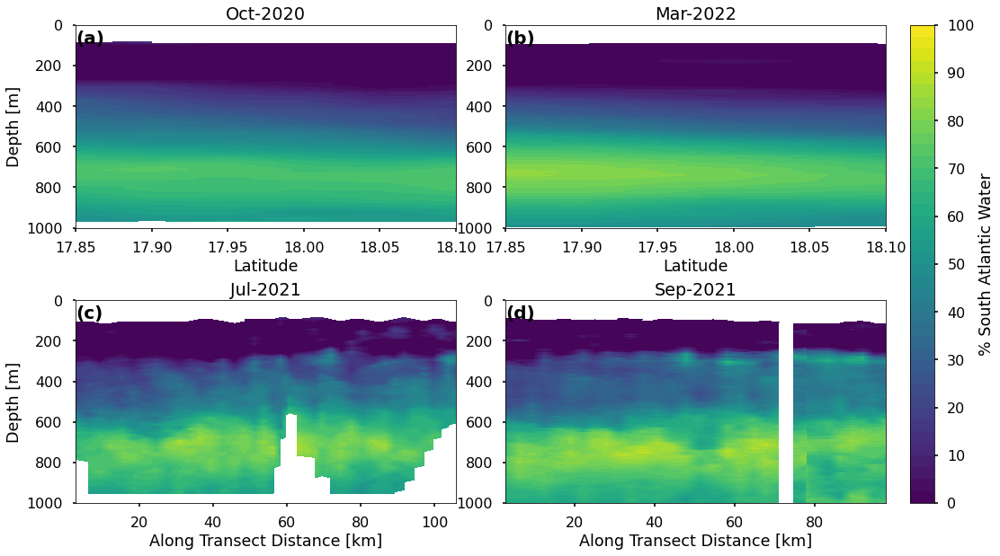

In [66]:
font_size = 20

fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(nrows=2,ncols=2, figsize=(16,8))


plt.tight_layout(pad=0.4, w_pad=1.5, h_pad=4.5)


axlist = [ax1,ax2,ax3,ax4]

levels=np.arange(0,1.01,0.025)


first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.saw_frac,axis=2),levels=levels)
ax1.patch.set_facecolor('white')
ax1.set_title('Oct-2020')
ax1.set_xlabel('Latitude')
ax1.set_ylabel('Depth [m]')
#ax1.set_ylim(960,120)
ax1.set_ylim(1000,0)
ax1.set_xlim(17.85,18.10)
ax1.text(0,0.91,'(a)', transform=ax1.transAxes, size=font_size, weight='bold')


second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.saw_frac,axis=2),levels=levels)
ax2.patch.set_facecolor('white')
ax2.set_title('Mar-2022')
ax2.set_xlabel('Latitude')
ax2.set_ylim(1000,0)
ax2.set_xlim(17.85,18.10)
ax2.text(0,0.91,'(b)', transform=ax2.transAxes, size=font_size, weight='bold')

third = ax3.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.saw_frac,levels=levels)
ax3.patch.set_facecolor('white')
ax3.set_title('Jul-2021')
ax3.set_xlabel('Along Transect Distance [km]')
ax3.set_ylabel('Depth [m]')
ax3.set_ylim(1000,0)
ax3.text(0,0.91,'(c)', transform=ax3.transAxes, size=font_size, weight='bold')

fourth = ax4.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.saw_frac,levels=levels)
ax4.patch.set_facecolor('white')
ax4.set_title('Sep-2021')
ax4.set_xlabel('Along Transect Distance [km]')
ax4.set_ylim(1000,0)
ax4.text(0,0.91,'(d)', transform=ax4.transAxes, size=font_size, weight='bold')

cbar = fig.colorbar(first, ax=axlist,label='% South Atlantic Water',pad=0.025)
cbar.get_ticks()
cbar.set_ticks([0,.10,.20,.30,.40,.50,.60,.70,.80,.90,1])
cbar.set_ticklabels([0,10,20,30,40,50,60,70,80,90,100])

plt.savefig('/home/jg1200/Figures/Percent_SAW_All_Geo.png',dpi=300,facecolor='white',bbox_inches='tight')


/tmp/ipykernel_91423/2448891414.py:14: RuntimeWarning: Mean of empty slice
  first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=levels)
/tmp/ipykernel_91423/2448891414.py:24: RuntimeWarning: Mean of empty slice
  second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=levels)


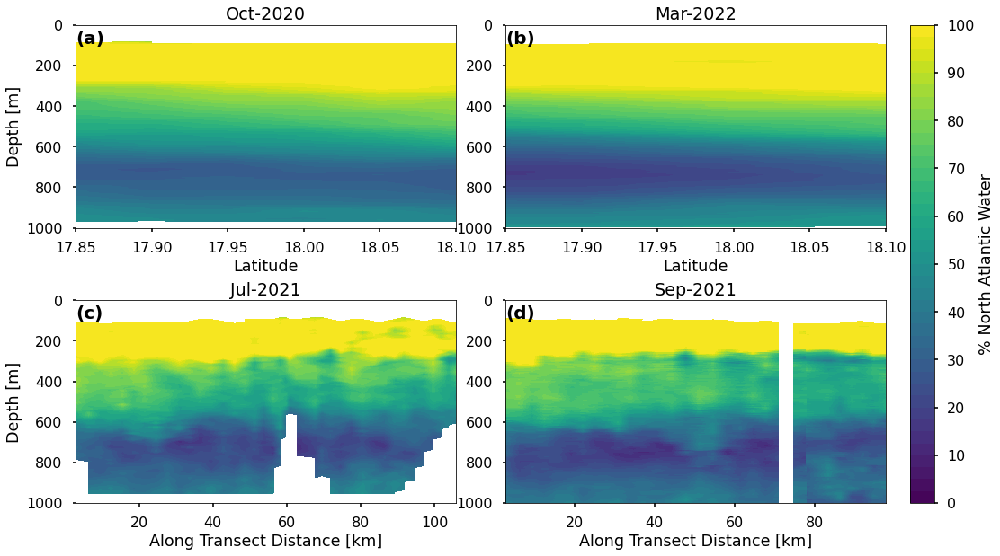

In [67]:
font_size = 20

fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(nrows=2,ncols=2, figsize=(16,8))


plt.tight_layout(pad=0.4, w_pad=1.5, h_pad=4.5)


axlist = [ax1,ax2,ax3,ax4]

levels=np.arange(0,1.01,0.025)


first = ax1.contourf(df_2020_final.lat,df_2020_final.depth,np.nanmean(df_2020_final.naw_frac,axis=2),levels=levels)
ax1.patch.set_facecolor('white')
ax1.set_title('Oct-2020')
ax1.set_xlabel('Latitude')
ax1.set_ylabel('Depth [m]')
ax1.set_ylim(1000,0)
ax1.set_xlim(17.85,18.10)
ax1.text(0,0.91,'(a)', transform=ax1.transAxes, size=font_size, weight='bold')


second = ax2.contourf(df_2022_final.lat,df_2022_final.depth,np.nanmean(df_2022_final.naw_frac,axis=2),levels=levels)
ax2.patch.set_facecolor('white')
ax2.set_title('Mar-2022')
ax2.set_xlabel('Latitude')
ax2.set_ylim(1000,0)
ax2.set_xlim(17.85,18.10)
ax2.text(0,0.91,'(b)', transform=ax2.transAxes, size=font_size, weight='bold')

third = ax3.contourf(np.cumsum(df_2021a_final.dist)/1000,df_2021a_final.depth,df_2021a_final.naw_frac,levels=levels)
ax3.patch.set_facecolor('white')
ax3.set_title('Jul-2021')
ax3.set_xlabel('Along Transect Distance [km]')
ax3.set_ylabel('Depth [m]')
ax3.set_ylim(1000,0)
ax3.text(0,0.91,'(c)', transform=ax3.transAxes, size=font_size, weight='bold')

fourth = ax4.contourf(np.cumsum(df_2021b_final.dist)/1000,df_2021b_final.depth,df_2021b_final.naw_frac,levels=levels)
ax4.patch.set_facecolor('white')
ax4.set_title('Sep-2021')
ax4.set_xlabel('Along Transect Distance [km]')
ax4.set_ylim(1000,0)
ax4.text(0,0.91,'(d)', transform=ax4.transAxes, size=font_size, weight='bold')

cbar = fig.colorbar(first, ax=axlist,label='% North Atlantic Water',pad=0.025)
cbar.get_ticks()
cbar.set_ticks([0,.10,.20,.30,.40,.50,.60,.70,.80,.90,1])
cbar.set_ticklabels([0,10,20,30,40,50,60,70,80,90,100])

plt.savefig('/home/jg1200/Figures/Percent_NAW_All_Geo.png',dpi=300,facecolor='white',bbox_inches='tight')


In [68]:
def calc_transport_by_water_mass_multiple(dft,surf_dft):
    
    smw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
    smw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])

    ucw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
    ucw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])

    lcw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.8) & (np.nanmean(dft.density,axis=2)<1027.1))])
    lcw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.8) & (np.nanmean(dft.density,axis=2)<1027.1))])

    iw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where(np.nanmean(dft.density,axis=2)>=1027.1)])
    iw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where(np.nanmean(dft.density,axis=2)>=1027.1)])

    d = {'SA': [iw_saw, lcw_saw, ucw_saw, smw_saw,np.nansum(np.nanmean(surf_dft.transport,axis=2))],'NA': [iw_naw, lcw_naw, ucw_naw, smw_naw,np.nan] }
    df2 = pd.DataFrame(data=d, index=['IW', 'lCW', 'uCW', 'SMW','SW'])

    return(df2)

def calc_transport_by_water_mass_single(dft,surf_dft):
    smw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1024.5) & (dft.density<1026.3))])
    smw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1024.5) & (dft.density<1026.3))])

    ucw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1026.3) & (dft.density<1026.8))])
    ucw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1026.3) & (dft.density<1026.8))])

    lcw_naw = np.nansum(dft.naw_transport.values[np.where((dft.density>=1026.8) & (dft.density<1027.1))])
    lcw_saw = np.nansum(dft.saw_transport.values[np.where((dft.density>=1026.8) & (dft.density<1027.1))])

    iw_naw = np.nansum(dft.naw_transport.values[np.where(dft.density>=1027.1)])
    iw_saw = np.nansum(dft.saw_transport.values[np.where(dft.density>=1027.1)])

    d = {'SA': [iw_saw, lcw_saw, ucw_saw, smw_saw,np.nansum(surf_dft.transport)],'NA': [iw_naw, lcw_naw, ucw_naw, smw_naw,np.nan] }
    df2 = pd.DataFrame(data=d, index=['IW', 'lCW', 'uCW', 'SMW','SW'])

    return(df2)

df_2020_water_mass_transport = calc_transport_by_water_mass_multiple(df_2020_final,subset_ds_2020_surf_final)
df_2021a_water_mass_transport = calc_transport_by_water_mass_single(df_2021a_final,subset_ds_2021a_surf_final)
df_2021b_water_mass_transport = calc_transport_by_water_mass_single(df_2021b_final,subset_ds_2021b_surf_final)
df_2022_water_mass_transport = calc_transport_by_water_mass_multiple(df_2022_final,subset_ds_2022_surf_final)

/tmp/ipykernel_91423/2131768640.py:3: RuntimeWarning: Mean of empty slice
  smw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
/tmp/ipykernel_91423/2131768640.py:4: RuntimeWarning: Mean of empty slice
  smw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1024.5) & (np.nanmean(dft.density,axis=2)<1026.3))])
/tmp/ipykernel_91423/2131768640.py:6: RuntimeWarning: Mean of empty slice
  ucw_naw = np.nansum(np.nanmean(dft.naw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
/tmp/ipykernel_91423/2131768640.py:7: RuntimeWarning: Mean of empty slice
  ucw_saw = np.nansum(np.nanmean(dft.saw_transport.values,axis=2)[np.where((np.nanmean(dft.density,axis=2)>=1026.3) & (np.nanmean(dft.density,axis=2)<1026.8))])
/tmp/ipykernel_91423/2131768640.py:9: RuntimeWarning: Mean o

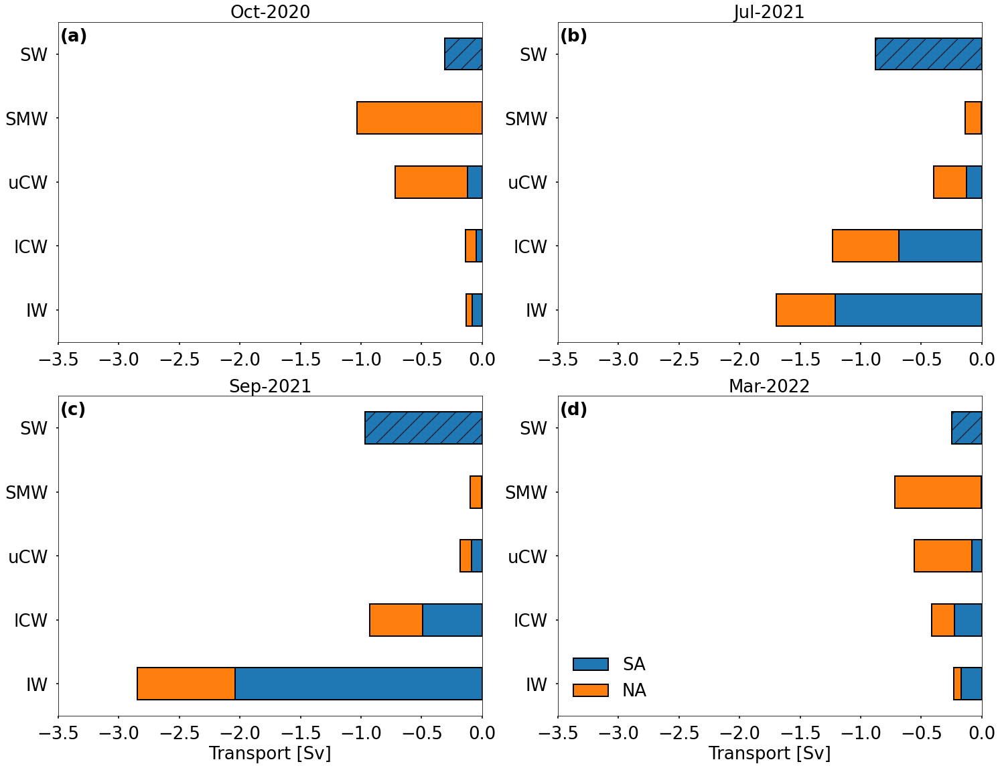

In [71]:
fig, axs = plt.subplots(2, 2, figsize=(20, 15))

plt.tight_layout(pad=0.4, w_pad=6, h_pad=4.5)

font_size = 26

df_2020_water_mass_transport.plot.barh(stacked=True,ax=axs[0,0],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[0,0].set_title('Oct-2020',fontsize=font_size)
axs[0,0].set_xlim(-3.5,0)
#axs[0,0].set_xticks([-1.5,-1,-0.5,0])
axs[0,0].tick_params(axis='both', which='major', labelsize=font_size)
axs[0,0].text(0.005,0.94,'(a)', transform=axs[0,0].transAxes, size=font_size, weight='bold')
axs[0,0].get_legend().remove()

df_2021a_water_mass_transport.plot.barh(stacked=True,ax=axs[0,1],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[0,1].set_title('Jul-2021',fontsize=font_size)
axs[0,1].set_xlim(-3.5,0)
#axs[0,1].set_xticks([-1.5,-1,-0.5,0])
axs[0,1].tick_params(axis='both', which='major', labelsize=font_size)
axs[0,1].text(0.005,0.94,'(b)', transform=axs[0,1].transAxes, size=font_size, weight='bold')
axs[0,1].get_legend().remove()

df_2021b_water_mass_transport.plot.barh(stacked=True,ax=axs[1,0],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[1,0].set_title('Sep-2021',fontsize=font_size)
axs[1,0].set_xlim(-3.5,0)
#axs[1,0].set_xticks([-1.5,-1,-0.5,0])
axs[1,0].tick_params(axis='both', which='major', labelsize=font_size)
axs[1,0].text(0.005,0.94,'(c)', transform=axs[1,0].transAxes, size=font_size, weight='bold')
axs[1,0].get_legend().remove()
axs[1,0].set_xlabel('Transport [Sv]',fontsize=font_size)

df_2022_water_mass_transport.plot.barh(stacked=True,ax=axs[1,1],color=['tab:blue','tab:orange'], edgecolor='black', linewidth=2)
axs[1,1].set_title('Mar-2022',fontsize=font_size)
axs[1,1].set_xlim(-3.5,0)
#axs[1,1].set_xticks([-1.5,-1,-0.5,0])
axs[1,1].tick_params(axis='both', which='major', labelsize=font_size)
axs[1,1].text(0.005,0.94,'(d)', transform=axs[1,1].transAxes, size=font_size, weight='bold')
axs[1,1].legend(fontsize=font_size,markerscale=6,frameon=False,loc='lower left')
axs[1,1].set_xlabel('Transport [Sv]',fontsize=font_size)


hatches = ['','','','','/','','','','','']

for x in np.arange(0,len(axs)):    
    for y in np.arange(0,len(axs)):
        bars = axs[x,y].patches
        for bar, hatch in zip(bars, hatches):
            bar.set_hatch(hatch)

plt.savefig('/home/jg1200/Figures/Anegada_SAW_NAW_Transport_Water_Masses_Bar_Plot_Geo.png', bbox_inches='tight',dpi=300,facecolor='white')



In [72]:
df_2020_water_mass_transport

,SA,NA
IW,-0.080479,-0.052211
lCW,-0.049827,-0.088664
uCW,-0.121336,-0.594933
SMW,-0.001257,-1.031071
SW,-0.308892,NaN


In [73]:
df_2021a_water_mass_transport

,SA,NA
IW,-1.207796,-0.487354
lCW,-0.685516,-0.546366
uCW,-0.128200,-0.271440
SMW,-0.004918,-0.130097
SW,-0.876713,NaN


In [74]:
df_2021b_water_mass_transport

,SA,NA
IW,-2.038719,-0.806015
lCW,-0.493913,-0.433848
uCW,-0.088813,-0.093627
SMW,-0.003864,-0.096245
SW,-0.968912,NaN


In [75]:
df_2022_water_mass_transport

,SA,NA
IW,-0.168481,-0.061634
lCW,-0.224536,-0.191049
uCW,-0.082391,-0.472626
SMW,-0.003253,-0.714543
SW,-0.246751,NaN


In [76]:
df_2020_water_mass_transport['SA'].sum()

-0.5617913789130039

In [77]:
df_2021a_water_mass_transport['SA'].sum()

-2.9031433632418664

In [78]:
df_2021b_water_mass_transport['SA'].sum()

-3.594220465961234

In [79]:
df_2022_water_mass_transport['SA'].sum()

-0.7254112940767821

In [92]:
np.mean([(0.5617913789130039*2),2.9031433632418664,3.594220465961234,(0.7254112940767821*2)])

2.267942293795668

In [93]:
np.mean([0.87*2,1.83,2.33,0.97*2])

1.96

## Percentage of NAW and SAW in each water mass layer

In [84]:

tempdf = df_2020_water_mass_transport

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'% SA:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'% NA:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
   

IW % SA: 60.65175171166379 %  ( -0.080478968355906 Sv)
IW % NA: 39.34824828833621 %  ( -0.05221129381244829 Sv)
lCW % SA: 35.97853784898363 %  ( -0.04982724626198216 Sv)
lCW % NA: 64.02146215101637 %  ( -0.08866433577819723 Sv)
uCW % SA: 16.939951551767358 %  ( -0.12133554069503866 Sv)
uCW % NA: 83.06004844823264 %  ( -0.5949329818225457 Sv)
SMW % SA: 0.12179324430935204 %  ( -0.0012573066665535055 Sv)
SMW % NA: 99.87820675569064 %  ( -1.031071435114867 Sv)
SW % SA: nan %  ( -0.3088923169335236 Sv)
SW % NA: nan %  ( nan Sv)


In [85]:

tempdf = df_2021a_water_mass_transport

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'% SA:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'% NA:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    

IW % SA: 71.25010000898804 %  ( -1.2077963609171725 Sv)
IW % NA: 28.749899991011958 %  ( -0.4873540469626924 Sv)
lCW % SA: 55.64784006693766 %  ( -0.6855156381311651 Sv)
lCW % NA: 44.35215993306234 %  ( -0.546366205452651 Sv)
uCW % SA: 32.07895633480568 %  ( -0.12820036964267054 Sv)
uCW % NA: 67.92104366519432 %  ( -0.27143971934480404 Sv)
SMW % SA: 3.6422107350521675 %  ( -0.00491751020569855 Sv)
SMW % NA: 96.35778926494783 %  ( -0.13009692370316522 Sv)
SW % SA: nan %  ( -0.8767134843451599 Sv)
SW % NA: nan %  ( nan Sv)


In [86]:

tempdf = df_2021b_water_mass_transport

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'% SA:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'% NA:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    

IW % SA: 71.6664138697556 %  ( -2.038719437139632 Sv)
IW % NA: 28.33358613024441 %  ( -0.8060153933832682 Sv)
lCW % SA: 53.237049933981595 %  ( -0.49391261392499713 Sv)
lCW % NA: 46.762950066018405 %  ( -0.43384843695496367 Sv)
uCW % SA: 48.68064073122129 %  ( -0.08881297377059463 Sv)
uCW % NA: 51.3193592687787 %  ( -0.09362705256544841 Sv)
SMW % SA: 3.8597087430593353 %  ( -0.0038639252488844138 Sv)
SMW % NA: 96.14029125694066 %  ( -0.09624531889635479 Sv)
SW % SA: nan %  ( -0.968911515877126 Sv)
SW % NA: nan %  ( nan Sv)


In [87]:

tempdf = df_2022_water_mass_transport

for ind in np.arange(0,len(tempdf)):

    tot = tempdf.iloc[ind].SA+tempdf.iloc[ind].NA
    per_SA = (tempdf.iloc[ind].SA/tot)*100
    per_NA = (tempdf.iloc[ind].NA/tot)*100
    water_mass_name = tempdf.iloc[ind].name

    print(water_mass_name,'% SA:',per_SA,'%  (',tempdf.iloc[ind].SA,'Sv)')
    print(water_mass_name,'% NA:',per_NA,'%  (',tempdf.iloc[ind].NA,'Sv)')
    

IW % SA: 73.21605643247148 %  ( -0.16848083707944567 Sv)
IW % NA: 26.783943567528517 %  ( -0.061633765220718714 Sv)
lCW % SA: 54.02880124237743 %  ( -0.2245355754265835 Sv)
lCW % NA: 45.97119875762256 %  ( -0.1910493908570461 Sv)
uCW % SA: 14.844824722157728 %  ( -0.08239141349043247 Sv)
uCW % NA: 85.15517527784228 %  ( -0.47262634544243753 Sv)
SMW % SA: 0.4531359270671416 %  ( -0.0032525883677360303 Sv)
SMW % NA: 99.54686407293286 %  ( -0.7145427073590782 Sv)
SW % SA: nan %  ( -0.24675087971258447 Sv)
SW % NA: nan %  ( nan Sv)


## Adding 26% to SMW for saline SAW

In [108]:
def add_SMW_and_calc_SAW_transport(df):
    tot = (df['NA']['SMW']*0.26) + df['SA']['IW'] + df['SA']['lCW'] + df['SA']['uCW'] + df['SA']['SW']
    return(tot)


In [110]:
add_SMW_and_calc_SAW_transport(df_2020_water_mass_transport)

-0.8286126453763158

In [111]:
add_SMW_and_calc_SAW_transport(df_2021a_water_mass_transport)

-2.932051053198991

In [112]:
add_SMW_and_calc_SAW_transport(df_2021b_water_mass_transport)

-3.615380323625402

In [113]:
add_SMW_and_calc_SAW_transport(df_2022_water_mass_transport)

-0.9079398096224064

In [114]:
np.mean([2*0.9079398096224064,3.615380323625402,2.932051053198991,0.8286126453763158])

2.2979809103613804

In [115]:
np.std([2*0.9079398096224064,3.615380323625402,2.932051053198991,0.8286126453763158])

1.064078346874418